In [25]:
import datetime as dt
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
import matplotlib as mpl
import random 
mpl.rcParams['font.size'] = 1000
%matplotlib inline

## I.  [GOLD TRUTH] Matches and Their Events:
goals, penalties, substitutions, red and yellow cards, elimination

In [50]:
import pandas as pd
fixture = pd.read_csv("/Users/meryemmhamdi/Downloads/world_cup18_fixture.csv")
fixture.head()

,Round,to_analyze,match_number,location,Group,date_time,Time,home_team/country,home_team/code,home_team/goals,away_team/country,away_team/code,away_team/goals,winner,winner_code,elimination,qualification,Yellow Cards,Red Cards,Goals
0,Group Round (1st),1,1,"Luzhniki Stadium, Moscow",Group A,14_6_2018,15:00,Russia,RUS,5,Saudi Arabia,KSA,0,Russia,RUS,NaN,NaN,[Golovin:88;Al-Jassim:93],NaN,"[Gazinsky:12,Cheryshev:43,Cheryshev:90+1,Dzyub..."
1,Group Round (1st),1,2,Ekaterinburg Stadium,Group A,15_6_2018,12:00,Egypt,EGY,0,Uruguay,URU,1,Uruguay,URU,NaN,NaN,"[Morsy:90+3,Hegazy:90+6;-]",NaN,[-;Giménez:89]
2,Group Round (1st),1,3,Saint Petersburg Stadium,Group B,15_6_2018,15:00,Morocco,MAR,0,Iran,IRN,1,Iran,IRN,NaN,NaN,"[Al-Ahmadi:34;Shojaei:10,Jahanbakhsh:47,Ansari...",NaN,[-;Bouhaddouz:90+5(o.g.)]
3,Group Round (1st),1,4,"Fisht Stadium, Sochi",Group B,15_6_2018,18:00,Portugal,POR,3,Spain,ESP,3,-,-,NaN,NaN,[Fernandes:28;Busquets:17],NaN,"[Ronaldo:4(pen.),Ronaldo:44,Ronaldo:88;Costa:2..."
4,Group Round (1st),1,5,Kazan Arena,Group C,16_6_2018,10:00,France,FRA,2,Australia,AUS,1,France,FRA,NaN,NaN,"[Tolisso:76;Leckie:13,Risdon:57,Behich:87]",NaN,"[Griezmann:58(pen.),Behich:81(o.g.);Jedinak:62..."


In [51]:
matches = {}
goals_matches = {}
elimination = {}
for i in range(0,len(fixture)):
    #print(fixture["date_time"].iloc[i])
    year = int(fixture["date_time"].iloc[i].split("_")[2])
    month = int(fixture["date_time"].iloc[i].split("_")[1])
    day = int(fixture["date_time"].iloc[i].split("_")[0])
    hour = int(fixture["Time"].iloc[i].split(":")[0])
    date = dt.datetime(year, month, day, hour, 0)
    elim = fixture["elimination"].iloc[i]
    home_team = fixture["home_team/code"].iloc[i]
    away_team = fixture["away_team/code"].iloc[i]
    end_date = dt.datetime(year, month, day, hour+2, 0)
    match = fixture["home_team/country"].iloc[i] +  " " + str(fixture["home_team/goals"].iloc[i]) + "-" + str(fixture["away_team/goals"].iloc[i]) + " " + fixture["away_team/country" + ""].iloc[i] 
    date_day = dt.datetime(year, month, day, 0, 0)
    if date_day not in matches:
        matches[date_day] = {date:match}
    else:
        matches[date_day].update({date:match})
    elimination.update({end_date:elim})
    if not pd.isna(fixture["Goals"].iloc[i]): #and fixture["Goals"].iloc[i] is not :
        goal = fixture["Goals"].iloc[i].strip("[").strip("]")
        goals = {}
        teams = [home_team, away_team]
        for k in range(2):
            if "-" not in goal.split(";")[k]: 
                if "," in goal.split(";")[k]:
                    for j in range(0, len(goal.split(";")[k].split(","))):
                        player = goal.split(";")[k].split(",")[j].split(":")[0]
                        #print("goal.split(';')[k]:",goal.split(";")[k])
                        if "(" in goal.split(";")[k].split(",")[j].split(":")[1]:
                            min_str = goal.split(";")[k].split(",")[j].split(":")[1].split("(")[0]
                            goal_type = goal.split(";")[k].split(",")[j].split(":")[1].split("(")[1].strip(")")
                        else:
                            min_str = goal.split(";")[k].split(",")[j].split(":")[1]
                            goal_type = ""
                        if '+' in min_str:
                            if min_str.split("+")[0] == "45":
                                min_ = 45 + int(min_str.split("+")[1])
                            elif min_str.split("+")[0] == "90":
                                min_ = 90 + 15 + int(min_str.split("+")[1])
                        elif int(min_str.split("+")[0]) < 45:
                            min_ = int(min_str.split("+")[0])
                        else:
                            min_ = int(min_str.split("+")[0]) + 15
                        date_goal = date + dt.timedelta(minutes=min_)
                        goals.update({date_goal: teams[k]+ "_"+player+" "+goal_type})
                else:
                    player = goal.split(";")[k].split(":")[0]
                    if "(" in goal.split(";")[k].split(":")[1]:
                        min_str = goal.split(";")[k].split(":")[1].split("(")[0]
                        goal_type = goal.split(";")[k].split(":")[1].split("(")[1].strip(")")
                    else:
                        min_str = goal.split(";")[k].split(":")[1]
                        goal_type = ""
                    if '+' in min_str:
                        if min_str.split("+")[0] == "45":
                            min_ = 45 + int(min_str.split("+")[1])
                        elif min_str.split("+")[0] == "90":
                            min_ = 90 + 15 + int(min_str.split("+")[1])
                    elif int(min_str.split("+")[0]) < 45:
                        min_ = int(min_str.split("+")[0])
                    else:
                        min_ = int(min_str.split("+")[0]) + 15
                    date_goal = date + dt.timedelta(minutes=min_)
                    goals.update({date_goal: teams[k]+ "_"+player+" "+goal_type})

        goals_matches.update({date: goals})

## Tweet Frequency per day:

In [3]:
import glob, os
dir_ = "/Users/meryemmhamdi/Documents/Rig1/meryemRig1/home/meryem/meryem/Datasets/EvDet/world_cup_18/original_tweets/allTags/"
days_dist = {}
for root, dirs, files in os.walk(dir_):
     for file in files:
        with open(os.path.join(root, file), "r") as auto:
            print(file)
            for (count, _) in enumerate(auto, 1):
                pass
        day = file.split("_")[3]
        if day not in days_dist:
            days_dist.update({day:count})
        else:
            days_dist.update({day:days_dist[day]+count})

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_es_15-7_12hour.txt
fetched_tweets_ja_15-7_9hour.txt
fetched_tweets_ja_15-7_22hour.txt
fetched_tweets_it_15-7_0hour.txt
fetched_tweets_pl_15-7_9hour.txt
fetched_tweets_ko_15-7_1hour.txt
fetched_tweets_fr_15-7_13hour.txt
fetched_tweets_ko_15-7_5hour.txt
fetched_tweets_fa_15-7_16hour.txt
fetched_tweets_ru_15-7_8hour.txt
fetched_tweets_pt_15-7_16hour.txt
fetched_tweets_ko_15-7_12hour.txt
fetched_tweets_pl_15-7_12hour.txt
fetched_tweets_ru_15-7_16hour.txt
fetched_tweets_es_15-7_6hour.txt
fetched_tweets_en_15-7_16hour.txt
fetched_tweets_ar_15-7_13hour.txt
fetched_tweets_ru_15-7_19hour.txt
fetched_tweets_pt_15-7_12hour.txt
fetched_tweets_ko_15-7_10hour.txt
fetched_tweets_en_15-7_5hour.txt
fetched_tweets_ar_15-7_1hour.txt
fetched_tweets_fa_15-7_6hour.txt
fetched_tweets_is_15-7_8hour.txt
fetched_tweets_ko_15-7_14hour.txt
fetched_tweets_fa_15-7_3hour.txt
fetched_tweets_pt_15-7_9hour.txt
fetched_tweets_ru_15-7_23hour.txt
fetched_tweets_da_15-7_10hour.txt
fetched_tweets_pt_15-7_5hou

fetched_tweets_de_30-6_1hour.txt
fetched_tweets_pt_30-6_17hour.txt
fetched_tweets_pt_30-6_8hour.txt
fetched_tweets_es_30-6_8hour.txt
fetched_tweets_ar_30-6_5hour.txt
fetched_tweets_ja_30-6_20hour.txt
fetched_tweets_is_30-6_16hour.txt
fetched_tweets_it_30-6_10hour.txt
fetched_tweets_pt_30-6_7hour.txt
fetched_tweets_ja_30-6_22hour.txt
fetched_tweets_es_30-6_2hour.txt
fetched_tweets_de_30-6_14hour.txt
fetched_tweets_ru_30-6_9hour.txt
fetched_tweets_is_30-6_12hour.txt
fetched_tweets_it_30-6_18hour.txt
fetched_tweets_da_30-6_11hour.txt
fetched_tweets_ru_30-6_10hour.txt
fetched_tweets_fr_30-6_4hour.txt
fetched_tweets_pl_30-6_5hour.txt
fetched_tweets_fa_30-6_17hour.txt
fetched_tweets_it_30-6_21hour.txt
fetched_tweets_da_30-6_13hour.txt
fetched_tweets_da_30-6_18hour.txt
fetched_tweets_fa_30-6_12hour.txt
fetched_tweets_ru_30-6_7hour.txt
fetched_tweets_sr_30-6_13hour.txt
fetched_tweets_ru_30-6_11hour.txt
fetched_tweets_en_30-6_22hour.txt
fetched_tweets_pl_30-6_2hour.txt
fetched_tweets_pl_30-6_0h

fetched_tweets_ru_6-7_13hour.txt
fetched_tweets_is_6-7_2hour.txt
fetched_tweets_pl_6-7_15hour.txt
fetched_tweets_it_6-7_9hour.txt
fetched_tweets_ja_6-7_20hour.txt
fetched_tweets_de_6-7_20hour.txt
fetched_tweets_fa_6-7_4hour.txt
fetched_tweets_en_6-7_21hour.txt
fetched_tweets_fr_6-7_1hour.txt
fetched_tweets_is_6-7_22hour.txt
fetched_tweets_pl_6-7_23hour.txt
fetched_tweets_pl_6-7_9hour.txt
fetched_tweets_pl_6-7_17hour.txt
fetched_tweets_sr_6-7_5hour.txt
fetched_tweets_pl_6-7_5hour.txt
fetched_tweets_is_6-7_0hour.txt
fetched_tweets_da_6-7_21hour.txt
fetched_tweets_it_6-7_8hour.txt
fetched_tweets_ko_6-7_3hour.txt
fetched_tweets_pl_6-7_12hour.txt
fetched_tweets_it_6-7_19hour.txt
fetched_tweets_ko_6-7_19hour.txt
fetched_tweets_pt_6-7_6hour.txt
fetched_tweets_fa_6-7_7hour.txt
fetched_tweets_en_6-7_10hour.txt
fetched_tweets_ko_6-7_18hour.txt
fetched_tweets_fr_6-7_4hour.txt
fetched_tweets_ar_6-7_17hour.txt
fetched_tweets_ar_6-7_6hour.txt
fetched_tweets_ja_6-7_11hour.txt
fetched_tweets_da_6-7_10

fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_20hour.txt
fetched_tweets_ko_4-7_22hour.txt
fetched_tweets_ja_4-7_10hour.txt
fetched_tweets_ar_4-7_7hour.txt
fetched_tweets_ar_4-7_2hour.txt
fetched_tweets_en_4-7_11hour.txt
fetched_tweets_ar_4-7_4hour.txt
fetched_tweets_ru_4-7_4hour.txt
fetched_tweets_pt_4-7_0hour.txt
fetched_tweets_sr_4-7_15hour.txt
fetched_tweets_it_4-7_14hour.txt
fetched_tweets_ja_4-7_3hour.txt
fetched_tweets_ru_4-7_8hour.txt
fetched_tweets_es_4-7_10hour.txt
fetched_tweets_pt_4-7_11hour.txt
fetched_tweets_en_4-7_12hour.txt
fetched_tweets_ar_4-7_8hour.txt
fetched_tweets_de_4-7_

fetched_tweets_is_4-7_11hour.txt
fetched_tweets_de_4-7_9hour.txt
fetched_tweets_ar_4-7_9hour.txt
fetched_tweets_ar_4-7_19hour.txt
fetched_tweets_da_4-7_15hour.txt
fetched_tweets_ar_4-7_23hour.txt
fetched_tweets_fa_4-7_10hour.txt
fetched_tweets_it_4-7_18hour.txt
fetched_tweets_ja_4-7_7hour.txt
fetched_tweets_ja_4-7_21hour.txt
fetched_tweets_ja_4-7_2hour.txt
fetched_tweets_ko_4-7_11hour.txt
fetched_tweets_pt_4-7_4hour.txt
fetched_tweets_ar_4-7_14hour.txt
fetched_tweets_pl_4-7_6hour.txt
fetched_tweets_it_4-7_8hour.txt
fetched_tweets_da_4-7_5hour.txt
fetched_tweets_ru_4-7_2hour.txt
fetched_tweets_fr_4-7_12hour.txt
fetched_tweets_es_4-7_0hour.txt
fetched_tweets_pl_4-7_23hour.txt
fetched_tweets_ru_4-7_16hour.txt
fetched_tweets_es_4-7_9hour.txt
fetched_tweets_ja_4-7_15hour.txt
fetched_tweets_is_4-7_22hour.txt
fetched_tweets_de_4-7_5hour.txt
fetched_tweets_es_4-7_21hour.txt
fetched_tweets_fr_4-7_1hour.txt
fetched_tweets_ar_4-7_6hour.txt
fetched_tweets_de_4-7_15hour.txt
fetched_tweets_fa_4-7_1h

fetched_tweets_it_11-7_11hour.txt
fetched_tweets_en_11-7_7hour.txt
fetched_tweets_ja_11-7_11hour.txt
fetched_tweets_es_11-7_14hour.txt
fetched_tweets_fr_11-7_6hour.txt
fetched_tweets_en_11-7_21hour.txt
fetched_tweets_en_11-7_6hour.txt
fetched_tweets_ar_11-7_10hour.txt
fetched_tweets_ko_11-7_2hour.txt
fetched_tweets_fa_11-7_5hour.txt
fetched_tweets_de_11-7_2hour.txt
fetched_tweets_pt_11-7_1hour.txt
fetched_tweets_es_11-7_23hour.txt
fetched_tweets_sr_11-7_14hour.txt
fetched_tweets_pl_11-7_8hour.txt
fetched_tweets_ru_11-7_13hour.txt
fetched_tweets_pt_11-7_10hour.txt
fetched_tweets_de_11-7_21hour.txt
fetched_tweets_fr_11-7_14hour.txt
fetched_tweets_ru_11-7_23hour.txt
fetched_tweets_da_11-7_20hour.txt
fetched_tweets_ru_11-7_8hour.txt
fetched_tweets_ja_11-7_10hour.txt
fetched_tweets_ar_11-7_5hour.txt
fetched_tweets_ar_11-7_2hour.txt
fetched_tweets_ko_11-7_9hour.txt
fetched_tweets_pt_11-7_11hour.txt
fetched_tweets_ko_11-7_20hour.txt
fetched_tweets_it_11-7_2hour.txt
fetched_tweets_ja_11-7_22ho

fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_7hour.txt
fetched_tweets_pl_19-6_5hour.txt
fetched_tweets_fr_19-6_3hour.txt
fetched_tweets_sr_19-6_14hour.txt
fetched_tweets_ja_19-6_12hour.txt
fetched_tweets_fr_19-6_6hour.txt
fetched_tweets_it_19-6_5hour.txt
fetched_tweets_es_19-6_15hour.txt
fetched_tweets_da_19-6_8hou

fetched_tweets_fr_19-6_14hour.txt
fetched_tweets_it_19-6_0hour.txt
fetched_tweets_fa_19-6_3hour.txt
fetched_tweets_fr_19-6_11hour.txt
fetched_tweets_de_19-6_15hour.txt
fetched_tweets_ru_19-6_2hour.txt
fetched_tweets_es_19-6_10hour.txt
fetched_tweets_ru_19-6_1hour.txt
fetched_tweets_fa_19-6_23hour.txt
fetched_tweets_ru_19-6_16hour.txt
fetched_tweets_fa_19-6_17hour.txt
fetched_tweets_pt_19-6_15hour.txt
fetched_tweets_is_19-6_5hour.txt
fetched_tweets_es_19-6_13hour.txt
fetched_tweets_da_19-6_17hour.txt
fetched_tweets_de_19-6_10hour.txt
fetched_tweets_de_19-6_5hour.txt
fetched_tweets_is_19-6_17hour.txt
fetched_tweets_de_19-6_14hour.txt
fetched_tweets_es_19-6_7hour.txt
fetched_tweets_pt_19-6_19hour.txt
fetched_tweets_fr_19-6_1hour.txt
fetched_tweets_pl_19-6_19hour.txt
fetched_tweets_sr_19-6_21hour.txt
fetched_tweets_ru_19-6_23hour.txt
fetched_tweets_pl_19-6_1hour.txt
fetched_tweets_en_19-6_11hour.txt
fetched_tweets_ja_19-6_18hour.txt
fetched_tweets_en_19-6_2hour.txt
fetched_tweets_pl_19-6_4

fetched_tweets_fa_16-6_22hour.txt
fetched_tweets_ja_16-6_19hour.txt
fetched_tweets_is_16-6_18hour.txt
fetched_tweets_de_16-6_3hour.txt
fetched_tweets_ja_16-6_7hour.txt
fetched_tweets_sv_16-6_22hour.txt
fetched_tweets_fr_16-6_5hour.txt
fetched_tweets_fa_16-6_0hour.txt
fetched_tweets_fr_16-6_18hour.txt
fetched_tweets_it_16-6_17hour.txt
fetched_tweets_ar_16-6_16hour.txt
fetched_tweets_ar_16-6_6hour.txt
fetched_tweets_pl_16-6_12hour.txt
fetched_tweets_pt_16-6_11hour.txt
fetched_tweets_ru_16-6_13hour.txt
fetched_tweets_sr_16-6_16hour.txt
fetched_tweets_ru_16-6_22hour.txt
fetched_tweets_es_16-6_14hour.txt
fetched_tweets_is_16-6_22hour.txt
fetched_tweets_pl_16-6_9hour.txt
fetched_tweets_sv_16-6_6hour.txt
fetched_tweets_sr_16-6_9hour.txt
fetched_tweets_ar_16-6_22hour.txt
fetched_tweets_ja_16-6_22hour.txt
fetched_tweets_is_16-6_9hour.txt
fetched_tweets_ja_16-6_16hour.txt
fetched_tweets_ar_16-6_11hour.txt
fetched_tweets_fa_16-6_10hour.txt
fetched_tweets_is_16-6_3hour.txt
fetched_tweets_fa_16-6_1

fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour.txt
fetched_tweets_ar_12-7_23hour.txt
fetched_tweets_es_12-7_9hour.txt
fetched_tweets_ru_12-7_13hour.txt
fetched_tweets_ru_12-7_3hour.txt
fetched_tweets_fa_12-7_19hour.txt
fetched_tweets_de_12-7_13hour.txt
fetched_tweets_pt_12-7_15hour.txt
fetched_tweets_fr_12-7_23ho

fetched_tweets_ja_12-7_3hour.txt
fetched_tweets_de_12-7_5hour.txt
fetched_tweets_de_12-7_2hour.txt
fetched_tweets_pt_12-7_2hour.txt
fetched_tweets_pt_12-7_0hour.txt
fetched_tweets_ar_12-7_16hour.txt
fetched_tweets_en_12-7_19hour.txt
fetched_tweets_ar_12-7_5hour.txt
fetched_tweets_pt_12-7_8hour.txt
fetched_tweets_fa_12-7_16hour.txt
fetched_tweets_pt_12-7_21hour.txt
fetched_tweets_pl_12-7_10hour.txt
fetched_tweets_da_12-7_4hour.txt
fetched_tweets_ko_12-7_15hour.txt
fetched_tweets_ja_12-7_5hour.txt
fetched_tweets_de_12-7_15hour.txt
fetched_tweets_ru_12-7_1hour.txt
fetched_tweets_ko_12-7_1hour.txt
fetched_tweets_es_12-7_3hour.txt
fetched_tweets_es_12-7_19hour.txt
fetched_tweets_pl_12-7_9hour.txt
fetched_tweets_fa_12-7_2hour.txt
fetched_tweets_ko_12-7_2hour.txt
fetched_tweets_ja_12-7_4hour.txt
fetched_tweets_fr_12-7_13hour.txt
fetched_tweets_it_12-7_8hour.txt
fetched_tweets_ru_12-7_14hour.txt
fetched_tweets_de_12-7_14hour.txt
fetched_tweets_sr_12-7_10hour.txt
fetched_tweets_sr_12-7_8hour.tx

fetched_tweets_is_18-6_7hour.txt
fetched_tweets_fa_18-6_20hour.txt
fetched_tweets_da_18-6_9hour.txt
fetched_tweets_is_18-6_21hour.txt
fetched_tweets_is_18-6_12hour.txt
fetched_tweets_ja_18-6_11hour.txt
fetched_tweets_pl_18-6_22hour.txt
fetched_tweets_da_18-6_12hour.txt
fetched_tweets_es_18-6_10hour.txt
fetched_tweets_pt_18-6_5hour.txt
fetched_tweets_it_18-6_1hour.txt
fetched_tweets_da_18-6_16hour.txt
fetched_tweets_is_18-6_6hour.txt
fetched_tweets_es_18-6_21hour.txt
fetched_tweets_it_18-6_10hour.txt
fetched_tweets_pl_18-6_17hour.txt
fetched_tweets_pt_18-6_0hour.txt
fetched_tweets_pl_18-6_19hour.txt
fetched_tweets_pt_18-6_11hour.txt
fetched_tweets_en_18-6_22hour.txt
fetched_tweets_fr_18-6_19hour.txt
fetched_tweets_de_18-6_23hour.txt
fetched_tweets_en_18-6_21hour.txt
fetched_tweets_de_18-6_17hour.txt
fetched_tweets_da_18-6_0hour.txt
fetched_tweets_pl_18-6_8hour.txt
fetched_tweets_es_18-6_4hour.txt
fetched_tweets_sr_18-6_7hour.txt
fetched_tweets_ja_18-6_4hour.txt
fetched_tweets_is_18-6_17

fetched_tweets_fr_12-6_21hour.txt
fetched_tweets_ru_12-6_6hour.txt
fetched_tweets_pl_12-6_10hour.txt
fetched_tweets_ko_12-6_4hour.txt
fetched_tweets_ko_12-6_13hour.txt
fetched_tweets_sv_12-6_8hour.txt
fetched_tweets_is_12-6_22hour.txt
fetched_tweets_sv_12-6_5hour.txt
fetched_tweets_fa_12-6_0hour.txt
fetched_tweets_it_12-6_18hour.txt
fetched_tweets_pl_12-6_0hour.txt
fetched_tweets_ja_12-6_4hour.txt
fetched_tweets_de_12-6_5hour.txt
fetched_tweets_fa_12-6_21hour.txt
fetched_tweets_da_12-6_12hour.txt
fetched_tweets_fa_12-6_6hour.txt
fetched_tweets_ar_12-6_18hour.txt
fetched_tweets_pl_12-6_4hour.txt
fetched_tweets_ru_12-6_4hour.txt
fetched_tweets_fr_12-6_16hour.txt
fetched_tweets_fr_12-6_2hour.txt
fetched_tweets_ar_12-6_7hour.txt
fetched_tweets_it_12-6_19hour.txt
fetched_tweets_fa_12-6_9hour.txt
fetched_tweets_ja_12-6_1hour.txt
fetched_tweets_is_12-6_5hour.txt
fetched_tweets_ja_12-6_13hour.txt
fetched_tweets_fr_12-6_13hour.txt
fetched_tweets_it_12-6_11hour.txt
fetched_tweets_ar_12-6_14hour.

fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.txt
fetched_tweets_pl_28-6_19hour.txt
fetched_tweets_ru_28-6_16hour.txt
fetched_tweets_ja_28-6_8hour.txt
fetched_tweets_en_28-6_17hour.txt
fetched_tweets_ar_28-6_7hour.txt
fetched_tweets_en_28-6_12hour.txt
fetched_tweets_ko_28-6_3hour.txt
fetched_tweets_ja_28-6_12hour.txt
fetched_tweets_es_28-6_16hour.txt
fetched_tweets_is_28-6_0hour.txt
fetched_tweets_pt_28-6_14hour.txt
fetched_tweets_de_28-6_19hour.txt
fetched_tweets_fr_28-6_14hour.txt
fetched_tweets_fa_28-6_20hour.txt
fetched_tweets_is_28-6_3hour.txt
fetched_tweets_fa_28-6_22hour.txt
fetched_tweets_es_28-6_6hour.txt
fetched_tweets_pt_28-6_8hour.txt
fetched_tweets_en_28-6_14hour.txt
fetched_tweets_es_28-6_2hour.txt
fetched_tweets_ar_28-6_12hour.txt
fetched_tweets_fa_28-6_8hour.txt
fetched_tweets_en_28-6_5hour.txt
fetched_tweets_ru_28-6_12hour.txt
fetched_tweets_ja_28-6_10h

fetched_tweets_ru_28-6_21hour.txt
fetched_tweets_fr_28-6_17hour.txt
fetched_tweets_fa_28-6_14hour.txt
fetched_tweets_en_28-6_10hour.txt
fetched_tweets_ar_28-6_9hour.txt
fetched_tweets_ja_28-6_9hour.txt
fetched_tweets_pl_28-6_5hour.txt
fetched_tweets_it_28-6_13hour.txt
fetched_tweets_ru_28-6_4hour.txt
fetched_tweets_da_28-6_21hour.txt
fetched_tweets_fr_28-6_0hour.txt
fetched_tweets_en_28-6_9hour.txt
fetched_tweets_ru_28-6_8hour.txt
fetched_tweets_es_28-6_13hour.txt
fetched_tweets_da_28-6_17hour.txt
fetched_tweets_de_28-6_8hour.txt
fetched_tweets_ru_28-6_2hour.txt
fetched_tweets_it_28-6_3hour.txt
fetched_tweets_ko_28-6_5hour.txt
fetched_tweets_fr_28-6_10hour.txt
fetched_tweets_en_28-6_0hour.txt
fetched_tweets_de_28-6_23hour.txt
fetched_tweets_ru_28-6_22hour.txt
fetched_tweets_ar_28-6_3hour.txt
fetched_tweets_de_28-6_10hour.txt
fetched_tweets_fa_28-6_23hour.txt
fetched_tweets_is_28-6_20hour.txt
fetched_tweets_pl_28-6_0hour.txt
fetched_tweets_fr_28-6_11hour.txt
fetched_tweets_ar_28-6_21hou

fetched_tweets_de_16-7_10hour.txt
fetched_tweets_pl_16-7_16hour.txt
fetched_tweets_ar_16-7_4hour.txt
fetched_tweets_ko_16-7_23hour.txt
fetched_tweets_it_16-7_12hour.txt
fetched_tweets_en_16-7_3hour.txt
fetched_tweets_is_16-7_3hour.txt
fetched_tweets_ko_16-7_18hour.txt
fetched_tweets_ar_16-7_9hour.txt
fetched_tweets_ru_16-7_17hour.txt
fetched_tweets_pt_16-7_19hour.txt
fetched_tweets_pt_16-7_10hour.txt
fetched_tweets_it_16-7_3hour.txt
fetched_tweets_it_16-7_21hour.txt
fetched_tweets_de_16-7_2hour.txt
fetched_tweets_de_16-7_12hour.txt
fetched_tweets_fr_16-7_4hour.txt
fetched_tweets_pt_16-7_4hour.txt
fetched_tweets_is_16-7_4hour.txt
fetched_tweets_en_16-7_14hour.txt
fetched_tweets_it_16-7_20hour.txt
fetched_tweets_da_16-7_0hour.txt
fetched_tweets_ko_16-7_4hour.txt
fetched_tweets_es_16-7_21hour.txt
fetched_tweets_fa_16-7_23hour.txt
fetched_tweets_es_16-7_5hour.txt
fetched_tweets_it_16-7_15hour.txt
fetched_tweets_ar_16-7_12hour.txt
fetched_tweets_fr_16-7_17hour.txt
fetched_tweets_ar_16-7_2ho

fetched_tweets_de_14-6_8hour.txt
fetched_tweets_is_14-6_7hour.txt
fetched_tweets_fr_14-6_1hour.txt
fetched_tweets_da_14-6_12hour.txt
fetched_tweets_it_14-6_4hour.txt
fetched_tweets_fr_14-6_16hour.txt
fetched_tweets_is_14-6_22hour.txt
fetched_tweets_fr_14-6_20hour.txt
fetched_tweets_ja_14-6_7hour.txt
fetched_tweets_sv_14-6_23hour.txt
fetched_tweets_en_14-6_6hour.txt
fetched_tweets_es_14-6_1hour.txt
fetched_tweets_de_14-6_9hour.txt
fetched_tweets_ko_14-6_10hour.txt
fetched_tweets_es_14-6_10hour.txt
fetched_tweets_ja_14-6_3hour.txt
fetched_tweets_ar_14-6_3hour.txt
fetched_tweets_fr_14-6_6hour.txt
fetched_tweets_pl_14-6_17hour.txt
fetched_tweets_ko_14-6_7hour.txt
fetched_tweets_pl_14-6_18hour.txt
fetched_tweets_da_14-6_4hour.txt
fetched_tweets_ja_14-6_20hour.txt
fetched_tweets_en_14-6_1hour.txt
fetched_tweets_ar_14-6_21hour.txt
fetched_tweets_pt_14-6_18hour.txt
fetched_tweets_sv_14-6_16hour.txt
fetched_tweets_fa_14-6_19hour.txt
fetched_tweets_ar_14-6_1hour.txt
fetched_tweets_ar_14-6_15hour

fetched_tweets_ar_14-6_8hour.txt
fetched_tweets_en_14-6_23hour.txt
fetched_tweets_ru_14-6_18hour.txt
fetched_tweets_is_14-6_14hour.txt
fetched_tweets_de_14-6_16hour.txt
fetched_tweets_da_14-6_17hour.txt
fetched_tweets_fr_14-6_21hour.txt
fetched_tweets_it_14-6_23hour.txt
fetched_tweets_de_14-6_23hour.txt
fetched_tweets_pl_14-6_2hour.txt
fetched_tweets_en_14-6_10hour.txt
fetched_tweets_ru_14-6_13hour.txt
fetched_tweets_fr_14-6_12hour.txt
fetched_tweets_is_14-6_12hour.txt
fetched_tweets_sr_14-6_17hour.txt
fetched_tweets_it_14-6_9hour.txt
fetched_tweets_ja_14-6_4hour.txt
fetched_tweets_en_14-6_11hour.txt
fetched_tweets_ko_14-6_9hour.txt
fetched_tweets_pt_14-6_0hour.txt
fetched_tweets_es_14-6_3hour.txt
fetched_tweets_sv_14-6_8hour.txt
fetched_tweets_en_14-6_17hour.txt
fetched_tweets_it_14-6_10hour.txt
fetched_tweets_pt_14-6_17hour.txt
fetched_tweets_pl_14-6_19hour.txt
fetched_tweets_ko_14-6_6hour.txt
fetched_tweets_ar_14-6_20hour.txt
fetched_tweets_de_14-6_14hour.txt
fetched_tweets_ar_14-6_

fetched_tweets_en_21-6_2hour.txt
fetched_tweets_ja_21-6_12hour.txt
fetched_tweets_de_21-6_4hour.txt
fetched_tweets_it_21-6_23hour.txt
fetched_tweets_ko_21-6_20hour.txt
fetched_tweets_it_21-6_7hour.txt
fetched_tweets_fa_21-6_20hour.txt
fetched_tweets_fr_21-6_3hour.txt
fetched_tweets_is_21-6_0hour.txt
fetched_tweets_fa_21-6_11hour.txt
fetched_tweets_es_21-6_13hour.txt
fetched_tweets_es_21-6_23hour.txt
fetched_tweets_ru_21-6_21hour.txt
fetched_tweets_ru_21-6_8hour.txt
fetched_tweets_it_21-6_8hour.txt
fetched_tweets_pl_21-6_15hour.txt
fetched_tweets_ar_21-6_1hour.txt
fetched_tweets_ja_21-6_6hour.txt
fetched_tweets_ar_21-6_17hour.txt
fetched_tweets_ko_21-6_18hour.txt
fetched_tweets_fr_21-6_6hour.txt
fetched_tweets_ja_21-6_8hour.txt
fetched_tweets_fr_21-6_16hour.txt
fetched_tweets_fr_21-6_15hour.txt
fetched_tweets_is_21-6_7hour.txt
fetched_tweets_fr_21-6_18hour.txt
fetched_tweets_pl_21-6_1hour.txt
fetched_tweets_is_21-6_8hour.txt
fetched_tweets_ru_21-6_2hour.txt
fetched_tweets_de_21-6_13hour

fetched_tweets_ru_17-6_2hour.txt
fetched_tweets_ar_17-6_1hour.txt
fetched_tweets_fa_17-6_4hour.txt
fetched_tweets_ru_17-6_13hour.txt
fetched_tweets_de_17-6_15hour.txt
fetched_tweets_it_17-6_9hour.txt
fetched_tweets_pl_17-6_15hour.txt
fetched_tweets_is_17-6_7hour.txt
fetched_tweets_da_17-6_11hour.txt
fetched_tweets_is_17-6_8hour.txt
fetched_tweets_ja_17-6_12hour.txt
fetched_tweets_it_17-6_4hour.txt
fetched_tweets_de_17-6_10hour.txt
fetched_tweets_da_17-6_21hour.txt
fetched_tweets_sr_17-6_18hour.txt
fetched_tweets_ja_17-6_3hour.txt
fetched_tweets_en_17-6_6hour.txt
fetched_tweets_sv_17-6_16hour.txt
fetched_tweets_pt_17-6_14hour.txt
fetched_tweets_ja_17-6_5hour.txt
fetched_tweets_da_17-6_2hour.txt
fetched_tweets_sr_17-6_11hour.txt
fetched_tweets_sv_17-6_2hour.txt
fetched_tweets_fr_17-6_10hour.txt
fetched_tweets_pt_17-6_20hour.txt
fetched_tweets_en_17-6_16hour.txt
fetched_tweets_ar_17-6_20hour.txt
fetched_tweets_fa_17-6_21hour.txt
fetched_tweets_pl_17-6_20hour.txt
fetched_tweets_ja_17-6_11h

fetched_tweets_ar_17-6_18hour.txt
fetched_tweets_fr_17-6_19hour.txt
fetched_tweets_ja_17-6_23hour.txt
fetched_tweets_pl_17-6_6hour.txt
fetched_tweets_pl_17-6_2hour.txt
fetched_tweets_ru_17-6_20hour.txt
fetched_tweets_is_17-6_12hour.txt
fetched_tweets_ja_17-6_19hour.txt
fetched_tweets_is_17-6_6hour.txt
fetched_tweets_fa_17-6_17hour.txt
fetched_tweets_ru_17-6_12hour.txt
fetched_tweets_es_17-6_3hour.txt
fetched_tweets_ja_17-6_9hour.txt
fetched_tweets_de_17-6_22hour.txt
fetched_tweets_en_17-6_10hour.txt
fetched_tweets_fa_17-6_8hour.txt
fetched_tweets_fr_17-6_13hour.txt
fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3

fetched_tweets_ja_13-6_7hour.txt
fetched_tweets_is_13-6_2hour.txt
fetched_tweets_ru_13-6_17hour.txt
fetched_tweets_pt_13-6_14hour.txt
fetched_tweets_fr_13-6_0hour.txt
fetched_tweets_fa_13-6_17hour.txt
fetched_tweets_de_13-6_4hour.txt
fetched_tweets_sv_13-6_3hour.txt
fetched_tweets_da_13-6_22hour.txt
fetched_tweets_pl_13-6_19hour.txt
fetched_tweets_fr_13-6_10hour.txt
fetched_tweets_fa_13-6_16hour.txt
fetched_tweets_ja_13-6_9hour.txt
fetched_tweets_is_13-6_4hour.txt
fetched_tweets_sr_13-6_21hour.txt
fetched_tweets_pt_13-6_23hour.txt
fetched_tweets_it_13-6_5hour.txt
fetched_tweets_da_13-6_13hour.txt
fetched_tweets_de_13-6_3hour.txt
fetched_tweets_fr_13-6_12hour.txt
fetched_tweets_ko_13-6_3hour.txt
fetched_tweets_ja_13-6_17hour.txt
fetched_tweets_es_13-6_23hour.txt
fetched_tweets_pt_13-6_17hour.txt
fetched_tweets_de_13-6_19hour.txt
fetched_tweets_ja_13-6_8hour.txt
fetched_tweets_pl_13-6_3hour.txt
fetched_tweets_ar_13-6_12hour.txt
fetched_tweets_ko_13-6_5hour.txt
fetched_tweets_ja_13-6_10ho

fetched_tweets_en_18-7_17hour.txt
fetched_tweets_pl_18-7_5hour.txt
fetched_tweets_en_18-7_18hour.txt
fetched_tweets_pt_18-7_0hour.txt
fetched_tweets_fr_18-7_16hour.txt
fetched_tweets_it_18-7_9hour.txt
fetched_tweets_en_18-7_22hour.txt
fetched_tweets_pl_18-7_8hour.txt
fetched_tweets_is_18-7_10hour.txt
fetched_tweets_ru_18-7_11hour.txt
fetched_tweets_ko_18-7_8hour.txt
fetched_tweets_is_18-7_2hour.txt
fetched_tweets_es_18-7_20hour.txt
fetched_tweets_it_18-7_7hour.txt
fetched_tweets_ar_18-7_16hour.txt
fetched_tweets_is_18-7_23hour.txt
fetched_tweets_ar_18-7_15hour.txt
fetched_tweets_fa_18-7_14hour.txt
fetched_tweets_pl_18-7_16hour.txt
fetched_tweets_fa_18-7_20hour.txt
fetched_tweets_pl_18-7_17hour.txt
fetched_tweets_ko_18-7_10hour.txt
fetched_tweets_ru_18-7_14hour.txt
fetched_tweets_pt_18-7_13hour.txt
fetched_tweets_es_18-7_0hour.txt
fetched_tweets_is_18-7_19hour.txt
fetched_tweets_en_18-7_14hour.txt
fetched_tweets_es_18-7_12hour.txt
fetched_tweets_pt_18-7_20hour.txt
fetched_tweets_pt_18-7

fetched_tweets_fa_20-6_23hour.txt
fetched_tweets_en_20-6_7hour.txt
fetched_tweets_da_20-6_12hour.txt
fetched_tweets_it_20-6_11hour.txt
fetched_tweets_pl_20-6_23hour.txt
fetched_tweets_pt_20-6_9hour.txt
fetched_tweets_de_20-6_22hour.txt
fetched_tweets_pt_20-6_1hour.txt
fetched_tweets_ko_20-6_23hour.txt
fetched_tweets_fr_20-6_3hour.txt
fetched_tweets_da_20-6_13hour.txt
fetched_tweets_pl_20-6_4hour.txt
fetched_tweets_en_20-6_8hour.txt
fetched_tweets_es_20-6_14hour.txt
fetched_tweets_pt_20-6_12hour.txt
fetched_tweets_it_20-6_0hour.txt
fetched_tweets_ko_20-6_13hour.txt
fetched_tweets_ja_20-6_13hour.txt
fetched_tweets_it_20-6_10hour.txt
fetched_tweets_da_20-6_18hour.txt
fetched_tweets_ko_20-6_3hour.txt
fetched_tweets_ko_20-6_6hour.txt
fetched_tweets_ru_20-6_18hour.txt
fetched_tweets_ar_20-6_6hour.txt
fetched_tweets_de_20-6_16hour.txt
fetched_tweets_sr_20-6_4hour.txt
fetched_tweets_fa_20-6_10hour.txt
fetched_tweets_fr_20-6_4hour.txt
fetched_tweets_en_20-6_20hour.txt
fetched_tweets_fr_20-6_16h

fetched_tweets_ru_20-6_6hour.txt
fetched_tweets_ja_20-6_1hour.txt
fetched_tweets_ar_20-6_2hour.txt
fetched_tweets_ru_20-6_8hour.txt
fetched_tweets_is_20-6_16hour.txt
fetched_tweets_da_20-6_19hour.txt
fetched_tweets_pl_20-6_14hour.txt
fetched_tweets_es_20-6_15hour.txt
fetched_tweets_ja_20-6_17hour.txt
fetched_tweets_da_20-6_2hour.txt
fetched_tweets_es_20-6_4hour.txt
fetched_tweets_is_20-6_23hour.txt
fetched_tweets_is_20-6_15hour.txt
fetched_tweets_fa_20-6_22hour.txt
fetched_tweets_pt_20-6_5hour.txt
fetched_tweets_en_20-6_23hour.txt
fetched_tweets_de_20-6_23hour.txt
fetched_tweets_fr_20-6_0hour.txt
fetched_tweets_fa_20-6_8hour.txt
fetched_tweets_pl_20-6_9hour.txt
fetched_tweets_de_20-6_1hour.txt
fetched_tweets_pl_20-6_21hour.txt
fetched_tweets_ko_20-6_17hour.txt
fetched_tweets_it_20-6_12hour.txt
fetched_tweets_en_20-6_17hour.txt
fetched_tweets_pt_20-6_3hour.txt
fetched_tweets_es_20-6_9hour.txt
fetched_tweets_ko_20-6_7hour.txt
fetched_tweets_ar_20-6_12hour.txt
fetched_tweets_sr_20-6_9hour

fetched_tweets_is_17-7_16hour.txt
fetched_tweets_da_17-7_13hour.txt
fetched_tweets_de_17-7_14hour.txt
fetched_tweets_ru_17-7_2hour.txt
fetched_tweets_is_17-7_23hour.txt
fetched_tweets_de_17-7_19hour.txt
fetched_tweets_fa_17-7_9hour.txt
fetched_tweets_ko_17-7_8hour.txt
fetched_tweets_es_17-7_7hour.txt
fetched_tweets_es_17-7_8hour.txt
fetched_tweets_es_17-7_17hour.txt
fetched_tweets_pt_17-7_21hour.txt
fetched_tweets_es_17-7_11hour.txt
fetched_tweets_sr_17-7_18hour.txt
fetched_tweets_pt_17-7_23hour.txt
fetched_tweets_de_17-7_8hour.txt
fetched_tweets_fr_17-7_11hour.txt
fetched_tweets_fa_17-7_18hour.txt
fetched_tweets_es_17-7_0hour.txt
fetched_tweets_en_17-7_12hour.txt
fetched_tweets_pt_17-7_8hour.txt
fetched_tweets_is_17-7_5hour.txt
fetched_tweets_fr_17-7_1hour.txt
fetched_tweets_es_17-7_14hour.txt
fetched_tweets_fa_17-7_4hour.txt
fetched_tweets_en_17-7_0hour.txt
fetched_tweets_ja_17-7_0hour.txt
fetched_tweets_es_17-7_12hour.txt
fetched_tweets_es_17-7_10hour.txt
fetched_tweets_fr_17-7_20ho

fetched_tweets_fa_13-7_6hour.txt
fetched_tweets_it_13-7_11hour.txt
fetched_tweets_en_13-7_21hour.txt
fetched_tweets_pl_13-7_5hour.txt
fetched_tweets_en_13-7_15hour.txt
fetched_tweets_ja_13-7_11hour.txt
fetched_tweets_pt_13-7_7hour.txt
fetched_tweets_ko_13-7_1hour.txt
fetched_tweets_ja_13-7_0hour.txt
fetched_tweets_en_13-7_9hour.txt
fetched_tweets_it_13-7_4hour.txt
fetched_tweets_ru_13-7_5hour.txt
fetched_tweets_pl_13-7_21hour.txt
fetched_tweets_pt_13-7_13hour.txt
fetched_tweets_de_13-7_11hour.txt
fetched_tweets_pt_13-7_18hour.txt
fetched_tweets_fr_13-7_8hour.txt
fetched_tweets_is_13-7_14hour.txt
fetched_tweets_de_13-7_9hour.txt
fetched_tweets_it_13-7_23hour.txt
fetched_tweets_ru_13-7_13hour.txt
fetched_tweets_it_13-7_10hour.txt
fetched_tweets_is_13-7_6hour.txt
fetched_tweets_ru_13-7_20hour.txt
fetched_tweets_fr_13-7_14hour.txt
fetched_tweets_pt_13-7_10hour.txt
fetched_tweets_ar_13-7_14hour.txt
fetched_tweets_ko_13-7_16hour.txt
fetched_tweets_de_13-7_20hour.txt
fetched_tweets_pt_13-7_9h

fetched_tweets_ar_27-6_4hour.txt
fetched_tweets_es_27-6_3hour.txt
fetched_tweets_es_27-6_21hour.txt
fetched_tweets_da_27-6_5hour.txt
fetched_tweets_sr_27-6_13hour.txt
fetched_tweets_sr_27-6_10hour.txt
fetched_tweets_es_27-6_12hour.txt
fetched_tweets_ja_27-6_6hour.txt
fetched_tweets_pl_27-6_14hour.txt
fetched_tweets_pl_27-6_18hour.txt
fetched_tweets_is_27-6_23hour.txt
fetched_tweets_de_27-6_13hour.txt
fetched_tweets_en_27-6_18hour.txt
fetched_tweets_en_27-6_5hour.txt
fetched_tweets_es_27-6_19hour.txt
fetched_tweets_es_27-6_5hour.txt
fetched_tweets_ja_27-6_12hour.txt
fetched_tweets_sr_27-6_17hour.txt
fetched_tweets_fr_27-6_3hour.txt
fetched_tweets_is_27-6_9hour.txt
fetched_tweets_is_27-6_7hour.txt
fetched_tweets_pl_27-6_11hour.txt
fetched_tweets_da_27-6_0hour.txt
fetched_tweets_ja_27-6_20hour.txt
fetched_tweets_en_27-6_23hour.txt
fetched_tweets_ar_27-6_13hour.txt
fetched_tweets_da_27-6_9hour.txt
fetched_tweets_ar_27-6_18hour.txt
fetched_tweets_ja_27-6_13hour.txt
fetched_tweets_fr_27-6_21

fetched_tweets_it_27-6_21hour.txt
fetched_tweets_ar_27-6_11hour.txt
fetched_tweets_it_27-6_18hour.txt
fetched_tweets_ru_27-6_9hour.txt
fetched_tweets_ko_27-6_19hour.txt
fetched_tweets_fa_27-6_21hour.txt
fetched_tweets_pl_27-6_22hour.txt
fetched_tweets_sr_27-6_21hour.txt
fetched_tweets_sr_27-6_14hour.txt
fetched_tweets_ar_27-6_19hour.txt
fetched_tweets_is_27-6_13hour.txt
fetched_tweets_fa_27-6_3hour.txt
fetched_tweets_ja_27-6_0hour.txt
fetched_tweets_ja_27-6_16hour.txt
fetched_tweets_ru_27-6_3hour.txt
fetched_tweets_is_27-6_18hour.txt
fetched_tweets_ar_27-6_1hour.txt
fetched_tweets_is_27-6_22hour.txt
fetched_tweets_ko_27-6_10hour.txt
fetched_tweets_pl_27-6_6hour.txt
fetched_tweets_de_27-6_3hour.txt
fetched_tweets_ru_27-6_0hour.txt
fetched_tweets_es_27-6_22hour.txt
fetched_tweets_is_27-6_19hour.txt
fetched_tweets_sr_27-6_22hour.txt
fetched_tweets_en_27-6_16hour.txt
fetched_tweets_pt_27-6_15hour.txt
fetched_tweets_ko_27-6_15hour.txt
fetched_tweets_ar_27-6_7hour.txt
fetched_tweets_ko_27-6_

fetched_tweets_pt_20-7_8hour.txt
fetched_tweets_fa_20-7_8hour.txt
fetched_tweets_ar_20-7_1hour.txt
fetched_tweets_fr_20-7_11hour.txt
fetched_tweets_en_20-7_7hour.txt
fetched_tweets_de_20-7_13hour.txt
fetched_tweets_fr_20-7_15hour.txt
fetched_tweets_ru_20-7_6hour.txt
fetched_tweets_pl_20-7_10hour.txt
fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour

fetched_tweets_en_22-6_23hour.txt
fetched_tweets_pt_22-6_11hour.txt
fetched_tweets_fa_22-6_6hour.txt
fetched_tweets_sr_22-6_14hour.txt
fetched_tweets_is_22-6_6hour.txt
fetched_tweets_ko_22-6_16hour.txt
fetched_tweets_sr_22-6_22hour.txt
fetched_tweets_ja_22-6_0hour.txt
fetched_tweets_fr_22-6_21hour.txt
fetched_tweets_de_22-6_13hour.txt
fetched_tweets_ar_22-6_16hour.txt
fetched_tweets_ru_22-6_6hour.txt
fetched_tweets_ko_22-6_9hour.txt
fetched_tweets_it_22-6_16hour.txt
fetched_tweets_fa_22-6_13hour.txt
fetched_tweets_fa_22-6_15hour.txt
fetched_tweets_en_22-6_9hour.txt
fetched_tweets_pl_22-6_15hour.txt
fetched_tweets_fr_22-6_18hour.txt
fetched_tweets_ko_22-6_19hour.txt
fetched_tweets_fa_22-6_5hour.txt
fetched_tweets_en_22-6_22hour.txt
fetched_tweets_fr_22-6_22hour.txt
fetched_tweets_is_22-6_19hour.txt
fetched_tweets_pl_22-6_1hour.txt
fetched_tweets_fa_22-6_8hour.txt
fetched_tweets_es_22-6_21hour.txt
fetched_tweets_en_22-6_18hour.txt
fetched_tweets_pt_22-6_1hour.txt
fetched_tweets_da_22-6_0

fetched_tweets_da_29-6_9hour.txt
fetched_tweets_fr_29-6_8hour.txt
fetched_tweets_da_29-6_18hour.txt
fetched_tweets_ar_29-6_20hour.txt
fetched_tweets_ja_29-6_12hour.txt
fetched_tweets_da_29-6_20hour.txt
fetched_tweets_ja_29-6_22hour.txt
fetched_tweets_pt_29-6_14hour.txt
fetched_tweets_ru_29-6_9hour.txt
fetched_tweets_is_29-6_21hour.txt
fetched_tweets_is_29-6_22hour.txt
fetched_tweets_es_29-6_4hour.txt
fetched_tweets_fa_29-6_21hour.txt
fetched_tweets_es_29-6_9hour.txt
fetched_tweets_en_29-6_8hour.txt
fetched_tweets_en_29-6_17hour.txt
fetched_tweets_es_29-6_14hour.txt
fetched_tweets_es_29-6_15hour.txt
fetched_tweets_ru_29-6_18hour.txt
fetched_tweets_en_29-6_22hour.txt
fetched_tweets_ko_29-6_20hour.txt
fetched_tweets_it_29-6_15hour.txt
fetched_tweets_ru_29-6_8hour.txt
fetched_tweets_is_29-6_16hour.txt
fetched_tweets_en_29-6_19hour.txt
fetched_tweets_pt_29-6_6hour.txt
fetched_tweets_en_29-6_15hour.txt
fetched_tweets_ru_29-6_21hour.txt
fetched_tweets_ja_29-6_20hour.txt
fetched_tweets_fr_29-6

fetched_tweets_es_10-7_17hour.txt
fetched_tweets_es_10-7_21hour.txt
fetched_tweets_fa_10-7_20hour.txt
fetched_tweets_fr_10-7_9hour.txt
fetched_tweets_ar_10-7_0hour.txt
fetched_tweets_fa_10-7_17hour.txt
fetched_tweets_pt_10-7_13hour.txt
fetched_tweets_ru_10-7_0hour.txt
fetched_tweets_fr_10-7_8hour.txt
fetched_tweets_fr_10-7_18hour.txt
fetched_tweets_is_10-7_16hour.txt
fetched_tweets_da_10-7_1hour.txt
fetched_tweets_is_10-7_14hour.txt
fetched_tweets_ja_10-7_8hour.txt
fetched_tweets_fa_10-7_16hour.txt
fetched_tweets_de_10-7_16hour.txt
fetched_tweets_pt_10-7_15hour.txt
fetched_tweets_is_10-7_15hour.txt
fetched_tweets_es_10-7_16hour.txt
fetched_tweets_fa_10-7_12hour.txt
fetched_tweets_is_10-7_0hour.txt
fetched_tweets_ar_10-7_13hour.txt
fetched_tweets_pt_10-7_5hour.txt
fetched_tweets_en_10-7_22hour.txt
fetched_tweets_pt_10-7_12hour.txt
fetched_tweets_fr_10-7_12hour.txt
fetched_tweets_it_10-7_11hour.txt
fetched_tweets_fr_10-7_17hour.txt
fetched_tweets_ja_10-7_18hour.txt
fetched_tweets_ru_10-7

fetched_tweets_en_10-7_13hour.txt
fetched_tweets_sr_10-7_22hour.txt
fetched_tweets_pl_10-7_12hour.txt
fetched_tweets_ar_10-7_6hour.txt
fetched_tweets_fr_10-7_0hour.txt
fetched_tweets_ru_10-7_23hour.txt
fetched_tweets_pl_10-7_19hour.txt
fetched_tweets_pl_10-7_13hour.txt
fetched_tweets_ko_10-7_2hour.txt
fetched_tweets_fa_10-7_2hour.txt
fetched_tweets_ar_10-7_19hour.txt
fetched_tweets_ko_10-7_16hour.txt
fetched_tweets_ja_10-7_9hour.txt
fetched_tweets_pl_10-7_14hour.txt
fetched_tweets_ar_10-7_17hour.txt
fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched

fetched_tweets_ko_5-7_20hour.txt
fetched_tweets_ar_5-7_16hour.txt
fetched_tweets_it_5-7_4hour.txt
fetched_tweets_pt_5-7_0hour.txt
fetched_tweets_da_5-7_9hour.txt
fetched_tweets_pl_5-7_4hour.txt
fetched_tweets_ja_5-7_19hour.txt
fetched_tweets_en_5-7_8hour.txt
fetched_tweets_en_5-7_18hour.txt
fetched_tweets_de_5-7_11hour.txt
fetched_tweets_ko_5-7_9hour.txt
fetched_tweets_fa_5-7_17hour.txt
fetched_tweets_fr_5-7_1hour.txt
fetched_tweets_fr_5-7_12hour.txt
fetched_tweets_de_5-7_6hour.txt
fetched_tweets_is_5-7_2hour.txt
fetched_tweets_de_5-7_3hour.txt
fetched_tweets_da_5-7_21hour.txt
fetched_tweets_ru_5-7_4hour.txt
fetched_tweets_sr_5-7_14hour.txt
fetched_tweets_is_5-7_10hour.txt
fetched_tweets_fr_5-7_5hour.txt
fetched_tweets_pt_5-7_2hour.txt
fetched_tweets_is_5-7_19hour.txt
fetched_tweets_ko_5-7_2hour.txt
fetched_tweets_fa_5-7_5hour.txt
fetched_tweets_ar_5-7_18hour.txt
fetched_tweets_fa_5-7_15hour.txt
fetched_tweets_is_5-7_20hour.txt
fetched_tweets_da_5-7_1hour.txt
fetched_tweets_pt_5-7_12ho

fetched_tweets_fr_25-6_6hour.txt
fetched_tweets_ar_25-6_1hour.txt
fetched_tweets_it_25-6_23hour.txt
fetched_tweets_it_25-6_20hour.txt
fetched_tweets_ru_25-6_16hour.txt
fetched_tweets_is_25-6_12hour.txt
fetched_tweets_pl_25-6_5hour.txt
fetched_tweets_es_25-6_20hour.txt
fetched_tweets_ko_25-6_1hour.txt
fetched_tweets_fr_25-6_9hour.txt
fetched_tweets_da_25-6_5hour.txt
fetched_tweets_da_25-6_2hour.txt
fetched_tweets_it_25-6_16hour.txt
fetched_tweets_it_25-6_13hour.txt
fetched_tweets_fr_25-6_1hour.txt
fetched_tweets_pt_25-6_19hour.txt
fetched_tweets_it_25-6_8hour.txt
fetched_tweets_it_25-6_14hour.txt
fetched_tweets_de_25-6_23hour.txt
fetched_tweets_is_25-6_14hour.txt
fetched_tweets_is_25-6_1hour.txt
fetched_tweets_pl_25-6_22hour.txt
fetched_tweets_es_25-6_0hour.txt
fetched_tweets_it_25-6_18hour.txt
fetched_tweets_is_25-6_3hour.txt
fetched_tweets_ru_25-6_5hour.txt
fetched_tweets_ru_25-6_14hour.txt
fetched_tweets_fa_25-6_7hour.txt
fetched_tweets_ko_25-6_10hour.txt
fetched_tweets_pl_25-6_15hou

fetched_tweets_de_1-7_21hour.txt
fetched_tweets_en_1-7_12hour.txt
fetched_tweets_pl_1-7_6hour.txt
fetched_tweets_ru_1-7_7hour.txt
fetched_tweets_de_1-7_15hour.txt
fetched_tweets_pl_1-7_19hour.txt
fetched_tweets_fr_1-7_12hour.txt
fetched_tweets_fr_1-7_18hour.txt
fetched_tweets_ja_1-7_13hour.txt
fetched_tweets_it_1-7_0hour.txt
fetched_tweets_fr_1-7_14hour.txt
fetched_tweets_fr_1-7_22hour.txt
fetched_tweets_is_1-7_1hour.txt
fetched_tweets_it_1-7_17hour.txt
fetched_tweets_ru_1-7_17hour.txt
fetched_tweets_ja_1-7_14hour.txt
fetched_tweets_pt_1-7_17hour.txt
fetched_tweets_es_1-7_0hour.txt
fetched_tweets_fr_1-7_2hour.txt
fetched_tweets_ar_1-7_18hour.txt
fetched_tweets_de_1-7_14hour.txt
fetched_tweets_it_1-7_4hour.txt
fetched_tweets_ja_1-7_15hour.txt
fetched_tweets_da_1-7_17hour.txt
fetched_tweets_ar_1-7_21hour.txt
fetched_tweets_is_1-7_18hour.txt
fetched_tweets_en_1-7_19hour.txt
fetched_tweets_ja_1-7_19hour.txt
fetched_tweets_en_1-7_11hour.txt
fetched_tweets_fa_1-7_3hour.txt
fetched_tweets_ar_

fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7hour.txt
fetched_tweets_fr_8-7_16hour.txt
fetched_tweets_ja_8-7_4hour.txt
fetched_tweets_pt_8-7_10hour.txt
fetched_tweets_da_8-7_11hour.txt
fetched_tweets_ko_8-7_1hour.txt
fetched_tweets_en_8-7_22hour.txt
fetched_tweets_de_8-7_4hour.txt
fetched_tweets_ja_8-7_2

fetched_tweets_is_8-7_7hour.txt
fetched_tweets_ar_8-7_4hour.txt
fetched_tweets_sr_8-7_22hour.txt
fetched_tweets_ru_8-7_11hour.txt
fetched_tweets_it_8-7_12hour.txt
fetched_tweets_pl_8-7_18hour.txt
fetched_tweets_pt_8-7_8hour.txt
fetched_tweets_de_8-7_18hour.txt
fetched_tweets_fr_8-7_22hour.txt
fetched_tweets_ar_8-7_11hour.txt
fetched_tweets_de_8-7_9hour.txt
fetched_tweets_de_8-7_8hour.txt
fetched_tweets_ko_8-7_2hour.txt
fetched_tweets_pl_8-7_23hour.txt
fetched_tweets_ko_8-7_16hour.txt
fetched_tweets_pt_8-7_22hour.txt
fetched_tweets_ja_8-7_20hour.txt
fetched_tweets_ko_8-7_12hour.txt
fetched_tweets_ja_8-7_13hour.txt
fetched_tweets_ja_8-7_8hour.txt
fetched_tweets_ko_8-7_11hour.txt
fetched_tweets_pl_8-7_21hour.txt
fetched_tweets_ko_8-7_10hour.txt
fetched_tweets_pl_8-7_13hour.txt
fetched_tweets_it_8-7_9hour.txt
fetched_tweets_fa_8-7_14hour.txt
fetched_tweets_en_8-7_3hour.txt
fetched_tweets_fa_8-7_22hour.txt
fetched_tweets_ar_8-7_18hour.txt
fetched_tweets_ko_8-7_4hour.txt
fetched_tweets_it_8-

fetched_tweets_pl_3-7_15hour.txt
fetched_tweets_fr_3-7_3hour.txt
fetched_tweets_ar_3-7_10hour.txt
fetched_tweets_ar_3-7_21hour.txt
fetched_tweets_ru_3-7_20hour.txt
fetched_tweets_ja_3-7_15hour.txt
fetched_tweets_ko_3-7_19hour.txt
fetched_tweets_ko_3-7_13hour.txt
fetched_tweets_de_3-7_2hour.txt
fetched_tweets_ru_3-7_18hour.txt
fetched_tweets_da_3-7_13hour.txt
fetched_tweets_it_3-7_14hour.txt
fetched_tweets_ru_3-7_23hour.txt
fetched_tweets_fa_3-7_23hour.txt
fetched_tweets_da_3-7_5hour.txt
fetched_tweets_es_3-7_15hour.txt
fetched_tweets_is_3-7_21hour.txt
fetched_tweets_is_3-7_22hour.txt
fetched_tweets_de_3-7_16hour.txt
fetched_tweets_pt_3-7_16hour.txt
fetched_tweets_pl_3-7_19hour.txt
fetched_tweets_da_3-7_22hour.txt
fetched_tweets_ru_3-7_17hour.txt
fetched_tweets_da_3-7_20hour.txt
fetched_tweets_pl_3-7_5hour.txt
fetched_tweets_pt_3-7_14hour.txt
fetched_tweets_fa_3-7_18hour.txt
fetched_tweets_ko_3-7_9hour.txt
fetched_tweets_fa_3-7_4hour.txt
fetched_tweets_is_3-7_0hour.txt
fetched_tweets_ko

fetched_tweets_fr_2-7_23hour.txt
fetched_tweets_is_2-7_22hour.txt
fetched_tweets_ar_2-7_22hour.txt
fetched_tweets_ar_2-7_10hour.txt
fetched_tweets_en_2-7_8hour.txt
fetched_tweets_pt_2-7_3hour.txt
fetched_tweets_ko_2-7_2hour.txt
fetched_tweets_ar_2-7_4hour.txt
fetched_tweets_da_2-7_7hour.txt
fetched_tweets_fa_2-7_21hour.txt
fetched_tweets_pl_2-7_1hour.txt
fetched_tweets_is_2-7_4hour.txt
fetched_tweets_ar_2-7_13hour.txt
fetched_tweets_es_2-7_0hour.txt
fetched_tweets_da_2-7_18hour.txt
fetched_tweets_es_2-7_10hour.txt
fetched_tweets_fa_2-7_5hour.txt
fetched_tweets_fa_2-7_19hour.txt
fetched_tweets_is_2-7_1hour.txt
fetched_tweets_ar_2-7_6hour.txt
fetched_tweets_pl_2-7_5hour.txt
fetched_tweets_de_2-7_0hour.txt
fetched_tweets_es_2-7_11hour.txt
fetched_tweets_es_2-7_14hour.txt
fetched_tweets_en_2-7_23hour.txt
fetched_tweets_de_2-7_7hour.txt
fetched_tweets_fr_2-7_19hour.txt
fetched_tweets_fa_2-7_9hour.txt
fetched_tweets_it_2-7_12hour.txt
fetched_tweets_is_2-7_20hour.txt
fetched_tweets_da_2-7_21h

fetched_tweets_ja_15-6_6hour.txt
fetched_tweets_es_15-6_12hour.txt
fetched_tweets_it_15-6_19hour.txt
fetched_tweets_es_15-6_4hour.txt
fetched_tweets_de_15-6_7hour.txt
fetched_tweets_de_15-6_14hour.txt
fetched_tweets_ko_15-6_5hour.txt
fetched_tweets_fa_15-6_21hour.txt
fetched_tweets_sr_15-6_18hour.txt
fetched_tweets_da_15-6_22hour.txt
fetched_tweets_sr_15-6_8hour.txt
fetched_tweets_is_15-6_10hour.txt
fetched_tweets_sr_15-6_16hour.txt
fetched_tweets_is_15-6_6hour.txt
fetched_tweets_es_15-6_7hour.txt
fetched_tweets_da_15-6_21hour.txt
fetched_tweets_de_15-6_17hour.txt
fetched_tweets_it_15-6_6hour.txt
fetched_tweets_fr_15-6_20hour.txt
fetched_tweets_is_15-6_17hour.txt
fetched_tweets_sv_15-6_15hour.txt
fetched_tweets_fr_15-6_15hour.txt
fetched_tweets_pl_15-6_5hour.txt
fetched_tweets_pt_15-6_3hour.txt
fetched_tweets_fr_15-6_18hour.txt
fetched_tweets_da_15-6_13hour.txt
fetched_tweets_fr_15-6_21hour.txt
fetched_tweets_it_15-6_11hour.txt
fetched_tweets_de_15-6_23hour.txt
fetched_tweets_ja_15-6_1

fetched_tweets_ja_15-6_15hour.txt
fetched_tweets_ja_15-6_23hour.txt
fetched_tweets_pl_15-6_2hour.txt
fetched_tweets_pl_15-6_20hour.txt
fetched_tweets_sv_15-6_5hour.txt
fetched_tweets_pl_15-6_9hour.txt
fetched_tweets_sv_15-6_18hour.txt
fetched_tweets_da_15-6_5hour.txt
fetched_tweets_ja_15-6_16hour.txt
fetched_tweets_ja_15-6_8hour.txt
fetched_tweets_es_15-6_3hour.txt
fetched_tweets_ru_15-6_15hour.txt
fetched_tweets_en_15-6_23hour.txt
fetched_tweets_de_15-6_11hour.txt
fetched_tweets_ko_15-6_0hour.txt
fetched_tweets_pl_15-6_14hour.txt
fetched_tweets_fa_15-6_2hour.txt
fetched_tweets_de_15-6_2hour.txt
fetched_tweets_es_15-6_11hour.txt
fetched_tweets_ja_15-6_17hour.txt
fetched_tweets_en_15-6_21hour.txt
fetched_tweets_ja_15-6_0hour.txt
fetched_tweets_ja_15-6_7hour.txt
fetched_tweets_fr_15-6_10hour.txt
fetched_tweets_es_15-6_16hour.txt
fetched_tweets_pt_15-6_5hour.txt
fetched_tweets_ru_15-6_2hour.txt
fetched_tweets_da_15-6_4hour.txt
fetched_tweets_fa_15-6_9hour.txt
fetched_tweets_pl_15-6_16hour

fetched_tweets_en_19-7_23hour.txt
fetched_tweets_pl_19-7_8hour.txt
fetched_tweets_is_19-7_22hour.txt
fetched_tweets_is_19-7_20hour.txt
fetched_tweets_en_19-7_14hour.txt
fetched_tweets_pl_19-7_2hour.txt
fetched_tweets_pl_19-7_9hour.txt
fetched_tweets_es_19-7_11hour.txt
fetched_tweets_fr_19-7_9hour.txt
fetched_tweets_es_19-7_19hour.txt
fetched_tweets_ru_19-7_1hour.txt
fetched_tweets_fa_19-7_11hour.txt
fetched_tweets_da_19-7_9hour.txt
fetched_tweets_en_19-7_2hour.txt
fetched_tweets_ja_19-7_16hour.txt
fetched_tweets_fa_19-7_12hour.txt
fetched_tweets_ar_19-7_21hour.txt
fetched_tweets_en_19-7_4hour.txt
fetched_tweets_ko_19-7_17hour.txt
fetched_tweets_ru_19-7_23hour.txt
fetched_tweets_ja_19-7_6hour.txt
fetched_tweets_en_19-7_3hour.txt
fetched_tweets_fa_19-7_22hour.txt
fetched_tweets_it_19-7_5hour.txt
fetched_tweets_en_19-7_18hour.txt
fetched_tweets_en_19-7_1hour.txt
fetched_tweets_de_19-7_9hour.txt
fetched_tweets_ru_19-7_6hour.txt
fetched_tweets_en_19-7_12hour.txt
fetched_tweets_ja_19-7_11hou

fetched_tweets_da_26-6_16hour.txt
fetched_tweets_pt_26-6_7hour.txt
fetched_tweets_is_26-6_1hour.txt
fetched_tweets_it_26-6_5hour.txt
fetched_tweets_pl_26-6_17hour.txt
fetched_tweets_ru_26-6_15hour.txt
fetched_tweets_fr_26-6_17hour.txt
fetched_tweets_ja_26-6_8hour.txt
fetched_tweets_pl_26-6_23hour.txt
fetched_tweets_fa_26-6_4hour.txt
fetched_tweets_fr_26-6_4hour.txt
fetched_tweets_pt_26-6_20hour.txt
fetched_tweets_de_26-6_17hour.txt
fetched_tweets_fa_26-6_22hour.txt
fetched_tweets_sr_26-6_10hour.txt
fetched_tweets_es_26-6_7hour.txt
fetched_tweets_en_26-6_19hour.txt
fetched_tweets_en_26-6_7hour.txt
fetched_tweets_da_26-6_19hour.txt
fetched_tweets_fr_26-6_9hour.txt
fetched_tweets_ja_26-6_21hour.txt
fetched_tweets_is_26-6_11hour.txt
fetched_tweets_ko_26-6_8hour.txt
fetched_tweets_pl_26-6_20hour.txt
fetched_tweets_ru_26-6_9hour.txt
fetched_tweets_ja_26-6_22hour.txt
fetched_tweets_en_26-6_3hour.txt
fetched_tweets_ja_26-6_13hour.txt
fetched_tweets_fa_26-6_11hour.txt
fetched_tweets_da_26-6_20h

fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12hour.txt
fetched_tweets_ar_24-6_23hour.txt
fetched_tweets_pl_24-6_20hour.txt
fetched_tweets_es_24-6_19hour.txt
fetched_tweets_fr_24-6_7hour.txt
fetched_tweets_ar_24-6_10hour.txt
fetched_tweets_sr_24-6_22hour.txt
fetched_tweets_ja_24-6_23hour.txt
fetched_tweets_ja_24-6_21hour.txt
fetched_tweets_it_24-6_19hour.txt
fetched_tweets_ru_24-6_2hour.txt
fetched_tweets_ko_24-6_14hour.txt
fetched_tweets_da_24-6_17hour.txt
fetched_tweets_es_24-6_7hour.txt
fetched_tweets_fa_24-6_19hour.txt
fetched_tweets_fr_24-6_

fetched_tweets_ja_24-6_13hour.txt
fetched_tweets_es_24-6_2hour.txt
fetched_tweets_ru_24-6_6hour.txt
fetched_tweets_fr_24-6_8hour.txt
fetched_tweets_is_24-6_7hour.txt
fetched_tweets_it_24-6_3hour.txt
fetched_tweets_fa_24-6_9hour.txt
fetched_tweets_pl_24-6_16hour.txt
fetched_tweets_en_24-6_0hour.txt
fetched_tweets_ko_24-6_8hour.txt
fetched_tweets_de_24-6_18hour.txt
fetched_tweets_ru_24-6_18hour.txt
fetched_tweets_en_24-6_6hour.txt
fetched_tweets_de_24-6_12hour.txt
fetched_tweets_es_24-6_11hour.txt
fetched_tweets_ko_24-6_18hour.txt
fetched_tweets_en_24-6_4hour.txt
fetched_tweets_es_24-6_0hour.txt
fetched_tweets_is_24-6_21hour.txt
fetched_tweets_ar_24-6_3hour.txt
fetched_tweets_fa_24-6_10hour.txt
fetched_tweets_ar_24-6_2hour.txt
fetched_tweets_ru_24-6_10hour.txt
fetched_tweets_es_24-6_10hour.txt
fetched_tweets_ko_24-6_16hour.txt
fetched_tweets_es_24-6_23hour.txt
fetched_tweets_is_24-6_11hour.txt
fetched_tweets_sr_24-6_21hour.txt
fetched_tweets_ru_24-6_5hour.txt
fetched_tweets_da_24-6_19hou

fetched_tweets_pl_7-7_9hour.txt
fetched_tweets_fa_7-7_3hour.txt
fetched_tweets_de_7-7_10hour.txt
fetched_tweets_is_7-7_12hour.txt
fetched_tweets_ru_7-7_18hour.txt
fetched_tweets_ko_7-7_15hour.txt
fetched_tweets_de_7-7_12hour.txt
fetched_tweets_pt_7-7_14hour.txt
fetched_tweets_de_7-7_11hour.txt
fetched_tweets_da_7-7_17hour.txt
fetched_tweets_da_7-7_9hour.txt
fetched_tweets_ja_7-7_14hour.txt
fetched_tweets_pl_7-7_8hour.txt
fetched_tweets_en_7-7_22hour.txt
fetched_tweets_ko_7-7_6hour.txt
fetched_tweets_fr_7-7_9hour.txt
fetched_tweets_fr_7-7_10hour.txt
fetched_tweets_fr_7-7_19hour.txt
fetched_tweets_pl_7-7_0hour.txt
fetched_tweets_ru_7-7_12hour.txt
fetched_tweets_ko_7-7_18hour.txt
fetched_tweets_is_7-7_23hour.txt
fetched_tweets_da_7-7_11hour.txt
fetched_tweets_fr_7-7_20hour.txt
fetched_tweets_it_7-7_11hour.txt
fetched_tweets_is_7-7_8hour.txt
fetched_tweets_pt_7-7_23hour.txt
fetched_tweets_de_7-7_19hour.txt
fetched_tweets_it_7-7_13hour.txt
fetched_tweets_ja_7-7_12hour.txt
fetched_tweets_ko_

fetched_tweets_is_11-6_13hour.txt
fetched_tweets_da_11-6_15hour.txt
fetched_tweets_ja_11-6_5hour.txt
fetched_tweets_de_11-6_13hour.txt
fetched_tweets_de_11-6_6hour.txt
fetched_tweets_ru_11-6_15hour.txt
fetched_tweets_ja_11-6_21hour.txt
fetched_tweets_fr_11-6_15hour.txt
fetched_tweets_da_11-6_17hour.txt
fetched_tweets_ja_11-6_16hour.txt
fetched_tweets_is_11-6_17hour.txt
fetched_tweets_ru_11-6_20hour.txt
fetched_tweets_ja_11-6_2hour.txt
fetched_tweets_is_11-6_19hour.txt
fetched_tweets_pl_11-6_11hour.txt
fetched_tweets_is_11-6_20hour.txt
fetched_tweets_ru_11-6_14hour.txt
fetched_tweets_it_11-6_21hour.txt
fetched_tweets_ko_11-6_17hour.txt
fetched_tweets_de_11-6_9hour.txt
fetched_tweets_pl_11-6_19hour.txt
fetched_tweets_fr_11-6_22hour.txt
fetched_tweets_ja_11-6_1hour.txt
fetched_tweets_sv_11-6_19hour.txt
fetched_tweets_pl_11-6_21hour.txt
fetched_tweets_fr_11-6_12hour.txt
fetched_tweets_ru_11-6_18hour.txt
fetched_tweets_fr_11-6_7hour.txt
fetched_tweets_ko_11-6_15hour.txt
fetched_tweets_ja_14

fetched_tweets_is_14-7_16hour.txt
fetched_tweets_it_14-7_0hour.txt
fetched_tweets_is_14-7_10hour.txt
fetched_tweets_fr_14-7_15hour.txt
fetched_tweets_ar_14-7_23hour.txt
fetched_tweets_da_14-7_23hour.txt
fetched_tweets_ja_14-7_10hour.txt
fetched_tweets_de_14-7_11hour.txt
fetched_tweets_ar_14-7_2hour.txt
fetched_tweets_en_14-7_14hour.txt
fetched_tweets_ru_14-7_6hour.txt
fetched_tweets_pt_14-7_15hour.txt
fetched_tweets_de_14-7_19hour.txt
fetched_tweets_ar_14-7_20hour.txt
fetched_tweets_en_14-7_11hour.txt
fetched_tweets_ko_14-7_4hour.txt
fetched_tweets_en_14-7_5hour.txt
fetched_tweets_en_14-7_2hour.txt
fetched_tweets_is_14-7_21hour.txt
fetched_tweets_is_14-7_23hour.txt
fetched_tweets_de_14-7_23hour.txt
fetched_tweets_ar_14-7_17hour.txt
fetched_tweets_ja_14-7_13hour.txt
fetched_tweets_ja_14-7_19hour.txt
fetched_tweets_da_14-7_9hour.txt
fetched_tweets_it_14-7_3hour.txt
fetched_tweets_it_14-7_15hour.txt
fetched_tweets_ja_14-7_7hour.txt
fetched_tweets_pl_14-7_15hour.txt
fetched_tweets_ko_14-7_

fetched_tweets_it_23-6_6hour.txt
fetched_tweets_ru_23-6_0hour.txt
fetched_tweets_pl_23-6_11hour.txt
fetched_tweets_pt_23-6_22hour.txt
fetched_tweets_fa_23-6_2hour.txt
fetched_tweets_es_23-6_21hour.txt
fetched_tweets_da_23-6_12hour.txt
fetched_tweets_pt_23-6_17hour.txt
fetched_tweets_fa_23-6_8hour.txt
fetched_tweets_pt_23-6_8hour.txt
fetched_tweets_ru_23-6_23hour.txt
fetched_tweets_pl_23-6_13hour.txt
fetched_tweets_it_23-6_18hour.txt
fetched_tweets_en_23-6_13hour.txt
fetched_tweets_is_23-6_5hour.txt
fetched_tweets_pt_23-6_19hour.txt
fetched_tweets_da_23-6_11hour.txt
fetched_tweets_ar_23-6_9hour.txt
fetched_tweets_it_23-6_14hour.txt
fetched_tweets_pl_23-6_12hour.txt
fetched_tweets_en_23-6_11hour.txt
fetched_tweets_ar_23-6_1hour.txt
fetched_tweets_it_23-6_21hour.txt
fetched_tweets_es_23-6_2hour.txt
fetched_tweets_ko_23-6_7hour.txt
fetched_tweets_pt_23-6_12hour.txt
fetched_tweets_ja_23-6_17hour.txt
fetched_tweets_pt_23-6_7hour.txt
fetched_tweets_ja_23-6_7hour.txt
fetched_tweets_ko_23-6_5ho

fetched_tweets_ar_9-7_20hour.txt
fetched_tweets_de_9-7_21hour.txt
fetched_tweets_is_9-7_8hour.txt
fetched_tweets_fa_9-7_6hour.txt
fetched_tweets_it_9-7_21hour.txt
fetched_tweets_is_9-7_10hour.txt
fetched_tweets_fa_9-7_23hour.txt
fetched_tweets_fr_9-7_21hour.txt
fetched_tweets_ja_9-7_16hour.txt
fetched_tweets_ru_9-7_4hour.txt
fetched_tweets_ar_9-7_3hour.txt
fetched_tweets_pt_9-7_11hour.txt
fetched_tweets_ar_9-7_19hour.txt
fetched_tweets_pt_9-7_12hour.txt
fetched_tweets_fr_9-7_8hour.txt
fetched_tweets_de_9-7_0hour.txt
fetched_tweets_fa_9-7_5hour.txt
fetched_tweets_da_9-7_1hour.txt
fetched_tweets_is_9-7_23hour.txt
fetched_tweets_pl_9-7_8hour.txt
fetched_tweets_is_9-7_22hour.txt
fetched_tweets_ar_9-7_6hour.txt
fetched_tweets_ja_9-7_14hour.txt
fetched_tweets_ja_9-7_1hour.txt
fetched_tweets_ru_9-7_2hour.txt
fetched_tweets_pt_9-7_23hour.txt
fetched_tweets_ru_9-7_11hour.txt
fetched_tweets_ar_9-7_11hour.txt
fetched_tweets_it_9-7_1hour.txt
fetched_tweets_en_9-7_12hour.txt
fetched_tweets_is_9-7_1

fetched_tweets_de_9-7_14hour.txt
fetched_tweets_en_9-7_16hour.txt
fetched_tweets_pl_9-7_13hour.txt
fetched_tweets_it_9-7_2hour.txt
fetched_tweets_pl_9-7_21hour.txt


In [77]:
print("min=", min(list(days_dist.values())), " mean=", np.mean(list(days_dist.values())), " max=", max(list(days_dist.values())))

min= 1082  mean= 512296.1219512195  max= 1166619


## Tweet Frequency per Hour:

In [83]:
import glob, os
dir_ = "/Users/meryemmhamdi/Documents/Rig1/meryemRig1/home/meryem/meryem/Datasets/EvDet/world_cup_18/original_tweets/allTags/"
days_hour_dist = {}
for root, dirs, files in os.walk(dir_):
     for file in files:
        with open(os.path.join(root, file), "r") as auto:
            print(file)
            for (count, _) in enumerate(auto, 1):
                pass
        day = file.split("_")[3]
        hour = file.split("_")[4].split("h")[0]
        if day+"_"+hour not in days_hour_dist:
            days_hour_dist.update({day+"_"+hour:count})
        else:
            days_hour_dist.update({day+"_"+hour:days_hour_dist[day+"_"+hour]+count})

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_es_15-7_12hour.txt
fetched_tweets_ja_15-7_9hour.txt
fetched_tweets_ja_15-7_22hour.txt
fetched_tweets_it_15-7_0hour.txt
fetched_tweets_pl_15-7_9hour.txt
fetched_tweets_ko_15-7_1hour.txt
fetched_tweets_fr_15-7_13hour.txt
fetched_tweets_ko_15-7_5hour.txt
fetched_tweets_fa_15-7_16hour.txt
fetched_tweets_ru_15-7_8hour.txt
fetched_tweets_pt_15-7_16hour.txt
fetched_tweets_ko_15-7_12hour.txt
fetched_tweets_pl_15-7_12hour.txt
fetched_tweets_ru_15-7_16hour.txt
fetched_tweets_es_15-7_6hour.txt
fetched_tweets_en_15-7_16hour.txt
fetched_tweets_ar_15-7_13hour.txt
fetched_tweets_ru_15-7_19hour.txt
fetched_tweets_pt_15-7_12hour.txt
fetched_tweets_ko_15-7_10hour.txt
fetched_tweets_en_15-7_5hour.txt
fetched_tweets_ar_15-7_1hour.txt
fetched_tweets_fa_15-7_6hour.txt
fetched_tweets_is_15-7_8hour.txt
fetched_tweets_ko_15-7_14hour.txt
fetched_tweets_fa_15-7_3hour.txt
fetched_tweets_pt_15-7_9hour.txt
fetched_tweets_ru_15-7_23hour.txt
fetched_tweets_da_15-7_10hour.txt
fetched_tweets_pt_15-7_5hou

fetched_tweets_pt_30-6_17hour.txt
fetched_tweets_pt_30-6_8hour.txt
fetched_tweets_es_30-6_8hour.txt
fetched_tweets_ar_30-6_5hour.txt
fetched_tweets_ja_30-6_20hour.txt
fetched_tweets_is_30-6_16hour.txt
fetched_tweets_it_30-6_10hour.txt
fetched_tweets_pt_30-6_7hour.txt
fetched_tweets_ja_30-6_22hour.txt
fetched_tweets_es_30-6_2hour.txt
fetched_tweets_de_30-6_14hour.txt
fetched_tweets_ru_30-6_9hour.txt
fetched_tweets_is_30-6_12hour.txt
fetched_tweets_it_30-6_18hour.txt
fetched_tweets_da_30-6_11hour.txt
fetched_tweets_ru_30-6_10hour.txt
fetched_tweets_fr_30-6_4hour.txt
fetched_tweets_pl_30-6_5hour.txt
fetched_tweets_fa_30-6_17hour.txt
fetched_tweets_it_30-6_21hour.txt
fetched_tweets_da_30-6_13hour.txt
fetched_tweets_da_30-6_18hour.txt
fetched_tweets_fa_30-6_12hour.txt
fetched_tweets_ru_30-6_7hour.txt
fetched_tweets_sr_30-6_13hour.txt
fetched_tweets_ru_30-6_11hour.txt
fetched_tweets_en_30-6_22hour.txt
fetched_tweets_pl_30-6_2hour.txt
fetched_tweets_pl_30-6_0hour.txt
fetched_tweets_en_30-6_17

fetched_tweets_ru_6-7_13hour.txt
fetched_tweets_is_6-7_2hour.txt
fetched_tweets_pl_6-7_15hour.txt
fetched_tweets_it_6-7_9hour.txt
fetched_tweets_ja_6-7_20hour.txt
fetched_tweets_de_6-7_20hour.txt
fetched_tweets_fa_6-7_4hour.txt
fetched_tweets_en_6-7_21hour.txt
fetched_tweets_fr_6-7_1hour.txt
fetched_tweets_is_6-7_22hour.txt
fetched_tweets_pl_6-7_23hour.txt
fetched_tweets_pl_6-7_9hour.txt
fetched_tweets_pl_6-7_17hour.txt
fetched_tweets_sr_6-7_5hour.txt
fetched_tweets_pl_6-7_5hour.txt
fetched_tweets_is_6-7_0hour.txt
fetched_tweets_da_6-7_21hour.txt
fetched_tweets_it_6-7_8hour.txt
fetched_tweets_ko_6-7_3hour.txt
fetched_tweets_pl_6-7_12hour.txt
fetched_tweets_it_6-7_19hour.txt
fetched_tweets_ko_6-7_19hour.txt
fetched_tweets_pt_6-7_6hour.txt
fetched_tweets_fa_6-7_7hour.txt
fetched_tweets_en_6-7_10hour.txt
fetched_tweets_ko_6-7_18hour.txt
fetched_tweets_fr_6-7_4hour.txt
fetched_tweets_ar_6-7_17hour.txt
fetched_tweets_ar_6-7_6hour.txt
fetched_tweets_ja_6-7_11hour.txt
fetched_tweets_da_6-7_10

fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_20hour.txt
fetched_tweets_ko_4-7_22hour.txt
fetched_tweets_ja_4-7_10hour.txt
fetched_tweets_ar_4-7_7hour.txt
fetched_tweets_ar_4-7_2hour.txt
fetched_tweets_en_4-7_11hour.txt
fetched_tweets_ar_4-7_4hour.txt
fetched_tweets_ru_4-7_4hour.txt
fetched_tweets_pt_4-7_0hour.txt
fetched_tweets_sr_4-7_15hour.txt
fetched_tweets_it_4-7_14hour.txt
fetched_tweets_ja_4-7_3hour.txt
fetched_tweets_ru_4-7_8hour.txt
fetched_tweets_es_4-7_10hour.txt
fetched_tweets_pt_4-7_11hour.txt
fetched_tweets_en_4-7_12hour.txt
fetched_tweets_ar_4-7_8hour.txt
fetched_tweets_de_4-7_

fetched_tweets_is_4-7_11hour.txt
fetched_tweets_de_4-7_9hour.txt
fetched_tweets_ar_4-7_9hour.txt
fetched_tweets_ar_4-7_19hour.txt
fetched_tweets_da_4-7_15hour.txt
fetched_tweets_ar_4-7_23hour.txt
fetched_tweets_fa_4-7_10hour.txt
fetched_tweets_it_4-7_18hour.txt
fetched_tweets_ja_4-7_7hour.txt
fetched_tweets_ja_4-7_21hour.txt
fetched_tweets_ja_4-7_2hour.txt
fetched_tweets_ko_4-7_11hour.txt
fetched_tweets_pt_4-7_4hour.txt
fetched_tweets_ar_4-7_14hour.txt
fetched_tweets_pl_4-7_6hour.txt
fetched_tweets_it_4-7_8hour.txt
fetched_tweets_da_4-7_5hour.txt
fetched_tweets_ru_4-7_2hour.txt
fetched_tweets_fr_4-7_12hour.txt
fetched_tweets_es_4-7_0hour.txt
fetched_tweets_pl_4-7_23hour.txt
fetched_tweets_ru_4-7_16hour.txt
fetched_tweets_es_4-7_9hour.txt
fetched_tweets_ja_4-7_15hour.txt
fetched_tweets_is_4-7_22hour.txt
fetched_tweets_de_4-7_5hour.txt
fetched_tweets_es_4-7_21hour.txt
fetched_tweets_fr_4-7_1hour.txt
fetched_tweets_ar_4-7_6hour.txt
fetched_tweets_de_4-7_15hour.txt
fetched_tweets_fa_4-7_1h

fetched_tweets_it_11-7_11hour.txt
fetched_tweets_en_11-7_7hour.txt
fetched_tweets_ja_11-7_11hour.txt
fetched_tweets_es_11-7_14hour.txt
fetched_tweets_fr_11-7_6hour.txt
fetched_tweets_en_11-7_21hour.txt
fetched_tweets_en_11-7_6hour.txt
fetched_tweets_ar_11-7_10hour.txt
fetched_tweets_ko_11-7_2hour.txt
fetched_tweets_fa_11-7_5hour.txt
fetched_tweets_de_11-7_2hour.txt
fetched_tweets_pt_11-7_1hour.txt
fetched_tweets_es_11-7_23hour.txt
fetched_tweets_sr_11-7_14hour.txt
fetched_tweets_pl_11-7_8hour.txt
fetched_tweets_ru_11-7_13hour.txt
fetched_tweets_pt_11-7_10hour.txt
fetched_tweets_de_11-7_21hour.txt
fetched_tweets_fr_11-7_14hour.txt
fetched_tweets_ru_11-7_23hour.txt
fetched_tweets_da_11-7_20hour.txt
fetched_tweets_ru_11-7_8hour.txt
fetched_tweets_ja_11-7_10hour.txt
fetched_tweets_ar_11-7_5hour.txt
fetched_tweets_ar_11-7_2hour.txt
fetched_tweets_ko_11-7_9hour.txt
fetched_tweets_pt_11-7_11hour.txt
fetched_tweets_ko_11-7_20hour.txt
fetched_tweets_it_11-7_2hour.txt
fetched_tweets_ja_11-7_22ho

fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_7hour.txt
fetched_tweets_pl_19-6_5hour.txt
fetched_tweets_fr_19-6_3hour.txt
fetched_tweets_sr_19-6_14hour.txt
fetched_tweets_ja_19-6_12hour.txt
fetched_tweets_fr_19-6_6hour.txt
fetched_tweets_it_19-6_5hour.txt
fetched_tweets_es_19-6_15hour.txt
fetched_tweets_da_19-6_8hou

fetched_tweets_fr_19-6_14hour.txt
fetched_tweets_it_19-6_0hour.txt
fetched_tweets_fa_19-6_3hour.txt
fetched_tweets_fr_19-6_11hour.txt
fetched_tweets_de_19-6_15hour.txt
fetched_tweets_ru_19-6_2hour.txt
fetched_tweets_es_19-6_10hour.txt
fetched_tweets_ru_19-6_1hour.txt
fetched_tweets_fa_19-6_23hour.txt
fetched_tweets_ru_19-6_16hour.txt
fetched_tweets_fa_19-6_17hour.txt
fetched_tweets_pt_19-6_15hour.txt
fetched_tweets_is_19-6_5hour.txt
fetched_tweets_es_19-6_13hour.txt
fetched_tweets_da_19-6_17hour.txt
fetched_tweets_de_19-6_10hour.txt
fetched_tweets_de_19-6_5hour.txt
fetched_tweets_is_19-6_17hour.txt
fetched_tweets_de_19-6_14hour.txt
fetched_tweets_es_19-6_7hour.txt
fetched_tweets_pt_19-6_19hour.txt
fetched_tweets_fr_19-6_1hour.txt
fetched_tweets_pl_19-6_19hour.txt
fetched_tweets_sr_19-6_21hour.txt
fetched_tweets_ru_19-6_23hour.txt
fetched_tweets_pl_19-6_1hour.txt
fetched_tweets_en_19-6_11hour.txt
fetched_tweets_ja_19-6_18hour.txt
fetched_tweets_en_19-6_2hour.txt
fetched_tweets_pl_19-6_4

fetched_tweets_fa_16-6_22hour.txt
fetched_tweets_ja_16-6_19hour.txt
fetched_tweets_is_16-6_18hour.txt
fetched_tweets_de_16-6_3hour.txt
fetched_tweets_ja_16-6_7hour.txt
fetched_tweets_sv_16-6_22hour.txt
fetched_tweets_fr_16-6_5hour.txt
fetched_tweets_fa_16-6_0hour.txt
fetched_tweets_fr_16-6_18hour.txt
fetched_tweets_it_16-6_17hour.txt
fetched_tweets_ar_16-6_16hour.txt
fetched_tweets_ar_16-6_6hour.txt
fetched_tweets_pl_16-6_12hour.txt
fetched_tweets_pt_16-6_11hour.txt
fetched_tweets_ru_16-6_13hour.txt
fetched_tweets_sr_16-6_16hour.txt
fetched_tweets_ru_16-6_22hour.txt
fetched_tweets_es_16-6_14hour.txt
fetched_tweets_is_16-6_22hour.txt
fetched_tweets_pl_16-6_9hour.txt
fetched_tweets_sv_16-6_6hour.txt
fetched_tweets_sr_16-6_9hour.txt
fetched_tweets_ar_16-6_22hour.txt
fetched_tweets_ja_16-6_22hour.txt
fetched_tweets_is_16-6_9hour.txt
fetched_tweets_ja_16-6_16hour.txt
fetched_tweets_ar_16-6_11hour.txt
fetched_tweets_fa_16-6_10hour.txt
fetched_tweets_is_16-6_3hour.txt
fetched_tweets_fa_16-6_1

fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour.txt
fetched_tweets_ar_12-7_23hour.txt
fetched_tweets_es_12-7_9hour.txt
fetched_tweets_ru_12-7_13hour.txt
fetched_tweets_ru_12-7_3hour.txt
fetched_tweets_fa_12-7_19hour.txt
fetched_tweets_de_12-7_13hour.txt
fetched_tweets_pt_12-7_15hour.txt
fetched_tweets_fr_12-7_23ho

fetched_tweets_ja_12-7_3hour.txt
fetched_tweets_de_12-7_5hour.txt
fetched_tweets_de_12-7_2hour.txt
fetched_tweets_pt_12-7_2hour.txt
fetched_tweets_pt_12-7_0hour.txt
fetched_tweets_ar_12-7_16hour.txt
fetched_tweets_en_12-7_19hour.txt
fetched_tweets_ar_12-7_5hour.txt
fetched_tweets_pt_12-7_8hour.txt
fetched_tweets_fa_12-7_16hour.txt
fetched_tweets_pt_12-7_21hour.txt
fetched_tweets_pl_12-7_10hour.txt
fetched_tweets_da_12-7_4hour.txt
fetched_tweets_ko_12-7_15hour.txt
fetched_tweets_ja_12-7_5hour.txt
fetched_tweets_de_12-7_15hour.txt
fetched_tweets_ru_12-7_1hour.txt
fetched_tweets_ko_12-7_1hour.txt
fetched_tweets_es_12-7_3hour.txt
fetched_tweets_es_12-7_19hour.txt
fetched_tweets_pl_12-7_9hour.txt
fetched_tweets_fa_12-7_2hour.txt
fetched_tweets_ko_12-7_2hour.txt
fetched_tweets_ja_12-7_4hour.txt
fetched_tweets_fr_12-7_13hour.txt
fetched_tweets_it_12-7_8hour.txt
fetched_tweets_ru_12-7_14hour.txt
fetched_tweets_de_12-7_14hour.txt
fetched_tweets_sr_12-7_10hour.txt
fetched_tweets_sr_12-7_8hour.tx

fetched_tweets_is_18-6_7hour.txt
fetched_tweets_fa_18-6_20hour.txt
fetched_tweets_da_18-6_9hour.txt
fetched_tweets_is_18-6_21hour.txt
fetched_tweets_is_18-6_12hour.txt
fetched_tweets_ja_18-6_11hour.txt
fetched_tweets_pl_18-6_22hour.txt
fetched_tweets_da_18-6_12hour.txt
fetched_tweets_es_18-6_10hour.txt
fetched_tweets_pt_18-6_5hour.txt
fetched_tweets_it_18-6_1hour.txt
fetched_tweets_da_18-6_16hour.txt
fetched_tweets_is_18-6_6hour.txt
fetched_tweets_es_18-6_21hour.txt
fetched_tweets_it_18-6_10hour.txt
fetched_tweets_pl_18-6_17hour.txt
fetched_tweets_pt_18-6_0hour.txt
fetched_tweets_pl_18-6_19hour.txt
fetched_tweets_pt_18-6_11hour.txt
fetched_tweets_en_18-6_22hour.txt
fetched_tweets_fr_18-6_19hour.txt
fetched_tweets_de_18-6_23hour.txt
fetched_tweets_en_18-6_21hour.txt
fetched_tweets_de_18-6_17hour.txt
fetched_tweets_da_18-6_0hour.txt
fetched_tweets_pl_18-6_8hour.txt
fetched_tweets_es_18-6_4hour.txt
fetched_tweets_sr_18-6_7hour.txt
fetched_tweets_ja_18-6_4hour.txt
fetched_tweets_is_18-6_17

fetched_tweets_da_12-6_12hour.txt
fetched_tweets_fa_12-6_6hour.txt
fetched_tweets_ar_12-6_18hour.txt
fetched_tweets_pl_12-6_4hour.txt
fetched_tweets_ru_12-6_4hour.txt
fetched_tweets_fr_12-6_16hour.txt
fetched_tweets_fr_12-6_2hour.txt
fetched_tweets_ar_12-6_7hour.txt
fetched_tweets_it_12-6_19hour.txt
fetched_tweets_fa_12-6_9hour.txt
fetched_tweets_ja_12-6_1hour.txt
fetched_tweets_is_12-6_5hour.txt
fetched_tweets_ja_12-6_13hour.txt
fetched_tweets_fr_12-6_13hour.txt
fetched_tweets_it_12-6_11hour.txt
fetched_tweets_ar_12-6_14hour.txt
fetched_tweets_it_12-6_13hour.txt
fetched_tweets_fa_12-6_2hour.txt
fetched_tweets_fr_12-6_17hour.txt
fetched_tweets_sr_12-6_11hour.txt
fetched_tweets_de_12-6_21hour.txt
fetched_tweets_de_12-6_11hour.txt
fetched_tweets_de_12-6_22hour.txt
fetched_tweets_fr_12-6_15hour.txt
fetched_tweets_da_12-6_4hour.txt
fetched_tweets_is_12-6_20hour.txt
fetched_tweets_is_12-6_13hour.txt
fetched_tweets_pl_12-6_2hour.txt
fetched_tweets_ru_12-6_10hour.txt
fetched_tweets_sv_12-6_20

fetched_tweets_is_28-6_0hour.txt
fetched_tweets_pt_28-6_14hour.txt
fetched_tweets_de_28-6_19hour.txt
fetched_tweets_fr_28-6_14hour.txt
fetched_tweets_fa_28-6_20hour.txt
fetched_tweets_is_28-6_3hour.txt
fetched_tweets_fa_28-6_22hour.txt
fetched_tweets_es_28-6_6hour.txt
fetched_tweets_pt_28-6_8hour.txt
fetched_tweets_en_28-6_14hour.txt
fetched_tweets_es_28-6_2hour.txt
fetched_tweets_ar_28-6_12hour.txt
fetched_tweets_fa_28-6_8hour.txt
fetched_tweets_en_28-6_5hour.txt
fetched_tweets_ru_28-6_12hour.txt
fetched_tweets_ja_28-6_10hour.txt
fetched_tweets_ko_28-6_8hour.txt
fetched_tweets_fr_28-6_21hour.txt
fetched_tweets_de_28-6_9hour.txt
fetched_tweets_it_28-6_15hour.txt
fetched_tweets_ko_28-6_2hour.txt
fetched_tweets_pl_28-6_18hour.txt
fetched_tweets_ar_28-6_13hour.txt
fetched_tweets_pt_28-6_9hour.txt
fetched_tweets_ar_28-6_1hour.txt
fetched_tweets_pl_28-6_21hour.txt
fetched_tweets_da_28-6_0hour.txt
fetched_tweets_ja_28-6_5hour.txt
fetched_tweets_ja_28-6_17hour.txt
fetched_tweets_it_28-6_11hou

fetched_tweets_da_28-6_17hour.txt
fetched_tweets_de_28-6_8hour.txt
fetched_tweets_ru_28-6_2hour.txt
fetched_tweets_it_28-6_3hour.txt
fetched_tweets_ko_28-6_5hour.txt
fetched_tweets_fr_28-6_10hour.txt
fetched_tweets_en_28-6_0hour.txt
fetched_tweets_de_28-6_23hour.txt
fetched_tweets_ru_28-6_22hour.txt
fetched_tweets_ar_28-6_3hour.txt
fetched_tweets_de_28-6_10hour.txt
fetched_tweets_fa_28-6_23hour.txt
fetched_tweets_is_28-6_20hour.txt
fetched_tweets_pl_28-6_0hour.txt
fetched_tweets_fr_28-6_11hour.txt
fetched_tweets_ar_28-6_21hour.txt
fetched_tweets_ja_28-6_21hour.txt
fetched_tweets_pt_28-6_5hour.txt
fetched_tweets_en_28-6_8hour.txt
fetched_tweets_ru_28-6_7hour.txt
fetched_tweets_pt_28-6_22hour.txt
fetched_tweets_ar_28-6_4hour.txt
fetched_tweets_ar_28-6_22hour.txt
fetched_tweets_ja_28-6_14hour.txt
fetched_tweets_ar_28-6_10hour.txt
fetched_tweets_es_28-6_3hour.txt
fetched_tweets_pl_28-6_14hour.txt
fetched_tweets_pt_28-6_10hour.txt
fetched_tweets_fa_28-6_0hour.txt
fetched_tweets_da_28-6_12ho

fetched_tweets_de_16-7_2hour.txt
fetched_tweets_de_16-7_12hour.txt
fetched_tweets_fr_16-7_4hour.txt
fetched_tweets_pt_16-7_4hour.txt
fetched_tweets_is_16-7_4hour.txt
fetched_tweets_en_16-7_14hour.txt
fetched_tweets_it_16-7_20hour.txt
fetched_tweets_da_16-7_0hour.txt
fetched_tweets_ko_16-7_4hour.txt
fetched_tweets_es_16-7_21hour.txt
fetched_tweets_fa_16-7_23hour.txt
fetched_tweets_es_16-7_5hour.txt
fetched_tweets_it_16-7_15hour.txt
fetched_tweets_ar_16-7_12hour.txt
fetched_tweets_fr_16-7_17hour.txt
fetched_tweets_ar_16-7_2hour.txt
fetched_tweets_fr_16-7_23hour.txt
fetched_tweets_ru_16-7_15hour.txt
fetched_tweets_is_16-7_7hour.txt
fetched_tweets_da_16-7_10hour.txt
fetched_tweets_de_16-7_0hour.txt
fetched_tweets_pt_16-7_22hour.txt
fetched_tweets_ko_16-7_20hour.txt
fetched_tweets_fa_16-7_17hour.txt
fetched_tweets_fr_16-7_15hour.txt
fetched_tweets_ru_16-7_7hour.txt
fetched_tweets_ar_16-7_23hour.txt
fetched_tweets_fr_16-7_3hour.txt
fetched_tweets_it_16-7_19hour.txt
fetched_tweets_de_16-7_6ho

fetched_tweets_de_14-6_9hour.txt
fetched_tweets_ko_14-6_10hour.txt
fetched_tweets_es_14-6_10hour.txt
fetched_tweets_ja_14-6_3hour.txt
fetched_tweets_ar_14-6_3hour.txt
fetched_tweets_fr_14-6_6hour.txt
fetched_tweets_pl_14-6_17hour.txt
fetched_tweets_ko_14-6_7hour.txt
fetched_tweets_pl_14-6_18hour.txt
fetched_tweets_da_14-6_4hour.txt
fetched_tweets_ja_14-6_20hour.txt
fetched_tweets_en_14-6_1hour.txt
fetched_tweets_ar_14-6_21hour.txt
fetched_tweets_pt_14-6_18hour.txt
fetched_tweets_sv_14-6_16hour.txt
fetched_tweets_fa_14-6_19hour.txt
fetched_tweets_ar_14-6_1hour.txt
fetched_tweets_ar_14-6_15hour.txt
fetched_tweets_da_14-6_5hour.txt
fetched_tweets_ja_14-6_22hour.txt
fetched_tweets_ja_14-6_14hour.txt
fetched_tweets_ko_14-6_2hour.txt
fetched_tweets_ar_14-6_12hour.txt
fetched_tweets_ja_14-6_23hour.txt
fetched_tweets_it_14-6_12hour.txt
fetched_tweets_de_14-6_4hour.txt
fetched_tweets_pl_14-6_5hour.txt
fetched_tweets_ja_14-6_9hour.txt
fetched_tweets_da_14-6_22hour.txt
fetched_tweets_fa_14-6_0hou

fetched_tweets_ru_14-6_13hour.txt
fetched_tweets_fr_14-6_12hour.txt
fetched_tweets_is_14-6_12hour.txt
fetched_tweets_sr_14-6_17hour.txt
fetched_tweets_it_14-6_9hour.txt
fetched_tweets_ja_14-6_4hour.txt
fetched_tweets_en_14-6_11hour.txt
fetched_tweets_ko_14-6_9hour.txt
fetched_tweets_pt_14-6_0hour.txt
fetched_tweets_es_14-6_3hour.txt
fetched_tweets_sv_14-6_8hour.txt
fetched_tweets_en_14-6_17hour.txt
fetched_tweets_it_14-6_10hour.txt
fetched_tweets_pt_14-6_17hour.txt
fetched_tweets_pl_14-6_19hour.txt
fetched_tweets_ko_14-6_6hour.txt
fetched_tweets_ar_14-6_20hour.txt
fetched_tweets_de_14-6_14hour.txt
fetched_tweets_ar_14-6_11hour.txt
fetched_tweets_ja_14-6_19hour.txt
fetched_tweets_de_14-6_0hour.txt
fetched_tweets_pt_14-6_12hour.txt
fetched_tweets_sv_14-6_4hour.txt
fetched_tweets_es_14-6_0hour.txt
fetched_tweets_de_14-6_11hour.txt
fetched_tweets_fa_14-6_5hour.txt
fetched_tweets_da_14-6_8hour.txt
fetched_tweets_da_14-6_21hour.txt
fetched_tweets_ja_14-6_0hour.txt
fetched_tweets_ar_14-6_7hou

fetched_tweets_es_21-6_23hour.txt
fetched_tweets_ru_21-6_21hour.txt
fetched_tweets_ru_21-6_8hour.txt
fetched_tweets_it_21-6_8hour.txt
fetched_tweets_pl_21-6_15hour.txt
fetched_tweets_ar_21-6_1hour.txt
fetched_tweets_ja_21-6_6hour.txt
fetched_tweets_ar_21-6_17hour.txt
fetched_tweets_ko_21-6_18hour.txt
fetched_tweets_fr_21-6_6hour.txt
fetched_tweets_ja_21-6_8hour.txt
fetched_tweets_fr_21-6_16hour.txt
fetched_tweets_fr_21-6_15hour.txt
fetched_tweets_is_21-6_7hour.txt
fetched_tweets_fr_21-6_18hour.txt
fetched_tweets_pl_21-6_1hour.txt
fetched_tweets_is_21-6_8hour.txt
fetched_tweets_ru_21-6_2hour.txt
fetched_tweets_de_21-6_13hour.txt
fetched_tweets_de_21-6_0hour.txt
fetched_tweets_ru_21-6_16hour.txt
fetched_tweets_ru_21-6_20hour.txt
fetched_tweets_da_21-6_21hour.txt
fetched_tweets_pt_21-6_14hour.txt
fetched_tweets_ja_21-6_15hour.txt
fetched_tweets_pl_21-6_21hour.txt
fetched_tweets_is_21-6_5hour.txt
fetched_tweets_es_21-6_10hour.txt
fetched_tweets_ar_21-6_6hour.txt
fetched_tweets_ar_21-6_15ho

fetched_tweets_sv_17-6_16hour.txt
fetched_tweets_pt_17-6_14hour.txt
fetched_tweets_ja_17-6_5hour.txt
fetched_tweets_da_17-6_2hour.txt
fetched_tweets_sr_17-6_11hour.txt
fetched_tweets_sv_17-6_2hour.txt
fetched_tweets_fr_17-6_10hour.txt
fetched_tweets_pt_17-6_20hour.txt
fetched_tweets_en_17-6_16hour.txt
fetched_tweets_ar_17-6_20hour.txt
fetched_tweets_fa_17-6_21hour.txt
fetched_tweets_pl_17-6_20hour.txt
fetched_tweets_ja_17-6_11hour.txt
fetched_tweets_da_17-6_23hour.txt
fetched_tweets_es_17-6_17hour.txt
fetched_tweets_sv_17-6_21hour.txt
fetched_tweets_ja_17-6_14hour.txt
fetched_tweets_ja_17-6_6hour.txt
fetched_tweets_da_17-6_14hour.txt
fetched_tweets_fr_17-6_2hour.txt
fetched_tweets_ar_17-6_23hour.txt
fetched_tweets_es_17-6_21hour.txt
fetched_tweets_is_17-6_1hour.txt
fetched_tweets_fa_17-6_16hour.txt
fetched_tweets_is_17-6_22hour.txt
fetched_tweets_en_17-6_5hour.txt
fetched_tweets_is_17-6_0hour.txt
fetched_tweets_is_17-6_10hour.txt
fetched_tweets_pt_17-6_11hour.txt
fetched_tweets_ru_17-6

fetched_tweets_ja_17-6_9hour.txt
fetched_tweets_de_17-6_22hour.txt
fetched_tweets_en_17-6_10hour.txt
fetched_tweets_fa_17-6_8hour.txt
fetched_tweets_fr_17-6_13hour.txt
fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hou

fetched_tweets_es_13-6_23hour.txt
fetched_tweets_pt_13-6_17hour.txt
fetched_tweets_de_13-6_19hour.txt
fetched_tweets_ja_13-6_8hour.txt
fetched_tweets_pl_13-6_3hour.txt
fetched_tweets_ar_13-6_12hour.txt
fetched_tweets_ko_13-6_5hour.txt
fetched_tweets_ja_13-6_10hour.txt
fetched_tweets_pt_13-6_2hour.txt
fetched_tweets_fa_13-6_12hour.txt
fetched_tweets_sr_13-6_23hour.txt
fetched_tweets_it_13-6_1hour.txt
fetched_tweets_ar_13-6_6hour.txt
fetched_tweets_ko_13-6_13hour.txt
fetched_tweets_es_13-6_10hour.txt
fetched_tweets_es_13-6_15hour.txt
fetched_tweets_da_13-6_8hour.txt
fetched_tweets_de_13-6_10hour.txt
fetched_tweets_en_13-6_5hour.txt
fetched_tweets_pt_13-6_6hour.txt
fetched_tweets_es_13-6_8hour.txt
fetched_tweets_ru_13-6_4hour.txt
fetched_tweets_ar_13-6_1hour.txt
fetched_tweets_de_13-6_20hour.txt
fetched_tweets_ja_13-6_12hour.txt
fetched_tweets_es_13-6_12hour.txt
fetched_tweets_en_13-6_13hour.txt
fetched_tweets_en_13-6_23hour.txt
fetched_tweets_fa_13-6_20hour.txt
fetched_tweets_ko_13-6_11h

fetched_tweets_ko_18-7_10hour.txt
fetched_tweets_ru_18-7_14hour.txt
fetched_tweets_pt_18-7_13hour.txt
fetched_tweets_es_18-7_0hour.txt
fetched_tweets_is_18-7_19hour.txt
fetched_tweets_en_18-7_14hour.txt
fetched_tweets_es_18-7_12hour.txt
fetched_tweets_pt_18-7_20hour.txt
fetched_tweets_pt_18-7_8hour.txt
fetched_tweets_en_18-7_23hour.txt
fetched_tweets_is_18-7_14hour.txt
fetched_tweets_en_18-7_15hour.txt
fetched_tweets_en_18-7_11hour.txt
fetched_tweets_ja_18-7_3hour.txt
fetched_tweets_de_18-7_11hour.txt
fetched_tweets_it_18-7_14hour.txt
fetched_tweets_ar_18-7_9hour.txt
fetched_tweets_en_18-7_8hour.txt
fetched_tweets_ru_18-7_6hour.txt
fetched_tweets_it_18-7_22hour.txt
fetched_tweets_ru_18-7_20hour.txt
fetched_tweets_pl_18-7_14hour.txt
fetched_tweets_fa_18-7_17hour.txt
fetched_tweets_ru_18-7_4hour.txt
fetched_tweets_fr_18-7_13hour.txt
fetched_tweets_it_18-7_10hour.txt
fetched_tweets_fa_18-7_8hour.txt
fetched_tweets_pl_18-7_19hour.txt
fetched_tweets_fr_18-7_21hour.txt
fetched_tweets_es_18-7

fetched_tweets_sr_20-6_4hour.txt
fetched_tweets_fa_20-6_10hour.txt
fetched_tweets_fr_20-6_4hour.txt
fetched_tweets_en_20-6_20hour.txt
fetched_tweets_fr_20-6_16hour.txt
fetched_tweets_ja_20-6_0hour.txt
fetched_tweets_en_20-6_22hour.txt
fetched_tweets_de_20-6_15hour.txt
fetched_tweets_ko_20-6_10hour.txt
fetched_tweets_ru_20-6_4hour.txt
fetched_tweets_ja_20-6_18hour.txt
fetched_tweets_es_20-6_18hour.txt
fetched_tweets_de_20-6_11hour.txt
fetched_tweets_es_20-6_3hour.txt
fetched_tweets_de_20-6_14hour.txt
fetched_tweets_es_20-6_21hour.txt
fetched_tweets_is_20-6_12hour.txt
fetched_tweets_it_20-6_17hour.txt
fetched_tweets_fa_20-6_0hour.txt
fetched_tweets_it_20-6_16hour.txt
fetched_tweets_ja_20-6_2hour.txt
fetched_tweets_en_20-6_15hour.txt
fetched_tweets_fr_20-6_19hour.txt
fetched_tweets_fr_20-6_21hour.txt
fetched_tweets_ar_20-6_19hour.txt
fetched_tweets_en_20-6_6hour.txt
fetched_tweets_de_20-6_12hour.txt
fetched_tweets_ko_20-6_14hour.txt
fetched_tweets_is_20-6_13hour.txt
fetched_tweets_it_20-6

fetched_tweets_en_20-6_17hour.txt
fetched_tweets_pt_20-6_3hour.txt
fetched_tweets_es_20-6_9hour.txt
fetched_tweets_ko_20-6_7hour.txt
fetched_tweets_ar_20-6_12hour.txt
fetched_tweets_sr_20-6_9hour.txt
fetched_tweets_da_20-6_14hour.txt
fetched_tweets_fa_20-6_11hour.txt
fetched_tweets_ja_20-6_12hour.txt
fetched_tweets_ar_20-6_5hour.txt
fetched_tweets_fr_20-6_20hour.txt
fetched_tweets_da_20-6_11hour.txt
fetched_tweets_ar_20-6_22hour.txt
fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_17hour.txt
fetched_tweets_ko_17-7_12hour.txt
fetched_tweets_da_17-7_2

fetched_tweets_ja_17-7_0hour.txt
fetched_tweets_es_17-7_12hour.txt
fetched_tweets_es_17-7_10hour.txt
fetched_tweets_fr_17-7_20hour.txt
fetched_tweets_de_17-7_9hour.txt
fetched_tweets_fr_17-7_21hour.txt
fetched_tweets_is_17-7_19hour.txt
fetched_tweets_is_17-7_13hour.txt
fetched_tweets_ko_17-7_23hour.txt
fetched_tweets_es_17-7_18hour.txt
fetched_tweets_fa_17-7_23hour.txt
fetched_tweets_it_17-7_14hour.txt
fetched_tweets_ar_17-7_2hour.txt
fetched_tweets_ar_17-7_6hour.txt
fetched_tweets_da_17-7_18hour.txt
fetched_tweets_de_17-7_6hour.txt
fetched_tweets_it_17-7_5hour.txt
fetched_tweets_ja_17-7_23hour.txt
fetched_tweets_is_17-7_22hour.txt
fetched_tweets_fr_17-7_16hour.txt
fetched_tweets_de_17-7_7hour.txt
fetched_tweets_de_17-7_16hour.txt
fetched_tweets_pt_17-7_12hour.txt
fetched_tweets_fr_17-7_8hour.txt
fetched_tweets_ru_17-7_5hour.txt
fetched_tweets_pl_17-7_6hour.txt
fetched_tweets_pl_17-7_12hour.txt
fetched_tweets_it_17-7_11hour.txt
fetched_tweets_es_17-7_6hour.txt
fetched_tweets_da_17-7_9h

fetched_tweets_pt_13-7_9hour.txt
fetched_tweets_en_13-7_4hour.txt
fetched_tweets_ar_13-7_6hour.txt
fetched_tweets_fa_13-7_2hour.txt
fetched_tweets_fa_13-7_5hour.txt
fetched_tweets_fr_13-7_9hour.txt
fetched_tweets_fr_13-7_6hour.txt
fetched_tweets_da_13-7_7hour.txt
fetched_tweets_de_13-7_2hour.txt
fetched_tweets_ar_13-7_9hour.txt
fetched_tweets_fr_13-7_23hour.txt
fetched_tweets_es_13-7_16hour.txt
fetched_tweets_pl_13-7_17hour.txt
fetched_tweets_da_13-7_14hour.txt
fetched_tweets_fr_13-7_13hour.txt
fetched_tweets_it_13-7_2hour.txt
fetched_tweets_en_13-7_11hour.txt
fetched_tweets_ru_13-7_15hour.txt
fetched_tweets_ko_13-7_7hour.txt
fetched_tweets_pt_13-7_4hour.txt
fetched_tweets_it_13-7_1hour.txt
fetched_tweets_en_13-7_7hour.txt
fetched_tweets_ar_13-7_2hour.txt
fetched_tweets_da_13-7_19hour.txt
fetched_tweets_de_13-7_13hour.txt
fetched_tweets_ja_13-7_22hour.txt
fetched_tweets_pl_13-7_2hour.txt
fetched_tweets_de_13-7_23hour.txt
fetched_tweets_es_13-7_21hour.txt
fetched_tweets_ko_13-7_19hour.t

fetched_tweets_ja_27-6_13hour.txt
fetched_tweets_fr_27-6_21hour.txt
fetched_tweets_pt_27-6_13hour.txt
fetched_tweets_ru_27-6_19hour.txt
fetched_tweets_ru_27-6_21hour.txt
fetched_tweets_ja_27-6_17hour.txt
fetched_tweets_pl_27-6_23hour.txt
fetched_tweets_ko_27-6_6hour.txt
fetched_tweets_ar_27-6_2hour.txt
fetched_tweets_fa_27-6_11hour.txt
fetched_tweets_da_27-6_10hour.txt
fetched_tweets_sr_27-6_6hour.txt
fetched_tweets_da_27-6_3hour.txt
fetched_tweets_es_27-6_8hour.txt
fetched_tweets_ar_27-6_12hour.txt
fetched_tweets_it_27-6_20hour.txt
fetched_tweets_ko_27-6_8hour.txt
fetched_tweets_en_27-6_12hour.txt
fetched_tweets_ja_27-6_11hour.txt
fetched_tweets_de_27-6_20hour.txt
fetched_tweets_pl_27-6_7hour.txt
fetched_tweets_ja_27-6_9hour.txt
fetched_tweets_fr_27-6_11hour.txt
fetched_tweets_en_27-6_10hour.txt
fetched_tweets_fa_27-6_15hour.txt
fetched_tweets_pt_27-6_17hour.txt
fetched_tweets_ja_27-6_3hour.txt
fetched_tweets_es_27-6_4hour.txt
fetched_tweets_de_27-6_15hour.txt
fetched_tweets_ja_27-6_2

fetched_tweets_ar_27-6_7hour.txt
fetched_tweets_ko_27-6_14hour.txt
fetched_tweets_de_27-6_22hour.txt
fetched_tweets_en_27-6_4hour.txt
fetched_tweets_ja_27-6_19hour.txt
fetched_tweets_it_27-6_3hour.txt
fetched_tweets_de_27-6_11hour.txt
fetched_tweets_da_27-6_7hour.txt
fetched_tweets_de_27-6_0hour.txt
fetched_tweets_fa_27-6_5hour.txt
fetched_tweets_ru_27-6_12hour.txt
fetched_tweets_sr_27-6_23hour.txt
fetched_tweets_pt_27-6_1hour.txt
fetched_tweets_da_27-6_15hour.txt
fetched_tweets_en_27-6_15hour.txt
fetched_tweets_fa_27-6_18hour.txt
fetched_tweets_de_27-6_5hour.txt
fetched_tweets_es_27-6_15hour.txt
fetched_tweets_fr_27-6_4hour.txt
fetched_tweets_pt_27-6_14hour.txt
fetched_tweets_de_27-6_19hour.txt
fetched_tweets_fa_27-6_19hour.txt
fetched_tweets_en_27-6_2hour.txt
fetched_tweets_ar_27-6_3hour.txt
fetched_tweets_is_27-6_14hour.txt
fetched_tweets_es_27-6_20hour.txt
fetched_tweets_is_27-6_2hour.txt
fetched_tweets_ru_27-6_2hour.txt
fetched_tweets_de_20-7_14hour.txt
fetched_tweets_fa_20-7_9hou

fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour.txt
fetched_tweets_da_22-6_14hour.txt
fetched_tweets_da_22-6_18hour.txt
fetched_tweets_fa_22-6_21hour.txt
fetched_tweets_pl_22-6_0hour.txt
fetched_tweets_ar_22-6_14hour.txt
fetched_tweets_it_22-6_23hour.txt
fetched_tweets_de_22-6_22hour.txt
fetched_tweets_fr_22-6_17hour.txt
fetched_tweets_is_22-6_18hour.txt
fetched_tweets_fa_22-6_10hour.txt
fetched_tweets_ja_22-6_11hour.txt
fetched_tweets_fa_22-6_14hour.txt
fetched_tweets_fr_22-6_13hour.txt
fetched_tweets_pl_22-6_20hour.txt
fetched_tweets_fa_22-6_23hour.txt
fetched_tweets_ko_22-6_1hour.txt
fetched_tweets_fr_22-6_14hour.txt
fetched_tweets_pl_22-6_5hour.txt
fetched_tweets_fa_22-6_

fetched_tweets_en_22-6_18hour.txt
fetched_tweets_pt_22-6_1hour.txt
fetched_tweets_da_22-6_0hour.txt
fetched_tweets_fa_22-6_2hour.txt
fetched_tweets_es_22-6_8hour.txt
fetched_tweets_ja_22-6_5hour.txt
fetched_tweets_it_22-6_17hour.txt
fetched_tweets_ru_22-6_15hour.txt
fetched_tweets_de_22-6_6hour.txt
fetched_tweets_fr_22-6_0hour.txt
fetched_tweets_it_22-6_3hour.txt
fetched_tweets_is_22-6_5hour.txt
fetched_tweets_fr_22-6_23hour.txt
fetched_tweets_ja_22-6_10hour.txt
fetched_tweets_da_22-6_22hour.txt
fetched_tweets_ko_22-6_12hour.txt
fetched_tweets_da_22-6_12hour.txt
fetched_tweets_pl_22-6_12hour.txt
fetched_tweets_ja_22-6_15hour.txt
fetched_tweets_ar_22-6_0hour.txt
fetched_tweets_da_22-6_23hour.txt
fetched_tweets_en_22-6_0hour.txt
fetched_tweets_it_22-6_2hour.txt
fetched_tweets_de_22-6_8hour.txt
fetched_tweets_da_22-6_7hour.txt
fetched_tweets_is_22-6_8hour.txt
fetched_tweets_ru_22-6_2hour.txt
fetched_tweets_fa_22-6_19hour.txt
fetched_tweets_ru_22-6_10hour.txt
fetched_tweets_pl_22-6_22hour.

fetched_tweets_ru_29-6_21hour.txt
fetched_tweets_ja_29-6_20hour.txt
fetched_tweets_fr_29-6_18hour.txt
fetched_tweets_is_29-6_7hour.txt
fetched_tweets_is_29-6_19hour.txt
fetched_tweets_ar_29-6_23hour.txt
fetched_tweets_da_29-6_8hour.txt
fetched_tweets_ko_29-6_10hour.txt
fetched_tweets_fa_29-6_22hour.txt
fetched_tweets_ar_29-6_3hour.txt
fetched_tweets_ru_29-6_1hour.txt
fetched_tweets_fa_29-6_1hour.txt
fetched_tweets_it_29-6_6hour.txt
fetched_tweets_ar_29-6_5hour.txt
fetched_tweets_pt_29-6_2hour.txt
fetched_tweets_fr_29-6_21hour.txt
fetched_tweets_ja_29-6_17hour.txt
fetched_tweets_en_29-6_21hour.txt
fetched_tweets_pl_29-6_4hour.txt
fetched_tweets_is_29-6_18hour.txt
fetched_tweets_de_29-6_0hour.txt
fetched_tweets_pl_29-6_16hour.txt
fetched_tweets_en_29-6_20hour.txt
fetched_tweets_es_29-6_16hour.txt
fetched_tweets_ko_29-6_16hour.txt
fetched_tweets_pl_29-6_21hour.txt
fetched_tweets_pt_29-6_21hour.txt
fetched_tweets_es_29-6_20hour.txt
fetched_tweets_es_29-6_19hour.txt
fetched_tweets_ru_29-6_2

fetched_tweets_it_10-7_11hour.txt
fetched_tweets_fr_10-7_17hour.txt
fetched_tweets_ja_10-7_18hour.txt
fetched_tweets_ru_10-7_12hour.txt
fetched_tweets_ja_10-7_17hour.txt
fetched_tweets_ja_10-7_20hour.txt
fetched_tweets_is_10-7_10hour.txt
fetched_tweets_it_10-7_9hour.txt
fetched_tweets_pt_10-7_22hour.txt
fetched_tweets_de_10-7_20hour.txt
fetched_tweets_ko_10-7_18hour.txt
fetched_tweets_pl_10-7_7hour.txt
fetched_tweets_ko_10-7_6hour.txt
fetched_tweets_de_10-7_23hour.txt
fetched_tweets_de_10-7_5hour.txt
fetched_tweets_ja_10-7_1hour.txt
fetched_tweets_pt_10-7_7hour.txt
fetched_tweets_ko_10-7_4hour.txt
fetched_tweets_ko_10-7_9hour.txt
fetched_tweets_fa_10-7_9hour.txt
fetched_tweets_is_10-7_7hour.txt
fetched_tweets_pl_10-7_1hour.txt
fetched_tweets_ar_10-7_22hour.txt
fetched_tweets_is_10-7_6hour.txt
fetched_tweets_en_10-7_2hour.txt
fetched_tweets_ja_10-7_21hour.txt
fetched_tweets_fr_10-7_7hour.txt
fetched_tweets_pt_10-7_1hour.txt
fetched_tweets_fr_10-7_19hour.txt
fetched_tweets_ru_10-7_17hour

fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17hour.txt
fetched_tweets_ar_5-7_7hour.txt
fetched_tweets_pl_5-7_8hour.txt
fetched_tweets_ru_5-7_20hour.txt
fetched_tweets_ar_5-7_4hour.txt
fetched_tweets_ko_5-7_0hour.txt
fetched_tweets_sr_5-7_9hour.txt
fetched_tweets_fa_5-7_13hour.txt
fetched_tweets_en_5-7_20h

fetched_tweets_fa_5-7_15hour.txt
fetched_tweets_is_5-7_20hour.txt
fetched_tweets_da_5-7_1hour.txt
fetched_tweets_pt_5-7_12hour.txt
fetched_tweets_sr_5-7_5hour.txt
fetched_tweets_fa_5-7_14hour.txt
fetched_tweets_da_5-7_2hour.txt
fetched_tweets_pl_5-7_0hour.txt
fetched_tweets_ru_5-7_15hour.txt
fetched_tweets_ru_5-7_14hour.txt
fetched_tweets_is_5-7_4hour.txt
fetched_tweets_ja_5-7_21hour.txt
fetched_tweets_da_5-7_18hour.txt
fetched_tweets_ko_5-7_22hour.txt
fetched_tweets_ru_5-7_5hour.txt
fetched_tweets_ru_5-7_21hour.txt
fetched_tweets_da_5-7_20hour.txt
fetched_tweets_en_5-7_22hour.txt
fetched_tweets_it_5-7_1hour.txt
fetched_tweets_fa_5-7_11hour.txt
fetched_tweets_ko_5-7_1hour.txt
fetched_tweets_ko_5-7_11hour.txt
fetched_tweets_it_5-7_21hour.txt
fetched_tweets_fr_5-7_21hour.txt
fetched_tweets_fa_5-7_22hour.txt
fetched_tweets_ar_5-7_0hour.txt
fetched_tweets_ru_5-7_1hour.txt
fetched_tweets_ar_5-7_5hour.txt
fetched_tweets_ar_5-7_3hour.txt
fetched_tweets_pt_5-7_4hour.txt
fetched_tweets_pt_5-7_3

fetched_tweets_es_25-6_19hour.txt
fetched_tweets_en_25-6_20hour.txt
fetched_tweets_es_25-6_7hour.txt
fetched_tweets_ja_25-6_8hour.txt
fetched_tweets_es_25-6_5hour.txt
fetched_tweets_fa_25-6_4hour.txt
fetched_tweets_pl_25-6_20hour.txt
fetched_tweets_pl_25-6_19hour.txt
fetched_tweets_da_25-6_13hour.txt
fetched_tweets_fr_25-6_16hour.txt
fetched_tweets_ko_25-6_12hour.txt
fetched_tweets_es_25-6_12hour.txt
fetched_tweets_en_25-6_2hour.txt
fetched_tweets_ru_25-6_6hour.txt
fetched_tweets_en_25-6_0hour.txt
fetched_tweets_fa_25-6_21hour.txt
fetched_tweets_pl_25-6_16hour.txt
fetched_tweets_it_25-6_6hour.txt
fetched_tweets_pl_25-6_3hour.txt
fetched_tweets_fa_25-6_6hour.txt
fetched_tweets_is_25-6_0hour.txt
fetched_tweets_da_25-6_6hour.txt
fetched_tweets_en_25-6_13hour.txt
fetched_tweets_ru_25-6_10hour.txt
fetched_tweets_da_25-6_3hour.txt
fetched_tweets_ru_25-6_22hour.txt
fetched_tweets_da_25-6_22hour.txt
fetched_tweets_fa_25-6_5hour.txt
fetched_tweets_ar_25-6_5hour.txt
fetched_tweets_de_25-6_22hour

fetched_tweets_ko_1-7_8hour.txt
fetched_tweets_es_1-7_2hour.txt
fetched_tweets_it_1-7_16hour.txt
fetched_tweets_pt_1-7_21hour.txt
fetched_tweets_is_1-7_0hour.txt
fetched_tweets_da_1-7_22hour.txt
fetched_tweets_it_1-7_15hour.txt
fetched_tweets_ru_1-7_13hour.txt
fetched_tweets_ko_1-7_19hour.txt
fetched_tweets_ko_1-7_20hour.txt
fetched_tweets_ko_1-7_18hour.txt
fetched_tweets_fa_1-7_6hour.txt
fetched_tweets_de_1-7_23hour.txt
fetched_tweets_da_1-7_12hour.txt
fetched_tweets_ar_1-7_10hour.txt
fetched_tweets_ar_1-7_4hour.txt
fetched_tweets_es_1-7_1hour.txt
fetched_tweets_ja_1-7_20hour.txt
fetched_tweets_ar_1-7_9hour.txt
fetched_tweets_da_1-7_0hour.txt
fetched_tweets_it_1-7_5hour.txt
fetched_tweets_fa_1-7_0hour.txt
fetched_tweets_ja_1-7_10hour.txt
fetched_tweets_de_1-7_11hour.txt
fetched_tweets_fa_1-7_18hour.txt
fetched_tweets_es_1-7_8hour.txt
fetched_tweets_fr_1-7_4hour.txt
fetched_tweets_da_1-7_19hour.txt
fetched_tweets_ja_1-7_16hour.txt
fetched_tweets_ja_1-7_5hour.txt
fetched_tweets_ko_1-7_1

fetched_tweets_pl_8-7_17hour.txt
fetched_tweets_de_8-7_21hour.txt
fetched_tweets_ko_8-7_21hour.txt
fetched_tweets_ru_8-7_0hour.txt
fetched_tweets_ja_8-7_16hour.txt
fetched_tweets_fr_8-7_23hour.txt
fetched_tweets_ar_8-7_16hour.txt
fetched_tweets_fr_8-7_14hour.txt
fetched_tweets_de_8-7_12hour.txt
fetched_tweets_ru_8-7_8hour.txt
fetched_tweets_pt_8-7_11hour.txt
fetched_tweets_fr_8-7_15hour.txt
fetched_tweets_fa_8-7_15hour.txt
fetched_tweets_pt_8-7_17hour.txt
fetched_tweets_ko_8-7_14hour.txt
fetched_tweets_fa_8-7_21hour.txt
fetched_tweets_pl_8-7_11hour.txt
fetched_tweets_en_8-7_19hour.txt
fetched_tweets_ja_8-7_11hour.txt
fetched_tweets_pt_8-7_23hour.txt
fetched_tweets_de_8-7_10hour.txt
fetched_tweets_ko_8-7_18hour.txt
fetched_tweets_ru_8-7_13hour.txt
fetched_tweets_ko_8-7_6hour.txt
fetched_tweets_ru_8-7_1hour.txt
fetched_tweets_de_8-7_19hour.txt
fetched_tweets_en_8-7_4hour.txt
fetched_tweets_fr_8-7_6hour.txt
fetched_tweets_pt_8-7_12hour.txt
fetched_tweets_en_8-7_13hour.txt
fetched_tweets_d

fetched_tweets_ja_8-7_5hour.txt
fetched_tweets_da_8-7_14hour.txt
fetched_tweets_de_8-7_22hour.txt
fetched_tweets_fr_8-7_18hour.txt
fetched_tweets_fa_8-7_17hour.txt
fetched_tweets_it_8-7_2hour.txt
fetched_tweets_ja_8-7_0hour.txt
fetched_tweets_fa_8-7_9hour.txt
fetched_tweets_ar_8-7_3hour.txt
fetched_tweets_de_8-7_20hour.txt
fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20h

fetched_tweets_fr_3-7_21hour.txt
fetched_tweets_pt_3-7_19hour.txt
fetched_tweets_ru_3-7_22hour.txt
fetched_tweets_fr_3-7_14hour.txt
fetched_tweets_fa_3-7_7hour.txt
fetched_tweets_ru_3-7_15hour.txt
fetched_tweets_pt_3-7_11hour.txt
fetched_tweets_da_3-7_1hour.txt
fetched_tweets_pl_3-7_7hour.txt
fetched_tweets_da_3-7_17hour.txt
fetched_tweets_is_3-7_18hour.txt
fetched_tweets_fr_3-7_15hour.txt
fetched_tweets_it_3-7_7hour.txt
fetched_tweets_da_3-7_21hour.txt
fetched_tweets_is_3-7_8hour.txt
fetched_tweets_fr_3-7_0hour.txt
fetched_tweets_fr_3-7_2hour.txt
fetched_tweets_ar_3-7_2hour.txt
fetched_tweets_pt_3-7_12hour.txt
fetched_tweets_ja_3-7_7hour.txt
fetched_tweets_fr_3-7_23hour.txt
fetched_tweets_de_3-7_5hour.txt
fetched_tweets_ja_3-7_5hour.txt
fetched_tweets_ja_3-7_21hour.txt
fetched_tweets_fr_3-7_19hour.txt
fetched_tweets_en_3-7_12hour.txt
fetched_tweets_es_3-7_5hour.txt
fetched_tweets_de_3-7_19hour.txt
fetched_tweets_fr_3-7_12hour.txt
fetched_tweets_pl_3-7_12hour.txt
fetched_tweets_en_3-7_

fetched_tweets_fr_2-7_6hour.txt
fetched_tweets_ar_2-7_14hour.txt
fetched_tweets_ja_2-7_10hour.txt
fetched_tweets_es_2-7_23hour.txt
fetched_tweets_ar_2-7_20hour.txt
fetched_tweets_fa_2-7_6hour.txt
fetched_tweets_de_2-7_10hour.txt
fetched_tweets_is_2-7_2hour.txt
fetched_tweets_pt_2-7_15hour.txt
fetched_tweets_sr_2-7_9hour.txt
fetched_tweets_pl_2-7_16hour.txt
fetched_tweets_fr_2-7_11hour.txt
fetched_tweets_it_2-7_0hour.txt
fetched_tweets_ja_2-7_4hour.txt
fetched_tweets_en_2-7_17hour.txt
fetched_tweets_is_2-7_10hour.txt
fetched_tweets_pt_2-7_4hour.txt
fetched_tweets_pl_2-7_14hour.txt
fetched_tweets_ru_2-7_14hour.txt
fetched_tweets_it_2-7_17hour.txt
fetched_tweets_fa_2-7_23hour.txt
fetched_tweets_en_2-7_3hour.txt
fetched_tweets_ar_2-7_1hour.txt
fetched_tweets_ja_2-7_17hour.txt
fetched_tweets_ar_2-7_8hour.txt
fetched_tweets_ko_2-7_1hour.txt
fetched_tweets_es_2-7_18hour.txt
fetched_tweets_de_2-7_5hour.txt
fetched_tweets_ru_2-7_17hour.txt
fetched_tweets_es_2-7_13hour.txt
fetched_tweets_es_2-7_

fetched_tweets_de_15-6_18hour.txt
fetched_tweets_ar_15-6_11hour.txt
fetched_tweets_sv_15-6_10hour.txt
fetched_tweets_sv_15-6_0hour.txt
fetched_tweets_sv_15-6_1hour.txt
fetched_tweets_en_15-6_5hour.txt
fetched_tweets_ru_15-6_9hour.txt
fetched_tweets_sv_15-6_19hour.txt
fetched_tweets_da_15-6_9hour.txt
fetched_tweets_sr_15-6_17hour.txt
fetched_tweets_ru_15-6_3hour.txt
fetched_tweets_sr_15-6_12hour.txt
fetched_tweets_it_15-6_16hour.txt
fetched_tweets_es_15-6_5hour.txt
fetched_tweets_de_15-6_3hour.txt
fetched_tweets_ru_15-6_10hour.txt
fetched_tweets_is_15-6_16hour.txt
fetched_tweets_en_15-6_17hour.txt
fetched_tweets_pl_15-6_8hour.txt
fetched_tweets_ar_15-6_19hour.txt
fetched_tweets_fr_15-6_6hour.txt
fetched_tweets_it_15-6_0hour.txt
fetched_tweets_de_15-6_9hour.txt
fetched_tweets_is_15-6_4hour.txt
fetched_tweets_pt_15-6_6hour.txt
fetched_tweets_fa_15-6_12hour.txt
fetched_tweets_is_15-6_7hour.txt
fetched_tweets_fr_15-6_23hour.txt
fetched_tweets_is_15-6_12hour.txt
fetched_tweets_it_15-6_22hour

fetched_tweets_en_15-6_21hour.txt
fetched_tweets_ja_15-6_0hour.txt
fetched_tweets_ja_15-6_7hour.txt
fetched_tweets_fr_15-6_10hour.txt
fetched_tweets_es_15-6_16hour.txt
fetched_tweets_pt_15-6_5hour.txt
fetched_tweets_ru_15-6_2hour.txt
fetched_tweets_da_15-6_4hour.txt
fetched_tweets_fa_15-6_9hour.txt
fetched_tweets_pl_15-6_16hour.txt
fetched_tweets_ko_15-6_7hour.txt
fetched_tweets_pt_15-6_4hour.txt
fetched_tweets_ko_15-6_20hour.txt
fetched_tweets_de_15-6_19hour.txt
fetched_tweets_ar_15-6_4hour.txt
fetched_tweets_ru_15-6_23hour.txt
fetched_tweets_sv_15-6_6hour.txt
fetched_tweets_sr_15-6_13hour.txt
fetched_tweets_ko_15-6_6hour.txt
fetched_tweets_es_15-6_14hour.txt
fetched_tweets_fr_15-6_3hour.txt
fetched_tweets_pt_15-6_10hour.txt
fetched_tweets_es_15-6_1hour.txt
fetched_tweets_es_15-6_21hour.txt
fetched_tweets_it_15-6_21hour.txt
fetched_tweets_pl_15-6_15hour.txt
fetched_tweets_it_15-6_13hour.txt
fetched_tweets_da_15-6_11hour.txt
fetched_tweets_is_15-6_3hour.txt
fetched_tweets_is_15-6_2hour

fetched_tweets_ko_19-7_17hour.txt
fetched_tweets_ru_19-7_23hour.txt
fetched_tweets_ja_19-7_6hour.txt
fetched_tweets_en_19-7_3hour.txt
fetched_tweets_fa_19-7_22hour.txt
fetched_tweets_it_19-7_5hour.txt
fetched_tweets_en_19-7_18hour.txt
fetched_tweets_en_19-7_1hour.txt
fetched_tweets_de_19-7_9hour.txt
fetched_tweets_ru_19-7_6hour.txt
fetched_tweets_en_19-7_12hour.txt
fetched_tweets_ja_19-7_11hour.txt
fetched_tweets_is_19-7_23hour.txt
fetched_tweets_en_19-7_16hour.txt
fetched_tweets_ja_19-7_22hour.txt
fetched_tweets_de_19-7_12hour.txt
fetched_tweets_is_19-7_9hour.txt
fetched_tweets_ar_19-7_2hour.txt
fetched_tweets_ru_19-7_5hour.txt
fetched_tweets_is_19-7_5hour.txt
fetched_tweets_fa_19-7_23hour.txt
fetched_tweets_ru_19-7_9hour.txt
fetched_tweets_pl_19-7_15hour.txt
fetched_tweets_is_19-7_0hour.txt
fetched_tweets_pl_19-7_23hour.txt
fetched_tweets_ko_19-7_21hour.txt
fetched_tweets_ru_19-7_12hour.txt
fetched_tweets_ar_19-7_23hour.txt
fetched_tweets_fa_19-7_20hour.txt
fetched_tweets_fr_19-7_13h

fetched_tweets_fa_26-6_22hour.txt
fetched_tweets_sr_26-6_10hour.txt
fetched_tweets_es_26-6_7hour.txt
fetched_tweets_en_26-6_19hour.txt
fetched_tweets_en_26-6_7hour.txt
fetched_tweets_da_26-6_19hour.txt
fetched_tweets_fr_26-6_9hour.txt
fetched_tweets_ja_26-6_21hour.txt
fetched_tweets_is_26-6_11hour.txt
fetched_tweets_ko_26-6_8hour.txt
fetched_tweets_pl_26-6_20hour.txt
fetched_tweets_ru_26-6_9hour.txt
fetched_tweets_ja_26-6_22hour.txt
fetched_tweets_en_26-6_3hour.txt
fetched_tweets_ja_26-6_13hour.txt
fetched_tweets_fa_26-6_11hour.txt
fetched_tweets_da_26-6_20hour.txt
fetched_tweets_en_26-6_15hour.txt
fetched_tweets_pt_26-6_23hour.txt
fetched_tweets_de_26-6_7hour.txt
fetched_tweets_it_26-6_18hour.txt
fetched_tweets_es_26-6_20hour.txt
fetched_tweets_ko_26-6_14hour.txt
fetched_tweets_de_26-6_20hour.txt
fetched_tweets_sr_26-6_5hour.txt
fetched_tweets_ko_26-6_7hour.txt
fetched_tweets_ru_26-6_23hour.txt
fetched_tweets_ar_26-6_15hour.txt
fetched_tweets_pl_26-6_1hour.txt
fetched_tweets_it_26-6_2

fetched_tweets_pl_24-6_20hour.txt
fetched_tweets_es_24-6_19hour.txt
fetched_tweets_fr_24-6_7hour.txt
fetched_tweets_ar_24-6_10hour.txt
fetched_tweets_sr_24-6_22hour.txt
fetched_tweets_ja_24-6_23hour.txt
fetched_tweets_ja_24-6_21hour.txt
fetched_tweets_it_24-6_19hour.txt
fetched_tweets_ru_24-6_2hour.txt
fetched_tweets_ko_24-6_14hour.txt
fetched_tweets_da_24-6_17hour.txt
fetched_tweets_es_24-6_7hour.txt
fetched_tweets_fa_24-6_19hour.txt
fetched_tweets_fr_24-6_4hour.txt
fetched_tweets_ko_24-6_9hour.txt
fetched_tweets_sr_24-6_11hour.txt
fetched_tweets_de_24-6_19hour.txt
fetched_tweets_da_24-6_15hour.txt
fetched_tweets_es_24-6_21hour.txt
fetched_tweets_is_24-6_22hour.txt
fetched_tweets_fa_24-6_4hour.txt
fetched_tweets_da_24-6_5hour.txt
fetched_tweets_es_24-6_15hour.txt
fetched_tweets_sr_24-6_17hour.txt
fetched_tweets_ru_24-6_15hour.txt
fetched_tweets_fa_24-6_23hour.txt
fetched_tweets_ja_24-6_17hour.txt
fetched_tweets_ja_24-6_11hour.txt
fetched_tweets_fr_24-6_17hour.txt
fetched_tweets_ja_24-

fetched_tweets_es_24-6_0hour.txt
fetched_tweets_is_24-6_21hour.txt
fetched_tweets_ar_24-6_3hour.txt
fetched_tweets_fa_24-6_10hour.txt
fetched_tweets_ar_24-6_2hour.txt
fetched_tweets_ru_24-6_10hour.txt
fetched_tweets_es_24-6_10hour.txt
fetched_tweets_ko_24-6_16hour.txt
fetched_tweets_es_24-6_23hour.txt
fetched_tweets_is_24-6_11hour.txt
fetched_tweets_sr_24-6_21hour.txt
fetched_tweets_ru_24-6_5hour.txt
fetched_tweets_da_24-6_19hour.txt
fetched_tweets_fa_24-6_12hour.txt
fetched_tweets_de_24-6_11hour.txt
fetched_tweets_fa_24-6_3hour.txt
fetched_tweets_ko_24-6_1hour.txt
fetched_tweets_ru_24-6_21hour.txt
fetched_tweets_is_24-6_4hour.txt
fetched_tweets_ko_24-6_10hour.txt
fetched_tweets_fr_24-6_21hour.txt
fetched_tweets_ru_24-6_16hour.txt
fetched_tweets_en_24-6_18hour.txt
fetched_tweets_de_24-6_20hour.txt
fetched_tweets_ko_24-6_4hour.txt
fetched_tweets_ko_24-6_23hour.txt
fetched_tweets_da_24-6_13hour.txt
fetched_tweets_ar_24-6_9hour.txt
fetched_tweets_fa_24-6_21hour.txt
fetched_tweets_is_24-6_

fetched_tweets_pl_7-7_0hour.txt
fetched_tweets_ru_7-7_12hour.txt
fetched_tweets_ko_7-7_18hour.txt
fetched_tweets_is_7-7_23hour.txt
fetched_tweets_da_7-7_11hour.txt
fetched_tweets_fr_7-7_20hour.txt
fetched_tweets_it_7-7_11hour.txt
fetched_tweets_is_7-7_8hour.txt
fetched_tweets_pt_7-7_23hour.txt
fetched_tweets_de_7-7_19hour.txt
fetched_tweets_it_7-7_13hour.txt
fetched_tweets_ja_7-7_12hour.txt
fetched_tweets_ko_7-7_14hour.txt
fetched_tweets_ko_7-7_11hour.txt
fetched_tweets_it_7-7_15hour.txt
fetched_tweets_de_7-7_14hour.txt
fetched_tweets_pl_7-7_10hour.txt
fetched_tweets_fr_7-7_13hour.txt
fetched_tweets_de_7-7_2hour.txt
fetched_tweets_ja_7-7_6hour.txt
fetched_tweets_fa_7-7_8hour.txt
fetched_tweets_en_7-7_2hour.txt
fetched_tweets_ko_7-7_4hour.txt
fetched_tweets_ko_7-7_3hour.txt
fetched_tweets_it_7-7_6hour.txt
fetched_tweets_it_7-7_22hour.txt
fetched_tweets_is_7-7_19hour.txt
fetched_tweets_fr_7-7_4hour.txt
fetched_tweets_ko_7-7_13hour.txt
fetched_tweets_pl_7-7_20hour.txt
fetched_tweets_fr_7-

fetched_tweets_ar_14-7_18hour.txt
fetched_tweets_fr_14-7_2hour.txt
fetched_tweets_pl_14-7_7hour.txt
fetched_tweets_is_14-7_8hour.txt
fetched_tweets_da_14-7_6hour.txt
fetched_tweets_ko_14-7_2hour.txt
fetched_tweets_es_14-7_8hour.txt
fetched_tweets_ru_14-7_9hour.txt
fetched_tweets_ja_14-7_16hour.txt
fetched_tweets_fr_14-7_1hour.txt
fetched_tweets_de_14-7_4hour.txt
fetched_tweets_it_14-7_7hour.txt
fetched_tweets_ko_14-7_1hour.txt
fetched_tweets_ar_14-7_4hour.txt
fetched_tweets_pl_14-7_0hour.txt
fetched_tweets_en_14-7_18hour.txt
fetched_tweets_pl_14-7_1hour.txt
fetched_tweets_pt_14-7_2hour.txt
fetched_tweets_ar_14-7_9hour.txt
fetched_tweets_pl_14-7_14hour.txt
fetched_tweets_ar_14-7_7hour.txt
fetched_tweets_ja_14-7_0hour.txt
fetched_tweets_de_14-7_7hour.txt
fetched_tweets_fr_14-7_17hour.txt
fetched_tweets_ru_14-7_16hour.txt
fetched_tweets_is_14-7_18hour.txt
fetched_tweets_it_14-7_21hour.txt
fetched_tweets_fa_14-7_19hour.txt
fetched_tweets_it_14-7_8hour.txt
fetched_tweets_ja_14-7_23hour.txt


fetched_tweets_ko_14-7_15hour.txt
fetched_tweets_fa_14-7_6hour.txt
fetched_tweets_is_14-7_12hour.txt
fetched_tweets_ru_14-7_19hour.txt
fetched_tweets_pt_14-7_23hour.txt
fetched_tweets_ja_14-7_17hour.txt
fetched_tweets_is_14-7_20hour.txt
fetched_tweets_fr_14-7_13hour.txt
fetched_tweets_fa_14-7_13hour.txt
fetched_tweets_ru_14-7_13hour.txt
fetched_tweets_fa_14-7_23hour.txt
fetched_tweets_en_14-7_9hour.txt
fetched_tweets_de_14-7_22hour.txt
fetched_tweets_es_14-7_0hour.txt
fetched_tweets_da_14-7_17hour.txt
fetched_tweets_pl_14-7_23hour.txt
fetched_tweets_ko_14-7_14hour.txt
fetched_tweets_ar_14-7_10hour.txt
fetched_tweets_da_14-7_15hour.txt
fetched_tweets_fa_14-7_10hour.txt
fetched_tweets_ko_14-7_21hour.txt
fetched_tweets_pt_14-7_13hour.txt
fetched_tweets_it_14-7_12hour.txt
fetched_tweets_pl_14-7_2hour.txt
fetched_tweets_sr_14-7_21hour.txt
fetched_tweets_fr_14-7_22hour.txt
fetched_tweets_ja_14-7_9hour.txt
fetched_tweets_pt_14-7_22hour.txt
fetched_tweets_ru_14-7_11hour.txt
fetched_tweets_es_1

fetched_tweets_is_23-6_19hour.txt
fetched_tweets_ru_23-6_18hour.txt
fetched_tweets_it_23-6_17hour.txt
fetched_tweets_ru_23-6_21hour.txt
fetched_tweets_ru_23-6_6hour.txt
fetched_tweets_en_23-6_15hour.txt
fetched_tweets_es_23-6_6hour.txt
fetched_tweets_it_23-6_22hour.txt
fetched_tweets_fr_23-6_5hour.txt
fetched_tweets_pl_23-6_7hour.txt
fetched_tweets_it_23-6_20hour.txt
fetched_tweets_ru_23-6_5hour.txt
fetched_tweets_ru_23-6_16hour.txt
fetched_tweets_ja_23-6_10hour.txt
fetched_tweets_is_23-6_9hour.txt
fetched_tweets_de_23-6_1hour.txt
fetched_tweets_is_23-6_8hour.txt
fetched_tweets_pt_23-6_0hour.txt
fetched_tweets_es_23-6_1hour.txt
fetched_tweets_fa_23-6_7hour.txt
fetched_tweets_da_23-6_17hour.txt
fetched_tweets_ar_23-6_13hour.txt
fetched_tweets_fa_23-6_13hour.txt
fetched_tweets_ko_23-6_19hour.txt
fetched_tweets_en_23-6_6hour.txt
fetched_tweets_de_23-6_13hour.txt
fetched_tweets_it_23-6_7hour.txt
fetched_tweets_es_23-6_0hour.txt
fetched_tweets_ru_23-6_12hour.txt
fetched_tweets_ja_23-6_12hou

fetched_tweets_it_9-7_14hour.txt
fetched_tweets_ko_9-7_5hour.txt
fetched_tweets_sr_9-7_17hour.txt
fetched_tweets_pl_9-7_17hour.txt
fetched_tweets_da_9-7_9hour.txt
fetched_tweets_pl_9-7_2hour.txt
fetched_tweets_en_9-7_1hour.txt
fetched_tweets_ja_9-7_21hour.txt
fetched_tweets_de_9-7_19hour.txt
fetched_tweets_ar_9-7_23hour.txt
fetched_tweets_de_9-7_11hour.txt
fetched_tweets_ko_9-7_9hour.txt
fetched_tweets_is_9-7_0hour.txt
fetched_tweets_en_9-7_6hour.txt
fetched_tweets_fa_9-7_18hour.txt
fetched_tweets_is_9-7_2hour.txt
fetched_tweets_fr_9-7_14hour.txt
fetched_tweets_de_9-7_5hour.txt
fetched_tweets_fr_9-7_4hour.txt
fetched_tweets_is_9-7_12hour.txt
fetched_tweets_ru_9-7_10hour.txt
fetched_tweets_ar_9-7_16hour.txt
fetched_tweets_en_9-7_22hour.txt
fetched_tweets_ko_9-7_4hour.txt
fetched_tweets_pl_9-7_10hour.txt
fetched_tweets_is_9-7_19hour.txt
fetched_tweets_ru_9-7_14hour.txt
fetched_tweets_de_9-7_7hour.txt
fetched_tweets_ru_9-7_0hour.txt
fetched_tweets_fr_9-7_5hour.txt
fetched_tweets_pl_9-7_7h

In [104]:
days_hour_dist_new = {}
for key in days_hour_dist:
    if "10-6" not in key and "11-6" not in key and "12-6" not in key and "13-6" not in key:
        days_hour_dist_new.update({key:days_hour_dist[key]})    

In [17]:
print("min=", min(list(days_hour_dist_new.values())), " mean=", np.mean(list(days_hour_dist_new.values())), " max=", max(list(days_hour_dist_new.values())))

NameError: name 'days_hour_dist_new' is not defined

In [107]:
max(days_hour_dist_new.items(), key=operator.itemgetter(1))[0]

'15-6_21'

In [108]:
min(days_hour_dist_new.items(), key=operator.itemgetter(1))[0]

'14-6_7'

## Tweet Frequency per Match:

In [55]:
import glob, os
dir_ = "/Users/meryemmhamdi/Documents/Rig1/meryemRig1/home/meryem/meryem/Datasets/EvDet/world_cup_18/original_tweets/allTags/"
matches_dist = {}
for date_match in goals_matches:
    for root, dirs, files in os.walk(dir_):
         for file in files:
            print(file)
            day, month = file.split("_")[3].split("-", 1)
            hour = file.split("_")[4].split("h")[0] 
            if dt.datetime(2018, int(month), int(day), int(hour), 0) == date_match or dt.datetime(2018, int(month), int(day), int(hour), 0)== date_match+dt.timedelta(hours=1):
                with open(os.path.join(root, file), "r") as auto:
                    for (count, _) in enumerate(auto, 1):
                        pass
                if day not in matches_dist:
                    matches_dist.update({date_match:count})
                else:
                    matches_dist.update({date_match:matches_dist[date_match]+count})

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_ja_11-7_17hour.txt
fetched_tweets_da_11-7_6hour.txt
fetched_tweets_en_11-7_5hour.txt
fetched_tweets_it_11-7_13hour.txt
fetched_tweets_fr_11-7_3hour.txt
fetched_tweets_ko_11-7_0hour.txt
fetched_tweets_fr_11-7_0hour.txt
fetched_tweets_da_11-7_8hour.txt
fetched_tweets_de_11-7_20hour.txt
fetched_tweets_da_11-7_14hour.txt
fetched_tweets_fa_11-7_7hour.txt
fetched_tweets_is_11-7_12hour.txt
fetched_tweets_is_11-7_17hour.txt
fetched_tweets_ar_11-7_15hour.txt
fetched_tweets_is_11-7_8hour.txt
fetched_tweets_en_11-7_10hour.txt
fetched_tweets_ar_11-7_21hour.txt
fetched_tweets_ar_11-7_8hour.txt
fetched_tweets_is_11-7_23hour.txt
fetched_tweets_en_11-7_9hour.txt
fetched_tweets_ko_11-7_6hour.txt
fetched_tweets_es_11-7_16hour.txt
fetched_tweets_ru_11-7_22hour.txt
fetched_tweets_es_11-7_4hour.txt
fetched_tweets_ja_11-7_7hour.txt
fetched_tweets_pl_11-7_18hour.txt
fetched_tweets_pt_11-7_13hour.txt
fetched_tweets_sr_11-7_21hour.txt
fetched_tweets_sr_11-7_10hour.txt
fetched_tweets_en_11-7_2hou

fetched_tweets_ko_12-7_0hour.txt
fetched_tweets_pl_12-7_18hour.txt
fetched_tweets_en_12-7_4hour.txt
fetched_tweets_fa_12-7_22hour.txt
fetched_tweets_pt_12-7_20hour.txt
fetched_tweets_ja_12-7_20hour.txt
fetched_tweets_de_12-7_21hour.txt
fetched_tweets_is_12-7_6hour.txt
fetched_tweets_ru_12-7_4hour.txt
fetched_tweets_pl_12-7_4hour.txt
fetched_tweets_ja_12-7_11hour.txt
fetched_tweets_ko_12-7_21hour.txt
fetched_tweets_is_12-7_4hour.txt
fetched_tweets_is_12-7_22hour.txt
fetched_tweets_ko_12-7_16hour.txt
fetched_tweets_pl_12-7_17hour.txt
fetched_tweets_it_12-7_19hour.txt
fetched_tweets_da_12-7_15hour.txt
fetched_tweets_ru_12-7_16hour.txt
fetched_tweets_fa_12-7_18hour.txt
fetched_tweets_ru_12-7_12hour.txt
fetched_tweets_en_12-7_9hour.txt
fetched_tweets_fa_12-7_20hour.txt
fetched_tweets_ko_12-7_5hour.txt
fetched_tweets_fa_12-7_4hour.txt
fetched_tweets_de_12-7_16hour.txt
fetched_tweets_it_12-7_7hour.txt
fetched_tweets_de_12-7_0hour.txt
fetched_tweets_it_12-7_18hour.txt
fetched_tweets_en_12-7_13

fetched_tweets_en_28-6_22hour.txt
fetched_tweets_pl_28-6_16hour.txt
fetched_tweets_ja_28-6_15hour.txt
fetched_tweets_en_28-6_7hour.txt
fetched_tweets_is_28-6_23hour.txt
fetched_tweets_en_28-6_16hour.txt
fetched_tweets_pl_28-6_20hour.txt
fetched_tweets_pl_28-6_23hour.txt
fetched_tweets_de_28-6_0hour.txt
fetched_tweets_ru_28-6_17hour.txt
fetched_tweets_it_28-6_7hour.txt
fetched_tweets_ko_28-6_14hour.txt
fetched_tweets_pt_28-6_13hour.txt
fetched_tweets_es_28-6_18hour.txt
fetched_tweets_ko_28-6_16hour.txt
fetched_tweets_fr_28-6_9hour.txt
fetched_tweets_en_28-6_3hour.txt
fetched_tweets_da_28-6_4hour.txt
fetched_tweets_fa_28-6_21hour.txt
fetched_tweets_ko_28-6_21hour.txt
fetched_tweets_ru_28-6_6hour.txt
fetched_tweets_ar_28-6_20hour.txt
fetched_tweets_da_28-6_2hour.txt
fetched_tweets_it_28-6_23hour.txt
fetched_tweets_es_28-6_1hour.txt
fetched_tweets_ru_28-6_14hour.txt
fetched_tweets_es_28-6_15hour.txt
fetched_tweets_de_28-6_3hour.txt
fetched_tweets_ru_28-6_20hour.txt
fetched_tweets_ar_28-6_2

fetched_tweets_is_14-6_21hour.txt
fetched_tweets_ru_14-6_23hour.txt
fetched_tweets_it_14-6_13hour.txt
fetched_tweets_fa_14-6_6hour.txt
fetched_tweets_ko_14-6_23hour.txt
fetched_tweets_pt_14-6_8hour.txt
fetched_tweets_da_14-6_9hour.txt
fetched_tweets_pl_14-6_0hour.txt
fetched_tweets_ar_14-6_19hour.txt
fetched_tweets_ru_14-6_7hour.txt
fetched_tweets_da_14-6_7hour.txt
fetched_tweets_it_14-6_2hour.txt
fetched_tweets_pt_14-6_1hour.txt
fetched_tweets_sv_14-6_11hour.txt
fetched_tweets_fa_14-6_8hour.txt
fetched_tweets_it_14-6_19hour.txt
fetched_tweets_pt_14-6_19hour.txt
fetched_tweets_es_14-6_16hour.txt
fetched_tweets_en_14-6_5hour.txt
fetched_tweets_ja_14-6_17hour.txt
fetched_tweets_ar_14-6_14hour.txt
fetched_tweets_pt_14-6_14hour.txt
fetched_tweets_sv_14-6_17hour.txt
fetched_tweets_fa_14-6_7hour.txt
fetched_tweets_de_14-6_5hour.txt
fetched_tweets_ar_14-6_0hour.txt
fetched_tweets_is_14-6_17hour.txt
fetched_tweets_fr_14-6_23hour.txt
fetched_tweets_is_14-6_23hour.txt
fetched_tweets_fa_14-6_23ho

fetched_tweets_de_14-6_21hour.txt
fetched_tweets_fr_14-6_19hour.txt
fetched_tweets_de_14-6_3hour.txt
fetched_tweets_ru_14-6_1hour.txt
fetched_tweets_en_14-6_7hour.txt
fetched_tweets_is_14-6_9hour.txt
fetched_tweets_da_14-6_13hour.txt
fetched_tweets_ko_14-6_21hour.txt
fetched_tweets_is_14-6_1hour.txt
fetched_tweets_sr_14-6_16hour.txt
fetched_tweets_fa_14-6_14hour.txt
fetched_tweets_it_14-6_22hour.txt
fetched_tweets_es_14-6_6hour.txt
fetched_tweets_fa_14-6_18hour.txt
fetched_tweets_is_14-6_11hour.txt
fetched_tweets_ru_14-6_21hour.txt
fetched_tweets_is_14-6_15hour.txt
fetched_tweets_is_14-6_2hour.txt
fetched_tweets_sv_14-6_20hour.txt
fetched_tweets_it_14-6_15hour.txt
fetched_tweets_pt_14-6_6hour.txt
fetched_tweets_ko_14-6_8hour.txt
fetched_tweets_sv_14-6_6hour.txt
fetched_tweets_ko_14-6_18hour.txt
fetched_tweets_pt_14-6_7hour.txt
fetched_tweets_ko_14-6_0hour.txt
fetched_tweets_en_14-6_12hour.txt
fetched_tweets_fr_14-6_13hour.txt
fetched_tweets_fa_14-6_20hour.txt
fetched_tweets_is_14-6_3ho

fetched_tweets_en_18-7_9hour.txt
fetched_tweets_pl_18-7_15hour.txt
fetched_tweets_pt_18-7_19hour.txt
fetched_tweets_pt_18-7_9hour.txt
fetched_tweets_it_18-7_12hour.txt
fetched_tweets_fr_18-7_10hour.txt
fetched_tweets_es_18-7_11hour.txt
fetched_tweets_fa_18-7_0hour.txt
fetched_tweets_ja_18-7_23hour.txt
fetched_tweets_fa_18-7_16hour.txt
fetched_tweets_it_18-7_19hour.txt
fetched_tweets_ar_18-7_14hour.txt
fetched_tweets_ar_18-7_19hour.txt
fetched_tweets_it_18-7_17hour.txt
fetched_tweets_it_18-7_6hour.txt
fetched_tweets_fr_18-7_9hour.txt
fetched_tweets_ko_18-7_20hour.txt
fetched_tweets_ja_18-7_11hour.txt
fetched_tweets_pt_18-7_16hour.txt
fetched_tweets_de_18-7_20hour.txt
fetched_tweets_is_18-7_12hour.txt
fetched_tweets_pt_18-7_22hour.txt
fetched_tweets_fa_18-7_3hour.txt
fetched_tweets_pl_18-7_0hour.txt
fetched_tweets_fa_18-7_9hour.txt
fetched_tweets_ru_18-7_17hour.txt
fetched_tweets_da_18-7_21hour.txt
fetched_tweets_is_18-7_9hour.txt
fetched_tweets_it_18-7_18hour.txt
fetched_tweets_pl_18-7_

fetched_tweets_ar_13-7_21hour.txt
fetched_tweets_ar_13-7_23hour.txt
fetched_tweets_en_13-7_19hour.txt
fetched_tweets_is_13-7_21hour.txt
fetched_tweets_en_13-7_18hour.txt
fetched_tweets_fr_13-7_11hour.txt
fetched_tweets_ja_13-7_6hour.txt
fetched_tweets_fa_13-7_23hour.txt
fetched_tweets_fr_13-7_3hour.txt
fetched_tweets_es_13-7_11hour.txt
fetched_tweets_es_13-7_20hour.txt
fetched_tweets_pt_13-7_19hour.txt
fetched_tweets_fr_13-7_22hour.txt
fetched_tweets_ar_13-7_3hour.txt
fetched_tweets_sr_13-7_20hour.txt
fetched_tweets_is_13-7_18hour.txt
fetched_tweets_pl_13-7_19hour.txt
fetched_tweets_pt_13-7_16hour.txt
fetched_tweets_ja_13-7_10hour.txt
fetched_tweets_da_13-7_23hour.txt
fetched_tweets_de_13-7_14hour.txt
fetched_tweets_is_13-7_23hour.txt
fetched_tweets_ko_13-7_2hour.txt
fetched_tweets_fr_13-7_10hour.txt
fetched_tweets_pl_13-7_7hour.txt
fetched_tweets_pt_13-7_8hour.txt
fetched_tweets_de_13-7_17hour.txt
fetched_tweets_fa_13-7_19hour.txt
fetched_tweets_es_13-7_15hour.txt
fetched_tweets_fa_13

fetched_tweets_is_27-6_8hour.txt
fetched_tweets_da_27-6_20hour.txt
fetched_tweets_pl_27-6_13hour.txt
fetched_tweets_it_27-6_14hour.txt
fetched_tweets_ja_27-6_18hour.txt
fetched_tweets_da_27-6_22hour.txt
fetched_tweets_is_27-6_5hour.txt
fetched_tweets_ar_27-6_14hour.txt
fetched_tweets_it_27-6_1hour.txt
fetched_tweets_en_27-6_13hour.txt
fetched_tweets_sr_27-6_16hour.txt
fetched_tweets_es_27-6_0hour.txt
fetched_tweets_ru_27-6_20hour.txt
fetched_tweets_fr_27-6_16hour.txt
fetched_tweets_en_27-6_7hour.txt
fetched_tweets_fa_27-6_13hour.txt
fetched_tweets_en_27-6_6hour.txt
fetched_tweets_de_27-6_2hour.txt
fetched_tweets_sr_27-6_19hour.txt
fetched_tweets_ar_27-6_10hour.txt
fetched_tweets_ko_27-6_9hour.txt
fetched_tweets_fa_27-6_10hour.txt
fetched_tweets_ar_27-6_6hour.txt
fetched_tweets_ko_27-6_20hour.txt
fetched_tweets_ko_27-6_3hour.txt
fetched_tweets_fr_27-6_12hour.txt
fetched_tweets_fr_27-6_2hour.txt
fetched_tweets_is_27-6_21hour.txt
fetched_tweets_ja_27-6_14hour.txt
fetched_tweets_da_27-6_14

fetched_tweets_en_22-6_11hour.txt
fetched_tweets_es_22-6_9hour.txt
fetched_tweets_en_22-6_14hour.txt
fetched_tweets_pl_22-6_16hour.txt
fetched_tweets_es_22-6_19hour.txt
fetched_tweets_de_22-6_12hour.txt
fetched_tweets_ja_22-6_19hour.txt
fetched_tweets_ar_22-6_5hour.txt
fetched_tweets_pt_22-6_20hour.txt
fetched_tweets_fr_22-6_16hour.txt
fetched_tweets_ar_22-6_12hour.txt
fetched_tweets_ja_22-6_13hour.txt
fetched_tweets_ko_22-6_2hour.txt
fetched_tweets_ko_22-6_17hour.txt
fetched_tweets_it_22-6_13hour.txt
fetched_tweets_de_22-6_23hour.txt
fetched_tweets_is_22-6_13hour.txt
fetched_tweets_is_22-6_22hour.txt
fetched_tweets_is_22-6_15hour.txt
fetched_tweets_it_22-6_22hour.txt
fetched_tweets_ko_22-6_11hour.txt
fetched_tweets_pl_22-6_14hour.txt
fetched_tweets_ko_22-6_5hour.txt
fetched_tweets_it_22-6_18hour.txt
fetched_tweets_ja_22-6_21hour.txt
fetched_tweets_fr_22-6_12hour.txt
fetched_tweets_es_22-6_13hour.txt
fetched_tweets_it_22-6_12hour.txt
fetched_tweets_fr_22-6_11hour.txt
fetched_tweets_ko_

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_is_1-7_16hour.txt
fetched_tweets_fa_1-7_1hour.txt
fetched_tweets_fr_1-7_21hour.txt
fetched_tweets_ko_1-7_14hour.txt
fetched_tweets_ar_1-7_15hour.txt
fetched_tweets_pt_1-7_9hour.txt
fetched_tweets_fr_1-7_20hour.txt
fetched_tweets_pt_1-7_0hour.txt
fetched_tweets_da_1-7_16hour.txt
fetched_tweets_pt_1-7_3hour.txt
fetched_tweets_ko_1-7_1hour.txt
fetched_tweets_is_1-7_20hour.txt
fetched_tweets_it_1-7_1hour.txt
fetched_tweets_pl_1-7_10hour.txt
fetched_tweets_en_1-7_20hour.txt
fetched_tweets_en_1-7_13hour.txt
fetched_tweets_it_1-7_10hour.txt
fetched_tweets_de_1-7_9hour.txt
fetched_tweets_da_1-7_20hour.txt
fetched_tweets_es_1-7_13hour.txt
fetched_tweets_pt_1-7_7hour.txt
fetched_tweets_da_1-7_2hour.txt
fetched_tweets_es_1-7_7hour.txt
fetched_tweets_pl_1-7_0hour.txt
fetched_tweets_en_1-7_1hour.txt
fetched_tweets_es_1-7_16hour.txt
fetched_tweets_is_1-7_14hour.txt
fetched_tweets_es_1-7_14hour.txt
fetched_tweets_en_1-7_10hour.txt
fetched_tweets_sr_1-7_20hour.txt
fetched_tweets_pl_1-7_

fetched_tweets_pl_2-7_18hour.txt
fetched_tweets_ru_2-7_18hour.txt
fetched_tweets_ar_2-7_2hour.txt
fetched_tweets_pl_2-7_13hour.txt
fetched_tweets_ko_2-7_18hour.txt
fetched_tweets_da_2-7_3hour.txt
fetched_tweets_pt_2-7_17hour.txt
fetched_tweets_en_2-7_20hour.txt
fetched_tweets_ru_2-7_10hour.txt
fetched_tweets_pl_2-7_2hour.txt
fetched_tweets_ja_2-7_21hour.txt
fetched_tweets_is_2-7_9hour.txt
fetched_tweets_pl_2-7_0hour.txt
fetched_tweets_de_2-7_19hour.txt
fetched_tweets_de_2-7_17hour.txt
fetched_tweets_pl_2-7_4hour.txt
fetched_tweets_ru_2-7_11hour.txt
fetched_tweets_ko_2-7_5hour.txt
fetched_tweets_fa_2-7_1hour.txt
fetched_tweets_ru_2-7_0hour.txt
fetched_tweets_ar_2-7_0hour.txt
fetched_tweets_en_2-7_2hour.txt
fetched_tweets_it_2-7_6hour.txt
fetched_tweets_pl_2-7_15hour.txt
fetched_tweets_pt_2-7_7hour.txt
fetched_tweets_da_2-7_13hour.txt
fetched_tweets_en_2-7_9hour.txt
fetched_tweets_is_2-7_21hour.txt
fetched_tweets_en_2-7_11hour.txt
fetched_tweets_it_2-7_8hour.txt
fetched_tweets_ru_2-7_4ho

fetched_tweets_it_26-6_10hour.txt
fetched_tweets_is_26-6_8hour.txt
fetched_tweets_pt_26-6_8hour.txt
fetched_tweets_ja_26-6_5hour.txt
fetched_tweets_ja_26-6_9hour.txt
fetched_tweets_fr_26-6_18hour.txt
fetched_tweets_es_26-6_23hour.txt
fetched_tweets_pl_26-6_11hour.txt
fetched_tweets_fr_26-6_20hour.txt
fetched_tweets_da_26-6_23hour.txt
fetched_tweets_it_26-6_0hour.txt
fetched_tweets_pt_26-6_21hour.txt
fetched_tweets_en_26-6_9hour.txt
fetched_tweets_is_26-6_18hour.txt
fetched_tweets_fr_26-6_11hour.txt
fetched_tweets_pl_26-6_8hour.txt
fetched_tweets_ko_26-6_10hour.txt
fetched_tweets_fa_26-6_3hour.txt
fetched_tweets_de_26-6_21hour.txt
fetched_tweets_pt_26-6_5hour.txt
fetched_tweets_ru_26-6_20hour.txt
fetched_tweets_ru_26-6_21hour.txt
fetched_tweets_pl_26-6_16hour.txt
fetched_tweets_ar_26-6_5hour.txt
fetched_tweets_de_26-6_8hour.txt
fetched_tweets_da_26-6_8hour.txt
fetched_tweets_es_26-6_16hour.txt
fetched_tweets_fr_26-6_15hour.txt
fetched_tweets_en_26-6_10hour.txt
fetched_tweets_pl_26-6_21h

fetched_tweets_ja_11-6_11hour.txt
fetched_tweets_ko_11-6_23hour.txt
fetched_tweets_da_11-6_16hour.txt
fetched_tweets_ja_11-6_13hour.txt
fetched_tweets_pl_11-6_13hour.txt
fetched_tweets_it_11-6_19hour.txt
fetched_tweets_it_11-6_8hour.txt
fetched_tweets_fr_11-6_16hour.txt
fetched_tweets_it_11-6_20hour.txt
fetched_tweets_de_11-6_7hour.txt
fetched_tweets_ko_11-6_8hour.txt
fetched_tweets_fa_11-6_18hour.txt
fetched_tweets_sv_11-6_15hour.txt
fetched_tweets_ja_11-6_19hour.txt
fetched_tweets_is_11-6_14hour.txt
fetched_tweets_it_11-6_11hour.txt
fetched_tweets_fa_11-6_23hour.txt
fetched_tweets_da_11-6_22hour.txt
fetched_tweets_sv_11-6_18hour.txt
fetched_tweets_sv_11-6_17hour.txt
fetched_tweets_fr_11-6_11hour.txt
fetched_tweets_pl_11-6_17hour.txt
fetched_tweets_ja_11-6_6hour.txt
fetched_tweets_is_11-6_10hour.txt
fetched_tweets_pl_11-6_10hour.txt
fetched_tweets_ja_11-6_10hour.txt
fetched_tweets_de_11-6_12hour.txt
fetched_tweets_fr_11-6_18hour.txt
fetched_tweets_it_11-6_18hour.txt
fetched_tweets_fr_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_en_6-7_9hour.txt
fetched_tweets_ko_6-7_12hour.txt
fetched_tweets_fa_6-7_15hour.txt
fetched_tweets_is_6-7_4hour.txt
fetched_tweets_fr_6-7_12hour.txt
fetched_tweets_en_6-7_1hour.txt
fetched_tweets_it_6-7_16hour.txt
fetched_tweets_pt_6-7_20hour.txt
fetched_tweets_en_6-7_12hour.txt
fetched_tweets_ar_6-7_16hour.txt
fetched_tweets_fr_6-7_19hour.txt
fetched_tweets_en_6-7_0hour.txt
fetched_tweets_ko_6-7_16hour.txt
fetched_tweets_pt_6-7_4hour.txt
fetched_tweets_it_6-7_18hour.txt
fetched_tweets_ar_6-7_5hour.txt
fetched_tweets_ja_6-7_15hour.txt
fetched_tweets_ar_6-7_19hour.txt
fetched_tweets_ru_6-7_16hour.txt
fetched_tweets_da_6-7_13hour.txt
fetched_tweets_ja_6-7_8hour.txt
fetched_tweets_da_6-7_19hour.txt
fetched_tweets_ja_6-7_3hour.txt
fetched_tweets_sr_6-7_4hour.txt
fetched_tweets_en_6-7_6hour.txt
fetched_tweets_pl_6-7_21hour.txt
fetched_tweets_is_6-7_8hour.txt
fetched_tweets_fa_6-7_1hour.txt
fetched_tweets_pt_6-7_9hour.txt
fetched_tweets_ru_4-7_5hour.txt
fetched_tweets_da_4-7_22

fetched_tweets_ja_19-6_17hour.txt
fetched_tweets_es_19-6_1hour.txt
fetched_tweets_en_19-6_20hour.txt
fetched_tweets_pt_19-6_22hour.txt
fetched_tweets_ko_19-6_7hour.txt
fetched_tweets_it_19-6_20hour.txt
fetched_tweets_ar_19-6_3hour.txt
fetched_tweets_pt_19-6_0hour.txt
fetched_tweets_es_19-6_4hour.txt
fetched_tweets_de_19-6_11hour.txt
fetched_tweets_it_19-6_4hour.txt
fetched_tweets_fr_19-6_23hour.txt
fetched_tweets_de_19-6_2hour.txt
fetched_tweets_sr_19-6_12hour.txt
fetched_tweets_sv_19-6_17hour.txt
fetched_tweets_ja_19-6_10hour.txt
fetched_tweets_fr_19-6_9hour.txt
fetched_tweets_it_19-6_12hour.txt
fetched_tweets_ar_19-6_9hour.txt
fetched_tweets_pl_19-6_13hour.txt
fetched_tweets_sv_19-6_7hour.txt
fetched_tweets_fa_19-6_2hour.txt
fetched_tweets_ko_19-6_0hour.txt
fetched_tweets_pl_19-6_20hour.txt
fetched_tweets_ja_19-6_14hour.txt
fetched_tweets_ar_19-6_0hour.txt
fetched_tweets_pt_19-6_7hour.txt
fetched_tweets_pl_19-6_14hour.txt
fetched_tweets_ru_19-6_22hour.txt
fetched_tweets_es_19-6_6hour

fetched_tweets_sv_12-6_14hour.txt
fetched_tweets_is_12-6_15hour.txt
fetched_tweets_is_12-6_18hour.txt
fetched_tweets_ja_12-6_16hour.txt
fetched_tweets_sv_12-6_9hour.txt
fetched_tweets_ja_12-6_21hour.txt
fetched_tweets_ru_12-6_8hour.txt
fetched_tweets_fr_12-6_4hour.txt
fetched_tweets_ko_12-6_1hour.txt
fetched_tweets_pl_12-6_15hour.txt
fetched_tweets_ja_12-6_2hour.txt
fetched_tweets_pl_12-6_14hour.txt
fetched_tweets_ar_12-6_13hour.txt
fetched_tweets_sr_12-6_12hour.txt
fetched_tweets_is_12-6_9hour.txt
fetched_tweets_da_12-6_17hour.txt
fetched_tweets_ja_12-6_8hour.txt
fetched_tweets_it_12-6_21hour.txt
fetched_tweets_ar_12-6_11hour.txt
fetched_tweets_ar_12-6_22hour.txt
fetched_tweets_fa_12-6_3hour.txt
fetched_tweets_fr_12-6_1hour.txt
fetched_tweets_ko_12-6_21hour.txt
fetched_tweets_fa_12-6_7hour.txt
fetched_tweets_ar_12-6_20hour.txt
fetched_tweets_ar_12-6_12hour.txt
fetched_tweets_sv_12-6_4hour.txt
fetched_tweets_de_12-6_7hour.txt
fetched_tweets_fr_12-6_20hour.txt
fetched_tweets_ja_12-6_7ho

fetched_tweets_pt_14-6_21hour.txt
fetched_tweets_sr_14-6_15hour.txt
fetched_tweets_es_14-6_19hour.txt
fetched_tweets_fr_14-6_2hour.txt
fetched_tweets_pl_14-6_21hour.txt
fetched_tweets_ja_14-6_8hour.txt
fetched_tweets_sr_14-6_23hour.txt
fetched_tweets_de_14-6_7hour.txt
fetched_tweets_en_14-6_18hour.txt
fetched_tweets_sr_14-6_4hour.txt
fetched_tweets_ar_14-6_23hour.txt
fetched_tweets_sr_14-6_10hour.txt
fetched_tweets_pl_14-6_9hour.txt
fetched_tweets_ja_14-6_13hour.txt
fetched_tweets_pl_14-6_16hour.txt
fetched_tweets_ar_14-6_5hour.txt
fetched_tweets_da_14-6_20hour.txt
fetched_tweets_da_14-6_3hour.txt
fetched_tweets_pl_14-6_13hour.txt
fetched_tweets_is_14-6_18hour.txt
fetched_tweets_sr_14-6_9hour.txt
fetched_tweets_it_14-6_1hour.txt
fetched_tweets_en_14-6_2hour.txt
fetched_tweets_ko_14-6_5hour.txt
fetched_tweets_da_14-6_0hour.txt
fetched_tweets_pt_14-6_10hour.txt
fetched_tweets_pl_14-6_4hour.txt
fetched_tweets_sr_14-6_13hour.txt
fetched_tweets_da_14-6_2hour.txt
fetched_tweets_fa_14-6_2hour

fetched_tweets_ar_13-6_7hour.txt
fetched_tweets_fr_13-6_4hour.txt
fetched_tweets_it_13-6_16hour.txt
fetched_tweets_de_13-6_21hour.txt
fetched_tweets_fa_13-6_15hour.txt
fetched_tweets_ru_13-6_2hour.txt
fetched_tweets_sr_13-6_12hour.txt
fetched_tweets_ja_13-6_22hour.txt
fetched_tweets_is_13-6_22hour.txt
fetched_tweets_is_13-6_19hour.txt
fetched_tweets_en_13-6_9hour.txt
fetched_tweets_ja_13-6_7hour.txt
fetched_tweets_is_13-6_2hour.txt
fetched_tweets_ru_13-6_17hour.txt
fetched_tweets_pt_13-6_14hour.txt
fetched_tweets_fr_13-6_0hour.txt
fetched_tweets_fa_13-6_17hour.txt
fetched_tweets_de_13-6_4hour.txt
fetched_tweets_sv_13-6_3hour.txt
fetched_tweets_da_13-6_22hour.txt
fetched_tweets_pl_13-6_19hour.txt
fetched_tweets_fr_13-6_10hour.txt
fetched_tweets_fa_13-6_16hour.txt
fetched_tweets_ja_13-6_9hour.txt
fetched_tweets_is_13-6_4hour.txt
fetched_tweets_sr_13-6_21hour.txt
fetched_tweets_pt_13-6_23hour.txt
fetched_tweets_it_13-6_5hour.txt
fetched_tweets_da_13-6_13hour.txt
fetched_tweets_de_13-6_3ho

fetched_tweets_ar_13-7_21hour.txt
fetched_tweets_ar_13-7_23hour.txt
fetched_tweets_en_13-7_19hour.txt
fetched_tweets_is_13-7_21hour.txt
fetched_tweets_en_13-7_18hour.txt
fetched_tweets_fr_13-7_11hour.txt
fetched_tweets_ja_13-7_6hour.txt
fetched_tweets_fa_13-7_23hour.txt
fetched_tweets_fr_13-7_3hour.txt
fetched_tweets_es_13-7_11hour.txt
fetched_tweets_es_13-7_20hour.txt
fetched_tweets_pt_13-7_19hour.txt
fetched_tweets_fr_13-7_22hour.txt
fetched_tweets_ar_13-7_3hour.txt
fetched_tweets_sr_13-7_20hour.txt
fetched_tweets_is_13-7_18hour.txt
fetched_tweets_pl_13-7_19hour.txt
fetched_tweets_pt_13-7_16hour.txt
fetched_tweets_ja_13-7_10hour.txt
fetched_tweets_da_13-7_23hour.txt
fetched_tweets_de_13-7_14hour.txt
fetched_tweets_is_13-7_23hour.txt
fetched_tweets_ko_13-7_2hour.txt
fetched_tweets_fr_13-7_10hour.txt
fetched_tweets_pl_13-7_7hour.txt
fetched_tweets_pt_13-7_8hour.txt
fetched_tweets_de_13-7_17hour.txt
fetched_tweets_fa_13-7_19hour.txt
fetched_tweets_es_13-7_15hour.txt
fetched_tweets_fa_13

fetched_tweets_de_29-6_9hour.txt
fetched_tweets_ko_29-6_7hour.txt
fetched_tweets_en_29-6_12hour.txt
fetched_tweets_fa_29-6_10hour.txt
fetched_tweets_da_29-6_19hour.txt
fetched_tweets_ja_29-6_9hour.txt
fetched_tweets_ko_29-6_4hour.txt
fetched_tweets_it_29-6_9hour.txt
fetched_tweets_it_29-6_0hour.txt
fetched_tweets_en_29-6_2hour.txt
fetched_tweets_ko_29-6_13hour.txt
fetched_tweets_ko_29-6_5hour.txt
fetched_tweets_it_29-6_8hour.txt
fetched_tweets_it_29-6_22hour.txt
fetched_tweets_es_29-6_7hour.txt
fetched_tweets_pt_29-6_19hour.txt
fetched_tweets_ar_29-6_10hour.txt
fetched_tweets_es_29-6_1hour.txt
fetched_tweets_ko_29-6_11hour.txt
fetched_tweets_it_29-6_17hour.txt
fetched_tweets_it_29-6_16hour.txt
fetched_tweets_is_29-6_9hour.txt
fetched_tweets_ar_29-6_11hour.txt
fetched_tweets_fr_29-6_15hour.txt
fetched_tweets_fa_29-6_0hour.txt
fetched_tweets_fr_29-6_3hour.txt
fetched_tweets_es_29-6_13hour.txt
fetched_tweets_pl_29-6_7hour.txt
fetched_tweets_ja_29-6_18hour.txt
fetched_tweets_en_29-6_23hour

fetched_tweets_fa_25-6_4hour.txt
fetched_tweets_pl_25-6_20hour.txt
fetched_tweets_pl_25-6_19hour.txt
fetched_tweets_da_25-6_13hour.txt
fetched_tweets_fr_25-6_16hour.txt
fetched_tweets_ko_25-6_12hour.txt
fetched_tweets_es_25-6_12hour.txt
fetched_tweets_en_25-6_2hour.txt
fetched_tweets_ru_25-6_6hour.txt
fetched_tweets_en_25-6_0hour.txt
fetched_tweets_fa_25-6_21hour.txt
fetched_tweets_pl_25-6_16hour.txt
fetched_tweets_it_25-6_6hour.txt
fetched_tweets_pl_25-6_3hour.txt
fetched_tweets_fa_25-6_6hour.txt
fetched_tweets_is_25-6_0hour.txt
fetched_tweets_da_25-6_6hour.txt
fetched_tweets_en_25-6_13hour.txt
fetched_tweets_ru_25-6_10hour.txt
fetched_tweets_da_25-6_3hour.txt
fetched_tweets_ru_25-6_22hour.txt
fetched_tweets_da_25-6_22hour.txt
fetched_tweets_fa_25-6_5hour.txt
fetched_tweets_ar_25-6_5hour.txt
fetched_tweets_de_25-6_22hour.txt
fetched_tweets_fa_25-6_18hour.txt
fetched_tweets_pt_25-6_23hour.txt
fetched_tweets_it_25-6_1hour.txt
fetched_tweets_da_25-6_16hour.txt
fetched_tweets_fr_25-6_18ho

fetched_tweets_pl_2-7_18hour.txt
fetched_tweets_ru_2-7_18hour.txt
fetched_tweets_ar_2-7_2hour.txt
fetched_tweets_pl_2-7_13hour.txt
fetched_tweets_ko_2-7_18hour.txt
fetched_tweets_da_2-7_3hour.txt
fetched_tweets_pt_2-7_17hour.txt
fetched_tweets_en_2-7_20hour.txt
fetched_tweets_ru_2-7_10hour.txt
fetched_tweets_pl_2-7_2hour.txt
fetched_tweets_ja_2-7_21hour.txt
fetched_tweets_is_2-7_9hour.txt
fetched_tweets_pl_2-7_0hour.txt
fetched_tweets_de_2-7_19hour.txt
fetched_tweets_de_2-7_17hour.txt
fetched_tweets_pl_2-7_4hour.txt
fetched_tweets_ru_2-7_11hour.txt
fetched_tweets_ko_2-7_5hour.txt
fetched_tweets_fa_2-7_1hour.txt
fetched_tweets_ru_2-7_0hour.txt
fetched_tweets_ar_2-7_0hour.txt
fetched_tweets_en_2-7_2hour.txt
fetched_tweets_it_2-7_6hour.txt
fetched_tweets_pl_2-7_15hour.txt
fetched_tweets_pt_2-7_7hour.txt
fetched_tweets_da_2-7_13hour.txt
fetched_tweets_en_2-7_9hour.txt
fetched_tweets_is_2-7_21hour.txt
fetched_tweets_en_2-7_11hour.txt
fetched_tweets_it_2-7_8hour.txt
fetched_tweets_ru_2-7_4ho

fetched_tweets_it_15-6_19hour.txt
fetched_tweets_es_15-6_4hour.txt
fetched_tweets_de_15-6_7hour.txt
fetched_tweets_de_15-6_14hour.txt
fetched_tweets_ko_15-6_5hour.txt
fetched_tweets_fa_15-6_21hour.txt
fetched_tweets_sr_15-6_18hour.txt
fetched_tweets_da_15-6_22hour.txt
fetched_tweets_sr_15-6_8hour.txt
fetched_tweets_is_15-6_10hour.txt
fetched_tweets_sr_15-6_16hour.txt
fetched_tweets_is_15-6_6hour.txt
fetched_tweets_es_15-6_7hour.txt
fetched_tweets_da_15-6_21hour.txt
fetched_tweets_de_15-6_17hour.txt
fetched_tweets_it_15-6_6hour.txt
fetched_tweets_fr_15-6_20hour.txt
fetched_tweets_is_15-6_17hour.txt
fetched_tweets_sv_15-6_15hour.txt
fetched_tweets_fr_15-6_15hour.txt
fetched_tweets_pl_15-6_5hour.txt
fetched_tweets_pt_15-6_3hour.txt
fetched_tweets_fr_15-6_18hour.txt
fetched_tweets_da_15-6_13hour.txt
fetched_tweets_fr_15-6_21hour.txt
fetched_tweets_it_15-6_11hour.txt
fetched_tweets_de_15-6_23hour.txt
fetched_tweets_ja_15-6_11hour.txt
fetched_tweets_ko_15-6_13hour.txt
fetched_tweets_ar_15-6_

fetched_tweets_ja_15-6_4hour.txt
fetched_tweets_is_15-6_11hour.txt
fetched_tweets_ar_15-6_14hour.txt
fetched_tweets_de_15-6_10hour.txt
fetched_tweets_is_15-6_22hour.txt
fetched_tweets_sv_15-6_11hour.txt
fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_1

fetched_tweets_ja_14-7_7hour.txt
fetched_tweets_pl_14-7_15hour.txt
fetched_tweets_ko_14-7_17hour.txt
fetched_tweets_ja_14-7_5hour.txt
fetched_tweets_ko_14-7_22hour.txt
fetched_tweets_fa_14-7_12hour.txt
fetched_tweets_es_14-7_3hour.txt
fetched_tweets_es_14-7_19hour.txt
fetched_tweets_ko_14-7_15hour.txt
fetched_tweets_fa_14-7_6hour.txt
fetched_tweets_is_14-7_12hour.txt
fetched_tweets_ru_14-7_19hour.txt
fetched_tweets_pt_14-7_23hour.txt
fetched_tweets_ja_14-7_17hour.txt
fetched_tweets_is_14-7_20hour.txt
fetched_tweets_fr_14-7_13hour.txt
fetched_tweets_fa_14-7_13hour.txt
fetched_tweets_ru_14-7_13hour.txt
fetched_tweets_fa_14-7_23hour.txt
fetched_tweets_en_14-7_9hour.txt
fetched_tweets_de_14-7_22hour.txt
fetched_tweets_es_14-7_0hour.txt
fetched_tweets_da_14-7_17hour.txt
fetched_tweets_pl_14-7_23hour.txt
fetched_tweets_ko_14-7_14hour.txt
fetched_tweets_ar_14-7_10hour.txt
fetched_tweets_da_14-7_15hour.txt
fetched_tweets_fa_14-7_10hour.txt
fetched_tweets_ko_14-7_21hour.txt
fetched_tweets_pt_14

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_ar_11-7_5hour.txt
fetched_tweets_ar_11-7_2hour.txt
fetched_tweets_ko_11-7_9hour.txt
fetched_tweets_pt_11-7_11hour.txt
fetched_tweets_ko_11-7_20hour.txt
fetched_tweets_it_11-7_2hour.txt
fetched_tweets_ja_11-7_22hour.txt
fetched_tweets_fa_11-7_13hour.txt
fetched_tweets_ja_11-7_3hour.txt
fetched_tweets_ar_11-7_22hour.txt
fetched_tweets_es_11-7_7hour.txt
fetched_tweets_fa_11-7_15hour.txt
fetched_tweets_is_11-7_3hour.txt
fetched_tweets_en_11-7_3hour.txt
fetched_tweets_es_11-7_6hour.txt
fetched_tweets_ja_11-7_19hour.txt
fetched_tweets_pt_11-7_20hour.txt
fetched_tweets_is_11-7_2hour.txt
fetched_tweets_ar_11-7_19hour.txt
fetched_tweets_de_11-7_16hour.txt
fetched_tweets_ko_11-7_21hour.txt
fetched_tweets_ja_11-7_2hour.txt
fetched_tweets_it_11-7_7hour.txt
fetched_tweets_ko_11-7_7hour.txt
fetched_tweets_ko_11-7_19hour.txt
fetched_tweets_is_11-7_22hour.txt
fetched_tweets_is_11-7_1hour.txt
fetched_tweets_pl_11-7_9hour.txt
fetched_tweets_it_11-7_0hour.txt
fetched_tweets_ar_11-7_6hour.t

fetched_tweets_it_12-7_10hour.txt
fetched_tweets_da_12-7_6hour.txt
fetched_tweets_pl_12-7_2hour.txt
fetched_tweets_da_12-7_20hour.txt
fetched_tweets_ar_12-7_15hour.txt
fetched_tweets_de_12-7_9hour.txt
fetched_tweets_fr_12-7_14hour.txt
fetched_tweets_pl_12-7_15hour.txt
fetched_tweets_it_12-7_23hour.txt
fetched_tweets_es_12-7_16hour.txt
fetched_tweets_ja_12-7_16hour.txt
fetched_tweets_en_12-7_10hour.txt
fetched_tweets_da_12-7_14hour.txt
fetched_tweets_pt_12-7_7hour.txt
fetched_tweets_sr_12-7_7hour.txt
fetched_tweets_pl_12-7_3hour.txt
fetched_tweets_es_12-7_5hour.txt
fetched_tweets_en_12-7_0hour.txt
fetched_tweets_en_12-7_8hour.txt
fetched_tweets_ko_12-7_20hour.txt
fetched_tweets_de_12-7_6hour.txt
fetched_tweets_es_12-7_6hour.txt
fetched_tweets_ko_12-7_4hour.txt
fetched_tweets_en_12-7_6hour.txt
fetched_tweets_ja_12-7_21hour.txt
fetched_tweets_da_12-7_16hour.txt
fetched_tweets_fr_12-7_22hour.txt
fetched_tweets_ar_12-7_8hour.txt
fetched_tweets_ko_12-7_9hour.txt
fetched_tweets_is_12-7_15hour

fetched_tweets_ru_28-6_23hour.txt
fetched_tweets_ja_28-6_22hour.txt
fetched_tweets_ru_28-6_18hour.txt
fetched_tweets_ko_28-6_11hour.txt
fetched_tweets_fr_28-6_23hour.txt
fetched_tweets_es_28-6_22hour.txt
fetched_tweets_en_28-6_13hour.txt
fetched_tweets_pt_28-6_7hour.txt
fetched_tweets_fr_28-6_5hour.txt
fetched_tweets_ru_28-6_19hour.txt
fetched_tweets_ar_28-6_14hour.txt
fetched_tweets_it_28-6_2hour.txt
fetched_tweets_is_28-6_11hour.txt
fetched_tweets_ko_28-6_15hour.txt
fetched_tweets_pl_28-6_3hour.txt
fetched_tweets_it_28-6_1hour.txt
fetched_tweets_es_28-6_10hour.txt
fetched_tweets_pt_28-6_20hour.txt
fetched_tweets_pl_28-6_2hour.txt
fetched_tweets_fr_28-6_1hour.txt
fetched_tweets_de_28-6_15hour.txt
fetched_tweets_de_28-6_21hour.txt
fetched_tweets_pl_28-6_13hour.txt
fetched_tweets_pl_16-7_9hour.txt
fetched_tweets_pt_16-7_23hour.txt
fetched_tweets_da_16-7_2hour.txt
fetched_tweets_ar_16-7_17hour.txt
fetched_tweets_is_16-7_9hour.txt
fetched_tweets_fr_16-7_14hour.txt
fetched_tweets_ar_16-7_5

fetched_tweets_ko_17-6_1hour.txt
fetched_tweets_pt_17-6_1hour.txt
fetched_tweets_ar_17-6_15hour.txt
fetched_tweets_en_17-6_21hour.txt
fetched_tweets_ru_17-6_23hour.txt
fetched_tweets_ko_17-6_11hour.txt
fetched_tweets_ru_17-6_11hour.txt
fetched_tweets_fr_17-6_14hour.txt
fetched_tweets_fa_17-6_10hour.txt
fetched_tweets_ru_17-6_19hour.txt
fetched_tweets_de_17-6_0hour.txt
fetched_tweets_pl_17-6_22hour.txt
fetched_tweets_en_17-6_19hour.txt
fetched_tweets_fr_17-6_18hour.txt
fetched_tweets_ar_17-6_9hour.txt
fetched_tweets_ru_17-6_16hour.txt
fetched_tweets_sr_17-6_16hour.txt
fetched_tweets_sr_17-6_8hour.txt
fetched_tweets_sv_17-6_23hour.txt
fetched_tweets_pl_17-6_23hour.txt
fetched_tweets_en_17-6_1hour.txt
fetched_tweets_ar_17-6_22hour.txt
fetched_tweets_ar_17-6_7hour.txt
fetched_tweets_ko_17-6_2hour.txt
fetched_tweets_en_17-6_13hour.txt
fetched_tweets_it_17-6_3hour.txt
fetched_tweets_da_17-6_3hour.txt
fetched_tweets_fr_17-6_0hour.txt
fetched_tweets_en_17-6_23hour.txt
fetched_tweets_en_17-6_0h

fetched_tweets_de_20-6_5hour.txt
fetched_tweets_ru_20-6_10hour.txt
fetched_tweets_sr_20-6_14hour.txt
fetched_tweets_it_20-6_21hour.txt
fetched_tweets_fr_20-6_22hour.txt
fetched_tweets_ru_20-6_12hour.txt
fetched_tweets_pt_20-6_11hour.txt
fetched_tweets_it_20-6_23hour.txt
fetched_tweets_ja_20-6_11hour.txt
fetched_tweets_fr_20-6_17hour.txt
fetched_tweets_ja_20-6_10hour.txt
fetched_tweets_fa_20-6_5hour.txt
fetched_tweets_ko_20-6_16hour.txt
fetched_tweets_it_20-6_7hour.txt
fetched_tweets_es_20-6_2hour.txt
fetched_tweets_pt_20-6_19hour.txt
fetched_tweets_is_20-6_21hour.txt
fetched_tweets_is_20-6_9hour.txt
fetched_tweets_ja_20-6_6hour.txt
fetched_tweets_en_20-6_21hour.txt
fetched_tweets_fr_20-6_2hour.txt
fetched_tweets_es_20-6_0hour.txt
fetched_tweets_da_20-6_16hour.txt
fetched_tweets_de_20-6_2hour.txt
fetched_tweets_ja_20-6_23hour.txt
fetched_tweets_en_20-6_16hour.txt
fetched_tweets_ja_20-6_22hour.txt
fetched_tweets_ja_20-6_21hour.txt
fetched_tweets_ko_20-6_5hour.txt
fetched_tweets_it_20-6_6

fetched_tweets_de_20-7_14hour.txt
fetched_tweets_fa_20-7_9hour.txt
fetched_tweets_pl_20-7_5hour.txt
fetched_tweets_ja_20-7_3hour.txt
fetched_tweets_it_20-7_0hour.txt
fetched_tweets_fr_20-7_2hour.txt
fetched_tweets_ru_20-7_8hour.txt
fetched_tweets_en_20-7_4hour.txt
fetched_tweets_it_20-7_8hour.txt
fetched_tweets_en_20-7_8hour.txt
fetched_tweets_de_20-7_15hour.txt
fetched_tweets_es_20-7_8hour.txt
fetched_tweets_en_20-7_9hour.txt
fetched_tweets_pt_20-7_3hour.txt
fetched_tweets_pt_20-7_10hour.txt
fetched_tweets_it_20-7_13hour.txt
fetched_tweets_pl_20-7_9hour.txt
fetched_tweets_is_20-7_15hour.txt
fetched_tweets_es_20-7_0hour.txt
fetched_tweets_es_20-7_5hour.txt
fetched_tweets_en_20-7_11hour.txt
fetched_tweets_ru_20-7_1hour.txt
fetched_tweets_ko_20-7_3hour.txt
fetched_tweets_it_20-7_2hour.txt
fetched_tweets_it_20-7_3hour.txt
fetched_tweets_es_20-7_14hour.txt
fetched_tweets_en_20-7_15hour.txt
fetched_tweets_en_20-7_2hour.txt
fetched_tweets_it_20-7_6hour.txt
fetched_tweets_pt_20-7_4hour.txt
fe

fetched_tweets_fr_10-7_3hour.txt
fetched_tweets_da_10-7_19hour.txt
fetched_tweets_de_10-7_10hour.txt
fetched_tweets_ar_10-7_20hour.txt
fetched_tweets_is_10-7_17hour.txt
fetched_tweets_en_10-7_21hour.txt
fetched_tweets_ru_10-7_11hour.txt
fetched_tweets_da_10-7_11hour.txt
fetched_tweets_ja_10-7_22hour.txt
fetched_tweets_ar_10-7_14hour.txt
fetched_tweets_ko_10-7_3hour.txt
fetched_tweets_fr_10-7_15hour.txt
fetched_tweets_is_10-7_9hour.txt
fetched_tweets_da_10-7_21hour.txt
fetched_tweets_ru_10-7_1hour.txt
fetched_tweets_es_10-7_20hour.txt
fetched_tweets_pl_10-7_10hour.txt
fetched_tweets_fr_10-7_21hour.txt
fetched_tweets_de_10-7_11hour.txt
fetched_tweets_en_10-7_14hour.txt
fetched_tweets_pl_10-7_3hour.txt
fetched_tweets_it_10-7_13hour.txt
fetched_tweets_is_10-7_8hour.txt
fetched_tweets_en_10-7_4hour.txt
fetched_tweets_da_10-7_16hour.txt
fetched_tweets_ja_10-7_5hour.txt
fetched_tweets_de_10-7_21hour.txt
fetched_tweets_is_10-7_21hour.txt
fetched_tweets_ko_10-7_11hour.txt
fetched_tweets_ko_10-7

fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7h

fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_22hour.txt
fetched_tweets_it_15-6_3hour.txt
fetched_tweets_ru_15-6_18hour.txt
fetched_tweets_de_15-6_5hour.txt
fetched_tweets_pt_15-6_7hour.txt
fetched_tweets_sv_15-6_3hour.txt
fetched_tweets_ja_15-6_22hour.txt
fetched_tweets_fa_15-6_1

fetched_tweets_es_15-6_20hour.txt
fetched_tweets_en_15-6_16hour.txt
fetched_tweets_ar_15-6_2hour.txt
fetched_tweets_ja_15-6_9hour.txt
fetched_tweets_sv_15-6_12hour.txt
fetched_tweets_en_15-6_12hour.txt
fetched_tweets_pt_15-6_0hour.txt
fetched_tweets_en_15-6_20hour.txt
fetched_tweets_da_15-6_1hour.txt
fetched_tweets_da_15-6_3hour.txt
fetched_tweets_fa_15-6_10hour.txt
fetched_tweets_ja_15-6_2hour.txt
fetched_tweets_ru_15-6_4hour.txt
fetched_tweets_ko_15-6_2hour.txt
fetched_tweets_ja_15-6_5hour.txt
fetched_tweets_is_15-6_1hour.txt
fetched_tweets_da_15-6_7hour.txt
fetched_tweets_fa_15-6_19hour.txt
fetched_tweets_de_15-6_22hour.txt
fetched_tweets_da_15-6_10hour.txt
fetched_tweets_ko_15-6_1hour.txt
fetched_tweets_pt_15-6_22hour.txt
fetched_tweets_fa_15-6_20hour.txt
fetched_tweets_ja_15-6_10hour.txt
fetched_tweets_sr_15-6_6hour.txt
fetched_tweets_es_15-6_8hour.txt
fetched_tweets_da_15-6_6hour.txt
fetched_tweets_is_15-6_21hour.txt
fetched_tweets_sv_15-6_16hour.txt
fetched_tweets_ar_15-6_9hour.

fetched_tweets_ar_7-7_21hour.txt
fetched_tweets_en_7-7_1hour.txt
fetched_tweets_de_7-7_21hour.txt
fetched_tweets_pt_7-7_8hour.txt
fetched_tweets_it_7-7_3hour.txt
fetched_tweets_fa_7-7_6hour.txt
fetched_tweets_en_7-7_7hour.txt
fetched_tweets_de_7-7_5hour.txt
fetched_tweets_ja_7-7_10hour.txt
fetched_tweets_ko_7-7_23hour.txt
fetched_tweets_pt_7-7_6hour.txt
fetched_tweets_de_7-7_18hour.txt
fetched_tweets_ru_7-7_20hour.txt
fetched_tweets_is_7-7_0hour.txt
fetched_tweets_ko_7-7_2hour.txt
fetched_tweets_fr_7-7_18hour.txt
fetched_tweets_ko_7-7_17hour.txt
fetched_tweets_it_7-7_18hour.txt
fetched_tweets_ja_7-7_20hour.txt
fetched_tweets_pl_7-7_16hour.txt
fetched_tweets_pl_7-7_19hour.txt
fetched_tweets_en_7-7_9hour.txt
fetched_tweets_ru_7-7_16hour.txt
fetched_tweets_ja_7-7_4hour.txt
fetched_tweets_ru_7-7_4hour.txt
fetched_tweets_en_7-7_4hour.txt
fetched_tweets_ar_7-7_0hour.txt
fetched_tweets_ja_7-7_1hour.txt
fetched_tweets_sr_7-7_16hour.txt
fetched_tweets_da_7-7_23hour.txt
fetched_tweets_da_7-7_13h

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_pl_6-7_1hour.txt
fetched_tweets_ru_6-7_14hour.txt
fetched_tweets_fr_6-7_22hour.txt
fetched_tweets_pt_6-7_16hour.txt
fetched_tweets_ko_6-7_9hour.txt
fetched_tweets_ko_6-7_7hour.txt
fetched_tweets_ja_6-7_18hour.txt
fetched_tweets_pl_6-7_0hour.txt
fetched_tweets_en_6-7_19hour.txt
fetched_tweets_ru_6-7_6hour.txt
fetched_tweets_pl_6-7_19hour.txt
fetched_tweets_en_6-7_18hour.txt
fetched_tweets_sr_6-7_15hour.txt
fetched_tweets_en_6-7_20hour.txt
fetched_tweets_en_6-7_22hour.txt
fetched_tweets_pt_6-7_17hour.txt
fetched_tweets_fa_6-7_18hour.txt
fetched_tweets_fr_6-7_5hour.txt
fetched_tweets_it_6-7_5hour.txt
fetched_tweets_en_6-7_14hour.txt
fetched_tweets_pl_6-7_10hour.txt
fetched_tweets_da_6-7_18hour.txt
fetched_tweets_ja_6-7_5hour.txt
fetched_tweets_pl_6-7_6hour.txt
fetched_tweets_ar_6-7_20hour.txt
fetched_tweets_de_6-7_22hour.txt
fetched_tweets_fa_6-7_23hour.txt
fetched_tweets_pt_6-7_7hour.txt
fetched_tweets_fa_6-7_17hour.txt
fetched_tweets_en_6-7_5hour.txt
fetched_tweets_pl_6-7

fetched_tweets_fa_19-6_10hour.txt
fetched_tweets_ar_19-6_6hour.txt
fetched_tweets_en_19-6_10hour.txt
fetched_tweets_sv_19-6_19hour.txt
fetched_tweets_sv_19-6_13hour.txt
fetched_tweets_sv_19-6_23hour.txt
fetched_tweets_es_19-6_11hour.txt
fetched_tweets_ja_19-6_19hour.txt
fetched_tweets_es_19-6_18hour.txt
fetched_tweets_ar_19-6_14hour.txt
fetched_tweets_es_19-6_12hour.txt
fetched_tweets_ar_19-6_20hour.txt
fetched_tweets_is_19-6_16hour.txt
fetched_tweets_ja_19-6_11hour.txt
fetched_tweets_ko_19-6_10hour.txt
fetched_tweets_en_19-6_13hour.txt
fetched_tweets_sr_19-6_23hour.txt
fetched_tweets_is_19-6_23hour.txt
fetched_tweets_is_19-6_21hour.txt
fetched_tweets_ko_19-6_15hour.txt
fetched_tweets_ko_19-6_8hour.txt
fetched_tweets_it_19-6_17hour.txt
fetched_tweets_pt_19-6_1hour.txt
fetched_tweets_pl_19-6_18hour.txt
fetched_tweets_sv_19-6_6hour.txt
fetched_tweets_ja_19-6_0hour.txt
fetched_tweets_ru_19-6_5hour.txt
fetched_tweets_de_19-6_3hour.txt
fetched_tweets_pt_19-6_23hour.txt
fetched_tweets_en_19-

fetched_tweets_sv_18-6_7hour.txt
fetched_tweets_fr_18-6_3hour.txt
fetched_tweets_da_18-6_21hour.txt
fetched_tweets_ko_18-6_9hour.txt
fetched_tweets_is_18-6_4hour.txt
fetched_tweets_en_18-6_4hour.txt
fetched_tweets_is_18-6_16hour.txt
fetched_tweets_pl_18-6_20hour.txt
fetched_tweets_sv_18-6_23hour.txt
fetched_tweets_en_18-6_13hour.txt
fetched_tweets_pt_18-6_10hour.txt
fetched_tweets_sr_18-6_21hour.txt
fetched_tweets_it_18-6_15hour.txt
fetched_tweets_es_18-6_6hour.txt
fetched_tweets_ja_18-6_23hour.txt
fetched_tweets_is_18-6_23hour.txt
fetched_tweets_pl_18-6_13hour.txt
fetched_tweets_ru_18-6_4hour.txt
fetched_tweets_pl_18-6_5hour.txt
fetched_tweets_sr_18-6_15hour.txt
fetched_tweets_ja_18-6_21hour.txt
fetched_tweets_fa_18-6_6hour.txt
fetched_tweets_ar_18-6_8hour.txt
fetched_tweets_de_18-6_22hour.txt
fetched_tweets_de_18-6_8hour.txt
fetched_tweets_ko_18-6_23hour.txt
fetched_tweets_de_18-6_13hour.txt
fetched_tweets_ja_18-6_0hour.txt
fetched_tweets_pt_18-6_12hour.txt
fetched_tweets_it_18-6_12h

fetched_tweets_is_16-7_10hour.txt
fetched_tweets_en_16-7_23hour.txt
fetched_tweets_pt_16-7_11hour.txt
fetched_tweets_en_16-7_13hour.txt
fetched_tweets_ko_16-7_14hour.txt
fetched_tweets_de_16-7_5hour.txt
fetched_tweets_fr_16-7_1hour.txt
fetched_tweets_is_16-7_17hour.txt
fetched_tweets_pt_16-7_12hour.txt
fetched_tweets_ko_16-7_12hour.txt
fetched_tweets_pt_16-7_2hour.txt
fetched_tweets_pl_16-7_18hour.txt
fetched_tweets_fa_16-7_14hour.txt
fetched_tweets_ru_16-7_10hour.txt
fetched_tweets_ja_16-7_3hour.txt
fetched_tweets_es_16-7_12hour.txt
fetched_tweets_ru_16-7_19hour.txt
fetched_tweets_fa_16-7_12hour.txt
fetched_tweets_it_16-7_6hour.txt
fetched_tweets_de_16-7_19hour.txt
fetched_tweets_ko_16-7_1hour.txt
fetched_tweets_es_16-7_15hour.txt
fetched_tweets_fa_16-7_2hour.txt
fetched_tweets_ar_16-7_21hour.txt
fetched_tweets_es_16-7_7hour.txt
fetched_tweets_ar_16-7_15hour.txt
fetched_tweets_pl_16-7_12hour.txt
fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_pt_17-7_12hour.txt
fetched_tweets_fr_17-7_8hour.txt
fetched_tweets_ru_17-7_5hour.txt
fetched_tweets_pl_17-7_6hour.txt
fetched_tweets_pl_17-7_12hour.txt
fetched_tweets_it_17-7_11hour.txt
fetched_tweets_es_17-7_6hour.txt
fetched_tweets_da_17-7_9hour.txt
fetched_tweets_en_17-7_15hour.txt
fetched_tweets_pl_17-7_8hour.txt
fetched_tweets_ko_17-7_13hour.txt
fetched_tweets_fa_17-7_13hour.txt
fetched_tweets_pt_17-7_20hour.txt
fetched_tweets_is_17-7_0hour.txt
fetched_tweets_es_17-7_21hour.txt
fetched_tweets_fa_17-7_22hour.txt
fetched_tweets_es_17-7_2hour.txt
fetched_tweets_ko_17-7_19hour.txt
fetched_tweets_fa_17-7_11hour.txt
fetched_tweets_sr_17-7_22hour.txt
fetched_tweets_es_17-7_16hour.txt
fetched_tweets_it_17-7_17hour.txt
fetched_tweets_da_17-7_22hour.txt
fetched_tweets_pl_17-7_5hour.txt
fetched_tweets_it_17-7_8hour.txt
fetched_tweets_ru_17-7_3hour.txt
fetched_tweets_pl_17-7_14hour.txt
fetched_tweets_pl_17-7_13hour.txt
fetched_tweets_ja_17-7_20hour.txt
fetched_tweets_is_17-7_21

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_en_5-7_5hour.txt
fetched_tweets_en_5-7_2hour.txt
fetched_tweets_it_5-7_10hour.txt
fetched_tweets_pl_5-7_18hour.txt
fetched_tweets_fa_5-7_1hour.txt
fetched_tweets_da_5-7_11hour.txt
fetched_tweets_ja_5-7_20hour.txt
fetched_tweets_ja_5-7_11hour.txt
fetched_tweets_pl_5-7_19hour.txt
fetched_tweets_it_5-7_3hour.txt
fetched_tweets_da_5-7_8hour.txt
fetched_tweets_pt_5-7_5hour.txt
fetched_tweets_en_5-7_10hour.txt
fetched_tweets_it_5-7_0hour.txt
fetched_tweets_de_5-7_5hour.txt
fetched_tweets_sr_5-7_11hour.txt
fetched_tweets_ar_5-7_23hour.txt
fetched_tweets_sr_5-7_13hour.txt
fetched_tweets_is_5-7_18hour.txt
fetched_tweets_it_5-7_23hour.txt
fetched_tweets_da_5-7_17hour.txt
fetched_tweets_pl_5-7_6hour.txt
fetched_tweets_it_5-7_16hour.txt
fetched_tweets_ar_5-7_22hour.txt
fetched_tweets_de_5-7_18hour.txt
fetched_tweets_ko_5-7_4hour.txt
fetched_tweets_it_5-7_18hour.txt
fetched_tweets_ko_5-7_12hour.txt
fetched_tweets_pt_5-7_22hour.txt
fetched_tweets_ja_5-7_13hour.txt
fetched_tweets_pl_5-

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_22hour.txt
fetched_tweets_it_15-6_3hour.txt
fetched_tweets_ru_15-6_18hour.txt
fetched_tweets_de_15-6_5hour.txt
fetched_tweets_pt_15-6_7hour.txt
fetched_tweets_sv_15-6_3hour.txt
fetched_tweets_ja_15-6_22hour.txt
fetched_tweets_fa_15-6_11hour.txt
fetched_tweets_fa_15-6_8hour.txt
fetched_tweets_ru_15-6_22hour.txt
fetched_tweets_sr_15-6_14hour.txt
fetched_tweets_es_15-6_2hour.txt
fetched_tweets_it_15-6_20hour.txt
fetched_tweets_ko_15-6_23hour.txt
fetched_tweets_ar_15-6_1hour.txt
fetched_tweets_sv_15-6_9hour.txt
fetched_tweets_sv_15-6_20ho

fetched_tweets_ja_15-6_21hour.txt
fetched_tweets_pl_15-6_18hour.txt
fetched_tweets_ru_15-6_8hour.txt
fetched_tweets_de_15-6_6hour.txt
fetched_tweets_da_15-6_19hour.txt
fetched_tweets_da_15-6_12hour.txt
fetched_tweets_ko_15-6_14hour.txt
fetched_tweets_is_15-6_14hour.txt
fetched_tweets_da_15-6_2hour.txt
fetched_tweets_pt_15-6_15hour.txt
fetched_tweets_es_15-6_20hour.txt
fetched_tweets_en_15-6_16hour.txt
fetched_tweets_ar_15-6_2hour.txt
fetched_tweets_ja_15-6_9hour.txt
fetched_tweets_sv_15-6_12hour.txt
fetched_tweets_en_15-6_12hour.txt
fetched_tweets_pt_15-6_0hour.txt
fetched_tweets_en_15-6_20hour.txt
fetched_tweets_da_15-6_1hour.txt
fetched_tweets_da_15-6_3hour.txt
fetched_tweets_fa_15-6_10hour.txt
fetched_tweets_ja_15-6_2hour.txt
fetched_tweets_ru_15-6_4hour.txt
fetched_tweets_ko_15-6_2hour.txt
fetched_tweets_ja_15-6_5hour.txt
fetched_tweets_is_15-6_1hour.txt
fetched_tweets_da_15-6_7hour.txt
fetched_tweets_fa_15-6_19hour.txt
fetched_tweets_de_15-6_22hour.txt
fetched_tweets_da_15-6_10hou

fetched_tweets_ja_14-7_6hour.txt
fetched_tweets_pt_14-7_14hour.txt
fetched_tweets_en_14-7_4hour.txt
fetched_tweets_ar_14-7_18hour.txt
fetched_tweets_fr_14-7_2hour.txt
fetched_tweets_pl_14-7_7hour.txt
fetched_tweets_is_14-7_8hour.txt
fetched_tweets_da_14-7_6hour.txt
fetched_tweets_ko_14-7_2hour.txt
fetched_tweets_es_14-7_8hour.txt
fetched_tweets_ru_14-7_9hour.txt
fetched_tweets_ja_14-7_16hour.txt
fetched_tweets_fr_14-7_1hour.txt
fetched_tweets_de_14-7_4hour.txt
fetched_tweets_it_14-7_7hour.txt
fetched_tweets_ko_14-7_1hour.txt
fetched_tweets_ar_14-7_4hour.txt
fetched_tweets_pl_14-7_0hour.txt
fetched_tweets_en_14-7_18hour.txt
fetched_tweets_pl_14-7_1hour.txt
fetched_tweets_pt_14-7_2hour.txt
fetched_tweets_ar_14-7_9hour.txt
fetched_tweets_pl_14-7_14hour.txt
fetched_tweets_ar_14-7_7hour.txt
fetched_tweets_ja_14-7_0hour.txt
fetched_tweets_de_14-7_7hour.txt
fetched_tweets_fr_14-7_17hour.txt
fetched_tweets_ru_14-7_16hour.txt
fetched_tweets_is_14-7_18hour.txt
fetched_tweets_it_14-7_21hour.txt
f

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_is_4-7_8hour.txt
fetched_tweets_it_4-7_12hour.txt
fetched_tweets_ru_4-7_6hour.txt
fetched_tweets_de_4-7_21hour.txt
fetched_tweets_is_4-7_7hour.txt
fetched_tweets_da_4-7_20hour.txt
fetched_tweets_ar_4-7_22hour.txt
fetched_tweets_sr_4-7_14hour.txt
fetched_tweets_is_4-7_14hour.txt
fetched_tweets_ko_4-7_10hour.txt
fetched_tweets_ko_4-7_13hour.txt
fetched_tweets_da_4-7_17hour.txt
fetched_tweets_ja_4-7_5hour.txt
fetched_tweets_ru_4-7_11hour.txt
fetched_tweets_pl_4-7_0hour.txt
fetched_tweets_pl_4-7_10hour.txt
fetched_tweets_it_4-7_0hour.txt
fetched_tweets_pl_4-7_15hour.txt
fetched_tweets_ja_4-7_17hour.txt
fetched_tweets_es_4-7_13hour.txt
fetched_tweets_ja_4-7_14hour.txt
fetched_tweets_en_4-7_16hour.txt
fetched_tweets_pt_4-7_18hour.txt
fetched_tweets_is_4-7_17hour.txt
fetched_tweets_pt_4-7_5hour.txt
fetched_tweets_fr_4-7_23hour.txt
fetched_tweets_de_4-7_10hour.txt
fetched_tweets_pl_4-7_2hour.txt
fetched_tweets_es_4-7_1hour.txt
fetched_tweets_it_4-7_19hour.txt
fetched_tweets_sr_4

fetched_tweets_ru_16-6_23hour.txt
fetched_tweets_de_16-6_18hour.txt
fetched_tweets_en_16-6_8hour.txt
fetched_tweets_fa_16-6_16hour.txt
fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12

fetched_tweets_da_16-6_5hour.txt
fetched_tweets_es_16-6_11hour.txt
fetched_tweets_is_16-6_0hour.txt
fetched_tweets_pl_16-6_4hour.txt
fetched_tweets_pl_16-6_19hour.txt
fetched_tweets_en_16-6_14hour.txt
fetched_tweets_ru_16-6_8hour.txt
fetched_tweets_de_16-6_12hour.txt
fetched_tweets_ko_16-6_3hour.txt
fetched_tweets_is_16-6_1hour.txt
fetched_tweets_es_16-6_23hour.txt
fetched_tweets_de_16-6_20hour.txt
fetched_tweets_da_16-6_13hour.txt
fetched_tweets_pt_16-6_2hour.txt
fetched_tweets_is_16-6_6hour.txt
fetched_tweets_ja_16-6_11hour.txt
fetched_tweets_fa_16-6_20hour.txt
fetched_tweets_ru_16-6_7hour.txt
fetched_tweets_ja_16-6_10hour.txt
fetched_tweets_is_16-6_19hour.txt
fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hou

fetched_tweets_pl_16-7_2hour.txt
fetched_tweets_fr_16-7_9hour.txt
fetched_tweets_en_16-7_9hour.txt
fetched_tweets_fr_16-7_5hour.txt
fetched_tweets_pl_16-7_3hour.txt
fetched_tweets_pl_16-7_19hour.txt
fetched_tweets_is_16-7_16hour.txt
fetched_tweets_ru_16-7_3hour.txt
fetched_tweets_ar_16-7_0hour.txt
fetched_tweets_en_16-7_8hour.txt
fetched_tweets_fa_16-7_20hour.txt
fetched_tweets_ja_16-7_17hour.txt
fetched_tweets_ja_16-7_8hour.txt
fetched_tweets_en_16-7_6hour.txt
fetched_tweets_it_16-7_9hour.txt
fetched_tweets_fa_16-7_19hour.txt
fetched_tweets_ja_16-7_11hour.txt
fetched_tweets_ja_16-7_13hour.txt
fetched_tweets_ar_16-7_10hour.txt
fetched_tweets_en_16-7_11hour.txt
fetched_tweets_es_16-7_6hour.txt
fetched_tweets_ko_16-7_22hour.txt
fetched_tweets_en_16-7_17hour.txt
fetched_tweets_de_16-7_17hour.txt
fetched_tweets_ja_16-7_21hour.txt
fetched_tweets_ar_16-7_20hour.txt
fetched_tweets_is_16-7_23hour.txt
fetched_tweets_ja_16-7_2hour.txt
fetched_tweets_pt_16-7_9hour.txt
fetched_tweets_ar_16-7_18hou

fetched_tweets_es_17-6_5hour.txt
fetched_tweets_es_17-6_20hour.txt
fetched_tweets_es_17-6_8hour.txt
fetched_tweets_de_17-6_18hour.txt
fetched_tweets_da_17-6_22hour.txt
fetched_tweets_it_17-6_16hour.txt
fetched_tweets_sv_17-6_0hour.txt
fetched_tweets_it_17-6_6hour.txt
fetched_tweets_ja_17-6_22hour.txt
fetched_tweets_pl_17-6_4hour.txt
fetched_tweets_pl_17-6_18hour.txt
fetched_tweets_it_17-6_20hour.txt
fetched_tweets_ru_17-6_9hour.txt
fetched_tweets_ja_17-6_21hour.txt
fetched_tweets_fa_17-6_6hour.txt
fetched_tweets_pt_17-6_12hour.txt
fetched_tweets_is_17-6_13hour.txt
fetched_tweets_sr_17-6_10hour.txt
fetched_tweets_it_17-6_18hour.txt
fetched_tweets_fa_17-6_7hour.txt
fetched_tweets_fa_17-6_2hour.txt
fetched_tweets_es_17-6_22hour.txt
fetched_tweets_pt_17-6_17hour.txt
fetched_tweets_en_17-6_11hour.txt
fetched_tweets_ru_17-6_2hour.txt
fetched_tweets_ar_17-6_1hour.txt
fetched_tweets_fa_17-6_4hour.txt
fetched_tweets_ru_17-6_13hour.txt
fetched_tweets_de_17-6_15hour.txt
fetched_tweets_it_17-6_9ho

fetched_tweets_ko_20-6_10hour.txt
fetched_tweets_ru_20-6_4hour.txt
fetched_tweets_ja_20-6_18hour.txt
fetched_tweets_es_20-6_18hour.txt
fetched_tweets_de_20-6_11hour.txt
fetched_tweets_es_20-6_3hour.txt
fetched_tweets_de_20-6_14hour.txt
fetched_tweets_es_20-6_21hour.txt
fetched_tweets_is_20-6_12hour.txt
fetched_tweets_it_20-6_17hour.txt
fetched_tweets_fa_20-6_0hour.txt
fetched_tweets_it_20-6_16hour.txt
fetched_tweets_ja_20-6_2hour.txt
fetched_tweets_en_20-6_15hour.txt
fetched_tweets_fr_20-6_19hour.txt
fetched_tweets_fr_20-6_21hour.txt
fetched_tweets_ar_20-6_19hour.txt
fetched_tweets_en_20-6_6hour.txt
fetched_tweets_de_20-6_12hour.txt
fetched_tweets_ko_20-6_14hour.txt
fetched_tweets_is_20-6_13hour.txt
fetched_tweets_it_20-6_3hour.txt
fetched_tweets_pl_20-6_7hour.txt
fetched_tweets_pl_20-6_0hour.txt
fetched_tweets_pl_20-6_5hour.txt
fetched_tweets_fa_20-6_15hour.txt
fetched_tweets_pt_20-6_16hour.txt
fetched_tweets_da_20-6_22hour.txt
fetched_tweets_pl_20-6_22hour.txt
fetched_tweets_is_20-6_

fetched_tweets_sr_27-6_6hour.txt
fetched_tweets_da_27-6_3hour.txt
fetched_tweets_es_27-6_8hour.txt
fetched_tweets_ar_27-6_12hour.txt
fetched_tweets_it_27-6_20hour.txt
fetched_tweets_ko_27-6_8hour.txt
fetched_tweets_en_27-6_12hour.txt
fetched_tweets_ja_27-6_11hour.txt
fetched_tweets_de_27-6_20hour.txt
fetched_tweets_pl_27-6_7hour.txt
fetched_tweets_ja_27-6_9hour.txt
fetched_tweets_fr_27-6_11hour.txt
fetched_tweets_en_27-6_10hour.txt
fetched_tweets_fa_27-6_15hour.txt
fetched_tweets_pt_27-6_17hour.txt
fetched_tweets_ja_27-6_3hour.txt
fetched_tweets_es_27-6_4hour.txt
fetched_tweets_de_27-6_15hour.txt
fetched_tweets_ja_27-6_2hour.txt
fetched_tweets_ar_27-6_5hour.txt
fetched_tweets_pl_27-6_12hour.txt
fetched_tweets_ko_27-6_13hour.txt
fetched_tweets_da_27-6_21hour.txt
fetched_tweets_fa_27-6_7hour.txt
fetched_tweets_en_27-6_3hour.txt
fetched_tweets_ru_27-6_6hour.txt
fetched_tweets_fr_27-6_18hour.txt
fetched_tweets_ru_27-6_8hour.txt
fetched_tweets_ja_27-6_4hour.txt
fetched_tweets_es_27-6_1hour.

fetched_tweets_en_10-7_18hour.txt
fetched_tweets_da_10-7_14hour.txt
fetched_tweets_pt_10-7_18hour.txt
fetched_tweets_pt_10-7_14hour.txt
fetched_tweets_it_10-7_12hour.txt
fetched_tweets_es_10-7_22hour.txt
fetched_tweets_it_10-7_20hour.txt
fetched_tweets_fa_10-7_22hour.txt
fetched_tweets_ko_10-7_0hour.txt
fetched_tweets_fa_10-7_8hour.txt
fetched_tweets_it_10-7_18hour.txt
fetched_tweets_ko_10-7_15hour.txt
fetched_tweets_pl_10-7_8hour.txt
fetched_tweets_fa_10-7_5hour.txt
fetched_tweets_ja_10-7_0hour.txt
fetched_tweets_ar_10-7_16hour.txt
fetched_tweets_da_10-7_10hour.txt
fetched_tweets_ar_10-7_23hour.txt
fetched_tweets_pt_10-7_23hour.txt
fetched_tweets_it_10-7_10hour.txt
fetched_tweets_en_10-7_1hour.txt
fetched_tweets_ar_10-7_15hour.txt
fetched_tweets_it_10-7_14hour.txt
fetched_tweets_pl_10-7_9hour.txt
fetched_tweets_ko_10-7_14hour.txt
fetched_tweets_pt_10-7_11hour.txt
fetched_tweets_ar_10-7_12hour.txt
fetched_tweets_it_10-7_17hour.txt
fetched_tweets_ru_10-7_20hour.txt
fetched_tweets_ar_10-

fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.txt
fetched_tweets_it_1-7_18hour.txt
fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-

fetched_tweets_en_2-7_10hour.txt
fetched_tweets_ja_2-7_14hour.txt
fetched_tweets_pt_2-7_8hour.txt
fetched_tweets_ru_2-7_9hour.txt
fetched_tweets_is_2-7_0hour.txt
fetched_tweets_ru_2-7_22hour.txt
fetched_tweets_it_2-7_7hour.txt
fetched_tweets_da_2-7_10hour.txt
fetched_tweets_de_2-7_8hour.txt
fetched_tweets_ru_2-7_1hour.txt
fetched_tweets_ko_2-7_6hour.txt
fetched_tweets_de_2-7_9hour.txt
fetched_tweets_es_2-7_17hour.txt
fetched_tweets_es_2-7_20hour.txt
fetched_tweets_fr_2-7_3hour.txt
fetched_tweets_fa_2-7_22hour.txt
fetched_tweets_fa_2-7_16hour.txt
fetched_tweets_es_2-7_19hour.txt
fetched_tweets_is_2-7_5hour.txt
fetched_tweets_fr_2-7_16hour.txt
fetched_tweets_pt_2-7_21hour.txt
fetched_tweets_ko_2-7_3hour.txt
fetched_tweets_en_2-7_18hour.txt
fetched_tweets_da_2-7_17hour.txt
fetched_tweets_pl_2-7_9hour.txt
fetched_tweets_is_2-7_12hour.txt
fetched_tweets_es_2-7_7hour.txt
fetched_tweets_fr_2-7_15hour.txt
fetched_tweets_ar_2-7_5hour.txt
fetched_tweets_es_2-7_4hour.txt
fetched_tweets_it_2-7_23h

fetched_tweets_pl_26-6_14hour.txt
fetched_tweets_pl_26-6_4hour.txt
fetched_tweets_ko_26-6_15hour.txt
fetched_tweets_ar_26-6_19hour.txt
fetched_tweets_da_26-6_2hour.txt
fetched_tweets_en_26-6_17hour.txt
fetched_tweets_ja_26-6_10hour.txt
fetched_tweets_pl_26-6_3hour.txt
fetched_tweets_it_26-6_16hour.txt
fetched_tweets_fa_26-6_6hour.txt
fetched_tweets_fr_26-6_2hour.txt
fetched_tweets_ar_26-6_7hour.txt
fetched_tweets_ru_26-6_5hour.txt
fetched_tweets_ko_26-6_23hour.txt
fetched_tweets_ru_26-6_16hour.txt
fetched_tweets_fr_26-6_6hour.txt
fetched_tweets_ja_26-6_3hour.txt
fetched_tweets_en_26-6_0hour.txt
fetched_tweets_pt_26-6_13hour.txt
fetched_tweets_ja_26-6_15hour.txt
fetched_tweets_fa_26-6_7hour.txt
fetched_tweets_fa_26-6_13hour.txt
fetched_tweets_ru_26-6_10hour.txt
fetched_tweets_ko_26-6_1hour.txt
fetched_tweets_fa_26-6_17hour.txt
fetched_tweets_is_26-6_16hour.txt
fetched_tweets_es_26-6_14hour.txt
fetched_tweets_ru_26-6_6hour.txt
fetched_tweets_en_26-6_11hour.txt
fetched_tweets_de_26-6_4hou

fetched_tweets_ja_14-7_6hour.txt
fetched_tweets_pt_14-7_14hour.txt
fetched_tweets_en_14-7_4hour.txt
fetched_tweets_ar_14-7_18hour.txt
fetched_tweets_fr_14-7_2hour.txt
fetched_tweets_pl_14-7_7hour.txt
fetched_tweets_is_14-7_8hour.txt
fetched_tweets_da_14-7_6hour.txt
fetched_tweets_ko_14-7_2hour.txt
fetched_tweets_es_14-7_8hour.txt
fetched_tweets_ru_14-7_9hour.txt
fetched_tweets_ja_14-7_16hour.txt
fetched_tweets_fr_14-7_1hour.txt
fetched_tweets_de_14-7_4hour.txt
fetched_tweets_it_14-7_7hour.txt
fetched_tweets_ko_14-7_1hour.txt
fetched_tweets_ar_14-7_4hour.txt
fetched_tweets_pl_14-7_0hour.txt
fetched_tweets_en_14-7_18hour.txt
fetched_tweets_pl_14-7_1hour.txt
fetched_tweets_pt_14-7_2hour.txt
fetched_tweets_ar_14-7_9hour.txt
fetched_tweets_pl_14-7_14hour.txt
fetched_tweets_ar_14-7_7hour.txt
fetched_tweets_ja_14-7_0hour.txt
fetched_tweets_de_14-7_7hour.txt
fetched_tweets_fr_14-7_17hour.txt
fetched_tweets_ru_14-7_16hour.txt
fetched_tweets_is_14-7_18hour.txt
fetched_tweets_it_14-7_21hour.txt
f

fetched_tweets_ar_15-7_1hour.txt
fetched_tweets_fa_15-7_6hour.txt
fetched_tweets_is_15-7_8hour.txt
fetched_tweets_ko_15-7_14hour.txt
fetched_tweets_fa_15-7_3hour.txt
fetched_tweets_pt_15-7_9hour.txt
fetched_tweets_ru_15-7_23hour.txt
fetched_tweets_da_15-7_10hour.txt
fetched_tweets_pt_15-7_5hour.txt
fetched_tweets_pl_15-7_16hour.txt
fetched_tweets_ko_15-7_22hour.txt
fetched_tweets_ru_15-7_5hour.txt
fetched_tweets_it_15-7_13hour.txt
fetched_tweets_ru_15-7_15hour.txt
fetched_tweets_en_15-7_0hour.txt
fetched_tweets_de_15-7_5hour.txt
fetched_tweets_fr_15-7_15hour.txt
fetched_tweets_de_15-7_4hour.txt
fetched_tweets_pt_15-7_7hour.txt
fetched_tweets_de_15-7_15hour.txt
fetched_tweets_pl_15-7_14hour.txt
fetched_tweets_ko_15-7_18hour.txt
fetched_tweets_es_15-7_19hour.txt
fetched_tweets_es_15-7_22hour.txt
fetched_tweets_it_15-7_3hour.txt
fetched_tweets_fr_15-7_0hour.txt
fetched_tweets_fa_15-7_22hour.txt
fetched_tweets_fa_15-7_21hour.txt
fetched_tweets_en_15-7_12hour.txt
fetched_tweets_de_15-7_2hou

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12hour.txt
fetched_tweets_ko_16-6_4hour.txt
fetched_tweets_ru_16-6_10hour.txt
fetched_tweets_pl_16-6_5hour.txt
fetched_tweets_ko_16-6_13hour.txt
fetched_tweets_ru_16-6_2hour.txt
fetched_tweets_ru_16-6_17hour.txt
fetched_tweets_fa_16-6_4hour.txt
fetched_tweets_da_16-6_22hour.txt
fetched_tweets_sv_16-6_4hour.txt
fetched_tweets_ar_16-6_0hour.txt
fetched_tweets_da_16-6_9hour.txt
fetched_tweets_ru_16-6_21hour.txt
fetched_tweets_sv_16-6_13hour.txt
fetched_tweets_sr_16-6_15ho

fetched_tweets_fr_16-6_17hour.txt
fetched_tweets_fr_16-6_0hour.txt
fetched_tweets_pt_16-6_4hour.txt
fetched_tweets_ja_16-6_17hour.txt
fetched_tweets_pt_16-6_18hour.txt
fetched_tweets_ru_16-6_4hour.txt
fetched_tweets_en_16-6_7hour.txt
fetched_tweets_pl_16-6_16hour.txt
fetched_tweets_it_16-6_4hour.txt
fetched_tweets_fa_16-6_14hour.txt
fetched_tweets_ar_16-6_9hour.txt
fetched_tweets_de_16-6_19hour.txt
fetched_tweets_pt_16-6_15hour.txt
fetched_tweets_pt_16-6_1hour.txt
fetched_tweets_fr_16-6_9hour.txt
fetched_tweets_ru_16-6_5hour.txt
fetched_tweets_fa_16-6_2hour.txt
fetched_tweets_pt_16-6_7hour.txt
fetched_tweets_pl_16-6_18hour.txt
fetched_tweets_fr_16-6_14hour.txt
fetched_tweets_it_16-6_19hour.txt
fetched_tweets_fa_16-6_3hour.txt
fetched_tweets_is_16-6_17hour.txt
fetched_tweets_ja_16-6_1hour.txt
fetched_tweets_da_16-6_1hour.txt
fetched_tweets_pl_16-6_2hour.txt
fetched_tweets_pl_16-6_15hour.txt
fetched_tweets_ja_16-6_21hour.txt
fetched_tweets_de_16-6_2hour.txt
fetched_tweets_pl_16-6_6hour.t

fetched_tweets_es_16-7_6hour.txt
fetched_tweets_ko_16-7_22hour.txt
fetched_tweets_en_16-7_17hour.txt
fetched_tweets_de_16-7_17hour.txt
fetched_tweets_ja_16-7_21hour.txt
fetched_tweets_ar_16-7_20hour.txt
fetched_tweets_is_16-7_23hour.txt
fetched_tweets_ja_16-7_2hour.txt
fetched_tweets_pt_16-7_9hour.txt
fetched_tweets_ar_16-7_18hour.txt
fetched_tweets_en_16-7_12hour.txt
fetched_tweets_pl_16-7_1hour.txt
fetched_tweets_pl_16-7_20hour.txt
fetched_tweets_es_16-7_18hour.txt
fetched_tweets_pl_16-7_14hour.txt
fetched_tweets_is_16-7_22hour.txt
fetched_tweets_ru_16-7_21hour.txt
fetched_tweets_ko_16-7_16hour.txt
fetched_tweets_pt_16-7_21hour.txt
fetched_tweets_sr_16-7_17hour.txt
fetched_tweets_fa_16-7_13hour.txt
fetched_tweets_de_16-7_14hour.txt
fetched_tweets_de_16-7_10hour.txt
fetched_tweets_pl_16-7_16hour.txt
fetched_tweets_ar_16-7_4hour.txt
fetched_tweets_ko_16-7_23hour.txt
fetched_tweets_it_16-7_12hour.txt
fetched_tweets_en_16-7_3hour.txt
fetched_tweets_is_16-7_3hour.txt
fetched_tweets_ko_16-

fetched_tweets_ko_17-6_5hour.txt
fetched_tweets_sv_17-6_20hour.txt
fetched_tweets_es_17-6_0hour.txt
fetched_tweets_ja_17-6_8hour.txt
fetched_tweets_pt_17-6_23hour.txt
fetched_tweets_sr_17-6_13hour.txt
fetched_tweets_ru_17-6_7hour.txt
fetched_tweets_de_17-6_23hour.txt
fetched_tweets_it_17-6_11hour.txt
fetched_tweets_ko_17-6_9hour.txt
fetched_tweets_ru_17-6_17hour.txt
fetched_tweets_de_17-6_1hour.txt
fetched_tweets_pt_17-6_15hour.txt
fetched_tweets_fr_17-6_4hour.txt
fetched_tweets_de_17-6_9hour.txt
fetched_tweets_it_17-6_7hour.txt
fetched_tweets_fa_17-6_19hour.txt
fetched_tweets_sv_17-6_11hour.txt
fetched_tweets_en_17-6_12hour.txt
fetched_tweets_sr_17-6_12hour.txt
fetched_tweets_de_17-6_14hour.txt
fetched_tweets_de_17-6_3hour.txt
fetched_tweets_es_17-6_18hour.txt
fetched_tweets_fa_17-6_14hour.txt
fetched_tweets_ja_17-6_13hour.txt
fetched_tweets_de_17-6_7hour.txt
fetched_tweets_ko_17-6_4hour.txt
fetched_tweets_sr_17-6_22hour.txt
fetched_tweets_ar_17-6_4hour.txt
fetched_tweets_ar_17-6_10ho

fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_17hour.txt
fetched_tweets_ko_17-7_12hour.txt
fetched_tweets_da_17-7_20hour.txt
fetched_tweets_da_17-7_1hour.txt
fetched_tweets_ko_17-7_16hour.txt
fetched_tweets_ar_17-7_23hour.txt
fetched_tweets_pl_17-7_16hour.txt
fetched_tweets_ko_17-7_17hour.txt
fetched_tweets_fr_17-7_10hour.txt
fetched_tweets_is_17-7_10hour.txt
fetched_tweets_es_17-7_22hour.txt
fetched_tweets_pl_17-7_18hour.txt
fetched_tweets_sr_17-7_20hour.txt
fetched_tweets_ar_17-7_0hour.txt
fetched_tweets_pl_17-7_4hour.txt
fetched_tweets_en_17-7

fetched_tweets_it_20-7_11hour.txt
fetched_tweets_fr_20-7_14hour.txt
fetched_tweets_it_20-7_10hour.txt
fetched_tweets_ja_20-7_14hour.txt
fetched_tweets_ru_20-7_11hour.txt
fetched_tweets_ar_20-7_9hour.txt
fetched_tweets_de_20-7_3hour.txt
fetched_tweets_de_20-7_0hour.txt
fetched_tweets_ar_20-7_14hour.txt
fetched_tweets_ar_20-7_6hour.txt
fetched_tweets_da_20-7_13hour.txt
fetched_tweets_en_20-7_13hour.txt
fetched_tweets_pl_20-7_7hour.txt
fetched_tweets_pl_20-7_12hour.txt
fetched_tweets_ar_20-7_11hour.txt
fetched_tweets_pt_20-7_13hour.txt
fetched_tweets_is_20-7_0hour.txt
fetched_tweets_es_20-7_13hour.txt
fetched_tweets_ko_20-7_9hour.txt
fetched_tweets_ko_20-7_5hour.txt
fetched_tweets_de_20-7_7hour.txt
fetched_tweets_pl_20-7_6hour.txt
fetched_tweets_fr_20-7_1hour.txt
fetched_tweets_ru_20-7_5hour.txt
fetched_tweets_pt_20-7_7hour.txt
fetched_tweets_en_20-7_6hour.txt
fetched_tweets_ko_20-7_4hour.txt
fetched_tweets_ru_20-7_13hour.txt
fetched_tweets_pl_20-7_15hour.txt
fetched_tweets_de_20-7_4hour.

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_13hour.txt
fetched_tweets_fr_19-7_19hour.txt
fetched_tweets_ko_19-7_14hour.txt
fetched_tweets_ko_19-7_8hour.txt
fetched_tweets_de_19-7_11hour.txt
fetched_tweets_ko_19-7_3hour.txt
fetched_tweets_pt_19-7_22hour.txt
fetched_tweets_is_19-7_1hour.txt
fetched_tweets_ru_19-7_19hour.txt
fetched_tweets_sr_19-7_8hour.txt
fetched_tweets_fr_19-7_

fetched_tweets_ja_11-6_11hour.txt
fetched_tweets_ko_11-6_23hour.txt
fetched_tweets_da_11-6_16hour.txt
fetched_tweets_ja_11-6_13hour.txt
fetched_tweets_pl_11-6_13hour.txt
fetched_tweets_it_11-6_19hour.txt
fetched_tweets_it_11-6_8hour.txt
fetched_tweets_fr_11-6_16hour.txt
fetched_tweets_it_11-6_20hour.txt
fetched_tweets_de_11-6_7hour.txt
fetched_tweets_ko_11-6_8hour.txt
fetched_tweets_fa_11-6_18hour.txt
fetched_tweets_sv_11-6_15hour.txt
fetched_tweets_ja_11-6_19hour.txt
fetched_tweets_is_11-6_14hour.txt
fetched_tweets_it_11-6_11hour.txt
fetched_tweets_fa_11-6_23hour.txt
fetched_tweets_da_11-6_22hour.txt
fetched_tweets_sv_11-6_18hour.txt
fetched_tweets_sv_11-6_17hour.txt
fetched_tweets_fr_11-6_11hour.txt
fetched_tweets_pl_11-6_17hour.txt
fetched_tweets_ja_11-6_6hour.txt
fetched_tweets_is_11-6_10hour.txt
fetched_tweets_pl_11-6_10hour.txt
fetched_tweets_ja_11-6_10hour.txt
fetched_tweets_de_11-6_12hour.txt
fetched_tweets_fr_11-6_18hour.txt
fetched_tweets_it_11-6_18hour.txt
fetched_tweets_fr_

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_es_4-7_18hour.txt
fetched_tweets_es_4-7_6hour.txt
fetched_tweets_it_4-7_7hour.txt
fetched_tweets_fr_4-7_5hour.txt
fetched_tweets_ko_4-7_4hour.txt
fetched_tweets_de_4-7_23hour.txt
fetched_tweets_pl_4-7_5hour.txt
fetched_tweets_fa_4-7_12hour.txt
fetched_tweets_fa_4-7_15hour.txt
fetched_tweets_da_4-7_0hour.txt
fetched_tweets_it_4-7_10hour.txt
fetched_tweets_ko_4-7_5hour.txt
fetched_tweets_en_4-7_13hour.txt
fetched_tweets_ar_4-7_10hour.txt
fetched_tweets_pt_4-7_7hour.txt
fetched_tweets_pt_4-7_3hour.txt
fetched_tweets_de_4-7_19hour.txt
fetched_tweets_ar_4-7_0hour.txt
fetched_tweets_ko_4-7_21hour.txt
fetched_tweets_fr_4-7_17hour.txt
fetched_tweets_is_4-7_2hour.txt
fetched_tweets_ru_4-7_9hour.txt
fetched_tweets_ru_4-7_22hour.txt
fetched_tweets_fa_4-7_3hour.txt
fetched_tweets_ja_4-7_12hour.txt
fetched_tweets_fa_4-7_6hour.txt
fetched_tweets_ja_4-7_16hour.txt
fetched_tweets_fa_4-7_8hour.txt
fetched_tweets_ko_4-7_1hour.txt
fetched_tweets_sr_4-7_23hour.txt
fetched_tweets_fr_4-7_4hou

fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12hour.txt
fetched_tweets_ko_16-6_4hour.txt
fetched_tweets_ru_16-6_10hour.txt
fetched_tweets_pl_16-6_5hour.txt
fetched_tweets_ko_16-6_13h

fetched_tweets_ja_16-6_1hour.txt
fetched_tweets_da_16-6_1hour.txt
fetched_tweets_pl_16-6_2hour.txt
fetched_tweets_pl_16-6_15hour.txt
fetched_tweets_ja_16-6_21hour.txt
fetched_tweets_de_16-6_2hour.txt
fetched_tweets_pl_16-6_6hour.txt
fetched_tweets_pt_16-6_9hour.txt
fetched_tweets_sv_16-6_23hour.txt
fetched_tweets_ko_16-6_20hour.txt
fetched_tweets_ko_16-6_15hour.txt
fetched_tweets_fr_16-6_22hour.txt
fetched_tweets_pl_16-6_21hour.txt
fetched_tweets_ja_16-6_18hour.txt
fetched_tweets_da_16-6_23hour.txt
fetched_tweets_ja_16-6_23hour.txt
fetched_tweets_de_16-6_4hour.txt
fetched_tweets_en_16-6_3hour.txt
fetched_tweets_is_16-6_2hour.txt
fetched_tweets_sv_16-6_10hour.txt
fetched_tweets_fr_16-6_2hour.txt
fetched_tweets_sr_16-6_20hour.txt
fetched_tweets_es_16-6_9hour.txt
fetched_tweets_it_16-6_1hour.txt
fetched_tweets_ar_16-6_15hour.txt
fetched_tweets_pl_16-6_8hour.txt
fetched_tweets_en_16-6_23hour.txt
fetched_tweets_de_16-6_8hour.txt
fetched_tweets_sv_16-6_5hour.txt
fetched_tweets_en_16-6_21hour

fetched_tweets_fa_16-7_5hour.txt
fetched_tweets_pl_16-7_0hour.txt
fetched_tweets_sr_16-7_12hour.txt
fetched_tweets_pl_16-7_21hour.txt
fetched_tweets_pl_16-7_10hour.txt
fetched_tweets_is_16-7_15hour.txt
fetched_tweets_pl_16-7_11hour.txt
fetched_tweets_ko_16-7_15hour.txt
fetched_tweets_en_16-7_19hour.txt
fetched_tweets_is_16-7_13hour.txt
fetched_tweets_ko_16-7_9hour.txt
fetched_tweets_fa_16-7_7hour.txt
fetched_tweets_da_16-7_7hour.txt
fetched_tweets_de_16-7_16hour.txt
fetched_tweets_is_16-7_21hour.txt
fetched_tweets_fa_16-7_3hour.txt
fetched_tweets_is_16-7_10hour.txt
fetched_tweets_en_16-7_23hour.txt
fetched_tweets_pt_16-7_11hour.txt
fetched_tweets_en_16-7_13hour.txt
fetched_tweets_ko_16-7_14hour.txt
fetched_tweets_de_16-7_5hour.txt
fetched_tweets_fr_16-7_1hour.txt
fetched_tweets_is_16-7_17hour.txt
fetched_tweets_pt_16-7_12hour.txt
fetched_tweets_ko_16-7_12hour.txt
fetched_tweets_pt_16-7_2hour.txt
fetched_tweets_pl_16-7_18hour.txt
fetched_tweets_fa_16-7_14hour.txt
fetched_tweets_ru_16-7_

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_it_17-7_3hour.txt
fetched_tweets_fr_17-7_22hour.txt
fetched_tweets_is_17-7_16hour.txt
fetched_tweets_da_17-7_13hour.txt
fetched_tweets_de_17-7_14hour.txt
fetched_tweets_ru_17-7_2hour.txt
fetched_tweets_is_17-7_23hour.txt
fetched_tweets_de_17-7_19hour.txt
fetched_tweets_fa_17-7_9hour.txt
fetched_tweets_ko_17-7_8hour.txt
fetched_tweets_es_17-7_7hour.txt
fetched_tweets_es_17-7_8hour.txt
fetched_tweets_es_17-7_17hour.txt
fetched_tweets_pt_17-7_21hour.txt
fetched_tweets_es_17-7_11hour.txt
fetched_tweets_sr_17-7_18hour.txt
fetched_tweets_pt_17-7_23hour.txt
fetched_tweets_de_17-7_8hour.txt
fetched_tweets_fr_17-7_11hour.txt
fetched_tweets_fa_17-7_18hour.txt
fetched_tweets_es_17-7_0hour.txt
fetched_tweets_en_17-7_12hour.txt
fetched_tweets_pt_17-7_8hour.txt
fetched_tweets_is_17-7_5hour.txt
fetched_tweets_fr_17-7_1hour.txt
fetched_tweets_es_17-7_14hour.txt
fetched_tweets_fa_17-7_4hour.txt
fetched_tweets_en_17-7_0hour.txt
fetched_tweets_ja_17-7_0hour.txt
fetched_tweets_es_17-7_12hou

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_ko_5-7_18hour.txt
fetched_tweets_ru_5-7_8hour.txt
fetched_tweets_pl_5-7_10hour.txt
fetched_tweets_ja_5-7_3hour.txt
fetched_tweets_fr_5-7_9hour.txt
fetched_tweets_ja_5-7_6hour.txt
fetched_tweets_it_5-7_13hour.txt
fetched_tweets_en_5-7_6hour.txt
fetched_tweets_en_5-7_16hour.txt
fetched_tweets_fr_5-7_20hour.txt
fetched_tweets_pl_5-7_2hour.txt
fetched_tweets_de_5-7_12hour.txt
fetched_tweets_de_5-7_16hour.txt
fetched_tweets_fa_5-7_19hour.txt
fetched_tweets_en_5-7_23hour.txt
fetched_tweets_it_5-7_9hour.txt
fetched_tweets_en_5-7_5hour.txt
fetched_tweets_en_5-7_2hour.txt
fetched_tweets_it_5-7_10hour.txt
fetched_tweets_pl_5-7_18hour.txt
fetched_tweets_fa_5-7_1hour.txt
fetched_tweets_da_5-7_11hour.txt
fetched_tweets_ja_5-7_20hour.txt
fetched_tweets_ja_5-7_11hour.txt
fetched_tweets_pl_5-7_19hour.txt
fetched_tweets_it_5-7_3hour.txt
fetched_tweets_da_5-7_8hour.txt
fetched_tweets_pt_5-7_5hour.txt
fetched_tweets_en_5-7_10hour.txt
fetched_tweets_it_5-7_0hour.txt
fetched_tweets_de_5-7_5h

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_en_19-7_0hour.txt
fetched_tweets_es_19-7_12hour.txt
fetched_tweets_fa_19-7_14hour.txt
fetched_tweets_pl_19-7_0hour.txt
fetched_tweets_is_19-7_21hour.txt
fetched_tweets_da_19-7_10hour.txt
fetched_tweets_ja_19-7_19hour.txt
fetched_tweets_de_19-7_16hour.txt
fetched_tweets_ja_19-7_3hour.txt
fetched_tweets_it_19-7_4hour.txt
fetched_tweets_fr_19-7_5hour.txt
fetched_tweets_ar_19-7_19hour.txt
fetched_tweets_ja_19-7_17hour.txt
fetched_tweets_ar_19-7_16hour.txt
fetched_tweets_pt_19-7_2hour.txt
fetched_tweets_ja_19-7_1hour.txt
fetched_tweets_ko_19-7_16hour.txt
fetched_tweets_ru_19-7_2hour.txt
fetched_tweets_es_19-7_14hour.txt
fetched_tweets_it_19-7_20hour.txt
fetched_tweets_fr_19-7_6hour.txt
fetched_tweets_it_19-7_12hour.txt
fetched_tweets_es_19-7_18hour.txt
fetched_tweets_pt_19-7_0hour.txt
fetched_tweets_pt_19-7_1hour.txt
fetched_tweets_it_19-7_9hour.txt
fetched_tweets_ko_19-7_22hour.txt
fetched_tweets_es_19-7_23hour.txt
fetched_tweets_en_19-7_5hour.txt
fetched_tweets_pl_19-7_4hou

fetched_tweets_ja_11-6_11hour.txt
fetched_tweets_ko_11-6_23hour.txt
fetched_tweets_da_11-6_16hour.txt
fetched_tweets_ja_11-6_13hour.txt
fetched_tweets_pl_11-6_13hour.txt
fetched_tweets_it_11-6_19hour.txt
fetched_tweets_it_11-6_8hour.txt
fetched_tweets_fr_11-6_16hour.txt
fetched_tweets_it_11-6_20hour.txt
fetched_tweets_de_11-6_7hour.txt
fetched_tweets_ko_11-6_8hour.txt
fetched_tweets_fa_11-6_18hour.txt
fetched_tweets_sv_11-6_15hour.txt
fetched_tweets_ja_11-6_19hour.txt
fetched_tweets_is_11-6_14hour.txt
fetched_tweets_it_11-6_11hour.txt
fetched_tweets_fa_11-6_23hour.txt
fetched_tweets_da_11-6_22hour.txt
fetched_tweets_sv_11-6_18hour.txt
fetched_tweets_sv_11-6_17hour.txt
fetched_tweets_fr_11-6_11hour.txt
fetched_tweets_pl_11-6_17hour.txt
fetched_tweets_ja_11-6_6hour.txt
fetched_tweets_is_11-6_10hour.txt
fetched_tweets_pl_11-6_10hour.txt
fetched_tweets_ja_11-6_10hour.txt
fetched_tweets_de_11-6_12hour.txt
fetched_tweets_fr_11-6_18hour.txt
fetched_tweets_it_11-6_18hour.txt
fetched_tweets_fr_

fetched_tweets_is_9-7_14hour.txt
fetched_tweets_de_9-7_8hour.txt
fetched_tweets_da_9-7_14hour.txt
fetched_tweets_pt_9-7_4hour.txt
fetched_tweets_fa_9-7_15hour.txt
fetched_tweets_da_9-7_19hour.txt
fetched_tweets_pt_9-7_5hour.txt
fetched_tweets_en_9-7_17hour.txt
fetched_tweets_pl_9-7_12hour.txt
fetched_tweets_ar_9-7_22hour.txt
fetched_tweets_fa_9-7_21hour.txt
fetched_tweets_ja_9-7_19hour.txt
fetched_tweets_ko_9-7_1hour.txt
fetched_tweets_en_9-7_0hour.txt
fetched_tweets_ko_9-7_18hour.txt
fetched_tweets_it_9-7_17hour.txt
fetched_tweets_is_9-7_9hour.txt
fetched_tweets_de_9-7_13hour.txt
fetched_tweets_pt_9-7_22hour.txt
fetched_tweets_ko_9-7_3hour.txt
fetched_tweets_de_9-7_10hour.txt
fetched_tweets_ja_9-7_8hour.txt
fetched_tweets_fr_9-7_23hour.txt
fetched_tweets_da_9-7_22hour.txt
fetched_tweets_fa_9-7_7hour.txt
fetched_tweets_de_9-7_9hour.txt
fetched_tweets_ar_9-7_13hour.txt
fetched_tweets_en_9-7_7hour.txt
fetched_tweets_pl_9-7_4hour.txt
fetched_tweets_en_9-7_23hour.txt
fetched_tweets_pt_9-7_

fetched_tweets_ja_6-7_18hour.txt
fetched_tweets_pl_6-7_0hour.txt
fetched_tweets_en_6-7_19hour.txt
fetched_tweets_ru_6-7_6hour.txt
fetched_tweets_pl_6-7_19hour.txt
fetched_tweets_en_6-7_18hour.txt
fetched_tweets_sr_6-7_15hour.txt
fetched_tweets_en_6-7_20hour.txt
fetched_tweets_en_6-7_22hour.txt
fetched_tweets_pt_6-7_17hour.txt
fetched_tweets_fa_6-7_18hour.txt
fetched_tweets_fr_6-7_5hour.txt
fetched_tweets_it_6-7_5hour.txt
fetched_tweets_en_6-7_14hour.txt
fetched_tweets_pl_6-7_10hour.txt
fetched_tweets_da_6-7_18hour.txt
fetched_tweets_ja_6-7_5hour.txt
fetched_tweets_pl_6-7_6hour.txt
fetched_tweets_ar_6-7_20hour.txt
fetched_tweets_de_6-7_22hour.txt
fetched_tweets_fa_6-7_23hour.txt
fetched_tweets_pt_6-7_7hour.txt
fetched_tweets_fa_6-7_17hour.txt
fetched_tweets_en_6-7_5hour.txt
fetched_tweets_pl_6-7_13hour.txt
fetched_tweets_en_6-7_9hour.txt
fetched_tweets_ko_6-7_12hour.txt
fetched_tweets_fa_6-7_15hour.txt
fetched_tweets_is_6-7_4hour.txt
fetched_tweets_fr_6-7_12hour.txt
fetched_tweets_en_6-

fetched_tweets_ar_19-6_17hour.txt
fetched_tweets_en_19-6_22hour.txt
fetched_tweets_pt_19-6_18hour.txt
fetched_tweets_fr_19-6_5hour.txt
fetched_tweets_pl_19-6_2hour.txt
fetched_tweets_sv_19-6_21hour.txt
fetched_tweets_pl_19-6_12hour.txt
fetched_tweets_de_19-6_20hour.txt
fetched_tweets_es_19-6_21hour.txt
fetched_tweets_da_19-6_4hour.txt
fetched_tweets_ko_19-6_12hour.txt
fetched_tweets_en_19-6_14hour.txt
fetched_tweets_sr_19-6_11hour.txt
fetched_tweets_pl_19-6_8hour.txt
fetched_tweets_it_19-6_3hour.txt
fetched_tweets_en_19-6_9hour.txt
fetched_tweets_ja_19-6_6hour.txt
fetched_tweets_ar_19-6_12hour.txt
fetched_tweets_ja_19-6_22hour.txt
fetched_tweets_is_19-6_0hour.txt
fetched_tweets_da_19-6_12hour.txt
fetched_tweets_ar_19-6_22hour.txt
fetched_tweets_es_19-6_14hour.txt
fetched_tweets_en_19-6_16hour.txt
fetched_tweets_sv_19-6_2hour.txt
fetched_tweets_da_19-6_13hour.txt
fetched_tweets_sr_19-6_7hour.txt
fetched_tweets_es_19-6_23hour.txt
fetched_tweets_ja_19-6_7hour.txt
fetched_tweets_fr_19-6_15

fetched_tweets_es_16-6_19hour.txt
fetched_tweets_pt_16-6_14hour.txt
fetched_tweets_en_16-6_6hour.txt
fetched_tweets_ko_16-6_1hour.txt
fetched_tweets_pl_16-6_11hour.txt
fetched_tweets_it_16-6_9hour.txt
fetched_tweets_pt_16-6_17hour.txt
fetched_tweets_fa_16-6_7hour.txt
fetched_tweets_de_16-6_6hour.txt
fetched_tweets_ko_16-6_7hour.txt
fetched_tweets_da_16-6_18hour.txt
fetched_tweets_is_16-6_21hour.txt
fetched_tweets_fr_16-6_23hour.txt
fetched_tweets_en_16-6_12hour.txt
fetched_tweets_pt_16-6_6hour.txt
fetched_tweets_is_16-6_23hour.txt
fetched_tweets_ar_16-6_2hour.txt
fetched_tweets_en_16-6_5hour.txt
fetched_tweets_da_16-6_11hour.txt
fetched_tweets_ru_16-6_9hour.txt
fetched_tweets_sr_16-6_13hour.txt
fetched_tweets_ar_16-6_17hour.txt
fetched_tweets_en_16-6_1hour.txt
fetched_tweets_is_16-6_11hour.txt
fetched_tweets_ja_16-6_3hour.txt
fetched_tweets_da_16-6_21hour.txt
fetched_tweets_es_16-6_3hour.txt
fetched_tweets_es_16-6_17hour.txt
fetched_tweets_it_16-6_16hour.txt
fetched_tweets_pl_16-6_7hou

fetched_tweets_fr_12-6_19hour.txt
fetched_tweets_fa_12-6_11hour.txt
fetched_tweets_pl_12-6_7hour.txt
fetched_tweets_fr_12-6_12hour.txt
fetched_tweets_sv_12-6_3hour.txt
fetched_tweets_fa_12-6_22hour.txt
fetched_tweets_de_12-6_20hour.txt
fetched_tweets_de_12-6_14hour.txt
fetched_tweets_ja_12-6_22hour.txt
fetched_tweets_fa_12-6_18hour.txt
fetched_tweets_pl_12-6_11hour.txt
fetched_tweets_ja_12-6_18hour.txt
fetched_tweets_fa_12-6_15hour.txt
fetched_tweets_ja_12-6_14hour.txt
fetched_tweets_da_12-6_16hour.txt
fetched_tweets_ru_12-6_11hour.txt
fetched_tweets_is_12-6_0hour.txt
fetched_tweets_it_12-6_3hour.txt
fetched_tweets_fa_12-6_4hour.txt
fetched_tweets_da_12-6_8hour.txt
fetched_tweets_ar_12-6_23hour.txt
fetched_tweets_ko_12-6_12hour.txt
fetched_tweets_sr_12-6_14hour.txt
fetched_tweets_ko_12-6_5hour.txt
fetched_tweets_ja_12-6_9hour.txt
fetched_tweets_de_12-6_9hour.txt
fetched_tweets_pl_12-6_8hour.txt
fetched_tweets_pl_12-6_20hour.txt
fetched_tweets_is_12-6_10hour.txt
fetched_tweets_ko_12-6_2

fetched_tweets_fr_14-6_17hour.txt
fetched_tweets_ko_14-6_3hour.txt
fetched_tweets_pl_14-6_23hour.txt
fetched_tweets_ar_14-6_6hour.txt
fetched_tweets_ru_14-6_12hour.txt
fetched_tweets_ru_14-6_2hour.txt
fetched_tweets_sv_14-6_14hour.txt
fetched_tweets_pt_14-6_15hour.txt
fetched_tweets_de_14-6_21hour.txt
fetched_tweets_fr_14-6_19hour.txt
fetched_tweets_de_14-6_3hour.txt
fetched_tweets_ru_14-6_1hour.txt
fetched_tweets_en_14-6_7hour.txt
fetched_tweets_is_14-6_9hour.txt
fetched_tweets_da_14-6_13hour.txt
fetched_tweets_ko_14-6_21hour.txt
fetched_tweets_is_14-6_1hour.txt
fetched_tweets_sr_14-6_16hour.txt
fetched_tweets_fa_14-6_14hour.txt
fetched_tweets_it_14-6_22hour.txt
fetched_tweets_es_14-6_6hour.txt
fetched_tweets_fa_14-6_18hour.txt
fetched_tweets_is_14-6_11hour.txt
fetched_tweets_ru_14-6_21hour.txt
fetched_tweets_is_14-6_15hour.txt
fetched_tweets_is_14-6_2hour.txt
fetched_tweets_sv_14-6_20hour.txt
fetched_tweets_it_14-6_15hour.txt
fetched_tweets_pt_14-6_6hour.txt
fetched_tweets_ko_14-6_8h

fetched_tweets_ja_13-6_0hour.txt
fetched_tweets_ar_13-6_14hour.txt
fetched_tweets_fr_13-6_20hour.txt
fetched_tweets_it_13-6_15hour.txt
fetched_tweets_fr_13-6_19hour.txt
fetched_tweets_fa_13-6_10hour.txt
fetched_tweets_pt_13-6_16hour.txt
fetched_tweets_ru_13-6_6hour.txt
fetched_tweets_pl_13-6_8hour.txt
fetched_tweets_ko_13-6_23hour.txt
fetched_tweets_es_13-6_13hour.txt
fetched_tweets_ko_13-6_14hour.txt
fetched_tweets_it_13-6_8hour.txt
fetched_tweets_sr_13-6_4hour.txt
fetched_tweets_en_13-6_20hour.txt
fetched_tweets_da_13-6_11hour.txt
fetched_tweets_pt_13-6_8hour.txt
fetched_tweets_es_13-6_18hour.txt
fetched_tweets_it_13-6_7hour.txt
fetched_tweets_da_13-6_7hour.txt
fetched_tweets_sr_13-6_10hour.txt
fetched_tweets_sr_13-6_20hour.txt
fetched_tweets_it_13-6_2hour.txt
fetched_tweets_en_13-6_17hour.txt
fetched_tweets_fa_13-6_13hour.txt
fetched_tweets_da_13-6_23hour.txt
fetched_tweets_it_13-6_20hour.txt
fetched_tweets_de_13-6_22hour.txt
fetched_tweets_ar_13-6_7hour.txt
fetched_tweets_fr_13-6_4

fetched_tweets_en_17-7_0hour.txt
fetched_tweets_ja_17-7_0hour.txt
fetched_tweets_es_17-7_12hour.txt
fetched_tweets_es_17-7_10hour.txt
fetched_tweets_fr_17-7_20hour.txt
fetched_tweets_de_17-7_9hour.txt
fetched_tweets_fr_17-7_21hour.txt
fetched_tweets_is_17-7_19hour.txt
fetched_tweets_is_17-7_13hour.txt
fetched_tweets_ko_17-7_23hour.txt
fetched_tweets_es_17-7_18hour.txt
fetched_tweets_fa_17-7_23hour.txt
fetched_tweets_it_17-7_14hour.txt
fetched_tweets_ar_17-7_2hour.txt
fetched_tweets_ar_17-7_6hour.txt
fetched_tweets_da_17-7_18hour.txt
fetched_tweets_de_17-7_6hour.txt
fetched_tweets_it_17-7_5hour.txt
fetched_tweets_ja_17-7_23hour.txt
fetched_tweets_is_17-7_22hour.txt
fetched_tweets_fr_17-7_16hour.txt
fetched_tweets_de_17-7_7hour.txt
fetched_tweets_de_17-7_16hour.txt
fetched_tweets_pt_17-7_12hour.txt
fetched_tweets_fr_17-7_8hour.txt
fetched_tweets_ru_17-7_5hour.txt
fetched_tweets_pl_17-7_6hour.txt
fetched_tweets_pl_17-7_12hour.txt
fetched_tweets_it_17-7_11hour.txt
fetched_tweets_es_17-7_6h

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_ja_5-7_16hour.txt
fetched_tweets_is_5-7_1hour.txt
fetched_tweets_fr_5-7_3hour.txt
fetched_tweets_pt_5-7_9hour.txt
fetched_tweets_en_5-7_15hour.txt
fetched_tweets_ar_5-7_9hour.txt
fetched_tweets_en_5-7_9hour.txt
fetched_tweets_da_5-7_10hour.txt
fetched_tweets_ko_5-7_23hour.txt
fetched_tweets_pt_5-7_1hour.txt
fetched_tweets_pl_5-7_1hour.txt
fetched_tweets_ko_5-7_18hour.txt
fetched_tweets_ru_5-7_8hour.txt
fetched_tweets_pl_5-7_10hour.txt
fetched_tweets_ja_5-7_3hour.txt
fetched_tweets_fr_5-7_9hour.txt
fetched_tweets_ja_5-7_6hour.txt
fetched_tweets_it_5-7_13hour.txt
fetched_tweets_en_5-7_6hour.txt
fetched_tweets_en_5-7_16hour.txt
fetched_tweets_fr_5-7_20hour.txt
fetched_tweets_pl_5-7_2hour.txt
fetched_tweets_de_5-7_12hour.txt
fetched_tweets_de_5-7_16hour.txt
fetched_tweets_fa_5-7_19hour.txt
fetched_tweets_en_5-7_23hour.txt
fetched_tweets_it_5-7_9hour.txt
fetched_tweets_en_5-7_5hour.txt
fetched_tweets_en_5-7_2hour.txt
fetched_tweets_it_5-7_10hour.txt
fetched_tweets_pl_5-7_18ho

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_it_7-7_5hour.txt
fetched_tweets_fa_7-7_13hour.txt
fetched_tweets_is_7-7_17hour.txt
fetched_tweets_it_7-7_2hour.txt
fetched_tweets_fr_7-7_7hour.txt
fetched_tweets_de_7-7_9hour.txt
fetched_tweets_fr_7-7_17hour.txt
fetched_tweets_pt_7-7_7hour.txt
fetched_tweets_fr_7-7_1hour.txt
fetched_tweets_ar_7-7_6hour.txt
fetched_tweets_pl_7-7_5hour.txt
fetched_tweets_da_7-7_21hour.txt
fetched_tweets_pt_7-7_17hour.txt
fetched_tweets_is_7-7_14hour.txt
fetched_tweets_ja_7-7_23hour.txt
fetched_tweets_fa_7-7_18hour.txt
fetched_tweets_fa_7-7_9hour.txt
fetched_tweets_fa_7-7_21hour.txt
fetched_tweets_fa_7-7_15hour.txt
fetched_tweets_pt_7-7_19hour.txt
fetched_tweets_sr_7-7_18hour.txt
fetched_tweets_da_7-7_22hour.txt
fetched_tweets_en_7-7_11hour.txt
fetched_tweets_pl_7-7_6hour.txt
fetched_tweets_ru_7-7_22hour.txt
fetched_tweets_ar_7-7_11hour.txt
fetched_tweets_ko_7-7_22hour.txt
fetched_tweets_fa_7-7_20hour.txt
fetched_tweets_ru_7-7_9hour.txt
fetched_tweets_de_7-7_4hour.txt
fetched_tweets_fr_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_sr_6-7_5hour.txt
fetched_tweets_pl_6-7_5hour.txt
fetched_tweets_is_6-7_0hour.txt
fetched_tweets_da_6-7_21hour.txt
fetched_tweets_it_6-7_8hour.txt
fetched_tweets_ko_6-7_3hour.txt
fetched_tweets_pl_6-7_12hour.txt
fetched_tweets_it_6-7_19hour.txt
fetched_tweets_ko_6-7_19hour.txt
fetched_tweets_pt_6-7_6hour.txt
fetched_tweets_fa_6-7_7hour.txt
fetched_tweets_en_6-7_10hour.txt
fetched_tweets_ko_6-7_18hour.txt
fetched_tweets_fr_6-7_4hour.txt
fetched_tweets_ar_6-7_17hour.txt
fetched_tweets_ar_6-7_6hour.txt
fetched_tweets_ja_6-7_11hour.txt
fetched_tweets_da_6-7_10hour.txt
fetched_tweets_da_6-7_7hour.txt
fetched_tweets_pl_6-7_8hour.txt
fetched_tweets_da_6-7_9hour.txt
fetched_tweets_it_6-7_13hour.txt
fetched_tweets_it_6-7_15hour.txt
fetched_tweets_en_6-7_23hour.txt
fetched_tweets_ru_6-7_11hour.txt
fetched_tweets_pl_6-7_7hour.txt
fetched_tweets_pt_6-7_1hour.txt
fetched_tweets_da_6-7_20hour.txt
fetched_tweets_fa_6-7_8hour.txt
fetched_tweets_fa_6-7_13hour.txt
fetched_tweets_fr_6-7_10h

fetched_tweets_pl_19-6_2hour.txt
fetched_tweets_sv_19-6_21hour.txt
fetched_tweets_pl_19-6_12hour.txt
fetched_tweets_de_19-6_20hour.txt
fetched_tweets_es_19-6_21hour.txt
fetched_tweets_da_19-6_4hour.txt
fetched_tweets_ko_19-6_12hour.txt
fetched_tweets_en_19-6_14hour.txt
fetched_tweets_sr_19-6_11hour.txt
fetched_tweets_pl_19-6_8hour.txt
fetched_tweets_it_19-6_3hour.txt
fetched_tweets_en_19-6_9hour.txt
fetched_tweets_ja_19-6_6hour.txt
fetched_tweets_ar_19-6_12hour.txt
fetched_tweets_ja_19-6_22hour.txt
fetched_tweets_is_19-6_0hour.txt
fetched_tweets_da_19-6_12hour.txt
fetched_tweets_ar_19-6_22hour.txt
fetched_tweets_es_19-6_14hour.txt
fetched_tweets_en_19-6_16hour.txt
fetched_tweets_sv_19-6_2hour.txt
fetched_tweets_da_19-6_13hour.txt
fetched_tweets_sr_19-6_7hour.txt
fetched_tweets_es_19-6_23hour.txt
fetched_tweets_ja_19-6_7hour.txt
fetched_tweets_fr_19-6_15hour.txt
fetched_tweets_pl_19-6_10hour.txt
fetched_tweets_sv_19-6_4hour.txt
fetched_tweets_ko_19-6_4hour.txt
fetched_tweets_da_19-6_16h

fetched_tweets_fa_18-6_2hour.txt
fetched_tweets_ru_18-6_22hour.txt
fetched_tweets_es_18-6_3hour.txt
fetched_tweets_ja_18-6_13hour.txt
fetched_tweets_sv_18-6_1hour.txt
fetched_tweets_fr_18-6_6hour.txt
fetched_tweets_ar_18-6_16hour.txt
fetched_tweets_pl_18-6_23hour.txt
fetched_tweets_ko_18-6_7hour.txt
fetched_tweets_de_18-6_9hour.txt
fetched_tweets_de_18-6_2hour.txt
fetched_tweets_pl_18-6_9hour.txt
fetched_tweets_ru_18-6_15hour.txt
fetched_tweets_ko_18-6_11hour.txt
fetched_tweets_ko_18-6_6hour.txt
fetched_tweets_ko_18-6_20hour.txt
fetched_tweets_it_18-6_4hour.txt
fetched_tweets_pl_18-6_4hour.txt
fetched_tweets_sv_18-6_11hour.txt
fetched_tweets_ko_18-6_22hour.txt
fetched_tweets_da_18-6_18hour.txt
fetched_tweets_sv_18-6_19hour.txt
fetched_tweets_ar_18-6_17hour.txt
fetched_tweets_it_18-6_19hour.txt
fetched_tweets_is_18-6_19hour.txt
fetched_tweets_ru_18-6_11hour.txt
fetched_tweets_en_18-6_9hour.txt
fetched_tweets_fa_18-6_9hour.txt
fetched_tweets_ru_18-6_3hour.txt
fetched_tweets_en_18-6_17hou

fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6_11hour.txt
fetched_tweets_ru_14-6_4hour.txt
fetched_tweets_sv_14-6_7hour.txt
fetched_tweets_ko_14-6_16hour.txt
fetched_tweets_de_14-6_15hour.txt
fetched_tweets_pt_14-6_4hour.txt
fetched_tweets_en_14-6_9hour.txt
fetched_tweets_sr_14-6_8hour.txt
fetched_tweets_pl_14-6_10hour.txt
fetched_tweets_da_14-6_11hour.txt
fetched_tweets_fa_14-6_22hour.txt
fetched_tweets_sv_14-6_19hour.txt
fetched_tweets_fa_14-6_11hour.txt
fetched_tweets_is_14-6_19hour.txt
fetched_tweets_ru_14-6_19hour.txt
fetched_tweets_pl_14-6_8hour.txt
fetched_tweets_pl_14-6_20hour.txt
fetched_tweets_ru_14-6_16hour.txt
fetched_tweets_ja_14-6_2hour.txt
fetched_tweets_fa_14-6_17hour.txt
fetched_tweets_sv_14-6_21hour.txt
fetched_tweets_ru_14-6_11hour.txt
fetched_tweets_it_14-6_11hour.txt
fetched_tweets_es_14-6_4hour.txt
fetched_tweets_da_14-6_23hour.txt
fetched_tweets_pt_14-6_23hour.txt
fetched_tweets_is_14-6_20hour.txt
fetched_tweets_ru_14-6

fetched_tweets_it_17-6_3hour.txt
fetched_tweets_da_17-6_3hour.txt
fetched_tweets_fr_17-6_0hour.txt
fetched_tweets_en_17-6_23hour.txt
fetched_tweets_en_17-6_0hour.txt
fetched_tweets_ja_17-6_18hour.txt
fetched_tweets_pl_17-6_14hour.txt
fetched_tweets_is_17-6_3hour.txt
fetched_tweets_is_17-6_23hour.txt
fetched_tweets_pl_17-6_17hour.txt
fetched_tweets_fa_17-6_22hour.txt
fetched_tweets_pl_17-6_8hour.txt
fetched_tweets_ko_17-6_14hour.txt
fetched_tweets_sr_17-6_9hour.txt
fetched_tweets_is_17-6_14hour.txt
fetched_tweets_ko_17-6_19hour.txt
fetched_tweets_da_17-6_13hour.txt
fetched_tweets_fa_17-6_20hour.txt
fetched_tweets_pl_17-6_19hour.txt
fetched_tweets_it_17-6_15hour.txt
fetched_tweets_ru_17-6_21hour.txt
fetched_tweets_ko_17-6_20hour.txt
fetched_tweets_da_17-6_18hour.txt
fetched_tweets_es_17-6_14hour.txt
fetched_tweets_ar_17-6_14hour.txt
fetched_tweets_es_17-6_12hour.txt
fetched_tweets_sv_17-6_1hour.txt
fetched_tweets_ru_17-6_18hour.txt
fetched_tweets_sr_17-6_4hour.txt
fetched_tweets_pt_17-6_

fetched_tweets_sv_17-6_19hour.txt
fetched_tweets_it_17-6_1hour.txt
fetched_tweets_pl_17-6_3hour.txt
fetched_tweets_ar_17-6_3hour.txt
fetched_tweets_da_17-6_15hour.txt
fetched_tweets_ja_17-6_0hour.txt
fetched_tweets_fr_17-6_11hour.txt
fetched_tweets_ko_17-6_3hour.txt
fetched_tweets_sv_17-6_14hour.txt
fetched_tweets_pt_17-6_10hour.txt
fetched_tweets_pl_17-6_21hour.txt
fetched_tweets_it_17-6_13hour.txt
fetched_tweets_ar_17-6_18hour.txt
fetched_tweets_fr_17-6_19hour.txt
fetched_tweets_ja_17-6_23hour.txt
fetched_tweets_pl_17-6_6hour.txt
fetched_tweets_pl_17-6_2hour.txt
fetched_tweets_ru_17-6_20hour.txt
fetched_tweets_is_17-6_12hour.txt
fetched_tweets_ja_17-6_19hour.txt
fetched_tweets_is_17-6_6hour.txt
fetched_tweets_fa_17-6_17hour.txt
fetched_tweets_ru_17-6_12hour.txt
fetched_tweets_es_17-6_3hour.txt
fetched_tweets_ja_17-6_9hour.txt
fetched_tweets_de_17-6_22hour.txt
fetched_tweets_en_17-6_10hour.txt
fetched_tweets_fa_17-6_8hour.txt
fetched_tweets_fr_17-6_13hour.txt
fetched_tweets_ko_13-6_7h

fetched_tweets_en_13-7_3hour.txt
fetched_tweets_da_13-7_17hour.txt
fetched_tweets_fa_13-7_8hour.txt
fetched_tweets_pl_13-7_13hour.txt
fetched_tweets_en_13-7_12hour.txt
fetched_tweets_da_13-7_20hour.txt
fetched_tweets_pl_13-7_18hour.txt
fetched_tweets_pl_13-7_9hour.txt
fetched_tweets_is_13-7_8hour.txt
fetched_tweets_es_13-7_4hour.txt
fetched_tweets_ar_13-7_5hour.txt
fetched_tweets_sr_13-7_22hour.txt
fetched_tweets_de_13-7_18hour.txt
fetched_tweets_pl_13-7_3hour.txt
fetched_tweets_fa_13-7_15hour.txt
fetched_tweets_it_13-7_20hour.txt
fetched_tweets_es_13-7_13hour.txt
fetched_tweets_is_13-7_13hour.txt
fetched_tweets_de_13-7_7hour.txt
fetched_tweets_es_13-7_12hour.txt
fetched_tweets_de_13-7_22hour.txt
fetched_tweets_ko_13-7_0hour.txt
fetched_tweets_en_13-7_8hour.txt
fetched_tweets_ru_13-7_19hour.txt
fetched_tweets_ru_13-7_16hour.txt
fetched_tweets_es_13-7_9hour.txt
fetched_tweets_en_13-7_1hour.txt
fetched_tweets_pl_13-7_22hour.txt
fetched_tweets_ja_13-7_20hour.txt
fetched_tweets_is_13-7_0ho

fetched_tweets_es_29-6_0hour.txt
fetched_tweets_es_29-6_18hour.txt
fetched_tweets_pt_29-6_23hour.txt
fetched_tweets_it_29-6_3hour.txt
fetched_tweets_ko_29-6_9hour.txt
fetched_tweets_pl_29-6_12hour.txt
fetched_tweets_it_29-6_12hour.txt
fetched_tweets_pt_29-6_0hour.txt
fetched_tweets_fr_29-6_2hour.txt
fetched_tweets_pt_29-6_7hour.txt
fetched_tweets_pt_29-6_11hour.txt
fetched_tweets_is_29-6_13hour.txt
fetched_tweets_ru_29-6_12hour.txt
fetched_tweets_fa_29-6_16hour.txt
fetched_tweets_de_29-6_4hour.txt
fetched_tweets_en_29-6_10hour.txt
fetched_tweets_da_29-6_16hour.txt
fetched_tweets_is_29-6_4hour.txt
fetched_tweets_fr_29-6_0hour.txt
fetched_tweets_fa_29-6_12hour.txt
fetched_tweets_fr_29-6_14hour.txt
fetched_tweets_is_29-6_12hour.txt
fetched_tweets_ar_29-6_22hour.txt
fetched_tweets_es_29-6_3hour.txt
fetched_tweets_it_29-6_13hour.txt
fetched_tweets_ko_29-6_3hour.txt
fetched_tweets_es_29-6_22hour.txt
fetched_tweets_pt_29-6_13hour.txt
fetched_tweets_ru_29-6_6hour.txt
fetched_tweets_is_29-6_11h

fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.txt
fetched_tweets_it_1-7_18hour.txt
fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-

fetched_tweets_is_2-7_18hour.txt
fetched_tweets_it_2-7_18hour.txt
fetched_tweets_sr_2-7_8hour.txt
fetched_tweets_de_2-7_12hour.txt
fetched_tweets_es_2-7_21hour.txt
fetched_tweets_es_2-7_3hour.txt
fetched_tweets_it_2-7_2hour.txt
fetched_tweets_de_2-7_22hour.txt
fetched_tweets_ru_2-7_20hour.txt
fetched_tweets_it_2-7_3hour.txt
fetched_tweets_fa_2-7_7hour.txt
fetched_tweets_is_2-7_14hour.txt
fetched_tweets_fr_2-7_17hour.txt
fetched_tweets_de_2-7_1hour.txt
fetched_tweets_pl_2-7_11hour.txt
fetched_tweets_pl_2-7_21hour.txt
fetched_tweets_es_2-7_16hour.txt
fetched_tweets_ja_2-7_0hour.txt
fetched_tweets_fr_2-7_18hour.txt
fetched_tweets_de_2-7_18hour.txt
fetched_tweets_en_2-7_14hour.txt
fetched_tweets_es_2-7_12hour.txt
fetched_tweets_it_2-7_20hour.txt
fetched_tweets_en_2-7_1hour.txt
fetched_tweets_en_2-7_15hour.txt
fetched_tweets_es_2-7_5hour.txt
fetched_tweets_es_2-7_9hour.txt
fetched_tweets_pt_2-7_9hour.txt
fetched_tweets_fa_2-7_18hour.txt
fetched_tweets_pl_2-7_6hour.txt
fetched_tweets_is_2-7_

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_fa_30-6_7hour.txt
fetched_tweets_es_30-6_20hour.txt
fetched_tweets_ar_30-6_7hour.txt
fetched_tweets_fr_30-6_9hour.txt
fetched_tweets_es_30-6_9hour.txt
fetched_tweets_ar_30-6_20hour.txt
fetched_tweets_pt_30-6_2hour.txt
fetched_tweets_is_30-6_10hour.txt
fetched_tweets_pl_30-6_1hour.txt
fetched_tweets_is_30-6_15hour.txt
fetched_tweets_ja_30-6_0hour.txt
fetched_tweets_ja_30-6_2hour.txt
fetched_tweets_ar_30-6_13hour.txt
fetched_tweets_pl_30-6_3hour.txt
fetched_tweets_de_30-6_18hour.txt
fetched_tweets_fa_30-6_18hour.txt
fetched_tweets_ko_30-6_16hour.txt
fetched_tweets_ko_30-6_8hour.txt
fetched_tweets_is_30-6_2hour.txt
fetched_tweets_de_30-6_22hour.txt
fetched_tweets_is_30-6_8hour.txt
fetched_tweets_it_30-6_3hour.txt
fetched_tweets_en_30-6_15hour.txt
fetched_tweets_ru_30-6_5hour.txt
fetched_tweets_ko_30-6_11hour.txt
fetched_tweets_da_30-6_21hour.txt
fetched_tweets_it_30-6_4hour.txt
fetched_tweets_fr_30-6_20hour.txt
fetched_tweets_en_30-6_6hour.txt
fetched_tweets_pl_30-6_8hour.t

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_ko_18-6_9hour.txt
fetched_tweets_is_18-6_4hour.txt
fetched_tweets_en_18-6_4hour.txt
fetched_tweets_is_18-6_16hour.txt
fetched_tweets_pl_18-6_20hour.txt
fetched_tweets_sv_18-6_23hour.txt
fetched_tweets_en_18-6_13hour.txt
fetched_tweets_pt_18-6_10hour.txt
fetched_tweets_sr_18-6_21hour.txt
fetched_tweets_it_18-6_15hour.txt
fetched_tweets_es_18-6_6hour.txt
fetched_tweets_ja_18-6_23hour.txt
fetched_tweets_is_18-6_23hour.txt
fetched_tweets_pl_18-6_13hour.txt
fetched_tweets_ru_18-6_4hour.txt
fetched_tweets_pl_18-6_5hour.txt
fetched_tweets_sr_18-6_15hour.txt
fetched_tweets_ja_18-6_21hour.txt
fetched_tweets_fa_18-6_6hour.txt
fetched_tweets_ar_18-6_8hour.txt
fetched_tweets_de_18-6_22hour.txt
fetched_tweets_de_18-6_8hour.txt
fetched_tweets_ko_18-6_23hour.txt
fetched_tweets_de_18-6_13hour.txt
fetched_tweets_ja_18-6_0hour.txt
fetched_tweets_pt_18-6_12hour.txt
fetched_tweets_it_18-6_12hour.txt
fetched_tweets_fr_18-6_5hour.txt
fetched_tweets_ar_18-6_11hour.txt
fetched_tweets_it_18-6_7h

fetched_tweets_en_16-7_0hour.txt
fetched_tweets_da_16-7_13hour.txt
fetched_tweets_da_16-7_4hour.txt
fetched_tweets_en_16-7_7hour.txt
fetched_tweets_es_16-7_11hour.txt
fetched_tweets_fr_16-7_12hour.txt
fetched_tweets_de_16-7_23hour.txt
fetched_tweets_is_16-7_0hour.txt
fetched_tweets_fa_16-7_5hour.txt
fetched_tweets_pl_16-7_0hour.txt
fetched_tweets_sr_16-7_12hour.txt
fetched_tweets_pl_16-7_21hour.txt
fetched_tweets_pl_16-7_10hour.txt
fetched_tweets_is_16-7_15hour.txt
fetched_tweets_pl_16-7_11hour.txt
fetched_tweets_ko_16-7_15hour.txt
fetched_tweets_en_16-7_19hour.txt
fetched_tweets_is_16-7_13hour.txt
fetched_tweets_ko_16-7_9hour.txt
fetched_tweets_fa_16-7_7hour.txt
fetched_tweets_da_16-7_7hour.txt
fetched_tweets_de_16-7_16hour.txt
fetched_tweets_is_16-7_21hour.txt
fetched_tweets_fa_16-7_3hour.txt
fetched_tweets_is_16-7_10hour.txt
fetched_tweets_en_16-7_23hour.txt
fetched_tweets_pt_16-7_11hour.txt
fetched_tweets_en_16-7_13hour.txt
fetched_tweets_ko_16-7_14hour.txt
fetched_tweets_de_16-7_5

fetched_tweets_ru_17-6_21hour.txt
fetched_tweets_ko_17-6_20hour.txt
fetched_tweets_da_17-6_18hour.txt
fetched_tweets_es_17-6_14hour.txt
fetched_tweets_ar_17-6_14hour.txt
fetched_tweets_es_17-6_12hour.txt
fetched_tweets_sv_17-6_1hour.txt
fetched_tweets_ru_17-6_18hour.txt
fetched_tweets_sr_17-6_4hour.txt
fetched_tweets_pt_17-6_0hour.txt
fetched_tweets_en_17-6_14hour.txt
fetched_tweets_es_17-6_9hour.txt
fetched_tweets_fr_17-6_1hour.txt
fetched_tweets_en_17-6_3hour.txt
fetched_tweets_ko_17-6_22hour.txt
fetched_tweets_fa_17-6_1hour.txt
fetched_tweets_is_17-6_21hour.txt
fetched_tweets_it_17-6_2hour.txt
fetched_tweets_sr_17-6_0hour.txt
fetched_tweets_fa_17-6_11hour.txt
fetched_tweets_en_17-6_15hour.txt
fetched_tweets_da_17-6_9hour.txt
fetched_tweets_fr_17-6_12hour.txt
fetched_tweets_en_17-6_22hour.txt
fetched_tweets_ru_17-6_0hour.txt
fetched_tweets_pl_17-6_12hour.txt
fetched_tweets_it_17-6_8hour.txt
fetched_tweets_de_17-6_8hour.txt
fetched_tweets_ko_17-6_16hour.txt
fetched_tweets_pl_17-6_1hou

fetched_tweets_fr_17-6_4hour.txt
fetched_tweets_de_17-6_9hour.txt
fetched_tweets_it_17-6_7hour.txt
fetched_tweets_fa_17-6_19hour.txt
fetched_tweets_sv_17-6_11hour.txt
fetched_tweets_en_17-6_12hour.txt
fetched_tweets_sr_17-6_12hour.txt
fetched_tweets_de_17-6_14hour.txt
fetched_tweets_de_17-6_3hour.txt
fetched_tweets_es_17-6_18hour.txt
fetched_tweets_fa_17-6_14hour.txt
fetched_tweets_ja_17-6_13hour.txt
fetched_tweets_de_17-6_7hour.txt
fetched_tweets_ko_17-6_4hour.txt
fetched_tweets_sr_17-6_22hour.txt
fetched_tweets_ar_17-6_4hour.txt
fetched_tweets_ar_17-6_10hour.txt
fetched_tweets_ar_17-6_19hour.txt
fetched_tweets_es_17-6_23hour.txt
fetched_tweets_is_17-6_4hour.txt
fetched_tweets_da_17-6_0hour.txt
fetched_tweets_it_17-6_22hour.txt
fetched_tweets_fr_17-6_16hour.txt
fetched_tweets_it_17-6_17hour.txt
fetched_tweets_is_17-6_19hour.txt
fetched_tweets_ar_17-6_0hour.txt
fetched_tweets_de_17-6_16hour.txt
fetched_tweets_sr_17-6_21hour.txt
fetched_tweets_ru_17-6_5hour.txt
fetched_tweets_de_17-6_20

fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_17hour.txt
fetched_tweets_ko_17-7_12hour.txt
fetched_tweets_da_17-7_20hour.txt
fetched_tweets_da_17-7_1hour.txt
fetched_tweets_ko_17-7_16hour.txt
fetched_tweets_ar_17-7_23hour.txt
fetched_tweets_pl_17-7_16hour.txt
fetched_tweets_ko_17-7_17hour.txt
fetched_tweets_fr_17-7_10hour.txt
fetched_tweets_is_17-7_10hour.txt
fetched_tweets_es_17-7_22hour.txt
fetched_tweets_pl_17-7_18hour.txt
fetched_tweets_sr_17-7_20hour.txt
fetched_tweets_ar_17-7_0hour.txt
fetched_tweets_pl_17-7_4hour.txt
fetched_tweets_en_17-7

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_ja_5-7_16hour.txt
fetched_tweets_is_5-7_1hour.txt
fetched_tweets_fr_5-7_3hour.txt
fetched_tweets_pt_5-7_9hour.txt
fetched_tweets_en_5-7_15hour.txt
fetched_tweets_ar_5-7_9hour.txt
fetched_tweets_en_5-7_9hour.txt
fetched_tweets_da_5-7_10hour.txt
fetched_tweets_ko_5-7_23hour.txt
fetched_tweets_pt_5-7_1hour.txt
fetched_tweets_pl_5-7_1hour.txt
fetched_tweets_ko_5-7_18hour.txt
fetched_tweets_ru_5-7_8hour.txt
fetched_tweets_pl_5-7_10hour.txt
fetched_tweets_ja_5-7_3hour.txt
fetched_tweets_fr_5-7_9hour.txt
fetched_tweets_ja_5-7_6hour.txt
fetched_tweets_it_5-7_13hour.txt
fetched_tweets_en_5-7_6hour.txt
fetched_tweets_en_5-7_16hour.txt
fetched_tweets_fr_5-7_20hour.txt
fetched_tweets_pl_5-7_2hour.txt
fetched_tweets_de_5-7_12hour.txt
fetched_tweets_de_5-7_16hour.txt
fetched_tweets_fa_5-7_19hour.txt
fetched_tweets_en_5-7_23hour.txt
fetched_tweets_it_5-7_9hour.txt
fetched_tweets_en_5-7_5hour.txt
fetched_tweets_en_5-7_2hour.txt
fetched_tweets_it_5-7_10hour.txt
fetched_tweets_pl_5-7_18ho

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_fa_19-7_22hour.txt
fetched_tweets_it_19-7_5hour.txt
fetched_tweets_en_19-7_18hour.txt
fetched_tweets_en_19-7_1hour.txt
fetched_tweets_de_19-7_9hour.txt
fetched_tweets_ru_19-7_6hour.txt
fetched_tweets_en_19-7_12hour.txt
fetched_tweets_ja_19-7_11hour.txt
fetched_tweets_is_19-7_23hour.txt
fetched_tweets_en_19-7_16hour.txt
fetched_tweets_ja_19-7_22hour.txt
fetched_tweets_de_19-7_12hour.txt
fetched_tweets_is_19-7_9hour.txt
fetched_tweets_ar_19-7_2hour.txt
fetched_tweets_ru_19-7_5hour.txt
fetched_tweets_is_19-7_5hour.txt
fetched_tweets_fa_19-7_23hour.txt
fetched_tweets_ru_19-7_9hour.txt
fetched_tweets_pl_19-7_15hour.txt
fetched_tweets_is_19-7_0hour.txt
fetched_tweets_pl_19-7_23hour.txt
fetched_tweets_ko_19-7_21hour.txt
fetched_tweets_ru_19-7_12hour.txt
fetched_tweets_ar_19-7_23hour.txt
fetched_tweets_fa_19-7_20hour.txt
fetched_tweets_fr_19-7_13hour.txt
fetched_tweets_en_19-7_6hour.txt
fetched_tweets_ar_19-7_6hour.txt
fetched_tweets_pl_19-7_17hour.txt
fetched_tweets_fr_19-7_0ho

fetched_tweets_sr_11-6_18hour.txt
fetched_tweets_fa_11-6_16hour.txt
fetched_tweets_ko_11-6_9hour.txt
fetched_tweets_it_11-6_16hour.txt
fetched_tweets_sv_11-6_11hour.txt
fetched_tweets_fr_11-6_9hour.txt
fetched_tweets_sv_11-6_13hour.txt
fetched_tweets_ja_11-6_15hour.txt
fetched_tweets_de_11-6_22hour.txt
fetched_tweets_is_11-6_15hour.txt
fetched_tweets_ru_11-6_13hour.txt
fetched_tweets_fa_11-6_13hour.txt
fetched_tweets_fr_11-6_14hour.txt
fetched_tweets_fr_11-6_5hour.txt
fetched_tweets_ja_11-6_9hour.txt
fetched_tweets_is_11-6_21hour.txt
fetched_tweets_ko_11-6_10hour.txt
fetched_tweets_fr_11-6_21hour.txt
fetched_tweets_is_11-6_18hour.txt
fetched_tweets_fa_11-6_22hour.txt
fetched_tweets_pl_11-6_23hour.txt
fetched_tweets_ko_11-6_11hour.txt
fetched_tweets_ja_11-6_4hour.txt
fetched_tweets_fa_11-6_17hour.txt
fetched_tweets_de_11-6_17hour.txt
fetched_tweets_de_11-6_19hour.txt
fetched_tweets_ru_11-6_16hour.txt
fetched_tweets_fr_11-6_3hour.txt
fetched_tweets_fr_11-6_20hour.txt
fetched_tweets_de_11

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_sv_16-6_10hour.txt
fetched_tweets_fr_16-6_2hour.txt
fetched_tweets_sr_16-6_20hour.txt
fetched_tweets_es_16-6_9hour.txt
fetched_tweets_it_16-6_1hour.txt
fetched_tweets_ar_16-6_15hour.txt
fetched_tweets_pl_16-6_8hour.txt
fetched_tweets_en_16-6_23hour.txt
fetched_tweets_de_16-6_8hour.txt
fetched_tweets_sv_16-6_5hour.txt
fetched_tweets_en_16-6_21hour.txt
fetched_tweets_de_16-6_22hour.txt
fetched_tweets_ar_16-6_1hour.txt
fetched_tweets_ja_16-6_15hour.txt
fetched_tweets_fr_16-6_11hour.txt
fetched_tweets_sv_16-6_19hour.txt
fetched_tweets_pl_16-6_1hour.txt
fetched_tweets_fa_16-6_15hour.txt
fetched_tweets_ar_16-6_5hour.txt
fetched_tweets_da_16-6_12hour.txt
fetched_tweets_en_16-6_17hour.txt
fetched_tweets_de_16-6_15hour.txt
fetched_tweets_ja_16-6_8hour.txt
fetched_tweets_fa_16-6_13hour.txt
fetched_tweets_ko_16-6_23hour.txt
fetched_tweets_fr_16-6_19hour.txt
fetched_tweets_pt_16-6_16hour.txt
fetched_tweets_de_16-6_7hour.txt
fetched_tweets_de_16-6_17hour.txt
fetched_tweets_pt_16-6_21

fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13hour.txt
fetched_tweets_it_28-6_14hour.txt
fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.t

fetched_tweets_pt_21-6_17hour.txt
fetched_tweets_is_21-6_17hour.txt
fetched_tweets_da_21-6_16hour.txt
fetched_tweets_ko_21-6_10hour.txt
fetched_tweets_pl_21-6_5hour.txt
fetched_tweets_is_21-6_22hour.txt
fetched_tweets_pl_21-6_2hour.txt
fetched_tweets_ru_21-6_19hour.txt
fetched_tweets_da_21-6_4hour.txt
fetched_tweets_ar_21-6_9hour.txt
fetched_tweets_pl_21-6_18hour.txt
fetched_tweets_en_21-6_5hour.txt
fetched_tweets_fa_21-6_19hour.txt
fetched_tweets_fa_21-6_9hour.txt
fetched_tweets_en_21-6_9hour.txt
fetched_tweets_ja_21-6_5hour.txt
fetched_tweets_ru_21-6_22hour.txt
fetched_tweets_de_21-6_15hour.txt
fetched_tweets_sr_21-6_18hour.txt
fetched_tweets_ja_21-6_9hour.txt
fetched_tweets_it_21-6_21hour.txt
fetched_tweets_es_21-6_6hour.txt
fetched_tweets_en_21-6_8hour.txt
fetched_tweets_pt_21-6_2hour.txt
fetched_tweets_fa_21-6_2hour.txt
fetched_tweets_pl_21-6_12hour.txt
fetched_tweets_ko_21-6_2hour.txt
fetched_tweets_it_21-6_1hour.txt
fetched_tweets_ja_21-6_20hour.txt
fetched_tweets_fa_21-6_3hour.

fetched_tweets_fr_17-6_18hour.txt
fetched_tweets_ar_17-6_9hour.txt
fetched_tweets_ru_17-6_16hour.txt
fetched_tweets_sr_17-6_16hour.txt
fetched_tweets_sr_17-6_8hour.txt
fetched_tweets_sv_17-6_23hour.txt
fetched_tweets_pl_17-6_23hour.txt
fetched_tweets_en_17-6_1hour.txt
fetched_tweets_ar_17-6_22hour.txt
fetched_tweets_ar_17-6_7hour.txt
fetched_tweets_ko_17-6_2hour.txt
fetched_tweets_en_17-6_13hour.txt
fetched_tweets_it_17-6_3hour.txt
fetched_tweets_da_17-6_3hour.txt
fetched_tweets_fr_17-6_0hour.txt
fetched_tweets_en_17-6_23hour.txt
fetched_tweets_en_17-6_0hour.txt
fetched_tweets_ja_17-6_18hour.txt
fetched_tweets_pl_17-6_14hour.txt
fetched_tweets_is_17-6_3hour.txt
fetched_tweets_is_17-6_23hour.txt
fetched_tweets_pl_17-6_17hour.txt
fetched_tweets_fa_17-6_22hour.txt
fetched_tweets_pl_17-6_8hour.txt
fetched_tweets_ko_17-6_14hour.txt
fetched_tweets_sr_17-6_9hour.txt
fetched_tweets_is_17-6_14hour.txt
fetched_tweets_ko_17-6_19hour.txt
fetched_tweets_da_17-6_13hour.txt
fetched_tweets_fa_17-6_20h

fetched_tweets_is_17-6_18hour.txt
fetched_tweets_en_17-6_8hour.txt
fetched_tweets_de_17-6_4hour.txt
fetched_tweets_sv_17-6_5hour.txt
fetched_tweets_da_17-6_16hour.txt
fetched_tweets_sr_17-6_1hour.txt
fetched_tweets_sr_17-6_19hour.txt
fetched_tweets_da_17-6_10hour.txt
fetched_tweets_en_17-6_18hour.txt
fetched_tweets_ko_17-6_5hour.txt
fetched_tweets_sv_17-6_20hour.txt
fetched_tweets_es_17-6_0hour.txt
fetched_tweets_ja_17-6_8hour.txt
fetched_tweets_pt_17-6_23hour.txt
fetched_tweets_sr_17-6_13hour.txt
fetched_tweets_ru_17-6_7hour.txt
fetched_tweets_de_17-6_23hour.txt
fetched_tweets_it_17-6_11hour.txt
fetched_tweets_ko_17-6_9hour.txt
fetched_tweets_ru_17-6_17hour.txt
fetched_tweets_de_17-6_1hour.txt
fetched_tweets_pt_17-6_15hour.txt
fetched_tweets_fr_17-6_4hour.txt
fetched_tweets_de_17-6_9hour.txt
fetched_tweets_it_17-6_7hour.txt
fetched_tweets_fa_17-6_19hour.txt
fetched_tweets_sv_17-6_11hour.txt
fetched_tweets_en_17-6_12hour.txt
fetched_tweets_sr_17-6_12hour.txt
fetched_tweets_de_17-6_14ho

fetched_tweets_ru_17-7_11hour.txt
fetched_tweets_ko_17-7_22hour.txt
fetched_tweets_ja_17-7_1hour.txt
fetched_tweets_is_17-7_12hour.txt
fetched_tweets_de_17-7_5hour.txt
fetched_tweets_en_17-7_23hour.txt
fetched_tweets_en_17-7_8hour.txt
fetched_tweets_en_17-7_18hour.txt
fetched_tweets_pl_17-7_19hour.txt
fetched_tweets_en_17-7_11hour.txt
fetched_tweets_it_17-7_4hour.txt
fetched_tweets_de_17-7_21hour.txt
fetched_tweets_en_17-7_2hour.txt
fetched_tweets_it_17-7_7hour.txt
fetched_tweets_ja_17-7_14hour.txt
fetched_tweets_da_17-7_10hour.txt
fetched_tweets_es_17-7_4hour.txt
fetched_tweets_ar_17-7_1hour.txt
fetched_tweets_it_17-7_18hour.txt
fetched_tweets_ja_17-7_17hour.txt
fetched_tweets_ar_17-7_19hour.txt
fetched_tweets_ko_17-7_20hour.txt
fetched_tweets_pl_17-7_10hour.txt
fetched_tweets_fa_17-7_15hour.txt
fetched_tweets_de_17-7_12hour.txt
fetched_tweets_ja_17-7_6hour.txt
fetched_tweets_fr_17-7_13hour.txt
fetched_tweets_ja_17-7_19hour.txt
fetched_tweets_pl_17-7_7hour.txt
fetched_tweets_ru_17-7_1

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_da_5-7_10hour.txt
fetched_tweets_ko_5-7_23hour.txt
fetched_tweets_pt_5-7_1hour.txt
fetched_tweets_pl_5-7_1hour.txt
fetched_tweets_ko_5-7_18hour.txt
fetched_tweets_ru_5-7_8hour.txt
fetched_tweets_pl_5-7_10hour.txt
fetched_tweets_ja_5-7_3hour.txt
fetched_tweets_fr_5-7_9hour.txt
fetched_tweets_ja_5-7_6hour.txt
fetched_tweets_it_5-7_13hour.txt
fetched_tweets_en_5-7_6hour.txt
fetched_tweets_en_5-7_16hour.txt
fetched_tweets_fr_5-7_20hour.txt
fetched_tweets_pl_5-7_2hour.txt
fetched_tweets_de_5-7_12hour.txt
fetched_tweets_de_5-7_16hour.txt
fetched_tweets_fa_5-7_19hour.txt
fetched_tweets_en_5-7_23hour.txt
fetched_tweets_it_5-7_9hour.txt
fetched_tweets_en_5-7_5hour.txt
fetched_tweets_en_5-7_2hour.txt
fetched_tweets_it_5-7_10hour.txt
fetched_tweets_pl_5-7_18hour.txt
fetched_tweets_fa_5-7_1hour.txt
fetched_tweets_da_5-7_11hour.txt
fetched_tweets_ja_5-7_20hour.txt
fetched_tweets_ja_5-7_11hour.txt
fetched_tweets_pl_5-7_19hour.txt
fetched_tweets_it_5-7_3hour.txt
fetched_tweets_da_5-7_8

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_fr_6-7_15hour.txt
fetched_tweets_ar_6-7_8hour.txt
fetched_tweets_ja_6-7_10hour.txt
fetched_tweets_fr_6-7_18hour.txt
fetched_tweets_ru_6-7_15hour.txt
fetched_tweets_ja_6-7_4hour.txt
fetched_tweets_fa_6-7_11hour.txt
fetched_tweets_is_6-7_21hour.txt
fetched_tweets_ar_6-7_12hour.txt
fetched_tweets_de_6-7_10hour.txt
fetched_tweets_ru_6-7_8hour.txt
fetched_tweets_pl_6-7_22hour.txt
fetched_tweets_fa_6-7_22hour.txt
fetched_tweets_is_6-7_3hour.txt
fetched_tweets_de_6-7_12hour.txt
fetched_tweets_ko_6-7_5hour.txt
fetched_tweets_ko_6-7_10hour.txt
fetched_tweets_pl_6-7_2hour.txt
fetched_tweets_de_6-7_3hour.txt
fetched_tweets_de_6-7_17hour.txt
fetched_tweets_ru_6-7_13hour.txt
fetched_tweets_is_6-7_2hour.txt
fetched_tweets_pl_6-7_15hour.txt
fetched_tweets_it_6-7_9hour.txt
fetched_tweets_ja_6-7_20hour.txt
fetched_tweets_de_6-7_20hour.txt
fetched_tweets_fa_6-7_4hour.txt
fetched_tweets_en_6-7_21hour.txt
fetched_tweets_fr_6-7_1hour.txt
fetched_tweets_is_6-7_22hour.txt
fetched_tweets_pl_6-7

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_fa_12-7_16hour.txt
fetched_tweets_pt_12-7_21hour.txt
fetched_tweets_pl_12-7_10hour.txt
fetched_tweets_da_12-7_4hour.txt
fetched_tweets_ko_12-7_15hour.txt
fetched_tweets_ja_12-7_5hour.txt
fetched_tweets_de_12-7_15hour.txt
fetched_tweets_ru_12-7_1hour.txt
fetched_tweets_ko_12-7_1hour.txt
fetched_tweets_es_12-7_3hour.txt
fetched_tweets_es_12-7_19hour.txt
fetched_tweets_pl_12-7_9hour.txt
fetched_tweets_fa_12-7_2hour.txt
fetched_tweets_ko_12-7_2hour.txt
fetched_tweets_ja_12-7_4hour.txt
fetched_tweets_fr_12-7_13hour.txt
fetched_tweets_it_12-7_8hour.txt
fetched_tweets_ru_12-7_14hour.txt
fetched_tweets_de_12-7_14hour.txt
fetched_tweets_sr_12-7_10hour.txt
fetched_tweets_sr_12-7_8hour.txt
fetched_tweets_de_12-7_11hour.txt
fetched_tweets_en_12-7_7hour.txt
fetched_tweets_it_12-7_3hour.txt
fetched_tweets_es_12-7_14hour.txt
fetched_tweets_ar_12-7_17hour.txt
fetched_tweets_de_12-7_22hour.txt
fetched_tweets_ko_12-7_7hour.txt
fetched_tweets_ar_12-7_4hour.txt
fetched_tweets_pt_12-7_12hour

fetched_tweets_pt_18-6_10hour.txt
fetched_tweets_sr_18-6_21hour.txt
fetched_tweets_it_18-6_15hour.txt
fetched_tweets_es_18-6_6hour.txt
fetched_tweets_ja_18-6_23hour.txt
fetched_tweets_is_18-6_23hour.txt
fetched_tweets_pl_18-6_13hour.txt
fetched_tweets_ru_18-6_4hour.txt
fetched_tweets_pl_18-6_5hour.txt
fetched_tweets_sr_18-6_15hour.txt
fetched_tweets_ja_18-6_21hour.txt
fetched_tweets_fa_18-6_6hour.txt
fetched_tweets_ar_18-6_8hour.txt
fetched_tweets_de_18-6_22hour.txt
fetched_tweets_de_18-6_8hour.txt
fetched_tweets_ko_18-6_23hour.txt
fetched_tweets_de_18-6_13hour.txt
fetched_tweets_ja_18-6_0hour.txt
fetched_tweets_pt_18-6_12hour.txt
fetched_tweets_it_18-6_12hour.txt
fetched_tweets_fr_18-6_5hour.txt
fetched_tweets_ar_18-6_11hour.txt
fetched_tweets_it_18-6_7hour.txt
fetched_tweets_de_18-6_12hour.txt
fetched_tweets_ja_18-6_16hour.txt
fetched_tweets_ko_18-6_18hour.txt
fetched_tweets_is_18-6_3hour.txt
fetched_tweets_ja_18-6_10hour.txt
fetched_tweets_is_18-6_22hour.txt
fetched_tweets_ar_18-6_1

fetched_tweets_fr_21-6_18hour.txt
fetched_tweets_pl_21-6_1hour.txt
fetched_tweets_is_21-6_8hour.txt
fetched_tweets_ru_21-6_2hour.txt
fetched_tweets_de_21-6_13hour.txt
fetched_tweets_de_21-6_0hour.txt
fetched_tweets_ru_21-6_16hour.txt
fetched_tweets_ru_21-6_20hour.txt
fetched_tweets_da_21-6_21hour.txt
fetched_tweets_pt_21-6_14hour.txt
fetched_tweets_ja_21-6_15hour.txt
fetched_tweets_pl_21-6_21hour.txt
fetched_tweets_is_21-6_5hour.txt
fetched_tweets_es_21-6_10hour.txt
fetched_tweets_ar_21-6_6hour.txt
fetched_tweets_ar_21-6_15hour.txt
fetched_tweets_ru_21-6_15hour.txt
fetched_tweets_fa_21-6_6hour.txt
fetched_tweets_de_21-6_9hour.txt
fetched_tweets_ko_21-6_15hour.txt
fetched_tweets_es_21-6_9hour.txt
fetched_tweets_fa_21-6_4hour.txt
fetched_tweets_ru_21-6_0hour.txt
fetched_tweets_fr_21-6_4hour.txt
fetched_tweets_ja_21-6_0hour.txt
fetched_tweets_da_21-6_19hour.txt
fetched_tweets_ja_21-6_14hour.txt
fetched_tweets_en_21-6_17hour.txt
fetched_tweets_ru_21-6_11hour.txt
fetched_tweets_es_21-6_7hou

fetched_tweets_ar_18-7_6hour.txt
fetched_tweets_de_18-7_14hour.txt
fetched_tweets_fa_18-7_4hour.txt
fetched_tweets_fa_18-7_19hour.txt
fetched_tweets_is_18-7_0hour.txt
fetched_tweets_pl_18-7_9hour.txt
fetched_tweets_is_18-7_16hour.txt
fetched_tweets_de_18-7_7hour.txt
fetched_tweets_fr_18-7_6hour.txt
fetched_tweets_pl_18-7_7hour.txt
fetched_tweets_en_18-7_4hour.txt
fetched_tweets_pl_18-7_20hour.txt
fetched_tweets_pt_18-7_14hour.txt
fetched_tweets_ja_18-7_5hour.txt
fetched_tweets_pt_18-7_12hour.txt
fetched_tweets_fa_18-7_22hour.txt
fetched_tweets_pt_18-7_2hour.txt
fetched_tweets_ja_18-7_7hour.txt
fetched_tweets_es_18-7_23hour.txt
fetched_tweets_de_18-7_13hour.txt
fetched_tweets_de_18-7_15hour.txt
fetched_tweets_en_18-7_7hour.txt
fetched_tweets_is_18-7_11hour.txt
fetched_tweets_ar_18-7_1hour.txt
fetched_tweets_ja_18-7_8hour.txt
fetched_tweets_de_18-7_0hour.txt
fetched_tweets_ko_18-7_21hour.txt
fetched_tweets_ru_18-7_1hour.txt
fetched_tweets_ja_18-7_12hour.txt
fetched_tweets_pt_18-7_17hour.

fetched_tweets_ko_27-6_0hour.txt
fetched_tweets_ja_27-6_15hour.txt
fetched_tweets_ru_27-6_14hour.txt
fetched_tweets_en_27-6_11hour.txt
fetched_tweets_en_27-6_14hour.txt
fetched_tweets_fr_27-6_9hour.txt
fetched_tweets_sr_27-6_3hour.txt
fetched_tweets_ja_27-6_10hour.txt
fetched_tweets_pt_27-6_18hour.txt
fetched_tweets_is_27-6_1hour.txt
fetched_tweets_pt_27-6_9hour.txt
fetched_tweets_de_27-6_6hour.txt
fetched_tweets_fr_27-6_7hour.txt
fetched_tweets_is_27-6_17hour.txt
fetched_tweets_is_27-6_3hour.txt
fetched_tweets_is_27-6_16hour.txt
fetched_tweets_is_27-6_0hour.txt
fetched_tweets_de_27-6_12hour.txt
fetched_tweets_sr_27-6_12hour.txt
fetched_tweets_de_27-6_14hour.txt
fetched_tweets_fa_27-6_0hour.txt
fetched_tweets_pl_27-6_16hour.txt
fetched_tweets_it_27-6_8hour.txt
fetched_tweets_da_27-6_13hour.txt
fetched_tweets_fr_27-6_19hour.txt
fetched_tweets_de_27-6_1hour.txt
fetched_tweets_fr_27-6_15hour.txt
fetched_tweets_da_27-6_16hour.txt
fetched_tweets_en_27-6_9hour.txt
fetched_tweets_sr_27-6_20ho

fetched_tweets_en_10-7_18hour.txt
fetched_tweets_da_10-7_14hour.txt
fetched_tweets_pt_10-7_18hour.txt
fetched_tweets_pt_10-7_14hour.txt
fetched_tweets_it_10-7_12hour.txt
fetched_tweets_es_10-7_22hour.txt
fetched_tweets_it_10-7_20hour.txt
fetched_tweets_fa_10-7_22hour.txt
fetched_tweets_ko_10-7_0hour.txt
fetched_tweets_fa_10-7_8hour.txt
fetched_tweets_it_10-7_18hour.txt
fetched_tweets_ko_10-7_15hour.txt
fetched_tweets_pl_10-7_8hour.txt
fetched_tweets_fa_10-7_5hour.txt
fetched_tweets_ja_10-7_0hour.txt
fetched_tweets_ar_10-7_16hour.txt
fetched_tweets_da_10-7_10hour.txt
fetched_tweets_ar_10-7_23hour.txt
fetched_tweets_pt_10-7_23hour.txt
fetched_tweets_it_10-7_10hour.txt
fetched_tweets_en_10-7_1hour.txt
fetched_tweets_ar_10-7_15hour.txt
fetched_tweets_it_10-7_14hour.txt
fetched_tweets_pl_10-7_9hour.txt
fetched_tweets_ko_10-7_14hour.txt
fetched_tweets_pt_10-7_11hour.txt
fetched_tweets_ar_10-7_12hour.txt
fetched_tweets_it_10-7_17hour.txt
fetched_tweets_ru_10-7_20hour.txt
fetched_tweets_ar_10-

fetched_tweets_da_1-7_4hour.txt
fetched_tweets_ru_1-7_1hour.txt
fetched_tweets_ru_1-7_2hour.txt
fetched_tweets_ru_1-7_6hour.txt
fetched_tweets_ar_1-7_20hour.txt
fetched_tweets_ar_1-7_8hour.txt
fetched_tweets_pt_1-7_6hour.txt
fetched_tweets_da_1-7_7hour.txt
fetched_tweets_ru_1-7_20hour.txt
fetched_tweets_de_1-7_16hour.txt
fetched_tweets_it_1-7_19hour.txt
fetched_tweets_de_1-7_20hour.txt
fetched_tweets_de_1-7_17hour.txt
fetched_tweets_ja_1-7_6hour.txt
fetched_tweets_ko_1-7_3hour.txt
fetched_tweets_is_1-7_22hour.txt
fetched_tweets_it_1-7_8hour.txt
fetched_tweets_ru_1-7_4hour.txt
fetched_tweets_da_1-7_13hour.txt
fetched_tweets_en_1-7_17hour.txt
fetched_tweets_ar_1-7_14hour.txt
fetched_tweets_ru_1-7_23hour.txt
fetched_tweets_ru_1-7_18hour.txt
fetched_tweets_ko_1-7_11hour.txt
fetched_tweets_ru_1-7_5hour.txt
fetched_tweets_fa_1-7_7hour.txt
fetched_tweets_en_1-7_8hour.txt
fetched_tweets_da_1-7_21hour.txt
fetched_tweets_fr_1-7_3hour.txt
fetched_tweets_es_1-7_22hour.txt
fetched_tweets_de_1-7_10h

fetched_tweets_pl_15-6_13hour.txt
fetched_tweets_pl_15-6_7hour.txt
fetched_tweets_sr_15-6_19hour.txt
fetched_tweets_ko_15-6_21hour.txt
fetched_tweets_de_15-6_1hour.txt
fetched_tweets_ru_15-6_5hour.txt
fetched_tweets_de_15-6_16hour.txt
fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_ru_23-6_17hour.txt
fetched_tweets_ru_23-6_15hour.txt
fetched_tweets_pl_23-6_21hour.txt
fetched_tweets_pl_23-6_0hour.txt
fetched_tweets_is_23-6_17hour.txt
fetched_tweets_ko_23-6_14hour.txt
fetched_tweets_ar_23-6_22hour.txt
fetched_tweets_es_23-6_23hour.txt
fetched_tweets_da_23-6_13hour.txt
fetched_tweets_de_23-6_8hour.txt
fetched_tweets_fr_23-6_12hour.txt
fetched_tweets_pt_23-6_9hour.txt
fetched_tweets_en_23-6_7hour.txt
fetched_tweets_es_23-6_10hour.txt
fetched_tweets_sr_23-6_4hour.txt
fetched_tweets_de_23-6_22hour.txt
fetched_tweets_da_23-6_20hour.txt
fetched_tweets_pl_23-6_2hour.txt
fetched_tweets_da_23-6_14hour.txt
fetched_tweets_sr_23-6_6hour.txt
fetched_tweets_is_23-6_7hour.txt
fetched_tweets_fa_23-6_22hour.txt
fetched_tweets_ko_23-6_18hour.txt
fetched_tweets_en_23-6_1hour.txt
fetched_tweets_is_23-6_13hour.txt
fetched_tweets_es_23-6_20hour.txt
fetched_tweets_en_23-6_9hour.txt
fetched_tweets_fa_23-6_20hour.txt
fetched_tweets_is_23-6_18hour.txt
fetched_tweets_ko_23-6_2

fetched_tweets_fa_6-7_10hour.txt
fetched_tweets_pt_6-7_5hour.txt
fetched_tweets_ar_6-7_7hour.txt
fetched_tweets_pt_6-7_12hour.txt
fetched_tweets_da_6-7_16hour.txt
fetched_tweets_it_6-7_3hour.txt
fetched_tweets_pl_6-7_4hour.txt
fetched_tweets_ru_6-7_23hour.txt
fetched_tweets_ar_6-7_13hour.txt
fetched_tweets_de_6-7_14hour.txt
fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_

fetched_tweets_pl_19-6_16hour.txt
fetched_tweets_is_19-6_12hour.txt
fetched_tweets_fr_19-6_21hour.txt
fetched_tweets_it_19-6_9hour.txt
fetched_tweets_ru_19-6_9hour.txt
fetched_tweets_sr_19-6_9hour.txt
fetched_tweets_de_19-6_9hour.txt
fetched_tweets_fa_19-6_14hour.txt
fetched_tweets_sv_19-6_11hour.txt
fetched_tweets_da_19-6_1hour.txt
fetched_tweets_ko_19-6_2hour.txt
fetched_tweets_ja_19-6_5hour.txt
fetched_tweets_sv_19-6_15hour.txt
fetched_tweets_pl_19-6_0hour.txt
fetched_tweets_es_19-6_19hour.txt
fetched_tweets_ko_19-6_11hour.txt
fetched_tweets_ru_19-6_6hour.txt
fetched_tweets_is_19-6_2hour.txt
fetched_tweets_ar_19-6_19hour.txt
fetched_tweets_en_19-6_4hour.txt
fetched_tweets_fa_19-6_7hour.txt
fetched_tweets_sv_19-6_10hour.txt
fetched_tweets_fa_19-6_22hour.txt
fetched_tweets_pt_19-6_8hour.txt
fetched_tweets_ru_19-6_20hour.txt
fetched_tweets_pl_19-6_21hour.txt
fetched_tweets_fa_19-6_6hour.txt
fetched_tweets_ko_19-6_3hour.txt
fetched_tweets_pt_19-6_10hour.txt
fetched_tweets_pl_19-6_7hour.

fetched_tweets_it_18-6_5hour.txt
fetched_tweets_es_18-6_2hour.txt
fetched_tweets_ja_18-6_6hour.txt
fetched_tweets_fr_18-6_11hour.txt
fetched_tweets_da_18-6_13hour.txt
fetched_tweets_is_18-6_1hour.txt
fetched_tweets_it_18-6_0hour.txt
fetched_tweets_ja_18-6_17hour.txt
fetched_tweets_da_18-6_14hour.txt
fetched_tweets_it_18-6_17hour.txt
fetched_tweets_ar_18-6_13hour.txt
fetched_tweets_sv_18-6_9hour.txt
fetched_tweets_fa_18-6_21hour.txt
fetched_tweets_ru_18-6_5hour.txt
fetched_tweets_pt_18-6_17hour.txt
fetched_tweets_en_18-6_2hour.txt
fetched_tweets_fr_18-6_13hour.txt
fetched_tweets_es_18-6_7hour.txt
fetched_tweets_fr_18-6_17hour.txt
fetched_tweets_is_18-6_13hour.txt
fetched_tweets_ja_18-6_14hour.txt
fetched_tweets_fa_18-6_15hour.txt
fetched_tweets_ru_18-6_6hour.txt
fetched_tweets_is_18-6_9hour.txt
fetched_tweets_de_18-6_3hour.txt
fetched_tweets_it_18-6_9hour.txt
fetched_tweets_ar_18-6_7hour.txt
fetched_tweets_it_18-6_16hour.txt
fetched_tweets_it_18-6_20hour.txt
fetched_tweets_pl_18-6_16hou

fetched_tweets_sr_18-6_18hour.txt
fetched_tweets_sv_18-6_8hour.txt
fetched_tweets_ru_18-6_1hour.txt
fetched_tweets_fa_18-6_14hour.txt
fetched_tweets_en_18-6_8hour.txt
fetched_tweets_sv_18-6_6hour.txt
fetched_tweets_fa_18-6_23hour.txt
fetched_tweets_fr_18-6_2hour.txt
fetched_tweets_ko_18-6_13hour.txt
fetched_tweets_ru_18-6_9hour.txt
fetched_tweets_sv_18-6_3hour.txt
fetched_tweets_sv_12-6_14hour.txt
fetched_tweets_is_12-6_15hour.txt
fetched_tweets_is_12-6_18hour.txt
fetched_tweets_ja_12-6_16hour.txt
fetched_tweets_sv_12-6_9hour.txt
fetched_tweets_ja_12-6_21hour.txt
fetched_tweets_ru_12-6_8hour.txt
fetched_tweets_fr_12-6_4hour.txt
fetched_tweets_ko_12-6_1hour.txt
fetched_tweets_pl_12-6_15hour.txt
fetched_tweets_ja_12-6_2hour.txt
fetched_tweets_pl_12-6_14hour.txt
fetched_tweets_ar_12-6_13hour.txt
fetched_tweets_sr_12-6_12hour.txt
fetched_tweets_is_12-6_9hour.txt
fetched_tweets_da_12-6_17hour.txt
fetched_tweets_ja_12-6_8hour.txt
fetched_tweets_it_12-6_21hour.txt
fetched_tweets_ar_12-6_11hou

fetched_tweets_ko_21-6_23hour.txt
fetched_tweets_en_21-6_15hour.txt
fetched_tweets_ar_21-6_2hour.txt
fetched_tweets_fr_21-6_19hour.txt
fetched_tweets_fr_21-6_7hour.txt
fetched_tweets_it_21-6_4hour.txt
fetched_tweets_pt_21-6_20hour.txt
fetched_tweets_is_21-6_15hour.txt
fetched_tweets_de_21-6_6hour.txt
fetched_tweets_pl_21-6_10hour.txt
fetched_tweets_ko_21-6_4hour.txt
fetched_tweets_it_21-6_17hour.txt
fetched_tweets_pl_21-6_13hour.txt
fetched_tweets_pt_21-6_6hour.txt
fetched_tweets_it_21-6_15hour.txt
fetched_tweets_da_21-6_5hour.txt
fetched_tweets_es_21-6_21hour.txt
fetched_tweets_it_21-6_20hour.txt
fetched_tweets_da_21-6_22hour.txt
fetched_tweets_de_21-6_19hour.txt
fetched_tweets_ko_21-6_5hour.txt
fetched_tweets_ru_21-6_7hour.txt
fetched_tweets_pt_21-6_0hour.txt
fetched_tweets_en_21-6_10hour.txt
fetched_tweets_ar_21-6_3hour.txt
fetched_tweets_fr_21-6_22hour.txt
fetched_tweets_en_21-6_23hour.txt
fetched_tweets_sr_21-6_10hour.txt
fetched_tweets_ar_21-6_13hour.txt
fetched_tweets_da_21-6_7h

fetched_tweets_en_18-7_15hour.txt
fetched_tweets_en_18-7_11hour.txt
fetched_tweets_ja_18-7_3hour.txt
fetched_tweets_de_18-7_11hour.txt
fetched_tweets_it_18-7_14hour.txt
fetched_tweets_ar_18-7_9hour.txt
fetched_tweets_en_18-7_8hour.txt
fetched_tweets_ru_18-7_6hour.txt
fetched_tweets_it_18-7_22hour.txt
fetched_tweets_ru_18-7_20hour.txt
fetched_tweets_pl_18-7_14hour.txt
fetched_tweets_fa_18-7_17hour.txt
fetched_tweets_ru_18-7_4hour.txt
fetched_tweets_fr_18-7_13hour.txt
fetched_tweets_it_18-7_10hour.txt
fetched_tweets_fa_18-7_8hour.txt
fetched_tweets_pl_18-7_19hour.txt
fetched_tweets_fr_18-7_21hour.txt
fetched_tweets_es_18-7_15hour.txt
fetched_tweets_ar_18-7_11hour.txt
fetched_tweets_de_18-7_10hour.txt
fetched_tweets_fr_18-7_2hour.txt
fetched_tweets_es_18-7_17hour.txt
fetched_tweets_es_18-7_4hour.txt
fetched_tweets_en_18-7_10hour.txt
fetched_tweets_is_18-7_17hour.txt
fetched_tweets_ko_18-7_9hour.txt
fetched_tweets_fr_18-7_11hour.txt
fetched_tweets_ar_18-7_17hour.txt
fetched_tweets_es_18-7_

fetched_tweets_ko_27-6_0hour.txt
fetched_tweets_ja_27-6_15hour.txt
fetched_tweets_ru_27-6_14hour.txt
fetched_tweets_en_27-6_11hour.txt
fetched_tweets_en_27-6_14hour.txt
fetched_tweets_fr_27-6_9hour.txt
fetched_tweets_sr_27-6_3hour.txt
fetched_tweets_ja_27-6_10hour.txt
fetched_tweets_pt_27-6_18hour.txt
fetched_tweets_is_27-6_1hour.txt
fetched_tweets_pt_27-6_9hour.txt
fetched_tweets_de_27-6_6hour.txt
fetched_tweets_fr_27-6_7hour.txt
fetched_tweets_is_27-6_17hour.txt
fetched_tweets_is_27-6_3hour.txt
fetched_tweets_is_27-6_16hour.txt
fetched_tweets_is_27-6_0hour.txt
fetched_tweets_de_27-6_12hour.txt
fetched_tweets_sr_27-6_12hour.txt
fetched_tweets_de_27-6_14hour.txt
fetched_tweets_fa_27-6_0hour.txt
fetched_tweets_pl_27-6_16hour.txt
fetched_tweets_it_27-6_8hour.txt
fetched_tweets_da_27-6_13hour.txt
fetched_tweets_fr_27-6_19hour.txt
fetched_tweets_de_27-6_1hour.txt
fetched_tweets_fr_27-6_15hour.txt
fetched_tweets_da_27-6_16hour.txt
fetched_tweets_en_27-6_9hour.txt
fetched_tweets_sr_27-6_20ho

fetched_tweets_it_29-6_23hour.txt
fetched_tweets_pl_29-6_19hour.txt
fetched_tweets_is_29-6_6hour.txt
fetched_tweets_is_29-6_10hour.txt
fetched_tweets_en_29-6_3hour.txt
fetched_tweets_ar_29-6_8hour.txt
fetched_tweets_fa_29-6_2hour.txt
fetched_tweets_pl_29-6_1hour.txt
fetched_tweets_it_29-6_1hour.txt
fetched_tweets_it_29-6_5hour.txt
fetched_tweets_fa_29-6_17hour.txt
fetched_tweets_ru_29-6_13hour.txt
fetched_tweets_fa_29-6_19hour.txt
fetched_tweets_pl_29-6_13hour.txt
fetched_tweets_ko_29-6_14hour.txt
fetched_tweets_ko_29-6_6hour.txt
fetched_tweets_ja_29-6_4hour.txt
fetched_tweets_pl_29-6_9hour.txt
fetched_tweets_en_29-6_0hour.txt
fetched_tweets_en_29-6_18hour.txt
fetched_tweets_pt_29-6_4hour.txt
fetched_tweets_it_29-6_18hour.txt
fetched_tweets_pt_29-6_17hour.txt
fetched_tweets_en_29-6_14hour.txt
fetched_tweets_da_29-6_7hour.txt
fetched_tweets_ar_29-6_13hour.txt
fetched_tweets_ar_29-6_7hour.txt
fetched_tweets_da_29-6_3hour.txt
fetched_tweets_fr_29-6_7hour.txt
fetched_tweets_fa_29-6_6hour.t

fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.txt
fetched_tweets_it_1-7_18hour.txt
fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-

fetched_tweets_pl_15-6_13hour.txt
fetched_tweets_pl_15-6_7hour.txt
fetched_tweets_sr_15-6_19hour.txt
fetched_tweets_ko_15-6_21hour.txt
fetched_tweets_de_15-6_1hour.txt
fetched_tweets_ru_15-6_5hour.txt
fetched_tweets_de_15-6_16hour.txt
fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_

fetched_tweets_fr_24-6_23hour.txt
fetched_tweets_en_24-6_10hour.txt
fetched_tweets_ar_24-6_21hour.txt
fetched_tweets_ar_24-6_13hour.txt
fetched_tweets_es_24-6_1hour.txt
fetched_tweets_is_24-6_13hour.txt
fetched_tweets_ru_24-6_7hour.txt
fetched_tweets_ko_24-6_6hour.txt
fetched_tweets_pl_24-6_19hour.txt
fetched_tweets_es_24-6_17hour.txt
fetched_tweets_de_24-6_8hour.txt
fetched_tweets_en_24-6_14hour.txt
fetched_tweets_is_24-6_12hour.txt
fetched_tweets_es_24-6_9hour.txt
fetched_tweets_ar_24-6_20hour.txt
fetched_tweets_da_24-6_18hour.txt
fetched_tweets_da_24-6_7hour.txt
fetched_tweets_ar_24-6_17hour.txt
fetched_tweets_ja_24-6_1hour.txt
fetched_tweets_fr_24-6_10hour.txt
fetched_tweets_en_24-6_19hour.txt
fetched_tweets_de_24-6_6hour.txt
fetched_tweets_fr_24-6_12hour.txt
fetched_tweets_sr_24-6_16hour.txt
fetched_tweets_ko_24-6_2hour.txt
fetched_tweets_ja_24-6_9hour.txt
fetched_tweets_ko_24-6_3hour.txt
fetched_tweets_fa_24-6_20hour.txt
fetched_tweets_it_24-6_4hour.txt
fetched_tweets_en_24-6_22h

fetched_tweets_pt_23-6_18hour.txt
fetched_tweets_pt_23-6_6hour.txt
fetched_tweets_pt_23-6_13hour.txt
fetched_tweets_pt_23-6_4hour.txt
fetched_tweets_pl_23-6_6hour.txt
fetched_tweets_en_23-6_0hour.txt
fetched_tweets_en_23-6_2hour.txt
fetched_tweets_ja_23-6_18hour.txt
fetched_tweets_ko_23-6_23hour.txt
fetched_tweets_fr_23-6_11hour.txt
fetched_tweets_fa_23-6_18hour.txt
fetched_tweets_ar_23-6_2hour.txt
fetched_tweets_fa_23-6_12hour.txt
fetched_tweets_de_23-6_23hour.txt
fetched_tweets_sr_23-6_20hour.txt
fetched_tweets_es_23-6_18hour.txt
fetched_tweets_pt_23-6_14hour.txt
fetched_tweets_sr_23-6_14hour.txt
fetched_tweets_ja_23-6_8hour.txt
fetched_tweets_pl_23-6_8hour.txt
fetched_tweets_ja_23-6_23hour.txt
fetched_tweets_pl_23-6_4hour.txt
fetched_tweets_ar_23-6_4hour.txt
fetched_tweets_fa_23-6_0hour.txt
fetched_tweets_da_23-6_2hour.txt
fetched_tweets_sr_23-6_7hour.txt
fetched_tweets_ja_23-6_14hour.txt
fetched_tweets_ko_23-6_8hour.txt
fetched_tweets_de_23-6_7hour.txt
fetched_tweets_pl_23-6_22hour

fetched_tweets_fa_6-7_10hour.txt
fetched_tweets_pt_6-7_5hour.txt
fetched_tweets_ar_6-7_7hour.txt
fetched_tweets_pt_6-7_12hour.txt
fetched_tweets_da_6-7_16hour.txt
fetched_tweets_it_6-7_3hour.txt
fetched_tweets_pl_6-7_4hour.txt
fetched_tweets_ru_6-7_23hour.txt
fetched_tweets_ar_6-7_13hour.txt
fetched_tweets_de_6-7_14hour.txt
fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_

fetched_tweets_fr_10-6_10hour.txt
fetched_tweets_de_10-6_10hour.txt
fetched_tweets_ja_10-6_16hour.txt
fetched_tweets_fr_10-6_20hour.txt
fetched_tweets_ja_10-6_19hour.txt
fetched_tweets_pl_10-6_20hour.txt
fetched_tweets_pl_10-6_18hour.txt
fetched_tweets_ja_10-6_23hour.txt
fetched_tweets_ja_10-6_9hour.txt
fetched_tweets_ja_10-6_5hour.txt
fetched_tweets_it_10-6_15hour.txt
fetched_tweets_ja_10-6_14hour.txt
fetched_tweets_it_10-6_22hour.txt
fetched_tweets_is_10-6_13hour.txt
fetched_tweets_it_10-6_11hour.txt
fetched_tweets_fr_10-6_2hour.txt
fetched_tweets_ja_10-6_13hour.txt
fetched_tweets_ja_10-6_18hour.txt
fetched_tweets_pl_10-6_14hour.txt
fetched_tweets_de_10-6_22hour.txt
fetched_tweets_ja_10-6_15hour.txt
fetched_tweets_fr_10-6_3hour.txt
fetched_tweets_de_10-6_14hour.txt
fetched_tweets_is_10-6_10hour.txt
fetched_tweets_ko_10-6_16hour.txt
fetched_tweets_it_10-6_3hour.txt
fetched_tweets_de_10-6_9hour.txt
fetched_tweets_ja_10-6_21hour.txt
fetched_tweets_de_10-6_12hour.txt
fetched_tweets_fr_10

fetched_tweets_ar_12-7_2hour.txt
fetched_tweets_ja_12-7_10hour.txt
fetched_tweets_it_12-7_11hour.txt
fetched_tweets_es_12-7_13hour.txt
fetched_tweets_fr_12-7_17hour.txt
fetched_tweets_ko_12-7_18hour.txt
fetched_tweets_es_12-7_22hour.txt
fetched_tweets_pt_12-7_9hour.txt
fetched_tweets_fa_12-7_12hour.txt
fetched_tweets_is_12-7_18hour.txt
fetched_tweets_pl_12-7_1hour.txt
fetched_tweets_fr_12-7_20hour.txt
fetched_tweets_fr_12-7_16hour.txt
fetched_tweets_ru_12-7_9hour.txt
fetched_tweets_ru_12-7_5hour.txt
fetched_tweets_de_12-7_7hour.txt
fetched_tweets_ko_12-7_6hour.txt
fetched_tweets_de_12-7_1hour.txt
fetched_tweets_fr_12-7_4hour.txt
fetched_tweets_es_12-7_20hour.txt
fetched_tweets_pt_12-7_1hour.txt
fetched_tweets_it_12-7_14hour.txt
fetched_tweets_ru_12-7_2hour.txt
fetched_tweets_it_12-7_0hour.txt
fetched_tweets_de_12-7_4hour.txt
fetched_tweets_es_12-7_11hour.txt
fetched_tweets_pt_12-7_14hour.txt
fetched_tweets_en_12-7_21hour.txt
fetched_tweets_ar_12-7_22hour.txt
fetched_tweets_ru_12-7_8hou

fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.txt
fetched_tweets_ko_18-6_16hour.txt
fetched_tweets_it_18-6_5hour.t

fetched_tweets_en_18-6_10hour.txt
fetched_tweets_da_18-6_23hour.txt
fetched_tweets_pt_18-6_16hour.txt
fetched_tweets_fa_18-6_8hour.txt
fetched_tweets_pl_18-6_2hour.txt
fetched_tweets_ru_18-6_16hour.txt
fetched_tweets_fa_18-6_12hour.txt
fetched_tweets_es_18-6_19hour.txt
fetched_tweets_it_18-6_18hour.txt
fetched_tweets_it_18-6_22hour.txt
fetched_tweets_ja_18-6_7hour.txt
fetched_tweets_en_18-6_1hour.txt
fetched_tweets_es_18-6_20hour.txt
fetched_tweets_en_18-6_6hour.txt
fetched_tweets_ko_18-6_5hour.txt
fetched_tweets_es_18-6_23hour.txt
fetched_tweets_fr_18-6_23hour.txt
fetched_tweets_pl_18-6_11hour.txt
fetched_tweets_sv_18-6_12hour.txt
fetched_tweets_ar_18-6_9hour.txt
fetched_tweets_ja_18-6_12hour.txt
fetched_tweets_is_18-6_15hour.txt
fetched_tweets_sv_18-6_4hour.txt
fetched_tweets_sv_18-6_13hour.txt
fetched_tweets_sv_18-6_16hour.txt
fetched_tweets_fa_18-6_18hour.txt
fetched_tweets_en_18-6_7hour.txt
fetched_tweets_pl_18-6_3hour.txt
fetched_tweets_fa_18-6_13hour.txt
fetched_tweets_ja_18-6_3

fetched_tweets_ko_21-6_9hour.txt
fetched_tweets_de_21-6_11hour.txt
fetched_tweets_fr_21-6_2hour.txt
fetched_tweets_ru_21-6_18hour.txt
fetched_tweets_fa_21-6_0hour.txt
fetched_tweets_pl_21-6_11hour.txt
fetched_tweets_en_21-6_20hour.txt
fetched_tweets_fr_21-6_10hour.txt
fetched_tweets_ar_21-6_10hour.txt
fetched_tweets_pt_21-6_22hour.txt
fetched_tweets_ko_21-6_12hour.txt
fetched_tweets_fr_21-6_1hour.txt
fetched_tweets_is_21-6_11hour.txt
fetched_tweets_da_21-6_23hour.txt
fetched_tweets_de_21-6_16hour.txt
fetched_tweets_it_21-6_5hour.txt
fetched_tweets_da_21-6_6hour.txt
fetched_tweets_pt_21-6_19hour.txt
fetched_tweets_ko_21-6_16hour.txt
fetched_tweets_fr_21-6_0hour.txt
fetched_tweets_fr_21-6_17hour.txt
fetched_tweets_da_21-6_12hour.txt
fetched_tweets_pl_21-6_14hour.txt
fetched_tweets_ru_21-6_12hour.txt
fetched_tweets_en_21-6_18hour.txt
fetched_tweets_ar_21-6_23hour.txt
fetched_tweets_is_21-6_19hour.txt
fetched_tweets_fr_21-6_13hour.txt
fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6

fetched_tweets_en_18-7_15hour.txt
fetched_tweets_en_18-7_11hour.txt
fetched_tweets_ja_18-7_3hour.txt
fetched_tweets_de_18-7_11hour.txt
fetched_tweets_it_18-7_14hour.txt
fetched_tweets_ar_18-7_9hour.txt
fetched_tweets_en_18-7_8hour.txt
fetched_tweets_ru_18-7_6hour.txt
fetched_tweets_it_18-7_22hour.txt
fetched_tweets_ru_18-7_20hour.txt
fetched_tweets_pl_18-7_14hour.txt
fetched_tweets_fa_18-7_17hour.txt
fetched_tweets_ru_18-7_4hour.txt
fetched_tweets_fr_18-7_13hour.txt
fetched_tweets_it_18-7_10hour.txt
fetched_tweets_fa_18-7_8hour.txt
fetched_tweets_pl_18-7_19hour.txt
fetched_tweets_fr_18-7_21hour.txt
fetched_tweets_es_18-7_15hour.txt
fetched_tweets_ar_18-7_11hour.txt
fetched_tweets_de_18-7_10hour.txt
fetched_tweets_fr_18-7_2hour.txt
fetched_tweets_es_18-7_17hour.txt
fetched_tweets_es_18-7_4hour.txt
fetched_tweets_en_18-7_10hour.txt
fetched_tweets_is_18-7_17hour.txt
fetched_tweets_ko_18-7_9hour.txt
fetched_tweets_fr_18-7_11hour.txt
fetched_tweets_ar_18-7_17hour.txt
fetched_tweets_es_18-7_

fetched_tweets_ru_17-7_9hour.txt
fetched_tweets_de_17-7_20hour.txt
fetched_tweets_sr_17-7_13hour.txt
fetched_tweets_fa_17-7_17hour.txt
fetched_tweets_es_17-7_20hour.txt
fetched_tweets_es_17-7_9hour.txt
fetched_tweets_fa_17-7_10hour.txt
fetched_tweets_ru_17-7_21hour.txt
fetched_tweets_ko_17-7_4hour.txt
fetched_tweets_es_17-7_3hour.txt
fetched_tweets_fr_17-7_3hour.txt
fetched_tweets_ru_17-7_11hour.txt
fetched_tweets_ko_17-7_22hour.txt
fetched_tweets_ja_17-7_1hour.txt
fetched_tweets_is_17-7_12hour.txt
fetched_tweets_de_17-7_5hour.txt
fetched_tweets_en_17-7_23hour.txt
fetched_tweets_en_17-7_8hour.txt
fetched_tweets_en_17-7_18hour.txt
fetched_tweets_pl_17-7_19hour.txt
fetched_tweets_en_17-7_11hour.txt
fetched_tweets_it_17-7_4hour.txt
fetched_tweets_de_17-7_21hour.txt
fetched_tweets_en_17-7_2hour.txt
fetched_tweets_it_17-7_7hour.txt
fetched_tweets_ja_17-7_14hour.txt
fetched_tweets_da_17-7_10hour.txt
fetched_tweets_es_17-7_4hour.txt
fetched_tweets_ar_17-7_1hour.txt
fetched_tweets_it_17-7_18ho

fetched_tweets_ko_20-7_10hour.txt
fetched_tweets_is_20-7_13hour.txt
fetched_tweets_es_20-7_4hour.txt
fetched_tweets_it_20-7_1hour.txt
fetched_tweets_ja_20-7_12hour.txt
fetched_tweets_en_20-7_12hour.txt
fetched_tweets_ja_20-7_8hour.txt
fetched_tweets_ko_20-7_8hour.txt
fetched_tweets_it_20-7_9hour.txt
fetched_tweets_fr_20-7_9hour.txt
fetched_tweets_de_20-7_2hour.txt
fetched_tweets_sr_20-7_10hour.txt
fetched_tweets_es_20-7_6hour.txt
fetched_tweets_ru_20-7_12hour.txt
fetched_tweets_de_20-7_11hour.txt
fetched_tweets_ru_20-7_7hour.txt
fetched_tweets_ja_20-7_1hour.txt
fetched_tweets_de_20-7_5hour.txt
fetched_tweets_ar_20-7_8hour.txt
fetched_tweets_de_20-7_9hour.txt
fetched_tweets_is_20-7_5hour.txt
fetched_tweets_en_20-7_1hour.txt
fetched_tweets_it_20-7_4hour.txt
fetched_tweets_is_20-7_4hour.txt
fetched_tweets_pl_20-7_0hour.txt
fetched_tweets_fa_20-7_0hour.txt
fetched_tweets_pt_20-7_12hour.txt
fetched_tweets_ar_20-7_7hour.txt
fetched_tweets_fr_20-7_13hour.txt
fetched_tweets_pt_20-7_8hour.txt
f

fetched_tweets_pl_10-7_13hour.txt
fetched_tweets_ko_10-7_2hour.txt
fetched_tweets_fa_10-7_2hour.txt
fetched_tweets_ar_10-7_19hour.txt
fetched_tweets_ko_10-7_16hour.txt
fetched_tweets_ja_10-7_9hour.txt
fetched_tweets_pl_10-7_14hour.txt
fetched_tweets_ar_10-7_17hour.txt
fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_e

fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7h

fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_22hour.txt
fetched_tweets_it_15-6_3hour.txt
fetched_tweets_ru_15-6_18hour.txt
fetched_tweets_de_15-6_5hour.txt
fetched_tweets_pt_15-6_7hour.txt
fetched_tweets_sv_15-6_3hour.txt
fetched_tweets_ja_15-6_22hour.txt
fetched_tweets_fa_15-6_11hour.txt
fetched_tweets_fa_15-6_8hour.txt
fetched_tweets_ru_15-6_22hour.txt
fetched_tweets_sr_15-6_14hour.txt
fetched_tweets_es_15-6_2hour.txt
fetched_tweets_it_15-6_20hour.txt
fetched_tweets_ko_15-6_23hour.txt
fetched_tweets_ar_15-6_1hour.txt
fetched_tweets_sv_15-6_9hour.txt
fetched_tweets_sv_15-6_20hour.txt
fetched_tweets_ja_15-6_13hour.txt
fetched_tweets_it_15-6_5hou

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_ja_14-7_1hour.txt
fetched_tweets_pl_14-7_16hour.txt
fetched_tweets_de_14-7_14hour.txt
fetched_tweets_fr_14-7_11hour.txt
fetched_tweets_ru_14-7_7hour.txt
fetched_tweets_is_14-7_9hour.txt
fetched_tweets_ko_14-7_18hour.txt
fetched_tweets_pl_14-7_21hour.txt
fetched_tweets_ko_14-7_23hour.txt
fetched_tweets_fa_14-7_16hour.txt
fetched_tweets_pt_14-7_10hour.txt
fetched_tweets_en_14-7_23hour.txt
fetched_tweets_en_14-7_8hour.txt
fetched_tweets_it_14-7_17hour.txt
fetched_tweets_sr_14-7_6hour.txt
fetched_tweets_es_14-7_6hour.txt
fetched_tweets_pl_14-7_11hour.txt
fetched_tweets_fr_14-7_10hour.txt
fetched_tweets_ko_14-7_12hour.txt
fetched_tweets_pl_14-7_22hour.txt
fetched_tweets_pt_14-7_1hour.txt
fetched_tweets_en_14-7_12hour.txt
fetched_tweets_is_14-7_16hour.txt
fetched_tweets_it_14-7_0hour.txt
fetched_tweets_is_14-7_10hour.txt
fetched_tweets_fr_14-7_15hour.txt
fetched_tweets_ar_14-7_23hour.txt
fetched_tweets_da_14-7_23hour.txt
fetched_tweets_ja_14-7_10hour.txt
fetched_tweets_de_14-7

fetched_tweets_pt_15-7_15hour.txt
fetched_tweets_ja_15-7_11hour.txt
fetched_tweets_de_15-7_13hour.txt
fetched_tweets_ar_15-7_5hour.txt
fetched_tweets_da_15-7_23hour.txt
fetched_tweets_it_15-7_4hour.txt
fetched_tweets_sr_15-7_12hour.txt
fetched_tweets_da_15-7_19hour.txt
fetched_tweets_de_15-7_9hour.txt
fetched_tweets_it_15-7_20hour.txt
fetched_tweets_is_15-7_18hour.txt
fetched_tweets_ko_15-7_21hour.txt
fetched_tweets_en_15-7_21hour.txt
fetched_tweets_es_15-7_16hour.txt
fetched_tweets_pt_15-7_19hour.txt
fetched_tweets_en_15-7_13hour.txt
fetched_tweets_es_15-7_12hour.txt
fetched_tweets_ja_15-7_9hour.txt
fetched_tweets_ja_15-7_22hour.txt
fetched_tweets_it_15-7_0hour.txt
fetched_tweets_pl_15-7_9hour.txt
fetched_tweets_ko_15-7_1hour.txt
fetched_tweets_fr_15-7_13hour.txt
fetched_tweets_ko_15-7_5hour.txt
fetched_tweets_fa_15-7_16hour.txt
fetched_tweets_ru_15-7_8hour.txt
fetched_tweets_pt_15-7_16hour.txt
fetched_tweets_ko_15-7_12hour.txt
fetched_tweets_pl_15-7_12hour.txt
fetched_tweets_ru_15-7_

fetched_tweets_de_4-7_10hour.txt
fetched_tweets_pl_4-7_2hour.txt
fetched_tweets_es_4-7_1hour.txt
fetched_tweets_it_4-7_19hour.txt
fetched_tweets_sr_4-7_12hour.txt
fetched_tweets_fr_4-7_8hour.txt
fetched_tweets_en_4-7_2hour.txt
fetched_tweets_ja_4-7_11hour.txt
fetched_tweets_es_4-7_3hour.txt
fetched_tweets_de_4-7_11hour.txt
fetched_tweets_fr_4-7_20hour.txt
fetched_tweets_ko_4-7_3hour.txt
fetched_tweets_ru_4-7_18hour.txt
fetched_tweets_pl_4-7_19hour.txt
fetched_tweets_en_4-7_14hour.txt
fetched_tweets_is_4-7_11hour.txt
fetched_tweets_de_4-7_9hour.txt
fetched_tweets_ar_4-7_9hour.txt
fetched_tweets_ar_4-7_19hour.txt
fetched_tweets_da_4-7_15hour.txt
fetched_tweets_ar_4-7_23hour.txt
fetched_tweets_fa_4-7_10hour.txt
fetched_tweets_it_4-7_18hour.txt
fetched_tweets_ja_4-7_7hour.txt
fetched_tweets_ja_4-7_21hour.txt
fetched_tweets_ja_4-7_2hour.txt
fetched_tweets_ko_4-7_11hour.txt
fetched_tweets_pt_4-7_4hour.txt
fetched_tweets_ar_4-7_14hour.txt
fetched_tweets_pl_4-7_6hour.txt
fetched_tweets_it_4-7_

fetched_tweets_fr_19-6_6hour.txt
fetched_tweets_it_19-6_5hour.txt
fetched_tweets_es_19-6_15hour.txt
fetched_tweets_da_19-6_8hour.txt
fetched_tweets_is_19-6_20hour.txt
fetched_tweets_ko_19-6_19hour.txt
fetched_tweets_is_19-6_15hour.txt
fetched_tweets_ru_19-6_17hour.txt
fetched_tweets_is_19-6_13hour.txt
fetched_tweets_fa_19-6_20hour.txt
fetched_tweets_it_19-6_11hour.txt
fetched_tweets_ru_19-6_14hour.txt
fetched_tweets_fr_19-6_4hour.txt
fetched_tweets_sr_19-6_19hour.txt
fetched_tweets_ar_19-6_15hour.txt
fetched_tweets_en_19-6_5hour.txt
fetched_tweets_sr_19-6_22hour.txt
fetched_tweets_pl_19-6_16hour.txt
fetched_tweets_is_19-6_12hour.txt
fetched_tweets_fr_19-6_21hour.txt
fetched_tweets_it_19-6_9hour.txt
fetched_tweets_ru_19-6_9hour.txt
fetched_tweets_sr_19-6_9hour.txt
fetched_tweets_de_19-6_9hour.txt
fetched_tweets_fa_19-6_14hour.txt
fetched_tweets_sv_19-6_11hour.txt
fetched_tweets_da_19-6_1hour.txt
fetched_tweets_ko_19-6_2hour.txt
fetched_tweets_ja_19-6_5hour.txt
fetched_tweets_sv_19-6_15h

fetched_tweets_ar_12-6_8hour.txt
fetched_tweets_sv_12-6_18hour.txt
fetched_tweets_it_12-6_22hour.txt
fetched_tweets_it_12-6_6hour.txt
fetched_tweets_it_12-6_16hour.txt
fetched_tweets_ko_12-6_20hour.txt
fetched_tweets_fa_12-6_10hour.txt
fetched_tweets_de_12-6_4hour.txt
fetched_tweets_ar_12-6_2hour.txt
fetched_tweets_is_12-6_23hour.txt
fetched_tweets_fr_12-6_6hour.txt
fetched_tweets_sv_12-6_12hour.txt
fetched_tweets_fr_12-6_21hour.txt
fetched_tweets_ru_12-6_6hour.txt
fetched_tweets_pl_12-6_10hour.txt
fetched_tweets_ko_12-6_4hour.txt
fetched_tweets_ko_12-6_13hour.txt
fetched_tweets_sv_12-6_8hour.txt
fetched_tweets_is_12-6_22hour.txt
fetched_tweets_sv_12-6_5hour.txt
fetched_tweets_fa_12-6_0hour.txt
fetched_tweets_it_12-6_18hour.txt
fetched_tweets_pl_12-6_0hour.txt
fetched_tweets_ja_12-6_4hour.txt
fetched_tweets_de_12-6_5hour.txt
fetched_tweets_fa_12-6_21hour.txt
fetched_tweets_da_12-6_12hour.txt
fetched_tweets_fa_12-6_6hour.txt
fetched_tweets_ar_12-6_18hour.txt
fetched_tweets_pl_12-6_4hour

fetched_tweets_is_14-6_18hour.txt
fetched_tweets_sr_14-6_9hour.txt
fetched_tweets_it_14-6_1hour.txt
fetched_tweets_en_14-6_2hour.txt
fetched_tweets_ko_14-6_5hour.txt
fetched_tweets_da_14-6_0hour.txt
fetched_tweets_pt_14-6_10hour.txt
fetched_tweets_pl_14-6_4hour.txt
fetched_tweets_sr_14-6_13hour.txt
fetched_tweets_da_14-6_2hour.txt
fetched_tweets_fa_14-6_2hour.txt
fetched_tweets_ar_14-6_13hour.txt
fetched_tweets_es_14-6_2hour.txt
fetched_tweets_ko_14-6_4hour.txt
fetched_tweets_ko_14-6_13hour.txt
fetched_tweets_fa_14-6_3hour.txt
fetched_tweets_de_14-6_6hour.txt
fetched_tweets_en_14-6_20hour.txt
fetched_tweets_ko_14-6_22hour.txt
fetched_tweets_pl_14-6_1hour.txt
fetched_tweets_de_14-6_1hour.txt
fetched_tweets_es_14-6_14hour.txt
fetched_tweets_ja_14-6_18hour.txt
fetched_tweets_en_14-6_19hour.txt
fetched_tweets_pl_14-6_6hour.txt
fetched_tweets_sr_14-6_21hour.txt
fetched_tweets_sv_14-6_10hour.txt
fetched_tweets_da_14-6_15hour.txt
fetched_tweets_fr_14-6_4hour.txt
fetched_tweets_en_14-6_16hour.

fetched_tweets_da_13-6_11hour.txt
fetched_tweets_pt_13-6_8hour.txt
fetched_tweets_es_13-6_18hour.txt
fetched_tweets_it_13-6_7hour.txt
fetched_tweets_da_13-6_7hour.txt
fetched_tweets_sr_13-6_10hour.txt
fetched_tweets_sr_13-6_20hour.txt
fetched_tweets_it_13-6_2hour.txt
fetched_tweets_en_13-6_17hour.txt
fetched_tweets_fa_13-6_13hour.txt
fetched_tweets_da_13-6_23hour.txt
fetched_tweets_it_13-6_20hour.txt
fetched_tweets_de_13-6_22hour.txt
fetched_tweets_ar_13-6_7hour.txt
fetched_tweets_fr_13-6_4hour.txt
fetched_tweets_it_13-6_16hour.txt
fetched_tweets_de_13-6_21hour.txt
fetched_tweets_fa_13-6_15hour.txt
fetched_tweets_ru_13-6_2hour.txt
fetched_tweets_sr_13-6_12hour.txt
fetched_tweets_ja_13-6_22hour.txt
fetched_tweets_is_13-6_22hour.txt
fetched_tweets_is_13-6_19hour.txt
fetched_tweets_en_13-6_9hour.txt
fetched_tweets_ja_13-6_7hour.txt
fetched_tweets_is_13-6_2hour.txt
fetched_tweets_ru_13-6_17hour.txt
fetched_tweets_pt_13-6_14hour.txt
fetched_tweets_fr_13-6_0hour.txt
fetched_tweets_fa_13-6_17

fetched_tweets_pl_17-7_0hour.txt
fetched_tweets_pl_17-7_9hour.txt
fetched_tweets_de_17-7_1hour.txt
fetched_tweets_fr_17-7_7hour.txt
fetched_tweets_ja_17-7_7hour.txt
fetched_tweets_pl_17-7_2hour.txt
fetched_tweets_sr_17-7_14hour.txt
fetched_tweets_it_17-7_23hour.txt
fetched_tweets_pt_17-7_1hour.txt
fetched_tweets_ar_17-7_20hour.txt
fetched_tweets_it_17-7_16hour.txt
fetched_tweets_ar_17-7_16hour.txt
fetched_tweets_it_17-7_13hour.txt
fetched_tweets_fr_17-7_12hour.txt
fetched_tweets_fr_17-7_6hour.txt
fetched_tweets_is_17-7_15hour.txt
fetched_tweets_ru_17-7_8hour.txt
fetched_tweets_ru_17-7_19hour.txt
fetched_tweets_is_17-7_20hour.txt
fetched_tweets_pt_17-7_14hour.txt
fetched_tweets_fa_17-7_20hour.txt
fetched_tweets_ko_17-7_0hour.txt
fetched_tweets_ja_17-7_13hour.txt
fetched_tweets_es_17-7_5hour.txt
fetched_tweets_ko_17-7_21hour.txt
fetched_tweets_fa_17-7_7hour.txt
fetched_tweets_de_17-7_13hour.txt
fetched_tweets_en_17-7_1hour.txt
fetched_tweets_pt_17-7_19hour.txt
fetched_tweets_it_17-7_6hou

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_fa_5-7_10hour.txt
fetched_tweets_en_5-7_21hour.txt
fetched_tweets_ko_5-7_8hour.txt
fetched_tweets_ar_5-7_1hour.txt
fetched_tweets_pl_5-7_9hour.txt
fetched_tweets_de_5-7_0hour.txt
fetched_tweets_is_5-7_21hour.txt
fetched_tweets_pl_5-7_23hour.txt
fetched_tweets_fa_5-7_0hour.txt
fetched_tweets_fa_5-7_8hour.txt
fetched_tweets_fa_5-7_16hour.txt
fetched_tweets_de_5-7_19hour.txt
fetched_tweets_ja_5-7_12hour.txt
fetched_tweets_fa_5-7_12hour.txt
fetched_tweets_fr_5-7_18hour.txt
fetched_tweets_de_5-7_8hour.txt
fetched_tweets_de_5-7_4hour.txt
fetched_tweets_de_5-7_1hour.txt
fetched_tweets_ar_25-6_3hour.txt
fetched_tweets_en_25-6_5hour.txt
fetched_tweets_ru_25-6_9hour.txt
fetched_tweets_is_25-6_5hour.txt
fetched_tweets_pt_25-6_22hour.txt
fetched_tweets_fr_25-6_20hour.txt
fetched_tweets_it_25-6_9hour.txt
fetched_tweets_it_25-6_7hour.txt
fetched_tweets_it_25-6_0hour.txt
fetched_tweets_ru_25-6_4hour.txt
fetched_tweets_is_25-6_21hour.txt
fetched_tweets_ar_25-6_18hour.txt
fetched_tweets_

fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_9hour.txt
fetched_tweets_pt_3-7_20hour.txt
fetched_tweets_ar_3-7_12hour.txt
fetched_tweets_is_3-7_15hour.txt
fetched_tweets_da_3-7_6hour.txt
fetched_tweets_en_3-7_10hour.txt
fetched_tweets_ar_3-7_22hour.txt
fetched_tweets_ko_3-7_0hour.txt
fetched_tweets_fa_3-7_14hour.txt
fetched_tweets_de_3-7_23hour.txt
fetched_tweets_ko_3-7_15hour.txt
fetched_tweets_de_3-7_3hour.txt
fetched_tweets_is_3-7_19hour.txt
fetched_tweets_it_3-7_6hour.txt
fetched_tweets_en_3-7_18hour.txt
fetched_tweets_ja_

fetched_tweets_fr_15-6_3hour.txt
fetched_tweets_pt_15-6_10hour.txt
fetched_tweets_es_15-6_1hour.txt
fetched_tweets_es_15-6_21hour.txt
fetched_tweets_it_15-6_21hour.txt
fetched_tweets_pl_15-6_15hour.txt
fetched_tweets_it_15-6_13hour.txt
fetched_tweets_da_15-6_11hour.txt
fetched_tweets_is_15-6_3hour.txt
fetched_tweets_is_15-6_2hour.txt
fetched_tweets_de_15-6_13hour.txt
fetched_tweets_pt_15-6_18hour.txt
fetched_tweets_es_15-6_18hour.txt
fetched_tweets_pt_15-6_19hour.txt
fetched_tweets_ru_15-6_1hour.txt
fetched_tweets_it_15-6_15hour.txt
fetched_tweets_da_15-6_14hour.txt
fetched_tweets_pl_15-6_10hour.txt
fetched_tweets_en_15-6_19hour.txt
fetched_tweets_en_15-6_13hour.txt
fetched_tweets_ja_15-6_4hour.txt
fetched_tweets_is_15-6_11hour.txt
fetched_tweets_ar_15-6_14hour.txt
fetched_tweets_de_15-6_10hour.txt
fetched_tweets_is_15-6_22hour.txt
fetched_tweets_sv_15-6_11hour.txt
fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_ru_23-6_12hour.txt
fetched_tweets_ja_23-6_12hour.txt
fetched_tweets_es_23-6_19hour.txt
fetched_tweets_it_23-6_8hour.txt
fetched_tweets_is_23-6_16hour.txt
fetched_tweets_da_23-6_22hour.txt
fetched_tweets_ja_23-6_20hour.txt
fetched_tweets_de_23-6_17hour.txt
fetched_tweets_pt_23-6_1hour.txt
fetched_tweets_en_23-6_4hour.txt
fetched_tweets_pt_23-6_5hour.txt
fetched_tweets_es_23-6_22hour.txt
fetched_tweets_ru_23-6_17hour.txt
fetched_tweets_ru_23-6_15hour.txt
fetched_tweets_pl_23-6_21hour.txt
fetched_tweets_pl_23-6_0hour.txt
fetched_tweets_is_23-6_17hour.txt
fetched_tweets_ko_23-6_14hour.txt
fetched_tweets_ar_23-6_22hour.txt
fetched_tweets_es_23-6_23hour.txt
fetched_tweets_da_23-6_13hour.txt
fetched_tweets_de_23-6_8hour.txt
fetched_tweets_fr_23-6_12hour.txt
fetched_tweets_pt_23-6_9hour.txt
fetched_tweets_en_23-6_7hour.txt
fetched_tweets_es_23-6_10hour.txt
fetched_tweets_sr_23-6_4hour.txt
fetched_tweets_de_23-6_22hour.txt
fetched_tweets_da_23-6_20hour.txt
fetched_tweets_pl_23-6_

fetched_tweets_da_30-6_7hour.txt
fetched_tweets_en_30-6_11hour.txt
fetched_tweets_en_30-6_16hour.txt
fetched_tweets_ja_30-6_6hour.txt
fetched_tweets_en_30-6_4hour.txt
fetched_tweets_pt_30-6_4hour.txt
fetched_tweets_fa_30-6_3hour.txt
fetched_tweets_is_30-6_5hour.txt
fetched_tweets_it_30-6_2hour.txt
fetched_tweets_da_30-6_20hour.txt
fetched_tweets_is_30-6_9hour.txt
fetched_tweets_ja_30-6_3hour.txt
fetched_tweets_ru_30-6_2hour.txt
fetched_tweets_ko_30-6_1hour.txt
fetched_tweets_is_30-6_23hour.txt
fetched_tweets_ar_30-6_19hour.txt
fetched_tweets_ru_30-6_8hour.txt
fetched_tweets_ar_30-6_12hour.txt
fetched_tweets_de_30-6_2hour.txt
fetched_tweets_it_30-6_15hour.txt
fetched_tweets_is_30-6_17hour.txt
fetched_tweets_fr_30-6_14hour.txt
fetched_tweets_ja_30-6_11hour.txt
fetched_tweets_it_30-6_6hour.txt
fetched_tweets_fa_30-6_7hour.txt
fetched_tweets_es_30-6_20hour.txt
fetched_tweets_ar_30-6_7hour.txt
fetched_tweets_fr_30-6_9hour.txt
fetched_tweets_es_30-6_9hour.txt
fetched_tweets_ar_30-6_20hour.tx

fetched_tweets_da_11-7_15hour.txt
fetched_tweets_sr_11-7_19hour.txt
fetched_tweets_de_11-7_8hour.txt
fetched_tweets_is_11-7_16hour.txt
fetched_tweets_pl_11-7_14hour.txt
fetched_tweets_de_11-7_1hour.txt
fetched_tweets_fr_11-7_7hour.txt
fetched_tweets_de_11-7_7hour.txt
fetched_tweets_is_11-7_13hour.txt
fetched_tweets_de_11-7_10hour.txt
fetched_tweets_de_11-7_14hour.txt
fetched_tweets_fr_11-7_8hour.txt
fetched_tweets_pt_11-7_0hour.txt
fetched_tweets_it_11-7_20hour.txt
fetched_tweets_is_11-7_18hour.txt
fetched_tweets_it_11-7_19hour.txt
fetched_tweets_it_11-7_17hour.txt
fetched_tweets_fa_11-7_14hour.txt
fetched_tweets_fa_11-7_9hour.txt
fetched_tweets_pt_11-7_22hour.txt
fetched_tweets_it_11-7_15hour.txt
fetched_tweets_ko_11-7_14hour.txt
fetched_tweets_sr_11-7_16hour.txt
fetched_tweets_en_11-7_8hour.txt
fetched_tweets_da_11-7_7hour.txt
fetched_tweets_fr_11-7_19hour.txt
fetched_tweets_ru_11-7_9hour.txt
fetched_tweets_ru_11-7_14hour.txt
fetched_tweets_da_11-7_19hour.txt
fetched_tweets_ar_11-7_1

fetched_tweets_pl_19-6_9hour.txt
fetched_tweets_it_19-6_19hour.txt
fetched_tweets_en_19-6_15hour.txt
fetched_tweets_pl_19-6_22hour.txt
fetched_tweets_sv_19-6_22hour.txt
fetched_tweets_da_19-6_9hour.txt
fetched_tweets_es_19-6_2hour.txt
fetched_tweets_ar_19-6_13hour.txt
fetched_tweets_da_19-6_7hour.txt
fetched_tweets_ar_19-6_16hour.txt
fetched_tweets_sv_19-6_16hour.txt
fetched_tweets_fr_19-6_16hour.txt
fetched_tweets_fa_19-6_4hour.txt
fetched_tweets_ar_19-6_8hour.txt
fetched_tweets_ko_19-6_17hour.txt
fetched_tweets_es_19-6_0hour.txt
fetched_tweets_de_19-6_1hour.txt
fetched_tweets_sr_19-6_17hour.txt
fetched_tweets_it_19-6_10hour.txt
fetched_tweets_pt_19-6_14hour.txt
fetched_tweets_en_19-6_0hour.txt
fetched_tweets_pt_19-6_11hour.txt
fetched_tweets_fa_19-6_12hour.txt
fetched_tweets_en_19-6_12hour.txt
fetched_tweets_it_19-6_16hour.txt
fetched_tweets_ko_19-6_13hour.txt
fetched_tweets_ja_19-6_15hour.txt
fetched_tweets_ru_19-6_15hour.txt
fetched_tweets_fr_19-6_20hour.txt
fetched_tweets_fa_19-6_

fetched_tweets_da_28-6_6hour.txt
fetched_tweets_is_28-6_12hour.txt
fetched_tweets_es_28-6_4hour.txt
fetched_tweets_fa_28-6_4hour.txt
fetched_tweets_da_28-6_5hour.txt
fetched_tweets_pt_28-6_11hour.txt
fetched_tweets_fa_28-6_12hour.txt
fetched_tweets_fr_28-6_13hour.txt
fetched_tweets_ko_28-6_12hour.txt
fetched_tweets_ko_28-6_18hour.txt
fetched_tweets_en_28-6_20hour.txt
fetched_tweets_sr_28-6_12hour.txt
fetched_tweets_pt_28-6_17hour.txt
fetched_tweets_sr_28-6_21hour.txt
fetched_tweets_it_28-6_10hour.txt
fetched_tweets_es_28-6_7hour.txt
fetched_tweets_it_28-6_19hour.txt
fetched_tweets_is_28-6_21hour.txt
fetched_tweets_sr_28-6_9hour.txt
fetched_tweets_ja_28-6_13hour.txt
fetched_tweets_is_28-6_10hour.txt
fetched_tweets_ja_28-6_20hour.txt
fetched_tweets_is_28-6_17hour.txt
fetched_tweets_es_28-6_21hour.txt
fetched_tweets_de_28-6_7hour.txt
fetched_tweets_fa_28-6_13hour.txt
fetched_tweets_pl_28-6_12hour.txt
fetched_tweets_ja_28-6_0hour.txt
fetched_tweets_fa_28-6_11hour.txt
fetched_tweets_de_28-6

fetched_tweets_it_21-6_10hour.txt
fetched_tweets_pl_21-6_6hour.txt
fetched_tweets_pt_21-6_5hour.txt
fetched_tweets_pl_21-6_8hour.txt
fetched_tweets_ko_21-6_6hour.txt
fetched_tweets_en_21-6_16hour.txt
fetched_tweets_it_21-6_13hour.txt
fetched_tweets_it_21-6_18hour.txt
fetched_tweets_fa_21-6_16hour.txt
fetched_tweets_da_21-6_9hour.txt
fetched_tweets_en_21-6_21hour.txt
fetched_tweets_es_21-6_8hour.txt
fetched_tweets_de_21-6_17hour.txt
fetched_tweets_ko_21-6_14hour.txt
fetched_tweets_de_21-6_1hour.txt
fetched_tweets_ko_21-6_23hour.txt
fetched_tweets_en_21-6_15hour.txt
fetched_tweets_ar_21-6_2hour.txt
fetched_tweets_fr_21-6_19hour.txt
fetched_tweets_fr_21-6_7hour.txt
fetched_tweets_it_21-6_4hour.txt
fetched_tweets_pt_21-6_20hour.txt
fetched_tweets_is_21-6_15hour.txt
fetched_tweets_de_21-6_6hour.txt
fetched_tweets_pl_21-6_10hour.txt
fetched_tweets_ko_21-6_4hour.txt
fetched_tweets_it_21-6_17hour.txt
fetched_tweets_pl_21-6_13hour.txt
fetched_tweets_pt_21-6_6hour.txt
fetched_tweets_it_21-6_15ho

fetched_tweets_ja_13-6_14hour.txt
fetched_tweets_ko_13-6_18hour.txt
fetched_tweets_ja_13-6_20hour.txt
fetched_tweets_ar_13-6_9hour.txt
fetched_tweets_sv_13-6_21hour.txt
fetched_tweets_fr_13-6_22hour.txt
fetched_tweets_de_13-6_9hour.txt
fetched_tweets_is_13-6_16hour.txt
fetched_tweets_es_13-6_7hour.txt
fetched_tweets_ar_13-6_2hour.txt
fetched_tweets_pl_13-6_13hour.txt
fetched_tweets_ko_13-6_1hour.txt
fetched_tweets_sv_13-6_1hour.txt
fetched_tweets_is_13-6_3hour.txt
fetched_tweets_pl_13-6_17hour.txt
fetched_tweets_fa_13-6_22hour.txt
fetched_tweets_ko_13-6_15hour.txt
fetched_tweets_pt_13-6_10hour.txt
fetched_tweets_ko_13-6_22hour.txt
fetched_tweets_ru_13-6_3hour.txt
fetched_tweets_fa_13-6_21hour.txt
fetched_tweets_pt_13-6_7hour.txt
fetched_tweets_ar_13-6_16hour.txt
fetched_tweets_ru_13-6_1hour.txt
fetched_tweets_ru_13-6_20hour.txt
fetched_tweets_ko_13-6_16hour.txt
fetched_tweets_ko_13-6_4hour.txt
fetched_tweets_it_13-6_11hour.txt
fetched_tweets_da_13-6_21hour.txt
fetched_tweets_fr_13-6_6h

fetched_tweets_ar_17-7_10hour.txt
fetched_tweets_ru_17-7_7hour.txt
fetched_tweets_pt_17-7_17hour.txt
fetched_tweets_ko_17-7_11hour.txt
fetched_tweets_de_17-7_22hour.txt
fetched_tweets_es_17-7_19hour.txt
fetched_tweets_de_17-7_18hour.txt
fetched_tweets_en_17-7_14hour.txt
fetched_tweets_is_17-7_14hour.txt
fetched_tweets_en_17-7_20hour.txt
fetched_tweets_ar_13-7_21hour.txt
fetched_tweets_ar_13-7_23hour.txt
fetched_tweets_en_13-7_19hour.txt
fetched_tweets_is_13-7_21hour.txt
fetched_tweets_en_13-7_18hour.txt
fetched_tweets_fr_13-7_11hour.txt
fetched_tweets_ja_13-7_6hour.txt
fetched_tweets_fa_13-7_23hour.txt
fetched_tweets_fr_13-7_3hour.txt
fetched_tweets_es_13-7_11hour.txt
fetched_tweets_es_13-7_20hour.txt
fetched_tweets_pt_13-7_19hour.txt
fetched_tweets_fr_13-7_22hour.txt
fetched_tweets_ar_13-7_3hour.txt
fetched_tweets_sr_13-7_20hour.txt
fetched_tweets_is_13-7_18hour.txt
fetched_tweets_pl_13-7_19hour.txt
fetched_tweets_pt_13-7_16hour.txt
fetched_tweets_ja_13-7_10hour.txt
fetched_tweets_da_

fetched_tweets_ar_22-6_1hour.txt
fetched_tweets_pl_22-6_23hour.txt
fetched_tweets_da_22-6_11hour.txt
fetched_tweets_ar_22-6_3hour.txt
fetched_tweets_pt_22-6_10hour.txt
fetched_tweets_da_22-6_2hour.txt
fetched_tweets_ar_22-6_4hour.txt
fetched_tweets_pl_22-6_3hour.txt
fetched_tweets_is_22-6_23hour.txt
fetched_tweets_pt_22-6_14hour.txt
fetched_tweets_en_22-6_6hour.txt
fetched_tweets_ru_22-6_14hour.txt
fetched_tweets_ja_22-6_22hour.txt
fetched_tweets_pt_22-6_15hour.txt
fetched_tweets_pt_22-6_5hour.txt
fetched_tweets_fr_22-6_7hour.txt
fetched_tweets_ko_22-6_3hour.txt
fetched_tweets_de_22-6_21hour.txt
fetched_tweets_ja_22-6_14hour.txt
fetched_tweets_da_22-6_19hour.txt
fetched_tweets_ar_22-6_7hour.txt
fetched_tweets_it_22-6_14hour.txt
fetched_tweets_ja_22-6_17hour.txt
fetched_tweets_en_22-6_3hour.txt
fetched_tweets_it_22-6_20hour.txt
fetched_tweets_ko_22-6_4hour.txt
fetched_tweets_it_22-6_7hour.txt
fetched_tweets_is_22-6_21hour.txt
fetched_tweets_de_22-6_15hour.txt
fetched_tweets_de_22-6_14ho

fetched_tweets_de_5-7_10hour.txt
fetched_tweets_da_5-7_16hour.txt
fetched_tweets_ja_5-7_18hour.txt
fetched_tweets_it_5-7_15hour.txt
fetched_tweets_it_5-7_11hour.txt
fetched_tweets_ru_5-7_18hour.txt
fetched_tweets_en_5-7_11hour.txt
fetched_tweets_is_5-7_23hour.txt
fetched_tweets_pt_5-7_8hour.txt
fetched_tweets_it_5-7_20hour.txt
fetched_tweets_ar_5-7_19hour.txt
fetched_tweets_it_5-7_2hour.txt
fetched_tweets_ko_5-7_10hour.txt
fetched_tweets_pt_5-7_11hour.txt
fetched_tweets_de_5-7_13hour.txt
fetched_tweets_is_5-7_17hour.txt
fetched_tweets_ru_5-7_3hour.txt
fetched_tweets_is_5-7_5hour.txt
fetched_tweets_ko_5-7_3hour.txt
fetched_tweets_fr_5-7_10hour.txt
fetched_tweets_ja_5-7_9hour.txt
fetched_tweets_en_5-7_13hour.txt
fetched_tweets_fr_5-7_11hour.txt
fetched_tweets_de_5-7_22hour.txt
fetched_tweets_it_5-7_12hour.txt
fetched_tweets_en_5-7_1hour.txt
fetched_tweets_ko_5-7_7hour.txt
fetched_tweets_ja_5-7_16hour.txt
fetched_tweets_is_5-7_1hour.txt
fetched_tweets_fr_5-7_3hour.txt
fetched_tweets_pt_5-

fetched_tweets_pl_8-7_10hour.txt
fetched_tweets_en_8-7_7hour.txt
fetched_tweets_is_8-7_9hour.txt
fetched_tweets_ru_8-7_4hour.txt
fetched_tweets_fa_8-7_0hour.txt
fetched_tweets_pl_8-7_16hour.txt
fetched_tweets_pl_8-7_14hour.txt
fetched_tweets_ja_8-7_1hour.txt
fetched_tweets_de_8-7_14hour.txt
fetched_tweets_ja_8-7_17hour.txt
fetched_tweets_it_8-7_16hour.txt
fetched_tweets_pt_8-7_3hour.txt
fetched_tweets_ar_8-7_12hour.txt
fetched_tweets_pl_8-7_2hour.txt
fetched_tweets_ja_8-7_2hour.txt
fetched_tweets_sr_8-7_19hour.txt
fetched_tweets_is_8-7_22hour.txt
fetched_tweets_it_8-7_18hour.txt
fetched_tweets_fa_8-7_11hour.txt
fetched_tweets_ko_8-7_8hour.txt
fetched_tweets_pt_8-7_2hour.txt
fetched_tweets_fa_8-7_5hour.txt
fetched_tweets_is_8-7_14hour.txt
fetched_tweets_is_8-7_6hour.txt
fetched_tweets_is_8-7_19hour.txt
fetched_tweets_ja_8-7_19hour.txt
fetched_tweets_pl_8-7_1hour.txt
fetched_tweets_pl_8-7_9hour.txt
fetched_tweets_sr_8-7_17hour.txt
fetched_tweets_pt_8-7_4hour.txt
fetched_tweets_ar_8-7_14h

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_ja_11-6_11hour.txt
fetched_tweets_ko_11-6_23hour.txt
fetched_tweets_da_11-6_16hour.txt
fetched_tweets_ja_11-6_13hour.txt
fetched_tweets_pl_11-6_13hour.txt
fetched_tweets_it_11-6_19hour.txt
fetched_tweets_it_11-6_8hour.txt
fetched_tweets_fr_11-6_16hour.txt
fetched_tweets_it_11-6_20hour.txt
fetched_tweets_de_11-6_7hour.txt
fetched_tweets_ko_11-6_8hour.txt
fetched_tweets_fa_11-6_18hour.txt
fetched_tweets_sv_11-6_15hour.txt
fetched_tweets_ja_11-6_19hour.txt
fetched_tweets_is_11-6_14hour.txt
fetched_tweets_it_11-6_11hour.txt
fetched_tweets_fa_11-6_23hour.txt
fetched_tweets_da_11-6_22hour.txt
fetched_tweets_sv_11-6_18hour.txt
fetched_tweets_sv_11-6_17hour.txt
fetched_tweets_fr_11-6_11hour.txt
fetched_tweets_pl_11-6_17hour.txt
fetched_tweets_ja_11-6_6hour.txt
fetched_tweets_is_11-6_10hour.txt
fetched_tweets_pl_11-6_10hour.txt
fetched_tweets_ja_11-6_10hour.txt
fetched_tweets_de_11-6_12hour.txt
fetched_tweets_fr_11-6_18hour.txt
fetched_tweets_it_11-6_18hour.txt
fetched_tweets_fr_

fetched_tweets_ru_9-7_23hour.txt
fetched_tweets_fr_9-7_13hour.txt
fetched_tweets_ru_9-7_16hour.txt
fetched_tweets_fa_9-7_0hour.txt
fetched_tweets_de_9-7_15hour.txt
fetched_tweets_fr_9-7_15hour.txt
fetched_tweets_ko_9-7_15hour.txt
fetched_tweets_en_9-7_18hour.txt
fetched_tweets_fa_9-7_19hour.txt
fetched_tweets_is_9-7_5hour.txt
fetched_tweets_fa_9-7_12hour.txt
fetched_tweets_ko_9-7_10hour.txt
fetched_tweets_ru_9-7_13hour.txt
fetched_tweets_ja_9-7_11hour.txt
fetched_tweets_sr_9-7_15hour.txt
fetched_tweets_ru_9-7_5hour.txt
fetched_tweets_pl_9-7_9hour.txt
fetched_tweets_fr_9-7_9hour.txt
fetched_tweets_ko_9-7_22hour.txt
fetched_tweets_da_9-7_2hour.txt
fetched_tweets_pt_9-7_10hour.txt
fetched_tweets_pt_9-7_21hour.txt
fetched_tweets_sr_9-7_21hour.txt
fetched_tweets_pl_9-7_1hour.txt
fetched_tweets_ko_9-7_16hour.txt
fetched_tweets_ar_9-7_18hour.txt
fetched_tweets_ko_9-7_12hour.txt
fetched_tweets_pl_9-7_3hour.txt
fetched_tweets_de_9-7_20hour.txt
fetched_tweets_sr_9-7_14hour.txt
fetched_tweets_de_

fetched_tweets_ja_6-7_13hour.txt
fetched_tweets_is_6-7_10hour.txt
fetched_tweets_fr_6-7_11hour.txt
fetched_tweets_is_6-7_13hour.txt
fetched_tweets_de_6-7_7hour.txt
fetched_tweets_ko_6-7_23hour.txt
fetched_tweets_is_6-7_16hour.txt
fetched_tweets_de_6-7_4hour.txt
fetched_tweets_en_6-7_15hour.txt
fetched_tweets_ar_6-7_18hour.txt
fetched_tweets_is_6-7_1hour.txt
fetched_tweets_en_6-7_11hour.txt
fetched_tweets_ja_6-7_22hour.txt
fetched_tweets_fr_6-7_6hour.txt
fetched_tweets_pl_6-7_20hour.txt
fetched_tweets_fr_6-7_21hour.txt
fetched_tweets_pl_6-7_18hour.txt
fetched_tweets_sr_6-7_18hour.txt
fetched_tweets_de_6-7_2hour.txt
fetched_tweets_ar_6-7_22hour.txt
fetched_tweets_it_6-7_23hour.txt
fetched_tweets_ja_6-7_7hour.txt
fetched_tweets_ko_6-7_15hour.txt
fetched_tweets_de_6-7_8hour.txt
fetched_tweets_fa_6-7_9hour.txt
fetched_tweets_fa_6-7_14hour.txt
fetched_tweets_pl_6-7_16hour.txt
fetched_tweets_fa_6-7_3hour.txt
fetched_tweets_is_6-7_7hour.txt
fetched_tweets_ko_6-7_4hour.txt
fetched_tweets_it_6-7

fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_7hour.txt
fetched_tweets_pl_19-6_5hour.txt
fetched_tweets_fr_19-6_3hour.txt
fetched_tweets_sr_19-6_14hour.txt
fetched_tweets_ja_19-6_12hour.txt
fetched_tweets_fr_19-6_6hour.txt
fetched_tweets_it_19-6_5hour.txt
fetched_tweets_es_19-6_15hour.txt
fetched_tweets_da_19-6_8hou

fetched_tweets_fr_19-6_1hour.txt
fetched_tweets_pl_19-6_19hour.txt
fetched_tweets_sr_19-6_21hour.txt
fetched_tweets_ru_19-6_23hour.txt
fetched_tweets_pl_19-6_1hour.txt
fetched_tweets_en_19-6_11hour.txt
fetched_tweets_ja_19-6_18hour.txt
fetched_tweets_en_19-6_2hour.txt
fetched_tweets_pl_19-6_4hour.txt
fetched_tweets_ja_19-6_4hour.txt
fetched_tweets_it_19-6_15hour.txt
fetched_tweets_fr_19-6_7hour.txt
fetched_tweets_da_19-6_0hour.txt
fetched_tweets_ko_19-6_9hour.txt
fetched_tweets_ru_19-6_10hour.txt
fetched_tweets_sv_19-6_1hour.txt
fetched_tweets_sr_19-6_20hour.txt
fetched_tweets_ja_19-6_2hour.txt
fetched_tweets_de_19-6_16hour.txt
fetched_tweets_is_19-6_22hour.txt
fetched_tweets_da_19-6_19hour.txt
fetched_tweets_ko_19-6_1hour.txt
fetched_tweets_de_19-6_6hour.txt
fetched_tweets_pt_19-6_17hour.txt
fetched_tweets_es_19-6_20hour.txt
fetched_tweets_sr_19-6_15hour.txt
fetched_tweets_it_19-6_2hour.txt
fetched_tweets_sr_19-6_18hour.txt
fetched_tweets_sv_19-6_8hour.txt
fetched_tweets_de_19-6_18hou

fetched_tweets_it_12-6_5hour.txt
fetched_tweets_sr_12-6_5hour.txt
fetched_tweets_ru_12-6_18hour.txt
fetched_tweets_ar_12-6_5hour.txt
fetched_tweets_da_12-6_3hour.txt
fetched_tweets_ja_12-6_10hour.txt
fetched_tweets_ru_12-6_20hour.txt
fetched_tweets_fr_12-6_3hour.txt
fetched_tweets_ar_12-6_19hour.txt
fetched_tweets_sv_12-6_19hour.txt
fetched_tweets_fa_12-6_17hour.txt
fetched_tweets_de_12-6_17hour.txt
fetched_tweets_ko_12-6_23hour.txt
fetched_tweets_de_12-6_10hour.txt
fetched_tweets_ru_12-6_5hour.txt
fetched_tweets_da_12-6_7hour.txt
fetched_tweets_ko_12-6_8hour.txt
fetched_tweets_ru_12-6_9hour.txt
fetched_tweets_sv_12-6_11hour.txt
fetched_tweets_de_12-6_8hour.txt
fetched_tweets_it_12-6_7hour.txt
fetched_tweets_fr_12-6_7hour.txt
fetched_tweets_fa_12-6_14hour.txt
fetched_tweets_pl_12-6_22hour.txt
fetched_tweets_da_12-6_13hour.txt
fetched_tweets_it_12-6_2hour.txt
fetched_tweets_de_12-6_18hour.txt
fetched_tweets_fr_12-6_0hour.txt
fetched_tweets_fr_12-6_5hour.txt
fetched_tweets_pl_12-6_23hour

fetched_tweets_da_14-6_15hour.txt
fetched_tweets_fr_14-6_4hour.txt
fetched_tweets_en_14-6_16hour.txt
fetched_tweets_pt_14-6_9hour.txt
fetched_tweets_ja_14-6_15hour.txt
fetched_tweets_pl_14-6_12hour.txt
fetched_tweets_de_14-6_20hour.txt
fetched_tweets_fr_14-6_14hour.txt
fetched_tweets_en_14-6_0hour.txt
fetched_tweets_sv_14-6_9hour.txt
fetched_tweets_it_14-6_8hour.txt
fetched_tweets_es_14-6_20hour.txt
fetched_tweets_ja_14-6_21hour.txt
fetched_tweets_de_14-6_13hour.txt
fetched_tweets_es_14-6_23hour.txt
fetched_tweets_sv_14-6_2hour.txt
fetched_tweets_fr_14-6_15hour.txt
fetched_tweets_es_14-6_8hour.txt
fetched_tweets_it_14-6_17hour.txt
fetched_tweets_ko_14-6_12hour.txt
fetched_tweets_pt_14-6_20hour.txt
fetched_tweets_pt_14-6_3hour.txt
fetched_tweets_fr_14-6_10hour.txt
fetched_tweets_ja_14-6_5hour.txt
fetched_tweets_sv_14-6_5hour.txt
fetched_tweets_pt_14-6_16hour.txt
fetched_tweets_de_14-6_2hour.txt
fetched_tweets_ar_14-6_16hour.txt
fetched_tweets_is_14-6_4hour.txt
fetched_tweets_fa_14-6_4ho

fetched_tweets_fa_13-6_19hour.txt
fetched_tweets_is_13-6_23hour.txt
fetched_tweets_it_13-6_10hour.txt
fetched_tweets_is_13-6_14hour.txt
fetched_tweets_fa_13-6_11hour.txt
fetched_tweets_pl_13-6_5hour.txt
fetched_tweets_pl_13-6_2hour.txt
fetched_tweets_fr_13-6_17hour.txt
fetched_tweets_ko_13-6_20hour.txt
fetched_tweets_fa_13-6_8hour.txt
fetched_tweets_sr_13-6_9hour.txt
fetched_tweets_pt_13-6_3hour.txt
fetched_tweets_en_13-6_15hour.txt
fetched_tweets_ru_13-6_10hour.txt
fetched_tweets_sv_13-6_23hour.txt
fetched_tweets_en_13-6_22hour.txt
fetched_tweets_es_13-6_5hour.txt
fetched_tweets_en_13-6_10hour.txt
fetched_tweets_pl_13-6_4hour.txt
fetched_tweets_it_13-6_23hour.txt
fetched_tweets_da_13-6_3hour.txt
fetched_tweets_en_13-6_11hour.txt
fetched_tweets_da_13-6_4hour.txt
fetched_tweets_ru_13-6_18hour.txt
fetched_tweets_sv_13-6_12hour.txt
fetched_tweets_pt_13-6_12hour.txt
fetched_tweets_fa_13-6_7hour.txt
fetched_tweets_ar_13-6_8hour.txt
fetched_tweets_ar_13-6_22hour.txt
fetched_tweets_fr_13-6_5h

fetched_tweets_fa_17-7_2hour.txt
fetched_tweets_pt_17-7_7hour.txt
fetched_tweets_ar_17-7_5hour.txt
fetched_tweets_fa_17-7_6hour.txt
fetched_tweets_it_17-7_9hour.txt
fetched_tweets_ko_17-7_5hour.txt
fetched_tweets_ja_17-7_18hour.txt
fetched_tweets_ja_17-7_11hour.txt
fetched_tweets_de_17-7_2hour.txt
fetched_tweets_da_17-7_15hour.txt
fetched_tweets_ja_17-7_5hour.txt
fetched_tweets_sr_17-7_21hour.txt
fetched_tweets_pl_17-7_22hour.txt
fetched_tweets_ar_17-7_7hour.txt
fetched_tweets_fr_17-7_15hour.txt
fetched_tweets_pt_17-7_15hour.txt
fetched_tweets_ru_17-7_13hour.txt
fetched_tweets_fr_17-7_18hour.txt
fetched_tweets_ru_17-7_9hour.txt
fetched_tweets_de_17-7_20hour.txt
fetched_tweets_sr_17-7_13hour.txt
fetched_tweets_fa_17-7_17hour.txt
fetched_tweets_es_17-7_20hour.txt
fetched_tweets_es_17-7_9hour.txt
fetched_tweets_fa_17-7_10hour.txt
fetched_tweets_ru_17-7_21hour.txt
fetched_tweets_ko_17-7_4hour.txt
fetched_tweets_es_17-7_3hour.txt
fetched_tweets_fr_17-7_3hour.txt
fetched_tweets_ru_17-7_11hou

fetched_tweets_de_20-7_6hour.txt
fetched_tweets_is_20-7_10hour.txt
fetched_tweets_fr_20-7_6hour.txt
fetched_tweets_is_20-7_7hour.txt
fetched_tweets_de_20-7_12hour.txt
fetched_tweets_ja_20-7_11hour.txt
fetched_tweets_pt_20-7_9hour.txt
fetched_tweets_fr_20-7_4hour.txt
fetched_tweets_pl_20-7_11hour.txt
fetched_tweets_it_20-7_14hour.txt
fetched_tweets_it_20-7_12hour.txt
fetched_tweets_da_20-7_7hour.txt
fetched_tweets_is_20-7_14hour.txt
fetched_tweets_fr_20-7_8hour.txt
fetched_tweets_fr_20-7_5hour.txt
fetched_tweets_fr_20-7_10hour.txt
fetched_tweets_fr_20-7_12hour.txt
fetched_tweets_pl_20-7_13hour.txt
fetched_tweets_ko_20-7_10hour.txt
fetched_tweets_is_20-7_13hour.txt
fetched_tweets_es_20-7_4hour.txt
fetched_tweets_it_20-7_1hour.txt
fetched_tweets_ja_20-7_12hour.txt
fetched_tweets_en_20-7_12hour.txt
fetched_tweets_ja_20-7_8hour.txt
fetched_tweets_ko_20-7_8hour.txt
fetched_tweets_it_20-7_9hour.txt
fetched_tweets_fr_20-7_9hour.txt
fetched_tweets_de_20-7_2hour.txt
fetched_tweets_sr_20-7_10hour

fetched_tweets_ar_10-7_8hour.txt
fetched_tweets_fr_10-7_23hour.txt
fetched_tweets_ja_10-7_23hour.txt
fetched_tweets_pt_10-7_6hour.txt
fetched_tweets_ko_10-7_22hour.txt
fetched_tweets_ru_10-7_3hour.txt
fetched_tweets_ar_10-7_1hour.txt
fetched_tweets_fa_10-7_19hour.txt
fetched_tweets_ko_10-7_8hour.txt
fetched_tweets_en_10-7_15hour.txt
fetched_tweets_pt_10-7_17hour.txt
fetched_tweets_ar_10-7_18hour.txt
fetched_tweets_da_10-7_20hour.txt
fetched_tweets_it_10-7_3hour.txt
fetched_tweets_es_10-7_23hour.txt
fetched_tweets_da_10-7_13hour.txt
fetched_tweets_de_10-7_7hour.txt
fetched_tweets_de_10-7_9hour.txt
fetched_tweets_ko_10-7_10hour.txt
fetched_tweets_ja_10-7_10hour.txt
fetched_tweets_en_10-7_5hour.txt
fetched_tweets_fr_10-7_6hour.txt
fetched_tweets_fr_10-7_10hour.txt
fetched_tweets_ru_10-7_5hour.txt
fetched_tweets_ja_10-7_12hour.txt
fetched_tweets_is_10-7_13hour.txt
fetched_tweets_pl_10-7_17hour.txt
fetched_tweets_pt_10-7_4hour.txt
fetched_tweets_ru_10-7_19hour.txt
fetched_tweets_fa_10-7_10h

fetched_tweets_en_1-7_2hour.txt
fetched_tweets_pl_1-7_5hour.txt
fetched_tweets_fr_1-7_9hour.txt
fetched_tweets_it_1-7_21hour.txt
fetched_tweets_is_1-7_8hour.txt
fetched_tweets_is_1-7_10hour.txt
fetched_tweets_ru_1-7_21hour.txt
fetched_tweets_pl_1-7_20hour.txt
fetched_tweets_ru_1-7_11hour.txt
fetched_tweets_ko_1-7_16hour.txt
fetched_tweets_pt_1-7_23hour.txt
fetched_tweets_ja_1-7_7hour.txt
fetched_tweets_en_1-7_23hour.txt
fetched_tweets_ko_1-7_9hour.txt
fetched_tweets_ja_1-7_4hour.txt
fetched_tweets_ja_1-7_21hour.txt
fetched_tweets_it_1-7_9hour.txt
fetched_tweets_en_1-7_14hour.txt
fetched_tweets_fa_1-7_5hour.txt
fetched_tweets_de_1-7_2hour.txt
fetched_tweets_ko_1-7_23hour.txt
fetched_tweets_ko_1-7_4hour.txt
fetched_tweets_pt_1-7_11hour.txt
fetched_tweets_is_1-7_3hour.txt
fetched_tweets_fr_1-7_23hour.txt
fetched_tweets_pt_1-7_13hour.txt
fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7ho

fetched_tweets_pl_15-6_13hour.txt
fetched_tweets_pl_15-6_7hour.txt
fetched_tweets_sr_15-6_19hour.txt
fetched_tweets_ko_15-6_21hour.txt
fetched_tweets_de_15-6_1hour.txt
fetched_tweets_ru_15-6_5hour.txt
fetched_tweets_de_15-6_16hour.txt
fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_it_11-7_23hour.txt
fetched_tweets_it_11-7_1hour.txt
fetched_tweets_ar_11-7_12hour.txt
fetched_tweets_pl_11-7_23hour.txt
fetched_tweets_it_11-7_6hour.txt
fetched_tweets_pt_11-7_17hour.txt
fetched_tweets_de_11-7_13hour.txt
fetched_tweets_pl_11-7_3hour.txt
fetched_tweets_es_11-7_17hour.txt
fetched_tweets_ar_11-7_13hour.txt
fetched_tweets_is_11-7_0hour.txt
fetched_tweets_en_11-7_19hour.txt
fetched_tweets_ja_11-7_18hour.txt
fetched_tweets_ru_11-7_20hour.txt
fetched_tweets_it_11-7_16hour.txt
fetched_tweets_ko_11-7_12hour.txt
fetched_tweets_pl_11-7_19hour.txt
fetched_tweets_it_11-7_22hour.txt
fetched_tweets_ru_11-7_2hour.txt
fetched_tweets_fa_11-7_6hour.txt
fetched_tweets_pt_11-7_23hour.txt
fetched_tweets_it_11-7_10hour.txt
fetched_tweets_ko_11-7_4hour.txt
fetched_tweets_it_11-7_4hour.txt
fetched_tweets_fr_11-7_21hour.txt
fetched_tweets_it_11-7_11hour.txt
fetched_tweets_en_11-7_7hour.txt
fetched_tweets_ja_11-7_11hour.txt
fetched_tweets_es_11-7_14hour.txt
fetched_tweets_fr_11-7_

fetched_tweets_es_12-7_15hour.txt
fetched_tweets_en_12-7_14hour.txt
fetched_tweets_fr_12-7_12hour.txt
fetched_tweets_pt_12-7_10hour.txt
fetched_tweets_ar_12-7_11hour.txt
fetched_tweets_ja_12-7_15hour.txt
fetched_tweets_ru_12-7_10hour.txt
fetched_tweets_pl_12-7_6hour.txt
fetched_tweets_es_12-7_12hour.txt
fetched_tweets_fr_12-7_5hour.txt
fetched_tweets_sr_12-7_11hour.txt
fetched_tweets_fa_12-7_13hour.txt
fetched_tweets_ja_12-7_2hour.txt
fetched_tweets_pl_12-7_5hour.txt
fetched_tweets_ko_12-7_23hour.txt
fetched_tweets_de_12-7_10hour.txt
fetched_tweets_fa_12-7_7hour.txt
fetched_tweets_ko_12-7_3hour.txt
fetched_tweets_fa_12-7_14hour.txt
fetched_tweets_en_12-7_18hour.txt
fetched_tweets_ja_12-7_3hour.txt
fetched_tweets_de_12-7_5hour.txt
fetched_tweets_de_12-7_2hour.txt
fetched_tweets_pt_12-7_2hour.txt
fetched_tweets_pt_12-7_0hour.txt
fetched_tweets_ar_12-7_16hour.txt
fetched_tweets_en_12-7_19hour.txt
fetched_tweets_ar_12-7_5hour.txt
fetched_tweets_pt_12-7_8hour.txt
fetched_tweets_fa_12-7_16ho

fetched_tweets_pl_16-7_9hour.txt
fetched_tweets_pt_16-7_23hour.txt
fetched_tweets_da_16-7_2hour.txt
fetched_tweets_ar_16-7_17hour.txt
fetched_tweets_is_16-7_9hour.txt
fetched_tweets_fr_16-7_14hour.txt
fetched_tweets_ar_16-7_5hour.txt
fetched_tweets_ar_16-7_7hour.txt
fetched_tweets_fr_16-7_11hour.txt
fetched_tweets_ja_16-7_10hour.txt
fetched_tweets_en_16-7_16hour.txt
fetched_tweets_is_16-7_2hour.txt
fetched_tweets_de_16-7_20hour.txt
fetched_tweets_es_16-7_2hour.txt
fetched_tweets_pt_16-7_6hour.txt
fetched_tweets_pl_16-7_15hour.txt
fetched_tweets_is_16-7_18hour.txt
fetched_tweets_da_16-7_3hour.txt
fetched_tweets_ru_16-7_14hour.txt
fetched_tweets_de_16-7_11hour.txt
fetched_tweets_sr_16-7_19hour.txt
fetched_tweets_pt_16-7_3hour.txt
fetched_tweets_ja_16-7_12hour.txt
fetched_tweets_da_16-7_18hour.txt
fetched_tweets_ja_16-7_22hour.txt
fetched_tweets_fa_16-7_15hour.txt
fetched_tweets_fa_16-7_4hour.txt
fetched_tweets_ja_16-7_15hour.txt
fetched_tweets_ko_16-7_21hour.txt
fetched_tweets_it_16-7_23

fetched_tweets_en_17-6_5hour.txt
fetched_tweets_is_17-6_0hour.txt
fetched_tweets_is_17-6_10hour.txt
fetched_tweets_pt_17-6_11hour.txt
fetched_tweets_ru_17-6_1hour.txt
fetched_tweets_ja_17-6_2hour.txt
fetched_tweets_de_17-6_6hour.txt
fetched_tweets_ar_17-6_11hour.txt
fetched_tweets_en_17-6_9hour.txt
fetched_tweets_de_17-6_11hour.txt
fetched_tweets_is_17-6_16hour.txt
fetched_tweets_it_17-6_21hour.txt
fetched_tweets_pl_17-6_10hour.txt
fetched_tweets_it_17-6_19hour.txt
fetched_tweets_es_17-6_16hour.txt
fetched_tweets_it_17-6_5hour.txt
fetched_tweets_sv_17-6_4hour.txt
fetched_tweets_ko_17-6_17hour.txt
fetched_tweets_en_17-6_17hour.txt
fetched_tweets_ko_17-6_12hour.txt
fetched_tweets_fr_17-6_6hour.txt
fetched_tweets_en_17-6_2hour.txt
fetched_tweets_ko_17-6_15hour.txt
fetched_tweets_fr_17-6_8hour.txt
fetched_tweets_ar_17-6_21hour.txt
fetched_tweets_fa_17-6_13hour.txt
fetched_tweets_pt_17-6_9hour.txt
fetched_tweets_ar_17-6_12hour.txt
fetched_tweets_sv_17-6_10hour.txt
fetched_tweets_ja_17-6_16h

fetched_tweets_is_20-6_17hour.txt
fetched_tweets_pt_20-6_0hour.txt
fetched_tweets_pl_20-6_2hour.txt
fetched_tweets_en_20-6_9hour.txt
fetched_tweets_is_20-6_19hour.txt
fetched_tweets_ja_20-6_8hour.txt
fetched_tweets_ko_20-6_18hour.txt
fetched_tweets_it_20-6_20hour.txt
fetched_tweets_ru_20-6_20hour.txt
fetched_tweets_ar_20-6_16hour.txt
fetched_tweets_de_20-6_20hour.txt
fetched_tweets_fa_20-6_9hour.txt
fetched_tweets_ru_20-6_5hour.txt
fetched_tweets_ja_20-6_9hour.txt
fetched_tweets_ko_20-6_2hour.txt
fetched_tweets_pl_20-6_15hour.txt
fetched_tweets_is_20-6_11hour.txt
fetched_tweets_ja_20-6_4hour.txt
fetched_tweets_it_20-6_9hour.txt
fetched_tweets_ar_20-6_17hour.txt
fetched_tweets_fr_20-6_6hour.txt
fetched_tweets_ar_20-6_15hour.txt
fetched_tweets_ja_20-6_20hour.txt
fetched_tweets_da_20-6_20hour.txt
fetched_tweets_it_20-6_5hour.txt
fetched_tweets_it_20-6_14hour.txt
fetched_tweets_es_20-6_1hour.txt
fetched_tweets_pt_20-6_22hour.txt
fetched_tweets_fa_20-6_4hour.txt
fetched_tweets_ko_20-6_11hou

fetched_tweets_ja_20-6_16hour.txt
fetched_tweets_is_20-6_22hour.txt
fetched_tweets_fr_20-6_15hour.txt
fetched_tweets_en_20-6_11hour.txt
fetched_tweets_ar_20-6_14hour.txt
fetched_tweets_pl_20-6_13hour.txt
fetched_tweets_en_20-6_18hour.txt
fetched_tweets_is_20-6_0hour.txt
fetched_tweets_pl_20-6_3hour.txt
fetched_tweets_es_20-6_5hour.txt
fetched_tweets_ja_20-6_15hour.txt
fetched_tweets_it_20-6_13hour.txt
fetched_tweets_de_20-6_0hour.txt
fetched_tweets_it_20-6_1hour.txt
fetched_tweets_ar_20-6_21hour.txt
fetched_tweets_es_20-6_20hour.txt
fetched_tweets_is_20-6_14hour.txt
fetched_tweets_fa_20-6_12hour.txt
fetched_tweets_fa_20-6_19hour.txt
fetched_tweets_es_20-6_12hour.txt
fetched_tweets_pt_20-6_8hour.txt
fetched_tweets_da_20-6_17hour.txt
fetched_tweets_ru_20-6_7hour.txt
fetched_tweets_pt_20-6_2hour.txt
fetched_tweets_en_20-6_12hour.txt
fetched_tweets_de_20-6_4hour.txt
fetched_tweets_es_20-6_7hour.txt
fetched_tweets_pt_20-6_4hour.txt
fetched_tweets_pt_20-6_20hour.txt
fetched_tweets_pl_20-6_11

fetched_tweets_ru_22-6_15hour.txt
fetched_tweets_de_22-6_6hour.txt
fetched_tweets_fr_22-6_0hour.txt
fetched_tweets_it_22-6_3hour.txt
fetched_tweets_is_22-6_5hour.txt
fetched_tweets_fr_22-6_23hour.txt
fetched_tweets_ja_22-6_10hour.txt
fetched_tweets_da_22-6_22hour.txt
fetched_tweets_ko_22-6_12hour.txt
fetched_tweets_da_22-6_12hour.txt
fetched_tweets_pl_22-6_12hour.txt
fetched_tweets_ja_22-6_15hour.txt
fetched_tweets_ar_22-6_0hour.txt
fetched_tweets_da_22-6_23hour.txt
fetched_tweets_en_22-6_0hour.txt
fetched_tweets_it_22-6_2hour.txt
fetched_tweets_de_22-6_8hour.txt
fetched_tweets_da_22-6_7hour.txt
fetched_tweets_is_22-6_8hour.txt
fetched_tweets_ru_22-6_2hour.txt
fetched_tweets_fa_22-6_19hour.txt
fetched_tweets_ru_22-6_10hour.txt
fetched_tweets_pl_22-6_22hour.txt
fetched_tweets_pt_22-6_8hour.txt
fetched_tweets_it_22-6_19hour.txt
fetched_tweets_da_22-6_13hour.txt
fetched_tweets_ru_22-6_21hour.txt
fetched_tweets_it_22-6_11hour.txt
fetched_tweets_ar_22-6_18hour.txt
fetched_tweets_ja_22-6_7ho

fetched_tweets_ru_5-7_5hour.txt
fetched_tweets_ru_5-7_21hour.txt
fetched_tweets_da_5-7_20hour.txt
fetched_tweets_en_5-7_22hour.txt
fetched_tweets_it_5-7_1hour.txt
fetched_tweets_fa_5-7_11hour.txt
fetched_tweets_ko_5-7_1hour.txt
fetched_tweets_ko_5-7_11hour.txt
fetched_tweets_it_5-7_21hour.txt
fetched_tweets_fr_5-7_21hour.txt
fetched_tweets_fa_5-7_22hour.txt
fetched_tweets_ar_5-7_0hour.txt
fetched_tweets_ru_5-7_1hour.txt
fetched_tweets_ar_5-7_5hour.txt
fetched_tweets_ar_5-7_3hour.txt
fetched_tweets_pt_5-7_4hour.txt
fetched_tweets_pt_5-7_3hour.txt
fetched_tweets_ko_5-7_21hour.txt
fetched_tweets_pt_5-7_19hour.txt
fetched_tweets_ru_5-7_16hour.txt
fetched_tweets_da_5-7_4hour.txt
fetched_tweets_ar_5-7_12hour.txt
fetched_tweets_fa_5-7_10hour.txt
fetched_tweets_en_5-7_21hour.txt
fetched_tweets_ko_5-7_8hour.txt
fetched_tweets_ar_5-7_1hour.txt
fetched_tweets_pl_5-7_9hour.txt
fetched_tweets_de_5-7_0hour.txt
fetched_tweets_is_5-7_21hour.txt
fetched_tweets_pl_5-7_23hour.txt
fetched_tweets_fa_5-7_0h

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_ru_7-7_13hour.txt
fetched_tweets_it_7-7_16hour.txt
fetched_tweets_fa_7-7_12hour.txt
fetched_tweets_de_7-7_20hour.txt
fetched_tweets_de_7-7_7hour.txt
fetched_tweets_de_7-7_17hour.txt
fetched_tweets_pt_7-7_18hour.txt
fetched_tweets_ko_7-7_16hour.txt
fetched_tweets_ko_7-7_7hour.txt
fetched_tweets_is_7-7_7hour.txt
fetched_tweets_da_7-7_6hour.txt
fetched_tweets_en_7-7_18hour.txt
fetched_tweets_is_7-7_4hour.txt
fetched_tweets_fr_7-7_6hour.txt
fetched_tweets_pl_7-7_4hour.txt
fetched_tweets_ar_7-7_10hour.txt
fetched_tweets_pt_7-7_16hour.txt
fetched_tweets_pt_7-7_12hour.txt
fetched_tweets_de_7-7_1hour.txt
fetched_tweets_ru_7-7_3hour.txt
fetched_tweets_fa_7-7_4hour.txt
fetched_tweets_ko_7-7_12hour.txt
fetched_tweets_en_7-7_16hour.txt
fetched_tweets_fr_7-7_5hour.txt
fetched_tweets_pt_7-7_2hour.txt
fetched_tweets_sr_7-7_20hour.txt
fetched_tweets_en_7-7_15hour.txt
fetched_tweets_pt_7-7_22hour.txt
fetched_tweets_sr_7-7_21hour.txt
fetched_tweets_it_7-7_8hour.txt
fetched_tweets_ar_7-7_7

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_fa_6-7_10hour.txt
fetched_tweets_pt_6-7_5hour.txt
fetched_tweets_ar_6-7_7hour.txt
fetched_tweets_pt_6-7_12hour.txt
fetched_tweets_da_6-7_16hour.txt
fetched_tweets_it_6-7_3hour.txt
fetched_tweets_pl_6-7_4hour.txt
fetched_tweets_ru_6-7_23hour.txt
fetched_tweets_ar_6-7_13hour.txt
fetched_tweets_de_6-7_14hour.txt
fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_sr_12-7_8hour.txt
fetched_tweets_de_12-7_11hour.txt
fetched_tweets_en_12-7_7hour.txt
fetched_tweets_it_12-7_3hour.txt
fetched_tweets_es_12-7_14hour.txt
fetched_tweets_ar_12-7_17hour.txt
fetched_tweets_de_12-7_22hour.txt
fetched_tweets_ko_12-7_7hour.txt
fetched_tweets_ar_12-7_4hour.txt
fetched_tweets_pt_12-7_12hour.txt
fetched_tweets_pt_12-7_23hour.txt
fetched_tweets_ja_12-7_23hour.txt
fetched_tweets_ar_12-7_6hour.txt
fetched_tweets_ko_12-7_10hour.txt
fetched_tweets_ru_12-7_6hour.txt
fetched_tweets_ar_12-7_13hour.txt
fetched_tweets_ja_12-7_1hour.txt
fetched_tweets_ja_12-7_18hour.txt
fetched_tweets_ar_12-7_10hour.txt
fetched_tweets_pt_12-7_16hour.txt
fetched_tweets_de_12-7_23hour.txt
fetched_tweets_fr_12-7_6hour.txt
fetched_tweets_de_12-7_18hour.txt
fetched_tweets_de_12-7_12hour.txt
fetched_tweets_ja_12-7_22hour.txt
fetched_tweets_ko_12-7_11hour.txt
fetched_tweets_en_12-7_1hour.txt
fetched_tweets_pl_12-7_7hour.txt
fetched_tweets_it_12-7_5hour.txt
fetched_tweets_is_12-7_21h

fetched_tweets_de_28-6_13hour.txt
fetched_tweets_pt_28-6_3hour.txt
fetched_tweets_ru_28-6_5hour.txt
fetched_tweets_is_28-6_18hour.txt
fetched_tweets_ar_28-6_5hour.txt
fetched_tweets_ko_28-6_13hour.txt
fetched_tweets_fr_28-6_15hour.txt
fetched_tweets_pt_28-6_15hour.txt
fetched_tweets_en_28-6_18hour.txt
fetched_tweets_da_28-6_10hour.txt
fetched_tweets_pt_28-6_6hour.txt
fetched_tweets_it_28-6_18hour.txt
fetched_tweets_fr_28-6_8hour.txt
fetched_tweets_en_28-6_6hour.txt
fetched_tweets_it_28-6_6hour.txt
fetched_tweets_is_28-6_13hour.txt
fetched_tweets_is_28-6_14hour.txt
fetched_tweets_da_28-6_9hour.txt
fetched_tweets_da_28-6_6hour.txt
fetched_tweets_is_28-6_12hour.txt
fetched_tweets_es_28-6_4hour.txt
fetched_tweets_fa_28-6_4hour.txt
fetched_tweets_da_28-6_5hour.txt
fetched_tweets_pt_28-6_11hour.txt
fetched_tweets_fa_28-6_12hour.txt
fetched_tweets_fr_28-6_13hour.txt
fetched_tweets_ko_28-6_12hour.txt
fetched_tweets_ko_28-6_18hour.txt
fetched_tweets_en_28-6_20hour.txt
fetched_tweets_sr_28-6_12h

fetched_tweets_ar_21-6_23hour.txt
fetched_tweets_is_21-6_19hour.txt
fetched_tweets_fr_21-6_13hour.txt
fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6_13hour.txt
fetched_tweets_es_21-6_19hour.txt
fetched_tweets_ja_21-6_1hour.txt
fetched_tweets_pl_21-6_3hour.txt
fetched_tweets_da_21-6_10hour.txt
fetched_tweets_fr_21-6_20hour.txt
fetched_tweets_ko_21-6_11hour.txt
fetched_tweets_es_21-6_12hour.txt
fetched_tweets_ja_21-6_21hour.txt
fetched_tweets_ja_21-6_4hour.txt
fetched_tweets_ru_21-6_13hour.txt
fetched_tweets_pl_21-6_22hour.txt
fetched_tweets_pt_21-6_4hour.txt
fetched_tweets_it_21-6_10hour.txt
fetched_tweets_pl_21-6_6hour.txt
fetched_tweets_pt_21-6_5hour.txt
fetched_tweets_pl_21-6_8hour.txt
fetched_tweets_ko_21-6_6hour.txt
fetched_tweets_en_21-6_16hour.txt
fetched_tweets_it_21-6_13hour.txt
fetched_tweets_it_21-6_18hour.txt
fetched_tweets_fa_21-6_16hour.txt
fetched_tweets_da_21-6_9hour.txt
fetched_tweets_en_21-6_21hour.txt
fetched_tweets_es_21-6_8hour.txt
fetched_tweets_de_21-6_17

fetched_tweets_pt_13-6_5hour.txt
fetched_tweets_fa_13-6_2hour.txt
fetched_tweets_is_13-6_12hour.txt
fetched_tweets_pt_13-6_13hour.txt
fetched_tweets_pl_13-6_20hour.txt
fetched_tweets_es_13-6_6hour.txt
fetched_tweets_es_13-6_16hour.txt
fetched_tweets_pl_13-6_14hour.txt
fetched_tweets_sv_13-6_11hour.txt
fetched_tweets_es_13-6_21hour.txt
fetched_tweets_ru_13-6_13hour.txt
fetched_tweets_da_13-6_20hour.txt
fetched_tweets_de_13-6_16hour.txt
fetched_tweets_is_13-6_11hour.txt
fetched_tweets_it_13-6_3hour.txt
fetched_tweets_pl_13-6_12hour.txt
fetched_tweets_ja_13-6_19hour.txt
fetched_tweets_fr_13-6_14hour.txt
fetched_tweets_ja_13-6_14hour.txt
fetched_tweets_ko_13-6_18hour.txt
fetched_tweets_ja_13-6_20hour.txt
fetched_tweets_ar_13-6_9hour.txt
fetched_tweets_sv_13-6_21hour.txt
fetched_tweets_fr_13-6_22hour.txt
fetched_tweets_de_13-6_9hour.txt
fetched_tweets_is_13-6_16hour.txt
fetched_tweets_es_13-6_7hour.txt
fetched_tweets_ar_13-6_2hour.txt
fetched_tweets_pl_13-6_13hour.txt
fetched_tweets_ko_13-6

fetched_tweets_de_20-6_20hour.txt
fetched_tweets_fa_20-6_9hour.txt
fetched_tweets_ru_20-6_5hour.txt
fetched_tweets_ja_20-6_9hour.txt
fetched_tweets_ko_20-6_2hour.txt
fetched_tweets_pl_20-6_15hour.txt
fetched_tweets_is_20-6_11hour.txt
fetched_tweets_ja_20-6_4hour.txt
fetched_tweets_it_20-6_9hour.txt
fetched_tweets_ar_20-6_17hour.txt
fetched_tweets_fr_20-6_6hour.txt
fetched_tweets_ar_20-6_15hour.txt
fetched_tweets_ja_20-6_20hour.txt
fetched_tweets_da_20-6_20hour.txt
fetched_tweets_it_20-6_5hour.txt
fetched_tweets_it_20-6_14hour.txt
fetched_tweets_es_20-6_1hour.txt
fetched_tweets_pt_20-6_22hour.txt
fetched_tweets_fa_20-6_4hour.txt
fetched_tweets_ko_20-6_11hour.txt
fetched_tweets_it_20-6_18hour.txt
fetched_tweets_ar_20-6_23hour.txt
fetched_tweets_es_20-6_11hour.txt
fetched_tweets_de_20-6_6hour.txt
fetched_tweets_fa_20-6_18hour.txt
fetched_tweets_ar_20-6_7hour.txt
fetched_tweets_pt_20-6_14hour.txt
fetched_tweets_it_20-6_4hour.txt
fetched_tweets_ko_20-6_1hour.txt
fetched_tweets_ar_20-6_10hou

fetched_tweets_ja_20-6_17hour.txt
fetched_tweets_da_20-6_2hour.txt
fetched_tweets_es_20-6_4hour.txt
fetched_tweets_is_20-6_23hour.txt
fetched_tweets_is_20-6_15hour.txt
fetched_tweets_fa_20-6_22hour.txt
fetched_tweets_pt_20-6_5hour.txt
fetched_tweets_en_20-6_23hour.txt
fetched_tweets_de_20-6_23hour.txt
fetched_tweets_fr_20-6_0hour.txt
fetched_tweets_fa_20-6_8hour.txt
fetched_tweets_pl_20-6_9hour.txt
fetched_tweets_de_20-6_1hour.txt
fetched_tweets_pl_20-6_21hour.txt
fetched_tweets_ko_20-6_17hour.txt
fetched_tweets_it_20-6_12hour.txt
fetched_tweets_en_20-6_17hour.txt
fetched_tweets_pt_20-6_3hour.txt
fetched_tweets_es_20-6_9hour.txt
fetched_tweets_ko_20-6_7hour.txt
fetched_tweets_ar_20-6_12hour.txt
fetched_tweets_sr_20-6_9hour.txt
fetched_tweets_da_20-6_14hour.txt
fetched_tweets_fa_20-6_11hour.txt
fetched_tweets_ja_20-6_12hour.txt
fetched_tweets_ar_20-6_5hour.txt
fetched_tweets_fr_20-6_20hour.txt
fetched_tweets_da_20-6_11hour.txt
fetched_tweets_ar_20-6_22hour.txt
fetched_tweets_pl_17-7_20h

fetched_tweets_ru_22-6_17hour.txt
fetched_tweets_pt_22-6_16hour.txt
fetched_tweets_pl_22-6_7hour.txt
fetched_tweets_ar_22-6_20hour.txt
fetched_tweets_ru_22-6_8hour.txt
fetched_tweets_ru_22-6_16hour.txt
fetched_tweets_ar_22-6_17hour.txt
fetched_tweets_it_22-6_9hour.txt
fetched_tweets_pt_22-6_9hour.txt
fetched_tweets_pt_22-6_3hour.txt
fetched_tweets_pt_22-6_6hour.txt
fetched_tweets_da_22-6_16hour.txt
fetched_tweets_en_22-6_15hour.txt
fetched_tweets_en_22-6_12hour.txt
fetched_tweets_pl_22-6_6hour.txt
fetched_tweets_ko_22-6_14hour.txt
fetched_tweets_pt_22-6_12hour.txt
fetched_tweets_ru_22-6_13hour.txt
fetched_tweets_es_22-6_14hour.txt
fetched_tweets_fa_22-6_4hour.txt
fetched_tweets_en_22-6_10hour.txt
fetched_tweets_pt_22-6_7hour.txt
fetched_tweets_it_22-6_1hour.txt
fetched_tweets_fa_22-6_9hour.txt
fetched_tweets_ar_22-6_1hour.txt
fetched_tweets_pl_22-6_23hour.txt
fetched_tweets_da_22-6_11hour.txt
fetched_tweets_ar_22-6_3hour.txt
fetched_tweets_pt_22-6_10hour.txt
fetched_tweets_da_22-6_2hou

fetched_tweets_en_5-7_12hour.txt
fetched_tweets_ru_5-7_12hour.txt
fetched_tweets_de_5-7_21hour.txt
fetched_tweets_fr_5-7_4hour.txt
fetched_tweets_ko_5-7_19hour.txt
fetched_tweets_fa_5-7_18hour.txt
fetched_tweets_ru_5-7_19hour.txt
fetched_tweets_pt_5-7_14hour.txt
fetched_tweets_pt_5-7_23hour.txt
fetched_tweets_fa_5-7_21hour.txt
fetched_tweets_it_5-7_19hour.txt
fetched_tweets_pt_5-7_18hour.txt
fetched_tweets_is_5-7_0hour.txt
fetched_tweets_pl_5-7_20hour.txt
fetched_tweets_it_5-7_17hour.txt
fetched_tweets_is_5-7_8hour.txt
fetched_tweets_ja_5-7_4hour.txt
fetched_tweets_da_5-7_7hour.txt
fetched_tweets_pl_5-7_15hour.txt
fetched_tweets_ar_5-7_11hour.txt
fetched_tweets_pl_5-7_12hour.txt
fetched_tweets_ru_5-7_6hour.txt
fetched_tweets_ja_5-7_0hour.txt
fetched_tweets_fr_5-7_8hour.txt
fetched_tweets_de_5-7_10hour.txt
fetched_tweets_da_5-7_16hour.txt
fetched_tweets_ja_5-7_18hour.txt
fetched_tweets_it_5-7_15hour.txt
fetched_tweets_it_5-7_11hour.txt
fetched_tweets_ru_5-7_18hour.txt
fetched_tweets_en_

fetched_tweets_is_8-7_21hour.txt
fetched_tweets_pl_8-7_19hour.txt
fetched_tweets_de_8-7_3hour.txt
fetched_tweets_ru_8-7_18hour.txt
fetched_tweets_ar_8-7_1hour.txt
fetched_tweets_fa_8-7_18hour.txt
fetched_tweets_is_8-7_3hour.txt
fetched_tweets_ar_8-7_19hour.txt
fetched_tweets_ar_8-7_6hour.txt
fetched_tweets_en_8-7_21hour.txt
fetched_tweets_fa_8-7_1hour.txt
fetched_tweets_sr_8-7_9hour.txt
fetched_tweets_en_8-7_11hour.txt
fetched_tweets_ko_8-7_5hour.txt
fetched_tweets_fr_8-7_8hour.txt
fetched_tweets_it_8-7_11hour.txt
fetched_tweets_ar_8-7_0hour.txt
fetched_tweets_fr_8-7_21hour.txt
fetched_tweets_pl_8-7_20hour.txt
fetched_tweets_ko_8-7_23hour.txt
fetched_tweets_fa_8-7_12hour.txt
fetched_tweets_pt_8-7_20hour.txt
fetched_tweets_de_8-7_6hour.txt
fetched_tweets_de_8-7_16hour.txt
fetched_tweets_pl_8-7_10hour.txt
fetched_tweets_en_8-7_7hour.txt
fetched_tweets_is_8-7_9hour.txt
fetched_tweets_ru_8-7_4hour.txt
fetched_tweets_fa_8-7_0hour.txt
fetched_tweets_pl_8-7_16hour.txt
fetched_tweets_pl_8-7_14

fetched_tweets_fa_15-6_5hour.txt
fetched_tweets_fa_15-6_15hour.txt
fetched_tweets_ru_15-6_7hour.txt
fetched_tweets_ko_15-6_11hour.txt
fetched_tweets_is_15-6_20hour.txt
fetched_tweets_fr_15-6_16hour.txt
fetched_tweets_it_15-6_17hour.txt
fetched_tweets_fa_15-6_6hour.txt
fetched_tweets_en_15-6_10hour.txt
fetched_tweets_ko_15-6_3hour.txt
fetched_tweets_de_15-6_20hour.txt
fetched_tweets_en_15-6_3hour.txt
fetched_tweets_es_15-6_10hour.txt
fetched_tweets_da_15-6_18hour.txt
fetched_tweets_ru_15-6_17hour.txt
fetched_tweets_ko_15-6_15hour.txt
fetched_tweets_en_15-6_14hour.txt
fetched_tweets_ar_15-6_23hour.txt
fetched_tweets_pl_15-6_21hour.txt
fetched_tweets_es_15-6_13hour.txt
fetched_tweets_ar_15-6_3hour.txt
fetched_tweets_es_15-6_15hour.txt
fetched_tweets_it_15-6_10hour.txt
fetched_tweets_pt_15-6_2hour.txt
fetched_tweets_fr_15-6_8hour.txt
fetched_tweets_da_15-6_16hour.txt
fetched_tweets_ar_15-6_22hour.txt
fetched_tweets_is_15-6_18hour.txt
fetched_tweets_fr_15-6_12hour.txt
fetched_tweets_fa_15-6

fetched_tweets_ru_24-6_1hour.txt
fetched_tweets_es_24-6_3hour.txt
fetched_tweets_ko_24-6_20hour.txt
fetched_tweets_fr_24-6_0hour.txt
fetched_tweets_da_24-6_20hour.txt
fetched_tweets_en_24-6_8hour.txt
fetched_tweets_pl_24-6_2hour.txt
fetched_tweets_pl_24-6_22hour.txt
fetched_tweets_is_24-6_19hour.txt
fetched_tweets_ar_24-6_19hour.txt
fetched_tweets_ko_24-6_22hour.txt
fetched_tweets_ja_24-6_5hour.txt
fetched_tweets_is_24-6_9hour.txt
fetched_tweets_ru_24-6_12hour.txt
fetched_tweets_is_24-6_17hour.txt
fetched_tweets_es_24-6_22hour.txt
fetched_tweets_it_24-6_13hour.txt
fetched_tweets_is_24-6_10hour.txt
fetched_tweets_de_24-6_1hour.txt
fetched_tweets_fa_24-6_8hour.txt
fetched_tweets_it_24-6_18hour.txt
fetched_tweets_fr_24-6_16hour.txt
fetched_tweets_it_24-6_23hour.txt
fetched_tweets_is_24-6_3hour.txt
fetched_tweets_ru_24-6_9hour.txt
fetched_tweets_ru_24-6_4hour.txt
fetched_tweets_ar_24-6_5hour.txt
fetched_tweets_fr_24-6_22hour.txt
fetched_tweets_ko_24-6_5hour.txt
fetched_tweets_es_24-6_18hou

fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23-6_10hour.txt
fetched_tweets_ko_23-6_15hour.txt
fetched_tweets_en_23-6_23hour.txt
fetched_tweets_pl_23-6_9hour.txt
fetched_tweets_ko_23-6_20hour.txt
fetched_tweets_sr_23-6_1hour.txt
fetched_tweets_ko_23-6_12hour.txt
fetched_tweets_is_23

fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.txt
fetched_tweets_da_30-6_23hour.txt
fetched_tweets_fa_30-6_15hour.txt
fetched_tweets_fr_30-6_3hour.txt
fetched_tweets_pt_30-6_20hour.txt
fetched_tweets_fr_30-6_7hour.txt
fetched_tweets_it_30-6_22hour.txt
fetched_tweets_es_30-6_16hour.txt
fetched_tweets_ru_30-6_14hour.txt
fetched_tweets_da_30-6_0hour.txt
fetched_tweets_pl_30-6_10hour.txt
fetched_tweets_fr_30-6_5hour.txt
fetched_tweets_ja_30-6_1hour.txt
fetched_tweets_ja_30-6_16hour.txt
fetched_tweets_es_30-6_7hour.txt
fetched_tweets_it_30-6_19hour.txt
fetched_tweets_it_30-6_9hour.txt
fetched_tweets_fa_30-6_9hour.txt
fetched_tweets_ko_30-6_13hour.txt
fetched_tweets_it_30-6_16hour.txt
fetched_tweets_pt_30-6_15hour.txt
fetched_tweets_fa_30-6_6hour.txt
fetched_tweets_fr_30-6_6hour.txt
fetched_tweets_ja_30-6_14hour.txt
fetched_tweets_ar_30-6_15hour.txt
fetched_tweets_ja_30-6_4hour.txt
fetched_tweets_ja_30-6_15hou

fetched_tweets_pt_11-7_8hour.txt
fetched_tweets_ru_11-7_5hour.txt
fetched_tweets_da_11-7_22hour.txt
fetched_tweets_es_11-7_11hour.txt
fetched_tweets_pt_11-7_19hour.txt
fetched_tweets_pl_11-7_5hour.txt
fetched_tweets_ru_11-7_4hour.txt
fetched_tweets_pt_11-7_9hour.txt
fetched_tweets_pt_11-7_3hour.txt
fetched_tweets_fr_11-7_5hour.txt
fetched_tweets_is_11-7_9hour.txt
fetched_tweets_es_11-7_19hour.txt
fetched_tweets_fr_11-7_16hour.txt
fetched_tweets_sr_11-7_17hour.txt
fetched_tweets_es_11-7_22hour.txt
fetched_tweets_fr_11-7_22hour.txt
fetched_tweets_ja_11-7_16hour.txt
fetched_tweets_pl_11-7_4hour.txt
fetched_tweets_sr_11-7_18hour.txt
fetched_tweets_fa_11-7_8hour.txt
fetched_tweets_pt_11-7_7hour.txt
fetched_tweets_fa_11-7_12hour.txt
fetched_tweets_ja_11-7_21hour.txt
fetched_tweets_fa_11-7_3hour.txt
fetched_tweets_pl_11-7_22hour.txt
fetched_tweets_ru_11-7_6hour.txt
fetched_tweets_it_11-7_18hour.txt
fetched_tweets_ko_11-7_1hour.txt
fetched_tweets_ja_11-7_20hour.txt
fetched_tweets_fr_11-7_13hou

fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour

fetched_tweets_ru_28-6_12hour.txt
fetched_tweets_ja_28-6_10hour.txt
fetched_tweets_ko_28-6_8hour.txt
fetched_tweets_fr_28-6_21hour.txt
fetched_tweets_de_28-6_9hour.txt
fetched_tweets_it_28-6_15hour.txt
fetched_tweets_ko_28-6_2hour.txt
fetched_tweets_pl_28-6_18hour.txt
fetched_tweets_ar_28-6_13hour.txt
fetched_tweets_pt_28-6_9hour.txt
fetched_tweets_ar_28-6_1hour.txt
fetched_tweets_pl_28-6_21hour.txt
fetched_tweets_da_28-6_0hour.txt
fetched_tweets_ja_28-6_5hour.txt
fetched_tweets_ja_28-6_17hour.txt
fetched_tweets_it_28-6_11hour.txt
fetched_tweets_fa_28-6_1hour.txt
fetched_tweets_ar_28-6_17hour.txt
fetched_tweets_da_28-6_16hour.txt
fetched_tweets_pt_28-6_12hour.txt
fetched_tweets_ru_28-6_10hour.txt
fetched_tweets_es_28-6_0hour.txt
fetched_tweets_ja_28-6_1hour.txt
fetched_tweets_de_28-6_13hour.txt
fetched_tweets_pt_28-6_3hour.txt
fetched_tweets_ru_28-6_5hour.txt
fetched_tweets_is_28-6_18hour.txt
fetched_tweets_ar_28-6_5hour.txt
fetched_tweets_ko_28-6_13hour.txt
fetched_tweets_fr_28-6_15ho

fetched_tweets_ko_21-6_20hour.txt
fetched_tweets_it_21-6_7hour.txt
fetched_tweets_fa_21-6_20hour.txt
fetched_tweets_fr_21-6_3hour.txt
fetched_tweets_is_21-6_0hour.txt
fetched_tweets_fa_21-6_11hour.txt
fetched_tweets_es_21-6_13hour.txt
fetched_tweets_es_21-6_23hour.txt
fetched_tweets_ru_21-6_21hour.txt
fetched_tweets_ru_21-6_8hour.txt
fetched_tweets_it_21-6_8hour.txt
fetched_tweets_pl_21-6_15hour.txt
fetched_tweets_ar_21-6_1hour.txt
fetched_tweets_ja_21-6_6hour.txt
fetched_tweets_ar_21-6_17hour.txt
fetched_tweets_ko_21-6_18hour.txt
fetched_tweets_fr_21-6_6hour.txt
fetched_tweets_ja_21-6_8hour.txt
fetched_tweets_fr_21-6_16hour.txt
fetched_tweets_fr_21-6_15hour.txt
fetched_tweets_is_21-6_7hour.txt
fetched_tweets_fr_21-6_18hour.txt
fetched_tweets_pl_21-6_1hour.txt
fetched_tweets_is_21-6_8hour.txt
fetched_tweets_ru_21-6_2hour.txt
fetched_tweets_de_21-6_13hour.txt
fetched_tweets_de_21-6_0hour.txt
fetched_tweets_ru_21-6_16hour.txt
fetched_tweets_ru_21-6_20hour.txt
fetched_tweets_da_21-6_21hou

fetched_tweets_ja_18-7_10hour.txt
fetched_tweets_en_18-7_1hour.txt
fetched_tweets_ko_18-7_3hour.txt
fetched_tweets_ja_18-7_22hour.txt
fetched_tweets_es_18-7_14hour.txt
fetched_tweets_de_18-7_12hour.txt
fetched_tweets_en_18-7_16hour.txt
fetched_tweets_ja_18-7_4hour.txt
fetched_tweets_ja_18-7_18hour.txt
fetched_tweets_is_18-7_21hour.txt
fetched_tweets_es_18-7_5hour.txt
fetched_tweets_it_18-7_4hour.txt
fetched_tweets_ar_18-7_2hour.txt
fetched_tweets_ja_18-7_20hour.txt
fetched_tweets_it_18-7_3hour.txt
fetched_tweets_ja_18-7_21hour.txt
fetched_tweets_is_18-7_22hour.txt
fetched_tweets_pl_18-7_18hour.txt
fetched_tweets_en_18-7_17hour.txt
fetched_tweets_pl_18-7_5hour.txt
fetched_tweets_en_18-7_18hour.txt
fetched_tweets_pt_18-7_0hour.txt
fetched_tweets_fr_18-7_16hour.txt
fetched_tweets_it_18-7_9hour.txt
fetched_tweets_en_18-7_22hour.txt
fetched_tweets_pl_18-7_8hour.txt
fetched_tweets_is_18-7_10hour.txt
fetched_tweets_ru_18-7_11hour.txt
fetched_tweets_ko_18-7_8hour.txt
fetched_tweets_is_18-7_2ho

fetched_tweets_ar_20-6_23hour.txt
fetched_tweets_es_20-6_11hour.txt
fetched_tweets_de_20-6_6hour.txt
fetched_tweets_fa_20-6_18hour.txt
fetched_tweets_ar_20-6_7hour.txt
fetched_tweets_pt_20-6_14hour.txt
fetched_tweets_it_20-6_4hour.txt
fetched_tweets_ko_20-6_1hour.txt
fetched_tweets_ar_20-6_10hour.txt
fetched_tweets_es_20-6_6hour.txt
fetched_tweets_pl_20-6_18hour.txt
fetched_tweets_it_20-6_2hour.txt
fetched_tweets_ko_20-6_4hour.txt
fetched_tweets_es_20-6_23hour.txt
fetched_tweets_fa_20-6_23hour.txt
fetched_tweets_en_20-6_7hour.txt
fetched_tweets_da_20-6_12hour.txt
fetched_tweets_it_20-6_11hour.txt
fetched_tweets_pl_20-6_23hour.txt
fetched_tweets_pt_20-6_9hour.txt
fetched_tweets_de_20-6_22hour.txt
fetched_tweets_pt_20-6_1hour.txt
fetched_tweets_ko_20-6_23hour.txt
fetched_tweets_fr_20-6_3hour.txt
fetched_tweets_da_20-6_13hour.txt
fetched_tweets_pl_20-6_4hour.txt
fetched_tweets_en_20-6_8hour.txt
fetched_tweets_es_20-6_14hour.txt
fetched_tweets_pt_20-6_12hour.txt
fetched_tweets_it_20-6_0hou

fetched_tweets_fa_20-7_6hour.txt
fetched_tweets_ar_20-7_10hour.txt
fetched_tweets_ko_20-7_1hour.txt
fetched_tweets_ru_20-7_14hour.txt
fetched_tweets_ar_20-7_5hour.txt
fetched_tweets_es_20-7_3hour.txt
fetched_tweets_ar_20-7_4hour.txt
fetched_tweets_fa_20-7_7hour.txt
fetched_tweets_en_20-7_3hour.txt
fetched_tweets_es_20-7_7hour.txt
fetched_tweets_it_20-7_15hour.txt
fetched_tweets_en_20-7_14hour.txt
fetched_tweets_ar_20-7_12hour.txt
fetched_tweets_es_20-7_11hour.txt
fetched_tweets_pt_20-7_1hour.txt
fetched_tweets_it_20-7_7hour.txt
fetched_tweets_pt_20-7_2hour.txt
fetched_tweets_is_20-7_1hour.txt
fetched_tweets_fa_20-7_4hour.txt
fetched_tweets_fa_20-7_3hour.txt
fetched_tweets_pt_20-7_0hour.txt
fetched_tweets_ar_20-7_13hour.txt
fetched_tweets_es_20-7_9hour.txt
fetched_tweets_ko_20-7_11hour.txt
fetched_tweets_de_20-7_6hour.txt
fetched_tweets_is_20-7_10hour.txt
fetched_tweets_fr_20-7_6hour.txt
fetched_tweets_is_20-7_7hour.txt
fetched_tweets_de_20-7_12hour.txt
fetched_tweets_ja_20-7_11hour.txt

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_it_8-7_17hour.txt
fetched_tweets_sr_8-7_16hour.txt
fetched_tweets_de_8-7_0hour.txt
fetched_tweets_ja_8-7_3hour.txt
fetched_tweets_pl_8-7_22hour.txt
fetched_tweets_pt_8-7_9hour.txt
fetched_tweets_fr_8-7_1hour.txt
fetched_tweets_en_8-7_0hour.txt
fetched_tweets_pt_8-7_1hour.txt
fetched_tweets_is_8-7_4hour.txt
fetched_tweets_ko_8-7_0hour.txt
fetched_tweets_de_8-7_17hour.txt
fetched_tweets_ja_8-7_14hour.txt
fetched_tweets_pt_8-7_16hour.txt
fetched_tweets_it_8-7_20hour.txt
fetched_tweets_ko_8-7_15hour.txt
fetched_tweets_sr_8-7_15hour.txt
fetched_tweets_ja_8-7_23hour.txt
fetched_tweets_fa_8-7_2hour.txt
fetched_tweets_fa_8-7_7hour.txt
fetched_tweets_ru_8-7_20hour.txt
fetched_tweets_is_8-7_21hour.txt
fetched_tweets_pl_8-7_19hour.txt
fetched_tweets_de_8-7_3hour.txt
fetched_tweets_ru_8-7_18hour.txt
fetched_tweets_ar_8-7_1hour.txt
fetched_tweets_fa_8-7_18hour.txt
fetched_tweets_is_8-7_3hour.txt
fetched_tweets_ar_8-7_19hour.txt
fetched_tweets_ar_8-7_6hour.txt
fetched_tweets_en_8-7_21

fetched_tweets_es_15-6_6hour.txt
fetched_tweets_sv_15-6_21hour.txt
fetched_tweets_ko_15-6_16hour.txt
fetched_tweets_it_15-6_1hour.txt
fetched_tweets_ko_15-6_10hour.txt
fetched_tweets_ru_15-6_0hour.txt
fetched_tweets_it_15-6_4hour.txt
fetched_tweets_it_15-6_18hour.txt
fetched_tweets_ja_15-6_21hour.txt
fetched_tweets_pl_15-6_18hour.txt
fetched_tweets_ru_15-6_8hour.txt
fetched_tweets_de_15-6_6hour.txt
fetched_tweets_da_15-6_19hour.txt
fetched_tweets_da_15-6_12hour.txt
fetched_tweets_ko_15-6_14hour.txt
fetched_tweets_is_15-6_14hour.txt
fetched_tweets_da_15-6_2hour.txt
fetched_tweets_pt_15-6_15hour.txt
fetched_tweets_es_15-6_20hour.txt
fetched_tweets_en_15-6_16hour.txt
fetched_tweets_ar_15-6_2hour.txt
fetched_tweets_ja_15-6_9hour.txt
fetched_tweets_sv_15-6_12hour.txt
fetched_tweets_en_15-6_12hour.txt
fetched_tweets_pt_15-6_0hour.txt
fetched_tweets_en_15-6_20hour.txt
fetched_tweets_da_15-6_1hour.txt
fetched_tweets_da_15-6_3hour.txt
fetched_tweets_fa_15-6_10hour.txt
fetched_tweets_ja_15-6_2ho

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_it_23-6_13hour.txt
fetched_tweets_ko_23-6_11hour.txt
fetched_tweets_da_23-6_16hour.txt
fetched_tweets_ru_23-6_11hour.txt
fetched_tweets_it_23-6_19hour.txt
fetched_tweets_en_23-6_21hour.txt
fetched_tweets_de_23-6_5hour.txt
fetched_tweets_fr_23-6_18hour.txt
fetched_tweets_es_23-6_16hour.txt
fetched_tweets_ja_23-6_2hour.txt
fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_

fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_13hour.txt
fetched_tweets_de_6-7_15hour.txt
fetched_tweets_pt_6-7_15hour.txt
fetched_tweets_da_6-7_8hour.txt
fetched_tweets_is_6-7_9hour.txt
fetched_tweets_ja_6-7_19hour.txt
fetched_tweets_pt_6-7_0hour.txt
fetched_tweets_ru_6-7_10hour.txt
fetched_tweets_pt_6-7_23hour.txt
fetched_tweets_de_6-7_21hour.txt
fetched_tweets_ko_6-7_6hour.txt
fetched_tweets_ar_6-7_15hour.txt
fetched_tweets_ar_6-7_10hour.txt
fetched_tweets_de_6-7_5hour.txt
fetched_tweets_sr_6-7_14hour.txt
fetched_tweets_ru_6-7_3hour.txt
fetched_tweets_ru_6-7_17hour.txt
fetched_tweets_it_6-7_22hour.txt
fetched_tweets_pt_6-7_18hour.txt
fetched_tweets_de_6-7

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_ja_18-6_20hour.txt
fetched_tweets_es_18-6_18hour.txt
fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.

fetched_tweets_pt_16-7_8hour.txt
fetched_tweets_es_16-7_9hour.txt
fetched_tweets_it_16-7_18hour.txt
fetched_tweets_ru_16-7_5hour.txt
fetched_tweets_de_16-7_1hour.txt
fetched_tweets_de_16-7_8hour.txt
fetched_tweets_it_16-7_7hour.txt
fetched_tweets_fa_16-7_16hour.txt
fetched_tweets_is_16-7_11hour.txt
fetched_tweets_it_16-7_4hour.txt
fetched_tweets_ru_16-7_23hour.txt
fetched_tweets_ko_16-7_7hour.txt
fetched_tweets_en_16-7_15hour.txt
fetched_tweets_en_16-7_5hour.txt
fetched_tweets_pt_16-7_7hour.txt
fetched_tweets_de_16-7_15hour.txt
fetched_tweets_ar_16-7_8hour.txt
fetched_tweets_it_16-7_22hour.txt
fetched_tweets_es_16-7_0hour.txt
fetched_tweets_en_16-7_18hour.txt
fetched_tweets_de_16-7_18hour.txt
fetched_tweets_fa_16-7_18hour.txt
fetched_tweets_ja_16-7_16hour.txt
fetched_tweets_is_16-7_1hour.txt
fetched_tweets_ru_16-7_1hour.txt
fetched_tweets_de_16-7_21hour.txt
fetched_tweets_ru_16-7_13hour.txt
fetched_tweets_ko_16-7_6hour.txt
fetched_tweets_fa_16-7_11hour.txt
fetched_tweets_pl_16-7_6hour.

fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6_13hour.txt
fetched_tweets_es_21-6_19hour.txt
fetched_tweets_ja_21-6_1hour.txt
fetched_tweets_pl_21-6_3hour.txt
fetched_tweets_da_21-6_10hour.txt
fetched_tweets_fr_21-6_20hour.txt
fetched_tweets_ko_21-6_11hour.txt
fetched_tweets_es_21-6_12hour.txt
fetched_tweets_ja_21-6_21hour.txt
fetched_tweets_ja_21-6_4hour.txt
fetched_tweets_ru_21-6_13hour.txt
fetched_tweets_pl_21-6_22hour.txt
fetched_tweets_pt_21-6_4hour.txt
fetched_tweets_it_21-6_10hour.txt
fetched_tweets_pl_21-6_6hour.txt
fetched_tweets_pt_21-6_5hour.txt
fetched_tweets_pl_21-6_8hour.txt
fetched_tweets_ko_21-6_6hour.txt
fetched_tweets_en_21-6_16hour.txt
fetched_tweets_it_21-6_13hour.txt
fetched_tweets_it_21-6_18hour.txt
fetched_tweets_fa_21-6_16hour.txt
fetched_tweets_da_21-6_9hour.txt
fetched_tweets_en_21-6_21hour.txt
fetched_tweets_es_21-6_8hour.txt
fetched_tweets_de_21-6_17hour.txt
fetched_tweets_ko_21-6_14hour.txt
fetched_tweets_de_21-6_1hour.txt
fetched_tweets_ko_21-6_23h

fetched_tweets_es_21-6_16hour.txt
fetched_tweets_ko_21-6_0hour.txt
fetched_tweets_it_21-6_12hour.txt
fetched_tweets_ar_21-6_11hour.txt
fetched_tweets_en_21-6_3hour.txt
fetched_tweets_en_21-6_7hour.txt
fetched_tweets_ar_21-6_20hour.txt
fetched_tweets_is_21-6_16hour.txt
fetched_tweets_is_21-6_4hour.txt
fetched_tweets_en_21-6_6hour.txt
fetched_tweets_ar_21-6_14hour.txt
fetched_tweets_ru_21-6_5hour.txt
fetched_tweets_ru_21-6_6hour.txt
fetched_tweets_it_21-6_16hour.txt
fetched_tweets_fa_21-6_17hour.txt
fetched_tweets_it_21-6_22hour.txt
fetched_tweets_da_21-6_11hour.txt
fetched_tweets_fa_21-6_12hour.txt
fetched_tweets_pt_21-6_18hour.txt
fetched_tweets_ko_21-6_21hour.txt
fetched_tweets_de_21-6_5hour.txt
fetched_tweets_da_21-6_13hour.txt
fetched_tweets_de_21-6_18hour.txt
fetched_tweets_ja_21-6_11hour.txt
fetched_tweets_ja_21-6_19hour.txt
fetched_tweets_es_21-6_22hour.txt
fetched_tweets_pt_21-6_13hour.txt
fetched_tweets_en_21-6_1hour.txt
fetched_tweets_en_21-6_19hour.txt
fetched_tweets_ko_21-6_

fetched_tweets_pt_20-6_20hour.txt
fetched_tweets_pl_20-6_11hour.txt
fetched_tweets_fr_20-6_7hour.txt
fetched_tweets_is_20-6_4hour.txt
fetched_tweets_pl_20-6_10hour.txt
fetched_tweets_ar_20-6_3hour.txt
fetched_tweets_ko_20-6_8hour.txt
fetched_tweets_pl_20-6_16hour.txt
fetched_tweets_ru_20-6_16hour.txt
fetched_tweets_ar_20-6_11hour.txt
fetched_tweets_is_20-6_2hour.txt
fetched_tweets_ru_20-6_13hour.txt
fetched_tweets_fa_20-6_20hour.txt
fetched_tweets_ru_20-6_14hour.txt
fetched_tweets_it_20-6_22hour.txt
fetched_tweets_ru_20-6_22hour.txt
fetched_tweets_fr_20-6_12hour.txt
fetched_tweets_ru_20-6_6hour.txt
fetched_tweets_ja_20-6_1hour.txt
fetched_tweets_ar_20-6_2hour.txt
fetched_tweets_ru_20-6_8hour.txt
fetched_tweets_is_20-6_16hour.txt
fetched_tweets_da_20-6_19hour.txt
fetched_tweets_pl_20-6_14hour.txt
fetched_tweets_es_20-6_15hour.txt
fetched_tweets_ja_20-6_17hour.txt
fetched_tweets_da_20-6_2hour.txt
fetched_tweets_es_20-6_4hour.txt
fetched_tweets_is_20-6_23hour.txt
fetched_tweets_is_20-6_15

fetched_tweets_ar_27-6_1hour.txt
fetched_tweets_is_27-6_22hour.txt
fetched_tweets_ko_27-6_10hour.txt
fetched_tweets_pl_27-6_6hour.txt
fetched_tweets_de_27-6_3hour.txt
fetched_tweets_ru_27-6_0hour.txt
fetched_tweets_es_27-6_22hour.txt
fetched_tweets_is_27-6_19hour.txt
fetched_tweets_sr_27-6_22hour.txt
fetched_tweets_en_27-6_16hour.txt
fetched_tweets_pt_27-6_15hour.txt
fetched_tweets_ko_27-6_15hour.txt
fetched_tweets_ar_27-6_7hour.txt
fetched_tweets_ko_27-6_14hour.txt
fetched_tweets_de_27-6_22hour.txt
fetched_tweets_en_27-6_4hour.txt
fetched_tweets_ja_27-6_19hour.txt
fetched_tweets_it_27-6_3hour.txt
fetched_tweets_de_27-6_11hour.txt
fetched_tweets_da_27-6_7hour.txt
fetched_tweets_de_27-6_0hour.txt
fetched_tweets_fa_27-6_5hour.txt
fetched_tweets_ru_27-6_12hour.txt
fetched_tweets_sr_27-6_23hour.txt
fetched_tweets_pt_27-6_1hour.txt
fetched_tweets_da_27-6_15hour.txt
fetched_tweets_en_27-6_15hour.txt
fetched_tweets_fa_27-6_18hour.txt
fetched_tweets_de_27-6_5hour.txt
fetched_tweets_es_27-6_15h

fetched_tweets_es_10-7_16hour.txt
fetched_tweets_fa_10-7_12hour.txt
fetched_tweets_is_10-7_0hour.txt
fetched_tweets_ar_10-7_13hour.txt
fetched_tweets_pt_10-7_5hour.txt
fetched_tweets_en_10-7_22hour.txt
fetched_tweets_pt_10-7_12hour.txt
fetched_tweets_fr_10-7_12hour.txt
fetched_tweets_it_10-7_11hour.txt
fetched_tweets_fr_10-7_17hour.txt
fetched_tweets_ja_10-7_18hour.txt
fetched_tweets_ru_10-7_12hour.txt
fetched_tweets_ja_10-7_17hour.txt
fetched_tweets_ja_10-7_20hour.txt
fetched_tweets_is_10-7_10hour.txt
fetched_tweets_it_10-7_9hour.txt
fetched_tweets_pt_10-7_22hour.txt
fetched_tweets_de_10-7_20hour.txt
fetched_tweets_ko_10-7_18hour.txt
fetched_tweets_pl_10-7_7hour.txt
fetched_tweets_ko_10-7_6hour.txt
fetched_tweets_de_10-7_23hour.txt
fetched_tweets_de_10-7_5hour.txt
fetched_tweets_ja_10-7_1hour.txt
fetched_tweets_pt_10-7_7hour.txt
fetched_tweets_ko_10-7_4hour.txt
fetched_tweets_ko_10-7_9hour.txt
fetched_tweets_fa_10-7_9hour.txt
fetched_tweets_is_10-7_7hour.txt
fetched_tweets_pl_10-7_1ho

fetched_tweets_is_1-7_8hour.txt
fetched_tweets_is_1-7_10hour.txt
fetched_tweets_ru_1-7_21hour.txt
fetched_tweets_pl_1-7_20hour.txt
fetched_tweets_ru_1-7_11hour.txt
fetched_tweets_ko_1-7_16hour.txt
fetched_tweets_pt_1-7_23hour.txt
fetched_tweets_ja_1-7_7hour.txt
fetched_tweets_en_1-7_23hour.txt
fetched_tweets_ko_1-7_9hour.txt
fetched_tweets_ja_1-7_4hour.txt
fetched_tweets_ja_1-7_21hour.txt
fetched_tweets_it_1-7_9hour.txt
fetched_tweets_en_1-7_14hour.txt
fetched_tweets_fa_1-7_5hour.txt
fetched_tweets_de_1-7_2hour.txt
fetched_tweets_ko_1-7_23hour.txt
fetched_tweets_ko_1-7_4hour.txt
fetched_tweets_pt_1-7_11hour.txt
fetched_tweets_is_1-7_3hour.txt
fetched_tweets_fr_1-7_23hour.txt
fetched_tweets_pt_1-7_13hour.txt
fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20

fetched_tweets_pl_15-6_13hour.txt
fetched_tweets_pl_15-6_7hour.txt
fetched_tweets_sr_15-6_19hour.txt
fetched_tweets_ko_15-6_21hour.txt
fetched_tweets_de_15-6_1hour.txt
fetched_tweets_ru_15-6_5hour.txt
fetched_tweets_de_15-6_16hour.txt
fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_

fetched_tweets_fa_24-6_4hour.txt
fetched_tweets_da_24-6_5hour.txt
fetched_tweets_es_24-6_15hour.txt
fetched_tweets_sr_24-6_17hour.txt
fetched_tweets_ru_24-6_15hour.txt
fetched_tweets_fa_24-6_23hour.txt
fetched_tweets_ja_24-6_17hour.txt
fetched_tweets_ja_24-6_11hour.txt
fetched_tweets_fr_24-6_17hour.txt
fetched_tweets_ja_24-6_8hour.txt
fetched_tweets_it_24-6_20hour.txt
fetched_tweets_fa_24-6_6hour.txt
fetched_tweets_pl_24-6_18hour.txt
fetched_tweets_is_24-6_23hour.txt
fetched_tweets_pl_24-6_1hour.txt
fetched_tweets_es_24-6_8hour.txt
fetched_tweets_pl_24-6_5hour.txt
fetched_tweets_it_24-6_12hour.txt
fetched_tweets_de_24-6_3hour.txt
fetched_tweets_pl_24-6_4hour.txt
fetched_tweets_is_24-6_20hour.txt
fetched_tweets_it_24-6_6hour.txt
fetched_tweets_it_24-6_5hour.txt
fetched_tweets_en_24-6_5hour.txt
fetched_tweets_en_24-6_21hour.txt
fetched_tweets_sr_24-6_15hour.txt
fetched_tweets_it_24-6_8hour.txt
fetched_tweets_ko_24-6_19hour.txt
fetched_tweets_ko_24-6_15hour.txt
fetched_tweets_is_24-6_18ho

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_da_30-6_13hour.txt
fetched_tweets_da_30-6_18hour.txt
fetched_tweets_fa_30-6_12hour.txt
fetched_tweets_ru_30-6_7hour.txt
fetched_tweets_sr_30-6_13hour.txt
fetched_tweets_ru_30-6_11hour.txt
fetched_tweets_en_30-6_22hour.txt
fetched_tweets_pl_30-6_2hour.txt
fetched_tweets_pl_30-6_0hour.txt
fetched_tweets_en_30-6_17hour.txt
fetched_tweets_es_30-6_6hour.txt
fetched_tweets_es_30-6_3hour.txt
fetched_tweets_en_30-6_21hour.txt
fetched_tweets_de_30-6_8hour.txt
fetched_tweets_fr_30-6_16hour.txt
fetched_tweets_ar_30-6_16hour.txt
fetched_tweets_is_30-6_20hour.txt
fetched_tweets_ar_30-6_1hour.txt
fetched_tweets_ja_30-6_19hour.txt
fetched_tweets_en_30-6_10hour.txt
fetched_tweets_ar_30-6_21hour.txt
fetched_tweets_ko_30-6_2hour.txt
fetched_tweets_pt_30-6_0hour.txt
fetched_tweets_en_30-6_19hour.txt
fetched_tweets_pt_30-6_19hour.txt
fetched_tweets_en_30-6_9hour.txt
fetched_tweets_is_30-6_18hour.txt
fetched_tweets_it_30-6_20hour.txt
fetched_tweets_de_30-6_7hour.txt
fetched_tweets_en_30-6_20

fetched_tweets_es_11-7_7hour.txt
fetched_tweets_fa_11-7_15hour.txt
fetched_tweets_is_11-7_3hour.txt
fetched_tweets_en_11-7_3hour.txt
fetched_tweets_es_11-7_6hour.txt
fetched_tweets_ja_11-7_19hour.txt
fetched_tweets_pt_11-7_20hour.txt
fetched_tweets_is_11-7_2hour.txt
fetched_tweets_ar_11-7_19hour.txt
fetched_tweets_de_11-7_16hour.txt
fetched_tweets_ko_11-7_21hour.txt
fetched_tweets_ja_11-7_2hour.txt
fetched_tweets_it_11-7_7hour.txt
fetched_tweets_ko_11-7_7hour.txt
fetched_tweets_ko_11-7_19hour.txt
fetched_tweets_is_11-7_22hour.txt
fetched_tweets_is_11-7_1hour.txt
fetched_tweets_pl_11-7_9hour.txt
fetched_tweets_it_11-7_0hour.txt
fetched_tweets_ar_11-7_6hour.txt
fetched_tweets_da_11-7_2hour.txt
fetched_tweets_de_11-7_0hour.txt
fetched_tweets_fr_11-7_12hour.txt
fetched_tweets_da_11-7_10hour.txt
fetched_tweets_ko_11-7_22hour.txt
fetched_tweets_pt_11-7_16hour.txt
fetched_tweets_fa_11-7_11hour.txt
fetched_tweets_fr_11-7_20hour.txt
fetched_tweets_ru_11-7_12hour.txt
fetched_tweets_es_11-7_15hou

fetched_tweets_pt_12-7_15hour.txt
fetched_tweets_fr_12-7_23hour.txt
fetched_tweets_it_12-7_4hour.txt
fetched_tweets_es_12-7_0hour.txt
fetched_tweets_is_12-7_13hour.txt
fetched_tweets_fr_12-7_7hour.txt
fetched_tweets_ja_12-7_19hour.txt
fetched_tweets_it_12-7_13hour.txt
fetched_tweets_en_12-7_12hour.txt
fetched_tweets_ja_12-7_7hour.txt
fetched_tweets_ja_12-7_12hour.txt
fetched_tweets_pl_12-7_20hour.txt
fetched_tweets_it_12-7_21hour.txt
fetched_tweets_ja_12-7_17hour.txt
fetched_tweets_is_12-7_10hour.txt
fetched_tweets_fr_12-7_19hour.txt
fetched_tweets_ja_12-7_0hour.txt
fetched_tweets_ar_12-7_2hour.txt
fetched_tweets_ja_12-7_10hour.txt
fetched_tweets_it_12-7_11hour.txt
fetched_tweets_es_12-7_13hour.txt
fetched_tweets_fr_12-7_17hour.txt
fetched_tweets_ko_12-7_18hour.txt
fetched_tweets_es_12-7_22hour.txt
fetched_tweets_pt_12-7_9hour.txt
fetched_tweets_fa_12-7_12hour.txt
fetched_tweets_is_12-7_18hour.txt
fetched_tweets_pl_12-7_1hour.txt
fetched_tweets_fr_12-7_20hour.txt
fetched_tweets_fr_12-7

fetched_tweets_fa_28-6_2hour.txt
fetched_tweets_ko_28-6_6hour.txt
fetched_tweets_pl_28-6_15hour.txt
fetched_tweets_es_28-6_11hour.txt
fetched_tweets_ko_28-6_0hour.txt
fetched_tweets_es_28-6_20hour.txt
fetched_tweets_is_28-6_1hour.txt
fetched_tweets_it_28-6_8hour.txt
fetched_tweets_ru_28-6_9hour.txt
fetched_tweets_da_28-6_14hour.txt
fetched_tweets_da_28-6_3hour.txt
fetched_tweets_ko_28-6_1hour.txt
fetched_tweets_fr_28-6_7hour.txt
fetched_tweets_it_28-6_5hour.txt
fetched_tweets_de_28-6_18hour.txt
fetched_tweets_sr_28-6_7hour.txt
fetched_tweets_fa_28-6_15hour.txt
fetched_tweets_da_28-6_13hour.txt
fetched_tweets_fr_28-6_19hour.txt
fetched_tweets_en_28-6_22hour.txt
fetched_tweets_pl_28-6_16hour.txt
fetched_tweets_ja_28-6_15hour.txt
fetched_tweets_en_28-6_7hour.txt
fetched_tweets_is_28-6_23hour.txt
fetched_tweets_en_28-6_16hour.txt
fetched_tweets_pl_28-6_20hour.txt
fetched_tweets_pl_28-6_23hour.txt
fetched_tweets_de_28-6_0hour.txt
fetched_tweets_ru_28-6_17hour.txt
fetched_tweets_it_28-6_7hou

fetched_tweets_it_21-6_5hour.txt
fetched_tweets_da_21-6_6hour.txt
fetched_tweets_pt_21-6_19hour.txt
fetched_tweets_ko_21-6_16hour.txt
fetched_tweets_fr_21-6_0hour.txt
fetched_tweets_fr_21-6_17hour.txt
fetched_tweets_da_21-6_12hour.txt
fetched_tweets_pl_21-6_14hour.txt
fetched_tweets_ru_21-6_12hour.txt
fetched_tweets_en_21-6_18hour.txt
fetched_tweets_ar_21-6_23hour.txt
fetched_tweets_is_21-6_19hour.txt
fetched_tweets_fr_21-6_13hour.txt
fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6_13hour.txt
fetched_tweets_es_21-6_19hour.txt
fetched_tweets_ja_21-6_1hour.txt
fetched_tweets_pl_21-6_3hour.txt
fetched_tweets_da_21-6_10hour.txt
fetched_tweets_fr_21-6_20hour.txt
fetched_tweets_ko_21-6_11hour.txt
fetched_tweets_es_21-6_12hour.txt
fetched_tweets_ja_21-6_21hour.txt
fetched_tweets_ja_21-6_4hour.txt
fetched_tweets_ru_21-6_13hour.txt
fetched_tweets_pl_21-6_22hour.txt
fetched_tweets_pt_21-6_4hour.txt
fetched_tweets_it_21-6_10hour.txt
fetched_tweets_pl_21-6_6hour.txt
fetched_tweets_pt_21-6_

fetched_tweets_ja_21-6_22hour.txt
fetched_tweets_en_21-6_12hour.txt
fetched_tweets_es_21-6_16hour.txt
fetched_tweets_ko_21-6_0hour.txt
fetched_tweets_it_21-6_12hour.txt
fetched_tweets_ar_21-6_11hour.txt
fetched_tweets_en_21-6_3hour.txt
fetched_tweets_en_21-6_7hour.txt
fetched_tweets_ar_21-6_20hour.txt
fetched_tweets_is_21-6_16hour.txt
fetched_tweets_is_21-6_4hour.txt
fetched_tweets_en_21-6_6hour.txt
fetched_tweets_ar_21-6_14hour.txt
fetched_tweets_ru_21-6_5hour.txt
fetched_tweets_ru_21-6_6hour.txt
fetched_tweets_it_21-6_16hour.txt
fetched_tweets_fa_21-6_17hour.txt
fetched_tweets_it_21-6_22hour.txt
fetched_tweets_da_21-6_11hour.txt
fetched_tweets_fa_21-6_12hour.txt
fetched_tweets_pt_21-6_18hour.txt
fetched_tweets_ko_21-6_21hour.txt
fetched_tweets_de_21-6_5hour.txt
fetched_tweets_da_21-6_13hour.txt
fetched_tweets_de_21-6_18hour.txt
fetched_tweets_ja_21-6_11hour.txt
fetched_tweets_ja_21-6_19hour.txt
fetched_tweets_es_21-6_22hour.txt
fetched_tweets_pt_21-6_13hour.txt
fetched_tweets_en_21-6

fetched_tweets_fa_17-7_22hour.txt
fetched_tweets_es_17-7_2hour.txt
fetched_tweets_ko_17-7_19hour.txt
fetched_tweets_fa_17-7_11hour.txt
fetched_tweets_sr_17-7_22hour.txt
fetched_tweets_es_17-7_16hour.txt
fetched_tweets_it_17-7_17hour.txt
fetched_tweets_da_17-7_22hour.txt
fetched_tweets_pl_17-7_5hour.txt
fetched_tweets_it_17-7_8hour.txt
fetched_tweets_ru_17-7_3hour.txt
fetched_tweets_pl_17-7_14hour.txt
fetched_tweets_pl_17-7_13hour.txt
fetched_tweets_ja_17-7_20hour.txt
fetched_tweets_is_17-7_21hour.txt
fetched_tweets_ru_17-7_1hour.txt
fetched_tweets_de_17-7_15hour.txt
fetched_tweets_pl_17-7_11hour.txt
fetched_tweets_fa_17-7_0hour.txt
fetched_tweets_de_17-7_0hour.txt
fetched_tweets_is_17-7_4hour.txt
fetched_tweets_de_17-7_3hour.txt
fetched_tweets_ja_17-7_15hour.txt
fetched_tweets_ja_17-7_3hour.txt
fetched_tweets_fa_17-7_5hour.txt
fetched_tweets_fa_17-7_8hour.txt
fetched_tweets_is_17-7_1hour.txt
fetched_tweets_en_17-7_17hour.txt
fetched_tweets_en_17-7_21hour.txt
fetched_tweets_fa_17-7_12ho

fetched_tweets_fr_22-6_20hour.txt
fetched_tweets_ja_22-6_1hour.txt
fetched_tweets_ru_22-6_20hour.txt
fetched_tweets_sr_22-6_11hour.txt
fetched_tweets_ru_22-6_19hour.txt
fetched_tweets_sr_22-6_19hour.txt
fetched_tweets_da_22-6_15hour.txt
fetched_tweets_pt_22-6_4hour.txt
fetched_tweets_it_22-6_21hour.txt
fetched_tweets_da_22-6_9hour.txt
fetched_tweets_es_22-6_18hour.txt
fetched_tweets_ru_22-6_18hour.txt
fetched_tweets_es_22-6_23hour.txt
fetched_tweets_es_22-6_12hour.txt
fetched_tweets_de_22-6_20hour.txt
fetched_tweets_it_22-6_15hour.txt
fetched_tweets_ru_22-6_4hour.txt
fetched_tweets_ja_22-6_20hour.txt
fetched_tweets_de_22-6_18hour.txt
fetched_tweets_it_22-6_6hour.txt
fetched_tweets_ar_22-6_21hour.txt
fetched_tweets_da_22-6_8hour.txt
fetched_tweets_it_22-6_10hour.txt
fetched_tweets_de_22-6_1hour.txt
fetched_tweets_ru_22-6_17hour.txt
fetched_tweets_pt_22-6_16hour.txt
fetched_tweets_pl_22-6_7hour.txt
fetched_tweets_ar_22-6_20hour.txt
fetched_tweets_ru_22-6_8hour.txt
fetched_tweets_ru_22-6_

fetched_tweets_ru_5-7_6hour.txt
fetched_tweets_ja_5-7_0hour.txt
fetched_tweets_fr_5-7_8hour.txt
fetched_tweets_de_5-7_10hour.txt
fetched_tweets_da_5-7_16hour.txt
fetched_tweets_ja_5-7_18hour.txt
fetched_tweets_it_5-7_15hour.txt
fetched_tweets_it_5-7_11hour.txt
fetched_tweets_ru_5-7_18hour.txt
fetched_tweets_en_5-7_11hour.txt
fetched_tweets_is_5-7_23hour.txt
fetched_tweets_pt_5-7_8hour.txt
fetched_tweets_it_5-7_20hour.txt
fetched_tweets_ar_5-7_19hour.txt
fetched_tweets_it_5-7_2hour.txt
fetched_tweets_ko_5-7_10hour.txt
fetched_tweets_pt_5-7_11hour.txt
fetched_tweets_de_5-7_13hour.txt
fetched_tweets_is_5-7_17hour.txt
fetched_tweets_ru_5-7_3hour.txt
fetched_tweets_is_5-7_5hour.txt
fetched_tweets_ko_5-7_3hour.txt
fetched_tweets_fr_5-7_10hour.txt
fetched_tweets_ja_5-7_9hour.txt
fetched_tweets_en_5-7_13hour.txt
fetched_tweets_fr_5-7_11hour.txt
fetched_tweets_de_5-7_22hour.txt
fetched_tweets_it_5-7_12hour.txt
fetched_tweets_en_5-7_1hour.txt
fetched_tweets_ko_5-7_7hour.txt
fetched_tweets_ja_5-7

fetched_tweets_ar_8-7_20hour.txt
fetched_tweets_en_8-7_6hour.txt
fetched_tweets_sr_8-7_10hour.txt
fetched_tweets_ar_8-7_17hour.txt
fetched_tweets_ko_8-7_3hour.txt
fetched_tweets_fr_8-7_20hour.txt
fetched_tweets_da_8-7_13hour.txt
fetched_tweets_pt_8-7_0hour.txt
fetched_tweets_pt_8-7_13hour.txt
fetched_tweets_is_8-7_15hour.txt
fetched_tweets_is_8-7_18hour.txt
fetched_tweets_is_8-7_0hour.txt
fetched_tweets_pt_8-7_15hour.txt
fetched_tweets_pl_8-7_7hour.txt
fetched_tweets_sr_8-7_12hour.txt
fetched_tweets_is_8-7_20hour.txt
fetched_tweets_fr_8-7_19hour.txt
fetched_tweets_fa_8-7_13hour.txt
fetched_tweets_ru_8-7_19hour.txt
fetched_tweets_en_8-7_2hour.txt
fetched_tweets_it_8-7_22hour.txt
fetched_tweets_ko_8-7_17hour.txt
fetched_tweets_en_8-7_23hour.txt
fetched_tweets_en_8-7_12hour.txt
fetched_tweets_ar_8-7_22hour.txt
fetched_tweets_da_8-7_9hour.txt
fetched_tweets_it_8-7_3hour.txt
fetched_tweets_fa_8-7_4hour.txt
fetched_tweets_pt_8-7_21hour.txt
fetched_tweets_ar_8-7_13hour.txt
fetched_tweets_fr_8

fetched_tweets_pt_15-6_5hour.txt
fetched_tweets_ru_15-6_2hour.txt
fetched_tweets_da_15-6_4hour.txt
fetched_tweets_fa_15-6_9hour.txt
fetched_tweets_pl_15-6_16hour.txt
fetched_tweets_ko_15-6_7hour.txt
fetched_tweets_pt_15-6_4hour.txt
fetched_tweets_ko_15-6_20hour.txt
fetched_tweets_de_15-6_19hour.txt
fetched_tweets_ar_15-6_4hour.txt
fetched_tweets_ru_15-6_23hour.txt
fetched_tweets_sv_15-6_6hour.txt
fetched_tweets_sr_15-6_13hour.txt
fetched_tweets_ko_15-6_6hour.txt
fetched_tweets_es_15-6_14hour.txt
fetched_tweets_fr_15-6_3hour.txt
fetched_tweets_pt_15-6_10hour.txt
fetched_tweets_es_15-6_1hour.txt
fetched_tweets_es_15-6_21hour.txt
fetched_tweets_it_15-6_21hour.txt
fetched_tweets_pl_15-6_15hour.txt
fetched_tweets_it_15-6_13hour.txt
fetched_tweets_da_15-6_11hour.txt
fetched_tweets_is_15-6_3hour.txt
fetched_tweets_is_15-6_2hour.txt
fetched_tweets_de_15-6_13hour.txt
fetched_tweets_pt_15-6_18hour.txt
fetched_tweets_es_15-6_18hour.txt
fetched_tweets_pt_15-6_19hour.txt
fetched_tweets_ru_15-6_1hou

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_ko_6-7_14hour.txt
fetched_tweets_en_6-7_7hour.txt
fetched_tweets_ar_6-7_1hour.txt
fetched_tweets_ru_6-7_21hour.txt
fetched_tweets_en_6-7_4hour.txt
fetched_tweets_it_6-7_4hour.txt
fetched_tweets_da_6-7_1hour.txt
fetched_tweets_ja_6-7_2hour.txt
fetched_tweets_ko_6-7_21hour.txt
fetched_tweets_ru_6-7_12hour.txt
fetched_tweets_it_6-7_1hour.txt
fetched_tweets_ar_6-7_4hour.txt
fetched_tweets_it_6-7_11hour.txt
fetched_tweets_de_6-7_0hour.txt
fetched_tweets_ru_6-7_5hour.txt
fetched_tweets_da_6-7_15hour.txt
fetched_tweets_fa_6-7_12hour.txt
fetched_tweets_fa_6-7_19hour.txt
fetched_tweets_ar_6-7_23hour.txt
fetched_tweets_is_6-7_5hour.txt
fetched_tweets_pt_6-7_3hour.txt
fetched_tweets_ko_6-7_0hour.txt
fetched_tweets_ru_6-7_19hour.txt
fetched_tweets_de_6-7_1hour.txt
fetched_tweets_pl_6-7_14hour.txt
fetched_tweets_pt_6-7_22hour.txt
fetched_tweets_fr_6-7_14hour.txt
fetched_tweets_ru_6-7_4hour.txt
fetched_tweets_is_6-7_11hour.txt
fetched_tweets_de_6-7_6hour.txt
fetched_tweets_pl_6-7_3hou

fetched_tweets_en_19-6_19hour.txt
fetched_tweets_ar_19-6_11hour.txt
fetched_tweets_fr_19-6_2hour.txt
fetched_tweets_ko_19-6_20hour.txt
fetched_tweets_fa_19-6_13hour.txt
fetched_tweets_it_19-6_13hour.txt
fetched_tweets_de_19-6_0hour.txt
fetched_tweets_pt_19-6_5hour.txt
fetched_tweets_ru_19-6_8hour.txt
fetched_tweets_fr_19-6_22hour.txt
fetched_tweets_ru_19-6_11hour.txt
fetched_tweets_ar_19-6_7hour.txt
fetched_tweets_ja_19-6_16hour.txt
fetched_tweets_pt_19-6_16hour.txt
fetched_tweets_pl_19-6_9hour.txt
fetched_tweets_it_19-6_19hour.txt
fetched_tweets_en_19-6_15hour.txt
fetched_tweets_pl_19-6_22hour.txt
fetched_tweets_sv_19-6_22hour.txt
fetched_tweets_da_19-6_9hour.txt
fetched_tweets_es_19-6_2hour.txt
fetched_tweets_ar_19-6_13hour.txt
fetched_tweets_da_19-6_7hour.txt
fetched_tweets_ar_19-6_16hour.txt
fetched_tweets_sv_19-6_16hour.txt
fetched_tweets_fr_19-6_16hour.txt
fetched_tweets_fa_19-6_4hour.txt
fetched_tweets_ar_19-6_8hour.txt
fetched_tweets_ko_19-6_17hour.txt
fetched_tweets_es_19-6_0h

fetched_tweets_it_18-6_9hour.txt
fetched_tweets_ar_18-6_7hour.txt
fetched_tweets_it_18-6_16hour.txt
fetched_tweets_it_18-6_20hour.txt
fetched_tweets_pl_18-6_16hour.txt
fetched_tweets_ja_18-6_1hour.txt
fetched_tweets_fr_18-6_16hour.txt
fetched_tweets_fr_18-6_4hour.txt
fetched_tweets_is_18-6_5hour.txt
fetched_tweets_en_18-6_15hour.txt
fetched_tweets_ja_18-6_19hour.txt
fetched_tweets_sv_18-6_20hour.txt
fetched_tweets_fa_18-6_0hour.txt
fetched_tweets_da_18-6_2hour.txt
fetched_tweets_is_18-6_0hour.txt
fetched_tweets_en_18-6_12hour.txt
fetched_tweets_da_18-6_6hour.txt
fetched_tweets_fa_18-6_3hour.txt
fetched_tweets_ko_18-6_15hour.txt
fetched_tweets_pt_18-6_21hour.txt
fetched_tweets_de_18-6_16hour.txt
fetched_tweets_ko_18-6_17hour.txt
fetched_tweets_es_18-6_13hour.txt
fetched_tweets_sv_18-6_15hour.txt
fetched_tweets_fr_18-6_21hour.txt
fetched_tweets_fr_18-6_22hour.txt
fetched_tweets_ja_18-6_15hour.txt
fetched_tweets_pt_18-6_14hour.txt
fetched_tweets_pl_18-6_7hour.txt
fetched_tweets_sv_18-6_21

fetched_tweets_it_16-7_22hour.txt
fetched_tweets_es_16-7_0hour.txt
fetched_tweets_en_16-7_18hour.txt
fetched_tweets_de_16-7_18hour.txt
fetched_tweets_fa_16-7_18hour.txt
fetched_tweets_ja_16-7_16hour.txt
fetched_tweets_is_16-7_1hour.txt
fetched_tweets_ru_16-7_1hour.txt
fetched_tweets_de_16-7_21hour.txt
fetched_tweets_ru_16-7_13hour.txt
fetched_tweets_ko_16-7_6hour.txt
fetched_tweets_fa_16-7_11hour.txt
fetched_tweets_pl_16-7_6hour.txt
fetched_tweets_pl_16-7_2hour.txt
fetched_tweets_fr_16-7_9hour.txt
fetched_tweets_en_16-7_9hour.txt
fetched_tweets_fr_16-7_5hour.txt
fetched_tweets_pl_16-7_3hour.txt
fetched_tweets_pl_16-7_19hour.txt
fetched_tweets_is_16-7_16hour.txt
fetched_tweets_ru_16-7_3hour.txt
fetched_tweets_ar_16-7_0hour.txt
fetched_tweets_en_16-7_8hour.txt
fetched_tweets_fa_16-7_20hour.txt
fetched_tweets_ja_16-7_17hour.txt
fetched_tweets_ja_16-7_8hour.txt
fetched_tweets_en_16-7_6hour.txt
fetched_tweets_it_16-7_9hour.txt
fetched_tweets_fa_16-7_19hour.txt
fetched_tweets_ja_16-7_11hour.

fetched_tweets_ko_21-6_16hour.txt
fetched_tweets_fr_21-6_0hour.txt
fetched_tweets_fr_21-6_17hour.txt
fetched_tweets_da_21-6_12hour.txt
fetched_tweets_pl_21-6_14hour.txt
fetched_tweets_ru_21-6_12hour.txt
fetched_tweets_en_21-6_18hour.txt
fetched_tweets_ar_21-6_23hour.txt
fetched_tweets_is_21-6_19hour.txt
fetched_tweets_fr_21-6_13hour.txt
fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6_13hour.txt
fetched_tweets_es_21-6_19hour.txt
fetched_tweets_ja_21-6_1hour.txt
fetched_tweets_pl_21-6_3hour.txt
fetched_tweets_da_21-6_10hour.txt
fetched_tweets_fr_21-6_20hour.txt
fetched_tweets_ko_21-6_11hour.txt
fetched_tweets_es_21-6_12hour.txt
fetched_tweets_ja_21-6_21hour.txt
fetched_tweets_ja_21-6_4hour.txt
fetched_tweets_ru_21-6_13hour.txt
fetched_tweets_pl_21-6_22hour.txt
fetched_tweets_pt_21-6_4hour.txt
fetched_tweets_it_21-6_10hour.txt
fetched_tweets_pl_21-6_6hour.txt
fetched_tweets_pt_21-6_5hour.txt
fetched_tweets_pl_21-6_8hour.txt
fetched_tweets_ko_21-6_6hour.txt
fetched_tweets_en_21-6_1

fetched_tweets_ko_21-6_21hour.txt
fetched_tweets_de_21-6_5hour.txt
fetched_tweets_da_21-6_13hour.txt
fetched_tweets_de_21-6_18hour.txt
fetched_tweets_ja_21-6_11hour.txt
fetched_tweets_ja_21-6_19hour.txt
fetched_tweets_es_21-6_22hour.txt
fetched_tweets_pt_21-6_13hour.txt
fetched_tweets_en_21-6_1hour.txt
fetched_tweets_en_21-6_19hour.txt
fetched_tweets_ko_21-6_3hour.txt
fetched_tweets_pl_21-6_17hour.txt
fetched_tweets_de_21-6_12hour.txt
fetched_tweets_es_21-6_2hour.txt
fetched_tweets_ru_21-6_9hour.txt
fetched_tweets_is_21-6_18hour.txt
fetched_tweets_pl_21-6_20hour.txt
fetched_tweets_pt_21-6_23hour.txt
fetched_tweets_es_21-6_18hour.txt
fetched_tweets_ar_21-6_8hour.txt
fetched_tweets_de_21-6_2hour.txt
fetched_tweets_de_21-6_10hour.txt
fetched_tweets_pl_21-6_19hour.txt
fetched_tweets_ko_17-6_1hour.txt
fetched_tweets_pt_17-6_1hour.txt
fetched_tweets_ar_17-6_15hour.txt
fetched_tweets_en_17-6_21hour.txt
fetched_tweets_ru_17-6_23hour.txt
fetched_tweets_ko_17-6_11hour.txt
fetched_tweets_ru_17-6_

fetched_tweets_en_17-7_13hour.txt
fetched_tweets_ja_17-7_2hour.txt
fetched_tweets_en_17-7_7hour.txt
fetched_tweets_pt_17-7_4hour.txt
fetched_tweets_fa_17-7_14hour.txt
fetched_tweets_pt_17-7_9hour.txt
fetched_tweets_pl_17-7_0hour.txt
fetched_tweets_pl_17-7_9hour.txt
fetched_tweets_de_17-7_1hour.txt
fetched_tweets_fr_17-7_7hour.txt
fetched_tweets_ja_17-7_7hour.txt
fetched_tweets_pl_17-7_2hour.txt
fetched_tweets_sr_17-7_14hour.txt
fetched_tweets_it_17-7_23hour.txt
fetched_tweets_pt_17-7_1hour.txt
fetched_tweets_ar_17-7_20hour.txt
fetched_tweets_it_17-7_16hour.txt
fetched_tweets_ar_17-7_16hour.txt
fetched_tweets_it_17-7_13hour.txt
fetched_tweets_fr_17-7_12hour.txt
fetched_tweets_fr_17-7_6hour.txt
fetched_tweets_is_17-7_15hour.txt
fetched_tweets_ru_17-7_8hour.txt
fetched_tweets_ru_17-7_19hour.txt
fetched_tweets_is_17-7_20hour.txt
fetched_tweets_pt_17-7_14hour.txt
fetched_tweets_fa_17-7_20hour.txt
fetched_tweets_ko_17-7_0hour.txt
fetched_tweets_ja_17-7_13hour.txt
fetched_tweets_es_17-7_5hour

fetched_tweets_en_20-7_0hour.txt
fetched_tweets_en_20-7_5hour.txt
fetched_tweets_ko_20-7_6hour.txt
fetched_tweets_is_20-7_3hour.txt
fetched_tweets_pl_20-7_8hour.txt
fetched_tweets_fr_20-7_3hour.txt
fetched_tweets_ja_20-7_5hour.txt
fetched_tweets_is_20-7_2hour.txt
fetched_tweets_ja_20-7_13hour.txt
fetched_tweets_es_20-7_15hour.txt
fetched_tweets_pl_20-7_14hour.txt
fetched_tweets_de_20-7_10hour.txt
fetched_tweets_ko_20-7_13hour.txt
fetched_tweets_ar_20-7_3hour.txt
fetched_tweets_pt_20-7_6hour.txt
fetched_tweets_fa_20-7_13hour.txt
fetched_tweets_pt_20-7_14hour.txt
fetched_tweets_fr_20-7_0hour.txt
fetched_tweets_ja_20-7_10hour.txt
fetched_tweets_ar_20-7_0hour.txt
fetched_tweets_ru_20-7_10hour.txt
fetched_tweets_pt_20-7_5hour.txt
fetched_tweets_ru_20-7_2hour.txt
fetched_tweets_it_20-7_5hour.txt
fetched_tweets_fa_20-7_6hour.txt
fetched_tweets_ar_20-7_10hour.txt
fetched_tweets_ko_20-7_1hour.txt
fetched_tweets_ru_20-7_14hour.txt
fetched_tweets_ar_20-7_5hour.txt
fetched_tweets_es_20-7_3hour.txt

fetched_tweets_pt_10-7_3hour.txt
fetched_tweets_pl_10-7_15hour.txt
fetched_tweets_fa_10-7_15hour.txt
fetched_tweets_ru_10-7_21hour.txt
fetched_tweets_fa_10-7_23hour.txt
fetched_tweets_pl_10-7_23hour.txt
fetched_tweets_ru_10-7_16hour.txt
fetched_tweets_pl_10-7_0hour.txt
fetched_tweets_de_10-7_3hour.txt
fetched_tweets_it_10-7_0hour.txt
fetched_tweets_sr_10-7_2hour.txt
fetched_tweets_it_10-7_4hour.txt
fetched_tweets_ar_10-7_10hour.txt
fetched_tweets_ru_10-7_8hour.txt
fetched_tweets_ja_10-7_2hour.txt
fetched_tweets_fr_10-7_4hour.txt
fetched_tweets_fa_10-7_18hour.txt
fetched_tweets_is_10-7_12hour.txt
fetched_tweets_ru_10-7_9hour.txt
fetched_tweets_en_10-7_6hour.txt
fetched_tweets_ja_10-7_19hour.txt
fetched_tweets_it_10-7_23hour.txt
fetched_tweets_pl_10-7_21hour.txt
fetched_tweets_fr_10-7_16hour.txt
fetched_tweets_ar_10-7_9hour.txt
fetched_tweets_is_10-7_3hour.txt
fetched_tweets_pl_10-7_20hour.txt
fetched_tweets_sr_10-7_16hour.txt
fetched_tweets_it_10-7_5hour.txt
fetched_tweets_ru_10-7_22hou

fetched_tweets_fr_1-7_19hour.txt
fetched_tweets_es_1-7_21hour.txt
fetched_tweets_en_1-7_18hour.txt
fetched_tweets_ru_1-7_14hour.txt
fetched_tweets_ar_1-7_19hour.txt
fetched_tweets_de_1-7_7hour.txt
fetched_tweets_fr_1-7_1hour.txt
fetched_tweets_ja_1-7_1hour.txt
fetched_tweets_is_1-7_17hour.txt
fetched_tweets_pl_1-7_23hour.txt
fetched_tweets_it_1-7_20hour.txt
fetched_tweets_is_1-7_23hour.txt
fetched_tweets_ar_1-7_23hour.txt
fetched_tweets_ja_1-7_0hour.txt
fetched_tweets_es_1-7_17hour.txt
fetched_tweets_fr_1-7_7hour.txt
fetched_tweets_ru_1-7_8hour.txt
fetched_tweets_fa_1-7_17hour.txt
fetched_tweets_fr_1-7_8hour.txt
fetched_tweets_pl_1-7_8hour.txt
fetched_tweets_is_1-7_15hour.txt
fetched_tweets_pt_1-7_15hour.txt
fetched_tweets_es_1-7_6hour.txt
fetched_tweets_pt_1-7_10hour.txt
fetched_tweets_ru_1-7_0hour.txt
fetched_tweets_fr_1-7_11hour.txt
fetched_tweets_es_1-7_5hour.txt
fetched_tweets_ru_1-7_9hour.txt
fetched_tweets_en_1-7_9hour.txt
fetched_tweets_en_1-7_4hour.txt
fetched_tweets_es_1-7_9h

fetched_tweets_pl_15-6_13hour.txt
fetched_tweets_pl_15-6_7hour.txt
fetched_tweets_sr_15-6_19hour.txt
fetched_tweets_ko_15-6_21hour.txt
fetched_tweets_de_15-6_1hour.txt
fetched_tweets_ru_15-6_5hour.txt
fetched_tweets_de_15-6_16hour.txt
fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour

fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13hour.txt
fetched_tweets_it_28-6_14hour.txt
fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.t

fetched_tweets_es_21-6_17hour.txt
fetched_tweets_es_21-6_20hour.txt
fetched_tweets_da_21-6_14hour.txt
fetched_tweets_it_21-6_2hour.txt
fetched_tweets_pt_21-6_12hour.txt
fetched_tweets_it_21-6_11hour.txt
fetched_tweets_it_21-6_14hour.txt
fetched_tweets_ru_21-6_17hour.txt
fetched_tweets_ja_21-6_17hour.txt
fetched_tweets_fa_21-6_23hour.txt
fetched_tweets_ru_21-6_3hour.txt
fetched_tweets_fr_21-6_8hour.txt
fetched_tweets_es_21-6_14hour.txt
fetched_tweets_es_21-6_15hour.txt
fetched_tweets_de_21-6_3hour.txt
fetched_tweets_ar_21-6_18hour.txt
fetched_tweets_ar_21-6_0hour.txt
fetched_tweets_es_21-6_0hour.txt
fetched_tweets_ar_21-6_7hour.txt
fetched_tweets_ar_21-6_4hour.txt
fetched_tweets_ru_21-6_10hour.txt
fetched_tweets_ar_21-6_22hour.txt
fetched_tweets_ko_21-6_7hour.txt
fetched_tweets_pl_21-6_23hour.txt
fetched_tweets_ja_21-6_2hour.txt
fetched_tweets_ru_21-6_14hour.txt
fetched_tweets_en_21-6_11hour.txt
fetched_tweets_da_21-6_15hour.txt
fetched_tweets_ja_21-6_7hour.txt
fetched_tweets_da_21-6_8h

fetched_tweets_pt_18-7_12hour.txt
fetched_tweets_fa_18-7_22hour.txt
fetched_tweets_pt_18-7_2hour.txt
fetched_tweets_ja_18-7_7hour.txt
fetched_tweets_es_18-7_23hour.txt
fetched_tweets_de_18-7_13hour.txt
fetched_tweets_de_18-7_15hour.txt
fetched_tweets_en_18-7_7hour.txt
fetched_tweets_is_18-7_11hour.txt
fetched_tweets_ar_18-7_1hour.txt
fetched_tweets_ja_18-7_8hour.txt
fetched_tweets_de_18-7_0hour.txt
fetched_tweets_ko_18-7_21hour.txt
fetched_tweets_ru_18-7_1hour.txt
fetched_tweets_ja_18-7_12hour.txt
fetched_tweets_pt_18-7_17hour.txt
fetched_tweets_fr_18-7_7hour.txt
fetched_tweets_de_18-7_22hour.txt
fetched_tweets_de_18-7_17hour.txt
fetched_tweets_is_18-7_13hour.txt
fetched_tweets_fa_18-7_5hour.txt
fetched_tweets_fa_18-7_11hour.txt
fetched_tweets_de_18-7_19hour.txt
fetched_tweets_it_18-7_16hour.txt
fetched_tweets_ko_18-7_17hour.txt
fetched_tweets_pl_18-7_11hour.txt
fetched_tweets_pt_18-7_10hour.txt
fetched_tweets_es_18-7_3hour.txt
fetched_tweets_sr_18-7_21hour.txt
fetched_tweets_fa_18-7_6

fetched_tweets_ko_27-6_0hour.txt
fetched_tweets_ja_27-6_15hour.txt
fetched_tweets_ru_27-6_14hour.txt
fetched_tweets_en_27-6_11hour.txt
fetched_tweets_en_27-6_14hour.txt
fetched_tweets_fr_27-6_9hour.txt
fetched_tweets_sr_27-6_3hour.txt
fetched_tweets_ja_27-6_10hour.txt
fetched_tweets_pt_27-6_18hour.txt
fetched_tweets_is_27-6_1hour.txt
fetched_tweets_pt_27-6_9hour.txt
fetched_tweets_de_27-6_6hour.txt
fetched_tweets_fr_27-6_7hour.txt
fetched_tweets_is_27-6_17hour.txt
fetched_tweets_is_27-6_3hour.txt
fetched_tweets_is_27-6_16hour.txt
fetched_tweets_is_27-6_0hour.txt
fetched_tweets_de_27-6_12hour.txt
fetched_tweets_sr_27-6_12hour.txt
fetched_tweets_de_27-6_14hour.txt
fetched_tweets_fa_27-6_0hour.txt
fetched_tweets_pl_27-6_16hour.txt
fetched_tweets_it_27-6_8hour.txt
fetched_tweets_da_27-6_13hour.txt
fetched_tweets_fr_27-6_19hour.txt
fetched_tweets_de_27-6_1hour.txt
fetched_tweets_fr_27-6_15hour.txt
fetched_tweets_da_27-6_16hour.txt
fetched_tweets_en_27-6_9hour.txt
fetched_tweets_sr_27-6_20ho

fetched_tweets_pl_22-6_20hour.txt
fetched_tweets_fa_22-6_23hour.txt
fetched_tweets_ko_22-6_1hour.txt
fetched_tweets_fr_22-6_14hour.txt
fetched_tweets_pl_22-6_5hour.txt
fetched_tweets_fa_22-6_1hour.txt
fetched_tweets_de_22-6_9hour.txt
fetched_tweets_pl_22-6_4hour.txt
fetched_tweets_de_22-6_4hour.txt
fetched_tweets_es_22-6_7hour.txt
fetched_tweets_en_22-6_4hour.txt
fetched_tweets_is_22-6_12hour.txt
fetched_tweets_pt_22-6_21hour.txt
fetched_tweets_da_22-6_20hour.txt
fetched_tweets_es_22-6_4hour.txt
fetched_tweets_en_22-6_13hour.txt
fetched_tweets_pt_22-6_22hour.txt
fetched_tweets_fr_22-6_6hour.txt
fetched_tweets_is_22-6_17hour.txt
fetched_tweets_es_22-6_22hour.txt
fetched_tweets_ru_22-6_7hour.txt
fetched_tweets_fa_22-6_22hour.txt
fetched_tweets_ru_22-6_11hour.txt
fetched_tweets_is_22-6_4hour.txt
fetched_tweets_ja_22-6_8hour.txt
fetched_tweets_sr_22-6_20hour.txt
fetched_tweets_pt_22-6_2hour.txt
fetched_tweets_es_22-6_5hour.txt
fetched_tweets_fr_22-6_20hour.txt
fetched_tweets_ja_22-6_1hour.

fetched_tweets_pl_5-7_14hour.txt
fetched_tweets_da_5-7_6hour.txt
fetched_tweets_ar_5-7_15hour.txt
fetched_tweets_pl_5-7_11hour.txt
fetched_tweets_sr_5-7_7hour.txt
fetched_tweets_pt_5-7_21hour.txt
fetched_tweets_ru_5-7_9hour.txt
fetched_tweets_pl_5-7_7hour.txt
fetched_tweets_ko_5-7_20hour.txt
fetched_tweets_ar_5-7_16hour.txt
fetched_tweets_it_5-7_4hour.txt
fetched_tweets_pt_5-7_0hour.txt
fetched_tweets_da_5-7_9hour.txt
fetched_tweets_pl_5-7_4hour.txt
fetched_tweets_ja_5-7_19hour.txt
fetched_tweets_en_5-7_8hour.txt
fetched_tweets_en_5-7_18hour.txt
fetched_tweets_de_5-7_11hour.txt
fetched_tweets_ko_5-7_9hour.txt
fetched_tweets_fa_5-7_17hour.txt
fetched_tweets_fr_5-7_1hour.txt
fetched_tweets_fr_5-7_12hour.txt
fetched_tweets_de_5-7_6hour.txt
fetched_tweets_is_5-7_2hour.txt
fetched_tweets_de_5-7_3hour.txt
fetched_tweets_da_5-7_21hour.txt
fetched_tweets_ru_5-7_4hour.txt
fetched_tweets_sr_5-7_14hour.txt
fetched_tweets_is_5-7_10hour.txt
fetched_tweets_fr_5-7_5hour.txt
fetched_tweets_pt_5-7_2hou

fetched_tweets_pt_8-7_21hour.txt
fetched_tweets_ar_8-7_13hour.txt
fetched_tweets_fr_8-7_0hour.txt
fetched_tweets_ru_8-7_9hour.txt
fetched_tweets_it_8-7_1hour.txt
fetched_tweets_da_8-7_6hour.txt
fetched_tweets_de_8-7_2hour.txt
fetched_tweets_fr_8-7_5hour.txt
fetched_tweets_pt_8-7_14hour.txt
fetched_tweets_de_8-7_7hour.txt
fetched_tweets_is_8-7_7hour.txt
fetched_tweets_ar_8-7_4hour.txt
fetched_tweets_sr_8-7_22hour.txt
fetched_tweets_ru_8-7_11hour.txt
fetched_tweets_it_8-7_12hour.txt
fetched_tweets_pl_8-7_18hour.txt
fetched_tweets_pt_8-7_8hour.txt
fetched_tweets_de_8-7_18hour.txt
fetched_tweets_fr_8-7_22hour.txt
fetched_tweets_ar_8-7_11hour.txt
fetched_tweets_de_8-7_9hour.txt
fetched_tweets_de_8-7_8hour.txt
fetched_tweets_ko_8-7_2hour.txt
fetched_tweets_pl_8-7_23hour.txt
fetched_tweets_ko_8-7_16hour.txt
fetched_tweets_pt_8-7_22hour.txt
fetched_tweets_ja_8-7_20hour.txt
fetched_tweets_ko_8-7_12hour.txt
fetched_tweets_ja_8-7_13hour.txt
fetched_tweets_ja_8-7_8hour.txt
fetched_tweets_ko_8-7_11

fetched_tweets_sv_15-6_12hour.txt
fetched_tweets_en_15-6_12hour.txt
fetched_tweets_pt_15-6_0hour.txt
fetched_tweets_en_15-6_20hour.txt
fetched_tweets_da_15-6_1hour.txt
fetched_tweets_da_15-6_3hour.txt
fetched_tweets_fa_15-6_10hour.txt
fetched_tweets_ja_15-6_2hour.txt
fetched_tweets_ru_15-6_4hour.txt
fetched_tweets_ko_15-6_2hour.txt
fetched_tweets_ja_15-6_5hour.txt
fetched_tweets_is_15-6_1hour.txt
fetched_tweets_da_15-6_7hour.txt
fetched_tweets_fa_15-6_19hour.txt
fetched_tweets_de_15-6_22hour.txt
fetched_tweets_da_15-6_10hour.txt
fetched_tweets_ko_15-6_1hour.txt
fetched_tweets_pt_15-6_22hour.txt
fetched_tweets_fa_15-6_20hour.txt
fetched_tweets_ja_15-6_10hour.txt
fetched_tweets_sr_15-6_6hour.txt
fetched_tweets_es_15-6_8hour.txt
fetched_tweets_da_15-6_6hour.txt
fetched_tweets_is_15-6_21hour.txt
fetched_tweets_sv_15-6_16hour.txt
fetched_tweets_ar_15-6_9hour.txt
fetched_tweets_pl_15-6_11hour.txt
fetched_tweets_is_15-6_13hour.txt
fetched_tweets_fr_15-6_9hour.txt
fetched_tweets_ar_15-6_10hour

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_fa_6-7_10hour.txt
fetched_tweets_pt_6-7_5hour.txt
fetched_tweets_ar_6-7_7hour.txt
fetched_tweets_pt_6-7_12hour.txt
fetched_tweets_da_6-7_16hour.txt
fetched_tweets_it_6-7_3hour.txt
fetched_tweets_pl_6-7_4hour.txt
fetched_tweets_ru_6-7_23hour.txt
fetched_tweets_ar_6-7_13hour.txt
fetched_tweets_de_6-7_14hour.txt
fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_ja_18-6_20hour.txt
fetched_tweets_es_18-6_18hour.txt
fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.

fetched_tweets_pt_16-7_10hour.txt
fetched_tweets_it_16-7_3hour.txt
fetched_tweets_it_16-7_21hour.txt
fetched_tweets_de_16-7_2hour.txt
fetched_tweets_de_16-7_12hour.txt
fetched_tweets_fr_16-7_4hour.txt
fetched_tweets_pt_16-7_4hour.txt
fetched_tweets_is_16-7_4hour.txt
fetched_tweets_en_16-7_14hour.txt
fetched_tweets_it_16-7_20hour.txt
fetched_tweets_da_16-7_0hour.txt
fetched_tweets_ko_16-7_4hour.txt
fetched_tweets_es_16-7_21hour.txt
fetched_tweets_fa_16-7_23hour.txt
fetched_tweets_es_16-7_5hour.txt
fetched_tweets_it_16-7_15hour.txt
fetched_tweets_ar_16-7_12hour.txt
fetched_tweets_fr_16-7_17hour.txt
fetched_tweets_ar_16-7_2hour.txt
fetched_tweets_fr_16-7_23hour.txt
fetched_tweets_ru_16-7_15hour.txt
fetched_tweets_is_16-7_7hour.txt
fetched_tweets_da_16-7_10hour.txt
fetched_tweets_de_16-7_0hour.txt
fetched_tweets_pt_16-7_22hour.txt
fetched_tweets_ko_16-7_20hour.txt
fetched_tweets_fa_16-7_17hour.txt
fetched_tweets_fr_16-7_15hour.txt
fetched_tweets_ru_16-7_7hour.txt
fetched_tweets_ar_16-7_23h

fetched_tweets_da_17-6_23hour.txt
fetched_tweets_es_17-6_17hour.txt
fetched_tweets_sv_17-6_21hour.txt
fetched_tweets_ja_17-6_14hour.txt
fetched_tweets_ja_17-6_6hour.txt
fetched_tweets_da_17-6_14hour.txt
fetched_tweets_fr_17-6_2hour.txt
fetched_tweets_ar_17-6_23hour.txt
fetched_tweets_es_17-6_21hour.txt
fetched_tweets_is_17-6_1hour.txt
fetched_tweets_fa_17-6_16hour.txt
fetched_tweets_is_17-6_22hour.txt
fetched_tweets_en_17-6_5hour.txt
fetched_tweets_is_17-6_0hour.txt
fetched_tweets_is_17-6_10hour.txt
fetched_tweets_pt_17-6_11hour.txt
fetched_tweets_ru_17-6_1hour.txt
fetched_tweets_ja_17-6_2hour.txt
fetched_tweets_de_17-6_6hour.txt
fetched_tweets_ar_17-6_11hour.txt
fetched_tweets_en_17-6_9hour.txt
fetched_tweets_de_17-6_11hour.txt
fetched_tweets_is_17-6_16hour.txt
fetched_tweets_it_17-6_21hour.txt
fetched_tweets_pl_17-6_10hour.txt
fetched_tweets_it_17-6_19hour.txt
fetched_tweets_es_17-6_16hour.txt
fetched_tweets_it_17-6_5hour.txt
fetched_tweets_sv_17-6_4hour.txt
fetched_tweets_ko_17-6_17

fetched_tweets_ja_20-6_18hour.txt
fetched_tweets_es_20-6_18hour.txt
fetched_tweets_de_20-6_11hour.txt
fetched_tweets_es_20-6_3hour.txt
fetched_tweets_de_20-6_14hour.txt
fetched_tweets_es_20-6_21hour.txt
fetched_tweets_is_20-6_12hour.txt
fetched_tweets_it_20-6_17hour.txt
fetched_tweets_fa_20-6_0hour.txt
fetched_tweets_it_20-6_16hour.txt
fetched_tweets_ja_20-6_2hour.txt
fetched_tweets_en_20-6_15hour.txt
fetched_tweets_fr_20-6_19hour.txt
fetched_tweets_fr_20-6_21hour.txt
fetched_tweets_ar_20-6_19hour.txt
fetched_tweets_en_20-6_6hour.txt
fetched_tweets_de_20-6_12hour.txt
fetched_tweets_ko_20-6_14hour.txt
fetched_tweets_is_20-6_13hour.txt
fetched_tweets_it_20-6_3hour.txt
fetched_tweets_pl_20-6_7hour.txt
fetched_tweets_pl_20-6_0hour.txt
fetched_tweets_pl_20-6_5hour.txt
fetched_tweets_fa_20-6_15hour.txt
fetched_tweets_pt_20-6_16hour.txt
fetched_tweets_da_20-6_22hour.txt
fetched_tweets_pl_20-6_22hour.txt
fetched_tweets_is_20-6_10hour.txt
fetched_tweets_ru_20-6_19hour.txt
fetched_tweets_ru_20-6

fetched_tweets_de_27-6_15hour.txt
fetched_tweets_ja_27-6_2hour.txt
fetched_tweets_ar_27-6_5hour.txt
fetched_tweets_pl_27-6_12hour.txt
fetched_tweets_ko_27-6_13hour.txt
fetched_tweets_da_27-6_21hour.txt
fetched_tweets_fa_27-6_7hour.txt
fetched_tweets_en_27-6_3hour.txt
fetched_tweets_ru_27-6_6hour.txt
fetched_tweets_fr_27-6_18hour.txt
fetched_tweets_ru_27-6_8hour.txt
fetched_tweets_ja_27-6_4hour.txt
fetched_tweets_es_27-6_1hour.txt
fetched_tweets_da_27-6_11hour.txt
fetched_tweets_pt_27-6_20hour.txt
fetched_tweets_pl_27-6_10hour.txt
fetched_tweets_fr_27-6_1hour.txt
fetched_tweets_fr_27-6_23hour.txt
fetched_tweets_ja_27-6_21hour.txt
fetched_tweets_fa_27-6_20hour.txt
fetched_tweets_pl_27-6_1hour.txt
fetched_tweets_es_27-6_10hour.txt
fetched_tweets_fr_27-6_17hour.txt
fetched_tweets_es_27-6_17hour.txt
fetched_tweets_ru_27-6_4hour.txt
fetched_tweets_ko_27-6_4hour.txt
fetched_tweets_ja_27-6_7hour.txt
fetched_tweets_it_27-6_15hour.txt
fetched_tweets_fr_27-6_22hour.txt
fetched_tweets_da_27-6_6hou

fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour.txt
fetched_tweets_da_22-6_14hour.txt
fetched_tweets_da_22-6_18hour.txt
fetched_tweets_fa_22-6_21hour.txt
fetched_tweets_pl_22-6_0hour.txt
fetched_tweets_ar_22-6_14hour.txt
fetched_tweets_it_22-6_23hour.txt
fetched_tweets_de_22-6_22hour.txt
fetched_tweets_fr_22-6_17hour.txt
fetched_tweets_is_22-6_18hour.txt
fetched_tweets_fa_22-6_10hour.txt
fetched_tweets_ja_22-6_11hour.txt
fetched_tweets_fa_22-6_14hour.txt
fetched_tweets_fr_22-6_13hour.txt
fetched_tweets_pl_22-6_20hour.txt
fetched_tweets_fa_22-6_23hour.txt
fetched_tweets_ko_22-6_1hour.txt
fetched_tweets_fr_22-6_14hour.txt
fetched_tweets_pl_22-6_5hour.txt
fetched_tweets_fa_22-6_1hour.txt
fetched_tweets_de_22-6_9hour.txt
fetched_tweets_pl_22-6_4

fetched_tweets_ja_22-6_18hour.txt
fetched_tweets_pt_22-6_0hour.txt
fetched_tweets_es_22-6_0hour.txt
fetched_tweets_en_22-6_21hour.txt
fetched_tweets_it_22-6_0hour.txt
fetched_tweets_fa_22-6_7hour.txt
fetched_tweets_ja_22-6_23hour.txt
fetched_tweets_pt_22-6_19hour.txt
fetched_tweets_pl_22-6_19hour.txt
fetched_tweets_pl_22-6_18hour.txt
fetched_tweets_da_22-6_10hour.txt
fetched_tweets_es_22-6_2hour.txt
fetched_tweets_ko_22-6_22hour.txt
fetched_tweets_da_22-6_17hour.txt
fetched_tweets_pl_22-6_10hour.txt
fetched_tweets_fr_22-6_2hour.txt
fetched_tweets_fa_22-6_20hour.txt
fetched_tweets_fa_22-6_0hour.txt
fetched_tweets_is_22-6_3hour.txt
fetched_tweets_ru_22-6_5hour.txt
fetched_tweets_es_22-6_3hour.txt
fetched_tweets_de_22-6_10hour.txt
fetched_tweets_it_22-6_5hour.txt
fetched_tweets_en_22-6_5hour.txt
fetched_tweets_de_29-6_9hour.txt
fetched_tweets_ko_29-6_7hour.txt
fetched_tweets_en_29-6_12hour.txt
fetched_tweets_fa_29-6_10hour.txt
fetched_tweets_da_29-6_19hour.txt
fetched_tweets_ja_29-6_9hour

fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.txt
fetched_tweets_it_1-7_18hour.txt
fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-

fetched_tweets_pl_2-7_18hour.txt
fetched_tweets_ru_2-7_18hour.txt
fetched_tweets_ar_2-7_2hour.txt
fetched_tweets_pl_2-7_13hour.txt
fetched_tweets_ko_2-7_18hour.txt
fetched_tweets_da_2-7_3hour.txt
fetched_tweets_pt_2-7_17hour.txt
fetched_tweets_en_2-7_20hour.txt
fetched_tweets_ru_2-7_10hour.txt
fetched_tweets_pl_2-7_2hour.txt
fetched_tweets_ja_2-7_21hour.txt
fetched_tweets_is_2-7_9hour.txt
fetched_tweets_pl_2-7_0hour.txt
fetched_tweets_de_2-7_19hour.txt
fetched_tweets_de_2-7_17hour.txt
fetched_tweets_pl_2-7_4hour.txt
fetched_tweets_ru_2-7_11hour.txt
fetched_tweets_ko_2-7_5hour.txt
fetched_tweets_fa_2-7_1hour.txt
fetched_tweets_ru_2-7_0hour.txt
fetched_tweets_ar_2-7_0hour.txt
fetched_tweets_en_2-7_2hour.txt
fetched_tweets_it_2-7_6hour.txt
fetched_tweets_pl_2-7_15hour.txt
fetched_tweets_pt_2-7_7hour.txt
fetched_tweets_da_2-7_13hour.txt
fetched_tweets_en_2-7_9hour.txt
fetched_tweets_is_2-7_21hour.txt
fetched_tweets_en_2-7_11hour.txt
fetched_tweets_it_2-7_8hour.txt
fetched_tweets_ru_2-7_4ho

fetched_tweets_en_19-7_6hour.txt
fetched_tweets_ar_19-7_6hour.txt
fetched_tweets_pl_19-7_17hour.txt
fetched_tweets_fr_19-7_0hour.txt
fetched_tweets_ar_19-7_13hour.txt
fetched_tweets_is_19-7_13hour.txt
fetched_tweets_de_19-7_0hour.txt
fetched_tweets_pt_19-7_7hour.txt
fetched_tweets_ko_19-7_13hour.txt
fetched_tweets_ko_19-7_4hour.txt
fetched_tweets_fr_19-7_18hour.txt
fetched_tweets_ko_19-7_23hour.txt
fetched_tweets_es_19-7_0hour.txt
fetched_tweets_ko_19-7_9hour.txt
fetched_tweets_pt_19-7_8hour.txt
fetched_tweets_is_19-7_4hour.txt
fetched_tweets_en_19-7_20hour.txt
fetched_tweets_en_19-7_22hour.txt
fetched_tweets_fa_19-7_10hour.txt
fetched_tweets_es_19-7_6hour.txt
fetched_tweets_fr_19-7_12hour.txt
fetched_tweets_ru_19-7_21hour.txt
fetched_tweets_pl_19-7_18hour.txt
fetched_tweets_es_19-7_8hour.txt
fetched_tweets_pl_19-7_7hour.txt
fetched_tweets_pt_19-7_6hour.txt
fetched_tweets_fr_19-7_14hour.txt
fetched_tweets_ru_19-7_14hour.txt
fetched_tweets_ar_19-7_11hour.txt
fetched_tweets_pt_19-7_17hou

fetched_tweets_ru_7-7_15hour.txt
fetched_tweets_ru_7-7_13hour.txt
fetched_tweets_it_7-7_16hour.txt
fetched_tweets_fa_7-7_12hour.txt
fetched_tweets_de_7-7_20hour.txt
fetched_tweets_de_7-7_7hour.txt
fetched_tweets_de_7-7_17hour.txt
fetched_tweets_pt_7-7_18hour.txt
fetched_tweets_ko_7-7_16hour.txt
fetched_tweets_ko_7-7_7hour.txt
fetched_tweets_is_7-7_7hour.txt
fetched_tweets_da_7-7_6hour.txt
fetched_tweets_en_7-7_18hour.txt
fetched_tweets_is_7-7_4hour.txt
fetched_tweets_fr_7-7_6hour.txt
fetched_tweets_pl_7-7_4hour.txt
fetched_tweets_ar_7-7_10hour.txt
fetched_tweets_pt_7-7_16hour.txt
fetched_tweets_pt_7-7_12hour.txt
fetched_tweets_de_7-7_1hour.txt
fetched_tweets_ru_7-7_3hour.txt
fetched_tweets_fa_7-7_4hour.txt
fetched_tweets_ko_7-7_12hour.txt
fetched_tweets_en_7-7_16hour.txt
fetched_tweets_fr_7-7_5hour.txt
fetched_tweets_pt_7-7_2hour.txt
fetched_tweets_sr_7-7_20hour.txt
fetched_tweets_en_7-7_15hour.txt
fetched_tweets_pt_7-7_22hour.txt
fetched_tweets_sr_7-7_21hour.txt
fetched_tweets_it_7-7_

fetched_tweets_fa_9-7_14hour.txt
fetched_tweets_ja_9-7_10hour.txt
fetched_tweets_de_9-7_4hour.txt
fetched_tweets_ja_9-7_0hour.txt
fetched_tweets_sr_9-7_8hour.txt
fetched_tweets_fr_9-7_19hour.txt
fetched_tweets_ko_9-7_0hour.txt
fetched_tweets_ko_9-7_17hour.txt
fetched_tweets_en_9-7_20hour.txt
fetched_tweets_ja_9-7_20hour.txt
fetched_tweets_pt_9-7_15hour.txt
fetched_tweets_pt_9-7_9hour.txt
fetched_tweets_ja_9-7_4hour.txt
fetched_tweets_pt_9-7_6hour.txt
fetched_tweets_ja_9-7_12hour.txt
fetched_tweets_en_9-7_3hour.txt
fetched_tweets_it_9-7_5hour.txt
fetched_tweets_pt_9-7_18hour.txt
fetched_tweets_ko_9-7_6hour.txt
fetched_tweets_ru_9-7_9hour.txt
fetched_tweets_ru_9-7_1hour.txt
fetched_tweets_ar_9-7_9hour.txt
fetched_tweets_it_9-7_9hour.txt
fetched_tweets_fr_9-7_7hour.txt
fetched_tweets_ar_9-7_2hour.txt
fetched_tweets_fr_9-7_3hour.txt
fetched_tweets_ru_9-7_22hour.txt
fetched_tweets_de_9-7_22hour.txt
fetched_tweets_it_9-7_3hour.txt
fetched_tweets_is_9-7_21hour.txt
fetched_tweets_fa_9-7_22hour

fetched_tweets_it_6-7_12hour.txt
fetched_tweets_fr_6-7_9hour.txt
fetched_tweets_fr_6-7_20hour.txt
fetched_tweets_ja_6-7_1hour.txt
fetched_tweets_ja_6-7_23hour.txt
fetched_tweets_fa_6-7_6hour.txt
fetched_tweets_en_6-7_3hour.txt
fetched_tweets_is_6-7_12hour.txt
fetched_tweets_it_6-7_0hour.txt
fetched_tweets_fa_6-7_20hour.txt
fetched_tweets_ko_6-7_8hour.txt
fetched_tweets_fr_6-7_2hour.txt
fetched_tweets_is_6-7_23hour.txt
fetched_tweets_ru_6-7_0hour.txt
fetched_tweets_da_6-7_14hour.txt
fetched_tweets_ko_6-7_13hour.txt
fetched_tweets_ko_6-7_2hour.txt
fetched_tweets_pt_6-7_8hour.txt
fetched_tweets_ar_6-7_0hour.txt
fetched_tweets_ko_6-7_11hour.txt
fetched_tweets_ru_6-7_2hour.txt
fetched_tweets_de_6-7_23hour.txt
fetched_tweets_ja_6-7_9hour.txt
fetched_tweets_it_6-7_17hour.txt
fetched_tweets_pt_6-7_21hour.txt
fetched_tweets_ko_6-7_14hour.txt
fetched_tweets_en_6-7_7hour.txt
fetched_tweets_ar_6-7_1hour.txt
fetched_tweets_ru_6-7_21hour.txt
fetched_tweets_en_6-7_4hour.txt
fetched_tweets_it_6-7_4hou

fetched_tweets_en_19-6_6hour.txt
fetched_tweets_fr_19-6_13hour.txt
fetched_tweets_en_19-6_3hour.txt
fetched_tweets_pl_19-6_23hour.txt
fetched_tweets_ru_19-6_0hour.txt
fetched_tweets_fa_19-6_19hour.txt
fetched_tweets_fr_19-6_17hour.txt
fetched_tweets_ja_19-6_21hour.txt
fetched_tweets_is_19-6_18hour.txt
fetched_tweets_pt_19-6_4hour.txt
fetched_tweets_fr_19-6_8hour.txt
fetched_tweets_da_19-6_6hour.txt
fetched_tweets_de_19-6_21hour.txt
fetched_tweets_sr_19-6_10hour.txt
fetched_tweets_fa_19-6_5hour.txt
fetched_tweets_ar_19-6_1hour.txt
fetched_tweets_fr_19-6_19hour.txt
fetched_tweets_de_19-6_12hour.txt
fetched_tweets_is_19-6_11hour.txt
fetched_tweets_da_19-6_2hour.txt
fetched_tweets_pt_19-6_20hour.txt
fetched_tweets_ja_19-6_20hour.txt
fetched_tweets_ru_19-6_13hour.txt
fetched_tweets_fa_19-6_11hour.txt
fetched_tweets_ru_19-6_19hour.txt
fetched_tweets_en_19-6_19hour.txt
fetched_tweets_ar_19-6_11hour.txt
fetched_tweets_fr_19-6_2hour.txt
fetched_tweets_ko_19-6_20hour.txt
fetched_tweets_fa_19-6_1

fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.txt
fetched_tweets_ko_18-6_16hour.txt
fetched_tweets_it_18-6_5hour.txt
fetched_tweets_es_18-6_2hour.txt
fetched_tweets_ja_18-6_6hour.txt
fetched_tweets_fr_18-6_11hour.txt
fetched_tweets_da_18-6_13hour.t

fetched_tweets_is_16-7_2hour.txt
fetched_tweets_de_16-7_20hour.txt
fetched_tweets_es_16-7_2hour.txt
fetched_tweets_pt_16-7_6hour.txt
fetched_tweets_pl_16-7_15hour.txt
fetched_tweets_is_16-7_18hour.txt
fetched_tweets_da_16-7_3hour.txt
fetched_tweets_ru_16-7_14hour.txt
fetched_tweets_de_16-7_11hour.txt
fetched_tweets_sr_16-7_19hour.txt
fetched_tweets_pt_16-7_3hour.txt
fetched_tweets_ja_16-7_12hour.txt
fetched_tweets_da_16-7_18hour.txt
fetched_tweets_ja_16-7_22hour.txt
fetched_tweets_fa_16-7_15hour.txt
fetched_tweets_fa_16-7_4hour.txt
fetched_tweets_ja_16-7_15hour.txt
fetched_tweets_ko_16-7_21hour.txt
fetched_tweets_it_16-7_23hour.txt
fetched_tweets_ru_16-7_18hour.txt
fetched_tweets_en_16-7_20hour.txt
fetched_tweets_en_16-7_4hour.txt
fetched_tweets_is_16-7_20hour.txt
fetched_tweets_pt_16-7_20hour.txt
fetched_tweets_es_16-7_4hour.txt
fetched_tweets_ru_16-7_16hour.txt
fetched_tweets_ru_16-7_11hour.txt
fetched_tweets_es_16-7_17hour.txt
fetched_tweets_ar_16-7_11hour.txt
fetched_tweets_ja_16-7

fetched_tweets_is_21-6_4hour.txt
fetched_tweets_en_21-6_6hour.txt
fetched_tweets_ar_21-6_14hour.txt
fetched_tweets_ru_21-6_5hour.txt
fetched_tweets_ru_21-6_6hour.txt
fetched_tweets_it_21-6_16hour.txt
fetched_tweets_fa_21-6_17hour.txt
fetched_tweets_it_21-6_22hour.txt
fetched_tweets_da_21-6_11hour.txt
fetched_tweets_fa_21-6_12hour.txt
fetched_tweets_pt_21-6_18hour.txt
fetched_tweets_ko_21-6_21hour.txt
fetched_tweets_de_21-6_5hour.txt
fetched_tweets_da_21-6_13hour.txt
fetched_tweets_de_21-6_18hour.txt
fetched_tweets_ja_21-6_11hour.txt
fetched_tweets_ja_21-6_19hour.txt
fetched_tweets_es_21-6_22hour.txt
fetched_tweets_pt_21-6_13hour.txt
fetched_tweets_en_21-6_1hour.txt
fetched_tweets_en_21-6_19hour.txt
fetched_tweets_ko_21-6_3hour.txt
fetched_tweets_pl_21-6_17hour.txt
fetched_tweets_de_21-6_12hour.txt
fetched_tweets_es_21-6_2hour.txt
fetched_tweets_ru_21-6_9hour.txt
fetched_tweets_is_21-6_18hour.txt
fetched_tweets_pl_21-6_20hour.txt
fetched_tweets_pt_21-6_23hour.txt
fetched_tweets_es_21-6_

fetched_tweets_fa_18-7_4hour.txt
fetched_tweets_fa_18-7_19hour.txt
fetched_tweets_is_18-7_0hour.txt
fetched_tweets_pl_18-7_9hour.txt
fetched_tweets_is_18-7_16hour.txt
fetched_tweets_de_18-7_7hour.txt
fetched_tweets_fr_18-7_6hour.txt
fetched_tweets_pl_18-7_7hour.txt
fetched_tweets_en_18-7_4hour.txt
fetched_tweets_pl_18-7_20hour.txt
fetched_tweets_pt_18-7_14hour.txt
fetched_tweets_ja_18-7_5hour.txt
fetched_tweets_pt_18-7_12hour.txt
fetched_tweets_fa_18-7_22hour.txt
fetched_tweets_pt_18-7_2hour.txt
fetched_tweets_ja_18-7_7hour.txt
fetched_tweets_es_18-7_23hour.txt
fetched_tweets_de_18-7_13hour.txt
fetched_tweets_de_18-7_15hour.txt
fetched_tweets_en_18-7_7hour.txt
fetched_tweets_is_18-7_11hour.txt
fetched_tweets_ar_18-7_1hour.txt
fetched_tweets_ja_18-7_8hour.txt
fetched_tweets_de_18-7_0hour.txt
fetched_tweets_ko_18-7_21hour.txt
fetched_tweets_ru_18-7_1hour.txt
fetched_tweets_ja_18-7_12hour.txt
fetched_tweets_pt_18-7_17hour.txt
fetched_tweets_fr_18-7_7hour.txt
fetched_tweets_de_18-7_22hour.

fetched_tweets_it_13-7_21hour.txt
fetched_tweets_is_13-7_15hour.txt
fetched_tweets_es_13-7_14hour.txt
fetched_tweets_es_13-7_22hour.txt
fetched_tweets_ar_13-7_18hour.txt
fetched_tweets_ar_13-7_7hour.txt
fetched_tweets_pt_13-7_1hour.txt
fetched_tweets_fa_13-7_11hour.txt
fetched_tweets_es_13-7_17hour.txt
fetched_tweets_ko_13-7_5hour.txt
fetched_tweets_ar_13-7_8hour.txt
fetched_tweets_pt_13-7_12hour.txt
fetched_tweets_ko_13-7_20hour.txt
fetched_tweets_fr_13-7_19hour.txt
fetched_tweets_it_13-7_3hour.txt
fetched_tweets_ko_13-7_21hour.txt
fetched_tweets_pl_13-7_0hour.txt
fetched_tweets_ar_13-7_19hour.txt
fetched_tweets_fa_13-7_4hour.txt
fetched_tweets_ru_13-7_9hour.txt
fetched_tweets_ko_13-7_13hour.txt
fetched_tweets_ru_13-7_12hour.txt
fetched_tweets_en_13-7_10hour.txt
fetched_tweets_pl_13-7_23hour.txt
fetched_tweets_ko_13-7_18hour.txt
fetched_tweets_es_13-7_2hour.txt
fetched_tweets_ko_13-7_8hour.txt
fetched_tweets_fa_13-7_13hour.txt
fetched_tweets_es_13-7_0hour.txt
fetched_tweets_ja_13-7_15

fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour.txt
fetched_tweets_da_22-6_14hour.txt
fetched_tweets_da_22-6_18hour.txt
fetched_tweets_fa_22-6_21hour.txt
fetched_tweets_pl_22-6_0hour.txt
fetched_tweets_ar_22-6_14hour.txt
fetched_tweets_it_22-6_23hour.txt
fetched_tweets_de_22-6_22hou

fetched_tweets_ko_22-6_19hour.txt
fetched_tweets_fa_22-6_5hour.txt
fetched_tweets_en_22-6_22hour.txt
fetched_tweets_fr_22-6_22hour.txt
fetched_tweets_is_22-6_19hour.txt
fetched_tweets_pl_22-6_1hour.txt
fetched_tweets_fa_22-6_8hour.txt
fetched_tweets_es_22-6_21hour.txt
fetched_tweets_en_22-6_18hour.txt
fetched_tweets_pt_22-6_1hour.txt
fetched_tweets_da_22-6_0hour.txt
fetched_tweets_fa_22-6_2hour.txt
fetched_tweets_es_22-6_8hour.txt
fetched_tweets_ja_22-6_5hour.txt
fetched_tweets_it_22-6_17hour.txt
fetched_tweets_ru_22-6_15hour.txt
fetched_tweets_de_22-6_6hour.txt
fetched_tweets_fr_22-6_0hour.txt
fetched_tweets_it_22-6_3hour.txt
fetched_tweets_is_22-6_5hour.txt
fetched_tweets_fr_22-6_23hour.txt
fetched_tweets_ja_22-6_10hour.txt
fetched_tweets_da_22-6_22hour.txt
fetched_tweets_ko_22-6_12hour.txt
fetched_tweets_da_22-6_12hour.txt
fetched_tweets_pl_22-6_12hour.txt
fetched_tweets_ja_22-6_15hour.txt
fetched_tweets_ar_22-6_0hour.txt
fetched_tweets_da_22-6_23hour.txt
fetched_tweets_en_22-6_0hou

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7h

fetched_tweets_fr_15-6_6hour.txt
fetched_tweets_it_15-6_0hour.txt
fetched_tweets_de_15-6_9hour.txt
fetched_tweets_is_15-6_4hour.txt
fetched_tweets_pt_15-6_6hour.txt
fetched_tweets_fa_15-6_12hour.txt
fetched_tweets_is_15-6_7hour.txt
fetched_tweets_fr_15-6_23hour.txt
fetched_tweets_is_15-6_12hour.txt
fetched_tweets_it_15-6_22hour.txt
fetched_tweets_fa_15-6_0hour.txt
fetched_tweets_en_15-6_8hour.txt
fetched_tweets_is_15-6_23hour.txt
fetched_tweets_sr_15-6_5hour.txt
fetched_tweets_fa_15-6_3hour.txt
fetched_tweets_ko_15-6_17hour.txt
fetched_tweets_pt_15-6_11hour.txt
fetched_tweets_en_15-6_9hour.txt
fetched_tweets_sv_15-6_2hour.txt
fetched_tweets_es_15-6_22hour.txt
fetched_tweets_de_15-6_15hour.txt
fetched_tweets_ru_15-6_12hour.txt
fetched_tweets_pt_15-6_16hour.txt
fetched_tweets_de_15-6_8hour.txt
fetched_tweets_ar_15-6_5hour.txt
fetched_tweets_fa_15-6_18hour.txt
fetched_tweets_pt_15-6_21hour.txt
fetched_tweets_fa_15-6_7hour.txt
fetched_tweets_fr_15-6_11hour.txt
fetched_tweets_es_15-6_17hour

fetched_tweets_pl_24-6_6hour.txt
fetched_tweets_it_24-6_2hour.txt
fetched_tweets_en_24-6_16hour.txt
fetched_tweets_ja_24-6_13hour.txt
fetched_tweets_es_24-6_2hour.txt
fetched_tweets_ru_24-6_6hour.txt
fetched_tweets_fr_24-6_8hour.txt
fetched_tweets_is_24-6_7hour.txt
fetched_tweets_it_24-6_3hour.txt
fetched_tweets_fa_24-6_9hour.txt
fetched_tweets_pl_24-6_16hour.txt
fetched_tweets_en_24-6_0hour.txt
fetched_tweets_ko_24-6_8hour.txt
fetched_tweets_de_24-6_18hour.txt
fetched_tweets_ru_24-6_18hour.txt
fetched_tweets_en_24-6_6hour.txt
fetched_tweets_de_24-6_12hour.txt
fetched_tweets_es_24-6_11hour.txt
fetched_tweets_ko_24-6_18hour.txt
fetched_tweets_en_24-6_4hour.txt
fetched_tweets_es_24-6_0hour.txt
fetched_tweets_is_24-6_21hour.txt
fetched_tweets_ar_24-6_3hour.txt
fetched_tweets_fa_24-6_10hour.txt
fetched_tweets_ar_24-6_2hour.txt
fetched_tweets_ru_24-6_10hour.txt
fetched_tweets_es_24-6_10hour.txt
fetched_tweets_ko_24-6_16hour.txt
fetched_tweets_es_24-6_23hour.txt
fetched_tweets_is_24-6_11hour

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_pl_30-6_13hour.txt
fetched_tweets_pl_30-6_6hour.txt
fetched_tweets_pt_30-6_5hour.txt
fetched_tweets_ko_30-6_15hour.txt
fetched_tweets_de_30-6_1hour.txt
fetched_tweets_pt_30-6_17hour.txt
fetched_tweets_pt_30-6_8hour.txt
fetched_tweets_es_30-6_8hour.txt
fetched_tweets_ar_30-6_5hour.txt
fetched_tweets_ja_30-6_20hour.txt
fetched_tweets_is_30-6_16hour.txt
fetched_tweets_it_30-6_10hour.txt
fetched_tweets_pt_30-6_7hour.txt
fetched_tweets_ja_30-6_22hour.txt
fetched_tweets_es_30-6_2hour.txt
fetched_tweets_de_30-6_14hour.txt
fetched_tweets_ru_30-6_9hour.txt
fetched_tweets_is_30-6_12hour.txt
fetched_tweets_it_30-6_18hour.txt
fetched_tweets_da_30-6_11hour.txt
fetched_tweets_ru_30-6_10hour.txt
fetched_tweets_fr_30-6_4hour.txt
fetched_tweets_pl_30-6_5hour.txt
fetched_tweets_fa_30-6_17hour.txt
fetched_tweets_it_30-6_21hour.txt
fetched_tweets_da_30-6_13hour.txt
fetched_tweets_da_30-6_18hour.txt
fetched_tweets_fa_30-6_12hour.txt
fetched_tweets_ru_30-6_7hour.txt
fetched_tweets_sr_30-6_13h

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour

fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13hour.txt
fetched_tweets_it_28-6_14hour.txt
fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.t

fetched_tweets_pt_21-6_2hour.txt
fetched_tweets_fa_21-6_2hour.txt
fetched_tweets_pl_21-6_12hour.txt
fetched_tweets_ko_21-6_2hour.txt
fetched_tweets_it_21-6_1hour.txt
fetched_tweets_ja_21-6_20hour.txt
fetched_tweets_fa_21-6_3hour.txt
fetched_tweets_es_21-6_1hour.txt
fetched_tweets_sr_21-6_20hour.txt
fetched_tweets_is_21-6_14hour.txt
fetched_tweets_is_21-6_13hour.txt
fetched_tweets_is_21-6_23hour.txt
fetched_tweets_ar_21-6_16hour.txt
fetched_tweets_de_21-6_8hour.txt
fetched_tweets_ja_21-6_10hour.txt
fetched_tweets_fa_21-6_13hour.txt
fetched_tweets_en_21-6_13hour.txt
fetched_tweets_pt_21-6_8hour.txt
fetched_tweets_fa_21-6_15hour.txt
fetched_tweets_es_21-6_3hour.txt
fetched_tweets_fa_21-6_21hour.txt
fetched_tweets_de_21-6_22hour.txt
fetched_tweets_ar_21-6_19hour.txt
fetched_tweets_pt_21-6_1hour.txt
fetched_tweets_fr_21-6_9hour.txt
fetched_tweets_es_21-6_17hour.txt
fetched_tweets_es_21-6_20hour.txt
fetched_tweets_da_21-6_14hour.txt
fetched_tweets_it_21-6_2hour.txt
fetched_tweets_pt_21-6_12h

fetched_tweets_pt_18-7_22hour.txt
fetched_tweets_fa_18-7_3hour.txt
fetched_tweets_pl_18-7_0hour.txt
fetched_tweets_fa_18-7_9hour.txt
fetched_tweets_ru_18-7_17hour.txt
fetched_tweets_da_18-7_21hour.txt
fetched_tweets_is_18-7_9hour.txt
fetched_tweets_it_18-7_18hour.txt
fetched_tweets_pl_18-7_22hour.txt
fetched_tweets_ru_18-7_8hour.txt
fetched_tweets_en_18-7_13hour.txt
fetched_tweets_es_18-7_2hour.txt
fetched_tweets_ar_18-7_8hour.txt
fetched_tweets_it_18-7_23hour.txt
fetched_tweets_fa_18-7_1hour.txt
fetched_tweets_es_18-7_18hour.txt
fetched_tweets_fr_18-7_22hour.txt
fetched_tweets_pt_18-7_4hour.txt
fetched_tweets_pl_18-7_3hour.txt
fetched_tweets_es_18-7_6hour.txt
fetched_tweets_fr_18-7_3hour.txt
fetched_tweets_es_18-7_10hour.txt
fetched_tweets_es_18-7_13hour.txt
fetched_tweets_ko_18-7_2hour.txt
fetched_tweets_ko_18-7_23hour.txt
fetched_tweets_ko_18-7_11hour.txt
fetched_tweets_ko_18-7_22hour.txt
fetched_tweets_pl_18-7_2hour.txt
fetched_tweets_is_18-7_15hour.txt
fetched_tweets_de_18-7_16hou

fetched_tweets_fr_13-7_15hour.txt
fetched_tweets_is_13-7_1hour.txt
fetched_tweets_fa_13-7_17hour.txt
fetched_tweets_ko_13-7_9hour.txt
fetched_tweets_de_13-7_21hour.txt
fetched_tweets_fa_13-7_6hour.txt
fetched_tweets_it_13-7_11hour.txt
fetched_tweets_en_13-7_21hour.txt
fetched_tweets_pl_13-7_5hour.txt
fetched_tweets_en_13-7_15hour.txt
fetched_tweets_ja_13-7_11hour.txt
fetched_tweets_pt_13-7_7hour.txt
fetched_tweets_ko_13-7_1hour.txt
fetched_tweets_ja_13-7_0hour.txt
fetched_tweets_en_13-7_9hour.txt
fetched_tweets_it_13-7_4hour.txt
fetched_tweets_ru_13-7_5hour.txt
fetched_tweets_pl_13-7_21hour.txt
fetched_tweets_pt_13-7_13hour.txt
fetched_tweets_de_13-7_11hour.txt
fetched_tweets_pt_13-7_18hour.txt
fetched_tweets_fr_13-7_8hour.txt
fetched_tweets_is_13-7_14hour.txt
fetched_tweets_de_13-7_9hour.txt
fetched_tweets_it_13-7_23hour.txt
fetched_tweets_ru_13-7_13hour.txt
fetched_tweets_it_13-7_10hour.txt
fetched_tweets_is_13-7_6hour.txt
fetched_tweets_ru_13-7_20hour.txt
fetched_tweets_fr_13-7_14ho

fetched_tweets_de_29-6_9hour.txt
fetched_tweets_ko_29-6_7hour.txt
fetched_tweets_en_29-6_12hour.txt
fetched_tweets_fa_29-6_10hour.txt
fetched_tweets_da_29-6_19hour.txt
fetched_tweets_ja_29-6_9hour.txt
fetched_tweets_ko_29-6_4hour.txt
fetched_tweets_it_29-6_9hour.txt
fetched_tweets_it_29-6_0hour.txt
fetched_tweets_en_29-6_2hour.txt
fetched_tweets_ko_29-6_13hour.txt
fetched_tweets_ko_29-6_5hour.txt
fetched_tweets_it_29-6_8hour.txt
fetched_tweets_it_29-6_22hour.txt
fetched_tweets_es_29-6_7hour.txt
fetched_tweets_pt_29-6_19hour.txt
fetched_tweets_ar_29-6_10hour.txt
fetched_tweets_es_29-6_1hour.txt
fetched_tweets_ko_29-6_11hour.txt
fetched_tweets_it_29-6_17hour.txt
fetched_tweets_it_29-6_16hour.txt
fetched_tweets_is_29-6_9hour.txt
fetched_tweets_ar_29-6_11hour.txt
fetched_tweets_fr_29-6_15hour.txt
fetched_tweets_fa_29-6_0hour.txt
fetched_tweets_fr_29-6_3hour.txt
fetched_tweets_es_29-6_13hour.txt
fetched_tweets_pl_29-6_7hour.txt
fetched_tweets_ja_29-6_18hour.txt
fetched_tweets_en_29-6_23hour

fetched_tweets_ru_25-6_0hour.txt
fetched_tweets_de_25-6_8hour.txt
fetched_tweets_de_25-6_18hour.txt
fetched_tweets_de_25-6_10hour.txt
fetched_tweets_es_25-6_2hour.txt
fetched_tweets_en_25-6_12hour.txt
fetched_tweets_en_25-6_8hour.txt
fetched_tweets_fr_25-6_2hour.txt
fetched_tweets_fa_25-6_16hour.txt
fetched_tweets_es_25-6_1hour.txt
fetched_tweets_da_25-6_17hour.txt
fetched_tweets_it_25-6_15hour.txt
fetched_tweets_ar_25-6_6hour.txt
fetched_tweets_ko_25-6_18hour.txt
fetched_tweets_sr_25-6_15hour.txt
fetched_tweets_ar_25-6_8hour.txt
fetched_tweets_ja_25-6_13hour.txt
fetched_tweets_es_25-6_13hour.txt
fetched_tweets_da_25-6_15hour.txt
fetched_tweets_ko_25-6_20hour.txt
fetched_tweets_is_25-6_8hour.txt
fetched_tweets_en_25-6_16hour.txt
fetched_tweets_ar_25-6_19hour.txt
fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.tx

fetched_tweets_pl_2-7_18hour.txt
fetched_tweets_ru_2-7_18hour.txt
fetched_tweets_ar_2-7_2hour.txt
fetched_tweets_pl_2-7_13hour.txt
fetched_tweets_ko_2-7_18hour.txt
fetched_tweets_da_2-7_3hour.txt
fetched_tweets_pt_2-7_17hour.txt
fetched_tweets_en_2-7_20hour.txt
fetched_tweets_ru_2-7_10hour.txt
fetched_tweets_pl_2-7_2hour.txt
fetched_tweets_ja_2-7_21hour.txt
fetched_tweets_is_2-7_9hour.txt
fetched_tweets_pl_2-7_0hour.txt
fetched_tweets_de_2-7_19hour.txt
fetched_tweets_de_2-7_17hour.txt
fetched_tweets_pl_2-7_4hour.txt
fetched_tweets_ru_2-7_11hour.txt
fetched_tweets_ko_2-7_5hour.txt
fetched_tweets_fa_2-7_1hour.txt
fetched_tweets_ru_2-7_0hour.txt
fetched_tweets_ar_2-7_0hour.txt
fetched_tweets_en_2-7_2hour.txt
fetched_tweets_it_2-7_6hour.txt
fetched_tweets_pl_2-7_15hour.txt
fetched_tweets_pt_2-7_7hour.txt
fetched_tweets_da_2-7_13hour.txt
fetched_tweets_en_2-7_9hour.txt
fetched_tweets_is_2-7_21hour.txt
fetched_tweets_en_2-7_11hour.txt
fetched_tweets_it_2-7_8hour.txt
fetched_tweets_ru_2-7_4ho

fetched_tweets_pl_26-6_6hour.txt
fetched_tweets_it_26-6_4hour.txt
fetched_tweets_fr_26-6_7hour.txt
fetched_tweets_de_26-6_18hour.txt
fetched_tweets_es_26-6_8hour.txt
fetched_tweets_ko_26-6_2hour.txt
fetched_tweets_fr_26-6_0hour.txt
fetched_tweets_pl_26-6_12hour.txt
fetched_tweets_ko_26-6_19hour.txt
fetched_tweets_ja_26-6_20hour.txt
fetched_tweets_de_26-6_19hour.txt
fetched_tweets_en_26-6_5hour.txt
fetched_tweets_en_26-6_12hour.txt
fetched_tweets_ko_26-6_11hour.txt
fetched_tweets_de_26-6_2hour.txt
fetched_tweets_ru_26-6_11hour.txt
fetched_tweets_ar_26-6_4hour.txt
fetched_tweets_ja_26-6_18hour.txt
fetched_tweets_fa_26-6_16hour.txt
fetched_tweets_es_26-6_0hour.txt
fetched_tweets_en_26-6_20hour.txt
fetched_tweets_da_26-6_7hour.txt
fetched_tweets_fr_26-6_21hour.txt
fetched_tweets_ko_26-6_20hour.txt
fetched_tweets_pt_26-6_9hour.txt
fetched_tweets_de_26-6_14hour.txt
fetched_tweets_it_26-6_11hour.txt
fetched_tweets_fa_26-6_2hour.txt
fetched_tweets_en_26-6_16hour.txt
fetched_tweets_is_26-6_20ho

fetched_tweets_ja_14-7_6hour.txt
fetched_tweets_pt_14-7_14hour.txt
fetched_tweets_en_14-7_4hour.txt
fetched_tweets_ar_14-7_18hour.txt
fetched_tweets_fr_14-7_2hour.txt
fetched_tweets_pl_14-7_7hour.txt
fetched_tweets_is_14-7_8hour.txt
fetched_tweets_da_14-7_6hour.txt
fetched_tweets_ko_14-7_2hour.txt
fetched_tweets_es_14-7_8hour.txt
fetched_tweets_ru_14-7_9hour.txt
fetched_tweets_ja_14-7_16hour.txt
fetched_tweets_fr_14-7_1hour.txt
fetched_tweets_de_14-7_4hour.txt
fetched_tweets_it_14-7_7hour.txt
fetched_tweets_ko_14-7_1hour.txt
fetched_tweets_ar_14-7_4hour.txt
fetched_tweets_pl_14-7_0hour.txt
fetched_tweets_en_14-7_18hour.txt
fetched_tweets_pl_14-7_1hour.txt
fetched_tweets_pt_14-7_2hour.txt
fetched_tweets_ar_14-7_9hour.txt
fetched_tweets_pl_14-7_14hour.txt
fetched_tweets_ar_14-7_7hour.txt
fetched_tweets_ja_14-7_0hour.txt
fetched_tweets_de_14-7_7hour.txt
fetched_tweets_fr_14-7_17hour.txt
fetched_tweets_ru_14-7_16hour.txt
fetched_tweets_is_14-7_18hour.txt
fetched_tweets_it_14-7_21hour.txt
f

fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23-6_10hour.txt
fetched_tweets_ko_23

fetched_tweets_pt_23-6_4hour.txt
fetched_tweets_pl_23-6_6hour.txt
fetched_tweets_en_23-6_0hour.txt
fetched_tweets_en_23-6_2hour.txt
fetched_tweets_ja_23-6_18hour.txt
fetched_tweets_ko_23-6_23hour.txt
fetched_tweets_fr_23-6_11hour.txt
fetched_tweets_fa_23-6_18hour.txt
fetched_tweets_ar_23-6_2hour.txt
fetched_tweets_fa_23-6_12hour.txt
fetched_tweets_de_23-6_23hour.txt
fetched_tweets_sr_23-6_20hour.txt
fetched_tweets_es_23-6_18hour.txt
fetched_tweets_pt_23-6_14hour.txt
fetched_tweets_sr_23-6_14hour.txt
fetched_tweets_ja_23-6_8hour.txt
fetched_tweets_pl_23-6_8hour.txt
fetched_tweets_ja_23-6_23hour.txt
fetched_tweets_pl_23-6_4hour.txt
fetched_tweets_ar_23-6_4hour.txt
fetched_tweets_fa_23-6_0hour.txt
fetched_tweets_da_23-6_2hour.txt
fetched_tweets_sr_23-6_7hour.txt
fetched_tweets_ja_23-6_14hour.txt
fetched_tweets_ko_23-6_8hour.txt
fetched_tweets_de_23-6_7hour.txt
fetched_tweets_pl_23-6_22hour.txt
fetched_tweets_it_23-6_11hour.txt
fetched_tweets_fr_23-6_0hour.txt
fetched_tweets_is_23-6_1hour.

fetched_tweets_ru_4-7_5hour.txt
fetched_tweets_da_4-7_22hour.txt
fetched_tweets_ru_4-7_14hour.txt
fetched_tweets_de_4-7_14hour.txt
fetched_tweets_ko_4-7_12hour.txt
fetched_tweets_pl_4-7_4hour.txt
fetched_tweets_ko_4-7_14hour.txt
fetched_tweets_ru_4-7_13hour.txt
fetched_tweets_pt_4-7_13hour.txt
fetched_tweets_ru_4-7_17hour.txt
fetched_tweets_en_4-7_10hour.txt
fetched_tweets_ja_4-7_6hour.txt
fetched_tweets_is_4-7_4hour.txt
fetched_tweets_es_4-7_7hour.txt
fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_20hour.txt
fetched_tweets_ko_4-7_22hour.txt
fetched_tweets_ja_4-7_10hour.txt
fetched_tweets_ar_4

fetched_tweets_ru_16-6_23hour.txt
fetched_tweets_de_16-6_18hour.txt
fetched_tweets_en_16-6_8hour.txt
fetched_tweets_fa_16-6_16hour.txt
fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12

fetched_tweets_sv_12-6_14hour.txt
fetched_tweets_is_12-6_15hour.txt
fetched_tweets_is_12-6_18hour.txt
fetched_tweets_ja_12-6_16hour.txt
fetched_tweets_sv_12-6_9hour.txt
fetched_tweets_ja_12-6_21hour.txt
fetched_tweets_ru_12-6_8hour.txt
fetched_tweets_fr_12-6_4hour.txt
fetched_tweets_ko_12-6_1hour.txt
fetched_tweets_pl_12-6_15hour.txt
fetched_tweets_ja_12-6_2hour.txt
fetched_tweets_pl_12-6_14hour.txt
fetched_tweets_ar_12-6_13hour.txt
fetched_tweets_sr_12-6_12hour.txt
fetched_tweets_is_12-6_9hour.txt
fetched_tweets_da_12-6_17hour.txt
fetched_tweets_ja_12-6_8hour.txt
fetched_tweets_it_12-6_21hour.txt
fetched_tweets_ar_12-6_11hour.txt
fetched_tweets_ar_12-6_22hour.txt
fetched_tweets_fa_12-6_3hour.txt
fetched_tweets_fr_12-6_1hour.txt
fetched_tweets_ko_12-6_21hour.txt
fetched_tweets_fa_12-6_7hour.txt
fetched_tweets_ar_12-6_20hour.txt
fetched_tweets_ar_12-6_12hour.txt
fetched_tweets_sv_12-6_4hour.txt
fetched_tweets_de_12-6_7hour.txt
fetched_tweets_fr_12-6_20hour.txt
fetched_tweets_ja_12-6_7ho

fetched_tweets_pt_14-6_19hour.txt
fetched_tweets_es_14-6_16hour.txt
fetched_tweets_en_14-6_5hour.txt
fetched_tweets_ja_14-6_17hour.txt
fetched_tweets_ar_14-6_14hour.txt
fetched_tweets_pt_14-6_14hour.txt
fetched_tweets_sv_14-6_17hour.txt
fetched_tweets_fa_14-6_7hour.txt
fetched_tweets_de_14-6_5hour.txt
fetched_tweets_ar_14-6_0hour.txt
fetched_tweets_is_14-6_17hour.txt
fetched_tweets_fr_14-6_23hour.txt
fetched_tweets_is_14-6_23hour.txt
fetched_tweets_fa_14-6_23hour.txt
fetched_tweets_en_14-6_14hour.txt
fetched_tweets_ko_14-6_14hour.txt
fetched_tweets_ar_14-6_17hour.txt
fetched_tweets_it_14-6_5hour.txt
fetched_tweets_ja_14-6_16hour.txt
fetched_tweets_ko_14-6_17hour.txt
fetched_tweets_es_14-6_13hour.txt
fetched_tweets_de_14-6_19hour.txt
fetched_tweets_ko_14-6_20hour.txt
fetched_tweets_fa_14-6_21hour.txt
fetched_tweets_fa_14-6_15hour.txt
fetched_tweets_it_14-6_7hour.txt
fetched_tweets_sr_14-6_11hour.txt
fetched_tweets_sv_14-6_1hour.txt
fetched_tweets_fa_14-6_16hour.txt
fetched_tweets_fr_14-

fetched_tweets_sv_13-6_13hour.txt
fetched_tweets_it_13-6_18hour.txt
fetched_tweets_sv_13-6_18hour.txt
fetched_tweets_en_13-6_12hour.txt
fetched_tweets_de_13-6_0hour.txt
fetched_tweets_fa_13-6_23hour.txt
fetched_tweets_fa_13-6_14hour.txt
fetched_tweets_fa_13-6_0hour.txt
fetched_tweets_da_13-6_10hour.txt
fetched_tweets_da_13-6_17hour.txt
fetched_tweets_pl_13-6_7hour.txt
fetched_tweets_fr_13-6_21hour.txt
fetched_tweets_en_13-6_16hour.txt
fetched_tweets_de_13-6_11hour.txt
fetched_tweets_es_13-6_19hour.txt
fetched_tweets_en_13-6_4hour.txt
fetched_tweets_de_13-6_13hour.txt
fetched_tweets_sv_13-6_16hour.txt
fetched_tweets_en_13-6_7hour.txt
fetched_tweets_de_13-6_7hour.txt
fetched_tweets_it_13-6_22hour.txt
fetched_tweets_de_13-6_15hour.txt
fetched_tweets_es_13-6_20hour.txt
fetched_tweets_ja_13-6_2hour.txt
fetched_tweets_de_13-6_18hour.txt
fetched_tweets_en_13-6_21hour.txt
fetched_tweets_pl_13-6_0hour.txt
fetched_tweets_en_13-6_19hour.txt
fetched_tweets_pt_13-6_4hour.txt
fetched_tweets_en_13-6_

fetched_tweets_it_17-7_10hour.txt
fetched_tweets_es_17-7_13hour.txt
fetched_tweets_pt_17-7_6hour.txt
fetched_tweets_da_17-7_16hour.txt
fetched_tweets_sr_17-7_10hour.txt
fetched_tweets_en_17-7_5hour.txt
fetched_tweets_ar_17-7_11hour.txt
fetched_tweets_ja_17-7_8hour.txt
fetched_tweets_es_17-7_15hour.txt
fetched_tweets_ar_17-7_13hour.txt
fetched_tweets_ar_17-7_17hour.txt
fetched_tweets_ar_17-7_21hour.txt
fetched_tweets_pt_17-7_11hour.txt
fetched_tweets_pt_17-7_16hour.txt
fetched_tweets_ar_17-7_4hour.txt
fetched_tweets_ru_17-7_14hour.txt
fetched_tweets_ja_17-7_21hour.txt
fetched_tweets_it_17-7_12hour.txt
fetched_tweets_en_17-7_10hour.txt
fetched_tweets_fa_17-7_3hour.txt
fetched_tweets_pl_17-7_3hour.txt
fetched_tweets_ar_17-7_12hour.txt
fetched_tweets_ja_17-7_10hour.txt
fetched_tweets_sr_17-7_7hour.txt
fetched_tweets_ja_17-7_22hour.txt
fetched_tweets_ko_17-7_10hour.txt
fetched_tweets_ar_17-7_15hour.txt
fetched_tweets_it_17-7_15hour.txt
fetched_tweets_is_17-7_3hour.txt
fetched_tweets_ko_17-7

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_fa_5-7_13hour.txt
fetched_tweets_en_5-7_20hour.txt
fetched_tweets_ja_5-7_2hour.txt
fetched_tweets_ar_5-7_2hour.txt
fetched_tweets_ar_5-7_17hour.txt
fetched_tweets_fa_5-7_6hour.txt
fetched_tweets_ru_5-7_22hour.txt
fetched_tweets_is_5-7_15hour.txt
fetched_tweets_ru_5-7_0hour.txt
fetched_tweets_fa_5-7_3hour.txt
fetched_tweets_is_5-7_11hour.txt
fetched_tweets_fr_5-7_13hour.txt
fetched_tweets_ko_5-7_6hour.txt
fetched_tweets_fr_5-7_15hour.txt
fetched_tweets_ru_5-7_13hour.txt
fetched_tweets_pl_5-7_21hour.txt
fetched_tweets_pt_5-7_17hour.txt
fetched_tweets_ar_5-7_21hour.txt
fetched_tweets_it_5-7_8hour.txt
fetched_tweets_da_5-7_14hour.txt
fetched_tweets_de_5-7_17hour.txt
fetched_tweets_sr_5-7_15hour.txt
fetched_tweets_fr_5-7_16hour.txt
fetched_tweets_pt_5-7_10hour.txt
fetched_tweets_fa_5-7_2hour.txt
fetched_tweets_fr_5-7_14hour.txt
fetched_tweets_ja_5-7_10hour.txt
fetched_tweets_sr_5-7_12hour.txt
fetched_tweets_ko_5-7_5hour.txt
fetched_tweets_ja_5-7_1hour.txt
fetched_tweets_fr_5-

fetched_tweets_pl_8-7_2hour.txt
fetched_tweets_ja_8-7_2hour.txt
fetched_tweets_sr_8-7_19hour.txt
fetched_tweets_is_8-7_22hour.txt
fetched_tweets_it_8-7_18hour.txt
fetched_tweets_fa_8-7_11hour.txt
fetched_tweets_ko_8-7_8hour.txt
fetched_tweets_pt_8-7_2hour.txt
fetched_tweets_fa_8-7_5hour.txt
fetched_tweets_is_8-7_14hour.txt
fetched_tweets_is_8-7_6hour.txt
fetched_tweets_is_8-7_19hour.txt
fetched_tweets_ja_8-7_19hour.txt
fetched_tweets_pl_8-7_1hour.txt
fetched_tweets_pl_8-7_9hour.txt
fetched_tweets_sr_8-7_17hour.txt
fetched_tweets_pt_8-7_4hour.txt
fetched_tweets_ar_8-7_14hour.txt
fetched_tweets_is_8-7_1hour.txt
fetched_tweets_is_8-7_16hour.txt
fetched_tweets_ru_8-7_14hour.txt
fetched_tweets_it_8-7_13hour.txt
fetched_tweets_it_8-7_7hour.txt
fetched_tweets_it_8-7_15hour.txt
fetched_tweets_pl_8-7_6hour.txt
fetched_tweets_sr_8-7_11hour.txt
fetched_tweets_ar_8-7_7hour.txt
fetched_tweets_en_8-7_1hour.txt
fetched_tweets_is_8-7_11hour.txt
fetched_tweets_ja_8-7_6hour.txt
fetched_tweets_en_8-7_18h

fetched_tweets_ja_15-6_10hour.txt
fetched_tweets_sr_15-6_6hour.txt
fetched_tweets_es_15-6_8hour.txt
fetched_tweets_da_15-6_6hour.txt
fetched_tweets_is_15-6_21hour.txt
fetched_tweets_sv_15-6_16hour.txt
fetched_tweets_ar_15-6_9hour.txt
fetched_tweets_pl_15-6_11hour.txt
fetched_tweets_is_15-6_13hour.txt
fetched_tweets_fr_15-6_9hour.txt
fetched_tweets_ar_15-6_10hour.txt
fetched_tweets_ja_15-6_14hour.txt
fetched_tweets_ja_15-6_15hour.txt
fetched_tweets_ja_15-6_23hour.txt
fetched_tweets_pl_15-6_2hour.txt
fetched_tweets_pl_15-6_20hour.txt
fetched_tweets_sv_15-6_5hour.txt
fetched_tweets_pl_15-6_9hour.txt
fetched_tweets_sv_15-6_18hour.txt
fetched_tweets_da_15-6_5hour.txt
fetched_tweets_ja_15-6_16hour.txt
fetched_tweets_ja_15-6_8hour.txt
fetched_tweets_es_15-6_3hour.txt
fetched_tweets_ru_15-6_15hour.txt
fetched_tweets_en_15-6_23hour.txt
fetched_tweets_de_15-6_11hour.txt
fetched_tweets_ko_15-6_0hour.txt
fetched_tweets_pl_15-6_14hour.txt
fetched_tweets_fa_15-6_2hour.txt
fetched_tweets_de_15-6_2hou

fetched_tweets_es_24-6_20hour.txt
fetched_tweets_is_24-6_0hour.txt
fetched_tweets_ar_24-6_1hour.txt
fetched_tweets_ja_24-6_15hour.txt
fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_en_23-6_17hour.txt
fetched_tweets_ja_23-6_9hour.txt
fetched_tweets_ru_23-6_8hour.txt
fetched_tweets_de_23-6_18hour.txt
fetched_tweets_fr_23-6_1hour.txt
fetched_tweets_is_23-6_20hour.txt
fetched_tweets_ar_23-6_6hour.txt
fetched_tweets_sr_23-6_16hour.txt
fetched_tweets_fa_23-6_10hour.txt
fetched_tweets_en_23-6_22hour.txt
fetched_tweets_ar_23-6_15hour.txt
fetched_tweets_ko_23-6_1hour.txt
fetched_tweets_da_23-6_19hour.txt
fetched_tweets_fa_23-6_6hour.txt
fetched_tweets_es_23-6_8hour.txt
fetched_tweets_fa_23-6_14hour.txt
fetched_tweets_pl_23-6_1hour.txt
fetched_tweets_ar_23-6_23hour.txt
fetched_tweets_ja_23-6_0hour.txt
fetched_tweets_de_23-6_9hour.txt
fetched_tweets_fa_23-6_15hour.txt
fetched_tweets_en_23-6_10hour.txt
fetched_tweets_ja_23-6_22hour.txt
fetched_tweets_es_23-6_3hour.txt
fetched_tweets_sr_23-6_15hour.txt
fetched_tweets_is_23-6_21hour.txt
fetched_tweets_da_23-6_18hour.txt
fetched_tweets_ar_23-6_21hour.txt
fetched_tweets_de_23-6_11hour.txt
fetched_tweets_fa_23-6_21

fetched_tweets_ja_6-7_15hour.txt
fetched_tweets_ar_6-7_19hour.txt
fetched_tweets_ru_6-7_16hour.txt
fetched_tweets_da_6-7_13hour.txt
fetched_tweets_ja_6-7_8hour.txt
fetched_tweets_da_6-7_19hour.txt
fetched_tweets_ja_6-7_3hour.txt
fetched_tweets_sr_6-7_4hour.txt
fetched_tweets_en_6-7_6hour.txt
fetched_tweets_pl_6-7_21hour.txt
fetched_tweets_is_6-7_8hour.txt
fetched_tweets_fa_6-7_1hour.txt
fetched_tweets_pt_6-7_9hour.txt
fetched_tweets_ru_4-7_5hour.txt
fetched_tweets_da_4-7_22hour.txt
fetched_tweets_ru_4-7_14hour.txt
fetched_tweets_de_4-7_14hour.txt
fetched_tweets_ko_4-7_12hour.txt
fetched_tweets_pl_4-7_4hour.txt
fetched_tweets_ko_4-7_14hour.txt
fetched_tweets_ru_4-7_13hour.txt
fetched_tweets_pt_4-7_13hour.txt
fetched_tweets_ru_4-7_17hour.txt
fetched_tweets_en_4-7_10hour.txt
fetched_tweets_ja_4-7_6hour.txt
fetched_tweets_is_4-7_4hour.txt
fetched_tweets_es_4-7_7hour.txt
fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_1

fetched_tweets_sr_19-6_9hour.txt
fetched_tweets_de_19-6_9hour.txt
fetched_tweets_fa_19-6_14hour.txt
fetched_tweets_sv_19-6_11hour.txt
fetched_tweets_da_19-6_1hour.txt
fetched_tweets_ko_19-6_2hour.txt
fetched_tweets_ja_19-6_5hour.txt
fetched_tweets_sv_19-6_15hour.txt
fetched_tweets_pl_19-6_0hour.txt
fetched_tweets_es_19-6_19hour.txt
fetched_tweets_ko_19-6_11hour.txt
fetched_tweets_ru_19-6_6hour.txt
fetched_tweets_is_19-6_2hour.txt
fetched_tweets_ar_19-6_19hour.txt
fetched_tweets_en_19-6_4hour.txt
fetched_tweets_fa_19-6_7hour.txt
fetched_tweets_sv_19-6_10hour.txt
fetched_tweets_fa_19-6_22hour.txt
fetched_tweets_pt_19-6_8hour.txt
fetched_tweets_ru_19-6_20hour.txt
fetched_tweets_pl_19-6_21hour.txt
fetched_tweets_fa_19-6_6hour.txt
fetched_tweets_ko_19-6_3hour.txt
fetched_tweets_pt_19-6_10hour.txt
fetched_tweets_pl_19-6_7hour.txt
fetched_tweets_en_19-6_6hour.txt
fetched_tweets_fr_19-6_13hour.txt
fetched_tweets_en_19-6_3hour.txt
fetched_tweets_pl_19-6_23hour.txt
fetched_tweets_ru_19-6_0hour.t

fetched_tweets_ja_18-6_20hour.txt
fetched_tweets_es_18-6_18hour.txt
fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.

fetched_tweets_pl_16-7_9hour.txt
fetched_tweets_pt_16-7_23hour.txt
fetched_tweets_da_16-7_2hour.txt
fetched_tweets_ar_16-7_17hour.txt
fetched_tweets_is_16-7_9hour.txt
fetched_tweets_fr_16-7_14hour.txt
fetched_tweets_ar_16-7_5hour.txt
fetched_tweets_ar_16-7_7hour.txt
fetched_tweets_fr_16-7_11hour.txt
fetched_tweets_ja_16-7_10hour.txt
fetched_tweets_en_16-7_16hour.txt
fetched_tweets_is_16-7_2hour.txt
fetched_tweets_de_16-7_20hour.txt
fetched_tweets_es_16-7_2hour.txt
fetched_tweets_pt_16-7_6hour.txt
fetched_tweets_pl_16-7_15hour.txt
fetched_tweets_is_16-7_18hour.txt
fetched_tweets_da_16-7_3hour.txt
fetched_tweets_ru_16-7_14hour.txt
fetched_tweets_de_16-7_11hour.txt
fetched_tweets_sr_16-7_19hour.txt
fetched_tweets_pt_16-7_3hour.txt
fetched_tweets_ja_16-7_12hour.txt
fetched_tweets_da_16-7_18hour.txt
fetched_tweets_ja_16-7_22hour.txt
fetched_tweets_fa_16-7_15hour.txt
fetched_tweets_fa_16-7_4hour.txt
fetched_tweets_ja_16-7_15hour.txt
fetched_tweets_ko_16-7_21hour.txt
fetched_tweets_it_16-7_23

fetched_tweets_de_21-6_23hour.txt
fetched_tweets_fa_21-6_1hour.txt
fetched_tweets_ja_21-6_23hour.txt
fetched_tweets_fr_21-6_21hour.txt
fetched_tweets_ja_21-6_16hour.txt
fetched_tweets_ko_21-6_19hour.txt
fetched_tweets_is_21-6_6hour.txt
fetched_tweets_pt_21-6_11hour.txt
fetched_tweets_is_21-6_3hour.txt
fetched_tweets_pl_21-6_0hour.txt
fetched_tweets_ja_21-6_18hour.txt
fetched_tweets_da_21-6_20hour.txt
fetched_tweets_fr_21-6_11hour.txt
fetched_tweets_ko_21-6_1hour.txt
fetched_tweets_pt_21-6_16hour.txt
fetched_tweets_ja_21-6_22hour.txt
fetched_tweets_en_21-6_12hour.txt
fetched_tweets_es_21-6_16hour.txt
fetched_tweets_ko_21-6_0hour.txt
fetched_tweets_it_21-6_12hour.txt
fetched_tweets_ar_21-6_11hour.txt
fetched_tweets_en_21-6_3hour.txt
fetched_tweets_en_21-6_7hour.txt
fetched_tweets_ar_21-6_20hour.txt
fetched_tweets_is_21-6_16hour.txt
fetched_tweets_is_21-6_4hour.txt
fetched_tweets_en_21-6_6hour.txt
fetched_tweets_ar_21-6_14hour.txt
fetched_tweets_ru_21-6_5hour.txt
fetched_tweets_ru_21-6_6h

fetched_tweets_en_18-7_19hour.txt
fetched_tweets_ar_18-7_23hour.txt
fetched_tweets_pl_18-7_1hour.txt
fetched_tweets_it_18-7_21hour.txt
fetched_tweets_is_18-7_5hour.txt
fetched_tweets_fa_18-7_13hour.txt
fetched_tweets_ko_18-7_18hour.txt
fetched_tweets_ru_18-7_3hour.txt
fetched_tweets_fr_18-7_5hour.txt
fetched_tweets_is_18-7_6hour.txt
fetched_tweets_ja_18-7_13hour.txt
fetched_tweets_is_18-7_20hour.txt
fetched_tweets_ar_18-7_5hour.txt
fetched_tweets_ru_18-7_19hour.txt
fetched_tweets_pt_18-7_23hour.txt
fetched_tweets_pl_18-7_6hour.txt
fetched_tweets_pl_18-7_21hour.txt
fetched_tweets_de_18-7_6hour.txt
fetched_tweets_da_18-7_17hour.txt
fetched_tweets_fr_18-7_19hour.txt
fetched_tweets_da_18-7_19hour.txt
fetched_tweets_fa_18-7_15hour.txt
fetched_tweets_ko_18-7_4hour.txt
fetched_tweets_ar_18-7_6hour.txt
fetched_tweets_de_18-7_14hour.txt
fetched_tweets_fa_18-7_4hour.txt
fetched_tweets_fa_18-7_19hour.txt
fetched_tweets_is_18-7_0hour.txt
fetched_tweets_pl_18-7_9hour.txt
fetched_tweets_is_18-7_16ho

fetched_tweets_ar_13-7_1hour.txt
fetched_tweets_ar_13-7_16hour.txt
fetched_tweets_ko_13-7_23hour.txt
fetched_tweets_ar_13-7_15hour.txt
fetched_tweets_ko_13-7_11hour.txt
fetched_tweets_pl_13-7_10hour.txt
fetched_tweets_pt_13-7_11hour.txt
fetched_tweets_en_13-7_13hour.txt
fetched_tweets_fr_13-7_18hour.txt
fetched_tweets_da_13-7_8hour.txt
fetched_tweets_it_13-7_13hour.txt
fetched_tweets_ru_13-7_21hour.txt
fetched_tweets_ru_13-7_18hour.txt
fetched_tweets_pt_13-7_23hour.txt
fetched_tweets_ja_13-7_19hour.txt
fetched_tweets_pt_13-7_17hour.txt
fetched_tweets_ko_13-7_15hour.txt
fetched_tweets_pt_13-7_6hour.txt
fetched_tweets_pt_13-7_3hour.txt
fetched_tweets_pl_13-7_6hour.txt
fetched_tweets_de_13-7_10hour.txt
fetched_tweets_it_13-7_22hour.txt
fetched_tweets_is_13-7_16hour.txt
fetched_tweets_ru_13-7_6hour.txt
fetched_tweets_it_13-7_5hour.txt
fetched_tweets_it_13-7_21hour.txt
fetched_tweets_is_13-7_15hour.txt
fetched_tweets_es_13-7_14hour.txt
fetched_tweets_es_13-7_22hour.txt
fetched_tweets_ar_13-

fetched_tweets_es_29-6_7hour.txt
fetched_tweets_pt_29-6_19hour.txt
fetched_tweets_ar_29-6_10hour.txt
fetched_tweets_es_29-6_1hour.txt
fetched_tweets_ko_29-6_11hour.txt
fetched_tweets_it_29-6_17hour.txt
fetched_tweets_it_29-6_16hour.txt
fetched_tweets_is_29-6_9hour.txt
fetched_tweets_ar_29-6_11hour.txt
fetched_tweets_fr_29-6_15hour.txt
fetched_tweets_fa_29-6_0hour.txt
fetched_tweets_fr_29-6_3hour.txt
fetched_tweets_es_29-6_13hour.txt
fetched_tweets_pl_29-6_7hour.txt
fetched_tweets_ja_29-6_18hour.txt
fetched_tweets_en_29-6_23hour.txt
fetched_tweets_de_29-6_7hour.txt
fetched_tweets_en_29-6_13hour.txt
fetched_tweets_ko_29-6_17hour.txt
fetched_tweets_pl_29-6_23hour.txt
fetched_tweets_de_29-6_19hour.txt
fetched_tweets_da_29-6_2hour.txt
fetched_tweets_ru_29-6_7hour.txt
fetched_tweets_it_29-6_11hour.txt
fetched_tweets_pl_29-6_8hour.txt
fetched_tweets_da_29-6_17hour.txt
fetched_tweets_fr_29-6_13hour.txt
fetched_tweets_es_29-6_5hour.txt
fetched_tweets_de_29-6_12hour.txt
fetched_tweets_fr_29-6_4h

fetched_tweets_pl_25-6_23hour.txt
fetched_tweets_is_25-6_19hour.txt
fetched_tweets_de_25-6_12hour.txt
fetched_tweets_da_25-6_11hour.txt
fetched_tweets_ru_25-6_13hour.txt
fetched_tweets_de_25-6_1hour.txt
fetched_tweets_ar_25-6_16hour.txt
fetched_tweets_de_25-6_21hour.txt
fetched_tweets_de_25-6_0hour.txt
fetched_tweets_en_25-6_3hour.txt
fetched_tweets_is_25-6_23hour.txt
fetched_tweets_sr_25-6_11hour.txt
fetched_tweets_en_25-6_4hour.txt
fetched_tweets_fa_25-6_15hour.txt
fetched_tweets_it_25-6_4hour.txt
fetched_tweets_ja_25-6_23hour.txt
fetched_tweets_ko_25-6_6hour.txt
fetched_tweets_de_25-6_7hour.txt
fetched_tweets_da_25-6_10hour.txt
fetched_tweets_fa_25-6_19hour.txt
fetched_tweets_es_25-6_16hour.txt
fetched_tweets_fr_25-6_21hour.txt
fetched_tweets_ja_25-6_2hour.txt
fetched_tweets_ja_25-6_18hour.txt
fetched_tweets_ja_25-6_6hour.txt
fetched_tweets_ar_25-6_0hour.txt
fetched_tweets_fa_25-6_9hour.txt
fetched_tweets_es_25-6_21hour.txt
fetched_tweets_is_25-6_10hour.txt
fetched_tweets_it_25-6_2h

fetched_tweets_it_3-7_5hour.txt
fetched_tweets_is_3-7_12hour.txt
fetched_tweets_ja_3-7_17hour.txt
fetched_tweets_fa_3-7_16hour.txt
fetched_tweets_ko_3-7_4hour.txt
fetched_tweets_es_3-7_16hour.txt
fetched_tweets_es_3-7_17hour.txt
fetched_tweets_de_3-7_20hour.txt
fetched_tweets_da_3-7_19hour.txt
fetched_tweets_pl_3-7_11hour.txt
fetched_tweets_ru_3-7_19hour.txt
fetched_tweets_da_3-7_15hour.txt
fetched_tweets_pt_3-7_8hour.txt
fetched_tweets_da_3-7_3hour.txt
fetched_tweets_de_3-7_12hour.txt
fetched_tweets_en_3-7_16hour.txt
fetched_tweets_ru_3-7_21hour.txt
fetched_tweets_ru_3-7_8hour.txt
fetched_tweets_pl_3-7_18hour.txt
fetched_tweets_ar_3-7_1hour.txt
fetched_tweets_pl_3-7_2hour.txt
fetched_tweets_is_3-7_1hour.txt
fetched_tweets_fa_3-7_22hour.txt
fetched_tweets_ar_3-7_0hour.txt
fetched_tweets_fr_3-7_20hour.txt
fetched_tweets_es_3-7_4hour.txt
fetched_tweets_pt_3-7_6hour.txt
fetched_tweets_es_3-7_21hour.txt
fetched_tweets_ru_3-7_7hour.txt
fetched_tweets_pl_3-7_0hour.txt
fetched_tweets_ar_3-7_1

fetched_tweets_pt_19-7_22hour.txt
fetched_tweets_is_19-7_1hour.txt
fetched_tweets_ru_19-7_19hour.txt
fetched_tweets_sr_19-7_8hour.txt
fetched_tweets_fr_19-7_10hour.txt
fetched_tweets_it_19-7_7hour.txt
fetched_tweets_it_19-7_8hour.txt
fetched_tweets_ko_19-7_2hour.txt
fetched_tweets_es_19-7_13hour.txt
fetched_tweets_ja_19-7_12hour.txt
fetched_tweets_it_19-7_13hour.txt
fetched_tweets_is_19-7_15hour.txt
fetched_tweets_ru_19-7_4hour.txt
fetched_tweets_pt_19-7_19hour.txt
fetched_tweets_ru_19-7_13hour.txt
fetched_tweets_ar_19-7_22hour.txt
fetched_tweets_it_19-7_2hour.txt
fetched_tweets_de_19-7_13hour.txt
fetched_tweets_de_19-7_14hour.txt
fetched_tweets_de_19-7_1hour.txt
fetched_tweets_es_19-7_5hour.txt
fetched_tweets_pl_19-7_1hour.txt
fetched_tweets_es_19-7_21hour.txt
fetched_tweets_it_19-7_6hour.txt
fetched_tweets_fr_19-7_16hour.txt
fetched_tweets_pl_19-7_13hour.txt
fetched_tweets_es_19-7_1hour.txt
fetched_tweets_pl_19-7_12hour.txt
fetched_tweets_is_19-7_17hour.txt
fetched_tweets_es_19-7_20h

fetched_tweets_ru_7-7_20hour.txt
fetched_tweets_is_7-7_0hour.txt
fetched_tweets_ko_7-7_2hour.txt
fetched_tweets_fr_7-7_18hour.txt
fetched_tweets_ko_7-7_17hour.txt
fetched_tweets_it_7-7_18hour.txt
fetched_tweets_ja_7-7_20hour.txt
fetched_tweets_pl_7-7_16hour.txt
fetched_tweets_pl_7-7_19hour.txt
fetched_tweets_en_7-7_9hour.txt
fetched_tweets_ru_7-7_16hour.txt
fetched_tweets_ja_7-7_4hour.txt
fetched_tweets_ru_7-7_4hour.txt
fetched_tweets_en_7-7_4hour.txt
fetched_tweets_ar_7-7_0hour.txt
fetched_tweets_ja_7-7_1hour.txt
fetched_tweets_sr_7-7_16hour.txt
fetched_tweets_da_7-7_23hour.txt
fetched_tweets_da_7-7_13hour.txt
fetched_tweets_fa_7-7_0hour.txt
fetched_tweets_ru_7-7_8hour.txt
fetched_tweets_ar_7-7_19hour.txt
fetched_tweets_it_7-7_4hour.txt
fetched_tweets_ja_7-7_8hour.txt
fetched_tweets_da_7-7_19hour.txt
fetched_tweets_ja_7-7_5hour.txt
fetched_tweets_ko_7-7_19hour.txt
fetched_tweets_ru_7-7_17hour.txt
fetched_tweets_ja_7-7_17hour.txt
fetched_tweets_ja_7-7_22hour.txt
fetched_tweets_da_7-7_1

fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23-6_10hour.txt
fetched_tweets_ko_23-6_15hour.txt
fetched_tweets_en_23-6_23hour.txt
fetched_tweets_pl_23-6_9hour.txt
fetched_tweets_ko_23-6_20hour.txt
fetched_tweets_sr_23-6_1hour.txt
fetched_tweets_ko_23-6_12hour.txt
fetched_tweets_is_23-6_11hour.txt
fetched_tweets_fr_23-6_21hour.txt
fetched_tweets_es_23

fetched_tweets_pt_23-6_6hour.txt
fetched_tweets_pt_23-6_13hour.txt
fetched_tweets_pt_23-6_4hour.txt
fetched_tweets_pl_23-6_6hour.txt
fetched_tweets_en_23-6_0hour.txt
fetched_tweets_en_23-6_2hour.txt
fetched_tweets_ja_23-6_18hour.txt
fetched_tweets_ko_23-6_23hour.txt
fetched_tweets_fr_23-6_11hour.txt
fetched_tweets_fa_23-6_18hour.txt
fetched_tweets_ar_23-6_2hour.txt
fetched_tweets_fa_23-6_12hour.txt
fetched_tweets_de_23-6_23hour.txt
fetched_tweets_sr_23-6_20hour.txt
fetched_tweets_es_23-6_18hour.txt
fetched_tweets_pt_23-6_14hour.txt
fetched_tweets_sr_23-6_14hour.txt
fetched_tweets_ja_23-6_8hour.txt
fetched_tweets_pl_23-6_8hour.txt
fetched_tweets_ja_23-6_23hour.txt
fetched_tweets_pl_23-6_4hour.txt
fetched_tweets_ar_23-6_4hour.txt
fetched_tweets_fa_23-6_0hour.txt
fetched_tweets_da_23-6_2hour.txt
fetched_tweets_sr_23-6_7hour.txt
fetched_tweets_ja_23-6_14hour.txt
fetched_tweets_ko_23-6_8hour.txt
fetched_tweets_de_23-6_7hour.txt
fetched_tweets_pl_23-6_22hour.txt
fetched_tweets_it_23-6_11hour

fetched_tweets_ko_4-7_21hour.txt
fetched_tweets_fr_4-7_17hour.txt
fetched_tweets_is_4-7_2hour.txt
fetched_tweets_ru_4-7_9hour.txt
fetched_tweets_ru_4-7_22hour.txt
fetched_tweets_fa_4-7_3hour.txt
fetched_tweets_ja_4-7_12hour.txt
fetched_tweets_fa_4-7_6hour.txt
fetched_tweets_ja_4-7_16hour.txt
fetched_tweets_fa_4-7_8hour.txt
fetched_tweets_ko_4-7_1hour.txt
fetched_tweets_sr_4-7_23hour.txt
fetched_tweets_fr_4-7_4hour.txt
fetched_tweets_es_4-7_23hour.txt
fetched_tweets_en_4-7_8hour.txt
fetched_tweets_ru_4-7_0hour.txt
fetched_tweets_pl_4-7_22hour.txt
fetched_tweets_de_4-7_6hour.txt
fetched_tweets_it_4-7_22hour.txt
fetched_tweets_en_4-7_4hour.txt
fetched_tweets_en_4-7_5hour.txt
fetched_tweets_ar_4-7_15hour.txt
fetched_tweets_de_4-7_17hour.txt
fetched_tweets_fr_4-7_0hour.txt
fetched_tweets_de_4-7_2hour.txt
fetched_tweets_sr_4-7_17hour.txt
fetched_tweets_ru_4-7_20hour.txt
fetched_tweets_ru_4-7_10hour.txt
fetched_tweets_ja_4-7_18hour.txt
fetched_tweets_ar_4-7_21hour.txt
fetched_tweets_fr_4-7_18

fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12hour.txt
fetched_tweets_ko_16-6_4hour.txt
fetched_tweets_ru_16-6_10hour.txt
fetched_tweets_pl_16-6_5hour.txt
fetched_tweets_ko_16-6_13hour.txt
fetched_tweets_ru_16-6_2hour.txt
fetched_tweets_ru_16-6_17hour.txt
fetched_tweets_fa_16-6_4hour.txt
fetched_tweets_da_16-6_22hour.txt
fetched_tweets_sv_16-6_4hour.txt
fetched_tweets_ar_16-6_0hour.txt
fetched_tweets_da_16-6_9hour.txt
fetched_tweets_ru_16-6_21hour.txt
fetched_tweets_sv_16-6_13hour.txt
fetched_tweets_sr_16-6_15hour.txt
fetched_tweets_sv_16-6_17h

fetched_tweets_fa_18-6_1hour.txt
fetched_tweets_es_18-6_17hour.txt
fetched_tweets_de_18-6_19hour.txt
fetched_tweets_en_18-6_10hour.txt
fetched_tweets_da_18-6_23hour.txt
fetched_tweets_pt_18-6_16hour.txt
fetched_tweets_fa_18-6_8hour.txt
fetched_tweets_pl_18-6_2hour.txt
fetched_tweets_ru_18-6_16hour.txt
fetched_tweets_fa_18-6_12hour.txt
fetched_tweets_es_18-6_19hour.txt
fetched_tweets_it_18-6_18hour.txt
fetched_tweets_it_18-6_22hour.txt
fetched_tweets_ja_18-6_7hour.txt
fetched_tweets_en_18-6_1hour.txt
fetched_tweets_es_18-6_20hour.txt
fetched_tweets_en_18-6_6hour.txt
fetched_tweets_ko_18-6_5hour.txt
fetched_tweets_es_18-6_23hour.txt
fetched_tweets_fr_18-6_23hour.txt
fetched_tweets_pl_18-6_11hour.txt
fetched_tweets_sv_18-6_12hour.txt
fetched_tweets_ar_18-6_9hour.txt
fetched_tweets_ja_18-6_12hour.txt
fetched_tweets_is_18-6_15hour.txt
fetched_tweets_sv_18-6_4hour.txt
fetched_tweets_sv_18-6_13hour.txt
fetched_tweets_sv_18-6_16hour.txt
fetched_tweets_fa_18-6_18hour.txt
fetched_tweets_en_18-6_

fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6_11hour.txt
fetched_tweets_ru_14-6_4hour.txt
fetched_tweets_sv_14-6_7hour.txt
fetched_tweets_ko_14-6_16hour.txt
fetched_tweets_de_14-6_15hour.txt
fetched_tweets_pt_14-6_4hour.txt
fetched_tweets_en_14-6_9hour.txt
fetched_tweets_sr_14-6_8hour.txt
fetched_tweets_pl_14-6_10hour.txt
fetched_tweets_da_14-6_11hour.txt
fetched_tweets_fa_14-6_22hour.txt
fetched_tweets_sv_14-6_19hour.txt
fetched_tweets_fa_14-6_11hour.txt
fetched_tweets_is_14-6_19hour.txt
fetched_tweets_ru_14-6_19hour.txt
fetched_tweets_pl_14-6_8hour.txt
fetched_tweets_pl_14-6_20hour.txt
fetched_tweets_ru_14-6_16hour.txt
fetched_tweets_ja_14-6_2hour.txt
fetched_tweets_fa_14-6_17hour.txt
fetched_tweets_sv_14-6_21hour.txt
fetched_tweets_ru_14-6_11hour.txt
fetched_tweets_it_14-6_11hour.txt
fetched_tweets_es_14-6_4hour.txt
fetched_tweets_da_14-6_23hour.txt
fetched_tweets_pt_14-6_23hour.txt
fetched_tweets_is_14-6_20hour.txt
fetched_tweets_ru_14-6

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_17hour.txt
fetched_tweets_ko_17-7_12hour.txt
fetched_tweets_da_17-7_20hour.txt
fetched_tweets_da_17-7_1hour.txt
fetched_tweets_ko_17-7_16hour.txt
fetched_tweets_ar_17-7_23hour.txt
fetched_tweets_pl_17-7_16hour.txt
fetched_tweets_ko_17-7_17hour.txt
fetched_tweets_fr_17-7_10hour.txt
fetched_tweets_is_17-7_10hour.txt
fetched_tweets_es_17-7_22hour.txt
fetched_tweets_pl_17-7_18hour.txt
fetched_tweets_sr_17-7_20hour.txt
fetched_tweets_ar_17-7_0hour.txt
fetched_tweets_pl_17-7_4hour.txt
fetched_tweets_en_17-7

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_ja_5-7_20hour.txt
fetched_tweets_ja_5-7_11hour.txt
fetched_tweets_pl_5-7_19hour.txt
fetched_tweets_it_5-7_3hour.txt
fetched_tweets_da_5-7_8hour.txt
fetched_tweets_pt_5-7_5hour.txt
fetched_tweets_en_5-7_10hour.txt
fetched_tweets_it_5-7_0hour.txt
fetched_tweets_de_5-7_5hour.txt
fetched_tweets_sr_5-7_11hour.txt
fetched_tweets_ar_5-7_23hour.txt
fetched_tweets_sr_5-7_13hour.txt
fetched_tweets_is_5-7_18hour.txt
fetched_tweets_it_5-7_23hour.txt
fetched_tweets_da_5-7_17hour.txt
fetched_tweets_pl_5-7_6hour.txt
fetched_tweets_it_5-7_16hour.txt
fetched_tweets_ar_5-7_22hour.txt
fetched_tweets_de_5-7_18hour.txt
fetched_tweets_ko_5-7_4hour.txt
fetched_tweets_it_5-7_18hour.txt
fetched_tweets_ko_5-7_12hour.txt
fetched_tweets_pt_5-7_22hour.txt
fetched_tweets_ja_5-7_13hour.txt
fetched_tweets_pl_5-7_3hour.txt
fetched_tweets_pl_5-7_17hour.txt
fetched_tweets_pt_5-7_15hour.txt
fetched_tweets_ko_5-7_15hour.txt
fetched_tweets_ar_5-7_13hour.txt
fetched_tweets_is_5-7_7hour.txt
fetched_tweets_ja_5

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12hour.txt
fetched_tweets_ar_24-6_23hour.txt
fetched_tweets_pl_24-6_20hour.txt
fetched_tweets_es_24-6_19hour.txt
fetched_tweets_fr_24-6_7hour.txt
fetched_tweets_ar_24-6_10hour.txt
fetched_tweets_sr_24-6_22hour.txt
fetched_tweets_ja_24-6_2

fetched_tweets_pl_24-6_13hour.txt
fetched_tweets_pl_24-6_6hour.txt
fetched_tweets_it_24-6_2hour.txt
fetched_tweets_en_24-6_16hour.txt
fetched_tweets_ja_24-6_13hour.txt
fetched_tweets_es_24-6_2hour.txt
fetched_tweets_ru_24-6_6hour.txt
fetched_tweets_fr_24-6_8hour.txt
fetched_tweets_is_24-6_7hour.txt
fetched_tweets_it_24-6_3hour.txt
fetched_tweets_fa_24-6_9hour.txt
fetched_tweets_pl_24-6_16hour.txt
fetched_tweets_en_24-6_0hour.txt
fetched_tweets_ko_24-6_8hour.txt
fetched_tweets_de_24-6_18hour.txt
fetched_tweets_ru_24-6_18hour.txt
fetched_tweets_en_24-6_6hour.txt
fetched_tweets_de_24-6_12hour.txt
fetched_tweets_es_24-6_11hour.txt
fetched_tweets_ko_24-6_18hour.txt
fetched_tweets_en_24-6_4hour.txt
fetched_tweets_es_24-6_0hour.txt
fetched_tweets_is_24-6_21hour.txt
fetched_tweets_ar_24-6_3hour.txt
fetched_tweets_fa_24-6_10hour.txt
fetched_tweets_ar_24-6_2hour.txt
fetched_tweets_ru_24-6_10hour.txt
fetched_tweets_es_24-6_10hour.txt
fetched_tweets_ko_24-6_16hour.txt
fetched_tweets_es_24-6_23hour

fetched_tweets_is_9-7_9hour.txt
fetched_tweets_de_9-7_13hour.txt
fetched_tweets_pt_9-7_22hour.txt
fetched_tweets_ko_9-7_3hour.txt
fetched_tweets_de_9-7_10hour.txt
fetched_tweets_ja_9-7_8hour.txt
fetched_tweets_fr_9-7_23hour.txt
fetched_tweets_da_9-7_22hour.txt
fetched_tweets_fa_9-7_7hour.txt
fetched_tweets_de_9-7_9hour.txt
fetched_tweets_ar_9-7_13hour.txt
fetched_tweets_en_9-7_7hour.txt
fetched_tweets_pl_9-7_4hour.txt
fetched_tweets_en_9-7_23hour.txt
fetched_tweets_pt_9-7_17hour.txt
fetched_tweets_ja_9-7_5hour.txt
fetched_tweets_fa_9-7_16hour.txt
fetched_tweets_da_9-7_13hour.txt
fetched_tweets_pl_9-7_11hour.txt
fetched_tweets_ko_9-7_7hour.txt
fetched_tweets_ru_9-7_6hour.txt
fetched_tweets_it_9-7_7hour.txt
fetched_tweets_pt_9-7_0hour.txt
fetched_tweets_fa_9-7_17hour.txt
fetched_tweets_en_9-7_5hour.txt
fetched_tweets_ja_9-7_3hour.txt
fetched_tweets_ko_9-7_2hour.txt
fetched_tweets_en_9-7_2hour.txt
fetched_tweets_ar_9-7_15hour.txt
fetched_tweets_ar_9-7_5hour.txt
fetched_tweets_it_9-7_19hou

fetched_tweets_pl_6-7_6hour.txt
fetched_tweets_ar_6-7_20hour.txt
fetched_tweets_de_6-7_22hour.txt
fetched_tweets_fa_6-7_23hour.txt
fetched_tweets_pt_6-7_7hour.txt
fetched_tweets_fa_6-7_17hour.txt
fetched_tweets_en_6-7_5hour.txt
fetched_tweets_pl_6-7_13hour.txt
fetched_tweets_en_6-7_9hour.txt
fetched_tweets_ko_6-7_12hour.txt
fetched_tweets_fa_6-7_15hour.txt
fetched_tweets_is_6-7_4hour.txt
fetched_tweets_fr_6-7_12hour.txt
fetched_tweets_en_6-7_1hour.txt
fetched_tweets_it_6-7_16hour.txt
fetched_tweets_pt_6-7_20hour.txt
fetched_tweets_en_6-7_12hour.txt
fetched_tweets_ar_6-7_16hour.txt
fetched_tweets_fr_6-7_19hour.txt
fetched_tweets_en_6-7_0hour.txt
fetched_tweets_ko_6-7_16hour.txt
fetched_tweets_pt_6-7_4hour.txt
fetched_tweets_it_6-7_18hour.txt
fetched_tweets_ar_6-7_5hour.txt
fetched_tweets_ja_6-7_15hour.txt
fetched_tweets_ar_6-7_19hour.txt
fetched_tweets_ru_6-7_16hour.txt
fetched_tweets_da_6-7_13hour.txt
fetched_tweets_ja_6-7_8hour.txt
fetched_tweets_da_6-7_19hour.txt
fetched_tweets_ja_6-

fetched_tweets_ja_19-6_6hour.txt
fetched_tweets_ar_19-6_12hour.txt
fetched_tweets_ja_19-6_22hour.txt
fetched_tweets_is_19-6_0hour.txt
fetched_tweets_da_19-6_12hour.txt
fetched_tweets_ar_19-6_22hour.txt
fetched_tweets_es_19-6_14hour.txt
fetched_tweets_en_19-6_16hour.txt
fetched_tweets_sv_19-6_2hour.txt
fetched_tweets_da_19-6_13hour.txt
fetched_tweets_sr_19-6_7hour.txt
fetched_tweets_es_19-6_23hour.txt
fetched_tweets_ja_19-6_7hour.txt
fetched_tweets_fr_19-6_15hour.txt
fetched_tweets_pl_19-6_10hour.txt
fetched_tweets_sv_19-6_4hour.txt
fetched_tweets_ko_19-6_4hour.txt
fetched_tweets_da_19-6_16hour.txt
fetched_tweets_is_19-6_3hour.txt
fetched_tweets_fa_19-6_18hour.txt
fetched_tweets_it_19-6_23hour.txt
fetched_tweets_ko_19-6_21hour.txt
fetched_tweets_fa_19-6_0hour.txt
fetched_tweets_ar_19-6_4hour.txt
fetched_tweets_ko_19-6_14hour.txt
fetched_tweets_pt_19-6_13hour.txt
fetched_tweets_en_19-6_8hour.txt
fetched_tweets_ko_19-6_22hour.txt
fetched_tweets_da_19-6_5hour.txt
fetched_tweets_it_19-6_8ho

fetched_tweets_da_18-6_16hour.txt
fetched_tweets_is_18-6_6hour.txt
fetched_tweets_es_18-6_21hour.txt
fetched_tweets_it_18-6_10hour.txt
fetched_tweets_pl_18-6_17hour.txt
fetched_tweets_pt_18-6_0hour.txt
fetched_tweets_pl_18-6_19hour.txt
fetched_tweets_pt_18-6_11hour.txt
fetched_tweets_en_18-6_22hour.txt
fetched_tweets_fr_18-6_19hour.txt
fetched_tweets_de_18-6_23hour.txt
fetched_tweets_en_18-6_21hour.txt
fetched_tweets_de_18-6_17hour.txt
fetched_tweets_da_18-6_0hour.txt
fetched_tweets_pl_18-6_8hour.txt
fetched_tweets_es_18-6_4hour.txt
fetched_tweets_sr_18-6_7hour.txt
fetched_tweets_ja_18-6_4hour.txt
fetched_tweets_is_18-6_17hour.txt
fetched_tweets_ja_18-6_5hour.txt
fetched_tweets_ru_18-6_0hour.txt
fetched_tweets_fa_18-6_2hour.txt
fetched_tweets_ru_18-6_22hour.txt
fetched_tweets_es_18-6_3hour.txt
fetched_tweets_ja_18-6_13hour.txt
fetched_tweets_sv_18-6_1hour.txt
fetched_tweets_fr_18-6_6hour.txt
fetched_tweets_ar_18-6_16hour.txt
fetched_tweets_pl_18-6_23hour.txt
fetched_tweets_ko_18-6_7hou

fetched_tweets_en_16-7_22hour.txt
fetched_tweets_da_16-7_6hour.txt
fetched_tweets_ja_16-7_6hour.txt
fetched_tweets_de_16-7_3hour.txt
fetched_tweets_ja_16-7_4hour.txt
fetched_tweets_fr_16-7_13hour.txt
fetched_tweets_da_16-7_17hour.txt
fetched_tweets_pt_16-7_13hour.txt
fetched_tweets_de_16-7_7hour.txt
fetched_tweets_ko_16-7_13hour.txt
fetched_tweets_it_16-7_16hour.txt
fetched_tweets_pt_16-7_1hour.txt
fetched_tweets_da_16-7_1hour.txt
fetched_tweets_ru_16-7_4hour.txt
fetched_tweets_ja_16-7_14hour.txt
fetched_tweets_fr_16-7_20hour.txt
fetched_tweets_pl_16-7_8hour.txt
fetched_tweets_it_16-7_1hour.txt
fetched_tweets_fr_16-7_22hour.txt
fetched_tweets_sr_16-7_6hour.txt
fetched_tweets_fa_16-7_0hour.txt
fetched_tweets_es_16-7_20hour.txt
fetched_tweets_pl_16-7_7hour.txt
fetched_tweets_en_16-7_0hour.txt
fetched_tweets_da_16-7_13hour.txt
fetched_tweets_da_16-7_4hour.txt
fetched_tweets_en_16-7_7hour.txt
fetched_tweets_es_16-7_11hour.txt
fetched_tweets_fr_16-7_12hour.txt
fetched_tweets_de_16-7_23hour.

fetched_tweets_sv_17-6_0hour.txt
fetched_tweets_it_17-6_6hour.txt
fetched_tweets_ja_17-6_22hour.txt
fetched_tweets_pl_17-6_4hour.txt
fetched_tweets_pl_17-6_18hour.txt
fetched_tweets_it_17-6_20hour.txt
fetched_tweets_ru_17-6_9hour.txt
fetched_tweets_ja_17-6_21hour.txt
fetched_tweets_fa_17-6_6hour.txt
fetched_tweets_pt_17-6_12hour.txt
fetched_tweets_is_17-6_13hour.txt
fetched_tweets_sr_17-6_10hour.txt
fetched_tweets_it_17-6_18hour.txt
fetched_tweets_fa_17-6_7hour.txt
fetched_tweets_fa_17-6_2hour.txt
fetched_tweets_es_17-6_22hour.txt
fetched_tweets_pt_17-6_17hour.txt
fetched_tweets_en_17-6_11hour.txt
fetched_tweets_ru_17-6_2hour.txt
fetched_tweets_ar_17-6_1hour.txt
fetched_tweets_fa_17-6_4hour.txt
fetched_tweets_ru_17-6_13hour.txt
fetched_tweets_de_17-6_15hour.txt
fetched_tweets_it_17-6_9hour.txt
fetched_tweets_pl_17-6_15hour.txt
fetched_tweets_is_17-6_7hour.txt
fetched_tweets_da_17-6_11hour.txt
fetched_tweets_is_17-6_8hour.txt
fetched_tweets_ja_17-6_12hour.txt
fetched_tweets_it_17-6_4hou

fetched_tweets_es_20-6_11hour.txt
fetched_tweets_de_20-6_6hour.txt
fetched_tweets_fa_20-6_18hour.txt
fetched_tweets_ar_20-6_7hour.txt
fetched_tweets_pt_20-6_14hour.txt
fetched_tweets_it_20-6_4hour.txt
fetched_tweets_ko_20-6_1hour.txt
fetched_tweets_ar_20-6_10hour.txt
fetched_tweets_es_20-6_6hour.txt
fetched_tweets_pl_20-6_18hour.txt
fetched_tweets_it_20-6_2hour.txt
fetched_tweets_ko_20-6_4hour.txt
fetched_tweets_es_20-6_23hour.txt
fetched_tweets_fa_20-6_23hour.txt
fetched_tweets_en_20-6_7hour.txt
fetched_tweets_da_20-6_12hour.txt
fetched_tweets_it_20-6_11hour.txt
fetched_tweets_pl_20-6_23hour.txt
fetched_tweets_pt_20-6_9hour.txt
fetched_tweets_de_20-6_22hour.txt
fetched_tweets_pt_20-6_1hour.txt
fetched_tweets_ko_20-6_23hour.txt
fetched_tweets_fr_20-6_3hour.txt
fetched_tweets_da_20-6_13hour.txt
fetched_tweets_pl_20-6_4hour.txt
fetched_tweets_en_20-6_8hour.txt
fetched_tweets_es_20-6_14hour.txt
fetched_tweets_pt_20-6_12hour.txt
fetched_tweets_it_20-6_0hour.txt
fetched_tweets_ko_20-6_13hou

fetched_tweets_pl_27-6_14hour.txt
fetched_tweets_pl_27-6_18hour.txt
fetched_tweets_is_27-6_23hour.txt
fetched_tweets_de_27-6_13hour.txt
fetched_tweets_en_27-6_18hour.txt
fetched_tweets_en_27-6_5hour.txt
fetched_tweets_es_27-6_19hour.txt
fetched_tweets_es_27-6_5hour.txt
fetched_tweets_ja_27-6_12hour.txt
fetched_tweets_sr_27-6_17hour.txt
fetched_tweets_fr_27-6_3hour.txt
fetched_tweets_is_27-6_9hour.txt
fetched_tweets_is_27-6_7hour.txt
fetched_tweets_pl_27-6_11hour.txt
fetched_tweets_da_27-6_0hour.txt
fetched_tweets_ja_27-6_20hour.txt
fetched_tweets_en_27-6_23hour.txt
fetched_tweets_ar_27-6_13hour.txt
fetched_tweets_da_27-6_9hour.txt
fetched_tweets_ar_27-6_18hour.txt
fetched_tweets_ja_27-6_13hour.txt
fetched_tweets_fr_27-6_21hour.txt
fetched_tweets_pt_27-6_13hour.txt
fetched_tweets_ru_27-6_19hour.txt
fetched_tweets_ru_27-6_21hour.txt
fetched_tweets_ja_27-6_17hour.txt
fetched_tweets_pl_27-6_23hour.txt
fetched_tweets_ko_27-6_6hour.txt
fetched_tweets_ar_27-6_2hour.txt
fetched_tweets_fa_27-6_

fetched_tweets_is_29-6_16hour.txt
fetched_tweets_en_29-6_19hour.txt
fetched_tweets_pt_29-6_6hour.txt
fetched_tweets_en_29-6_15hour.txt
fetched_tweets_ru_29-6_21hour.txt
fetched_tweets_ja_29-6_20hour.txt
fetched_tweets_fr_29-6_18hour.txt
fetched_tweets_is_29-6_7hour.txt
fetched_tweets_is_29-6_19hour.txt
fetched_tweets_ar_29-6_23hour.txt
fetched_tweets_da_29-6_8hour.txt
fetched_tweets_ko_29-6_10hour.txt
fetched_tweets_fa_29-6_22hour.txt
fetched_tweets_ar_29-6_3hour.txt
fetched_tweets_ru_29-6_1hour.txt
fetched_tweets_fa_29-6_1hour.txt
fetched_tweets_it_29-6_6hour.txt
fetched_tweets_ar_29-6_5hour.txt
fetched_tweets_pt_29-6_2hour.txt
fetched_tweets_fr_29-6_21hour.txt
fetched_tweets_ja_29-6_17hour.txt
fetched_tweets_en_29-6_21hour.txt
fetched_tweets_pl_29-6_4hour.txt
fetched_tweets_is_29-6_18hour.txt
fetched_tweets_de_29-6_0hour.txt
fetched_tweets_pl_29-6_16hour.txt
fetched_tweets_en_29-6_20hour.txt
fetched_tweets_es_29-6_16hour.txt
fetched_tweets_ko_29-6_16hour.txt
fetched_tweets_pl_29-6_21

fetched_tweets_pl_25-6_15hour.txt
fetched_tweets_is_25-6_2hour.txt
fetched_tweets_es_25-6_23hour.txt
fetched_tweets_es_25-6_19hour.txt
fetched_tweets_en_25-6_20hour.txt
fetched_tweets_es_25-6_7hour.txt
fetched_tweets_ja_25-6_8hour.txt
fetched_tweets_es_25-6_5hour.txt
fetched_tweets_fa_25-6_4hour.txt
fetched_tweets_pl_25-6_20hour.txt
fetched_tweets_pl_25-6_19hour.txt
fetched_tweets_da_25-6_13hour.txt
fetched_tweets_fr_25-6_16hour.txt
fetched_tweets_ko_25-6_12hour.txt
fetched_tweets_es_25-6_12hour.txt
fetched_tweets_en_25-6_2hour.txt
fetched_tweets_ru_25-6_6hour.txt
fetched_tweets_en_25-6_0hour.txt
fetched_tweets_fa_25-6_21hour.txt
fetched_tweets_pl_25-6_16hour.txt
fetched_tweets_it_25-6_6hour.txt
fetched_tweets_pl_25-6_3hour.txt
fetched_tweets_fa_25-6_6hour.txt
fetched_tweets_is_25-6_0hour.txt
fetched_tweets_da_25-6_6hour.txt
fetched_tweets_en_25-6_13hour.txt
fetched_tweets_ru_25-6_10hour.txt
fetched_tweets_da_25-6_3hour.txt
fetched_tweets_ru_25-6_22hour.txt
fetched_tweets_da_25-6_22hou

fetched_tweets_da_3-7_22hour.txt
fetched_tweets_ru_3-7_17hour.txt
fetched_tweets_da_3-7_20hour.txt
fetched_tweets_pl_3-7_5hour.txt
fetched_tweets_pt_3-7_14hour.txt
fetched_tweets_fa_3-7_18hour.txt
fetched_tweets_ko_3-7_9hour.txt
fetched_tweets_fa_3-7_4hour.txt
fetched_tweets_is_3-7_0hour.txt
fetched_tweets_ko_3-7_20hour.txt
fetched_tweets_es_3-7_11hour.txt
fetched_tweets_ru_3-7_9hour.txt
fetched_tweets_ko_3-7_5hour.txt
fetched_tweets_ar_3-7_15hour.txt
fetched_tweets_it_3-7_0hour.txt
fetched_tweets_fr_3-7_21hour.txt
fetched_tweets_pt_3-7_19hour.txt
fetched_tweets_ru_3-7_22hour.txt
fetched_tweets_fr_3-7_14hour.txt
fetched_tweets_fa_3-7_7hour.txt
fetched_tweets_ru_3-7_15hour.txt
fetched_tweets_pt_3-7_11hour.txt
fetched_tweets_da_3-7_1hour.txt
fetched_tweets_pl_3-7_7hour.txt
fetched_tweets_da_3-7_17hour.txt
fetched_tweets_is_3-7_18hour.txt
fetched_tweets_fr_3-7_15hour.txt
fetched_tweets_it_3-7_7hour.txt
fetched_tweets_da_3-7_21hour.txt
fetched_tweets_is_3-7_8hour.txt
fetched_tweets_fr_3-7_

fetched_tweets_es_19-7_11hour.txt
fetched_tweets_fr_19-7_9hour.txt
fetched_tweets_es_19-7_19hour.txt
fetched_tweets_ru_19-7_1hour.txt
fetched_tweets_fa_19-7_11hour.txt
fetched_tweets_da_19-7_9hour.txt
fetched_tweets_en_19-7_2hour.txt
fetched_tweets_ja_19-7_16hour.txt
fetched_tweets_fa_19-7_12hour.txt
fetched_tweets_ar_19-7_21hour.txt
fetched_tweets_en_19-7_4hour.txt
fetched_tweets_ko_19-7_17hour.txt
fetched_tweets_ru_19-7_23hour.txt
fetched_tweets_ja_19-7_6hour.txt
fetched_tweets_en_19-7_3hour.txt
fetched_tweets_fa_19-7_22hour.txt
fetched_tweets_it_19-7_5hour.txt
fetched_tweets_en_19-7_18hour.txt
fetched_tweets_en_19-7_1hour.txt
fetched_tweets_de_19-7_9hour.txt
fetched_tweets_ru_19-7_6hour.txt
fetched_tweets_en_19-7_12hour.txt
fetched_tweets_ja_19-7_11hour.txt
fetched_tweets_is_19-7_23hour.txt
fetched_tweets_en_19-7_16hour.txt
fetched_tweets_ja_19-7_22hour.txt
fetched_tweets_de_19-7_12hour.txt
fetched_tweets_is_19-7_9hour.txt
fetched_tweets_ar_19-7_2hour.txt
fetched_tweets_ru_19-7_5hou

fetched_tweets_sr_24-6_17hour.txt
fetched_tweets_ru_24-6_15hour.txt
fetched_tweets_fa_24-6_23hour.txt
fetched_tweets_ja_24-6_17hour.txt
fetched_tweets_ja_24-6_11hour.txt
fetched_tweets_fr_24-6_17hour.txt
fetched_tweets_ja_24-6_8hour.txt
fetched_tweets_it_24-6_20hour.txt
fetched_tweets_fa_24-6_6hour.txt
fetched_tweets_pl_24-6_18hour.txt
fetched_tweets_is_24-6_23hour.txt
fetched_tweets_pl_24-6_1hour.txt
fetched_tweets_es_24-6_8hour.txt
fetched_tweets_pl_24-6_5hour.txt
fetched_tweets_it_24-6_12hour.txt
fetched_tweets_de_24-6_3hour.txt
fetched_tweets_pl_24-6_4hour.txt
fetched_tweets_is_24-6_20hour.txt
fetched_tweets_it_24-6_6hour.txt
fetched_tweets_it_24-6_5hour.txt
fetched_tweets_en_24-6_5hour.txt
fetched_tweets_en_24-6_21hour.txt
fetched_tweets_sr_24-6_15hour.txt
fetched_tweets_it_24-6_8hour.txt
fetched_tweets_ko_24-6_19hour.txt
fetched_tweets_ko_24-6_15hour.txt
fetched_tweets_is_24-6_18hour.txt
fetched_tweets_ja_24-6_19hour.txt
fetched_tweets_fa_24-6_11hour.txt
fetched_tweets_it_24-6_7h

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_15-7_5hour.txt
fetched_tweets_ar_15-7_1hour.txt
fetched_tweets_fa_15-7_6hour.txt
fetched_tweets_is_15-7_8hour.txt
fetched_tweets_ko_15-7_14hour.txt
fetched_tweets_fa_15-7_3hour.txt
fetched_tweets_pt_15-7_9hour.txt
fetched_tweets_ru_15-7_23hour.txt
fetched_tweets_da_15-7_10hour.txt
fetched_tweets_pt_15-7_5hour.txt
fetched_tweets_pl_15-7_16hour.txt
fetched_tweets_ko_15-7_22hour.txt
fetched_tweets_ru_15-7_5hour.txt
fetched_tweets_it_15-7_13hour.txt
fetched_tweets_ru_15-7_15hour.txt
fetched_tweets_en_15-7_0hour.txt
fetched_tweets_de_15-7_5hour.txt
fetched_tweets_fr_15-7_15hour.txt
fetched_tweets_de_15-7_4hour.txt
fetched_tweets_pt_15-7_7hour.txt
fetched_tweets_de_15-7_15hour.txt
fetched_tweets_pl_15-7_14hour.txt
fetched_tweets_ko_15-7_18hour.txt
fetched_tweets_es_15-7_19hour.txt
fetched_tweets_es_15-7_22hour.txt
fetched_tweets_it_15-7_3hour.txt
fetched_tweets_fr_15-7_0hour.txt
fetched_tweets_fa_15-7_22hour.txt
fetched_tweets_fa_15-7_21hour.txt
fetched_tweets_en_15-7_12hou

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour

fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13hour.txt
fetched_tweets_it_28-6_14hour.txt
fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.t

fetched_tweets_pl_14-6_9hour.txt
fetched_tweets_ja_14-6_13hour.txt
fetched_tweets_pl_14-6_16hour.txt
fetched_tweets_ar_14-6_5hour.txt
fetched_tweets_da_14-6_20hour.txt
fetched_tweets_da_14-6_3hour.txt
fetched_tweets_pl_14-6_13hour.txt
fetched_tweets_is_14-6_18hour.txt
fetched_tweets_sr_14-6_9hour.txt
fetched_tweets_it_14-6_1hour.txt
fetched_tweets_en_14-6_2hour.txt
fetched_tweets_ko_14-6_5hour.txt
fetched_tweets_da_14-6_0hour.txt
fetched_tweets_pt_14-6_10hour.txt
fetched_tweets_pl_14-6_4hour.txt
fetched_tweets_sr_14-6_13hour.txt
fetched_tweets_da_14-6_2hour.txt
fetched_tweets_fa_14-6_2hour.txt
fetched_tweets_ar_14-6_13hour.txt
fetched_tweets_es_14-6_2hour.txt
fetched_tweets_ko_14-6_4hour.txt
fetched_tweets_ko_14-6_13hour.txt
fetched_tweets_fa_14-6_3hour.txt
fetched_tweets_de_14-6_6hour.txt
fetched_tweets_en_14-6_20hour.txt
fetched_tweets_ko_14-6_22hour.txt
fetched_tweets_pl_14-6_1hour.txt
fetched_tweets_de_14-6_1hour.txt
fetched_tweets_es_14-6_14hour.txt
fetched_tweets_ja_14-6_18hour.t

fetched_tweets_da_13-6_18hour.txt
fetched_tweets_pl_13-6_18hour.txt
fetched_tweets_ko_13-6_2hour.txt
fetched_tweets_fr_13-6_7hour.txt
fetched_tweets_ar_13-6_13hour.txt
fetched_tweets_ar_13-6_20hour.txt
fetched_tweets_ru_13-6_16hour.txt
fetched_tweets_ru_13-6_14hour.txt
fetched_tweets_ko_13-6_6hour.txt
fetched_tweets_da_13-6_12hour.txt
fetched_tweets_it_13-6_21hour.txt
fetched_tweets_fr_13-6_18hour.txt
fetched_tweets_sv_13-6_7hour.txt
fetched_tweets_sv_13-6_13hour.txt
fetched_tweets_it_13-6_18hour.txt
fetched_tweets_sv_13-6_18hour.txt
fetched_tweets_en_13-6_12hour.txt
fetched_tweets_de_13-6_0hour.txt
fetched_tweets_fa_13-6_23hour.txt
fetched_tweets_fa_13-6_14hour.txt
fetched_tweets_fa_13-6_0hour.txt
fetched_tweets_da_13-6_10hour.txt
fetched_tweets_da_13-6_17hour.txt
fetched_tweets_pl_13-6_7hour.txt
fetched_tweets_fr_13-6_21hour.txt
fetched_tweets_en_13-6_16hour.txt
fetched_tweets_de_13-6_11hour.txt
fetched_tweets_es_13-6_19hour.txt
fetched_tweets_en_13-6_4hour.txt
fetched_tweets_de_13-6

fetched_tweets_pt_17-7_0hour.txt
fetched_tweets_is_17-7_18hour.txt
fetched_tweets_es_17-7_23hour.txt
fetched_tweets_pt_17-7_22hour.txt
fetched_tweets_fr_17-7_14hour.txt
fetched_tweets_ko_17-7_1hour.txt
fetched_tweets_is_17-7_6hour.txt
fetched_tweets_pt_17-7_13hour.txt
fetched_tweets_en_17-7_4hour.txt
fetched_tweets_ja_17-7_4hour.txt
fetched_tweets_ru_17-7_10hour.txt
fetched_tweets_ja_17-7_16hour.txt
fetched_tweets_pt_17-7_3hour.txt
fetched_tweets_en_17-7_22hour.txt
fetched_tweets_ko_17-7_3hour.txt
fetched_tweets_ar_17-7_14hour.txt
fetched_tweets_it_17-7_20hour.txt
fetched_tweets_ru_17-7_18hour.txt
fetched_tweets_is_17-7_7hour.txt
fetched_tweets_it_17-7_21hour.txt
fetched_tweets_pt_17-7_18hour.txt
fetched_tweets_da_17-7_21hour.txt
fetched_tweets_it_17-7_10hour.txt
fetched_tweets_es_17-7_13hour.txt
fetched_tweets_pt_17-7_6hour.txt
fetched_tweets_da_17-7_16hour.txt
fetched_tweets_sr_17-7_10hour.txt
fetched_tweets_en_17-7_5hour.txt
fetched_tweets_ar_17-7_11hour.txt
fetched_tweets_ja_17-7_8

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7h

fetched_tweets_pl_15-6_13hour.txt
fetched_tweets_pl_15-6_7hour.txt
fetched_tweets_sr_15-6_19hour.txt
fetched_tweets_ko_15-6_21hour.txt
fetched_tweets_de_15-6_1hour.txt
fetched_tweets_ru_15-6_5hour.txt
fetched_tweets_de_15-6_16hour.txt
fetched_tweets_is_15-6_19hour.txt
fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_ru_24-6_18hour.txt
fetched_tweets_en_24-6_6hour.txt
fetched_tweets_de_24-6_12hour.txt
fetched_tweets_es_24-6_11hour.txt
fetched_tweets_ko_24-6_18hour.txt
fetched_tweets_en_24-6_4hour.txt
fetched_tweets_es_24-6_0hour.txt
fetched_tweets_is_24-6_21hour.txt
fetched_tweets_ar_24-6_3hour.txt
fetched_tweets_fa_24-6_10hour.txt
fetched_tweets_ar_24-6_2hour.txt
fetched_tweets_ru_24-6_10hour.txt
fetched_tweets_es_24-6_10hour.txt
fetched_tweets_ko_24-6_16hour.txt
fetched_tweets_es_24-6_23hour.txt
fetched_tweets_is_24-6_11hour.txt
fetched_tweets_sr_24-6_21hour.txt
fetched_tweets_ru_24-6_5hour.txt
fetched_tweets_da_24-6_19hour.txt
fetched_tweets_fa_24-6_12hour.txt
fetched_tweets_de_24-6_11hour.txt
fetched_tweets_fa_24-6_3hour.txt
fetched_tweets_ko_24-6_1hour.txt
fetched_tweets_ru_24-6_21hour.txt
fetched_tweets_is_24-6_4hour.txt
fetched_tweets_ko_24-6_10hour.txt
fetched_tweets_fr_24-6_21hour.txt
fetched_tweets_ru_24-6_16hour.txt
fetched_tweets_en_24-6_18hour.txt
fetched_tweets_de_24-6_

fetched_tweets_it_15-7_22hour.txt
fetched_tweets_pl_15-7_18hour.txt
fetched_tweets_is_15-7_4hour.txt
fetched_tweets_ru_15-7_14hour.txt
fetched_tweets_ja_15-7_23hour.txt
fetched_tweets_pl_15-7_11hour.txt
fetched_tweets_de_15-7_16hour.txt
fetched_tweets_de_15-7_7hour.txt
fetched_tweets_ar_15-7_2hour.txt
fetched_tweets_it_15-7_1hour.txt
fetched_tweets_it_15-7_6hour.txt
fetched_tweets_is_15-7_13hour.txt
fetched_tweets_ru_15-7_17hour.txt
fetched_tweets_it_15-7_16hour.txt
fetched_tweets_fr_15-7_5hour.txt
fetched_tweets_pl_15-7_8hour.txt
fetched_tweets_en_15-7_22hour.txt
fetched_tweets_en_15-7_11hour.txt
fetched_tweets_da_15-7_18hour.txt
fetched_tweets_it_15-7_8hour.txt
fetched_tweets_ar_15-7_7hour.txt
fetched_tweets_es_15-7_2hour.txt
fetched_tweets_ar_15-7_9hour.txt
fetched_tweets_is_15-7_21hour.txt
fetched_tweets_ko_15-7_9hour.txt
fetched_tweets_ru_15-7_13hour.txt
fetched_tweets_is_15-7_1hour.txt
fetched_tweets_is_15-7_19hour.txt
fetched_tweets_it_15-7_9hour.txt
fetched_tweets_ja_15-7_16hou

fetched_tweets_ru_4-7_11hour.txt
fetched_tweets_pl_4-7_0hour.txt
fetched_tweets_pl_4-7_10hour.txt
fetched_tweets_it_4-7_0hour.txt
fetched_tweets_pl_4-7_15hour.txt
fetched_tweets_ja_4-7_17hour.txt
fetched_tweets_es_4-7_13hour.txt
fetched_tweets_ja_4-7_14hour.txt
fetched_tweets_en_4-7_16hour.txt
fetched_tweets_pt_4-7_18hour.txt
fetched_tweets_is_4-7_17hour.txt
fetched_tweets_pt_4-7_5hour.txt
fetched_tweets_fr_4-7_23hour.txt
fetched_tweets_de_4-7_10hour.txt
fetched_tweets_pl_4-7_2hour.txt
fetched_tweets_es_4-7_1hour.txt
fetched_tweets_it_4-7_19hour.txt
fetched_tweets_sr_4-7_12hour.txt
fetched_tweets_fr_4-7_8hour.txt
fetched_tweets_en_4-7_2hour.txt
fetched_tweets_ja_4-7_11hour.txt
fetched_tweets_es_4-7_3hour.txt
fetched_tweets_de_4-7_11hour.txt
fetched_tweets_fr_4-7_20hour.txt
fetched_tweets_ko_4-7_3hour.txt
fetched_tweets_ru_4-7_18hour.txt
fetched_tweets_pl_4-7_19hour.txt
fetched_tweets_en_4-7_14hour.txt
fetched_tweets_is_4-7_11hour.txt
fetched_tweets_de_4-7_9hour.txt
fetched_tweets_ar_4-

fetched_tweets_ru_16-6_23hour.txt
fetched_tweets_de_16-6_18hour.txt
fetched_tweets_en_16-6_8hour.txt
fetched_tweets_fa_16-6_16hour.txt
fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12

fetched_tweets_fa_12-6_4hour.txt
fetched_tweets_da_12-6_8hour.txt
fetched_tweets_ar_12-6_23hour.txt
fetched_tweets_ko_12-6_12hour.txt
fetched_tweets_sr_12-6_14hour.txt
fetched_tweets_ko_12-6_5hour.txt
fetched_tweets_ja_12-6_9hour.txt
fetched_tweets_de_12-6_9hour.txt
fetched_tweets_pl_12-6_8hour.txt
fetched_tweets_pl_12-6_20hour.txt
fetched_tweets_is_12-6_10hour.txt
fetched_tweets_ko_12-6_2hour.txt
fetched_tweets_fa_12-6_23hour.txt
fetched_tweets_is_12-6_16hour.txt
fetched_tweets_it_12-6_12hour.txt
fetched_tweets_sr_12-6_13hour.txt
fetched_tweets_da_12-6_20hour.txt
fetched_tweets_ja_12-6_17hour.txt
fetched_tweets_de_12-6_2hour.txt
fetched_tweets_ja_12-6_23hour.txt
fetched_tweets_ru_12-6_3hour.txt
fetched_tweets_ko_12-6_15hour.txt
fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13h

fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6_11hour.txt
fetched_tweets_ru_14-6_4hour.txt
fetched_tweets_sv_14-6_7hour.txt
fetched_tweets_ko_14-6_16hour.txt
fetched_tweets_de_14-6_15hour.txt
fetched_tweets_pt_14-6_4hour.txt
fetched_tweets_en_14-6_9hour.txt
fetched_tweets_sr_14-6_8hour.txt
fetched_tweets_pl_14-6_10hour.txt
fetched_tweets_da_14-6_11hour.txt
fetched_tweets_fa_14-6_22hour.txt
fetched_tweets_sv_14-6_19hour.txt
fetched_tweets_fa_14-6_11hour.txt
fetched_tweets_is_14-6_19hour.txt
fetched_tweets_ru_14-6_19hour.txt
fetched_tweets_pl_14-6_8hour.txt
fetched_tweets_pl_14-6_20hour.txt
fetched_tweets_ru_14-6_16hour.txt
fetched_tweets_ja_14-6_2hour.txt
fetched_tweets_fa_14-6_17hour.txt
fetched_tweets_sv_14-6_21hour.txt
fetched_tweets_ru_14-6_11hour.txt
fetched_tweets_it_14-6_11hour.txt
fetched_tweets_es_14-6_4hour.txt
fetched_tweets_da_14-6_23hour.txt
fetched_tweets_pt_14-6_23hour.txt
fetched_tweets_is_14-6_20hour.txt
fetched_tweets_ru_14-6

fetched_tweets_ar_13-6_12hour.txt
fetched_tweets_ko_13-6_5hour.txt
fetched_tweets_ja_13-6_10hour.txt
fetched_tweets_pt_13-6_2hour.txt
fetched_tweets_fa_13-6_12hour.txt
fetched_tweets_sr_13-6_23hour.txt
fetched_tweets_it_13-6_1hour.txt
fetched_tweets_ar_13-6_6hour.txt
fetched_tweets_ko_13-6_13hour.txt
fetched_tweets_es_13-6_10hour.txt
fetched_tweets_es_13-6_15hour.txt
fetched_tweets_da_13-6_8hour.txt
fetched_tweets_de_13-6_10hour.txt
fetched_tweets_en_13-6_5hour.txt
fetched_tweets_pt_13-6_6hour.txt
fetched_tweets_es_13-6_8hour.txt
fetched_tweets_ru_13-6_4hour.txt
fetched_tweets_ar_13-6_1hour.txt
fetched_tweets_de_13-6_20hour.txt
fetched_tweets_ja_13-6_12hour.txt
fetched_tweets_es_13-6_12hour.txt
fetched_tweets_en_13-6_13hour.txt
fetched_tweets_en_13-6_23hour.txt
fetched_tweets_fa_13-6_20hour.txt
fetched_tweets_ko_13-6_11hour.txt
fetched_tweets_es_13-6_22hour.txt
fetched_tweets_pt_13-6_11hour.txt
fetched_tweets_ja_13-6_6hour.txt
fetched_tweets_sv_13-6_22hour.txt
fetched_tweets_pl_13-6_9h

fetched_tweets_ar_13-7_21hour.txt
fetched_tweets_ar_13-7_23hour.txt
fetched_tweets_en_13-7_19hour.txt
fetched_tweets_is_13-7_21hour.txt
fetched_tweets_en_13-7_18hour.txt
fetched_tweets_fr_13-7_11hour.txt
fetched_tweets_ja_13-7_6hour.txt
fetched_tweets_fa_13-7_23hour.txt
fetched_tweets_fr_13-7_3hour.txt
fetched_tweets_es_13-7_11hour.txt
fetched_tweets_es_13-7_20hour.txt
fetched_tweets_pt_13-7_19hour.txt
fetched_tweets_fr_13-7_22hour.txt
fetched_tweets_ar_13-7_3hour.txt
fetched_tweets_sr_13-7_20hour.txt
fetched_tweets_is_13-7_18hour.txt
fetched_tweets_pl_13-7_19hour.txt
fetched_tweets_pt_13-7_16hour.txt
fetched_tweets_ja_13-7_10hour.txt
fetched_tweets_da_13-7_23hour.txt
fetched_tweets_de_13-7_14hour.txt
fetched_tweets_is_13-7_23hour.txt
fetched_tweets_ko_13-7_2hour.txt
fetched_tweets_fr_13-7_10hour.txt
fetched_tweets_pl_13-7_7hour.txt
fetched_tweets_pt_13-7_8hour.txt
fetched_tweets_de_13-7_17hour.txt
fetched_tweets_fa_13-7_19hour.txt
fetched_tweets_es_13-7_15hour.txt
fetched_tweets_fa_13

fetched_tweets_fa_22-6_17hour.txt
fetched_tweets_ja_22-6_4hour.txt
fetched_tweets_ko_22-6_13hour.txt
fetched_tweets_ru_22-6_23hour.txt
fetched_tweets_it_22-6_4hour.txt
fetched_tweets_pl_22-6_21hour.txt
fetched_tweets_en_22-6_8hour.txt
fetched_tweets_ru_22-6_1hour.txt
fetched_tweets_ar_22-6_13hour.txt
fetched_tweets_de_22-6_0hour.txt
fetched_tweets_ja_22-6_2hour.txt
fetched_tweets_de_22-6_19hour.txt
fetched_tweets_da_22-6_3hour.txt
fetched_tweets_fr_22-6_19hour.txt
fetched_tweets_ko_22-6_10hour.txt
fetched_tweets_de_22-6_17hour.txt
fetched_tweets_pt_22-6_18hour.txt
fetched_tweets_fa_22-6_11hour.txt
fetched_tweets_fr_22-6_8hour.txt
fetched_tweets_ar_22-6_23hour.txt
fetched_tweets_pl_22-6_13hour.txt
fetched_tweets_pl_22-6_2hour.txt
fetched_tweets_ar_22-6_22hour.txt
fetched_tweets_fr_22-6_15hour.txt
fetched_tweets_ko_22-6_0hour.txt
fetched_tweets_en_22-6_11hour.txt
fetched_tweets_es_22-6_9hour.txt
fetched_tweets_en_22-6_14hour.txt
fetched_tweets_pl_22-6_16hour.txt
fetched_tweets_es_22-6_19

fetched_tweets_ar_25-6_3hour.txt
fetched_tweets_en_25-6_5hour.txt
fetched_tweets_ru_25-6_9hour.txt
fetched_tweets_is_25-6_5hour.txt
fetched_tweets_pt_25-6_22hour.txt
fetched_tweets_fr_25-6_20hour.txt
fetched_tweets_it_25-6_9hour.txt
fetched_tweets_it_25-6_7hour.txt
fetched_tweets_it_25-6_0hour.txt
fetched_tweets_ru_25-6_4hour.txt
fetched_tweets_is_25-6_21hour.txt
fetched_tweets_ar_25-6_18hour.txt
fetched_tweets_fa_25-6_22hour.txt
fetched_tweets_it_25-6_22hour.txt
fetched_tweets_pl_25-6_12hour.txt
fetched_tweets_ko_25-6_13hour.txt
fetched_tweets_ru_25-6_11hour.txt
fetched_tweets_is_25-6_11hour.txt
fetched_tweets_es_25-6_17hour.txt
fetched_tweets_es_25-6_15hour.txt
fetched_tweets_it_25-6_5hour.txt
fetched_tweets_ja_25-6_19hour.txt
fetched_tweets_ko_25-6_17hour.txt
fetched_tweets_de_25-6_2hour.txt
fetched_tweets_fr_25-6_22hour.txt
fetched_tweets_ja_25-6_5hour.txt
fetched_tweets_ja_25-6_15hour.txt
fetched_tweets_sr_25-6_10hour.txt
fetched_tweets_ru_25-6_8hour.txt
fetched_tweets_pl_25-6_0ho

fetched_tweets_pt_25-6_21hour.txt
fetched_tweets_pl_25-6_18hour.txt
fetched_tweets_ko_25-6_7hour.txt
fetched_tweets_ar_25-6_7hour.txt
fetched_tweets_pl_25-6_13hour.txt
fetched_tweets_en_25-6_9hour.txt
fetched_tweets_ar_25-6_20hour.txt
fetched_tweets_es_25-6_4hour.txt
fetched_tweets_ja_25-6_3hour.txt
fetched_tweets_ja_25-6_1hour.txt
fetched_tweets_sr_25-6_8hour.txt
fetched_tweets_pl_25-6_14hour.txt
fetched_tweets_es_25-6_8hour.txt
fetched_tweets_en_25-6_17hour.txt
fetched_tweets_pl_25-6_9hour.txt
fetched_tweets_ja_25-6_12hour.txt
fetched_tweets_is_25-6_9hour.txt
fetched_tweets_da_25-6_20hour.txt
fetched_tweets_ja_25-6_10hour.txt
fetched_tweets_fr_25-6_10hour.txt
fetched_tweets_ja_25-6_17hour.txt
fetched_tweets_ru_25-6_17hour.txt
fetched_tweets_fa_25-6_23hour.txt
fetched_tweets_ru_25-6_23hour.txt
fetched_tweets_es_25-6_9hour.txt
fetched_tweets_da_25-6_7hour.txt
fetched_tweets_fr_25-6_4hour.txt
fetched_tweets_ja_25-6_4hour.txt
fetched_tweets_de_25-6_17hour.txt
fetched_tweets_de_25-6_19hou

fetched_tweets_ar_15-6_0hour.txt
fetched_tweets_ar_15-6_13hour.txt
fetched_tweets_de_15-6_4hour.txt
fetched_tweets_ko_15-6_22hour.txt
fetched_tweets_it_15-6_8hour.txt
fetched_tweets_pl_15-6_3hour.txt
fetched_tweets_pl_15-6_12hour.txt
fetched_tweets_de_15-6_21hour.txt
fetched_tweets_ar_15-6_17hour.txt
fetched_tweets_fr_15-6_1hour.txt
fetched_tweets_sr_15-6_21hour.txt
fetched_tweets_es_15-6_0hour.txt
fetched_tweets_fr_15-6_17hour.txt
fetched_tweets_da_15-6_23hour.txt
fetched_tweets_de_15-6_0hour.txt
fetched_tweets_ru_15-6_21hour.txt
fetched_tweets_fr_15-6_7hour.txt
fetched_tweets_sv_15-6_13hour.txt
fetched_tweets_ja_15-6_20hour.txt
fetched_tweets_sv_15-6_8hour.txt
fetched_tweets_sv_15-6_4hour.txt
fetched_tweets_sv_15-6_14hour.txt
fetched_tweets_fa_15-6_13hour.txt
fetched_tweets_pl_15-6_1hour.txt
fetched_tweets_fr_15-6_5hour.txt
fetched_tweets_ar_15-6_12hour.txt
fetched_tweets_ko_15-6_9hour.txt
fetched_tweets_pt_15-6_23hour.txt
fetched_tweets_ru_15-6_6hour.txt
fetched_tweets_fr_15-6_13hou

fetched_tweets_it_24-6_10hour.txt
fetched_tweets_en_24-6_11hour.txt
fetched_tweets_fr_24-6_15hour.txt
fetched_tweets_en_24-6_13hour.txt
fetched_tweets_ko_24-6_7hour.txt
fetched_tweets_de_24-6_14hour.txt
fetched_tweets_ko_24-6_11hour.txt
fetched_tweets_de_24-6_16hour.txt
fetched_tweets_en_24-6_9hour.txt
fetched_tweets_en_24-6_7hour.txt
fetched_tweets_fr_24-6_2hour.txt
fetched_tweets_ar_24-6_6hour.txt
fetched_tweets_da_24-6_10hour.txt
fetched_tweets_de_24-6_9hour.txt
fetched_tweets_is_24-6_14hour.txt
fetched_tweets_is_24-6_16hour.txt
fetched_tweets_de_24-6_15hour.txt
fetched_tweets_fa_24-6_18hour.txt
fetched_tweets_ja_24-6_4hour.txt
fetched_tweets_fa_24-6_5hour.txt
fetched_tweets_ja_24-6_22hour.txt
fetched_tweets_ru_24-6_23hour.txt
fetched_tweets_is_24-6_5hour.txt
fetched_tweets_fr_24-6_11hour.txt
fetched_tweets_ar_24-6_16hour.txt
fetched_tweets_da_24-6_11hour.txt
fetched_tweets_da_24-6_22hour.txt
fetched_tweets_da_24-6_16hour.txt
fetched_tweets_fa_24-6_17hour.txt
fetched_tweets_ru_24-6_

fetched_tweets_it_23-6_3hour.txt
fetched_tweets_ar_23-6_3hour.txt
fetched_tweets_fr_23-6_4hour.txt
fetched_tweets_ja_23-6_13hour.txt
fetched_tweets_sr_23-6_22hour.txt
fetched_tweets_ar_23-6_8hour.txt
fetched_tweets_fr_23-6_9hour.txt
fetched_tweets_ja_23-6_15hour.txt
fetched_tweets_ja_23-6_5hour.txt
fetched_tweets_es_23-6_5hour.txt
fetched_tweets_it_23-6_12hour.txt
fetched_tweets_en_23-6_5hour.txt
fetched_tweets_pl_23-6_18hour.txt
fetched_tweets_de_23-6_14hour.txt
fetched_tweets_es_23-6_9hour.txt
fetched_tweets_en_23-6_8hour.txt
fetched_tweets_fa_23-6_3hour.txt
fetched_tweets_pl_23-6_15hour.txt
fetched_tweets_ar_23-6_10hour.txt
fetched_tweets_en_23-6_19hour.txt
fetched_tweets_ko_23-6_21hour.txt
fetched_tweets_ar_23-6_0hour.txt
fetched_tweets_de_23-6_2hour.txt
fetched_tweets_pl_23-6_3hour.txt
fetched_tweets_es_23-6_12hour.txt
fetched_tweets_ar_23-6_14hour.txt
fetched_tweets_de_23-6_0hour.txt
fetched_tweets_fr_23-6_2hour.txt
fetched_tweets_fa_23-6_4hour.txt
fetched_tweets_ar_23-6_16hour.t

fetched_tweets_pl_30-6_12hour.txt
fetched_tweets_fr_30-6_2hour.txt
fetched_tweets_pt_30-6_21hour.txt
fetched_tweets_ko_30-6_0hour.txt
fetched_tweets_da_30-6_17hour.txt
fetched_tweets_fr_30-6_21hour.txt
fetched_tweets_it_30-6_0hour.txt
fetched_tweets_ar_30-6_17hour.txt
fetched_tweets_da_30-6_6hour.txt
fetched_tweets_es_30-6_0hour.txt
fetched_tweets_ko_30-6_12hour.txt
fetched_tweets_da_30-6_19hour.txt
fetched_tweets_en_30-6_12hour.txt
fetched_tweets_ru_30-6_13hour.txt
fetched_tweets_ko_30-6_23hour.txt
fetched_tweets_ja_30-6_10hour.txt
fetched_tweets_es_30-6_23hour.txt
fetched_tweets_pl_30-6_22hour.txt
fetched_tweets_it_30-6_17hour.txt
fetched_tweets_it_30-6_11hour.txt
fetched_tweets_it_30-6_12hour.txt
fetched_tweets_pl_30-6_7hour.txt
fetched_tweets_de_30-6_19hour.txt
fetched_tweets_de_30-6_9hour.txt
fetched_tweets_fa_30-6_5hour.txt
fetched_tweets_ar_30-6_3hour.txt
fetched_tweets_fr_30-6_11hour.txt
fetched_tweets_pt_30-6_22hour.txt
fetched_tweets_pt_30-6_10hour.txt
fetched_tweets_ru_30-6_

fetched_tweets_pt_11-7_14hour.txt
fetched_tweets_da_11-7_17hour.txt
fetched_tweets_is_11-7_15hour.txt
fetched_tweets_ru_11-7_15hour.txt
fetched_tweets_ar_11-7_20hour.txt
fetched_tweets_fr_11-7_11hour.txt
fetched_tweets_fr_11-7_23hour.txt
fetched_tweets_ar_11-7_18hour.txt
fetched_tweets_en_11-7_22hour.txt
fetched_tweets_en_11-7_14hour.txt
fetched_tweets_en_11-7_13hour.txt
fetched_tweets_es_11-7_5hour.txt
fetched_tweets_en_11-7_1hour.txt
fetched_tweets_pl_11-7_2hour.txt
fetched_tweets_de_11-7_11hour.txt
fetched_tweets_ko_11-7_18hour.txt
fetched_tweets_pt_11-7_6hour.txt
fetched_tweets_fa_11-7_1hour.txt
fetched_tweets_ko_11-7_11hour.txt
fetched_tweets_pt_11-7_8hour.txt
fetched_tweets_ru_11-7_5hour.txt
fetched_tweets_da_11-7_22hour.txt
fetched_tweets_es_11-7_11hour.txt
fetched_tweets_pt_11-7_19hour.txt
fetched_tweets_pl_11-7_5hour.txt
fetched_tweets_ru_11-7_4hour.txt
fetched_tweets_pt_11-7_9hour.txt
fetched_tweets_pt_11-7_3hour.txt
fetched_tweets_fr_11-7_5hour.txt
fetched_tweets_is_11-7_9ho

fetched_tweets_ru_16-6_18hour.txt
fetched_tweets_it_16-6_0hour.txt
fetched_tweets_en_16-6_11hour.txt
fetched_tweets_da_16-6_5hour.txt
fetched_tweets_es_16-6_11hour.txt
fetched_tweets_is_16-6_0hour.txt
fetched_tweets_pl_16-6_4hour.txt
fetched_tweets_pl_16-6_19hour.txt
fetched_tweets_en_16-6_14hour.txt
fetched_tweets_ru_16-6_8hour.txt
fetched_tweets_de_16-6_12hour.txt
fetched_tweets_ko_16-6_3hour.txt
fetched_tweets_is_16-6_1hour.txt
fetched_tweets_es_16-6_23hour.txt
fetched_tweets_de_16-6_20hour.txt
fetched_tweets_da_16-6_13hour.txt
fetched_tweets_pt_16-6_2hour.txt
fetched_tweets_is_16-6_6hour.txt
fetched_tweets_ja_16-6_11hour.txt
fetched_tweets_fa_16-6_20hour.txt
fetched_tweets_ru_16-6_7hour.txt
fetched_tweets_ja_16-6_10hour.txt
fetched_tweets_is_16-6_19hour.txt
fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2ho

fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13hour.txt
fetched_tweets_it_28-6_14hour.txt
fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.t

fetched_tweets_ko_21-6_9hour.txt
fetched_tweets_de_21-6_11hour.txt
fetched_tweets_fr_21-6_2hour.txt
fetched_tweets_ru_21-6_18hour.txt
fetched_tweets_fa_21-6_0hour.txt
fetched_tweets_pl_21-6_11hour.txt
fetched_tweets_en_21-6_20hour.txt
fetched_tweets_fr_21-6_10hour.txt
fetched_tweets_ar_21-6_10hour.txt
fetched_tweets_pt_21-6_22hour.txt
fetched_tweets_ko_21-6_12hour.txt
fetched_tweets_fr_21-6_1hour.txt
fetched_tweets_is_21-6_11hour.txt
fetched_tweets_da_21-6_23hour.txt
fetched_tweets_de_21-6_16hour.txt
fetched_tweets_it_21-6_5hour.txt
fetched_tweets_da_21-6_6hour.txt
fetched_tweets_pt_21-6_19hour.txt
fetched_tweets_ko_21-6_16hour.txt
fetched_tweets_fr_21-6_0hour.txt
fetched_tweets_fr_21-6_17hour.txt
fetched_tweets_da_21-6_12hour.txt
fetched_tweets_pl_21-6_14hour.txt
fetched_tweets_ru_21-6_12hour.txt
fetched_tweets_en_21-6_18hour.txt
fetched_tweets_ar_21-6_23hour.txt
fetched_tweets_is_21-6_19hour.txt
fetched_tweets_fr_21-6_13hour.txt
fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6

fetched_tweets_pl_18-7_13hour.txt
fetched_tweets_it_18-7_20hour.txt
fetched_tweets_pt_18-7_6hour.txt
fetched_tweets_ar_18-7_10hour.txt
fetched_tweets_pl_18-7_4hour.txt
fetched_tweets_fa_18-7_23hour.txt
fetched_tweets_ko_18-7_5hour.txt
fetched_tweets_it_18-7_5hour.txt
fetched_tweets_de_18-7_8hour.txt
fetched_tweets_fr_18-7_18hour.txt
fetched_tweets_ja_18-7_14hour.txt
fetched_tweets_da_18-7_14hour.txt
fetched_tweets_is_18-7_18hour.txt
fetched_tweets_ja_18-7_16hour.txt
fetched_tweets_ja_18-7_2hour.txt
fetched_tweets_de_18-7_5hour.txt
fetched_tweets_en_18-7_12hour.txt
fetched_tweets_fr_18-7_15hour.txt
fetched_tweets_pt_18-7_3hour.txt
fetched_tweets_ja_18-7_17hour.txt
fetched_tweets_de_18-7_21hour.txt
fetched_tweets_fa_18-7_12hour.txt
fetched_tweets_it_18-7_0hour.txt
fetched_tweets_de_18-7_3hour.txt
fetched_tweets_it_18-7_8hour.txt
fetched_tweets_fr_18-7_8hour.txt
fetched_tweets_ko_18-7_1hour.txt
fetched_tweets_es_18-7_22hour.txt
fetched_tweets_de_18-7_23hour.txt
fetched_tweets_fr_18-7_1hou

fetched_tweets_ar_13-7_21hour.txt
fetched_tweets_ar_13-7_23hour.txt
fetched_tweets_en_13-7_19hour.txt
fetched_tweets_is_13-7_21hour.txt
fetched_tweets_en_13-7_18hour.txt
fetched_tweets_fr_13-7_11hour.txt
fetched_tweets_ja_13-7_6hour.txt
fetched_tweets_fa_13-7_23hour.txt
fetched_tweets_fr_13-7_3hour.txt
fetched_tweets_es_13-7_11hour.txt
fetched_tweets_es_13-7_20hour.txt
fetched_tweets_pt_13-7_19hour.txt
fetched_tweets_fr_13-7_22hour.txt
fetched_tweets_ar_13-7_3hour.txt
fetched_tweets_sr_13-7_20hour.txt
fetched_tweets_is_13-7_18hour.txt
fetched_tweets_pl_13-7_19hour.txt
fetched_tweets_pt_13-7_16hour.txt
fetched_tweets_ja_13-7_10hour.txt
fetched_tweets_da_13-7_23hour.txt
fetched_tweets_de_13-7_14hour.txt
fetched_tweets_is_13-7_23hour.txt
fetched_tweets_ko_13-7_2hour.txt
fetched_tweets_fr_13-7_10hour.txt
fetched_tweets_pl_13-7_7hour.txt
fetched_tweets_pt_13-7_8hour.txt
fetched_tweets_de_13-7_17hour.txt
fetched_tweets_fa_13-7_19hour.txt
fetched_tweets_es_13-7_15hour.txt
fetched_tweets_fa_13

fetched_tweets_fr_22-6_18hour.txt
fetched_tweets_ko_22-6_19hour.txt
fetched_tweets_fa_22-6_5hour.txt
fetched_tweets_en_22-6_22hour.txt
fetched_tweets_fr_22-6_22hour.txt
fetched_tweets_is_22-6_19hour.txt
fetched_tweets_pl_22-6_1hour.txt
fetched_tweets_fa_22-6_8hour.txt
fetched_tweets_es_22-6_21hour.txt
fetched_tweets_en_22-6_18hour.txt
fetched_tweets_pt_22-6_1hour.txt
fetched_tweets_da_22-6_0hour.txt
fetched_tweets_fa_22-6_2hour.txt
fetched_tweets_es_22-6_8hour.txt
fetched_tweets_ja_22-6_5hour.txt
fetched_tweets_it_22-6_17hour.txt
fetched_tweets_ru_22-6_15hour.txt
fetched_tweets_de_22-6_6hour.txt
fetched_tweets_fr_22-6_0hour.txt
fetched_tweets_it_22-6_3hour.txt
fetched_tweets_is_22-6_5hour.txt
fetched_tweets_fr_22-6_23hour.txt
fetched_tweets_ja_22-6_10hour.txt
fetched_tweets_da_22-6_22hour.txt
fetched_tweets_ko_22-6_12hour.txt
fetched_tweets_da_22-6_12hour.txt
fetched_tweets_pl_22-6_12hour.txt
fetched_tweets_ja_22-6_15hour.txt
fetched_tweets_ar_22-6_0hour.txt
fetched_tweets_da_22-6_23ho

fetched_tweets_ko_5-7_8hour.txt
fetched_tweets_ar_5-7_1hour.txt
fetched_tweets_pl_5-7_9hour.txt
fetched_tweets_de_5-7_0hour.txt
fetched_tweets_is_5-7_21hour.txt
fetched_tweets_pl_5-7_23hour.txt
fetched_tweets_fa_5-7_0hour.txt
fetched_tweets_fa_5-7_8hour.txt
fetched_tweets_fa_5-7_16hour.txt
fetched_tweets_de_5-7_19hour.txt
fetched_tweets_ja_5-7_12hour.txt
fetched_tweets_fa_5-7_12hour.txt
fetched_tweets_fr_5-7_18hour.txt
fetched_tweets_de_5-7_8hour.txt
fetched_tweets_de_5-7_4hour.txt
fetched_tweets_de_5-7_1hour.txt
fetched_tweets_ar_25-6_3hour.txt
fetched_tweets_en_25-6_5hour.txt
fetched_tweets_ru_25-6_9hour.txt
fetched_tweets_is_25-6_5hour.txt
fetched_tweets_pt_25-6_22hour.txt
fetched_tweets_fr_25-6_20hour.txt
fetched_tweets_it_25-6_9hour.txt
fetched_tweets_it_25-6_7hour.txt
fetched_tweets_it_25-6_0hour.txt
fetched_tweets_ru_25-6_4hour.txt
fetched_tweets_is_25-6_21hour.txt
fetched_tweets_ar_25-6_18hour.txt
fetched_tweets_fa_25-6_22hour.txt
fetched_tweets_it_25-6_22hour.txt
fetched_tweet

fetched_tweets_da_25-6_18hour.txt
fetched_tweets_es_25-6_11hour.txt
fetched_tweets_ja_25-6_11hour.txt
fetched_tweets_ko_25-6_11hour.txt
fetched_tweets_ru_25-6_20hour.txt
fetched_tweets_en_25-6_7hour.txt
fetched_tweets_ar_25-6_12hour.txt
fetched_tweets_ru_25-6_7hour.txt
fetched_tweets_sr_25-6_13hour.txt
fetched_tweets_ar_25-6_4hour.txt
fetched_tweets_it_25-6_17hour.txt
fetched_tweets_ru_25-6_1hour.txt
fetched_tweets_ru_25-6_3hour.txt
fetched_tweets_fa_25-6_3hour.txt
fetched_tweets_pl_25-6_21hour.txt
fetched_tweets_de_25-6_15hour.txt
fetched_tweets_pt_25-6_21hour.txt
fetched_tweets_pl_25-6_18hour.txt
fetched_tweets_ko_25-6_7hour.txt
fetched_tweets_ar_25-6_7hour.txt
fetched_tweets_pl_25-6_13hour.txt
fetched_tweets_en_25-6_9hour.txt
fetched_tweets_ar_25-6_20hour.txt
fetched_tweets_es_25-6_4hour.txt
fetched_tweets_ja_25-6_3hour.txt
fetched_tweets_ja_25-6_1hour.txt
fetched_tweets_sr_25-6_8hour.txt
fetched_tweets_pl_25-6_14hour.txt
fetched_tweets_es_25-6_8hour.txt
fetched_tweets_en_25-6_17hou

fetched_tweets_ru_15-6_18hour.txt
fetched_tweets_de_15-6_5hour.txt
fetched_tweets_pt_15-6_7hour.txt
fetched_tweets_sv_15-6_3hour.txt
fetched_tweets_ja_15-6_22hour.txt
fetched_tweets_fa_15-6_11hour.txt
fetched_tweets_fa_15-6_8hour.txt
fetched_tweets_ru_15-6_22hour.txt
fetched_tweets_sr_15-6_14hour.txt
fetched_tweets_es_15-6_2hour.txt
fetched_tweets_it_15-6_20hour.txt
fetched_tweets_ko_15-6_23hour.txt
fetched_tweets_ar_15-6_1hour.txt
fetched_tweets_sv_15-6_9hour.txt
fetched_tweets_sv_15-6_20hour.txt
fetched_tweets_ja_15-6_13hour.txt
fetched_tweets_it_15-6_5hour.txt
fetched_tweets_ru_15-6_13hour.txt
fetched_tweets_fa_15-6_4hour.txt
fetched_tweets_es_15-6_9hour.txt
fetched_tweets_ja_15-6_6hour.txt
fetched_tweets_es_15-6_12hour.txt
fetched_tweets_it_15-6_19hour.txt
fetched_tweets_es_15-6_4hour.txt
fetched_tweets_de_15-6_7hour.txt
fetched_tweets_de_15-6_14hour.txt
fetched_tweets_ko_15-6_5hour.txt
fetched_tweets_fa_15-6_21hour.txt
fetched_tweets_sr_15-6_18hour.txt
fetched_tweets_da_15-6_22hou

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_fr_16-6_22hour.txt
fetched_tweets_pl_16-6_21hour.txt
fetched_tweets_ja_16-6_18hour.txt
fetched_tweets_da_16-6_23hour.txt
fetched_tweets_ja_16-6_23hour.txt
fetched_tweets_de_16-6_4hour.txt
fetched_tweets_en_16-6_3hour.txt
fetched_tweets_is_16-6_2hour.txt
fetched_tweets_sv_16-6_10hour.txt
fetched_tweets_fr_16-6_2hour.txt
fetched_tweets_sr_16-6_20hour.txt
fetched_tweets_es_16-6_9hour.txt
fetched_tweets_it_16-6_1hour.txt
fetched_tweets_ar_16-6_15hour.txt
fetched_tweets_pl_16-6_8hour.txt
fetched_tweets_en_16-6_23hour.txt
fetched_tweets_de_16-6_8hour.txt
fetched_tweets_sv_16-6_5hour.txt
fetched_tweets_en_16-6_21hour.txt
fetched_tweets_de_16-6_22hour.txt
fetched_tweets_ar_16-6_1hour.txt
fetched_tweets_ja_16-6_15hour.txt
fetched_tweets_fr_16-6_11hour.txt
fetched_tweets_sv_16-6_19hour.txt
fetched_tweets_pl_16-6_1hour.txt
fetched_tweets_fa_16-6_15hour.txt
fetched_tweets_ar_16-6_5hour.txt
fetched_tweets_da_16-6_12hour.txt
fetched_tweets_en_16-6_17hour.txt
fetched_tweets_de_16-6_15h

fetched_tweets_de_28-6_12hour.txt
fetched_tweets_de_28-6_17hour.txt
fetched_tweets_fa_28-6_18hour.txt
fetched_tweets_ja_28-6_6hour.txt
fetched_tweets_is_28-6_2hour.txt
fetched_tweets_pt_28-6_21hour.txt
fetched_tweets_ja_28-6_7hour.txt
fetched_tweets_ru_28-6_13hour.txt
fetched_tweets_it_28-6_14hour.txt
fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.t

fetched_tweets_es_21-6_8hour.txt
fetched_tweets_de_21-6_17hour.txt
fetched_tweets_ko_21-6_14hour.txt
fetched_tweets_de_21-6_1hour.txt
fetched_tweets_ko_21-6_23hour.txt
fetched_tweets_en_21-6_15hour.txt
fetched_tweets_ar_21-6_2hour.txt
fetched_tweets_fr_21-6_19hour.txt
fetched_tweets_fr_21-6_7hour.txt
fetched_tweets_it_21-6_4hour.txt
fetched_tweets_pt_21-6_20hour.txt
fetched_tweets_is_21-6_15hour.txt
fetched_tweets_de_21-6_6hour.txt
fetched_tweets_pl_21-6_10hour.txt
fetched_tweets_ko_21-6_4hour.txt
fetched_tweets_it_21-6_17hour.txt
fetched_tweets_pl_21-6_13hour.txt
fetched_tweets_pt_21-6_6hour.txt
fetched_tweets_it_21-6_15hour.txt
fetched_tweets_da_21-6_5hour.txt
fetched_tweets_es_21-6_21hour.txt
fetched_tweets_it_21-6_20hour.txt
fetched_tweets_da_21-6_22hour.txt
fetched_tweets_de_21-6_19hour.txt
fetched_tweets_ko_21-6_5hour.txt
fetched_tweets_ru_21-6_7hour.txt
fetched_tweets_pt_21-6_0hour.txt
fetched_tweets_en_21-6_10hour.txt
fetched_tweets_ar_21-6_3hour.txt
fetched_tweets_fr_21-6_22ho

fetched_tweets_pl_18-7_13hour.txt
fetched_tweets_it_18-7_20hour.txt
fetched_tweets_pt_18-7_6hour.txt
fetched_tweets_ar_18-7_10hour.txt
fetched_tweets_pl_18-7_4hour.txt
fetched_tweets_fa_18-7_23hour.txt
fetched_tweets_ko_18-7_5hour.txt
fetched_tweets_it_18-7_5hour.txt
fetched_tweets_de_18-7_8hour.txt
fetched_tweets_fr_18-7_18hour.txt
fetched_tweets_ja_18-7_14hour.txt
fetched_tweets_da_18-7_14hour.txt
fetched_tweets_is_18-7_18hour.txt
fetched_tweets_ja_18-7_16hour.txt
fetched_tweets_ja_18-7_2hour.txt
fetched_tweets_de_18-7_5hour.txt
fetched_tweets_en_18-7_12hour.txt
fetched_tweets_fr_18-7_15hour.txt
fetched_tweets_pt_18-7_3hour.txt
fetched_tweets_ja_18-7_17hour.txt
fetched_tweets_de_18-7_21hour.txt
fetched_tweets_fa_18-7_12hour.txt
fetched_tweets_it_18-7_0hour.txt
fetched_tweets_de_18-7_3hour.txt
fetched_tweets_it_18-7_8hour.txt
fetched_tweets_fr_18-7_8hour.txt
fetched_tweets_ko_18-7_1hour.txt
fetched_tweets_es_18-7_22hour.txt
fetched_tweets_de_18-7_23hour.txt
fetched_tweets_fr_18-7_1hou

fetched_tweets_en_13-7_4hour.txt
fetched_tweets_ar_13-7_6hour.txt
fetched_tweets_fa_13-7_2hour.txt
fetched_tweets_fa_13-7_5hour.txt
fetched_tweets_fr_13-7_9hour.txt
fetched_tweets_fr_13-7_6hour.txt
fetched_tweets_da_13-7_7hour.txt
fetched_tweets_de_13-7_2hour.txt
fetched_tweets_ar_13-7_9hour.txt
fetched_tweets_fr_13-7_23hour.txt
fetched_tweets_es_13-7_16hour.txt
fetched_tweets_pl_13-7_17hour.txt
fetched_tweets_da_13-7_14hour.txt
fetched_tweets_fr_13-7_13hour.txt
fetched_tweets_it_13-7_2hour.txt
fetched_tweets_en_13-7_11hour.txt
fetched_tweets_ru_13-7_15hour.txt
fetched_tweets_ko_13-7_7hour.txt
fetched_tweets_pt_13-7_4hour.txt
fetched_tweets_it_13-7_1hour.txt
fetched_tweets_en_13-7_7hour.txt
fetched_tweets_ar_13-7_2hour.txt
fetched_tweets_da_13-7_19hour.txt
fetched_tweets_de_13-7_13hour.txt
fetched_tweets_ja_13-7_22hour.txt
fetched_tweets_pl_13-7_2hour.txt
fetched_tweets_de_13-7_23hour.txt
fetched_tweets_es_13-7_21hour.txt
fetched_tweets_ko_13-7_19hour.txt
fetched_tweets_pt_13-7_22hour.

fetched_tweets_pl_22-6_16hour.txt
fetched_tweets_es_22-6_19hour.txt
fetched_tweets_de_22-6_12hour.txt
fetched_tweets_ja_22-6_19hour.txt
fetched_tweets_ar_22-6_5hour.txt
fetched_tweets_pt_22-6_20hour.txt
fetched_tweets_fr_22-6_16hour.txt
fetched_tweets_ar_22-6_12hour.txt
fetched_tweets_ja_22-6_13hour.txt
fetched_tweets_ko_22-6_2hour.txt
fetched_tweets_ko_22-6_17hour.txt
fetched_tweets_it_22-6_13hour.txt
fetched_tweets_de_22-6_23hour.txt
fetched_tweets_is_22-6_13hour.txt
fetched_tweets_is_22-6_22hour.txt
fetched_tweets_is_22-6_15hour.txt
fetched_tweets_it_22-6_22hour.txt
fetched_tweets_ko_22-6_11hour.txt
fetched_tweets_pl_22-6_14hour.txt
fetched_tweets_ko_22-6_5hour.txt
fetched_tweets_it_22-6_18hour.txt
fetched_tweets_ja_22-6_21hour.txt
fetched_tweets_fr_22-6_12hour.txt
fetched_tweets_es_22-6_13hour.txt
fetched_tweets_it_22-6_12hour.txt
fetched_tweets_fr_22-6_11hour.txt
fetched_tweets_ko_22-6_18hour.txt
fetched_tweets_ja_22-6_12hour.txt
fetched_tweets_ru_22-6_22hour.txt
fetched_tweets_is

fetched_tweets_it_5-7_14hour.txt
fetched_tweets_en_5-7_12hour.txt
fetched_tweets_ru_5-7_12hour.txt
fetched_tweets_de_5-7_21hour.txt
fetched_tweets_fr_5-7_4hour.txt
fetched_tweets_ko_5-7_19hour.txt
fetched_tweets_fa_5-7_18hour.txt
fetched_tweets_ru_5-7_19hour.txt
fetched_tweets_pt_5-7_14hour.txt
fetched_tweets_pt_5-7_23hour.txt
fetched_tweets_fa_5-7_21hour.txt
fetched_tweets_it_5-7_19hour.txt
fetched_tweets_pt_5-7_18hour.txt
fetched_tweets_is_5-7_0hour.txt
fetched_tweets_pl_5-7_20hour.txt
fetched_tweets_it_5-7_17hour.txt
fetched_tweets_is_5-7_8hour.txt
fetched_tweets_ja_5-7_4hour.txt
fetched_tweets_da_5-7_7hour.txt
fetched_tweets_pl_5-7_15hour.txt
fetched_tweets_ar_5-7_11hour.txt
fetched_tweets_pl_5-7_12hour.txt
fetched_tweets_ru_5-7_6hour.txt
fetched_tweets_ja_5-7_0hour.txt
fetched_tweets_fr_5-7_8hour.txt
fetched_tweets_de_5-7_10hour.txt
fetched_tweets_da_5-7_16hour.txt
fetched_tweets_ja_5-7_18hour.txt
fetched_tweets_it_5-7_15hour.txt
fetched_tweets_it_5-7_11hour.txt
fetched_tweets_ru_

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_da_15-6_14hour.txt
fetched_tweets_pl_15-6_10hour.txt
fetched_tweets_en_15-6_19hour.txt
fetched_tweets_en_15-6_13hour.txt
fetched_tweets_ja_15-6_4hour.txt
fetched_tweets_is_15-6_11hour.txt
fetched_tweets_ar_15-6_14hour.txt
fetched_tweets_de_15-6_10hour.txt
fetched_tweets_is_15-6_22hour.txt
fetched_tweets_sv_15-6_11hour.txt
fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_

fetched_tweets_en_26-6_10hour.txt
fetched_tweets_pl_26-6_21hour.txt
fetched_tweets_ar_26-6_2hour.txt
fetched_tweets_da_26-6_10hour.txt
fetched_tweets_da_26-6_15hour.txt
fetched_tweets_da_26-6_11hour.txt
fetched_tweets_ko_26-6_0hour.txt
fetched_tweets_is_26-6_3hour.txt
fetched_tweets_de_26-6_5hour.txt
fetched_tweets_it_26-6_15hour.txt
fetched_tweets_ar_26-6_11hour.txt
fetched_tweets_de_26-6_13hour.txt
fetched_tweets_ar_26-6_9hour.txt
fetched_tweets_ar_26-6_13hour.txt
fetched_tweets_it_26-6_13hour.txt
fetched_tweets_ar_26-6_16hour.txt
fetched_tweets_fr_26-6_14hour.txt
fetched_tweets_de_26-6_22hour.txt
fetched_tweets_ru_26-6_22hour.txt
fetched_tweets_ko_26-6_17hour.txt
fetched_tweets_ar_26-6_8hour.txt
fetched_tweets_pl_26-6_18hour.txt
fetched_tweets_ja_26-6_23hour.txt
fetched_tweets_ru_26-6_1hour.txt
fetched_tweets_en_26-6_4hour.txt
fetched_tweets_ru_26-6_18hour.txt
fetched_tweets_pl_26-6_5hour.txt
fetched_tweets_fr_26-6_1hour.txt
fetched_tweets_sr_26-6_9hour.txt
fetched_tweets_ar_26-6_10

fetched_tweets_ru_26-6_6hour.txt
fetched_tweets_en_26-6_11hour.txt
fetched_tweets_de_26-6_4hour.txt
fetched_tweets_sr_26-6_7hour.txt
fetched_tweets_es_26-6_2hour.txt
fetched_tweets_fa_26-6_1hour.txt
fetched_tweets_pt_26-6_3hour.txt
fetched_tweets_ja_26-6_6hour.txt
fetched_tweets_en_26-6_13hour.txt
fetched_tweets_ar_26-6_1hour.txt
fetched_tweets_it_26-6_22hour.txt
fetched_tweets_fr_26-6_22hour.txt
fetched_tweets_ru_26-6_12hour.txt
fetched_tweets_is_26-6_2hour.txt
fetched_tweets_fa_26-6_5hour.txt
fetched_tweets_de_26-6_10hour.txt
fetched_tweets_es_26-6_4hour.txt
fetched_tweets_de_26-6_16hour.txt
fetched_tweets_pt_26-6_0hour.txt
fetched_tweets_it_26-6_7hour.txt
fetched_tweets_ja_26-6_0hour.txt
fetched_tweets_fr_26-6_5hour.txt
fetched_tweets_is_26-6_14hour.txt
fetched_tweets_is_26-6_23hour.txt
fetched_tweets_ar_26-6_14hour.txt
fetched_tweets_pt_26-6_16hour.txt
fetched_tweets_pt_26-6_1hour.txt
fetched_tweets_en_26-6_14hour.txt
fetched_tweets_fa_26-6_0hour.txt
fetched_tweets_fa_26-6_12hour.t

fetched_tweets_pt_23-6_5hour.txt
fetched_tweets_es_23-6_22hour.txt
fetched_tweets_ru_23-6_17hour.txt
fetched_tweets_ru_23-6_15hour.txt
fetched_tweets_pl_23-6_21hour.txt
fetched_tweets_pl_23-6_0hour.txt
fetched_tweets_is_23-6_17hour.txt
fetched_tweets_ko_23-6_14hour.txt
fetched_tweets_ar_23-6_22hour.txt
fetched_tweets_es_23-6_23hour.txt
fetched_tweets_da_23-6_13hour.txt
fetched_tweets_de_23-6_8hour.txt
fetched_tweets_fr_23-6_12hour.txt
fetched_tweets_pt_23-6_9hour.txt
fetched_tweets_en_23-6_7hour.txt
fetched_tweets_es_23-6_10hour.txt
fetched_tweets_sr_23-6_4hour.txt
fetched_tweets_de_23-6_22hour.txt
fetched_tweets_da_23-6_20hour.txt
fetched_tweets_pl_23-6_2hour.txt
fetched_tweets_da_23-6_14hour.txt
fetched_tweets_sr_23-6_6hour.txt
fetched_tweets_is_23-6_7hour.txt
fetched_tweets_fa_23-6_22hour.txt
fetched_tweets_ko_23-6_18hour.txt
fetched_tweets_en_23-6_1hour.txt
fetched_tweets_is_23-6_13hour.txt
fetched_tweets_es_23-6_20hour.txt
fetched_tweets_en_23-6_9hour.txt
fetched_tweets_fa_23-6_20

fetched_tweets_pt_30-6_3hour.txt
fetched_tweets_de_30-6_5hour.txt
fetched_tweets_es_30-6_11hour.txt
fetched_tweets_ja_30-6_23hour.txt
fetched_tweets_fa_30-6_13hour.txt
fetched_tweets_en_30-6_14hour.txt
fetched_tweets_de_30-6_0hour.txt
fetched_tweets_fr_30-6_0hour.txt
fetched_tweets_es_30-6_1hour.txt
fetched_tweets_da_30-6_14hour.txt
fetched_tweets_ko_30-6_14hour.txt
fetched_tweets_de_30-6_21hour.txt
fetched_tweets_sr_30-6_16hour.txt
fetched_tweets_de_30-6_13hour.txt
fetched_tweets_da_30-6_22hour.txt
fetched_tweets_is_30-6_14hour.txt
fetched_tweets_ja_30-6_17hour.txt
fetched_tweets_ar_30-6_9hour.txt
fetched_tweets_pt_30-6_6hour.txt
fetched_tweets_ko_30-6_19hour.txt
fetched_tweets_ru_30-6_12hour.txt
fetched_tweets_pl_30-6_21hour.txt
fetched_tweets_fr_30-6_17hour.txt
fetched_tweets_de_30-6_3hour.txt
fetched_tweets_fr_30-6_19hour.txt
fetched_tweets_de_30-6_23hour.txt
fetched_tweets_pl_30-6_14hour.txt
fetched_tweets_ar_30-6_0hour.txt
fetched_tweets_is_30-6_11hour.txt
fetched_tweets_de_30-6_

fetched_tweets_de_11-7_14hour.txt
fetched_tweets_fr_11-7_8hour.txt
fetched_tweets_pt_11-7_0hour.txt
fetched_tweets_it_11-7_20hour.txt
fetched_tweets_is_11-7_18hour.txt
fetched_tweets_it_11-7_19hour.txt
fetched_tweets_it_11-7_17hour.txt
fetched_tweets_fa_11-7_14hour.txt
fetched_tweets_fa_11-7_9hour.txt
fetched_tweets_pt_11-7_22hour.txt
fetched_tweets_it_11-7_15hour.txt
fetched_tweets_ko_11-7_14hour.txt
fetched_tweets_sr_11-7_16hour.txt
fetched_tweets_en_11-7_8hour.txt
fetched_tweets_da_11-7_7hour.txt
fetched_tweets_fr_11-7_19hour.txt
fetched_tweets_ru_11-7_9hour.txt
fetched_tweets_ru_11-7_14hour.txt
fetched_tweets_da_11-7_19hour.txt
fetched_tweets_ar_11-7_1hour.txt
fetched_tweets_es_11-7_20hour.txt
fetched_tweets_is_11-7_7hour.txt
fetched_tweets_ja_11-7_12hour.txt
fetched_tweets_en_11-7_17hour.txt
fetched_tweets_ru_11-7_7hour.txt
fetched_tweets_de_11-7_22hour.txt
fetched_tweets_ja_11-7_0hour.txt
fetched_tweets_en_11-7_18hour.txt
fetched_tweets_en_11-7_15hour.txt
fetched_tweets_ko_11-7_3

fetched_tweets_it_12-7_22hour.txt
fetched_tweets_en_12-7_23hour.txt
fetched_tweets_ru_12-7_7hour.txt
fetched_tweets_es_12-7_18hour.txt
fetched_tweets_es_12-7_1hour.txt
fetched_tweets_en_12-7_16hour.txt
fetched_tweets_is_12-7_17hour.txt
fetched_tweets_pl_12-7_22hour.txt
fetched_tweets_ar_12-7_9hour.txt
fetched_tweets_en_12-7_5hour.txt
fetched_tweets_ru_12-7_23hour.txt
fetched_tweets_es_12-7_15hour.txt
fetched_tweets_en_12-7_14hour.txt
fetched_tweets_fr_12-7_12hour.txt
fetched_tweets_pt_12-7_10hour.txt
fetched_tweets_ar_12-7_11hour.txt
fetched_tweets_ja_12-7_15hour.txt
fetched_tweets_ru_12-7_10hour.txt
fetched_tweets_pl_12-7_6hour.txt
fetched_tweets_es_12-7_12hour.txt
fetched_tweets_fr_12-7_5hour.txt
fetched_tweets_sr_12-7_11hour.txt
fetched_tweets_fa_12-7_13hour.txt
fetched_tweets_ja_12-7_2hour.txt
fetched_tweets_pl_12-7_5hour.txt
fetched_tweets_ko_12-7_23hour.txt
fetched_tweets_de_12-7_10hour.txt
fetched_tweets_fa_12-7_7hour.txt
fetched_tweets_ko_12-7_3hour.txt
fetched_tweets_fa_12-7_1

fetched_tweets_pt_28-6_10hour.txt
fetched_tweets_fa_28-6_0hour.txt
fetched_tweets_da_28-6_12hour.txt
fetched_tweets_sr_28-6_16hour.txt
fetched_tweets_de_28-6_11hour.txt
fetched_tweets_it_28-6_20hour.txt
fetched_tweets_pt_28-6_16hour.txt
fetched_tweets_ru_28-6_23hour.txt
fetched_tweets_ja_28-6_22hour.txt
fetched_tweets_ru_28-6_18hour.txt
fetched_tweets_ko_28-6_11hour.txt
fetched_tweets_fr_28-6_23hour.txt
fetched_tweets_es_28-6_22hour.txt
fetched_tweets_en_28-6_13hour.txt
fetched_tweets_pt_28-6_7hour.txt
fetched_tweets_fr_28-6_5hour.txt
fetched_tweets_ru_28-6_19hour.txt
fetched_tweets_ar_28-6_14hour.txt
fetched_tweets_it_28-6_2hour.txt
fetched_tweets_is_28-6_11hour.txt
fetched_tweets_ko_28-6_15hour.txt
fetched_tweets_pl_28-6_3hour.txt
fetched_tweets_it_28-6_1hour.txt
fetched_tweets_es_28-6_10hour.txt
fetched_tweets_pt_28-6_20hour.txt
fetched_tweets_pl_28-6_2hour.txt
fetched_tweets_fr_28-6_1hour.txt
fetched_tweets_de_28-6_15hour.txt
fetched_tweets_de_28-6_21hour.txt
fetched_tweets_pl_28-6

fetched_tweets_ko_21-6_23hour.txt
fetched_tweets_en_21-6_15hour.txt
fetched_tweets_ar_21-6_2hour.txt
fetched_tweets_fr_21-6_19hour.txt
fetched_tweets_fr_21-6_7hour.txt
fetched_tweets_it_21-6_4hour.txt
fetched_tweets_pt_21-6_20hour.txt
fetched_tweets_is_21-6_15hour.txt
fetched_tweets_de_21-6_6hour.txt
fetched_tweets_pl_21-6_10hour.txt
fetched_tweets_ko_21-6_4hour.txt
fetched_tweets_it_21-6_17hour.txt
fetched_tweets_pl_21-6_13hour.txt
fetched_tweets_pt_21-6_6hour.txt
fetched_tweets_it_21-6_15hour.txt
fetched_tweets_da_21-6_5hour.txt
fetched_tweets_es_21-6_21hour.txt
fetched_tweets_it_21-6_20hour.txt
fetched_tweets_da_21-6_22hour.txt
fetched_tweets_de_21-6_19hour.txt
fetched_tweets_ko_21-6_5hour.txt
fetched_tweets_ru_21-6_7hour.txt
fetched_tweets_pt_21-6_0hour.txt
fetched_tweets_en_21-6_10hour.txt
fetched_tweets_ar_21-6_3hour.txt
fetched_tweets_fr_21-6_22hour.txt
fetched_tweets_en_21-6_23hour.txt
fetched_tweets_sr_21-6_10hour.txt
fetched_tweets_ar_21-6_13hour.txt
fetched_tweets_da_21-6_7h

fetched_tweets_pl_18-7_13hour.txt
fetched_tweets_it_18-7_20hour.txt
fetched_tweets_pt_18-7_6hour.txt
fetched_tweets_ar_18-7_10hour.txt
fetched_tweets_pl_18-7_4hour.txt
fetched_tweets_fa_18-7_23hour.txt
fetched_tweets_ko_18-7_5hour.txt
fetched_tweets_it_18-7_5hour.txt
fetched_tweets_de_18-7_8hour.txt
fetched_tweets_fr_18-7_18hour.txt
fetched_tweets_ja_18-7_14hour.txt
fetched_tweets_da_18-7_14hour.txt
fetched_tweets_is_18-7_18hour.txt
fetched_tweets_ja_18-7_16hour.txt
fetched_tweets_ja_18-7_2hour.txt
fetched_tweets_de_18-7_5hour.txt
fetched_tweets_en_18-7_12hour.txt
fetched_tweets_fr_18-7_15hour.txt
fetched_tweets_pt_18-7_3hour.txt
fetched_tweets_ja_18-7_17hour.txt
fetched_tweets_de_18-7_21hour.txt
fetched_tweets_fa_18-7_12hour.txt
fetched_tweets_it_18-7_0hour.txt
fetched_tweets_de_18-7_3hour.txt
fetched_tweets_it_18-7_8hour.txt
fetched_tweets_fr_18-7_8hour.txt
fetched_tweets_ko_18-7_1hour.txt
fetched_tweets_es_18-7_22hour.txt
fetched_tweets_de_18-7_23hour.txt
fetched_tweets_fr_18-7_1hou

fetched_tweets_ko_27-6_0hour.txt
fetched_tweets_ja_27-6_15hour.txt
fetched_tweets_ru_27-6_14hour.txt
fetched_tweets_en_27-6_11hour.txt
fetched_tweets_en_27-6_14hour.txt
fetched_tweets_fr_27-6_9hour.txt
fetched_tweets_sr_27-6_3hour.txt
fetched_tweets_ja_27-6_10hour.txt
fetched_tweets_pt_27-6_18hour.txt
fetched_tweets_is_27-6_1hour.txt
fetched_tweets_pt_27-6_9hour.txt
fetched_tweets_de_27-6_6hour.txt
fetched_tweets_fr_27-6_7hour.txt
fetched_tweets_is_27-6_17hour.txt
fetched_tweets_is_27-6_3hour.txt
fetched_tweets_is_27-6_16hour.txt
fetched_tweets_is_27-6_0hour.txt
fetched_tweets_de_27-6_12hour.txt
fetched_tweets_sr_27-6_12hour.txt
fetched_tweets_de_27-6_14hour.txt
fetched_tweets_fa_27-6_0hour.txt
fetched_tweets_pl_27-6_16hour.txt
fetched_tweets_it_27-6_8hour.txt
fetched_tweets_da_27-6_13hour.txt
fetched_tweets_fr_27-6_19hour.txt
fetched_tweets_de_27-6_1hour.txt
fetched_tweets_fr_27-6_15hour.txt
fetched_tweets_da_27-6_16hour.txt
fetched_tweets_en_27-6_9hour.txt
fetched_tweets_sr_27-6_20ho

fetched_tweets_it_29-6_23hour.txt
fetched_tweets_pl_29-6_19hour.txt
fetched_tweets_is_29-6_6hour.txt
fetched_tweets_is_29-6_10hour.txt
fetched_tweets_en_29-6_3hour.txt
fetched_tweets_ar_29-6_8hour.txt
fetched_tweets_fa_29-6_2hour.txt
fetched_tweets_pl_29-6_1hour.txt
fetched_tweets_it_29-6_1hour.txt
fetched_tweets_it_29-6_5hour.txt
fetched_tweets_fa_29-6_17hour.txt
fetched_tweets_ru_29-6_13hour.txt
fetched_tweets_fa_29-6_19hour.txt
fetched_tweets_pl_29-6_13hour.txt
fetched_tweets_ko_29-6_14hour.txt
fetched_tweets_ko_29-6_6hour.txt
fetched_tweets_ja_29-6_4hour.txt
fetched_tweets_pl_29-6_9hour.txt
fetched_tweets_en_29-6_0hour.txt
fetched_tweets_en_29-6_18hour.txt
fetched_tweets_pt_29-6_4hour.txt
fetched_tweets_it_29-6_18hour.txt
fetched_tweets_pt_29-6_17hour.txt
fetched_tweets_en_29-6_14hour.txt
fetched_tweets_da_29-6_7hour.txt
fetched_tweets_ar_29-6_13hour.txt
fetched_tweets_ar_29-6_7hour.txt
fetched_tweets_da_29-6_3hour.txt
fetched_tweets_fr_29-6_7hour.txt
fetched_tweets_fa_29-6_6hour.t

fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.txt
fetched_tweets_it_1-7_18hour.txt
fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-

fetched_tweets_de_2-7_11hour.txt
fetched_tweets_ru_2-7_23hour.txt
fetched_tweets_da_2-7_5hour.txt
fetched_tweets_ar_2-7_15hour.txt
fetched_tweets_es_2-7_22hour.txt
fetched_tweets_sr_2-7_7hour.txt
fetched_tweets_en_2-7_12hour.txt
fetched_tweets_pt_2-7_22hour.txt
fetched_tweets_fr_2-7_9hour.txt
fetched_tweets_ru_2-7_19hour.txt
fetched_tweets_pt_2-7_10hour.txt
fetched_tweets_fr_2-7_8hour.txt
fetched_tweets_de_2-7_16hour.txt
fetched_tweets_ar_2-7_3hour.txt
fetched_tweets_fr_2-7_20hour.txt
fetched_tweets_ja_2-7_6hour.txt
fetched_tweets_ru_2-7_3hour.txt
fetched_tweets_ja_2-7_3hour.txt
fetched_tweets_ar_2-7_11hour.txt
fetched_tweets_is_2-7_16hour.txt
fetched_tweets_pl_2-7_3hour.txt
fetched_tweets_pt_2-7_19hour.txt
fetched_tweets_ko_2-7_23hour.txt
fetched_tweets_ja_2-7_20hour.txt
fetched_tweets_fr_2-7_23hour.txt
fetched_tweets_is_2-7_22hour.txt
fetched_tweets_ar_2-7_22hour.txt
fetched_tweets_ar_2-7_10hour.txt
fetched_tweets_en_2-7_8hour.txt
fetched_tweets_pt_2-7_3hour.txt
fetched_tweets_ko_2-7

fetched_tweets_it_26-6_10hour.txt
fetched_tweets_is_26-6_8hour.txt
fetched_tweets_pt_26-6_8hour.txt
fetched_tweets_ja_26-6_5hour.txt
fetched_tweets_ja_26-6_9hour.txt
fetched_tweets_fr_26-6_18hour.txt
fetched_tweets_es_26-6_23hour.txt
fetched_tweets_pl_26-6_11hour.txt
fetched_tweets_fr_26-6_20hour.txt
fetched_tweets_da_26-6_23hour.txt
fetched_tweets_it_26-6_0hour.txt
fetched_tweets_pt_26-6_21hour.txt
fetched_tweets_en_26-6_9hour.txt
fetched_tweets_is_26-6_18hour.txt
fetched_tweets_fr_26-6_11hour.txt
fetched_tweets_pl_26-6_8hour.txt
fetched_tweets_ko_26-6_10hour.txt
fetched_tweets_fa_26-6_3hour.txt
fetched_tweets_de_26-6_21hour.txt
fetched_tweets_pt_26-6_5hour.txt
fetched_tweets_ru_26-6_20hour.txt
fetched_tweets_ru_26-6_21hour.txt
fetched_tweets_pl_26-6_16hour.txt
fetched_tweets_ar_26-6_5hour.txt
fetched_tweets_de_26-6_8hour.txt
fetched_tweets_da_26-6_8hour.txt
fetched_tweets_es_26-6_16hour.txt
fetched_tweets_fr_26-6_15hour.txt
fetched_tweets_en_26-6_10hour.txt
fetched_tweets_pl_26-6_21h

fetched_tweets_is_26-6_12hour.txt
fetched_tweets_ja_26-6_7hour.txt
fetched_tweets_pl_26-6_9hour.txt
fetched_tweets_pl_26-6_14hour.txt
fetched_tweets_pl_26-6_4hour.txt
fetched_tweets_ko_26-6_15hour.txt
fetched_tweets_ar_26-6_19hour.txt
fetched_tweets_da_26-6_2hour.txt
fetched_tweets_en_26-6_17hour.txt
fetched_tweets_ja_26-6_10hour.txt
fetched_tweets_pl_26-6_3hour.txt
fetched_tweets_it_26-6_16hour.txt
fetched_tweets_fa_26-6_6hour.txt
fetched_tweets_fr_26-6_2hour.txt
fetched_tweets_ar_26-6_7hour.txt
fetched_tweets_ru_26-6_5hour.txt
fetched_tweets_ko_26-6_23hour.txt
fetched_tweets_ru_26-6_16hour.txt
fetched_tweets_fr_26-6_6hour.txt
fetched_tweets_ja_26-6_3hour.txt
fetched_tweets_en_26-6_0hour.txt
fetched_tweets_pt_26-6_13hour.txt
fetched_tweets_ja_26-6_15hour.txt
fetched_tweets_fa_26-6_7hour.txt
fetched_tweets_fa_26-6_13hour.txt
fetched_tweets_ru_26-6_10hour.txt
fetched_tweets_ko_26-6_1hour.txt
fetched_tweets_fa_26-6_17hour.txt
fetched_tweets_is_26-6_16hour.txt
fetched_tweets_es_26-6_14hou

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_is_9-7_5hour.txt
fetched_tweets_fa_9-7_12hour.txt
fetched_tweets_ko_9-7_10hour.txt
fetched_tweets_ru_9-7_13hour.txt
fetched_tweets_ja_9-7_11hour.txt
fetched_tweets_sr_9-7_15hour.txt
fetched_tweets_ru_9-7_5hour.txt
fetched_tweets_pl_9-7_9hour.txt
fetched_tweets_fr_9-7_9hour.txt
fetched_tweets_ko_9-7_22hour.txt
fetched_tweets_da_9-7_2hour.txt
fetched_tweets_pt_9-7_10hour.txt
fetched_tweets_pt_9-7_21hour.txt
fetched_tweets_sr_9-7_21hour.txt
fetched_tweets_pl_9-7_1hour.txt
fetched_tweets_ko_9-7_16hour.txt
fetched_tweets_ar_9-7_18hour.txt
fetched_tweets_ko_9-7_12hour.txt
fetched_tweets_pl_9-7_3hour.txt
fetched_tweets_de_9-7_20hour.txt
fetched_tweets_sr_9-7_14hour.txt
fetched_tweets_de_9-7_1hour.txt
fetched_tweets_ja_9-7_6hour.txt
fetched_tweets_ru_9-7_12hour.txt
fetched_tweets_ru_9-7_15hour.txt
fetched_tweets_fa_9-7_3hour.txt
fetched_tweets_pt_9-7_20hour.txt
fetched_tweets_en_9-7_14hour.txt
fetched_tweets_it_9-7_4hour.txt
fetched_tweets_is_9-7_14hour.txt
fetched_tweets_de_9-7

fetched_tweets_en_6-7_15hour.txt
fetched_tweets_ar_6-7_18hour.txt
fetched_tweets_is_6-7_1hour.txt
fetched_tweets_en_6-7_11hour.txt
fetched_tweets_ja_6-7_22hour.txt
fetched_tweets_fr_6-7_6hour.txt
fetched_tweets_pl_6-7_20hour.txt
fetched_tweets_fr_6-7_21hour.txt
fetched_tweets_pl_6-7_18hour.txt
fetched_tweets_sr_6-7_18hour.txt
fetched_tweets_de_6-7_2hour.txt
fetched_tweets_ar_6-7_22hour.txt
fetched_tweets_it_6-7_23hour.txt
fetched_tweets_ja_6-7_7hour.txt
fetched_tweets_ko_6-7_15hour.txt
fetched_tweets_de_6-7_8hour.txt
fetched_tweets_fa_6-7_9hour.txt
fetched_tweets_fa_6-7_14hour.txt
fetched_tweets_pl_6-7_16hour.txt
fetched_tweets_fa_6-7_3hour.txt
fetched_tweets_is_6-7_7hour.txt
fetched_tweets_ko_6-7_4hour.txt
fetched_tweets_it_6-7_6hour.txt
fetched_tweets_pl_6-7_1hour.txt
fetched_tweets_ru_6-7_14hour.txt
fetched_tweets_fr_6-7_22hour.txt
fetched_tweets_pt_6-7_16hour.txt
fetched_tweets_ko_6-7_9hour.txt
fetched_tweets_ko_6-7_7hour.txt
fetched_tweets_ja_6-7_18hour.txt
fetched_tweets_pl_6-7_0

fetched_tweets_es_19-6_18hour.txt
fetched_tweets_ar_19-6_14hour.txt
fetched_tweets_es_19-6_12hour.txt
fetched_tweets_ar_19-6_20hour.txt
fetched_tweets_is_19-6_16hour.txt
fetched_tweets_ja_19-6_11hour.txt
fetched_tweets_ko_19-6_10hour.txt
fetched_tweets_en_19-6_13hour.txt
fetched_tweets_sr_19-6_23hour.txt
fetched_tweets_is_19-6_23hour.txt
fetched_tweets_is_19-6_21hour.txt
fetched_tweets_ko_19-6_15hour.txt
fetched_tweets_ko_19-6_8hour.txt
fetched_tweets_it_19-6_17hour.txt
fetched_tweets_pt_19-6_1hour.txt
fetched_tweets_pl_19-6_18hour.txt
fetched_tweets_sv_19-6_6hour.txt
fetched_tweets_ja_19-6_0hour.txt
fetched_tweets_ru_19-6_5hour.txt
fetched_tweets_de_19-6_3hour.txt
fetched_tweets_pt_19-6_23hour.txt
fetched_tweets_en_19-6_17hour.txt
fetched_tweets_sv_19-6_0hour.txt
fetched_tweets_es_19-6_9hour.txt
fetched_tweets_ja_19-6_1hour.txt
fetched_tweets_is_19-6_19hour.txt
fetched_tweets_ar_19-6_18hour.txt
fetched_tweets_fa_19-6_21hour.txt
fetched_tweets_sv_19-6_5hour.txt
fetched_tweets_ar_19-6_1

fetched_tweets_ko_18-6_10hour.txt
fetched_tweets_da_18-6_15hour.txt
fetched_tweets_ar_18-6_15hour.txt
fetched_tweets_ru_18-6_10hour.txt
fetched_tweets_da_18-6_19hour.txt
fetched_tweets_ru_18-6_17hour.txt
fetched_tweets_fr_18-6_12hour.txt
fetched_tweets_en_18-6_18hour.txt
fetched_tweets_ar_18-6_22hour.txt
fetched_tweets_is_18-6_10hour.txt
fetched_tweets_pl_18-6_18hour.txt
fetched_tweets_ja_18-6_2hour.txt
fetched_tweets_it_18-6_3hour.txt
fetched_tweets_es_18-6_9hour.txt
fetched_tweets_ar_18-6_5hour.txt
fetched_tweets_de_18-6_5hour.txt
fetched_tweets_es_18-6_16hour.txt
fetched_tweets_es_18-6_22hour.txt
fetched_tweets_pt_18-6_9hour.txt
fetched_tweets_ko_18-6_21hour.txt
fetched_tweets_ar_18-6_0hour.txt
fetched_tweets_en_18-6_5hour.txt
fetched_tweets_sv_18-6_0hour.txt
fetched_tweets_de_18-6_4hour.txt
fetched_tweets_fa_18-6_19hour.txt
fetched_tweets_en_18-6_19hour.txt
fetched_tweets_pl_18-6_10hour.txt
fetched_tweets_de_18-6_11hour.txt
fetched_tweets_ar_18-6_2hour.txt
fetched_tweets_ar_18-6_18

fetched_tweets_fr_16-7_1hour.txt
fetched_tweets_is_16-7_17hour.txt
fetched_tweets_pt_16-7_12hour.txt
fetched_tweets_ko_16-7_12hour.txt
fetched_tweets_pt_16-7_2hour.txt
fetched_tweets_pl_16-7_18hour.txt
fetched_tweets_fa_16-7_14hour.txt
fetched_tweets_ru_16-7_10hour.txt
fetched_tweets_ja_16-7_3hour.txt
fetched_tweets_es_16-7_12hour.txt
fetched_tweets_ru_16-7_19hour.txt
fetched_tweets_fa_16-7_12hour.txt
fetched_tweets_it_16-7_6hour.txt
fetched_tweets_de_16-7_19hour.txt
fetched_tweets_ko_16-7_1hour.txt
fetched_tweets_es_16-7_15hour.txt
fetched_tweets_fa_16-7_2hour.txt
fetched_tweets_ar_16-7_21hour.txt
fetched_tweets_es_16-7_7hour.txt
fetched_tweets_ar_16-7_15hour.txt
fetched_tweets_pl_16-7_12hour.txt
fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6_11hour.txt
fetched_tweets_ru_14-6_4hour.txt
fetched_tweets_sv_14-6_7hour.txt
fetched_tweets_ko_14-6_16hour.txt
fetched_tweets_de_14-6_15hour.txt
fetched_tweets_pt_14-6_4hour.txt
fetched_tweets_en_14-6_9

fetched_tweets_en_17-6_9hour.txt
fetched_tweets_de_17-6_11hour.txt
fetched_tweets_is_17-6_16hour.txt
fetched_tweets_it_17-6_21hour.txt
fetched_tweets_pl_17-6_10hour.txt
fetched_tweets_it_17-6_19hour.txt
fetched_tweets_es_17-6_16hour.txt
fetched_tweets_it_17-6_5hour.txt
fetched_tweets_sv_17-6_4hour.txt
fetched_tweets_ko_17-6_17hour.txt
fetched_tweets_en_17-6_17hour.txt
fetched_tweets_ko_17-6_12hour.txt
fetched_tweets_fr_17-6_6hour.txt
fetched_tweets_en_17-6_2hour.txt
fetched_tweets_ko_17-6_15hour.txt
fetched_tweets_fr_17-6_8hour.txt
fetched_tweets_ar_17-6_21hour.txt
fetched_tweets_fa_17-6_13hour.txt
fetched_tweets_pt_17-6_9hour.txt
fetched_tweets_ar_17-6_12hour.txt
fetched_tweets_sv_17-6_10hour.txt
fetched_tweets_ja_17-6_16hour.txt
fetched_tweets_de_17-6_21hour.txt
fetched_tweets_ar_17-6_17hour.txt
fetched_tweets_es_17-6_15hour.txt
fetched_tweets_is_17-6_5hour.txt
fetched_tweets_sr_17-6_20hour.txt
fetched_tweets_ru_17-6_6hour.txt
fetched_tweets_pl_17-6_5hour.txt
fetched_tweets_sv_17-6_2

fetched_tweets_ru_20-6_1hour.txt
fetched_tweets_it_20-6_19hour.txt
fetched_tweets_pt_20-6_13hour.txt
fetched_tweets_is_20-6_17hour.txt
fetched_tweets_pt_20-6_0hour.txt
fetched_tweets_pl_20-6_2hour.txt
fetched_tweets_en_20-6_9hour.txt
fetched_tweets_is_20-6_19hour.txt
fetched_tweets_ja_20-6_8hour.txt
fetched_tweets_ko_20-6_18hour.txt
fetched_tweets_it_20-6_20hour.txt
fetched_tweets_ru_20-6_20hour.txt
fetched_tweets_ar_20-6_16hour.txt
fetched_tweets_de_20-6_20hour.txt
fetched_tweets_fa_20-6_9hour.txt
fetched_tweets_ru_20-6_5hour.txt
fetched_tweets_ja_20-6_9hour.txt
fetched_tweets_ko_20-6_2hour.txt
fetched_tweets_pl_20-6_15hour.txt
fetched_tweets_is_20-6_11hour.txt
fetched_tweets_ja_20-6_4hour.txt
fetched_tweets_it_20-6_9hour.txt
fetched_tweets_ar_20-6_17hour.txt
fetched_tweets_fr_20-6_6hour.txt
fetched_tweets_ar_20-6_15hour.txt
fetched_tweets_ja_20-6_20hour.txt
fetched_tweets_da_20-6_20hour.txt
fetched_tweets_it_20-6_5hour.txt
fetched_tweets_it_20-6_14hour.txt
fetched_tweets_es_20-6_1hou

fetched_tweets_ru_27-6_14hour.txt
fetched_tweets_en_27-6_11hour.txt
fetched_tweets_en_27-6_14hour.txt
fetched_tweets_fr_27-6_9hour.txt
fetched_tweets_sr_27-6_3hour.txt
fetched_tweets_ja_27-6_10hour.txt
fetched_tweets_pt_27-6_18hour.txt
fetched_tweets_is_27-6_1hour.txt
fetched_tweets_pt_27-6_9hour.txt
fetched_tweets_de_27-6_6hour.txt
fetched_tweets_fr_27-6_7hour.txt
fetched_tweets_is_27-6_17hour.txt
fetched_tweets_is_27-6_3hour.txt
fetched_tweets_is_27-6_16hour.txt
fetched_tweets_is_27-6_0hour.txt
fetched_tweets_de_27-6_12hour.txt
fetched_tweets_sr_27-6_12hour.txt
fetched_tweets_de_27-6_14hour.txt
fetched_tweets_fa_27-6_0hour.txt
fetched_tweets_pl_27-6_16hour.txt
fetched_tweets_it_27-6_8hour.txt
fetched_tweets_da_27-6_13hour.txt
fetched_tweets_fr_27-6_19hour.txt
fetched_tweets_de_27-6_1hour.txt
fetched_tweets_fr_27-6_15hour.txt
fetched_tweets_da_27-6_16hour.txt
fetched_tweets_en_27-6_9hour.txt
fetched_tweets_sr_27-6_20hour.txt
fetched_tweets_ru_27-6_17hour.txt
fetched_tweets_es_27-6_23h

fetched_tweets_da_27-6_14hour.txt
fetched_tweets_fa_27-6_23hour.txt
fetched_tweets_ru_27-6_15hour.txt
fetched_tweets_es_27-6_7hour.txt
fetched_tweets_fa_27-6_8hour.txt
fetched_tweets_ja_27-6_22hour.txt
fetched_tweets_fa_27-6_4hour.txt
fetched_tweets_ru_27-6_22hour.txt
fetched_tweets_pt_27-6_12hour.txt
fetched_tweets_ko_27-6_2hour.txt
fetched_tweets_it_27-6_9hour.txt
fetched_tweets_ko_27-6_22hour.txt
fetched_tweets_ja_27-6_5hour.txt
fetched_tweets_pt_27-6_22hour.txt
fetched_tweets_pl_27-6_2hour.txt
fetched_tweets_fa_27-6_9hour.txt
fetched_tweets_ru_27-6_5hour.txt
fetched_tweets_es_27-6_6hour.txt
fetched_tweets_fa_27-6_17hour.txt
fetched_tweets_it_27-6_13hour.txt
fetched_tweets_is_27-6_6hour.txt
fetched_tweets_it_27-6_19hour.txt
fetched_tweets_pt_27-6_23hour.txt
fetched_tweets_pl_27-6_5hour.txt
fetched_tweets_sr_27-6_18hour.txt
fetched_tweets_is_27-6_11hour.txt
fetched_tweets_de_27-6_4hour.txt
fetched_tweets_fr_27-6_5hour.txt
fetched_tweets_pl_27-6_15hour.txt
fetched_tweets_pl_27-6_3hour

fetched_tweets_ko_10-7_8hour.txt
fetched_tweets_en_10-7_15hour.txt
fetched_tweets_pt_10-7_17hour.txt
fetched_tweets_ar_10-7_18hour.txt
fetched_tweets_da_10-7_20hour.txt
fetched_tweets_it_10-7_3hour.txt
fetched_tweets_es_10-7_23hour.txt
fetched_tweets_da_10-7_13hour.txt
fetched_tweets_de_10-7_7hour.txt
fetched_tweets_de_10-7_9hour.txt
fetched_tweets_ko_10-7_10hour.txt
fetched_tweets_ja_10-7_10hour.txt
fetched_tweets_en_10-7_5hour.txt
fetched_tweets_fr_10-7_6hour.txt
fetched_tweets_fr_10-7_10hour.txt
fetched_tweets_ru_10-7_5hour.txt
fetched_tweets_ja_10-7_12hour.txt
fetched_tweets_is_10-7_13hour.txt
fetched_tweets_pl_10-7_17hour.txt
fetched_tweets_pt_10-7_4hour.txt
fetched_tweets_ru_10-7_19hour.txt
fetched_tweets_fa_10-7_10hour.txt
fetched_tweets_pt_10-7_9hour.txt
fetched_tweets_ja_10-7_15hour.txt
fetched_tweets_en_10-7_13hour.txt
fetched_tweets_sr_10-7_22hour.txt
fetched_tweets_pl_10-7_12hour.txt
fetched_tweets_ar_10-7_6hour.txt
fetched_tweets_fr_10-7_0hour.txt
fetched_tweets_ru_10-7_23

fetched_tweets_ko_1-7_16hour.txt
fetched_tweets_pt_1-7_23hour.txt
fetched_tweets_ja_1-7_7hour.txt
fetched_tweets_en_1-7_23hour.txt
fetched_tweets_ko_1-7_9hour.txt
fetched_tweets_ja_1-7_4hour.txt
fetched_tweets_ja_1-7_21hour.txt
fetched_tweets_it_1-7_9hour.txt
fetched_tweets_en_1-7_14hour.txt
fetched_tweets_fa_1-7_5hour.txt
fetched_tweets_de_1-7_2hour.txt
fetched_tweets_ko_1-7_23hour.txt
fetched_tweets_ko_1-7_4hour.txt
fetched_tweets_pt_1-7_11hour.txt
fetched_tweets_is_1-7_3hour.txt
fetched_tweets_fr_1-7_23hour.txt
fetched_tweets_pt_1-7_13hour.txt
fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5h

fetched_tweets_ar_15-6_16hour.txt
fetched_tweets_ru_15-6_20hour.txt
fetched_tweets_ar_15-6_18hour.txt
fetched_tweets_pt_15-6_9hour.txt
fetched_tweets_fr_15-6_14hour.txt
fetched_tweets_pl_15-6_19hour.txt
fetched_tweets_sr_15-6_11hour.txt
fetched_tweets_ru_15-6_19hour.txt
fetched_tweets_sv_15-6_23hour.txt
fetched_tweets_sv_15-6_22hour.txt
fetched_tweets_da_15-6_8hour.txt
fetched_tweets_es_15-6_19hour.txt
fetched_tweets_de_15-6_12hour.txt
fetched_tweets_ar_15-6_7hour.txt
fetched_tweets_pl_15-6_4hour.txt
fetched_tweets_en_15-6_6hour.txt
fetched_tweets_pl_15-6_17hour.txt
fetched_tweets_ar_15-6_15hour.txt
fetched_tweets_sr_15-6_23hour.txt
fetched_tweets_ja_15-6_12hour.txt
fetched_tweets_en_15-6_1hour.txt
fetched_tweets_fa_15-6_22hour.txt
fetched_tweets_it_15-6_3hour.txt
fetched_tweets_ru_15-6_18hour.txt
fetched_tweets_de_15-6_5hour.txt
fetched_tweets_pt_15-6_7hour.txt
fetched_tweets_sv_15-6_3hour.txt
fetched_tweets_ja_15-6_22hour.txt
fetched_tweets_fa_15-6_11hour.txt
fetched_tweets_fa_15-6_8

fetched_tweets_es_24-6_6hour.txt
fetched_tweets_de_24-6_17hour.txt
fetched_tweets_da_24-6_3hour.txt
fetched_tweets_fa_24-6_14hour.txt
fetched_tweets_is_24-6_8hour.txt
fetched_tweets_ru_24-6_8hour.txt
fetched_tweets_de_24-6_13hour.txt
fetched_tweets_it_24-6_21hour.txt
fetched_tweets_en_24-6_12hour.txt
fetched_tweets_ja_24-6_12hour.txt
fetched_tweets_de_24-6_5hour.txt
fetched_tweets_it_24-6_9hour.txt
fetched_tweets_fr_24-6_1hour.txt
fetched_tweets_pl_24-6_14hour.txt
fetched_tweets_en_24-6_23hour.txt
fetched_tweets_fr_24-6_9hour.txt
fetched_tweets_ja_24-6_10hour.txt
fetched_tweets_ko_24-6_13hour.txt
fetched_tweets_fa_24-6_16hour.txt
fetched_tweets_fa_24-6_1hour.txt
fetched_tweets_ru_24-6_17hour.txt
fetched_tweets_ar_24-6_11hour.txt
fetched_tweets_ja_24-6_7hour.txt
fetched_tweets_en_24-6_2hour.txt
fetched_tweets_ar_24-6_14hour.txt
fetched_tweets_pl_24-6_9hour.txt
fetched_tweets_ru_24-6_13hour.txt
fetched_tweets_ja_24-6_14hour.txt
fetched_tweets_ja_24-6_0hour.txt
fetched_tweets_da_24-6_12ho

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_de_10-6_15hour.txt
fetched_tweets_it_10-6_10hour.txt
fetched_tweets_fr_10-6_12hour.txt
fetched_tweets_it_10-6_18hour.txt
fetched_tweets_fr_10-6_4hour.txt
fetched_tweets_de_10-6_17hour.txt
fetched_tweets_fr_10-6_14hour.txt
fetched_tweets_ja_10-6_7hour.txt
fetched_tweets_ja_10-6_6hour.txt
fetched_tweets_it_10-6_8hour.txt
fetched_tweets_de_10-6_21hour.txt
fetched_tweets_de_10-6_18hour.txt
fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_2

fetched_tweets_ja_18-6_20hour.txt
fetched_tweets_es_18-6_18hour.txt
fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.

fetched_tweets_fr_16-7_10hour.txt
fetched_tweets_fr_16-7_2hour.txt
fetched_tweets_ko_16-7_2hour.txt
fetched_tweets_es_16-7_1hour.txt
fetched_tweets_is_16-7_12hour.txt
fetched_tweets_fr_16-7_18hour.txt
fetched_tweets_ar_16-7_19hour.txt
fetched_tweets_it_16-7_0hour.txt
fetched_tweets_pl_16-7_4hour.txt
fetched_tweets_en_16-7_22hour.txt
fetched_tweets_da_16-7_6hour.txt
fetched_tweets_ja_16-7_6hour.txt
fetched_tweets_de_16-7_3hour.txt
fetched_tweets_ja_16-7_4hour.txt
fetched_tweets_fr_16-7_13hour.txt
fetched_tweets_da_16-7_17hour.txt
fetched_tweets_pt_16-7_13hour.txt
fetched_tweets_de_16-7_7hour.txt
fetched_tweets_ko_16-7_13hour.txt
fetched_tweets_it_16-7_16hour.txt
fetched_tweets_pt_16-7_1hour.txt
fetched_tweets_da_16-7_1hour.txt
fetched_tweets_ru_16-7_4hour.txt
fetched_tweets_ja_16-7_14hour.txt
fetched_tweets_fr_16-7_20hour.txt
fetched_tweets_pl_16-7_8hour.txt
fetched_tweets_it_16-7_1hour.txt
fetched_tweets_fr_16-7_22hour.txt
fetched_tweets_sr_16-7_6hour.txt
fetched_tweets_fa_16-7_0hour.t

fetched_tweets_es_17-6_0hour.txt
fetched_tweets_ja_17-6_8hour.txt
fetched_tweets_pt_17-6_23hour.txt
fetched_tweets_sr_17-6_13hour.txt
fetched_tweets_ru_17-6_7hour.txt
fetched_tweets_de_17-6_23hour.txt
fetched_tweets_it_17-6_11hour.txt
fetched_tweets_ko_17-6_9hour.txt
fetched_tweets_ru_17-6_17hour.txt
fetched_tweets_de_17-6_1hour.txt
fetched_tweets_pt_17-6_15hour.txt
fetched_tweets_fr_17-6_4hour.txt
fetched_tweets_de_17-6_9hour.txt
fetched_tweets_it_17-6_7hour.txt
fetched_tweets_fa_17-6_19hour.txt
fetched_tweets_sv_17-6_11hour.txt
fetched_tweets_en_17-6_12hour.txt
fetched_tweets_sr_17-6_12hour.txt
fetched_tweets_de_17-6_14hour.txt
fetched_tweets_de_17-6_3hour.txt
fetched_tweets_es_17-6_18hour.txt
fetched_tweets_fa_17-6_14hour.txt
fetched_tweets_ja_17-6_13hour.txt
fetched_tweets_de_17-6_7hour.txt
fetched_tweets_ko_17-6_4hour.txt
fetched_tweets_sr_17-6_22hour.txt
fetched_tweets_ar_17-6_4hour.txt
fetched_tweets_ar_17-6_10hour.txt
fetched_tweets_ar_17-6_19hour.txt
fetched_tweets_es_17-6_23h

fetched_tweets_ko_20-6_17hour.txt
fetched_tweets_it_20-6_12hour.txt
fetched_tweets_en_20-6_17hour.txt
fetched_tweets_pt_20-6_3hour.txt
fetched_tweets_es_20-6_9hour.txt
fetched_tweets_ko_20-6_7hour.txt
fetched_tweets_ar_20-6_12hour.txt
fetched_tweets_sr_20-6_9hour.txt
fetched_tweets_da_20-6_14hour.txt
fetched_tweets_fa_20-6_11hour.txt
fetched_tweets_ja_20-6_12hour.txt
fetched_tweets_ar_20-6_5hour.txt
fetched_tweets_fr_20-6_20hour.txt
fetched_tweets_da_20-6_11hour.txt
fetched_tweets_ar_20-6_22hour.txt
fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_1

fetched_tweets_is_27-6_1hour.txt
fetched_tweets_pt_27-6_9hour.txt
fetched_tweets_de_27-6_6hour.txt
fetched_tweets_fr_27-6_7hour.txt
fetched_tweets_is_27-6_17hour.txt
fetched_tweets_is_27-6_3hour.txt
fetched_tweets_is_27-6_16hour.txt
fetched_tweets_is_27-6_0hour.txt
fetched_tweets_de_27-6_12hour.txt
fetched_tweets_sr_27-6_12hour.txt
fetched_tweets_de_27-6_14hour.txt
fetched_tweets_fa_27-6_0hour.txt
fetched_tweets_pl_27-6_16hour.txt
fetched_tweets_it_27-6_8hour.txt
fetched_tweets_da_27-6_13hour.txt
fetched_tweets_fr_27-6_19hour.txt
fetched_tweets_de_27-6_1hour.txt
fetched_tweets_fr_27-6_15hour.txt
fetched_tweets_da_27-6_16hour.txt
fetched_tweets_en_27-6_9hour.txt
fetched_tweets_sr_27-6_20hour.txt
fetched_tweets_ru_27-6_17hour.txt
fetched_tweets_es_27-6_23hour.txt
fetched_tweets_ar_27-6_15hour.txt
fetched_tweets_ar_27-6_22hour.txt
fetched_tweets_fr_27-6_0hour.txt
fetched_tweets_sr_27-6_15hour.txt
fetched_tweets_de_27-6_9hour.txt
fetched_tweets_da_27-6_18hour.txt
fetched_tweets_pt_27-6_5ho

fetched_tweets_pt_27-6_23hour.txt
fetched_tweets_pl_27-6_5hour.txt
fetched_tweets_sr_27-6_18hour.txt
fetched_tweets_is_27-6_11hour.txt
fetched_tweets_de_27-6_4hour.txt
fetched_tweets_fr_27-6_5hour.txt
fetched_tweets_pl_27-6_15hour.txt
fetched_tweets_pl_27-6_3hour.txt
fetched_tweets_it_27-6_11hour.txt
fetched_tweets_it_27-6_21hour.txt
fetched_tweets_ar_27-6_11hour.txt
fetched_tweets_it_27-6_18hour.txt
fetched_tweets_ru_27-6_9hour.txt
fetched_tweets_ko_27-6_19hour.txt
fetched_tweets_fa_27-6_21hour.txt
fetched_tweets_pl_27-6_22hour.txt
fetched_tweets_sr_27-6_21hour.txt
fetched_tweets_sr_27-6_14hour.txt
fetched_tweets_ar_27-6_19hour.txt
fetched_tweets_is_27-6_13hour.txt
fetched_tweets_fa_27-6_3hour.txt
fetched_tweets_ja_27-6_0hour.txt
fetched_tweets_ja_27-6_16hour.txt
fetched_tweets_ru_27-6_3hour.txt
fetched_tweets_is_27-6_18hour.txt
fetched_tweets_ar_27-6_1hour.txt
fetched_tweets_is_27-6_22hour.txt
fetched_tweets_ko_27-6_10hour.txt
fetched_tweets_pl_27-6_6hour.txt
fetched_tweets_de_27-6_3

fetched_tweets_fr_5-7_21hour.txt
fetched_tweets_fa_5-7_22hour.txt
fetched_tweets_ar_5-7_0hour.txt
fetched_tweets_ru_5-7_1hour.txt
fetched_tweets_ar_5-7_5hour.txt
fetched_tweets_ar_5-7_3hour.txt
fetched_tweets_pt_5-7_4hour.txt
fetched_tweets_pt_5-7_3hour.txt
fetched_tweets_ko_5-7_21hour.txt
fetched_tweets_pt_5-7_19hour.txt
fetched_tweets_ru_5-7_16hour.txt
fetched_tweets_da_5-7_4hour.txt
fetched_tweets_ar_5-7_12hour.txt
fetched_tweets_fa_5-7_10hour.txt
fetched_tweets_en_5-7_21hour.txt
fetched_tweets_ko_5-7_8hour.txt
fetched_tweets_ar_5-7_1hour.txt
fetched_tweets_pl_5-7_9hour.txt
fetched_tweets_de_5-7_0hour.txt
fetched_tweets_is_5-7_21hour.txt
fetched_tweets_pl_5-7_23hour.txt
fetched_tweets_fa_5-7_0hour.txt
fetched_tweets_fa_5-7_8hour.txt
fetched_tweets_fa_5-7_16hour.txt
fetched_tweets_de_5-7_19hour.txt
fetched_tweets_ja_5-7_12hour.txt
fetched_tweets_fa_5-7_12hour.txt
fetched_tweets_fr_5-7_18hour.txt
fetched_tweets_de_5-7_8hour.txt
fetched_tweets_de_5-7_4hour.txt
fetched_tweets_de_5-7_1ho

fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_9hour.txt
fetched_tweets_pt_3-7_20hour.txt
fetched_tweets_ar_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_fa_6-7_10hour.txt
fetched_tweets_pt_6-7_5hour.txt
fetched_tweets_ar_6-7_7hour.txt
fetched_tweets_pt_6-7_12hour.txt
fetched_tweets_da_6-7_16hour.txt
fetched_tweets_it_6-7_3hour.txt
fetched_tweets_pl_6-7_4hour.txt
fetched_tweets_ru_6-7_23hour.txt
fetched_tweets_ar_6-7_13hour.txt
fetched_tweets_de_6-7_14hour.txt
fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_pt_18-6_15hour.txt
fetched_tweets_fr_18-6_9hour.txt
fetched_tweets_fa_18-6_11hour.txt
fetched_tweets_fa_18-6_4hour.txt
fetched_tweets_de_18-6_1hour.txt
fetched_tweets_ar_18-6_3hour.txt
fetched_tweets_sv_18-6_14hour.txt
fetched_tweets_is_18-6_20hour.txt
fetched_tweets_ar_18-6_4hour.txt
fetched_tweets_da_18-6_20hour.txt
fetched_tweets_sv_18-6_5hour.txt
fetched_tweets_it_18-6_21hour.txt
fetched_tweets_sr_18-6_22hour.txt
fetched_tweets_it_18-6_13hour.txt
fetched_tweets_sv_18-6_7hour.txt
fetched_tweets_fr_18-6_3hour.txt
fetched_tweets_da_18-6_21hour.txt
fetched_tweets_ko_18-6_9hour.txt
fetched_tweets_is_18-6_4hour.txt
fetched_tweets_en_18-6_4hour.txt
fetched_tweets_is_18-6_16hour.txt
fetched_tweets_pl_18-6_20hour.txt
fetched_tweets_sv_18-6_23hour.txt
fetched_tweets_en_18-6_13hour.txt
fetched_tweets_pt_18-6_10hour.txt
fetched_tweets_sr_18-6_21hour.txt
fetched_tweets_it_18-6_15hour.txt
fetched_tweets_es_18-6_6hour.txt
fetched_tweets_ja_18-6_23hour.txt
fetched_tweets_is_18-6_23h

fetched_tweets_pl_28-6_7hour.txt
fetched_tweets_pl_28-6_8hour.txt
fetched_tweets_es_28-6_8hour.txt
fetched_tweets_pl_28-6_1hour.txt
fetched_tweets_ja_28-6_18hour.txt
fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.txt
fetched_tweets_pl_28-6_19hour.txt
fetched_tweets_ru_28-6_16hour.txt
fetched_tweets_ja_28-6_8hour.txt
fetched_tweets_en_28-6_17hour.txt
fetched_tweets_ar_28-6_7hour.txt
fetched_tweets_en_28-6_12hour.txt
fetched_tweets_ko_28-6_3hour.txt
fetched_tweets_ja_28-6_12hour.txt
fetched_tweets_es_28-6_16hour.t

fetched_tweets_pt_28-6_10hour.txt
fetched_tweets_fa_28-6_0hour.txt
fetched_tweets_da_28-6_12hour.txt
fetched_tweets_sr_28-6_16hour.txt
fetched_tweets_de_28-6_11hour.txt
fetched_tweets_it_28-6_20hour.txt
fetched_tweets_pt_28-6_16hour.txt
fetched_tweets_ru_28-6_23hour.txt
fetched_tweets_ja_28-6_22hour.txt
fetched_tweets_ru_28-6_18hour.txt
fetched_tweets_ko_28-6_11hour.txt
fetched_tweets_fr_28-6_23hour.txt
fetched_tweets_es_28-6_22hour.txt
fetched_tweets_en_28-6_13hour.txt
fetched_tweets_pt_28-6_7hour.txt
fetched_tweets_fr_28-6_5hour.txt
fetched_tweets_ru_28-6_19hour.txt
fetched_tweets_ar_28-6_14hour.txt
fetched_tweets_it_28-6_2hour.txt
fetched_tweets_is_28-6_11hour.txt
fetched_tweets_ko_28-6_15hour.txt
fetched_tweets_pl_28-6_3hour.txt
fetched_tweets_it_28-6_1hour.txt
fetched_tweets_es_28-6_10hour.txt
fetched_tweets_pt_28-6_20hour.txt
fetched_tweets_pl_28-6_2hour.txt
fetched_tweets_fr_28-6_1hour.txt
fetched_tweets_de_28-6_15hour.txt
fetched_tweets_de_28-6_21hour.txt
fetched_tweets_pl_28-6

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_it_17-7_10hour.txt
fetched_tweets_es_17-7_13hour.txt
fetched_tweets_pt_17-7_6hour.txt
fetched_tweets_da_17-7_16hour.txt
fetched_tweets_sr_17-7_10hour.txt
fetched_tweets_en_17-7_5hour.txt
fetched_tweets_ar_17-7_11hour.txt
fetched_tweets_ja_17-7_8hour.txt
fetched_tweets_es_17-7_15hour.txt
fetched_tweets_ar_17-7_13hour.txt
fetched_tweets_ar_17-7_17hour.txt
fetched_tweets_ar_17-7_21hour.txt
fetched_tweets_pt_17-7_11hour.txt
fetched_tweets_pt_17-7_16hour.txt
fetched_tweets_ar_17-7_4hour.txt
fetched_tweets_ru_17-7_14hour.txt
fetched_tweets_ja_17-7_21hour.txt
fetched_tweets_it_17-7_12hour.txt
fetched_tweets_en_17-7_10hour.txt
fetched_tweets_fa_17-7_3hour.txt
fetched_tweets_pl_17-7_3hour.txt
fetched_tweets_ar_17-7_12hour.txt
fetched_tweets_ja_17-7_10hour.txt
fetched_tweets_sr_17-7_7hour.txt
fetched_tweets_ja_17-7_22hour.txt
fetched_tweets_ko_17-7_10hour.txt
fetched_tweets_ar_17-7_15hour.txt
fetched_tweets_it_17-7_15hour.txt
fetched_tweets_is_17-7_3hour.txt
fetched_tweets_ko_17-7

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_en_8-7_20hour.txt
fetched_tweets_is_8-7_8hour.txt
fetched_tweets_da_8-7_23hour.txt
fetched_tweets_is_8-7_17hour.txt
fetched_tweets_ko_8-7_22hour.txt
fetched_tweets_fr_8-7_12hour.txt
fetched_tweets_ru_8-7_17hour.txt
fetched_tweets_de_8-7_1hour.txt
fetched_tweets_fa_8-7_20hour.txt
fetched_tweets_de_8-7_11hour.txt
fetched_tweets_ru_8-7_23hour.txt
fetched_tweets_is_8-7_10hour.txt
fetched_tweets_ru_8-7_22hour.txt
fetched_tweets_ko_8-7_19hour.txt
fetched_tweets_pl_8-7_5hour.txt
fetched_tweets_it_8-7_17hour.txt
fetched_tweets_sr_8-7_16hour.txt
fetched_tweets_de_8-7_0hour.txt
fetched_tweets_ja_8-7_3hour.txt
fetched_tweets_pl_8-7_22hour.txt
fetched_tweets_pt_8-7_9hour.txt
fetched_tweets_fr_8-7_1hour.txt
fetched_tweets_en_8-7_0hour.txt
fetched_tweets_pt_8-7_1hour.txt
fetched_tweets_is_8-7_4hour.txt
fetched_tweets_ko_8-7_0hour.txt
fetched_tweets_de_8-7_17hour.txt
fetched_tweets_ja_8-7_14hour.txt
fetched_tweets_pt_8-7_16hour.txt
fetched_tweets_it_8-7_20hour.txt
fetched_tweets_ko_8-7

fetched_tweets_fr_15-6_6hour.txt
fetched_tweets_it_15-6_0hour.txt
fetched_tweets_de_15-6_9hour.txt
fetched_tweets_is_15-6_4hour.txt
fetched_tweets_pt_15-6_6hour.txt
fetched_tweets_fa_15-6_12hour.txt
fetched_tweets_is_15-6_7hour.txt
fetched_tweets_fr_15-6_23hour.txt
fetched_tweets_is_15-6_12hour.txt
fetched_tweets_it_15-6_22hour.txt
fetched_tweets_fa_15-6_0hour.txt
fetched_tweets_en_15-6_8hour.txt
fetched_tweets_is_15-6_23hour.txt
fetched_tweets_sr_15-6_5hour.txt
fetched_tweets_fa_15-6_3hour.txt
fetched_tweets_ko_15-6_17hour.txt
fetched_tweets_pt_15-6_11hour.txt
fetched_tweets_en_15-6_9hour.txt
fetched_tweets_sv_15-6_2hour.txt
fetched_tweets_es_15-6_22hour.txt
fetched_tweets_de_15-6_15hour.txt
fetched_tweets_ru_15-6_12hour.txt
fetched_tweets_pt_15-6_16hour.txt
fetched_tweets_de_15-6_8hour.txt
fetched_tweets_ar_15-6_5hour.txt
fetched_tweets_fa_15-6_18hour.txt
fetched_tweets_pt_15-6_21hour.txt
fetched_tweets_fa_15-6_7hour.txt
fetched_tweets_fr_15-6_11hour.txt
fetched_tweets_es_15-6_17hour

fetched_tweets_ko_24-6_22hour.txt
fetched_tweets_ja_24-6_5hour.txt
fetched_tweets_is_24-6_9hour.txt
fetched_tweets_ru_24-6_12hour.txt
fetched_tweets_is_24-6_17hour.txt
fetched_tweets_es_24-6_22hour.txt
fetched_tweets_it_24-6_13hour.txt
fetched_tweets_is_24-6_10hour.txt
fetched_tweets_de_24-6_1hour.txt
fetched_tweets_fa_24-6_8hour.txt
fetched_tweets_it_24-6_18hour.txt
fetched_tweets_fr_24-6_16hour.txt
fetched_tweets_it_24-6_23hour.txt
fetched_tweets_is_24-6_3hour.txt
fetched_tweets_ru_24-6_9hour.txt
fetched_tweets_ru_24-6_4hour.txt
fetched_tweets_ar_24-6_5hour.txt
fetched_tweets_fr_24-6_22hour.txt
fetched_tweets_ko_24-6_5hour.txt
fetched_tweets_es_24-6_18hour.txt
fetched_tweets_fr_24-6_18hour.txt
fetched_tweets_es_24-6_5hour.txt
fetched_tweets_de_24-6_21hour.txt
fetched_tweets_ru_24-6_20hour.txt
fetched_tweets_pl_24-6_7hour.txt
fetched_tweets_pl_24-6_21hour.txt
fetched_tweets_de_24-6_0hour.txt
fetched_tweets_fr_24-6_6hour.txt
fetched_tweets_pl_24-6_0hour.txt
fetched_tweets_fr_24-6_23hou

fetched_tweets_is_23-6_5hour.txt
fetched_tweets_pt_23-6_19hour.txt
fetched_tweets_da_23-6_11hour.txt
fetched_tweets_ar_23-6_9hour.txt
fetched_tweets_it_23-6_14hour.txt
fetched_tweets_pl_23-6_12hour.txt
fetched_tweets_en_23-6_11hour.txt
fetched_tweets_ar_23-6_1hour.txt
fetched_tweets_it_23-6_21hour.txt
fetched_tweets_es_23-6_2hour.txt
fetched_tweets_ko_23-6_7hour.txt
fetched_tweets_pt_23-6_12hour.txt
fetched_tweets_ja_23-6_17hour.txt
fetched_tweets_pt_23-6_7hour.txt
fetched_tweets_ja_23-6_7hour.txt
fetched_tweets_ko_23-6_5hour.txt
fetched_tweets_pt_23-6_15hour.txt
fetched_tweets_ru_23-6_14hour.txt
fetched_tweets_de_23-6_3hour.txt
fetched_tweets_pt_23-6_16hour.txt
fetched_tweets_is_23-6_19hour.txt
fetched_tweets_ru_23-6_18hour.txt
fetched_tweets_it_23-6_17hour.txt
fetched_tweets_ru_23-6_21hour.txt
fetched_tweets_ru_23-6_6hour.txt
fetched_tweets_en_23-6_15hour.txt
fetched_tweets_es_23-6_6hour.txt
fetched_tweets_it_23-6_22hour.txt
fetched_tweets_fr_23-6_5hour.txt
fetched_tweets_pl_23-6_7ho

fetched_tweets_en_30-6_15hour.txt
fetched_tweets_ru_30-6_5hour.txt
fetched_tweets_ko_30-6_11hour.txt
fetched_tweets_da_30-6_21hour.txt
fetched_tweets_it_30-6_4hour.txt
fetched_tweets_fr_30-6_20hour.txt
fetched_tweets_en_30-6_6hour.txt
fetched_tweets_pl_30-6_8hour.txt
fetched_tweets_es_30-6_21hour.txt
fetched_tweets_ko_30-6_18hour.txt
fetched_tweets_en_30-6_3hour.txt
fetched_tweets_fa_30-6_2hour.txt
fetched_tweets_ru_30-6_0hour.txt
fetched_tweets_es_30-6_19hour.txt
fetched_tweets_ru_30-6_23hour.txt
fetched_tweets_pl_30-6_11hour.txt
fetched_tweets_is_30-6_21hour.txt
fetched_tweets_ru_30-6_19hour.txt
fetched_tweets_fa_30-6_20hour.txt
fetched_tweets_en_30-6_2hour.txt
fetched_tweets_fa_30-6_23hour.txt
fetched_tweets_ar_30-6_4hour.txt
fetched_tweets_fa_30-6_4hour.txt
fetched_tweets_fa_30-6_19hour.txt
fetched_tweets_es_30-6_17hour.txt
fetched_tweets_fr_30-6_22hour.txt
fetched_tweets_en_30-6_0hour.txt
fetched_tweets_ko_30-6_7hour.txt
fetched_tweets_is_30-6_19hour.txt
fetched_tweets_pt_30-6_3ho

fetched_tweets_ja_10-6_2hour.txt
fetched_tweets_is_10-6_12hour.txt
fetched_tweets_fr_10-6_22hour.txt
fetched_tweets_is_10-6_18hour.txt
fetched_tweets_fr_10-6_6hour.txt
fetched_tweets_fr_10-6_23hour.txt
fetched_tweets_fr_10-6_19hour.txt
fetched_tweets_fr_10-6_7hour.txt
fetched_tweets_ja_10-6_8hour.txt
fetched_tweets_fr_10-6_13hour.txt
fetched_tweets_ja_10-6_17hour.txt
fetched_tweets_de_10-6_8hour.txt
fetched_tweets_de_10-6_23hour.txt
fetched_tweets_fr_10-6_21hour.txt
fetched_tweets_de_10-6_15hour.txt
fetched_tweets_it_10-6_10hour.txt
fetched_tweets_fr_10-6_12hour.txt
fetched_tweets_it_10-6_18hour.txt
fetched_tweets_fr_10-6_4hour.txt
fetched_tweets_de_10-6_17hour.txt
fetched_tweets_fr_10-6_14hour.txt
fetched_tweets_ja_10-6_7hour.txt
fetched_tweets_ja_10-6_6hour.txt
fetched_tweets_it_10-6_8hour.txt
fetched_tweets_de_10-6_21hour.txt
fetched_tweets_de_10-6_18hour.txt
fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_

fetched_tweets_ja_18-6_20hour.txt
fetched_tweets_es_18-6_18hour.txt
fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.

fetched_tweets_en_28-6_11hour.txt
fetched_tweets_is_28-6_5hour.txt
fetched_tweets_it_28-6_9hour.txt
fetched_tweets_is_28-6_4hour.txt
fetched_tweets_ar_28-6_0hour.txt
fetched_tweets_ko_28-6_17hour.txt
fetched_tweets_is_28-6_9hour.txt
fetched_tweets_pt_28-6_0hour.txt
fetched_tweets_is_28-6_8hour.txt
fetched_tweets_ja_28-6_2hour.txt
fetched_tweets_it_28-6_16hour.txt
fetched_tweets_ko_28-6_10hour.txt
fetched_tweets_pt_28-6_2hour.txt
fetched_tweets_ar_28-6_19hour.txt
fetched_tweets_pt_28-6_4hour.txt
fetched_tweets_ja_28-6_16hour.txt
fetched_tweets_pl_28-6_19hour.txt
fetched_tweets_ru_28-6_16hour.txt
fetched_tweets_ja_28-6_8hour.txt
fetched_tweets_en_28-6_17hour.txt
fetched_tweets_ar_28-6_7hour.txt
fetched_tweets_en_28-6_12hour.txt
fetched_tweets_ko_28-6_3hour.txt
fetched_tweets_ja_28-6_12hour.txt
fetched_tweets_es_28-6_16hour.txt
fetched_tweets_is_28-6_0hour.txt
fetched_tweets_pt_28-6_14hour.txt
fetched_tweets_de_28-6_19hour.txt
fetched_tweets_fr_28-6_14hour.txt
fetched_tweets_fa_28-6_20hou

fetched_tweets_ar_28-6_11hour.txt
fetched_tweets_de_28-6_16hour.txt
fetched_tweets_ru_28-6_0hour.txt
fetched_tweets_fa_28-6_7hour.txt
fetched_tweets_de_28-6_20hour.txt
fetched_tweets_it_28-6_0hour.txt
fetched_tweets_fr_28-6_12hour.txt
fetched_tweets_ar_28-6_6hour.txt
fetched_tweets_de_28-6_1hour.txt
fetched_tweets_fa_28-6_17hour.txt
fetched_tweets_es_28-6_17hour.txt
fetched_tweets_ru_28-6_21hour.txt
fetched_tweets_fr_28-6_17hour.txt
fetched_tweets_fa_28-6_14hour.txt
fetched_tweets_en_28-6_10hour.txt
fetched_tweets_ar_28-6_9hour.txt
fetched_tweets_ja_28-6_9hour.txt
fetched_tweets_pl_28-6_5hour.txt
fetched_tweets_it_28-6_13hour.txt
fetched_tweets_ru_28-6_4hour.txt
fetched_tweets_da_28-6_21hour.txt
fetched_tweets_fr_28-6_0hour.txt
fetched_tweets_en_28-6_9hour.txt
fetched_tweets_ru_28-6_8hour.txt
fetched_tweets_es_28-6_13hour.txt
fetched_tweets_da_28-6_17hour.txt
fetched_tweets_de_28-6_8hour.txt
fetched_tweets_ru_28-6_2hour.txt
fetched_tweets_it_28-6_3hour.txt
fetched_tweets_ko_28-6_5hour.

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_it_17-7_6hour.txt
fetched_tweets_fa_17-7_19hour.txt
fetched_tweets_fr_17-7_4hour.txt
fetched_tweets_ko_17-7_2hour.txt
fetched_tweets_ru_17-7_16hour.txt
fetched_tweets_ru_17-7_12hour.txt
fetched_tweets_ko_17-7_6hour.txt
fetched_tweets_pl_17-7_15hour.txt
fetched_tweets_fr_17-7_5hour.txt
fetched_tweets_ko_17-7_9hour.txt
fetched_tweets_it_17-7_22hour.txt
fetched_tweets_pl_17-7_23hour.txt
fetched_tweets_it_17-7_1hour.txt
fetched_tweets_fr_17-7_2hour.txt
fetched_tweets_fa_17-7_2hour.txt
fetched_tweets_pt_17-7_7hour.txt
fetched_tweets_ar_17-7_5hour.txt
fetched_tweets_fa_17-7_6hour.txt
fetched_tweets_it_17-7_9hour.txt
fetched_tweets_ko_17-7_5hour.txt
fetched_tweets_ja_17-7_18hour.txt
fetched_tweets_ja_17-7_11hour.txt
fetched_tweets_de_17-7_2hour.txt
fetched_tweets_da_17-7_15hour.txt
fetched_tweets_ja_17-7_5hour.txt
fetched_tweets_sr_17-7_21hour.txt
fetched_tweets_pl_17-7_22hour.txt
fetched_tweets_ar_17-7_7hour.txt
fetched_tweets_fr_17-7_15hour.txt
fetched_tweets_pt_17-7_15hour.t

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_ko_8-7_8hour.txt
fetched_tweets_pt_8-7_2hour.txt
fetched_tweets_fa_8-7_5hour.txt
fetched_tweets_is_8-7_14hour.txt
fetched_tweets_is_8-7_6hour.txt
fetched_tweets_is_8-7_19hour.txt
fetched_tweets_ja_8-7_19hour.txt
fetched_tweets_pl_8-7_1hour.txt
fetched_tweets_pl_8-7_9hour.txt
fetched_tweets_sr_8-7_17hour.txt
fetched_tweets_pt_8-7_4hour.txt
fetched_tweets_ar_8-7_14hour.txt
fetched_tweets_is_8-7_1hour.txt
fetched_tweets_is_8-7_16hour.txt
fetched_tweets_ru_8-7_14hour.txt
fetched_tweets_it_8-7_13hour.txt
fetched_tweets_it_8-7_7hour.txt
fetched_tweets_it_8-7_15hour.txt
fetched_tweets_pl_8-7_6hour.txt
fetched_tweets_sr_8-7_11hour.txt
fetched_tweets_ar_8-7_7hour.txt
fetched_tweets_en_8-7_1hour.txt
fetched_tweets_is_8-7_11hour.txt
fetched_tweets_ja_8-7_6hour.txt
fetched_tweets_en_8-7_18hour.txt
fetched_tweets_en_8-7_14hour.txt
fetched_tweets_ja_8-7_10hour.txt
fetched_tweets_ru_8-7_3hour.txt
fetched_tweets_is_8-7_12hour.txt
fetched_tweets_pt_8-7_19hour.txt
fetched_tweets_pl_8-7_0h

fetched_tweets_ar_15-6_19hour.txt
fetched_tweets_fr_15-6_6hour.txt
fetched_tweets_it_15-6_0hour.txt
fetched_tweets_de_15-6_9hour.txt
fetched_tweets_is_15-6_4hour.txt
fetched_tweets_pt_15-6_6hour.txt
fetched_tweets_fa_15-6_12hour.txt
fetched_tweets_is_15-6_7hour.txt
fetched_tweets_fr_15-6_23hour.txt
fetched_tweets_is_15-6_12hour.txt
fetched_tweets_it_15-6_22hour.txt
fetched_tweets_fa_15-6_0hour.txt
fetched_tweets_en_15-6_8hour.txt
fetched_tweets_is_15-6_23hour.txt
fetched_tweets_sr_15-6_5hour.txt
fetched_tweets_fa_15-6_3hour.txt
fetched_tweets_ko_15-6_17hour.txt
fetched_tweets_pt_15-6_11hour.txt
fetched_tweets_en_15-6_9hour.txt
fetched_tweets_sv_15-6_2hour.txt
fetched_tweets_es_15-6_22hour.txt
fetched_tweets_de_15-6_15hour.txt
fetched_tweets_ru_15-6_12hour.txt
fetched_tweets_pt_15-6_16hour.txt
fetched_tweets_de_15-6_8hour.txt
fetched_tweets_ar_15-6_5hour.txt
fetched_tweets_fa_15-6_18hour.txt
fetched_tweets_pt_15-6_21hour.txt
fetched_tweets_fa_15-6_7hour.txt
fetched_tweets_fr_15-6_11hour

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.txt
fetched_tweets_da_30-6_23hour.

fetched_tweets_ja_30-6_11hour.txt
fetched_tweets_it_30-6_6hour.txt
fetched_tweets_fa_30-6_7hour.txt
fetched_tweets_es_30-6_20hour.txt
fetched_tweets_ar_30-6_7hour.txt
fetched_tweets_fr_30-6_9hour.txt
fetched_tweets_es_30-6_9hour.txt
fetched_tweets_ar_30-6_20hour.txt
fetched_tweets_pt_30-6_2hour.txt
fetched_tweets_is_30-6_10hour.txt
fetched_tweets_pl_30-6_1hour.txt
fetched_tweets_is_30-6_15hour.txt
fetched_tweets_ja_30-6_0hour.txt
fetched_tweets_ja_30-6_2hour.txt
fetched_tweets_ar_30-6_13hour.txt
fetched_tweets_pl_30-6_3hour.txt
fetched_tweets_de_30-6_18hour.txt
fetched_tweets_fa_30-6_18hour.txt
fetched_tweets_ko_30-6_16hour.txt
fetched_tweets_ko_30-6_8hour.txt
fetched_tweets_is_30-6_2hour.txt
fetched_tweets_de_30-6_22hour.txt
fetched_tweets_is_30-6_8hour.txt
fetched_tweets_it_30-6_3hour.txt
fetched_tweets_en_30-6_15hour.txt
fetched_tweets_ru_30-6_5hour.txt
fetched_tweets_ko_30-6_11hour.txt
fetched_tweets_da_30-6_21hour.txt
fetched_tweets_it_30-6_4hour.txt
fetched_tweets_fr_30-6_20hour.

fetched_tweets_ru_4-7_5hour.txt
fetched_tweets_da_4-7_22hour.txt
fetched_tweets_ru_4-7_14hour.txt
fetched_tweets_de_4-7_14hour.txt
fetched_tweets_ko_4-7_12hour.txt
fetched_tweets_pl_4-7_4hour.txt
fetched_tweets_ko_4-7_14hour.txt
fetched_tweets_ru_4-7_13hour.txt
fetched_tweets_pt_4-7_13hour.txt
fetched_tweets_ru_4-7_17hour.txt
fetched_tweets_en_4-7_10hour.txt
fetched_tweets_ja_4-7_6hour.txt
fetched_tweets_is_4-7_4hour.txt
fetched_tweets_es_4-7_7hour.txt
fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_20hour.txt
fetched_tweets_ko_4-7_22hour.txt
fetched_tweets_ja_4-7_10hour.txt
fetched_tweets_ar_4

fetched_tweets_it_19-6_22hour.txt
fetched_tweets_da_19-6_18hour.txt
fetched_tweets_fa_19-6_15hour.txt
fetched_tweets_sr_19-6_13hour.txt
fetched_tweets_it_19-6_1hour.txt
fetched_tweets_sv_19-6_18hour.txt
fetched_tweets_da_19-6_21hour.txt
fetched_tweets_de_19-6_19hour.txt
fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_

fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour

fetched_tweets_ja_18-6_20hour.txt
fetched_tweets_es_18-6_18hour.txt
fetched_tweets_pt_18-6_2hour.txt
fetched_tweets_ja_18-6_22hour.txt
fetched_tweets_is_18-6_14hour.txt
fetched_tweets_fa_18-6_7hour.txt
fetched_tweets_de_18-6_7hour.txt
fetched_tweets_es_18-6_0hour.txt
fetched_tweets_da_18-6_17hour.txt
fetched_tweets_da_18-6_1hour.txt
fetched_tweets_en_18-6_0hour.txt
fetched_tweets_es_18-6_11hour.txt
fetched_tweets_de_18-6_21hour.txt
fetched_tweets_it_18-6_11hour.txt
fetched_tweets_fr_18-6_0hour.txt
fetched_tweets_da_18-6_3hour.txt
fetched_tweets_fr_18-6_8hour.txt
fetched_tweets_es_18-6_12hour.txt
fetched_tweets_it_18-6_8hour.txt
fetched_tweets_pl_18-6_12hour.txt
fetched_tweets_de_18-6_18hour.txt
fetched_tweets_es_18-6_5hour.txt
fetched_tweets_sr_18-6_10hour.txt
fetched_tweets_ko_18-6_8hour.txt
fetched_tweets_fa_18-6_17hour.txt
fetched_tweets_pt_18-6_8hour.txt
fetched_tweets_ru_18-6_7hour.txt
fetched_tweets_ko_18-6_3hour.txt
fetched_tweets_fr_18-6_7hour.txt
fetched_tweets_de_18-6_20hour.

fetched_tweets_pl_12-6_15hour.txt
fetched_tweets_ja_12-6_2hour.txt
fetched_tweets_pl_12-6_14hour.txt
fetched_tweets_ar_12-6_13hour.txt
fetched_tweets_sr_12-6_12hour.txt
fetched_tweets_is_12-6_9hour.txt
fetched_tweets_da_12-6_17hour.txt
fetched_tweets_ja_12-6_8hour.txt
fetched_tweets_it_12-6_21hour.txt
fetched_tweets_ar_12-6_11hour.txt
fetched_tweets_ar_12-6_22hour.txt
fetched_tweets_fa_12-6_3hour.txt
fetched_tweets_fr_12-6_1hour.txt
fetched_tweets_ko_12-6_21hour.txt
fetched_tweets_fa_12-6_7hour.txt
fetched_tweets_ar_12-6_20hour.txt
fetched_tweets_ar_12-6_12hour.txt
fetched_tweets_sv_12-6_4hour.txt
fetched_tweets_de_12-6_7hour.txt
fetched_tweets_fr_12-6_20hour.txt
fetched_tweets_ja_12-6_7hour.txt
fetched_tweets_fr_12-6_10hour.txt
fetched_tweets_ko_12-6_14hour.txt
fetched_tweets_is_12-6_21hour.txt
fetched_tweets_pl_12-6_6hour.txt
fetched_tweets_ko_12-6_16hour.txt
fetched_tweets_it_12-6_9hour.txt
fetched_tweets_ar_12-6_16hour.txt
fetched_tweets_sv_12-6_23hour.txt
fetched_tweets_sv_12-6_22

fetched_tweets_pl_16-7_9hour.txt
fetched_tweets_pt_16-7_23hour.txt
fetched_tweets_da_16-7_2hour.txt
fetched_tweets_ar_16-7_17hour.txt
fetched_tweets_is_16-7_9hour.txt
fetched_tweets_fr_16-7_14hour.txt
fetched_tweets_ar_16-7_5hour.txt
fetched_tweets_ar_16-7_7hour.txt
fetched_tweets_fr_16-7_11hour.txt
fetched_tweets_ja_16-7_10hour.txt
fetched_tweets_en_16-7_16hour.txt
fetched_tweets_is_16-7_2hour.txt
fetched_tweets_de_16-7_20hour.txt
fetched_tweets_es_16-7_2hour.txt
fetched_tweets_pt_16-7_6hour.txt
fetched_tweets_pl_16-7_15hour.txt
fetched_tweets_is_16-7_18hour.txt
fetched_tweets_da_16-7_3hour.txt
fetched_tweets_ru_16-7_14hour.txt
fetched_tweets_de_16-7_11hour.txt
fetched_tweets_sr_16-7_19hour.txt
fetched_tweets_pt_16-7_3hour.txt
fetched_tweets_ja_16-7_12hour.txt
fetched_tweets_da_16-7_18hour.txt
fetched_tweets_ja_16-7_22hour.txt
fetched_tweets_fa_16-7_15hour.txt
fetched_tweets_fa_16-7_4hour.txt
fetched_tweets_ja_16-7_15hour.txt
fetched_tweets_ko_16-7_21hour.txt
fetched_tweets_it_16-7_23

fetched_tweets_ko_21-6_9hour.txt
fetched_tweets_de_21-6_11hour.txt
fetched_tweets_fr_21-6_2hour.txt
fetched_tweets_ru_21-6_18hour.txt
fetched_tweets_fa_21-6_0hour.txt
fetched_tweets_pl_21-6_11hour.txt
fetched_tweets_en_21-6_20hour.txt
fetched_tweets_fr_21-6_10hour.txt
fetched_tweets_ar_21-6_10hour.txt
fetched_tweets_pt_21-6_22hour.txt
fetched_tweets_ko_21-6_12hour.txt
fetched_tweets_fr_21-6_1hour.txt
fetched_tweets_is_21-6_11hour.txt
fetched_tweets_da_21-6_23hour.txt
fetched_tweets_de_21-6_16hour.txt
fetched_tweets_it_21-6_5hour.txt
fetched_tweets_da_21-6_6hour.txt
fetched_tweets_pt_21-6_19hour.txt
fetched_tweets_ko_21-6_16hour.txt
fetched_tweets_fr_21-6_0hour.txt
fetched_tweets_fr_21-6_17hour.txt
fetched_tweets_da_21-6_12hour.txt
fetched_tweets_pl_21-6_14hour.txt
fetched_tweets_ru_21-6_12hour.txt
fetched_tweets_en_21-6_18hour.txt
fetched_tweets_ar_21-6_23hour.txt
fetched_tweets_is_21-6_19hour.txt
fetched_tweets_fr_21-6_13hour.txt
fetched_tweets_is_21-6_1hour.txt
fetched_tweets_ko_21-6

fetched_tweets_en_17-6_20hour.txt
fetched_tweets_ja_17-6_10hour.txt
fetched_tweets_it_17-6_14hour.txt
fetched_tweets_da_17-6_19hour.txt
fetched_tweets_is_17-6_20hour.txt
fetched_tweets_ar_17-6_5hour.txt
fetched_tweets_ko_17-6_0hour.txt
fetched_tweets_pt_17-6_13hour.txt
fetched_tweets_sv_17-6_19hour.txt
fetched_tweets_it_17-6_1hour.txt
fetched_tweets_pl_17-6_3hour.txt
fetched_tweets_ar_17-6_3hour.txt
fetched_tweets_da_17-6_15hour.txt
fetched_tweets_ja_17-6_0hour.txt
fetched_tweets_fr_17-6_11hour.txt
fetched_tweets_ko_17-6_3hour.txt
fetched_tweets_sv_17-6_14hour.txt
fetched_tweets_pt_17-6_10hour.txt
fetched_tweets_pl_17-6_21hour.txt
fetched_tweets_it_17-6_13hour.txt
fetched_tweets_ar_17-6_18hour.txt
fetched_tweets_fr_17-6_19hour.txt
fetched_tweets_ja_17-6_23hour.txt
fetched_tweets_pl_17-6_6hour.txt
fetched_tweets_pl_17-6_2hour.txt
fetched_tweets_ru_17-6_20hour.txt
fetched_tweets_is_17-6_12hour.txt
fetched_tweets_ja_17-6_19hour.txt
fetched_tweets_is_17-6_6hour.txt
fetched_tweets_fa_17-6_1

fetched_tweets_ar_20-6_11hour.txt
fetched_tweets_is_20-6_2hour.txt
fetched_tweets_ru_20-6_13hour.txt
fetched_tweets_fa_20-6_20hour.txt
fetched_tweets_ru_20-6_14hour.txt
fetched_tweets_it_20-6_22hour.txt
fetched_tweets_ru_20-6_22hour.txt
fetched_tweets_fr_20-6_12hour.txt
fetched_tweets_ru_20-6_6hour.txt
fetched_tweets_ja_20-6_1hour.txt
fetched_tweets_ar_20-6_2hour.txt
fetched_tweets_ru_20-6_8hour.txt
fetched_tweets_is_20-6_16hour.txt
fetched_tweets_da_20-6_19hour.txt
fetched_tweets_pl_20-6_14hour.txt
fetched_tweets_es_20-6_15hour.txt
fetched_tweets_ja_20-6_17hour.txt
fetched_tweets_da_20-6_2hour.txt
fetched_tweets_es_20-6_4hour.txt
fetched_tweets_is_20-6_23hour.txt
fetched_tweets_is_20-6_15hour.txt
fetched_tweets_fa_20-6_22hour.txt
fetched_tweets_pt_20-6_5hour.txt
fetched_tweets_en_20-6_23hour.txt
fetched_tweets_de_20-6_23hour.txt
fetched_tweets_fr_20-6_0hour.txt
fetched_tweets_fa_20-6_8hour.txt
fetched_tweets_pl_20-6_9hour.txt
fetched_tweets_de_20-6_1hour.txt
fetched_tweets_pl_20-6_21h

fetched_tweets_en_13-7_21hour.txt
fetched_tweets_pl_13-7_5hour.txt
fetched_tweets_en_13-7_15hour.txt
fetched_tweets_ja_13-7_11hour.txt
fetched_tweets_pt_13-7_7hour.txt
fetched_tweets_ko_13-7_1hour.txt
fetched_tweets_ja_13-7_0hour.txt
fetched_tweets_en_13-7_9hour.txt
fetched_tweets_it_13-7_4hour.txt
fetched_tweets_ru_13-7_5hour.txt
fetched_tweets_pl_13-7_21hour.txt
fetched_tweets_pt_13-7_13hour.txt
fetched_tweets_de_13-7_11hour.txt
fetched_tweets_pt_13-7_18hour.txt
fetched_tweets_fr_13-7_8hour.txt
fetched_tweets_is_13-7_14hour.txt
fetched_tweets_de_13-7_9hour.txt
fetched_tweets_it_13-7_23hour.txt
fetched_tweets_ru_13-7_13hour.txt
fetched_tweets_it_13-7_10hour.txt
fetched_tweets_is_13-7_6hour.txt
fetched_tweets_ru_13-7_20hour.txt
fetched_tweets_fr_13-7_14hour.txt
fetched_tweets_pt_13-7_10hour.txt
fetched_tweets_ar_13-7_14hour.txt
fetched_tweets_ko_13-7_16hour.txt
fetched_tweets_de_13-7_20hour.txt
fetched_tweets_pt_13-7_9hour.txt
fetched_tweets_en_13-7_4hour.txt
fetched_tweets_ar_13-7_6ho

fetched_tweets_ja_27-6_0hour.txt
fetched_tweets_ja_27-6_16hour.txt
fetched_tweets_ru_27-6_3hour.txt
fetched_tweets_is_27-6_18hour.txt
fetched_tweets_ar_27-6_1hour.txt
fetched_tweets_is_27-6_22hour.txt
fetched_tweets_ko_27-6_10hour.txt
fetched_tweets_pl_27-6_6hour.txt
fetched_tweets_de_27-6_3hour.txt
fetched_tweets_ru_27-6_0hour.txt
fetched_tweets_es_27-6_22hour.txt
fetched_tweets_is_27-6_19hour.txt
fetched_tweets_sr_27-6_22hour.txt
fetched_tweets_en_27-6_16hour.txt
fetched_tweets_pt_27-6_15hour.txt
fetched_tweets_ko_27-6_15hour.txt
fetched_tweets_ar_27-6_7hour.txt
fetched_tweets_ko_27-6_14hour.txt
fetched_tweets_de_27-6_22hour.txt
fetched_tweets_en_27-6_4hour.txt
fetched_tweets_ja_27-6_19hour.txt
fetched_tweets_it_27-6_3hour.txt
fetched_tweets_de_27-6_11hour.txt
fetched_tweets_da_27-6_7hour.txt
fetched_tweets_de_27-6_0hour.txt
fetched_tweets_fa_27-6_5hour.txt
fetched_tweets_ru_27-6_12hour.txt
fetched_tweets_sr_27-6_23hour.txt
fetched_tweets_pt_27-6_1hour.txt
fetched_tweets_da_27-6_15ho

fetched_tweets_it_10-7_11hour.txt
fetched_tweets_fr_10-7_17hour.txt
fetched_tweets_ja_10-7_18hour.txt
fetched_tweets_ru_10-7_12hour.txt
fetched_tweets_ja_10-7_17hour.txt
fetched_tweets_ja_10-7_20hour.txt
fetched_tweets_is_10-7_10hour.txt
fetched_tweets_it_10-7_9hour.txt
fetched_tweets_pt_10-7_22hour.txt
fetched_tweets_de_10-7_20hour.txt
fetched_tweets_ko_10-7_18hour.txt
fetched_tweets_pl_10-7_7hour.txt
fetched_tweets_ko_10-7_6hour.txt
fetched_tweets_de_10-7_23hour.txt
fetched_tweets_de_10-7_5hour.txt
fetched_tweets_ja_10-7_1hour.txt
fetched_tweets_pt_10-7_7hour.txt
fetched_tweets_ko_10-7_4hour.txt
fetched_tweets_ko_10-7_9hour.txt
fetched_tweets_fa_10-7_9hour.txt
fetched_tweets_is_10-7_7hour.txt
fetched_tweets_pl_10-7_1hour.txt
fetched_tweets_ar_10-7_22hour.txt
fetched_tweets_is_10-7_6hour.txt
fetched_tweets_en_10-7_2hour.txt
fetched_tweets_ja_10-7_21hour.txt
fetched_tweets_fr_10-7_7hour.txt
fetched_tweets_pt_10-7_1hour.txt
fetched_tweets_fr_10-7_19hour.txt
fetched_tweets_ru_10-7_17hour

fetched_tweets_fa_5-7_5hour.txt
fetched_tweets_ar_5-7_18hour.txt
fetched_tweets_fa_5-7_15hour.txt
fetched_tweets_is_5-7_20hour.txt
fetched_tweets_da_5-7_1hour.txt
fetched_tweets_pt_5-7_12hour.txt
fetched_tweets_sr_5-7_5hour.txt
fetched_tweets_fa_5-7_14hour.txt
fetched_tweets_da_5-7_2hour.txt
fetched_tweets_pl_5-7_0hour.txt
fetched_tweets_ru_5-7_15hour.txt
fetched_tweets_ru_5-7_14hour.txt
fetched_tweets_is_5-7_4hour.txt
fetched_tweets_ja_5-7_21hour.txt
fetched_tweets_da_5-7_18hour.txt
fetched_tweets_ko_5-7_22hour.txt
fetched_tweets_ru_5-7_5hour.txt
fetched_tweets_ru_5-7_21hour.txt
fetched_tweets_da_5-7_20hour.txt
fetched_tweets_en_5-7_22hour.txt
fetched_tweets_it_5-7_1hour.txt
fetched_tweets_fa_5-7_11hour.txt
fetched_tweets_ko_5-7_1hour.txt
fetched_tweets_ko_5-7_11hour.txt
fetched_tweets_it_5-7_21hour.txt
fetched_tweets_fr_5-7_21hour.txt
fetched_tweets_fa_5-7_22hour.txt
fetched_tweets_ar_5-7_0hour.txt
fetched_tweets_ru_5-7_1hour.txt
fetched_tweets_ar_5-7_5hour.txt
fetched_tweets_ar_5-7_

fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7h

fetched_tweets_pl_2-7_18hour.txt
fetched_tweets_ru_2-7_18hour.txt
fetched_tweets_ar_2-7_2hour.txt
fetched_tweets_pl_2-7_13hour.txt
fetched_tweets_ko_2-7_18hour.txt
fetched_tweets_da_2-7_3hour.txt
fetched_tweets_pt_2-7_17hour.txt
fetched_tweets_en_2-7_20hour.txt
fetched_tweets_ru_2-7_10hour.txt
fetched_tweets_pl_2-7_2hour.txt
fetched_tweets_ja_2-7_21hour.txt
fetched_tweets_is_2-7_9hour.txt
fetched_tweets_pl_2-7_0hour.txt
fetched_tweets_de_2-7_19hour.txt
fetched_tweets_de_2-7_17hour.txt
fetched_tweets_pl_2-7_4hour.txt
fetched_tweets_ru_2-7_11hour.txt
fetched_tweets_ko_2-7_5hour.txt
fetched_tweets_fa_2-7_1hour.txt
fetched_tweets_ru_2-7_0hour.txt
fetched_tweets_ar_2-7_0hour.txt
fetched_tweets_en_2-7_2hour.txt
fetched_tweets_it_2-7_6hour.txt
fetched_tweets_pl_2-7_15hour.txt
fetched_tweets_pt_2-7_7hour.txt
fetched_tweets_da_2-7_13hour.txt
fetched_tweets_en_2-7_9hour.txt
fetched_tweets_is_2-7_21hour.txt
fetched_tweets_en_2-7_11hour.txt
fetched_tweets_it_2-7_8hour.txt
fetched_tweets_ru_2-7_4ho

fetched_tweets_pl_15-6_2hour.txt
fetched_tweets_pl_15-6_20hour.txt
fetched_tweets_sv_15-6_5hour.txt
fetched_tweets_pl_15-6_9hour.txt
fetched_tweets_sv_15-6_18hour.txt
fetched_tweets_da_15-6_5hour.txt
fetched_tweets_ja_15-6_16hour.txt
fetched_tweets_ja_15-6_8hour.txt
fetched_tweets_es_15-6_3hour.txt
fetched_tweets_ru_15-6_15hour.txt
fetched_tweets_en_15-6_23hour.txt
fetched_tweets_de_15-6_11hour.txt
fetched_tweets_ko_15-6_0hour.txt
fetched_tweets_pl_15-6_14hour.txt
fetched_tweets_fa_15-6_2hour.txt
fetched_tweets_de_15-6_2hour.txt
fetched_tweets_es_15-6_11hour.txt
fetched_tweets_ja_15-6_17hour.txt
fetched_tweets_en_15-6_21hour.txt
fetched_tweets_ja_15-6_0hour.txt
fetched_tweets_ja_15-6_7hour.txt
fetched_tweets_fr_15-6_10hour.txt
fetched_tweets_es_15-6_16hour.txt
fetched_tweets_pt_15-6_5hour.txt
fetched_tweets_ru_15-6_2hour.txt
fetched_tweets_da_15-6_4hour.txt
fetched_tweets_fa_15-6_9hour.txt
fetched_tweets_pl_15-6_16hour.txt
fetched_tweets_ko_15-6_7hour.txt
fetched_tweets_pt_15-6_4hour.t

fetched_tweets_fr_26-6_17hour.txt
fetched_tweets_ja_26-6_8hour.txt
fetched_tweets_pl_26-6_23hour.txt
fetched_tweets_fa_26-6_4hour.txt
fetched_tweets_fr_26-6_4hour.txt
fetched_tweets_pt_26-6_20hour.txt
fetched_tweets_de_26-6_17hour.txt
fetched_tweets_fa_26-6_22hour.txt
fetched_tweets_sr_26-6_10hour.txt
fetched_tweets_es_26-6_7hour.txt
fetched_tweets_en_26-6_19hour.txt
fetched_tweets_en_26-6_7hour.txt
fetched_tweets_da_26-6_19hour.txt
fetched_tweets_fr_26-6_9hour.txt
fetched_tweets_ja_26-6_21hour.txt
fetched_tweets_is_26-6_11hour.txt
fetched_tweets_ko_26-6_8hour.txt
fetched_tweets_pl_26-6_20hour.txt
fetched_tweets_ru_26-6_9hour.txt
fetched_tweets_ja_26-6_22hour.txt
fetched_tweets_en_26-6_3hour.txt
fetched_tweets_ja_26-6_13hour.txt
fetched_tweets_fa_26-6_11hour.txt
fetched_tweets_da_26-6_20hour.txt
fetched_tweets_en_26-6_15hour.txt
fetched_tweets_pt_26-6_23hour.txt
fetched_tweets_de_26-6_7hour.txt
fetched_tweets_it_26-6_18hour.txt
fetched_tweets_es_26-6_20hour.txt
fetched_tweets_ko_26-6_1

fetched_tweets_pl_11-6_11hour.txt
fetched_tweets_is_11-6_20hour.txt
fetched_tweets_ru_11-6_14hour.txt
fetched_tweets_it_11-6_21hour.txt
fetched_tweets_ko_11-6_17hour.txt
fetched_tweets_de_11-6_9hour.txt
fetched_tweets_pl_11-6_19hour.txt
fetched_tweets_fr_11-6_22hour.txt
fetched_tweets_ja_11-6_1hour.txt
fetched_tweets_sv_11-6_19hour.txt
fetched_tweets_pl_11-6_21hour.txt
fetched_tweets_fr_11-6_12hour.txt
fetched_tweets_ru_11-6_18hour.txt
fetched_tweets_fr_11-6_7hour.txt
fetched_tweets_ko_11-6_15hour.txt
fetched_tweets_ja_14-7_6hour.txt
fetched_tweets_pt_14-7_14hour.txt
fetched_tweets_en_14-7_4hour.txt
fetched_tweets_ar_14-7_18hour.txt
fetched_tweets_fr_14-7_2hour.txt
fetched_tweets_pl_14-7_7hour.txt
fetched_tweets_is_14-7_8hour.txt
fetched_tweets_da_14-7_6hour.txt
fetched_tweets_ko_14-7_2hour.txt
fetched_tweets_es_14-7_8hour.txt
fetched_tweets_ru_14-7_9hour.txt
fetched_tweets_ja_14-7_16hour.txt
fetched_tweets_fr_14-7_1hour.txt
fetched_tweets_de_14-7_4hour.txt
fetched_tweets_it_14-7_7hour

fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.txt
fetched_tweets_da_15-7_17hour.txt
fetched_tweets_pt_15-7_21hour.txt
fetched_tweets_ja_15-7_2hour.txt
fetched_tweets_fr_15-7_8hour.txt
fetched_tweets_fa_15-7_8hour.txt
fetched_tweets_en_15-7_9hour.txt
fetched_tweets_ko_15-7_8hour.txt
fetched_tweets_en_15-7_20hour.txt
fetched_tweets_is_15-7_3hour.txt
fetched_tweets_pl_15-7_23hour.txt
fetched_tweets_ja_15-7_5hour.txt
fetched_tweets_de_15-7_6hour.txt
fetched_tweets_fa_15-7_10hour.txt
fetched_tweets_is_15-7_7hour.txt
fetched_tweets_it_15-7_21hour.txt
fetched_tweets_sr_15-7_14hour.txt
fetched_tweets_pt_15-7_4hour.txt
fetched_tweets_pl_15-7_21hour.txt
fetched_tweets_fa_15-7_2hour

fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.txt
fetched_tweets_da_30-6_23hour.txt
fetched_tweets_fa_30-6_15hour.txt
fetched_tweets_fr_30-6_3hour.txt
fetched_tweets_pt_30-6_20hour.txt
fetched_tweets_fr_30-6_7hour.txt
fetched_tweets_it_30-6_22hour.txt
fetched_tweets_es_30-6_16hour.txt
fetched_tweets_ru_30-6_14hour.txt
fetched_tweets_da_30-6_0hou

fetched_tweets_fa_30-6_18hour.txt
fetched_tweets_ko_30-6_16hour.txt
fetched_tweets_ko_30-6_8hour.txt
fetched_tweets_is_30-6_2hour.txt
fetched_tweets_de_30-6_22hour.txt
fetched_tweets_is_30-6_8hour.txt
fetched_tweets_it_30-6_3hour.txt
fetched_tweets_en_30-6_15hour.txt
fetched_tweets_ru_30-6_5hour.txt
fetched_tweets_ko_30-6_11hour.txt
fetched_tweets_da_30-6_21hour.txt
fetched_tweets_it_30-6_4hour.txt
fetched_tweets_fr_30-6_20hour.txt
fetched_tweets_en_30-6_6hour.txt
fetched_tweets_pl_30-6_8hour.txt
fetched_tweets_es_30-6_21hour.txt
fetched_tweets_ko_30-6_18hour.txt
fetched_tweets_en_30-6_3hour.txt
fetched_tweets_fa_30-6_2hour.txt
fetched_tweets_ru_30-6_0hour.txt
fetched_tweets_es_30-6_19hour.txt
fetched_tweets_ru_30-6_23hour.txt
fetched_tweets_pl_30-6_11hour.txt
fetched_tweets_is_30-6_21hour.txt
fetched_tweets_ru_30-6_19hour.txt
fetched_tweets_fa_30-6_20hour.txt
fetched_tweets_en_30-6_2hour.txt
fetched_tweets_fa_30-6_23hour.txt
fetched_tweets_ar_30-6_4hour.txt
fetched_tweets_fa_30-6_4hou

fetched_tweets_ru_16-6_23hour.txt
fetched_tweets_de_16-6_18hour.txt
fetched_tweets_en_16-6_8hour.txt
fetched_tweets_fa_16-6_16hour.txt
fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12

fetched_tweets_fa_12-6_12hour.txt
fetched_tweets_sv_12-6_7hour.txt
fetched_tweets_fa_12-6_16hour.txt
fetched_tweets_it_12-6_14hour.txt
fetched_tweets_fa_12-6_8hour.txt
fetched_tweets_ko_12-6_17hour.txt
fetched_tweets_fa_12-6_5hour.txt
fetched_tweets_sv_12-6_2hour.txt
fetched_tweets_is_12-6_14hour.txt
fetched_tweets_sv_12-6_10hour.txt
fetched_tweets_sr_12-6_22hour.txt
fetched_tweets_fa_12-6_20hour.txt
fetched_tweets_fr_12-6_22hour.txt
fetched_tweets_ar_12-6_10hour.txt
fetched_tweets_sv_12-6_21hour.txt
fetched_tweets_ja_12-6_20hour.txt
fetched_tweets_sv_12-6_17hour.txt
fetched_tweets_da_12-6_21hour.txt
fetched_tweets_ja_12-6_12hour.txt
fetched_tweets_ko_12-6_19hour.txt
fetched_tweets_da_12-6_2hour.txt
fetched_tweets_sv_12-6_6hour.txt
fetched_tweets_ja_12-6_3hour.txt
fetched_tweets_ja_12-6_0hour.txt
fetched_tweets_da_12-6_15hour.txt
fetched_tweets_fr_12-6_23hour.txt
fetched_tweets_pl_12-6_12hour.txt
fetched_tweets_it_12-6_1hour.txt
fetched_tweets_de_12-6_13hour.txt
fetched_tweets_ru_12-6_

fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6_11hour.txt
fetched_tweets_ru_14-6_4hour.txt
fetched_tweets_sv_14-6_7hour.txt
fetched_tweets_ko_14-6_16hour.txt
fetched_tweets_de_14-6_15hour.txt
fetched_tweets_pt_14-6_4hour.txt
fetched_tweets_en_14-6_9hour.txt
fetched_tweets_sr_14-6_8hour.txt
fetched_tweets_pl_14-6_10hour.txt
fetched_tweets_da_14-6_11hour.txt
fetched_tweets_fa_14-6_22hour.txt
fetched_tweets_sv_14-6_19hour.txt
fetched_tweets_fa_14-6_11hour.txt
fetched_tweets_is_14-6_19hour.txt
fetched_tweets_ru_14-6_19hour.txt
fetched_tweets_pl_14-6_8hour.txt
fetched_tweets_pl_14-6_20hour.txt
fetched_tweets_ru_14-6_16hour.txt
fetched_tweets_ja_14-6_2hour.txt
fetched_tweets_fa_14-6_17hour.txt
fetched_tweets_sv_14-6_21hour.txt
fetched_tweets_ru_14-6_11hour.txt
fetched_tweets_it_14-6_11hour.txt
fetched_tweets_es_14-6_4hour.txt
fetched_tweets_da_14-6_23hour.txt
fetched_tweets_pt_14-6_23hour.txt
fetched_tweets_is_14-6_20hour.txt
fetched_tweets_ru_14-6

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_pl_17-7_5hour.txt
fetched_tweets_it_17-7_8hour.txt
fetched_tweets_ru_17-7_3hour.txt
fetched_tweets_pl_17-7_14hour.txt
fetched_tweets_pl_17-7_13hour.txt
fetched_tweets_ja_17-7_20hour.txt
fetched_tweets_is_17-7_21hour.txt
fetched_tweets_ru_17-7_1hour.txt
fetched_tweets_de_17-7_15hour.txt
fetched_tweets_pl_17-7_11hour.txt
fetched_tweets_fa_17-7_0hour.txt
fetched_tweets_de_17-7_0hour.txt
fetched_tweets_is_17-7_4hour.txt
fetched_tweets_de_17-7_3hour.txt
fetched_tweets_ja_17-7_15hour.txt
fetched_tweets_ja_17-7_3hour.txt
fetched_tweets_fa_17-7_5hour.txt
fetched_tweets_fa_17-7_8hour.txt
fetched_tweets_is_17-7_1hour.txt
fetched_tweets_en_17-7_17hour.txt
fetched_tweets_en_17-7_21hour.txt
fetched_tweets_fa_17-7_12hour.txt
fetched_tweets_da_17-7_17hour.txt
fetched_tweets_en_17-7_6hour.txt
fetched_tweets_is_17-7_9hour.txt
fetched_tweets_fr_17-7_0hour.txt
fetched_tweets_is_17-7_11hour.txt
fetched_tweets_it_17-7_2hour.txt
fetched_tweets_de_17-7_23hour.txt
fetched_tweets_ko_17-7_15hour.

fetched_tweets_it_22-6_4hour.txt
fetched_tweets_pl_22-6_21hour.txt
fetched_tweets_en_22-6_8hour.txt
fetched_tweets_ru_22-6_1hour.txt
fetched_tweets_ar_22-6_13hour.txt
fetched_tweets_de_22-6_0hour.txt
fetched_tweets_ja_22-6_2hour.txt
fetched_tweets_de_22-6_19hour.txt
fetched_tweets_da_22-6_3hour.txt
fetched_tweets_fr_22-6_19hour.txt
fetched_tweets_ko_22-6_10hour.txt
fetched_tweets_de_22-6_17hour.txt
fetched_tweets_pt_22-6_18hour.txt
fetched_tweets_fa_22-6_11hour.txt
fetched_tweets_fr_22-6_8hour.txt
fetched_tweets_ar_22-6_23hour.txt
fetched_tweets_pl_22-6_13hour.txt
fetched_tweets_pl_22-6_2hour.txt
fetched_tweets_ar_22-6_22hour.txt
fetched_tweets_fr_22-6_15hour.txt
fetched_tweets_ko_22-6_0hour.txt
fetched_tweets_en_22-6_11hour.txt
fetched_tweets_es_22-6_9hour.txt
fetched_tweets_en_22-6_14hour.txt
fetched_tweets_pl_22-6_16hour.txt
fetched_tweets_es_22-6_19hour.txt
fetched_tweets_de_22-6_12hour.txt
fetched_tweets_ja_22-6_19hour.txt
fetched_tweets_ar_22-6_5hour.txt
fetched_tweets_pt_22-6_20

fetched_tweets_ar_25-6_3hour.txt
fetched_tweets_en_25-6_5hour.txt
fetched_tweets_ru_25-6_9hour.txt
fetched_tweets_is_25-6_5hour.txt
fetched_tweets_pt_25-6_22hour.txt
fetched_tweets_fr_25-6_20hour.txt
fetched_tweets_it_25-6_9hour.txt
fetched_tweets_it_25-6_7hour.txt
fetched_tweets_it_25-6_0hour.txt
fetched_tweets_ru_25-6_4hour.txt
fetched_tweets_is_25-6_21hour.txt
fetched_tweets_ar_25-6_18hour.txt
fetched_tweets_fa_25-6_22hour.txt
fetched_tweets_it_25-6_22hour.txt
fetched_tweets_pl_25-6_12hour.txt
fetched_tweets_ko_25-6_13hour.txt
fetched_tweets_ru_25-6_11hour.txt
fetched_tweets_is_25-6_11hour.txt
fetched_tweets_es_25-6_17hour.txt
fetched_tweets_es_25-6_15hour.txt
fetched_tweets_it_25-6_5hour.txt
fetched_tweets_ja_25-6_19hour.txt
fetched_tweets_ko_25-6_17hour.txt
fetched_tweets_de_25-6_2hour.txt
fetched_tweets_fr_25-6_22hour.txt
fetched_tweets_ja_25-6_5hour.txt
fetched_tweets_ja_25-6_15hour.txt
fetched_tweets_sr_25-6_10hour.txt
fetched_tweets_ru_25-6_8hour.txt
fetched_tweets_pl_25-6_0ho

fetched_tweets_es_3-7_8hour.txt
fetched_tweets_it_3-7_9hour.txt
fetched_tweets_pl_3-7_15hour.txt
fetched_tweets_fr_3-7_3hour.txt
fetched_tweets_ar_3-7_10hour.txt
fetched_tweets_ar_3-7_21hour.txt
fetched_tweets_ru_3-7_20hour.txt
fetched_tweets_ja_3-7_15hour.txt
fetched_tweets_ko_3-7_19hour.txt
fetched_tweets_ko_3-7_13hour.txt
fetched_tweets_de_3-7_2hour.txt
fetched_tweets_ru_3-7_18hour.txt
fetched_tweets_da_3-7_13hour.txt
fetched_tweets_it_3-7_14hour.txt
fetched_tweets_ru_3-7_23hour.txt
fetched_tweets_fa_3-7_23hour.txt
fetched_tweets_da_3-7_5hour.txt
fetched_tweets_es_3-7_15hour.txt
fetched_tweets_is_3-7_21hour.txt
fetched_tweets_is_3-7_22hour.txt
fetched_tweets_de_3-7_16hour.txt
fetched_tweets_pt_3-7_16hour.txt
fetched_tweets_pl_3-7_19hour.txt
fetched_tweets_da_3-7_22hour.txt
fetched_tweets_ru_3-7_17hour.txt
fetched_tweets_da_3-7_20hour.txt
fetched_tweets_pl_3-7_5hour.txt
fetched_tweets_pt_3-7_14hour.txt
fetched_tweets_fa_3-7_18hour.txt
fetched_tweets_ko_3-7_9hour.txt
fetched_tweets_fa

fetched_tweets_de_19-7_13hour.txt
fetched_tweets_de_19-7_14hour.txt
fetched_tweets_de_19-7_1hour.txt
fetched_tweets_es_19-7_5hour.txt
fetched_tweets_pl_19-7_1hour.txt
fetched_tweets_es_19-7_21hour.txt
fetched_tweets_it_19-7_6hour.txt
fetched_tweets_fr_19-7_16hour.txt
fetched_tweets_pl_19-7_13hour.txt
fetched_tweets_es_19-7_1hour.txt
fetched_tweets_pl_19-7_12hour.txt
fetched_tweets_is_19-7_17hour.txt
fetched_tweets_es_19-7_20hour.txt
fetched_tweets_ja_19-7_9hour.txt
fetched_tweets_fa_19-7_9hour.txt
fetched_tweets_de_19-7_10hour.txt
fetched_tweets_is_19-7_8hour.txt
fetched_tweets_fa_19-7_4hour.txt
fetched_tweets_it_19-7_17hour.txt
fetched_tweets_pl_19-7_11hour.txt
fetched_tweets_fa_19-7_21hour.txt
fetched_tweets_da_19-7_1hour.txt
fetched_tweets_pl_19-7_20hour.txt
fetched_tweets_ja_19-7_4hour.txt
fetched_tweets_pl_19-7_19hour.txt
fetched_tweets_ar_19-7_17hour.txt
fetched_tweets_pl_19-7_14hour.txt
fetched_tweets_pt_19-7_12hour.txt
fetched_tweets_fa_19-7_7hour.txt
fetched_tweets_pt_19-7_10h

fetched_tweets_is_7-7_18hour.txt
fetched_tweets_en_7-7_10hour.txt
fetched_tweets_sr_7-7_15hour.txt
fetched_tweets_de_7-7_0hour.txt
fetched_tweets_it_7-7_19hour.txt
fetched_tweets_da_7-7_3hour.txt
fetched_tweets_pt_7-7_10hour.txt
fetched_tweets_pl_7-7_15hour.txt
fetched_tweets_pl_7-7_3hour.txt
fetched_tweets_pl_7-7_1hour.txt
fetched_tweets_it_7-7_20hour.txt
fetched_tweets_is_7-7_9hour.txt
fetched_tweets_pt_7-7_4hour.txt
fetched_tweets_en_7-7_3hour.txt
fetched_tweets_is_7-7_2hour.txt
fetched_tweets_da_7-7_16hour.txt
fetched_tweets_ru_7-7_23hour.txt
fetched_tweets_is_7-7_22hour.txt
fetched_tweets_fr_7-7_23hour.txt
fetched_tweets_ja_7-7_9hour.txt
fetched_tweets_ja_7-7_3hour.txt
fetched_tweets_ar_7-7_16hour.txt
fetched_tweets_pt_7-7_21hour.txt
fetched_tweets_it_7-7_9hour.txt
fetched_tweets_pt_7-7_5hour.txt
fetched_tweets_ar_7-7_12hour.txt
fetched_tweets_it_7-7_23hour.txt
fetched_tweets_is_7-7_16hour.txt
fetched_tweets_de_7-7_23hour.txt
fetched_tweets_fa_7-7_23hour.txt
fetched_tweets_pt_7-7_

fetched_tweets_fa_9-7_21hour.txt
fetched_tweets_ja_9-7_19hour.txt
fetched_tweets_ko_9-7_1hour.txt
fetched_tweets_en_9-7_0hour.txt
fetched_tweets_ko_9-7_18hour.txt
fetched_tweets_it_9-7_17hour.txt
fetched_tweets_is_9-7_9hour.txt
fetched_tweets_de_9-7_13hour.txt
fetched_tweets_pt_9-7_22hour.txt
fetched_tweets_ko_9-7_3hour.txt
fetched_tweets_de_9-7_10hour.txt
fetched_tweets_ja_9-7_8hour.txt
fetched_tweets_fr_9-7_23hour.txt
fetched_tweets_da_9-7_22hour.txt
fetched_tweets_fa_9-7_7hour.txt
fetched_tweets_de_9-7_9hour.txt
fetched_tweets_ar_9-7_13hour.txt
fetched_tweets_en_9-7_7hour.txt
fetched_tweets_pl_9-7_4hour.txt
fetched_tweets_en_9-7_23hour.txt
fetched_tweets_pt_9-7_17hour.txt
fetched_tweets_ja_9-7_5hour.txt
fetched_tweets_fa_9-7_16hour.txt
fetched_tweets_da_9-7_13hour.txt
fetched_tweets_pl_9-7_11hour.txt
fetched_tweets_ko_9-7_7hour.txt
fetched_tweets_ru_9-7_6hour.txt
fetched_tweets_it_9-7_7hour.txt
fetched_tweets_pt_9-7_0hour.txt
fetched_tweets_fa_9-7_17hour.txt
fetched_tweets_en_9-7_5h

fetched_tweets_ja_6-7_7hour.txt
fetched_tweets_ko_6-7_15hour.txt
fetched_tweets_de_6-7_8hour.txt
fetched_tweets_fa_6-7_9hour.txt
fetched_tweets_fa_6-7_14hour.txt
fetched_tweets_pl_6-7_16hour.txt
fetched_tweets_fa_6-7_3hour.txt
fetched_tweets_is_6-7_7hour.txt
fetched_tweets_ko_6-7_4hour.txt
fetched_tweets_it_6-7_6hour.txt
fetched_tweets_pl_6-7_1hour.txt
fetched_tweets_ru_6-7_14hour.txt
fetched_tweets_fr_6-7_22hour.txt
fetched_tweets_pt_6-7_16hour.txt
fetched_tweets_ko_6-7_9hour.txt
fetched_tweets_ko_6-7_7hour.txt
fetched_tweets_ja_6-7_18hour.txt
fetched_tweets_pl_6-7_0hour.txt
fetched_tweets_en_6-7_19hour.txt
fetched_tweets_ru_6-7_6hour.txt
fetched_tweets_pl_6-7_19hour.txt
fetched_tweets_en_6-7_18hour.txt
fetched_tweets_sr_6-7_15hour.txt
fetched_tweets_en_6-7_20hour.txt
fetched_tweets_en_6-7_22hour.txt
fetched_tweets_pt_6-7_17hour.txt
fetched_tweets_fa_6-7_18hour.txt
fetched_tweets_fr_6-7_5hour.txt
fetched_tweets_it_6-7_5hour.txt
fetched_tweets_en_6-7_14hour.txt
fetched_tweets_pl_6-7_10

fetched_tweets_ru_19-6_8hour.txt
fetched_tweets_fr_19-6_22hour.txt
fetched_tweets_ru_19-6_11hour.txt
fetched_tweets_ar_19-6_7hour.txt
fetched_tweets_ja_19-6_16hour.txt
fetched_tweets_pt_19-6_16hour.txt
fetched_tweets_pl_19-6_9hour.txt
fetched_tweets_it_19-6_19hour.txt
fetched_tweets_en_19-6_15hour.txt
fetched_tweets_pl_19-6_22hour.txt
fetched_tweets_sv_19-6_22hour.txt
fetched_tweets_da_19-6_9hour.txt
fetched_tweets_es_19-6_2hour.txt
fetched_tweets_ar_19-6_13hour.txt
fetched_tweets_da_19-6_7hour.txt
fetched_tweets_ar_19-6_16hour.txt
fetched_tweets_sv_19-6_16hour.txt
fetched_tweets_fr_19-6_16hour.txt
fetched_tweets_fa_19-6_4hour.txt
fetched_tweets_ar_19-6_8hour.txt
fetched_tweets_ko_19-6_17hour.txt
fetched_tweets_es_19-6_0hour.txt
fetched_tweets_de_19-6_1hour.txt
fetched_tweets_sr_19-6_17hour.txt
fetched_tweets_it_19-6_10hour.txt
fetched_tweets_pt_19-6_14hour.txt
fetched_tweets_en_19-6_0hour.txt
fetched_tweets_pt_19-6_11hour.txt
fetched_tweets_fa_19-6_12hour.txt
fetched_tweets_en_19-6_12

fetched_tweets_da_18-6_14hour.txt
fetched_tweets_it_18-6_17hour.txt
fetched_tweets_ar_18-6_13hour.txt
fetched_tweets_sv_18-6_9hour.txt
fetched_tweets_fa_18-6_21hour.txt
fetched_tweets_ru_18-6_5hour.txt
fetched_tweets_pt_18-6_17hour.txt
fetched_tweets_en_18-6_2hour.txt
fetched_tweets_fr_18-6_13hour.txt
fetched_tweets_es_18-6_7hour.txt
fetched_tweets_fr_18-6_17hour.txt
fetched_tweets_is_18-6_13hour.txt
fetched_tweets_ja_18-6_14hour.txt
fetched_tweets_fa_18-6_15hour.txt
fetched_tweets_ru_18-6_6hour.txt
fetched_tweets_is_18-6_9hour.txt
fetched_tweets_de_18-6_3hour.txt
fetched_tweets_it_18-6_9hour.txt
fetched_tweets_ar_18-6_7hour.txt
fetched_tweets_it_18-6_16hour.txt
fetched_tweets_it_18-6_20hour.txt
fetched_tweets_pl_18-6_16hour.txt
fetched_tweets_ja_18-6_1hour.txt
fetched_tweets_fr_18-6_16hour.txt
fetched_tweets_fr_18-6_4hour.txt
fetched_tweets_is_18-6_5hour.txt
fetched_tweets_en_18-6_15hour.txt
fetched_tweets_ja_18-6_19hour.txt
fetched_tweets_sv_18-6_20hour.txt
fetched_tweets_fa_18-6_0ho

fetched_tweets_ar_16-7_8hour.txt
fetched_tweets_it_16-7_22hour.txt
fetched_tweets_es_16-7_0hour.txt
fetched_tweets_en_16-7_18hour.txt
fetched_tweets_de_16-7_18hour.txt
fetched_tweets_fa_16-7_18hour.txt
fetched_tweets_ja_16-7_16hour.txt
fetched_tweets_is_16-7_1hour.txt
fetched_tweets_ru_16-7_1hour.txt
fetched_tweets_de_16-7_21hour.txt
fetched_tweets_ru_16-7_13hour.txt
fetched_tweets_ko_16-7_6hour.txt
fetched_tweets_fa_16-7_11hour.txt
fetched_tweets_pl_16-7_6hour.txt
fetched_tweets_pl_16-7_2hour.txt
fetched_tweets_fr_16-7_9hour.txt
fetched_tweets_en_16-7_9hour.txt
fetched_tweets_fr_16-7_5hour.txt
fetched_tweets_pl_16-7_3hour.txt
fetched_tweets_pl_16-7_19hour.txt
fetched_tweets_is_16-7_16hour.txt
fetched_tweets_ru_16-7_3hour.txt
fetched_tweets_ar_16-7_0hour.txt
fetched_tweets_en_16-7_8hour.txt
fetched_tweets_fa_16-7_20hour.txt
fetched_tweets_ja_16-7_17hour.txt
fetched_tweets_ja_16-7_8hour.txt
fetched_tweets_en_16-7_6hour.txt
fetched_tweets_it_16-7_9hour.txt
fetched_tweets_fa_16-7_19hour.t

fetched_tweets_is_17-6_13hour.txt
fetched_tweets_sr_17-6_10hour.txt
fetched_tweets_it_17-6_18hour.txt
fetched_tweets_fa_17-6_7hour.txt
fetched_tweets_fa_17-6_2hour.txt
fetched_tweets_es_17-6_22hour.txt
fetched_tweets_pt_17-6_17hour.txt
fetched_tweets_en_17-6_11hour.txt
fetched_tweets_ru_17-6_2hour.txt
fetched_tweets_ar_17-6_1hour.txt
fetched_tweets_fa_17-6_4hour.txt
fetched_tweets_ru_17-6_13hour.txt
fetched_tweets_de_17-6_15hour.txt
fetched_tweets_it_17-6_9hour.txt
fetched_tweets_pl_17-6_15hour.txt
fetched_tweets_is_17-6_7hour.txt
fetched_tweets_da_17-6_11hour.txt
fetched_tweets_is_17-6_8hour.txt
fetched_tweets_ja_17-6_12hour.txt
fetched_tweets_it_17-6_4hour.txt
fetched_tweets_de_17-6_10hour.txt
fetched_tweets_da_17-6_21hour.txt
fetched_tweets_sr_17-6_18hour.txt
fetched_tweets_ja_17-6_3hour.txt
fetched_tweets_en_17-6_6hour.txt
fetched_tweets_sv_17-6_16hour.txt
fetched_tweets_pt_17-6_14hour.txt
fetched_tweets_ja_17-6_5hour.txt
fetched_tweets_da_17-6_2hour.txt
fetched_tweets_sr_17-6_11ho

fetched_tweets_is_20-6_13hour.txt
fetched_tweets_it_20-6_3hour.txt
fetched_tweets_pl_20-6_7hour.txt
fetched_tweets_pl_20-6_0hour.txt
fetched_tweets_pl_20-6_5hour.txt
fetched_tweets_fa_20-6_15hour.txt
fetched_tweets_pt_20-6_16hour.txt
fetched_tweets_da_20-6_22hour.txt
fetched_tweets_pl_20-6_22hour.txt
fetched_tweets_is_20-6_10hour.txt
fetched_tweets_ru_20-6_19hour.txt
fetched_tweets_ru_20-6_11hour.txt
fetched_tweets_de_20-6_13hour.txt
fetched_tweets_en_20-6_19hour.txt
fetched_tweets_ja_20-6_7hour.txt
fetched_tweets_de_20-6_9hour.txt
fetched_tweets_pt_20-6_18hour.txt
fetched_tweets_ar_20-6_8hour.txt
fetched_tweets_it_20-6_15hour.txt
fetched_tweets_ko_20-6_19hour.txt
fetched_tweets_en_20-6_2hour.txt
fetched_tweets_fr_20-6_11hour.txt
fetched_tweets_fa_20-6_1hour.txt
fetched_tweets_da_20-6_8hour.txt
fetched_tweets_pt_20-6_17hour.txt
fetched_tweets_de_20-6_7hour.txt
fetched_tweets_pl_20-6_6hour.txt
fetched_tweets_ko_20-6_20hour.txt
fetched_tweets_ja_20-6_19hour.txt
fetched_tweets_is_20-6_18h

fetched_tweets_fr_27-6_12hour.txt
fetched_tweets_fr_27-6_2hour.txt
fetched_tweets_is_27-6_21hour.txt
fetched_tweets_ja_27-6_14hour.txt
fetched_tweets_da_27-6_14hour.txt
fetched_tweets_fa_27-6_23hour.txt
fetched_tweets_ru_27-6_15hour.txt
fetched_tweets_es_27-6_7hour.txt
fetched_tweets_fa_27-6_8hour.txt
fetched_tweets_ja_27-6_22hour.txt
fetched_tweets_fa_27-6_4hour.txt
fetched_tweets_ru_27-6_22hour.txt
fetched_tweets_pt_27-6_12hour.txt
fetched_tweets_ko_27-6_2hour.txt
fetched_tweets_it_27-6_9hour.txt
fetched_tweets_ko_27-6_22hour.txt
fetched_tweets_ja_27-6_5hour.txt
fetched_tweets_pt_27-6_22hour.txt
fetched_tweets_pl_27-6_2hour.txt
fetched_tweets_fa_27-6_9hour.txt
fetched_tweets_ru_27-6_5hour.txt
fetched_tweets_es_27-6_6hour.txt
fetched_tweets_fa_27-6_17hour.txt
fetched_tweets_it_27-6_13hour.txt
fetched_tweets_is_27-6_6hour.txt
fetched_tweets_it_27-6_19hour.txt
fetched_tweets_pt_27-6_23hour.txt
fetched_tweets_pl_27-6_5hour.txt
fetched_tweets_sr_27-6_18hour.txt
fetched_tweets_is_27-6_11ho

fetched_tweets_en_10-7_18hour.txt
fetched_tweets_da_10-7_14hour.txt
fetched_tweets_pt_10-7_18hour.txt
fetched_tweets_pt_10-7_14hour.txt
fetched_tweets_it_10-7_12hour.txt
fetched_tweets_es_10-7_22hour.txt
fetched_tweets_it_10-7_20hour.txt
fetched_tweets_fa_10-7_22hour.txt
fetched_tweets_ko_10-7_0hour.txt
fetched_tweets_fa_10-7_8hour.txt
fetched_tweets_it_10-7_18hour.txt
fetched_tweets_ko_10-7_15hour.txt
fetched_tweets_pl_10-7_8hour.txt
fetched_tweets_fa_10-7_5hour.txt
fetched_tweets_ja_10-7_0hour.txt
fetched_tweets_ar_10-7_16hour.txt
fetched_tweets_da_10-7_10hour.txt
fetched_tweets_ar_10-7_23hour.txt
fetched_tweets_pt_10-7_23hour.txt
fetched_tweets_it_10-7_10hour.txt
fetched_tweets_en_10-7_1hour.txt
fetched_tweets_ar_10-7_15hour.txt
fetched_tweets_it_10-7_14hour.txt
fetched_tweets_pl_10-7_9hour.txt
fetched_tweets_ko_10-7_14hour.txt
fetched_tweets_pt_10-7_11hour.txt
fetched_tweets_ar_10-7_12hour.txt
fetched_tweets_it_10-7_17hour.txt
fetched_tweets_ru_10-7_20hour.txt
fetched_tweets_ar_10-

fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-7_15hour.txt
fetched_tweets_it_1-7_2hour.txt
fetched_tweets_de_1-7_5hour.txt
fetched_tweets_pt_1-7_12hour.txt
fetched_tweets_pt_1-7_2hour.txt
fetched_tweets_en_1-7_6hour.txt
fetched_tweets_fa_1-7_13hour.txt
fetched_tweets_ja_1-7_12hour.txt
fetched_tweets_fa_1-7_15hour.txt
fetched_tweets_fa_1-7_23hour.txt
fetched_tweets_ar_1-7_3hour.txt
fetched_tweets_it_1-7_14hour.txt
fetched_tweets_it_1-7_7hour.txt
fetched_tweets_pt_1-7_22hour.txt
fetched_tweets_pl_1-7_16hour.txt
fetched_tweets_fa_1-7_11hour.txt
fetched_tweets_es_1-7_18hour.txt
fetched_tweets_is_1-7_16hour.txt
fetched_tweets_fa_1-7_1hour.txt
fetched_tweets_fr_1-

fetched_tweets_ja_1-7_2hour.txt
fetched_tweets_sr_1-7_17hour.txt
fetched_tweets_da_1-7_18hour.txt
fetched_tweets_ko_1-7_10hour.txt
fetched_tweets_pt_1-7_5hour.txt
fetched_tweets_ja_1-7_8hour.txt
fetched_tweets_is_1-7_9hour.txt
fetched_tweets_de_1-7_4hour.txt
fetched_tweets_en_1-7_22hour.txt
fetched_tweets_en_1-7_7hour.txt
fetched_tweets_fr_1-7_16hour.txt
fetched_tweets_pl_1-7_3hour.txt
fetched_tweets_en_1-7_2hour.txt
fetched_tweets_pl_1-7_5hour.txt
fetched_tweets_fr_1-7_9hour.txt
fetched_tweets_it_1-7_21hour.txt
fetched_tweets_is_1-7_8hour.txt
fetched_tweets_is_1-7_10hour.txt
fetched_tweets_ru_1-7_21hour.txt
fetched_tweets_pl_1-7_20hour.txt
fetched_tweets_ru_1-7_11hour.txt
fetched_tweets_ko_1-7_16hour.txt
fetched_tweets_pt_1-7_23hour.txt
fetched_tweets_ja_1-7_7hour.txt
fetched_tweets_en_1-7_23hour.txt
fetched_tweets_ko_1-7_9hour.txt
fetched_tweets_ja_1-7_4hour.txt
fetched_tweets_ja_1-7_21hour.txt
fetched_tweets_it_1-7_9hour.txt
fetched_tweets_en_1-7_14hour.txt
fetched_tweets_fa_1-7_5ho

fetched_tweets_fa_19-7_0hour.txt
fetched_tweets_is_19-7_18hour.txt
fetched_tweets_ja_19-7_14hour.txt
fetched_tweets_ko_19-7_0hour.txt
fetched_tweets_ko_19-7_15hour.txt
fetched_tweets_ja_19-7_5hour.txt
fetched_tweets_fa_19-7_16hour.txt
fetched_tweets_pl_19-7_22hour.txt
fetched_tweets_it_19-7_15hour.txt
fetched_tweets_fr_19-7_8hour.txt
fetched_tweets_it_19-7_3hour.txt
fetched_tweets_it_19-7_22hour.txt
fetched_tweets_en_19-7_19hour.txt
fetched_tweets_pt_19-7_5hour.txt
fetched_tweets_pl_19-7_6hour.txt
fetched_tweets_ar_19-7_5hour.txt
fetched_tweets_it_19-7_16hour.txt
fetched_tweets_fa_19-7_15hour.txt
fetched_tweets_de_19-7_21hour.txt
fetched_tweets_fr_19-7_3hour.txt
fetched_tweets_is_19-7_14hour.txt
fetched_tweets_ja_19-7_0hour.txt
fetched_tweets_en_19-7_21hour.txt
fetched_tweets_it_19-7_19hour.txt
fetched_tweets_ar_19-7_15hour.txt
fetched_tweets_ar_19-7_8hour.txt
fetched_tweets_pl_19-7_5hour.txt
fetched_tweets_fr_19-7_1hour.txt
fetched_tweets_fr_19-7_17hour.txt
fetched_tweets_ko_19-7_12ho

fetched_tweets_pl_7-7_5hour.txt
fetched_tweets_da_7-7_21hour.txt
fetched_tweets_pt_7-7_17hour.txt
fetched_tweets_is_7-7_14hour.txt
fetched_tweets_ja_7-7_23hour.txt
fetched_tweets_fa_7-7_18hour.txt
fetched_tweets_fa_7-7_9hour.txt
fetched_tweets_fa_7-7_21hour.txt
fetched_tweets_fa_7-7_15hour.txt
fetched_tweets_pt_7-7_19hour.txt
fetched_tweets_sr_7-7_18hour.txt
fetched_tweets_da_7-7_22hour.txt
fetched_tweets_en_7-7_11hour.txt
fetched_tweets_pl_7-7_6hour.txt
fetched_tweets_ru_7-7_22hour.txt
fetched_tweets_ar_7-7_11hour.txt
fetched_tweets_ko_7-7_22hour.txt
fetched_tweets_fa_7-7_20hour.txt
fetched_tweets_ru_7-7_9hour.txt
fetched_tweets_de_7-7_4hour.txt
fetched_tweets_fr_7-7_22hour.txt
fetched_tweets_is_7-7_20hour.txt
fetched_tweets_en_7-7_21hour.txt
fetched_tweets_fr_7-7_15hour.txt
fetched_tweets_ko_7-7_5hour.txt
fetched_tweets_en_7-7_19hour.txt
fetched_tweets_pt_7-7_3hour.txt
fetched_tweets_en_7-7_6hour.txt
fetched_tweets_is_7-7_1hour.txt
fetched_tweets_pl_7-7_14hour.txt
fetched_tweets_de_7

fetched_tweets_is_23-6_1hour.txt
fetched_tweets_fr_23-6_17hour.txt
fetched_tweets_is_23-6_14hour.txt
fetched_tweets_pl_23-6_10hour.txt
fetched_tweets_it_23-6_23hour.txt
fetched_tweets_it_23-6_2hour.txt
fetched_tweets_pt_23-6_20hour.txt
fetched_tweets_da_23-6_7hour.txt
fetched_tweets_ja_23-6_19hour.txt
fetched_tweets_it_23-6_10hour.txt
fetched_tweets_fa_23-6_11hour.txt
fetched_tweets_ru_23-6_13hour.txt
fetched_tweets_pl_23-6_17hour.txt
fetched_tweets_de_23-6_6hour.txt
fetched_tweets_it_23-6_13hour.txt
fetched_tweets_ko_23-6_11hour.txt
fetched_tweets_da_23-6_16hour.txt
fetched_tweets_ru_23-6_11hour.txt
fetched_tweets_it_23-6_19hour.txt
fetched_tweets_en_23-6_21hour.txt
fetched_tweets_de_23-6_5hour.txt
fetched_tweets_fr_23-6_18hour.txt
fetched_tweets_es_23-6_16hour.txt
fetched_tweets_ja_23-6_2hour.txt
fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hou

fetched_tweets_it_6-7_3hour.txt
fetched_tweets_pl_6-7_4hour.txt
fetched_tweets_ru_6-7_23hour.txt
fetched_tweets_ar_6-7_13hour.txt
fetched_tweets_de_6-7_14hour.txt
fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_13hour.txt
fetched_tweets_de_6-7_15hour.txt
fetched_tweets_pt_6-7_15hour.txt
fetched_tweets_da_6-7_8hour.txt
fetched_tweets_is_6-7_9hour.txt
fetched_tweets_ja_6-7_

fetched_tweets_fr_10-6_3hour.txt
fetched_tweets_de_10-6_14hour.txt
fetched_tweets_is_10-6_10hour.txt
fetched_tweets_ko_10-6_16hour.txt
fetched_tweets_it_10-6_3hour.txt
fetched_tweets_de_10-6_9hour.txt
fetched_tweets_ja_10-6_21hour.txt
fetched_tweets_de_10-6_12hour.txt
fetched_tweets_fr_10-6_8hour.txt
fetched_tweets_sv_10-6_15hour.txt
fetched_tweets_fr_10-6_11hour.txt
fetched_tweets_fr_10-6_15hour.txt
fetched_tweets_ja_10-6_10hour.txt
fetched_tweets_ja_10-6_22hour.txt
fetched_tweets_pl_10-6_17hour.txt
fetched_tweets_pl_10-6_13hour.txt
fetched_tweets_ko_10-6_9hour.txt
fetched_tweets_fr_10-6_17hour.txt
fetched_tweets_da_10-6_16hour.txt
fetched_tweets_pl_10-6_6hour.txt
fetched_tweets_de_10-6_19hour.txt
fetched_tweets_fr_10-6_18hour.txt
fetched_tweets_fr_10-6_5hour.txt
fetched_tweets_ja_10-6_11hour.txt
fetched_tweets_fr_10-6_9hour.txt
fetched_tweets_ko_10-6_11hour.txt
fetched_tweets_ja_10-6_12hour.txt
fetched_tweets_ja_10-6_3hour.txt
fetched_tweets_fr_10-6_16hour.txt
fetched_tweets_de_10-6_

fetched_tweets_ar_12-7_3hour.txt
fetched_tweets_pt_12-7_22hour.txt
fetched_tweets_it_12-7_16hour.txt
fetched_tweets_fa_12-7_9hour.txt
fetched_tweets_es_12-7_21hour.txt
fetched_tweets_ru_12-7_11hour.txt
fetched_tweets_pt_12-7_13hour.txt
fetched_tweets_da_12-7_8hour.txt
fetched_tweets_is_12-7_1hour.txt
fetched_tweets_de_12-7_3hour.txt
fetched_tweets_pt_12-7_3hour.txt
fetched_tweets_fa_12-7_17hour.txt
fetched_tweets_en_12-7_20hour.txt
fetched_tweets_it_12-7_12hour.txt
fetched_tweets_fr_12-7_0hour.txt
fetched_tweets_it_12-7_15hour.txt
fetched_tweets_fr_12-7_15hour.txt
fetched_tweets_en_12-7_22hour.txt
fetched_tweets_it_12-7_1hour.txt
fetched_tweets_pl_12-7_12hour.txt
fetched_tweets_en_12-7_2hour.txt
fetched_tweets_en_12-7_17hour.txt
fetched_tweets_fr_12-7_9hour.txt
fetched_tweets_es_12-7_2hour.txt
fetched_tweets_es_12-7_23hour.txt
fetched_tweets_is_12-7_8hour.txt
fetched_tweets_fa_12-7_11hour.txt
fetched_tweets_it_12-7_22hour.txt
fetched_tweets_en_12-7_23hour.txt
fetched_tweets_ru_12-7_7ho

fetched_tweets_da_28-6_18hour.txt
fetched_tweets_it_28-6_17hour.txt
fetched_tweets_it_28-6_4hour.txt
fetched_tweets_ru_28-6_15hour.txt
fetched_tweets_es_28-6_12hour.txt
fetched_tweets_fa_28-6_19hour.txt
fetched_tweets_ja_28-6_3hour.txt
fetched_tweets_es_28-6_23hour.txt
fetched_tweets_en_28-6_2hour.txt
fetched_tweets_fr_28-6_22hour.txt
fetched_tweets_es_28-6_5hour.txt
fetched_tweets_it_28-6_12hour.txt
fetched_tweets_fr_28-6_3hour.txt
fetched_tweets_is_28-6_22hour.txt
fetched_tweets_en_28-6_23hour.txt
fetched_tweets_pl_28-6_22hour.txt
fetched_tweets_ar_28-6_15hour.txt
fetched_tweets_sr_28-6_0hour.txt
fetched_tweets_ja_28-6_11hour.txt
fetched_tweets_fr_28-6_4hour.txt
fetched_tweets_ar_28-6_18hour.txt
fetched_tweets_fr_28-6_18hour.txt
fetched_tweets_is_28-6_16hour.txt
fetched_tweets_en_28-6_15hour.txt
fetched_tweets_pt_28-6_23hour.txt
fetched_tweets_de_28-6_6hour.txt
fetched_tweets_es_28-6_9hour.txt
fetched_tweets_pl_28-6_11hour.txt
fetched_tweets_ar_28-6_16hour.txt
fetched_tweets_it_28-6_

fetched_tweets_ru_21-6_3hour.txt
fetched_tweets_fr_21-6_8hour.txt
fetched_tweets_es_21-6_14hour.txt
fetched_tweets_es_21-6_15hour.txt
fetched_tweets_de_21-6_3hour.txt
fetched_tweets_ar_21-6_18hour.txt
fetched_tweets_ar_21-6_0hour.txt
fetched_tweets_es_21-6_0hour.txt
fetched_tweets_ar_21-6_7hour.txt
fetched_tweets_ar_21-6_4hour.txt
fetched_tweets_ru_21-6_10hour.txt
fetched_tweets_ar_21-6_22hour.txt
fetched_tweets_ko_21-6_7hour.txt
fetched_tweets_pl_21-6_23hour.txt
fetched_tweets_ja_21-6_2hour.txt
fetched_tweets_ru_21-6_14hour.txt
fetched_tweets_en_21-6_11hour.txt
fetched_tweets_da_21-6_15hour.txt
fetched_tweets_ja_21-6_7hour.txt
fetched_tweets_da_21-6_8hour.txt
fetched_tweets_it_21-6_9hour.txt
fetched_tweets_en_21-6_22hour.txt
fetched_tweets_pt_21-6_15hour.txt
fetched_tweets_da_21-6_17hour.txt
fetched_tweets_ar_21-6_21hour.txt
fetched_tweets_fa_21-6_18hour.txt
fetched_tweets_de_21-6_7hour.txt
fetched_tweets_it_21-6_19hour.txt
fetched_tweets_is_21-6_21hour.txt
fetched_tweets_de_21-6_14ho

fetched_tweets_fa_18-7_7hour.txt
fetched_tweets_ru_18-7_22hour.txt
fetched_tweets_ru_18-7_12hour.txt
fetched_tweets_ja_18-7_15hour.txt
fetched_tweets_en_18-7_20hour.txt
fetched_tweets_es_18-7_16hour.txt
fetched_tweets_fa_18-7_18hour.txt
fetched_tweets_fr_18-7_0hour.txt
fetched_tweets_it_18-7_1hour.txt
fetched_tweets_ko_18-7_6hour.txt
fetched_tweets_de_18-7_4hour.txt
fetched_tweets_en_18-7_5hour.txt
fetched_tweets_ru_18-7_9hour.txt
fetched_tweets_es_18-7_7hour.txt
fetched_tweets_fa_18-7_21hour.txt
fetched_tweets_en_18-7_2hour.txt
fetched_tweets_ru_18-7_16hour.txt
fetched_tweets_ar_18-7_13hour.txt
fetched_tweets_ja_18-7_10hour.txt
fetched_tweets_en_18-7_1hour.txt
fetched_tweets_ko_18-7_3hour.txt
fetched_tweets_ja_18-7_22hour.txt
fetched_tweets_es_18-7_14hour.txt
fetched_tweets_de_18-7_12hour.txt
fetched_tweets_en_18-7_16hour.txt
fetched_tweets_ja_18-7_4hour.txt
fetched_tweets_ja_18-7_18hour.txt
fetched_tweets_is_18-7_21hour.txt
fetched_tweets_es_18-7_5hour.txt
fetched_tweets_it_18-7_4hou

fetched_tweets_en_13-7_16hour.txt
fetched_tweets_es_13-7_8hour.txt
fetched_tweets_ja_13-7_1hour.txt
fetched_tweets_ar_13-7_12hour.txt
fetched_tweets_it_13-7_7hour.txt
fetched_tweets_is_13-7_9hour.txt
fetched_tweets_is_13-7_11hour.txt
fetched_tweets_fa_13-7_9hour.txt
fetched_tweets_pl_13-7_12hour.txt
fetched_tweets_fr_13-7_15hour.txt
fetched_tweets_is_13-7_1hour.txt
fetched_tweets_fa_13-7_17hour.txt
fetched_tweets_ko_13-7_9hour.txt
fetched_tweets_de_13-7_21hour.txt
fetched_tweets_fa_13-7_6hour.txt
fetched_tweets_it_13-7_11hour.txt
fetched_tweets_en_13-7_21hour.txt
fetched_tweets_pl_13-7_5hour.txt
fetched_tweets_en_13-7_15hour.txt
fetched_tweets_ja_13-7_11hour.txt
fetched_tweets_pt_13-7_7hour.txt
fetched_tweets_ko_13-7_1hour.txt
fetched_tweets_ja_13-7_0hour.txt
fetched_tweets_en_13-7_9hour.txt
fetched_tweets_it_13-7_4hour.txt
fetched_tweets_ru_13-7_5hour.txt
fetched_tweets_pl_13-7_21hour.txt
fetched_tweets_pt_13-7_13hour.txt
fetched_tweets_de_13-7_11hour.txt
fetched_tweets_pt_13-7_18hour

fetched_tweets_pt_22-6_11hour.txt
fetched_tweets_fa_22-6_6hour.txt
fetched_tweets_sr_22-6_14hour.txt
fetched_tweets_is_22-6_6hour.txt
fetched_tweets_ko_22-6_16hour.txt
fetched_tweets_sr_22-6_22hour.txt
fetched_tweets_ja_22-6_0hour.txt
fetched_tweets_fr_22-6_21hour.txt
fetched_tweets_de_22-6_13hour.txt
fetched_tweets_ar_22-6_16hour.txt
fetched_tweets_ru_22-6_6hour.txt
fetched_tweets_ko_22-6_9hour.txt
fetched_tweets_it_22-6_16hour.txt
fetched_tweets_fa_22-6_13hour.txt
fetched_tweets_fa_22-6_15hour.txt
fetched_tweets_en_22-6_9hour.txt
fetched_tweets_pl_22-6_15hour.txt
fetched_tweets_fr_22-6_18hour.txt
fetched_tweets_ko_22-6_19hour.txt
fetched_tweets_fa_22-6_5hour.txt
fetched_tweets_en_22-6_22hour.txt
fetched_tweets_fr_22-6_22hour.txt
fetched_tweets_is_22-6_19hour.txt
fetched_tweets_pl_22-6_1hour.txt
fetched_tweets_fa_22-6_8hour.txt
fetched_tweets_es_22-6_21hour.txt
fetched_tweets_en_22-6_18hour.txt
fetched_tweets_pt_22-6_1hour.txt
fetched_tweets_da_22-6_0hour.txt
fetched_tweets_fa_22-6_2h

fetched_tweets_de_5-7_11hour.txt
fetched_tweets_ko_5-7_9hour.txt
fetched_tweets_fa_5-7_17hour.txt
fetched_tweets_fr_5-7_1hour.txt
fetched_tweets_fr_5-7_12hour.txt
fetched_tweets_de_5-7_6hour.txt
fetched_tweets_is_5-7_2hour.txt
fetched_tweets_de_5-7_3hour.txt
fetched_tweets_da_5-7_21hour.txt
fetched_tweets_ru_5-7_4hour.txt
fetched_tweets_sr_5-7_14hour.txt
fetched_tweets_is_5-7_10hour.txt
fetched_tweets_fr_5-7_5hour.txt
fetched_tweets_pt_5-7_2hour.txt
fetched_tweets_is_5-7_19hour.txt
fetched_tweets_ko_5-7_2hour.txt
fetched_tweets_fa_5-7_5hour.txt
fetched_tweets_ar_5-7_18hour.txt
fetched_tweets_fa_5-7_15hour.txt
fetched_tweets_is_5-7_20hour.txt
fetched_tweets_da_5-7_1hour.txt
fetched_tweets_pt_5-7_12hour.txt
fetched_tweets_sr_5-7_5hour.txt
fetched_tweets_fa_5-7_14hour.txt
fetched_tweets_da_5-7_2hour.txt
fetched_tweets_pl_5-7_0hour.txt
fetched_tweets_ru_5-7_15hour.txt
fetched_tweets_ru_5-7_14hour.txt
fetched_tweets_is_5-7_4hour.txt
fetched_tweets_ja_5-7_21hour.txt
fetched_tweets_da_5-7_18h

fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-7_15hour.txt
fetched_tweets_it_1-7_2hour.txt
fetched_tweets_de_1-7_5hour.txt
fetched_tweets_pt_1-7_12hour.txt
fetched_tweets_pt_1-7_2hour.txt
fetched_tweets_en_1-7_6hour.txt
fetched_tweets_fa_1-7_13hour.txt
fetched_tweets_ja_1-7_12hour.txt
fetched_tweets_fa_1-7_

fetched_tweets_es_1-7_21hour.txt
fetched_tweets_en_1-7_18hour.txt
fetched_tweets_ru_1-7_14hour.txt
fetched_tweets_ar_1-7_19hour.txt
fetched_tweets_de_1-7_7hour.txt
fetched_tweets_fr_1-7_1hour.txt
fetched_tweets_ja_1-7_1hour.txt
fetched_tweets_is_1-7_17hour.txt
fetched_tweets_pl_1-7_23hour.txt
fetched_tweets_it_1-7_20hour.txt
fetched_tweets_is_1-7_23hour.txt
fetched_tweets_ar_1-7_23hour.txt
fetched_tweets_ja_1-7_0hour.txt
fetched_tweets_es_1-7_17hour.txt
fetched_tweets_fr_1-7_7hour.txt
fetched_tweets_ru_1-7_8hour.txt
fetched_tweets_fa_1-7_17hour.txt
fetched_tweets_fr_1-7_8hour.txt
fetched_tweets_pl_1-7_8hour.txt
fetched_tweets_is_1-7_15hour.txt
fetched_tweets_pt_1-7_15hour.txt
fetched_tweets_es_1-7_6hour.txt
fetched_tweets_pt_1-7_10hour.txt
fetched_tweets_ru_1-7_0hour.txt
fetched_tweets_fr_1-7_11hour.txt
fetched_tweets_es_1-7_5hour.txt
fetched_tweets_ru_1-7_9hour.txt
fetched_tweets_en_1-7_9hour.txt
fetched_tweets_en_1-7_4hour.txt
fetched_tweets_es_1-7_9hour.txt
fetched_tweets_ru_1-7_10h

fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_pl_23-6_11hour.txt
fetched_tweets_pt_23-6_22hour.txt
fetched_tweets_fa_23-6_2hour.txt
fetched_tweets_es_23-6_21hour.txt
fetched_tweets_da_23-6_12hour.txt
fetched_tweets_pt_23-6_17hour.txt
fetched_tweets_fa_23-6_8hour.txt
fetched_tweets_pt_23-6_8hour.txt
fetched_tweets_ru_23-6_23hour.txt
fetched_tweets_pl_23-6_13hour.txt
fetched_tweets_it_23-6_18hour.txt
fetched_tweets_en_23-6_13hour.txt
fetched_tweets_is_23-6_5hour.txt
fetched_tweets_pt_23-6_19hour.txt
fetched_tweets_da_23-6_11hour.txt
fetched_tweets_ar_23-6_9hour.txt
fetched_tweets_it_23-6_14hour.txt
fetched_tweets_pl_23-6_12hour.txt
fetched_tweets_en_23-6_11hour.txt
fetched_tweets_ar_23-6_1hour.txt
fetched_tweets_it_23-6_21hour.txt
fetched_tweets_es_23-6_2hour.txt
fetched_tweets_ko_23-6_7hour.txt
fetched_tweets_pt_23-6_12hour.txt
fetched_tweets_ja_23-6_17hour.txt
fetched_tweets_pt_23-6_7hour.txt
fetched_tweets_ja_23-6_7hour.txt
fetched_tweets_ko_23-6_5hour.txt
fetched_tweets_pt_23-6_15hour.txt
fetched_tweets_ru_23-6_14

fetched_tweets_it_30-6_10hour.txt
fetched_tweets_pt_30-6_7hour.txt
fetched_tweets_ja_30-6_22hour.txt
fetched_tweets_es_30-6_2hour.txt
fetched_tweets_de_30-6_14hour.txt
fetched_tweets_ru_30-6_9hour.txt
fetched_tweets_is_30-6_12hour.txt
fetched_tweets_it_30-6_18hour.txt
fetched_tweets_da_30-6_11hour.txt
fetched_tweets_ru_30-6_10hour.txt
fetched_tweets_fr_30-6_4hour.txt
fetched_tweets_pl_30-6_5hour.txt
fetched_tweets_fa_30-6_17hour.txt
fetched_tweets_it_30-6_21hour.txt
fetched_tweets_da_30-6_13hour.txt
fetched_tweets_da_30-6_18hour.txt
fetched_tweets_fa_30-6_12hour.txt
fetched_tweets_ru_30-6_7hour.txt
fetched_tweets_sr_30-6_13hour.txt
fetched_tweets_ru_30-6_11hour.txt
fetched_tweets_en_30-6_22hour.txt
fetched_tweets_pl_30-6_2hour.txt
fetched_tweets_pl_30-6_0hour.txt
fetched_tweets_en_30-6_17hour.txt
fetched_tweets_es_30-6_6hour.txt
fetched_tweets_es_30-6_3hour.txt
fetched_tweets_en_30-6_21hour.txt
fetched_tweets_de_30-6_8hour.txt
fetched_tweets_fr_30-6_16hour.txt
fetched_tweets_ar_30-6_16

fetched_tweets_en_11-7_6hour.txt
fetched_tweets_ar_11-7_10hour.txt
fetched_tweets_ko_11-7_2hour.txt
fetched_tweets_fa_11-7_5hour.txt
fetched_tweets_de_11-7_2hour.txt
fetched_tweets_pt_11-7_1hour.txt
fetched_tweets_es_11-7_23hour.txt
fetched_tweets_sr_11-7_14hour.txt
fetched_tweets_pl_11-7_8hour.txt
fetched_tweets_ru_11-7_13hour.txt
fetched_tweets_pt_11-7_10hour.txt
fetched_tweets_de_11-7_21hour.txt
fetched_tweets_fr_11-7_14hour.txt
fetched_tweets_ru_11-7_23hour.txt
fetched_tweets_da_11-7_20hour.txt
fetched_tweets_ru_11-7_8hour.txt
fetched_tweets_ja_11-7_10hour.txt
fetched_tweets_ar_11-7_5hour.txt
fetched_tweets_ar_11-7_2hour.txt
fetched_tweets_ko_11-7_9hour.txt
fetched_tweets_pt_11-7_11hour.txt
fetched_tweets_ko_11-7_20hour.txt
fetched_tweets_it_11-7_2hour.txt
fetched_tweets_ja_11-7_22hour.txt
fetched_tweets_fa_11-7_13hour.txt
fetched_tweets_ja_11-7_3hour.txt
fetched_tweets_ar_11-7_22hour.txt
fetched_tweets_es_11-7_7hour.txt
fetched_tweets_fa_11-7_15hour.txt
fetched_tweets_is_11-7_3hou

fetched_tweets_fr_12-7_10hour.txtfetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_1hour.txt
fetched_tweets_it_3-7_16hour.txt
fetched_tweets_fa_3-7_9hour.txt
fetched_tweets_pt_3-7_20hour.txt
fetched_tweets_ar_3-7_12hour.txt
fetched_tweets_is_3-7_15hour.txt
fetched_tweets_da_3-7_6hour.txt
fetched_tweets_en_3-7_10hour.txt
fetched_tweets_ar_3-7_22hour.txt
fetched_tweets_ko_3-7_0hour.txt
fetched_tweets_fa_3-7_14hour.txt
fetched_tweets_de_3-

fetched_tweets_de_3-7_0hour.txt
fetched_tweets_pl_3-7_17hour.txt
fetched_tweets_fr_3-7_4hour.txt
fetched_tweets_ja_3-7_9hour.txt
fetched_tweets_en_3-7_20hour.txt
fetched_tweets_pl_3-7_9hour.txt
fetched_tweets_is_3-7_23hour.txt
fetched_tweets_en_3-7_2hour.txt
fetched_tweets_pl_3-7_8hour.txt
fetched_tweets_ar_3-7_17hour.txt
fetched_tweets_ko_3-7_8hour.txt
fetched_tweets_en_3-7_1hour.txt
fetched_tweets_fa_3-7_2hour.txt
fetched_tweets_en_3-7_0hour.txt
fetched_tweets_es_3-7_23hour.txt
fetched_tweets_es_3-7_3hour.txt
fetched_tweets_da_3-7_8hour.txt
fetched_tweets_it_3-7_8hour.txt
fetched_tweets_ko_3-7_10hour.txt
fetched_tweets_de_3-7_21hour.txt
fetched_tweets_fa_3-7_11hour.txt
fetched_tweets_en_3-7_6hour.txt
fetched_tweets_ja_3-7_22hour.txt
fetched_tweets_ko_3-7_22hour.txt
fetched_tweets_ar_3-7_4hour.txt
fetched_tweets_it_3-7_4hour.txt
fetched_tweets_ja_3-7_11hour.txt
fetched_tweets_fr_3-7_5hour.txt
fetched_tweets_ja_3-7_3hour.txt
fetched_tweets_ko_3-7_11hour.txt
fetched_tweets_pl_3-7_14hour

fetched_tweets_ko_26-6_2hour.txt
fetched_tweets_fr_26-6_0hour.txt
fetched_tweets_pl_26-6_12hour.txt
fetched_tweets_ko_26-6_19hour.txt
fetched_tweets_ja_26-6_20hour.txt
fetched_tweets_de_26-6_19hour.txt
fetched_tweets_en_26-6_5hour.txt
fetched_tweets_en_26-6_12hour.txt
fetched_tweets_ko_26-6_11hour.txt
fetched_tweets_de_26-6_2hour.txt
fetched_tweets_ru_26-6_11hour.txt
fetched_tweets_ar_26-6_4hour.txt
fetched_tweets_ja_26-6_18hour.txt
fetched_tweets_fa_26-6_16hour.txt
fetched_tweets_es_26-6_0hour.txt
fetched_tweets_en_26-6_20hour.txt
fetched_tweets_da_26-6_7hour.txt
fetched_tweets_fr_26-6_21hour.txt
fetched_tweets_ko_26-6_20hour.txt
fetched_tweets_pt_26-6_9hour.txt
fetched_tweets_de_26-6_14hour.txt
fetched_tweets_it_26-6_11hour.txt
fetched_tweets_fa_26-6_2hour.txt
fetched_tweets_en_26-6_16hour.txt
fetched_tweets_is_26-6_20hour.txt
fetched_tweets_fa_26-6_9hour.txt
fetched_tweets_fa_26-6_20hour.txt
fetched_tweets_da_26-6_18hour.txt
fetched_tweets_en_26-6_1hour.txt
fetched_tweets_da_26-6_5h

fetched_tweets_fa_11-6_19hour.txt
fetched_tweets_ja_11-6_18hour.txt
fetched_tweets_ja_11-6_8hour.txt
fetched_tweets_sv_11-6_21hour.txt
fetched_tweets_de_11-6_20hour.txt
fetched_tweets_fr_11-6_23hour.txt
fetched_tweets_sv_11-6_22hour.txt
fetched_tweets_ja_11-6_12hour.txt
fetched_tweets_it_11-6_17hour.txt
fetched_tweets_sr_11-6_20hour.txt
fetched_tweets_it_11-6_15hour.txt
fetched_tweets_sv_11-6_23hour.txt
fetched_tweets_fr_11-6_10hour.txt
fetched_tweets_ja_11-6_3hour.txt
fetched_tweets_de_11-6_14hour.txt
fetched_tweets_de_11-6_10hour.txt
fetched_tweets_fr_11-6_6hour.txt
fetched_tweets_ja_11-6_20hour.txt
fetched_tweets_de_11-6_16hour.txt
fetched_tweets_pl_11-6_18hour.txt
fetched_tweets_ja_11-6_17hour.txt
fetched_tweets_ko_11-6_14hour.txt
fetched_tweets_ko_11-6_21hour.txt
fetched_tweets_sv_11-6_10hour.txt
fetched_tweets_ja_11-6_7hour.txt
fetched_tweets_pl_11-6_15hour.txt
fetched_tweets_de_11-6_15hour.txt
fetched_tweets_fr_11-6_13hour.txt
fetched_tweets_de_11-6_21hour.txt
fetched_tweets_fa_

fetched_tweets_fr_9-7_1hour.txt
fetched_tweets_en_9-7_19hour.txt
fetched_tweets_en_9-7_13hour.txt
fetched_tweets_is_9-7_15hour.txt
fetched_tweets_is_9-7_11hour.txt
fetched_tweets_fr_9-7_0hour.txt
fetched_tweets_ko_9-7_21hour.txt
fetched_tweets_fa_9-7_13hour.txt
fetched_tweets_fr_9-7_6hour.txt
fetched_tweets_pt_9-7_16hour.txt
fetched_tweets_fr_9-7_18hour.txt
fetched_tweets_fr_9-7_22hour.txt
fetched_tweets_ar_9-7_0hour.txt
fetched_tweets_fa_9-7_9hour.txt
fetched_tweets_ar_9-7_17hour.txt
fetched_tweets_de_9-7_23hour.txt
fetched_tweets_it_9-7_6hour.txt
fetched_tweets_fr_9-7_10hour.txt
fetched_tweets_ar_9-7_4hour.txt
fetched_tweets_ko_9-7_19hour.txt
fetched_tweets_it_9-7_22hour.txt
fetched_tweets_de_9-7_14hour.txt
fetched_tweets_en_9-7_16hour.txt
fetched_tweets_pl_9-7_13hour.txt
fetched_tweets_it_9-7_2hour.txt
fetched_tweets_pl_9-7_21hour.txt
fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_d

fetched_tweets_is_6-7_8hour.txt
fetched_tweets_fa_6-7_1hour.txt
fetched_tweets_pt_6-7_9hour.txt
fetched_tweets_ru_4-7_5hour.txt
fetched_tweets_da_4-7_22hour.txt
fetched_tweets_ru_4-7_14hour.txt
fetched_tweets_de_4-7_14hour.txt
fetched_tweets_ko_4-7_12hour.txt
fetched_tweets_pl_4-7_4hour.txt
fetched_tweets_ko_4-7_14hour.txt
fetched_tweets_ru_4-7_13hour.txt
fetched_tweets_pt_4-7_13hour.txt
fetched_tweets_ru_4-7_17hour.txt
fetched_tweets_en_4-7_10hour.txt
fetched_tweets_ja_4-7_6hour.txt
fetched_tweets_is_4-7_4hour.txt
fetched_tweets_es_4-7_7hour.txt
fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_

fetched_tweets_ru_19-6_18hour.txt
fetched_tweets_pl_19-6_15hour.txt
fetched_tweets_is_19-6_10hour.txt
fetched_tweets_it_19-6_6hour.txt
fetched_tweets_da_19-6_14hour.txt
fetched_tweets_de_19-6_17hour.txt
fetched_tweets_de_19-6_23hour.txt
fetched_tweets_fr_19-6_18hour.txt
fetched_tweets_ar_19-6_2hour.txt
fetched_tweets_ko_19-6_16hour.txt
fetched_tweets_es_19-6_16hour.txt
fetched_tweets_fr_19-6_14hour.txt
fetched_tweets_it_19-6_0hour.txt
fetched_tweets_fa_19-6_3hour.txt
fetched_tweets_fr_19-6_11hour.txt
fetched_tweets_de_19-6_15hour.txt
fetched_tweets_ru_19-6_2hour.txt
fetched_tweets_es_19-6_10hour.txt
fetched_tweets_ru_19-6_1hour.txt
fetched_tweets_fa_19-6_23hour.txt
fetched_tweets_ru_19-6_16hour.txt
fetched_tweets_fa_19-6_17hour.txt
fetched_tweets_pt_19-6_15hour.txt
fetched_tweets_is_19-6_5hour.txt
fetched_tweets_es_19-6_13hour.txt
fetched_tweets_da_19-6_17hour.txt
fetched_tweets_de_19-6_10hour.txt
fetched_tweets_de_19-6_5hour.txt
fetched_tweets_is_19-6_17hour.txt
fetched_tweets_de_19-6

fetched_tweets_ja_16-6_10hour.txt
fetched_tweets_is_16-6_19hour.txt
fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hou

fetched_tweets_ja_18-6_10hour.txt
fetched_tweets_is_18-6_22hour.txt
fetched_tweets_ar_18-6_12hour.txt
fetched_tweets_is_18-6_18hour.txt
fetched_tweets_ar_18-6_21hour.txt
fetched_tweets_ar_18-6_19hour.txt
fetched_tweets_pt_18-6_1hour.txt
fetched_tweets_en_18-6_11hour.txt
fetched_tweets_fr_18-6_14hour.txt
fetched_tweets_ar_18-6_10hour.txt
fetched_tweets_fa_18-6_5hour.txt
fetched_tweets_en_18-6_3hour.txt
fetched_tweets_pt_18-6_3hour.txt
fetched_tweets_fa_18-6_22hour.txt
fetched_tweets_pl_18-6_6hour.txt
fetched_tweets_fr_18-6_18hour.txt
fetched_tweets_fa_18-6_1hour.txt
fetched_tweets_es_18-6_17hour.txt
fetched_tweets_de_18-6_19hour.txt
fetched_tweets_en_18-6_10hour.txt
fetched_tweets_da_18-6_23hour.txt
fetched_tweets_pt_18-6_16hour.txt
fetched_tweets_fa_18-6_8hour.txt
fetched_tweets_pl_18-6_2hour.txt
fetched_tweets_ru_18-6_16hour.txt
fetched_tweets_fa_18-6_12hour.txt
fetched_tweets_es_18-6_19hour.txt
fetched_tweets_it_18-6_18hour.txt
fetched_tweets_it_18-6_22hour.txt
fetched_tweets_ja_18-6

fetched_tweets_sr_16-7_17hour.txt
fetched_tweets_fa_16-7_13hour.txt
fetched_tweets_de_16-7_14hour.txt
fetched_tweets_de_16-7_10hour.txt
fetched_tweets_pl_16-7_16hour.txt
fetched_tweets_ar_16-7_4hour.txt
fetched_tweets_ko_16-7_23hour.txt
fetched_tweets_it_16-7_12hour.txt
fetched_tweets_en_16-7_3hour.txt
fetched_tweets_is_16-7_3hour.txt
fetched_tweets_ko_16-7_18hour.txt
fetched_tweets_ar_16-7_9hour.txt
fetched_tweets_ru_16-7_17hour.txt
fetched_tweets_pt_16-7_19hour.txt
fetched_tweets_pt_16-7_10hour.txt
fetched_tweets_it_16-7_3hour.txt
fetched_tweets_it_16-7_21hour.txt
fetched_tweets_de_16-7_2hour.txt
fetched_tweets_de_16-7_12hour.txt
fetched_tweets_fr_16-7_4hour.txt
fetched_tweets_pt_16-7_4hour.txt
fetched_tweets_is_16-7_4hour.txt
fetched_tweets_en_16-7_14hour.txt
fetched_tweets_it_16-7_20hour.txt
fetched_tweets_da_16-7_0hour.txt
fetched_tweets_ko_16-7_4hour.txt
fetched_tweets_es_16-7_21hour.txt
fetched_tweets_fa_16-7_23hour.txt
fetched_tweets_es_16-7_5hour.txt
fetched_tweets_it_16-7_15h

fetched_tweets_en_17-6_6hour.txt
fetched_tweets_sv_17-6_16hour.txt
fetched_tweets_pt_17-6_14hour.txt
fetched_tweets_ja_17-6_5hour.txt
fetched_tweets_da_17-6_2hour.txt
fetched_tweets_sr_17-6_11hour.txt
fetched_tweets_sv_17-6_2hour.txt
fetched_tweets_fr_17-6_10hour.txt
fetched_tweets_pt_17-6_20hour.txt
fetched_tweets_en_17-6_16hour.txt
fetched_tweets_ar_17-6_20hour.txt
fetched_tweets_fa_17-6_21hour.txt
fetched_tweets_pl_17-6_20hour.txt
fetched_tweets_ja_17-6_11hour.txt
fetched_tweets_da_17-6_23hour.txt
fetched_tweets_es_17-6_17hour.txt
fetched_tweets_sv_17-6_21hour.txt
fetched_tweets_ja_17-6_14hour.txt
fetched_tweets_ja_17-6_6hour.txt
fetched_tweets_da_17-6_14hour.txt
fetched_tweets_fr_17-6_2hour.txt
fetched_tweets_ar_17-6_23hour.txt
fetched_tweets_es_17-6_21hour.txt
fetched_tweets_is_17-6_1hour.txt
fetched_tweets_fa_17-6_16hour.txt
fetched_tweets_is_17-6_22hour.txt
fetched_tweets_en_17-6_5hour.txt
fetched_tweets_is_17-6_0hour.txt
fetched_tweets_is_17-6_10hour.txt
fetched_tweets_pt_17-6_

fetched_tweets_ko_20-6_6hour.txt
fetched_tweets_ru_20-6_18hour.txt
fetched_tweets_ar_20-6_6hour.txt
fetched_tweets_de_20-6_16hour.txt
fetched_tweets_sr_20-6_4hour.txt
fetched_tweets_fa_20-6_10hour.txt
fetched_tweets_fr_20-6_4hour.txt
fetched_tweets_en_20-6_20hour.txt
fetched_tweets_fr_20-6_16hour.txt
fetched_tweets_ja_20-6_0hour.txt
fetched_tweets_en_20-6_22hour.txt
fetched_tweets_de_20-6_15hour.txt
fetched_tweets_ko_20-6_10hour.txt
fetched_tweets_ru_20-6_4hour.txt
fetched_tweets_ja_20-6_18hour.txt
fetched_tweets_es_20-6_18hour.txt
fetched_tweets_de_20-6_11hour.txt
fetched_tweets_es_20-6_3hour.txt
fetched_tweets_de_20-6_14hour.txt
fetched_tweets_es_20-6_21hour.txt
fetched_tweets_is_20-6_12hour.txt
fetched_tweets_it_20-6_17hour.txt
fetched_tweets_fa_20-6_0hour.txt
fetched_tweets_it_20-6_16hour.txt
fetched_tweets_ja_20-6_2hour.txt
fetched_tweets_en_20-6_15hour.txt
fetched_tweets_fr_20-6_19hour.txt
fetched_tweets_fr_20-6_21hour.txt
fetched_tweets_ar_20-6_19hour.txt
fetched_tweets_en_20-6_

fetched_tweets_ar_27-6_12hour.txt
fetched_tweets_it_27-6_20hour.txt
fetched_tweets_ko_27-6_8hour.txt
fetched_tweets_en_27-6_12hour.txt
fetched_tweets_ja_27-6_11hour.txt
fetched_tweets_de_27-6_20hour.txt
fetched_tweets_pl_27-6_7hour.txt
fetched_tweets_ja_27-6_9hour.txt
fetched_tweets_fr_27-6_11hour.txt
fetched_tweets_en_27-6_10hour.txt
fetched_tweets_fa_27-6_15hour.txt
fetched_tweets_pt_27-6_17hour.txt
fetched_tweets_ja_27-6_3hour.txt
fetched_tweets_es_27-6_4hour.txt
fetched_tweets_de_27-6_15hour.txt
fetched_tweets_ja_27-6_2hour.txt
fetched_tweets_ar_27-6_5hour.txt
fetched_tweets_pl_27-6_12hour.txt
fetched_tweets_ko_27-6_13hour.txt
fetched_tweets_da_27-6_21hour.txt
fetched_tweets_fa_27-6_7hour.txt
fetched_tweets_en_27-6_3hour.txt
fetched_tweets_ru_27-6_6hour.txt
fetched_tweets_fr_27-6_18hour.txt
fetched_tweets_ru_27-6_8hour.txt
fetched_tweets_ja_27-6_4hour.txt
fetched_tweets_es_27-6_1hour.txt
fetched_tweets_da_27-6_11hour.txt
fetched_tweets_pt_27-6_20hour.txt
fetched_tweets_pl_27-6_10ho

fetched_tweets_ar_29-6_17hour.txt
fetched_tweets_pt_29-6_1hour.txt
fetched_tweets_pl_29-6_17hour.txt
fetched_tweets_es_29-6_17hour.txt
fetched_tweets_ko_29-6_0hour.txt
fetched_tweets_ar_29-6_6hour.txt
fetched_tweets_ar_29-6_16hour.txt
fetched_tweets_ru_29-6_15hour.txt
fetched_tweets_pl_29-6_15hour.txt
fetched_tweets_fr_29-6_17hour.txt
fetched_tweets_is_29-6_8hour.txt
fetched_tweets_sr_29-6_19hour.txt
fetched_tweets_fa_29-6_13hour.txt
fetched_tweets_de_29-6_18hour.txt
fetched_tweets_ko_29-6_8hour.txt
fetched_tweets_pt_29-6_18hour.txt
fetched_tweets_ar_29-6_12hour.txt
fetched_tweets_pt_29-6_8hour.txt
fetched_tweets_ko_29-6_12hour.txt
fetched_tweets_ja_29-6_0hour.txt
fetched_tweets_da_29-6_22hour.txt
fetched_tweets_it_29-6_20hour.txt
fetched_tweets_ja_29-6_13hour.txt
fetched_tweets_fr_29-6_5hour.txt
fetched_tweets_ko_29-6_18hour.txt
fetched_tweets_ru_29-6_19hour.txt
fetched_tweets_ko_29-6_15hour.txt
fetched_tweets_it_29-6_4hour.txt
fetched_tweets_fa_29-6_11hour.txt
fetched_tweets_ja_29-6_

fetched_tweets_pt_25-6_23hour.txt
fetched_tweets_it_25-6_1hour.txt
fetched_tweets_da_25-6_16hour.txt
fetched_tweets_fr_25-6_18hour.txt
fetched_tweets_da_25-6_18hour.txt
fetched_tweets_es_25-6_11hour.txt
fetched_tweets_ja_25-6_11hour.txt
fetched_tweets_ko_25-6_11hour.txt
fetched_tweets_ru_25-6_20hour.txt
fetched_tweets_en_25-6_7hour.txt
fetched_tweets_ar_25-6_12hour.txt
fetched_tweets_ru_25-6_7hour.txt
fetched_tweets_sr_25-6_13hour.txt
fetched_tweets_ar_25-6_4hour.txt
fetched_tweets_it_25-6_17hour.txt
fetched_tweets_ru_25-6_1hour.txt
fetched_tweets_ru_25-6_3hour.txt
fetched_tweets_fa_25-6_3hour.txt
fetched_tweets_pl_25-6_21hour.txt
fetched_tweets_de_25-6_15hour.txt
fetched_tweets_pt_25-6_21hour.txt
fetched_tweets_pl_25-6_18hour.txt
fetched_tweets_ko_25-6_7hour.txt
fetched_tweets_ar_25-6_7hour.txt
fetched_tweets_pl_25-6_13hour.txt
fetched_tweets_en_25-6_9hour.txt
fetched_tweets_ar_25-6_20hour.txt
fetched_tweets_es_25-6_4hour.txt
fetched_tweets_ja_25-6_3hour.txt
fetched_tweets_ja_25-6_1ho

fetched_tweets_ja_8-7_20hour.txt
fetched_tweets_ko_8-7_12hour.txt
fetched_tweets_ja_8-7_13hour.txt
fetched_tweets_ja_8-7_8hour.txt
fetched_tweets_ko_8-7_11hour.txt
fetched_tweets_pl_8-7_21hour.txt
fetched_tweets_ko_8-7_10hour.txt
fetched_tweets_pl_8-7_13hour.txt
fetched_tweets_it_8-7_9hour.txt
fetched_tweets_fa_8-7_14hour.txt
fetched_tweets_en_8-7_3hour.txt
fetched_tweets_fa_8-7_22hour.txt
fetched_tweets_ar_8-7_18hour.txt
fetched_tweets_ko_8-7_4hour.txt
fetched_tweets_it_8-7_19hour.txt
fetched_tweets_en_8-7_17hour.txt
fetched_tweets_de_8-7_5hour.txt
fetched_tweets_da_8-7_8hour.txt
fetched_tweets_fa_8-7_19hour.txt
fetched_tweets_en_8-7_16hour.txt
fetched_tweets_ja_8-7_5hour.txt
fetched_tweets_da_8-7_14hour.txt
fetched_tweets_de_8-7_22hour.txt
fetched_tweets_fr_8-7_18hour.txt
fetched_tweets_fa_8-7_17hour.txt
fetched_tweets_it_8-7_2hour.txt
fetched_tweets_ja_8-7_0hour.txt
fetched_tweets_fa_8-7_9hour.txt
fetched_tweets_ar_8-7_3hour.txt
fetched_tweets_de_8-7_20hour.txt
fetched_tweets_ru_3-7

fetched_tweets_da_3-7_22hour.txt
fetched_tweets_ru_3-7_17hour.txt
fetched_tweets_da_3-7_20hour.txt
fetched_tweets_pl_3-7_5hour.txt
fetched_tweets_pt_3-7_14hour.txt
fetched_tweets_fa_3-7_18hour.txt
fetched_tweets_ko_3-7_9hour.txt
fetched_tweets_fa_3-7_4hour.txt
fetched_tweets_is_3-7_0hour.txt
fetched_tweets_ko_3-7_20hour.txt
fetched_tweets_es_3-7_11hour.txt
fetched_tweets_ru_3-7_9hour.txt
fetched_tweets_ko_3-7_5hour.txt
fetched_tweets_ar_3-7_15hour.txt
fetched_tweets_it_3-7_0hour.txt
fetched_tweets_fr_3-7_21hour.txt
fetched_tweets_pt_3-7_19hour.txt
fetched_tweets_ru_3-7_22hour.txt
fetched_tweets_fr_3-7_14hour.txt
fetched_tweets_fa_3-7_7hour.txt
fetched_tweets_ru_3-7_15hour.txt
fetched_tweets_pt_3-7_11hour.txt
fetched_tweets_da_3-7_1hour.txt
fetched_tweets_pl_3-7_7hour.txt
fetched_tweets_da_3-7_17hour.txt
fetched_tweets_is_3-7_18hour.txt
fetched_tweets_fr_3-7_15hour.txt
fetched_tweets_it_3-7_7hour.txt
fetched_tweets_da_3-7_21hour.txt
fetched_tweets_is_3-7_8hour.txt
fetched_tweets_fr_3-7_

fetched_tweets_fa_24-6_23hour.txt
fetched_tweets_ja_24-6_17hour.txt
fetched_tweets_ja_24-6_11hour.txt
fetched_tweets_fr_24-6_17hour.txt
fetched_tweets_ja_24-6_8hour.txt
fetched_tweets_it_24-6_20hour.txt
fetched_tweets_fa_24-6_6hour.txt
fetched_tweets_pl_24-6_18hour.txt
fetched_tweets_is_24-6_23hour.txt
fetched_tweets_pl_24-6_1hour.txt
fetched_tweets_es_24-6_8hour.txt
fetched_tweets_pl_24-6_5hour.txt
fetched_tweets_it_24-6_12hour.txt
fetched_tweets_de_24-6_3hour.txt
fetched_tweets_pl_24-6_4hour.txt
fetched_tweets_is_24-6_20hour.txt
fetched_tweets_it_24-6_6hour.txt
fetched_tweets_it_24-6_5hour.txt
fetched_tweets_en_24-6_5hour.txt
fetched_tweets_en_24-6_21hour.txt
fetched_tweets_sr_24-6_15hour.txt
fetched_tweets_it_24-6_8hour.txt
fetched_tweets_ko_24-6_19hour.txt
fetched_tweets_ko_24-6_15hour.txt
fetched_tweets_is_24-6_18hour.txt
fetched_tweets_ja_24-6_19hour.txt
fetched_tweets_fa_24-6_11hour.txt
fetched_tweets_it_24-6_7hour.txt
fetched_tweets_ru_24-6_11hour.txt
fetched_tweets_it_24-6_16h

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_de_6-7_13hour.txt
fetched_tweets_pt_6-7_14hour.txt
fetched_tweets_ja_6-7_6hour.txt
fetched_tweets_fa_6-7_21hour.txt
fetched_tweets_pt_6-7_2hour.txt
fetched_tweets_is_6-7_15hour.txt
fetched_tweets_en_6-7_13hour.txt
fetched_tweets_pt_6-7_19hour.txt
fetched_tweets_it_6-7_2hour.txt
fetched_tweets_en_6-7_2hour.txt
fetched_tweets_fr_6-7_7hour.txt
fetched_tweets_fr_6-7_8hour.txt
fetched_tweets_ar_6-7_3hour.txt
fetched_tweets_is_6-7_20hour.txt
fetched_tweets_pt_6-7_10hour.txt
fetched_tweets_is_6-7_14hour.txt
fetched_tweets_fr_6-7_23hour.txt
fetched_tweets_ja_6-7_0hour.txt
fetched_tweets_ko_6-7_17hour.txt
fetched_tweets_da_6-7_17hour.txt
fetched_tweets_pt_6-7_13hour.txt
fetched_tweets_de_6-7_15hour.txt
fetched_tweets_pt_6-7_15hour.txt
fetched_tweets_da_6-7_8hour.txt
fetched_tweets_is_6-7_9hour.txt
fetched_tweets_ja_6-7_19hour.txt
fetched_tweets_pt_6-7_0hour.txt
fetched_tweets_ru_6-7_10hour.txt
fetched_tweets_pt_6-7_23hour.txt
fetched_tweets_de_6-7_21hour.txt
fetched_tweets_ko_6-7

fetched_tweets_pl_6-7_10hour.txt
fetched_tweets_da_6-7_18hour.txt
fetched_tweets_ja_6-7_5hour.txt
fetched_tweets_pl_6-7_6hour.txt
fetched_tweets_ar_6-7_20hour.txt
fetched_tweets_de_6-7_22hour.txt
fetched_tweets_fa_6-7_23hour.txt
fetched_tweets_pt_6-7_7hour.txt
fetched_tweets_fa_6-7_17hour.txt
fetched_tweets_en_6-7_5hour.txt
fetched_tweets_pl_6-7_13hour.txt
fetched_tweets_en_6-7_9hour.txt
fetched_tweets_ko_6-7_12hour.txt
fetched_tweets_fa_6-7_15hour.txt
fetched_tweets_is_6-7_4hour.txt
fetched_tweets_fr_6-7_12hour.txt
fetched_tweets_en_6-7_1hour.txt
fetched_tweets_it_6-7_16hour.txt
fetched_tweets_pt_6-7_20hour.txt
fetched_tweets_en_6-7_12hour.txt
fetched_tweets_ar_6-7_16hour.txt
fetched_tweets_fr_6-7_19hour.txt
fetched_tweets_en_6-7_0hour.txt
fetched_tweets_ko_6-7_16hour.txt
fetched_tweets_pt_6-7_4hour.txt
fetched_tweets_it_6-7_18hour.txt
fetched_tweets_ar_6-7_5hour.txt
fetched_tweets_ja_6-7_15hour.txt
fetched_tweets_ar_6-7_19hour.txt
fetched_tweets_ru_6-7_16hour.txt
fetched_tweets_da_6-

fetched_tweets_ru_16-6_23hour.txt
fetched_tweets_de_16-6_18hour.txt
fetched_tweets_en_16-6_8hour.txt
fetched_tweets_fa_16-6_16hour.txt
fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12

fetched_tweets_sv_12-6_14hour.txt
fetched_tweets_is_12-6_15hour.txt
fetched_tweets_is_12-6_18hour.txt
fetched_tweets_ja_12-6_16hour.txt
fetched_tweets_sv_12-6_9hour.txt
fetched_tweets_ja_12-6_21hour.txt
fetched_tweets_ru_12-6_8hour.txt
fetched_tweets_fr_12-6_4hour.txt
fetched_tweets_ko_12-6_1hour.txt
fetched_tweets_pl_12-6_15hour.txt
fetched_tweets_ja_12-6_2hour.txt
fetched_tweets_pl_12-6_14hour.txt
fetched_tweets_ar_12-6_13hour.txt
fetched_tweets_sr_12-6_12hour.txt
fetched_tweets_is_12-6_9hour.txt
fetched_tweets_da_12-6_17hour.txt
fetched_tweets_ja_12-6_8hour.txt
fetched_tweets_it_12-6_21hour.txt
fetched_tweets_ar_12-6_11hour.txt
fetched_tweets_ar_12-6_22hour.txt
fetched_tweets_fa_12-6_3hour.txt
fetched_tweets_fr_12-6_1hour.txt
fetched_tweets_ko_12-6_21hour.txt
fetched_tweets_fa_12-6_7hour.txt
fetched_tweets_ar_12-6_20hour.txt
fetched_tweets_ar_12-6_12hour.txt
fetched_tweets_sv_12-6_4hour.txt
fetched_tweets_de_12-6_7hour.txt
fetched_tweets_fr_12-6_20hour.txt
fetched_tweets_ja_12-6_7ho

fetched_tweets_ja_14-6_3hour.txt
fetched_tweets_ar_14-6_3hour.txt
fetched_tweets_fr_14-6_6hour.txt
fetched_tweets_pl_14-6_17hour.txt
fetched_tweets_ko_14-6_7hour.txt
fetched_tweets_pl_14-6_18hour.txt
fetched_tweets_da_14-6_4hour.txt
fetched_tweets_ja_14-6_20hour.txt
fetched_tweets_en_14-6_1hour.txt
fetched_tweets_ar_14-6_21hour.txt
fetched_tweets_pt_14-6_18hour.txt
fetched_tweets_sv_14-6_16hour.txt
fetched_tweets_fa_14-6_19hour.txt
fetched_tweets_ar_14-6_1hour.txt
fetched_tweets_ar_14-6_15hour.txt
fetched_tweets_da_14-6_5hour.txt
fetched_tweets_ja_14-6_22hour.txt
fetched_tweets_ja_14-6_14hour.txt
fetched_tweets_ko_14-6_2hour.txt
fetched_tweets_ar_14-6_12hour.txt
fetched_tweets_ja_14-6_23hour.txt
fetched_tweets_it_14-6_12hour.txt
fetched_tweets_de_14-6_4hour.txt
fetched_tweets_pl_14-6_5hour.txt
fetched_tweets_ja_14-6_9hour.txt
fetched_tweets_da_14-6_22hour.txt
fetched_tweets_fa_14-6_0hour.txt
fetched_tweets_ru_14-6_17hour.txt
fetched_tweets_sr_14-6_12hour.txt
fetched_tweets_pl_14-6_22ho

fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hour.txt
fetched_tweets_sr_13-6_0hour.txt
fetched_tweets_da_13-6_6hour.txt
fetched_tweets_ru_13-6_12hour.txt
fetched_tweets_it_13-6_19hour.txt
fetched_tweets_ar_13-6_3hour

fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_17hour.txt
fetched_tweets_ko_17-7_12hour.txt
fetched_tweets_da_17-7_20hour.txt
fetched_tweets_da_17-7_1hour.txt
fetched_tweets_ko_17-7_16hour.txt
fetched_tweets_ar_17-7_23hour.txt
fetched_tweets_pl_17-7_16hour.txt
fetched_tweets_ko_17-7_17hour.txt
fetched_tweets_fr_17-7_10hour.txt
fetched_tweets_is_17-7_10hour.txt
fetched_tweets_es_17-7_22hour.txt
fetched_tweets_pl_17-7_18hour.txt
fetched_tweets_sr_17-7_20hour.txt
fetched_tweets_ar_17-7_0hour.txt
fetched_tweets_pl_17-7_4hour.txt
fetched_tweets_en_17-7

fetched_tweets_en_20-7_10hour.txt
fetched_tweets_es_20-7_10hour.txt
fetched_tweets_ru_20-7_15hour.txt
fetched_tweets_ja_20-7_7hour.txt
fetched_tweets_es_20-7_2hour.txt
fetched_tweets_is_20-7_11hour.txt
fetched_tweets_ko_20-7_7hour.txt
fetched_tweets_ko_20-7_14hour.txt
fetched_tweets_fr_20-7_7hour.txt
fetched_tweets_es_20-7_12hour.txt
fetched_tweets_ar_20-7_15hour.txt
fetched_tweets_fa_20-7_2hour.txt
fetched_tweets_pt_20-7_15hour.txt
fetched_tweets_fa_20-7_1hour.txt
fetched_tweets_ja_20-7_9hour.txt
fetched_tweets_pl_20-7_1hour.txt
fetched_tweets_is_20-7_12hour.txt
fetched_tweets_ja_20-7_6hour.txt
fetched_tweets_fa_20-7_15hour.txt
fetched_tweets_ru_20-7_9hour.txt
fetched_tweets_fa_20-7_5hour.txt
fetched_tweets_ja_20-7_15hour.txt
fetched_tweets_ar_20-7_2hour.txt
fetched_tweets_is_20-7_8hour.txt
fetched_tweets_ja_20-7_4hour.txt
fetched_tweets_es_20-7_1hour.txt
fetched_tweets_ko_20-7_12hour.txt
fetched_tweets_ja_20-7_2hour.txt
fetched_tweets_ko_20-7_2hour.txt
fetched_tweets_pl_20-7_4hour.tx

fetched_tweets_pl_10-7_5hour.txt
fetched_tweets_da_10-7_22hour.txt
fetched_tweets_ar_10-7_8hour.txt
fetched_tweets_fr_10-7_23hour.txt
fetched_tweets_ja_10-7_23hour.txt
fetched_tweets_pt_10-7_6hour.txt
fetched_tweets_ko_10-7_22hour.txt
fetched_tweets_ru_10-7_3hour.txt
fetched_tweets_ar_10-7_1hour.txt
fetched_tweets_fa_10-7_19hour.txt
fetched_tweets_ko_10-7_8hour.txt
fetched_tweets_en_10-7_15hour.txt
fetched_tweets_pt_10-7_17hour.txt
fetched_tweets_ar_10-7_18hour.txt
fetched_tweets_da_10-7_20hour.txt
fetched_tweets_it_10-7_3hour.txt
fetched_tweets_es_10-7_23hour.txt
fetched_tweets_da_10-7_13hour.txt
fetched_tweets_de_10-7_7hour.txt
fetched_tweets_de_10-7_9hour.txt
fetched_tweets_ko_10-7_10hour.txt
fetched_tweets_ja_10-7_10hour.txt
fetched_tweets_en_10-7_5hour.txt
fetched_tweets_fr_10-7_6hour.txt
fetched_tweets_fr_10-7_10hour.txt
fetched_tweets_ru_10-7_5hour.txt
fetched_tweets_ja_10-7_12hour.txt
fetched_tweets_is_10-7_13hour.txt
fetched_tweets_pl_10-7_17hour.txt
fetched_tweets_pt_10-7_4ho

fetched_tweets_en_8-7_15hour.txt
fetched_tweets_fr_8-7_9hour.txt
fetched_tweets_sr_8-7_8hour.txt
fetched_tweets_fr_8-7_7hour.txt
fetched_tweets_ru_8-7_7hour.txt
fetched_tweets_ja_8-7_21hour.txt
fetched_tweets_pt_8-7_18hour.txt
fetched_tweets_it_8-7_8hour.txt
fetched_tweets_ko_8-7_20hour.txt
fetched_tweets_ru_8-7_10hour.txt
fetched_tweets_ja_8-7_12hour.txt
fetched_tweets_ru_8-7_12hour.txt
fetched_tweets_fa_8-7_3hour.txt
fetched_tweets_it_8-7_5hour.txt
fetched_tweets_is_8-7_2hour.txt
fetched_tweets_ja_8-7_15hour.txt
fetched_tweets_it_8-7_0hour.txt
fetched_tweets_en_8-7_10hour.txt
fetched_tweets_de_8-7_15hour.txt
fetched_tweets_fr_8-7_13hour.txt
fetched_tweets_ar_8-7_2hour.txt
fetched_tweets_fr_8-7_2hour.txt
fetched_tweets_ar_8-7_23hour.txt
fetched_tweets_is_8-7_5hour.txt
fetched_tweets_it_8-7_10hour.txt
fetched_tweets_pl_8-7_12hour.txt
fetched_tweets_it_8-7_4hour.txt
fetched_tweets_ar_8-7_10hour.txt
fetched_tweets_pt_8-7_7hour.txt
fetched_tweets_sr_8-7_18hour.txt
fetched_tweets_ko_8-7_7h

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_pl_7-7_19hour.txt
fetched_tweets_en_7-7_9hour.txt
fetched_tweets_ru_7-7_16hour.txt
fetched_tweets_ja_7-7_4hour.txt
fetched_tweets_ru_7-7_4hour.txt
fetched_tweets_en_7-7_4hour.txt
fetched_tweets_ar_7-7_0hour.txt
fetched_tweets_ja_7-7_1hour.txt
fetched_tweets_sr_7-7_16hour.txt
fetched_tweets_da_7-7_23hour.txt
fetched_tweets_da_7-7_13hour.txt
fetched_tweets_fa_7-7_0hour.txt
fetched_tweets_ru_7-7_8hour.txt
fetched_tweets_ar_7-7_19hour.txt
fetched_tweets_it_7-7_4hour.txt
fetched_tweets_ja_7-7_8hour.txt
fetched_tweets_da_7-7_19hour.txt
fetched_tweets_ja_7-7_5hour.txt
fetched_tweets_ko_7-7_19hour.txt
fetched_tweets_ru_7-7_17hour.txt
fetched_tweets_ja_7-7_17hour.txt
fetched_tweets_ja_7-7_22hour.txt
fetched_tweets_da_7-7_12hour.txt
fetched_tweets_da_7-7_10hour.txt
fetched_tweets_pl_7-7_13hour.txt
fetched_tweets_it_7-7_17hour.txt
fetched_tweets_pl_7-7_18hour.txt
fetched_tweets_it_7-7_12hour.txt
fetched_tweets_is_7-7_13hour.txt
fetched_tweets_da_7-7_14hour.txt
fetched_tweets_de_7-7

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_fa_30-6_4hour.txt
fetched_tweets_fa_30-6_19hour.txt
fetched_tweets_es_30-6_17hour.txt
fetched_tweets_fr_30-6_22hour.txt
fetched_tweets_en_30-6_0hour.txt
fetched_tweets_ko_30-6_7hour.txt
fetched_tweets_is_30-6_19hour.txt
fetched_tweets_pt_30-6_3hour.txt
fetched_tweets_de_30-6_5hour.txt
fetched_tweets_es_30-6_11hour.txt
fetched_tweets_ja_30-6_23hour.txt
fetched_tweets_fa_30-6_13hour.txt
fetched_tweets_en_30-6_14hour.txt
fetched_tweets_de_30-6_0hour.txt
fetched_tweets_fr_30-6_0hour.txt
fetched_tweets_es_30-6_1hour.txt
fetched_tweets_da_30-6_14hour.txt
fetched_tweets_ko_30-6_14hour.txt
fetched_tweets_de_30-6_21hour.txt
fetched_tweets_sr_30-6_16hour.txt
fetched_tweets_de_30-6_13hour.txt
fetched_tweets_da_30-6_22hour.txt
fetched_tweets_is_30-6_14hour.txt
fetched_tweets_ja_30-6_17hour.txt
fetched_tweets_ar_30-6_9hour.txt
fetched_tweets_pt_30-6_6hour.txt
fetched_tweets_ko_30-6_19hour.txt
fetched_tweets_ru_30-6_12hour.txt
fetched_tweets_pl_30-6_21hour.txt
fetched_tweets_fr_30-6_1

fetched_tweets_is_6-7_1hour.txt
fetched_tweets_en_6-7_11hour.txt
fetched_tweets_ja_6-7_22hour.txt
fetched_tweets_fr_6-7_6hour.txt
fetched_tweets_pl_6-7_20hour.txt
fetched_tweets_fr_6-7_21hour.txt
fetched_tweets_pl_6-7_18hour.txt
fetched_tweets_sr_6-7_18hour.txt
fetched_tweets_de_6-7_2hour.txt
fetched_tweets_ar_6-7_22hour.txt
fetched_tweets_it_6-7_23hour.txt
fetched_tweets_ja_6-7_7hour.txt
fetched_tweets_ko_6-7_15hour.txt
fetched_tweets_de_6-7_8hour.txt
fetched_tweets_fa_6-7_9hour.txt
fetched_tweets_fa_6-7_14hour.txt
fetched_tweets_pl_6-7_16hour.txt
fetched_tweets_fa_6-7_3hour.txt
fetched_tweets_is_6-7_7hour.txt
fetched_tweets_ko_6-7_4hour.txt
fetched_tweets_it_6-7_6hour.txt
fetched_tweets_pl_6-7_1hour.txt
fetched_tweets_ru_6-7_14hour.txt
fetched_tweets_fr_6-7_22hour.txt
fetched_tweets_pt_6-7_16hour.txt
fetched_tweets_ko_6-7_9hour.txt
fetched_tweets_ko_6-7_7hour.txt
fetched_tweets_ja_6-7_18hour.txt
fetched_tweets_pl_6-7_0hour.txt
fetched_tweets_en_6-7_19hour.txt
fetched_tweets_ru_6-7_6h

fetched_tweets_fa_4-7_17hour.txt
fetched_tweets_pl_4-7_12hour.txt
fetched_tweets_ja_4-7_13hour.txt
fetched_tweets_is_4-7_12hour.txt
fetched_tweets_en_4-7_23hour.txt
fetched_tweets_ar_4-7_13hour.txt
fetched_tweets_ar_4-7_17hour.txt
fetched_tweets_is_4-7_10hour.txt
fetched_tweets_da_4-7_19hour.txt
fetched_tweets_fa_4-7_21hour.txt
fetched_tweets_fa_4-7_14hour.txt
fetched_tweets_ko_4-7_16hour.txt
fetched_tweets_ja_4-7_20hour.txt
fetched_tweets_en_4-7_21hour.txt
fetched_tweets_pl_4-7_21hour.txt
fetched_tweets_ko_4-7_9hour.txt
fetched_tweets_is_4-7_21hour.txt
fetched_tweets_it_4-7_11hour.txt
fetched_tweets_de_4-7_4hour.txt
fetched_tweets_pl_4-7_7hour.txt
fetched_tweets_ko_4-7_18hour.txt
fetched_tweets_is_4-7_3hour.txt
fetched_tweets_en_4-7_18hour.txt
fetched_tweets_pt_4-7_2hour.txt
fetched_tweets_it_4-7_1hour.txt
fetched_tweets_de_4-7_18hour.txt
fetched_tweets_pt_4-7_15hour.txt
fetched_tweets_es_4-7_16hour.txt
fetched_tweets_da_4-7_23hour.txt
fetched_tweets_fa_4-7_18hour.txt
fetched_tweets_p

fetched_tweets_fa_12-7_22hour.txt
fetched_tweets_pt_12-7_20hour.txt
fetched_tweets_ja_12-7_20hour.txt
fetched_tweets_de_12-7_21hour.txt
fetched_tweets_is_12-7_6hour.txt
fetched_tweets_ru_12-7_4hour.txt
fetched_tweets_pl_12-7_4hour.txt
fetched_tweets_ja_12-7_11hour.txt
fetched_tweets_ko_12-7_21hour.txt
fetched_tweets_is_12-7_4hour.txt
fetched_tweets_is_12-7_22hour.txt
fetched_tweets_ko_12-7_16hour.txt
fetched_tweets_pl_12-7_17hour.txt
fetched_tweets_it_12-7_19hour.txt
fetched_tweets_da_12-7_15hour.txt
fetched_tweets_ru_12-7_16hour.txt
fetched_tweets_fa_12-7_18hour.txt
fetched_tweets_ru_12-7_12hour.txt
fetched_tweets_en_12-7_9hour.txt
fetched_tweets_fa_12-7_20hour.txt
fetched_tweets_ko_12-7_5hour.txt
fetched_tweets_fa_12-7_4hour.txt
fetched_tweets_de_12-7_16hour.txt
fetched_tweets_it_12-7_7hour.txt
fetched_tweets_de_12-7_0hour.txt
fetched_tweets_it_12-7_18hour.txt
fetched_tweets_en_12-7_13hour.txt
fetched_tweets_de_12-7_19hour.txt
fetched_tweets_ko_12-7_12hour.txt
fetched_tweets_pl_12-7_

fetched_tweets_pl_16-7_9hour.txt
fetched_tweets_pt_16-7_23hour.txt
fetched_tweets_da_16-7_2hour.txt
fetched_tweets_ar_16-7_17hour.txt
fetched_tweets_is_16-7_9hour.txt
fetched_tweets_fr_16-7_14hour.txt
fetched_tweets_ar_16-7_5hour.txt
fetched_tweets_ar_16-7_7hour.txt
fetched_tweets_fr_16-7_11hour.txt
fetched_tweets_ja_16-7_10hour.txt
fetched_tweets_en_16-7_16hour.txt
fetched_tweets_is_16-7_2hour.txt
fetched_tweets_de_16-7_20hour.txt
fetched_tweets_es_16-7_2hour.txt
fetched_tweets_pt_16-7_6hour.txt
fetched_tweets_pl_16-7_15hour.txt
fetched_tweets_is_16-7_18hour.txt
fetched_tweets_da_16-7_3hour.txt
fetched_tweets_ru_16-7_14hour.txt
fetched_tweets_de_16-7_11hour.txt
fetched_tweets_sr_16-7_19hour.txt
fetched_tweets_pt_16-7_3hour.txt
fetched_tweets_ja_16-7_12hour.txt
fetched_tweets_da_16-7_18hour.txt
fetched_tweets_ja_16-7_22hour.txt
fetched_tweets_fa_16-7_15hour.txt
fetched_tweets_fa_16-7_4hour.txt
fetched_tweets_ja_16-7_15hour.txt
fetched_tweets_ko_16-7_21hour.txt
fetched_tweets_it_16-7_23

fetched_tweets_is_17-6_22hour.txt
fetched_tweets_en_17-6_5hour.txt
fetched_tweets_is_17-6_0hour.txt
fetched_tweets_is_17-6_10hour.txt
fetched_tweets_pt_17-6_11hour.txt
fetched_tweets_ru_17-6_1hour.txt
fetched_tweets_ja_17-6_2hour.txt
fetched_tweets_de_17-6_6hour.txt
fetched_tweets_ar_17-6_11hour.txt
fetched_tweets_en_17-6_9hour.txt
fetched_tweets_de_17-6_11hour.txt
fetched_tweets_is_17-6_16hour.txt
fetched_tweets_it_17-6_21hour.txt
fetched_tweets_pl_17-6_10hour.txt
fetched_tweets_it_17-6_19hour.txt
fetched_tweets_es_17-6_16hour.txt
fetched_tweets_it_17-6_5hour.txt
fetched_tweets_sv_17-6_4hour.txt
fetched_tweets_ko_17-6_17hour.txt
fetched_tweets_en_17-6_17hour.txt
fetched_tweets_ko_17-6_12hour.txt
fetched_tweets_fr_17-6_6hour.txt
fetched_tweets_en_17-6_2hour.txt
fetched_tweets_ko_17-6_15hour.txt
fetched_tweets_fr_17-6_8hour.txt
fetched_tweets_ar_17-6_21hour.txt
fetched_tweets_fa_17-6_13hour.txt
fetched_tweets_pt_17-6_9hour.txt
fetched_tweets_ar_17-6_12hour.txt
fetched_tweets_sv_17-6_10h

fetched_tweets_ru_20-6_3hour.txt
fetched_tweets_de_20-6_3hour.txt
fetched_tweets_ar_20-6_13hour.txt
fetched_tweets_es_20-6_16hour.txt
fetched_tweets_ar_20-6_9hour.txt
fetched_tweets_fr_20-6_1hour.txt
fetched_tweets_en_20-6_0hour.txt
fetched_tweets_es_20-6_13hour.txt
fetched_tweets_es_20-6_22hour.txt
fetched_tweets_pl_20-6_17hour.txt
fetched_tweets_sr_20-6_8hour.txt
fetched_tweets_da_20-6_10hour.txt
fetched_tweets_is_20-6_20hour.txt
fetched_tweets_ja_20-6_5hour.txt
fetched_tweets_fr_20-6_10hour.txt
fetched_tweets_de_20-6_10hour.txt
fetched_tweets_pl_20-6_20hour.txt
fetched_tweets_ko_20-6_0hour.txt
fetched_tweets_ru_20-6_21hour.txt
fetched_tweets_pt_20-6_15hour.txt
fetched_tweets_fa_20-6_6hour.txt
fetched_tweets_ja_20-6_3hour.txt
fetched_tweets_fa_20-6_2hour.txt
fetched_tweets_de_20-6_19hour.txt
fetched_tweets_en_20-6_3hour.txt
fetched_tweets_is_20-6_3hour.txt
fetched_tweets_ar_20-6_0hour.txt
fetched_tweets_fr_20-6_13hour.txt
fetched_tweets_es_20-6_10hour.txt
fetched_tweets_de_20-6_18hou

fetched_tweets_de_20-7_14hour.txt
fetched_tweets_fa_20-7_9hour.txt
fetched_tweets_pl_20-7_5hour.txt
fetched_tweets_ja_20-7_3hour.txt
fetched_tweets_it_20-7_0hour.txt
fetched_tweets_fr_20-7_2hour.txt
fetched_tweets_ru_20-7_8hour.txt
fetched_tweets_en_20-7_4hour.txt
fetched_tweets_it_20-7_8hour.txt
fetched_tweets_en_20-7_8hour.txt
fetched_tweets_de_20-7_15hour.txt
fetched_tweets_es_20-7_8hour.txt
fetched_tweets_en_20-7_9hour.txt
fetched_tweets_pt_20-7_3hour.txt
fetched_tweets_pt_20-7_10hour.txt
fetched_tweets_it_20-7_13hour.txt
fetched_tweets_pl_20-7_9hour.txt
fetched_tweets_is_20-7_15hour.txt
fetched_tweets_es_20-7_0hour.txt
fetched_tweets_es_20-7_5hour.txt
fetched_tweets_en_20-7_11hour.txt
fetched_tweets_ru_20-7_1hour.txt
fetched_tweets_ko_20-7_3hour.txt
fetched_tweets_it_20-7_2hour.txt
fetched_tweets_it_20-7_3hour.txt
fetched_tweets_es_20-7_14hour.txt
fetched_tweets_en_20-7_15hour.txt
fetched_tweets_en_20-7_2hour.txt
fetched_tweets_it_20-7_6hour.txt
fetched_tweets_pt_20-7_4hour.txt
fe

fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17

fetched_tweets_pt_8-7_6hour.txt
fetched_tweets_ko_8-7_9hour.txt
fetched_tweets_pt_8-7_5hour.txt
fetched_tweets_ko_8-7_13hour.txt
fetched_tweets_ar_8-7_8hour.txt
fetched_tweets_ru_8-7_2hour.txt
fetched_tweets_fr_8-7_11hour.txt
fetched_tweets_ar_8-7_20hour.txt
fetched_tweets_en_8-7_6hour.txt
fetched_tweets_sr_8-7_10hour.txt
fetched_tweets_ar_8-7_17hour.txt
fetched_tweets_ko_8-7_3hour.txt
fetched_tweets_fr_8-7_20hour.txt
fetched_tweets_da_8-7_13hour.txt
fetched_tweets_pt_8-7_0hour.txt
fetched_tweets_pt_8-7_13hour.txt
fetched_tweets_is_8-7_15hour.txt
fetched_tweets_is_8-7_18hour.txt
fetched_tweets_is_8-7_0hour.txt
fetched_tweets_pt_8-7_15hour.txt
fetched_tweets_pl_8-7_7hour.txt
fetched_tweets_sr_8-7_12hour.txt
fetched_tweets_is_8-7_20hour.txt
fetched_tweets_fr_8-7_19hour.txt
fetched_tweets_fa_8-7_13hour.txt
fetched_tweets_ru_8-7_19hour.txt
fetched_tweets_en_8-7_2hour.txt
fetched_tweets_it_8-7_22hour.txt
fetched_tweets_ko_8-7_17hour.txt
fetched_tweets_en_8-7_23hour.txt
fetched_tweets_en_8-7

fetched_tweets_de_15-6_2hour.txt
fetched_tweets_es_15-6_11hour.txt
fetched_tweets_ja_15-6_17hour.txt
fetched_tweets_en_15-6_21hour.txt
fetched_tweets_ja_15-6_0hour.txt
fetched_tweets_ja_15-6_7hour.txt
fetched_tweets_fr_15-6_10hour.txt
fetched_tweets_es_15-6_16hour.txt
fetched_tweets_pt_15-6_5hour.txt
fetched_tweets_ru_15-6_2hour.txt
fetched_tweets_da_15-6_4hour.txt
fetched_tweets_fa_15-6_9hour.txt
fetched_tweets_pl_15-6_16hour.txt
fetched_tweets_ko_15-6_7hour.txt
fetched_tweets_pt_15-6_4hour.txt
fetched_tweets_ko_15-6_20hour.txt
fetched_tweets_de_15-6_19hour.txt
fetched_tweets_ar_15-6_4hour.txt
fetched_tweets_ru_15-6_23hour.txt
fetched_tweets_sv_15-6_6hour.txt
fetched_tweets_sr_15-6_13hour.txt
fetched_tweets_ko_15-6_6hour.txt
fetched_tweets_es_15-6_14hour.txt
fetched_tweets_fr_15-6_3hour.txt
fetched_tweets_pt_15-6_10hour.txt
fetched_tweets_es_15-6_1hour.txt
fetched_tweets_es_15-6_21hour.txt
fetched_tweets_it_15-6_21hour.txt
fetched_tweets_pl_15-6_15hour.txt
fetched_tweets_it_15-6_13hou

fetched_tweets_fa_7-7_19hour.txt
fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_

fetched_tweets_en_9-7_11hour.txt
fetched_tweets_en_9-7_4hour.txt
fetched_tweets_it_9-7_20hour.txt
fetched_tweets_sr_9-7_11hour.txt
fetched_tweets_it_9-7_18hour.txt
fetched_tweets_is_9-7_4hour.txt
fetched_tweets_ru_9-7_18hour.txt
fetched_tweets_ar_9-7_14hour.txt
fetched_tweets_is_9-7_7hour.txt
fetched_tweets_ko_9-7_8hour.txt
fetched_tweets_ko_9-7_13hour.txt
fetched_tweets_it_9-7_11hour.txt
fetched_tweets_ja_9-7_13hour.txt
fetched_tweets_pt_9-7_14hour.txt
fetched_tweets_ko_9-7_20hour.txt
fetched_tweets_sr_9-7_19hour.txt
fetched_tweets_de_9-7_6hour.txt
fetched_tweets_ru_9-7_3hour.txt
fetched_tweets_fr_9-7_12hour.txt
fetched_tweets_ru_9-7_19hour.txt
fetched_tweets_fa_9-7_20hour.txt
fetched_tweets_fr_9-7_16hour.txt
fetched_tweets_fr_9-7_11hour.txt
fetched_tweets_ar_9-7_8hour.txt
fetched_tweets_ru_9-7_20hour.txt
fetched_tweets_pl_9-7_15hour.txt
fetched_tweets_pl_9-7_23hour.txt
fetched_tweets_pl_9-7_14hour.txt
fetched_tweets_pl_9-7_5hour.txt
fetched_tweets_it_9-7_8hour.txt
fetched_tweets_pl_9

fetched_tweets_de_6-7_11hour.txt
fetched_tweets_fr_6-7_3hour.txt
fetched_tweets_ko_6-7_1hour.txt
fetched_tweets_ru_6-7_20hour.txt
fetched_tweets_it_6-7_7hour.txt
fetched_tweets_is_6-7_19hour.txt
fetched_tweets_it_6-7_20hour.txt
fetched_tweets_fa_6-7_2hour.txt
fetched_tweets_de_6-7_16hour.txt
fetched_tweets_de_6-7_18hour.txt
fetched_tweets_ja_6-7_14hour.txt
fetched_tweets_ar_6-7_14hour.txt
fetched_tweets_ja_6-7_12hour.txt
fetched_tweets_ru_6-7_22hour.txt
fetched_tweets_sr_6-7_9hour.txt
fetched_tweets_ar_6-7_11hour.txt
fetched_tweets_en_6-7_8hour.txt
fetched_tweets_is_6-7_18hour.txt
fetched_tweets_it_6-7_21hour.txt
fetched_tweets_ar_6-7_2hour.txt
fetched_tweets_fr_6-7_16hour.txt
fetched_tweets_it_6-7_12hour.txt
fetched_tweets_fr_6-7_9hour.txt
fetched_tweets_fr_6-7_20hour.txt
fetched_tweets_ja_6-7_1hour.txt
fetched_tweets_ja_6-7_23hour.txt
fetched_tweets_fa_6-7_6hour.txt
fetched_tweets_en_6-7_3hour.txt
fetched_tweets_is_6-7_12hour.txt
fetched_tweets_it_6-7_0hour.txt
fetched_tweets_fa_6-7_

fetched_tweets_pl_19-6_10hour.txt
fetched_tweets_sv_19-6_4hour.txt
fetched_tweets_ko_19-6_4hour.txt
fetched_tweets_da_19-6_16hour.txt
fetched_tweets_is_19-6_3hour.txt
fetched_tweets_fa_19-6_18hour.txt
fetched_tweets_it_19-6_23hour.txt
fetched_tweets_ko_19-6_21hour.txt
fetched_tweets_fa_19-6_0hour.txt
fetched_tweets_ar_19-6_4hour.txt
fetched_tweets_ko_19-6_14hour.txt
fetched_tweets_pt_19-6_13hour.txt
fetched_tweets_en_19-6_8hour.txt
fetched_tweets_ko_19-6_22hour.txt
fetched_tweets_da_19-6_5hour.txt
fetched_tweets_it_19-6_8hour.txt
fetched_tweets_ja_19-6_8hour.txt
fetched_tweets_es_19-6_3hour.txt
fetched_tweets_sv_19-6_12hour.txt
fetched_tweets_it_19-6_18hour.txt
fetched_tweets_ja_19-6_13hour.txt
fetched_tweets_ru_19-6_18hour.txt
fetched_tweets_pl_19-6_15hour.txt
fetched_tweets_is_19-6_10hour.txt
fetched_tweets_it_19-6_6hour.txt
fetched_tweets_da_19-6_14hour.txt
fetched_tweets_de_19-6_17hour.txt
fetched_tweets_de_19-6_23hour.txt
fetched_tweets_fr_19-6_18hour.txt
fetched_tweets_ar_19-6_2h

fetched_tweets_de_18-6_19hour.txt
fetched_tweets_en_18-6_10hour.txt
fetched_tweets_da_18-6_23hour.txt
fetched_tweets_pt_18-6_16hour.txt
fetched_tweets_fa_18-6_8hour.txt
fetched_tweets_pl_18-6_2hour.txt
fetched_tweets_ru_18-6_16hour.txt
fetched_tweets_fa_18-6_12hour.txt
fetched_tweets_es_18-6_19hour.txt
fetched_tweets_it_18-6_18hour.txt
fetched_tweets_it_18-6_22hour.txt
fetched_tweets_ja_18-6_7hour.txt
fetched_tweets_en_18-6_1hour.txt
fetched_tweets_es_18-6_20hour.txt
fetched_tweets_en_18-6_6hour.txt
fetched_tweets_ko_18-6_5hour.txt
fetched_tweets_es_18-6_23hour.txt
fetched_tweets_fr_18-6_23hour.txt
fetched_tweets_pl_18-6_11hour.txt
fetched_tweets_sv_18-6_12hour.txt
fetched_tweets_ar_18-6_9hour.txt
fetched_tweets_ja_18-6_12hour.txt
fetched_tweets_is_18-6_15hour.txt
fetched_tweets_sv_18-6_4hour.txt
fetched_tweets_sv_18-6_13hour.txt
fetched_tweets_sv_18-6_16hour.txt
fetched_tweets_fa_18-6_18hour.txt
fetched_tweets_en_18-6_7hour.txt
fetched_tweets_pl_18-6_3hour.txt
fetched_tweets_fa_18-6_1

fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6_11hour.txt
fetched_tweets_ru_14-6_4hour.txt
fetched_tweets_sv_14-6_7hour.txt
fetched_tweets_ko_14-6_16hour.txt
fetched_tweets_de_14-6_15hour.txt
fetched_tweets_pt_14-6_4hour.txt
fetched_tweets_en_14-6_9hour.txt
fetched_tweets_sr_14-6_8hour.txt
fetched_tweets_pl_14-6_10hour.txt
fetched_tweets_da_14-6_11hour.txt
fetched_tweets_fa_14-6_22hour.txt
fetched_tweets_sv_14-6_19hour.txt
fetched_tweets_fa_14-6_11hour.txt
fetched_tweets_is_14-6_19hour.txt
fetched_tweets_ru_14-6_19hour.txt
fetched_tweets_pl_14-6_8hour.txt
fetched_tweets_pl_14-6_20hour.txt
fetched_tweets_ru_14-6_16hour.txt
fetched_tweets_ja_14-6_2hour.txt
fetched_tweets_fa_14-6_17hour.txt
fetched_tweets_sv_14-6_21hour.txt
fetched_tweets_ru_14-6_11hour.txt
fetched_tweets_it_14-6_11hour.txt
fetched_tweets_es_14-6_4hour.txt
fetched_tweets_da_14-6_23hour.txt
fetched_tweets_pt_14-6_23hour.txt
fetched_tweets_is_14-6_20hour.txt
fetched_tweets_ru_14-6

fetched_tweets_ar_13-6_21hour.txt
fetched_tweets_fa_13-6_3hour.txt
fetched_tweets_ko_13-6_0hour.txt
fetched_tweets_is_13-6_20hour.txt
fetched_tweets_es_13-6_9hour.txt
fetched_tweets_sr_13-6_18hour.txt
fetched_tweets_ko_13-6_21hour.txt
fetched_tweets_de_13-6_23hour.txt
fetched_tweets_fr_13-6_11hour.txt
fetched_tweets_da_13-6_1hour.txt
fetched_tweets_ja_13-6_18hour.txt
fetched_tweets_fa_13-6_1hour.txt
fetched_tweets_fr_13-6_3hour.txt
fetched_tweets_pl_13-6_23hour.txt
fetched_tweets_pt_13-6_9hour.txt
fetched_tweets_ja_13-6_3hour.txt
fetched_tweets_de_13-6_14hour.txt
fetched_tweets_da_13-6_14hour.txt
fetched_tweets_sv_13-6_9hour.txt
fetched_tweets_is_13-6_8hour.txt
fetched_tweets_fr_13-6_2hour.txt
fetched_tweets_ar_13-6_19hour.txt
fetched_tweets_ru_13-6_23hour.txt
fetched_tweets_ru_13-6_8hour.txt
fetched_tweets_it_13-6_0hour.txt
fetched_tweets_sv_13-6_14hour.txt
fetched_tweets_es_13-6_2hour.txt
fetched_tweets_fa_13-6_4hour.txt
fetched_tweets_da_13-6_0hour.txt
fetched_tweets_ja_13-6_11hour.

fetched_tweets_pt_17-7_21hour.txt
fetched_tweets_es_17-7_11hour.txt
fetched_tweets_sr_17-7_18hour.txt
fetched_tweets_pt_17-7_23hour.txt
fetched_tweets_de_17-7_8hour.txt
fetched_tweets_fr_17-7_11hour.txt
fetched_tweets_fa_17-7_18hour.txt
fetched_tweets_es_17-7_0hour.txt
fetched_tweets_en_17-7_12hour.txt
fetched_tweets_pt_17-7_8hour.txt
fetched_tweets_is_17-7_5hour.txt
fetched_tweets_fr_17-7_1hour.txt
fetched_tweets_es_17-7_14hour.txt
fetched_tweets_fa_17-7_4hour.txt
fetched_tweets_en_17-7_0hour.txt
fetched_tweets_ja_17-7_0hour.txt
fetched_tweets_es_17-7_12hour.txt
fetched_tweets_es_17-7_10hour.txt
fetched_tweets_fr_17-7_20hour.txt
fetched_tweets_de_17-7_9hour.txt
fetched_tweets_fr_17-7_21hour.txt
fetched_tweets_is_17-7_19hour.txt
fetched_tweets_is_17-7_13hour.txt
fetched_tweets_ko_17-7_23hour.txt
fetched_tweets_es_17-7_18hour.txt
fetched_tweets_fa_17-7_23hour.txt
fetched_tweets_it_17-7_14hour.txt
fetched_tweets_ar_17-7_2hour.txt
fetched_tweets_ar_17-7_6hour.txt
fetched_tweets_da_17-7_18

fetched_tweets_pt_22-6_22hour.txt
fetched_tweets_fr_22-6_6hour.txt
fetched_tweets_is_22-6_17hour.txt
fetched_tweets_es_22-6_22hour.txt
fetched_tweets_ru_22-6_7hour.txt
fetched_tweets_fa_22-6_22hour.txt
fetched_tweets_ru_22-6_11hour.txt
fetched_tweets_is_22-6_4hour.txt
fetched_tweets_ja_22-6_8hour.txt
fetched_tweets_sr_22-6_20hour.txt
fetched_tweets_pt_22-6_2hour.txt
fetched_tweets_es_22-6_5hour.txt
fetched_tweets_fr_22-6_20hour.txt
fetched_tweets_ja_22-6_1hour.txt
fetched_tweets_ru_22-6_20hour.txt
fetched_tweets_sr_22-6_11hour.txt
fetched_tweets_ru_22-6_19hour.txt
fetched_tweets_sr_22-6_19hour.txt
fetched_tweets_da_22-6_15hour.txt
fetched_tweets_pt_22-6_4hour.txt
fetched_tweets_it_22-6_21hour.txt
fetched_tweets_da_22-6_9hour.txt
fetched_tweets_es_22-6_18hour.txt
fetched_tweets_ru_22-6_18hour.txt
fetched_tweets_es_22-6_23hour.txt
fetched_tweets_es_22-6_12hour.txt
fetched_tweets_de_22-6_20hour.txt
fetched_tweets_it_22-6_15hour.txt
fetched_tweets_ru_22-6_4hour.txt
fetched_tweets_ja_22-6_2

fetched_tweets_ar_25-6_3hour.txt
fetched_tweets_en_25-6_5hour.txt
fetched_tweets_ru_25-6_9hour.txt
fetched_tweets_is_25-6_5hour.txt
fetched_tweets_pt_25-6_22hour.txt
fetched_tweets_fr_25-6_20hour.txt
fetched_tweets_it_25-6_9hour.txt
fetched_tweets_it_25-6_7hour.txt
fetched_tweets_it_25-6_0hour.txt
fetched_tweets_ru_25-6_4hour.txt
fetched_tweets_is_25-6_21hour.txt
fetched_tweets_ar_25-6_18hour.txt
fetched_tweets_fa_25-6_22hour.txt
fetched_tweets_it_25-6_22hour.txt
fetched_tweets_pl_25-6_12hour.txt
fetched_tweets_ko_25-6_13hour.txt
fetched_tweets_ru_25-6_11hour.txt
fetched_tweets_is_25-6_11hour.txt
fetched_tweets_es_25-6_17hour.txt
fetched_tweets_es_25-6_15hour.txt
fetched_tweets_it_25-6_5hour.txt
fetched_tweets_ja_25-6_19hour.txt
fetched_tweets_ko_25-6_17hour.txt
fetched_tweets_de_25-6_2hour.txt
fetched_tweets_fr_25-6_22hour.txt
fetched_tweets_ja_25-6_5hour.txt
fetched_tweets_ja_25-6_15hour.txt
fetched_tweets_sr_25-6_10hour.txt
fetched_tweets_ru_25-6_8hour.txt
fetched_tweets_pl_25-6_0ho

fetched_tweets_it_3-7_0hour.txt
fetched_tweets_fr_3-7_21hour.txt
fetched_tweets_pt_3-7_19hour.txt
fetched_tweets_ru_3-7_22hour.txt
fetched_tweets_fr_3-7_14hour.txt
fetched_tweets_fa_3-7_7hour.txt
fetched_tweets_ru_3-7_15hour.txt
fetched_tweets_pt_3-7_11hour.txt
fetched_tweets_da_3-7_1hour.txt
fetched_tweets_pl_3-7_7hour.txt
fetched_tweets_da_3-7_17hour.txt
fetched_tweets_is_3-7_18hour.txt
fetched_tweets_fr_3-7_15hour.txt
fetched_tweets_it_3-7_7hour.txt
fetched_tweets_da_3-7_21hour.txt
fetched_tweets_is_3-7_8hour.txt
fetched_tweets_fr_3-7_0hour.txt
fetched_tweets_fr_3-7_2hour.txt
fetched_tweets_ar_3-7_2hour.txt
fetched_tweets_pt_3-7_12hour.txt
fetched_tweets_ja_3-7_7hour.txt
fetched_tweets_fr_3-7_23hour.txt
fetched_tweets_de_3-7_5hour.txt
fetched_tweets_ja_3-7_5hour.txt
fetched_tweets_ja_3-7_21hour.txt
fetched_tweets_fr_3-7_19hour.txt
fetched_tweets_en_3-7_12hour.txt
fetched_tweets_es_3-7_5hour.txt
fetched_tweets_de_3-7_19hour.txt
fetched_tweets_fr_3-7_12hour.txt
fetched_tweets_pl_3-7_1

fetched_tweets_it_26-6_10hour.txt
fetched_tweets_is_26-6_8hour.txt
fetched_tweets_pt_26-6_8hour.txt
fetched_tweets_ja_26-6_5hour.txt
fetched_tweets_ja_26-6_9hour.txt
fetched_tweets_fr_26-6_18hour.txt
fetched_tweets_es_26-6_23hour.txt
fetched_tweets_pl_26-6_11hour.txt
fetched_tweets_fr_26-6_20hour.txt
fetched_tweets_da_26-6_23hour.txt
fetched_tweets_it_26-6_0hour.txt
fetched_tweets_pt_26-6_21hour.txt
fetched_tweets_en_26-6_9hour.txt
fetched_tweets_is_26-6_18hour.txt
fetched_tweets_fr_26-6_11hour.txt
fetched_tweets_pl_26-6_8hour.txt
fetched_tweets_ko_26-6_10hour.txt
fetched_tweets_fa_26-6_3hour.txt
fetched_tweets_de_26-6_21hour.txt
fetched_tweets_pt_26-6_5hour.txt
fetched_tweets_ru_26-6_20hour.txt
fetched_tweets_ru_26-6_21hour.txt
fetched_tweets_pl_26-6_16hour.txt
fetched_tweets_ar_26-6_5hour.txt
fetched_tweets_de_26-6_8hour.txt
fetched_tweets_da_26-6_8hour.txt
fetched_tweets_es_26-6_16hour.txt
fetched_tweets_fr_26-6_15hour.txt
fetched_tweets_en_26-6_10hour.txt
fetched_tweets_pl_26-6_21h

fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_17hour.txt
fetched_tweets_de_7-7_15hour.txt
fetched_tweets_de_7-7_8hour.txt
fetched_tweets_ja_7-7_21hour.txt
fetched_tweets_pl_7-7_21hour.txt
fetched_tweets_ja_7-7_15hour.txt
fetched_tweets_it_7-7_0hour.txt
fetched_tweets_pl_7-7_23hour.txt
fetched_tweets_pt_7-7_1hour.txt
fetched_tweets_de_7-7_6hour.txt
fetched_tweets_sr_7-7_10hour.txt
fetched_tweets_ja_7-7_2hour.txt
fetched_tweets_it_7-7_7hour.txt
fetched_tweets_it_7-7_21hour.txt
fetched_tweets_is_7-7_21hour.txt
fetched_tweets_en_7-7_5hour.txt
fetched_tweets_pl_7-7_12hour.txt
fetched_tweets_fa_7-7_5hour.txt
fetched_tweets_ar_7-7_21hour.txt
fetched_tweets_en_7-7_1hour.txt
fetched_tweets_de_7-7_21hour.txt
fetched_tweets_pt_7-7_8hour.txt
fetched_tweets_it_7-7_3hour.txt
fetched_tweets_fa_7-7_6hour.txt
fetched_tweets_en_7-7_7hour.txt
fetched_tweets_de_7-7_5hour.txt
fetched_tweets_ja_7-7_10ho

fetched_tweets_pt_7-7_22hour.txt
fetched_tweets_sr_7-7_21hour.txt
fetched_tweets_it_7-7_8hour.txt
fetched_tweets_ar_7-7_7hour.txt
fetched_tweets_ru_7-7_10hour.txt
fetched_tweets_is_7-7_18hour.txt
fetched_tweets_en_7-7_10hour.txt
fetched_tweets_sr_7-7_15hour.txt
fetched_tweets_de_7-7_0hour.txt
fetched_tweets_it_7-7_19hour.txt
fetched_tweets_da_7-7_3hour.txt
fetched_tweets_pt_7-7_10hour.txt
fetched_tweets_pl_7-7_15hour.txt
fetched_tweets_pl_7-7_3hour.txt
fetched_tweets_pl_7-7_1hour.txt
fetched_tweets_it_7-7_20hour.txt
fetched_tweets_is_7-7_9hour.txt
fetched_tweets_pt_7-7_4hour.txt
fetched_tweets_en_7-7_3hour.txt
fetched_tweets_is_7-7_2hour.txt
fetched_tweets_da_7-7_16hour.txt
fetched_tweets_ru_7-7_23hour.txt
fetched_tweets_is_7-7_22hour.txt
fetched_tweets_fr_7-7_23hour.txt
fetched_tweets_ja_7-7_9hour.txt
fetched_tweets_ja_7-7_3hour.txt
fetched_tweets_ar_7-7_16hour.txt
fetched_tweets_pt_7-7_21hour.txt
fetched_tweets_it_7-7_9hour.txt
fetched_tweets_pt_7-7_5hour.txt
fetched_tweets_ar_7-7_12

fetched_tweets_is_9-7_18hour.txt
fetched_tweets_fa_9-7_10hour.txt
fetched_tweets_da_9-7_11hour.txt
fetched_tweets_is_9-7_16hour.txt
fetched_tweets_it_9-7_23hour.txt
fetched_tweets_pt_9-7_3hour.txt
fetched_tweets_de_9-7_18hour.txt
fetched_tweets_ja_9-7_18hour.txt
fetched_tweets_pl_9-7_19hour.txt
fetched_tweets_it_9-7_0hour.txt
fetched_tweets_da_9-7_8hour.txt
fetched_tweets_fa_9-7_2hour.txt
fetched_tweets_is_9-7_20hour.txt
fetched_tweets_ar_9-7_10hour.txt
fetched_tweets_ja_9-7_7hour.txt
fetched_tweets_pt_9-7_1hour.txt
fetched_tweets_da_9-7_12hour.txt
fetched_tweets_en_9-7_21hour.txt
fetched_tweets_ru_9-7_23hour.txt
fetched_tweets_fr_9-7_13hour.txt
fetched_tweets_ru_9-7_16hour.txt
fetched_tweets_fa_9-7_0hour.txt
fetched_tweets_de_9-7_15hour.txt
fetched_tweets_fr_9-7_15hour.txt
fetched_tweets_ko_9-7_15hour.txt
fetched_tweets_en_9-7_18hour.txt
fetched_tweets_fa_9-7_19hour.txt
fetched_tweets_is_9-7_5hour.txt
fetched_tweets_fa_9-7_12hour.txt
fetched_tweets_ko_9-7_10hour.txt
fetched_tweets_ru_

fetched_tweets_ru_4-7_5hour.txt
fetched_tweets_da_4-7_22hour.txt
fetched_tweets_ru_4-7_14hour.txt
fetched_tweets_de_4-7_14hour.txt
fetched_tweets_ko_4-7_12hour.txt
fetched_tweets_pl_4-7_4hour.txt
fetched_tweets_ko_4-7_14hour.txt
fetched_tweets_ru_4-7_13hour.txt
fetched_tweets_pt_4-7_13hour.txt
fetched_tweets_ru_4-7_17hour.txt
fetched_tweets_en_4-7_10hour.txt
fetched_tweets_ja_4-7_6hour.txt
fetched_tweets_is_4-7_4hour.txt
fetched_tweets_es_4-7_7hour.txt
fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_20hour.txt
fetched_tweets_ko_4-7_22hour.txt
fetched_tweets_ja_4-7_10hour.txt
fetched_tweets_ar_4

fetched_tweets_ru_16-6_23hour.txt
fetched_tweets_de_16-6_18hour.txt
fetched_tweets_en_16-6_8hour.txt
fetched_tweets_fa_16-6_16hour.txt
fetched_tweets_pl_16-6_14hour.txt
fetched_tweets_ko_16-6_9hour.txt
fetched_tweets_ru_16-6_0hour.txt
fetched_tweets_sv_16-6_12hour.txt
fetched_tweets_ar_16-6_13hour.txt
fetched_tweets_pl_16-6_0hour.txt
fetched_tweets_de_16-6_10hour.txt
fetched_tweets_ja_16-6_20hour.txt
fetched_tweets_sv_16-6_0hour.txt
fetched_tweets_ru_16-6_14hour.txt
fetched_tweets_is_16-6_8hour.txt
fetched_tweets_ko_16-6_11hour.txt
fetched_tweets_it_16-6_2hour.txt
fetched_tweets_de_16-6_0hour.txt
fetched_tweets_it_16-6_15hour.txt
fetched_tweets_is_16-6_10hour.txt
fetched_tweets_da_16-6_19hour.txt
fetched_tweets_fa_16-6_11hour.txt
fetched_tweets_ja_16-6_5hour.txt
fetched_tweets_da_16-6_2hour.txt
fetched_tweets_sr_16-6_21hour.txt
fetched_tweets_fa_16-6_1hour.txt
fetched_tweets_fa_16-6_18hour.txt
fetched_tweets_sr_16-6_19hour.txt
fetched_tweets_ja_16-6_14hour.txt
fetched_tweets_ar_16-6_12

fetched_tweets_sv_12-6_14hour.txt
fetched_tweets_is_12-6_15hour.txt
fetched_tweets_is_12-6_18hour.txt
fetched_tweets_ja_12-6_16hour.txt
fetched_tweets_sv_12-6_9hour.txt
fetched_tweets_ja_12-6_21hour.txt
fetched_tweets_ru_12-6_8hour.txt
fetched_tweets_fr_12-6_4hour.txt
fetched_tweets_ko_12-6_1hour.txt
fetched_tweets_pl_12-6_15hour.txt
fetched_tweets_ja_12-6_2hour.txt
fetched_tweets_pl_12-6_14hour.txt
fetched_tweets_ar_12-6_13hour.txt
fetched_tweets_sr_12-6_12hour.txt
fetched_tweets_is_12-6_9hour.txt
fetched_tweets_da_12-6_17hour.txt
fetched_tweets_ja_12-6_8hour.txt
fetched_tweets_it_12-6_21hour.txt
fetched_tweets_ar_12-6_11hour.txt
fetched_tweets_ar_12-6_22hour.txt
fetched_tweets_fa_12-6_3hour.txt
fetched_tweets_fr_12-6_1hour.txt
fetched_tweets_ko_12-6_21hour.txt
fetched_tweets_fa_12-6_7hour.txt
fetched_tweets_ar_12-6_20hour.txt
fetched_tweets_ar_12-6_12hour.txt
fetched_tweets_sv_12-6_4hour.txt
fetched_tweets_de_12-6_7hour.txt
fetched_tweets_fr_12-6_20hour.txt
fetched_tweets_ja_12-6_7ho

fetched_tweets_es_14-6_15hour.txt
fetched_tweets_fa_14-6_13hour.txt
fetched_tweets_fa_14-6_12hour.txt
fetched_tweets_sr_14-6_14hour.txt
fetched_tweets_en_14-6_8hour.txt
fetched_tweets_ar_14-6_18hour.txt
fetched_tweets_de_14-6_17hour.txt
fetched_tweets_ar_14-6_9hour.txt
fetched_tweets_sv_14-6_3hour.txt
fetched_tweets_da_14-6_14hour.txt
fetched_tweets_it_14-6_21hour.txt
fetched_tweets_de_14-6_18hour.txt
fetched_tweets_es_14-6_17hour.txt
fetched_tweets_sv_14-6_13hour.txt
fetched_tweets_da_14-6_18hour.txt
fetched_tweets_ru_14-6_5hour.txt
fetched_tweets_fr_14-6_5hour.txt
fetched_tweets_is_14-6_10hour.txt
fetched_tweets_fr_14-6_3hour.txt
fetched_tweets_ko_14-6_15hour.txt
fetched_tweets_sr_14-6_18hour.txt
fetched_tweets_sr_14-6_20hour.txt
fetched_tweets_en_14-6_22hour.txt
fetched_tweets_fr_14-6_9hour.txt
fetched_tweets_en_14-6_13hour.txt
fetched_tweets_ja_14-6_11hour.txt
fetched_tweets_pl_14-6_7hour.txt
fetched_tweets_es_14-6_11hour.txt
fetched_tweets_es_14-6_5hour.txt
fetched_tweets_pt_14-6_

fetched_tweets_en_13-6_12hour.txt
fetched_tweets_de_13-6_0hour.txt
fetched_tweets_fa_13-6_23hour.txt
fetched_tweets_fa_13-6_14hour.txt
fetched_tweets_fa_13-6_0hour.txt
fetched_tweets_da_13-6_10hour.txt
fetched_tweets_da_13-6_17hour.txt
fetched_tweets_pl_13-6_7hour.txt
fetched_tweets_fr_13-6_21hour.txt
fetched_tweets_en_13-6_16hour.txt
fetched_tweets_de_13-6_11hour.txt
fetched_tweets_es_13-6_19hour.txt
fetched_tweets_en_13-6_4hour.txt
fetched_tweets_de_13-6_13hour.txt
fetched_tweets_sv_13-6_16hour.txt
fetched_tweets_en_13-6_7hour.txt
fetched_tweets_de_13-6_7hour.txt
fetched_tweets_it_13-6_22hour.txt
fetched_tweets_de_13-6_15hour.txt
fetched_tweets_es_13-6_20hour.txt
fetched_tweets_ja_13-6_2hour.txt
fetched_tweets_de_13-6_18hour.txt
fetched_tweets_en_13-6_21hour.txt
fetched_tweets_pl_13-6_0hour.txt
fetched_tweets_en_13-6_19hour.txt
fetched_tweets_pt_13-6_4hour.txt
fetched_tweets_en_13-6_14hour.txt
fetched_tweets_pt_13-6_18hour.txt
fetched_tweets_de_13-6_6hour.txt
fetched_tweets_da_13-6_9

fetched_tweets_de_17-7_13hour.txt
fetched_tweets_en_17-7_1hour.txt
fetched_tweets_pt_17-7_19hour.txt
fetched_tweets_it_17-7_6hour.txt
fetched_tweets_fa_17-7_19hour.txt
fetched_tweets_fr_17-7_4hour.txt
fetched_tweets_ko_17-7_2hour.txt
fetched_tweets_ru_17-7_16hour.txt
fetched_tweets_ru_17-7_12hour.txt
fetched_tweets_ko_17-7_6hour.txt
fetched_tweets_pl_17-7_15hour.txt
fetched_tweets_fr_17-7_5hour.txt
fetched_tweets_ko_17-7_9hour.txt
fetched_tweets_it_17-7_22hour.txt
fetched_tweets_pl_17-7_23hour.txt
fetched_tweets_it_17-7_1hour.txt
fetched_tweets_fr_17-7_2hour.txt
fetched_tweets_fa_17-7_2hour.txt
fetched_tweets_pt_17-7_7hour.txt
fetched_tweets_ar_17-7_5hour.txt
fetched_tweets_fa_17-7_6hour.txt
fetched_tweets_it_17-7_9hour.txt
fetched_tweets_ko_17-7_5hour.txt
fetched_tweets_ja_17-7_18hour.txt
fetched_tweets_ja_17-7_11hour.txt
fetched_tweets_de_17-7_2hour.txt
fetched_tweets_da_17-7_15hour.txt
fetched_tweets_ja_17-7_5hour.txt
fetched_tweets_sr_17-7_21hour.txt
fetched_tweets_pl_17-7_22hour.t

fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour

fetched_tweets_pl_5-7_21hour.txt
fetched_tweets_pt_5-7_17hour.txt
fetched_tweets_ar_5-7_21hour.txt
fetched_tweets_it_5-7_8hour.txt
fetched_tweets_da_5-7_14hour.txt
fetched_tweets_de_5-7_17hour.txt
fetched_tweets_sr_5-7_15hour.txt
fetched_tweets_fr_5-7_16hour.txt
fetched_tweets_pt_5-7_10hour.txt
fetched_tweets_fa_5-7_2hour.txt
fetched_tweets_fr_5-7_14hour.txt
fetched_tweets_ja_5-7_10hour.txt
fetched_tweets_sr_5-7_12hour.txt
fetched_tweets_ko_5-7_5hour.txt
fetched_tweets_ja_5-7_1hour.txt
fetched_tweets_fr_5-7_2hour.txt
fetched_tweets_da_5-7_12hour.txt
fetched_tweets_ar_5-7_8hour.txt
fetched_tweets_fr_5-7_17hour.txt
fetched_tweets_it_5-7_5hour.txt
fetched_tweets_it_5-7_6hour.txt
fetched_tweets_is_5-7_9hour.txt
fetched_tweets_pl_5-7_16hour.txt
fetched_tweets_en_5-7_3hour.txt
fetched_tweets_ja_5-7_17hour.txt
fetched_tweets_is_5-7_14hour.txt
fetched_tweets_fr_5-7_23hour.txt
fetched_tweets_pl_5-7_13hour.txt
fetched_tweets_ja_5-7_22hour.txt
fetched_tweets_de_5-7_2hour.txt
fetched_tweets_pl_5-7

fetched_tweets_ar_8-7_3hour.txt
fetched_tweets_de_8-7_20hour.txt
fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20hour.txt
fetched_tweets_de_3-7_22hour.txt
fetched_tweets_fr_3-7_10hour.txt
fetched_tweets_ja_3-7_4hour.txt
fetched_tweets_pl_3-7_23hour.txt
fetched_tweets_is_3-7_11hour.txt
fetched_tweets_it_3-7_21hour.txt
fetched_tweets_it_3-7_13hour.txt
fetched_tweets_ko_3-7_

fetched_tweets_ko_19-7_20hour.txt
fetched_tweets_ru_19-7_20hour.txt
fetched_tweets_ja_19-7_2hour.txt
fetched_tweets_is_19-7_19hour.txt
fetched_tweets_ko_19-7_7hour.txt
fetched_tweets_ja_19-7_7hour.txt
fetched_tweets_ar_19-7_3hour.txt
fetched_tweets_fa_19-7_8hour.txt
fetched_tweets_ru_19-7_10hour.txt
fetched_tweets_ko_19-7_18hour.txt
fetched_tweets_fr_19-7_20hour.txt
fetched_tweets_es_19-7_22hour.txt
fetched_tweets_de_19-7_19hour.txt
fetched_tweets_ja_19-7_15hour.txt
fetched_tweets_pt_19-7_15hour.txt
fetched_tweets_is_19-7_7hour.txt
fetched_tweets_it_19-7_18hour.txt
fetched_tweets_fa_19-7_5hour.txt
fetched_tweets_is_19-7_6hour.txt
fetched_tweets_pt_19-7_18hour.txt
fetched_tweets_ar_19-7_10hour.txt
fetched_tweets_ru_19-7_17hour.txt
fetched_tweets_ru_19-7_0hour.txt
fetched_tweets_fa_19-7_17hour.txt
fetched_tweets_pt_19-7_20hour.txt
fetched_tweets_fr_19-7_22hour.txt
fetched_tweets_pl_19-7_3hour.txt
fetched_tweets_it_19-7_21hour.txt
fetched_tweets_ru_19-7_11hour.txt
fetched_tweets_ja_19-7_1

fetched_tweets_en_7-7_23hour.txt
fetched_tweets_sr_7-7_8hour.txt
fetched_tweets_sr_7-7_22hour.txt
fetched_tweets_ar_7-7_17hour.txt
fetched_tweets_fr_7-7_3hour.txt
fetched_tweets_ar_7-7_13hour.txt
fetched_tweets_ar_7-7_5hour.txt
fetched_tweets_ru_7-7_14hour.txt
fetched_tweets_en_7-7_8hour.txt
fetched_tweets_is_7-7_3hour.txt
fetched_tweets_ru_7-7_19hour.txt
fetched_tweets_fa_7-7_1hour.txt
fetched_tweets_ko_7-7_1hour.txt
fetched_tweets_en_7-7_20hour.txt
fetched_tweets_ko_7-7_20hour.txt
fetched_tweets_ja_7-7_18hour.txt
fetched_tweets_ru_7-7_2hour.txt
fetched_tweets_ar_7-7_9hour.txt
fetched_tweets_fa_7-7_17hour.txt
fetched_tweets_ar_7-7_4hour.txt
fetched_tweets_fa_7-7_14hour.txt
fetched_tweets_pl_7-7_11hour.txt
fetched_tweets_sr_7-7_11hour.txt
fetched_tweets_pt_7-7_11hour.txt
fetched_tweets_en_7-7_14hour.txt
fetched_tweets_ar_7-7_14hour.txt
fetched_tweets_ru_7-7_5hour.txt
fetched_tweets_en_7-7_12hour.txt
fetched_tweets_pt_7-7_0hour.txt
fetched_tweets_en_7-7_17hour.txt
fetched_tweets_de_7-7_

fetched_tweets_ko_7-7_16hour.txt
fetched_tweets_ko_7-7_7hour.txt
fetched_tweets_is_7-7_7hour.txt
fetched_tweets_da_7-7_6hour.txt
fetched_tweets_en_7-7_18hour.txt
fetched_tweets_is_7-7_4hour.txt
fetched_tweets_fr_7-7_6hour.txt
fetched_tweets_pl_7-7_4hour.txt
fetched_tweets_ar_7-7_10hour.txt
fetched_tweets_pt_7-7_16hour.txt
fetched_tweets_pt_7-7_12hour.txt
fetched_tweets_de_7-7_1hour.txt
fetched_tweets_ru_7-7_3hour.txt
fetched_tweets_fa_7-7_4hour.txt
fetched_tweets_ko_7-7_12hour.txt
fetched_tweets_en_7-7_16hour.txt
fetched_tweets_fr_7-7_5hour.txt
fetched_tweets_pt_7-7_2hour.txt
fetched_tweets_sr_7-7_20hour.txt
fetched_tweets_en_7-7_15hour.txt
fetched_tweets_pt_7-7_22hour.txt
fetched_tweets_sr_7-7_21hour.txt
fetched_tweets_it_7-7_8hour.txt
fetched_tweets_ar_7-7_7hour.txt
fetched_tweets_ru_7-7_10hour.txt
fetched_tweets_is_7-7_18hour.txt
fetched_tweets_en_7-7_10hour.txt
fetched_tweets_sr_7-7_15hour.txt
fetched_tweets_de_7-7_0hour.txt
fetched_tweets_it_7-7_19hour.txt
fetched_tweets_da_7-7_3h

fetched_tweets_pl_30-6_15hour.txt
fetched_tweets_ko_30-6_5hour.txt
fetched_tweets_ar_30-6_11hour.txt
fetched_tweets_es_30-6_5hour.txt
fetched_tweets_ja_30-6_9hour.txt
fetched_tweets_ko_30-6_9hour.txt
fetched_tweets_pt_30-6_9hour.txt
fetched_tweets_pl_30-6_17hour.txt
fetched_tweets_ar_30-6_18hour.txt
fetched_tweets_pt_30-6_1hour.txt
fetched_tweets_pl_30-6_18hour.txt
fetched_tweets_it_30-6_7hour.txt
fetched_tweets_ko_30-6_17hour.txt
fetched_tweets_pl_30-6_9hour.txt
fetched_tweets_de_30-6_6hour.txt
fetched_tweets_pl_30-6_4hour.txt
fetched_tweets_pt_30-6_12hour.txt
fetched_tweets_en_30-6_1hour.txt
fetched_tweets_ko_30-6_10hour.txt
fetched_tweets_pt_30-6_11hour.txt
fetched_tweets_it_30-6_1hour.txt
fetched_tweets_de_30-6_12hour.txt
fetched_tweets_ru_30-6_16hour.txt
fetched_tweets_pt_30-6_23hour.txt
fetched_tweets_it_30-6_5hour.txt
fetched_tweets_ko_30-6_20hour.txt
fetched_tweets_ru_30-6_3hour.txt
fetched_tweets_is_30-6_1hour.txt
fetched_tweets_ko_30-6_4hour.txt
fetched_tweets_ar_30-6_10hour.

fetched_tweets_is_11-7_6hour.txt
fetched_tweets_ru_11-7_3hour.txt
fetched_tweets_fa_11-7_18hour.txt
fetched_tweets_ru_11-7_17hour.txt
fetched_tweets_fr_11-7_4hour.txt
fetched_tweets_pl_11-7_15hour.txt
fetched_tweets_fa_11-7_19hour.txt
fetched_tweets_ar_11-7_14hour.txt
fetched_tweets_ko_11-7_15hour.txt
fetched_tweets_ja_11-7_15hour.txt
fetched_tweets_it_11-7_9hour.txt
fetched_tweets_ko_11-7_17hour.txt
fetched_tweets_pl_11-7_17hour.txt
fetched_tweets_en_11-7_16hour.txt
fetched_tweets_pl_11-7_1hour.txt
fetched_tweets_ar_11-7_7hour.txt
fetched_tweets_fa_11-7_22hour.txt
fetched_tweets_fa_11-7_20hour.txt
fetched_tweets_fa_11-7_17hour.txt
fetched_tweets_ru_11-7_11hour.txt
fetched_tweets_da_11-7_11hour.txt
fetched_tweets_ja_11-7_23hour.txt
fetched_tweets_ru_11-7_19hour.txt
fetched_tweets_ar_11-7_4hour.txt
fetched_tweets_is_11-7_14hour.txt
fetched_tweets_de_11-7_18hour.txt
fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_2

fetched_tweets_da_12-7_12hour.txt
fetched_tweets_fa_12-7_0hour.txt
fetched_tweets_is_12-7_11hour.txt
fetched_tweets_fa_12-7_21hour.txt
fetched_tweets_ja_12-7_8hour.txt
fetched_tweets_is_12-7_14hour.txt
fetched_tweets_da_12-7_2hour.txt
fetched_tweets_de_12-7_8hour.txt
fetched_tweets_is_12-7_20hour.txt
fetched_tweets_is_12-7_2hour.txt
fetched_tweets_ko_12-7_13hour.txt
fetched_tweets_en_12-7_3hour.txt
fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour

fetched_tweets_en_18-6_3hour.txt
fetched_tweets_pt_18-6_3hour.txt
fetched_tweets_fa_18-6_22hour.txt
fetched_tweets_pl_18-6_6hour.txt
fetched_tweets_fr_18-6_18hour.txt
fetched_tweets_fa_18-6_1hour.txt
fetched_tweets_es_18-6_17hour.txt
fetched_tweets_de_18-6_19hour.txt
fetched_tweets_en_18-6_10hour.txt
fetched_tweets_da_18-6_23hour.txt
fetched_tweets_pt_18-6_16hour.txt
fetched_tweets_fa_18-6_8hour.txt
fetched_tweets_pl_18-6_2hour.txt
fetched_tweets_ru_18-6_16hour.txt
fetched_tweets_fa_18-6_12hour.txt
fetched_tweets_es_18-6_19hour.txt
fetched_tweets_it_18-6_18hour.txt
fetched_tweets_it_18-6_22hour.txt
fetched_tweets_ja_18-6_7hour.txt
fetched_tweets_en_18-6_1hour.txt
fetched_tweets_es_18-6_20hour.txt
fetched_tweets_en_18-6_6hour.txt
fetched_tweets_ko_18-6_5hour.txt
fetched_tweets_es_18-6_23hour.txt
fetched_tweets_fr_18-6_23hour.txt
fetched_tweets_pl_18-6_11hour.txt
fetched_tweets_sv_18-6_12hour.txt
fetched_tweets_ar_18-6_9hour.txt
fetched_tweets_ja_18-6_12hour.txt
fetched_tweets_is_18-6_15

fetched_tweets_is_16-7_10hour.txt
fetched_tweets_en_16-7_23hour.txt
fetched_tweets_pt_16-7_11hour.txt
fetched_tweets_en_16-7_13hour.txt
fetched_tweets_ko_16-7_14hour.txt
fetched_tweets_de_16-7_5hour.txt
fetched_tweets_fr_16-7_1hour.txt
fetched_tweets_is_16-7_17hour.txt
fetched_tweets_pt_16-7_12hour.txt
fetched_tweets_ko_16-7_12hour.txt
fetched_tweets_pt_16-7_2hour.txt
fetched_tweets_pl_16-7_18hour.txt
fetched_tweets_fa_16-7_14hour.txt
fetched_tweets_ru_16-7_10hour.txt
fetched_tweets_ja_16-7_3hour.txt
fetched_tweets_es_16-7_12hour.txt
fetched_tweets_ru_16-7_19hour.txt
fetched_tweets_fa_16-7_12hour.txt
fetched_tweets_it_16-7_6hour.txt
fetched_tweets_de_16-7_19hour.txt
fetched_tweets_ko_16-7_1hour.txt
fetched_tweets_es_16-7_15hour.txt
fetched_tweets_fa_16-7_2hour.txt
fetched_tweets_ar_16-7_21hour.txt
fetched_tweets_es_16-7_7hour.txt
fetched_tweets_ar_16-7_15hour.txt
fetched_tweets_pl_16-7_12hour.txt
fetched_tweets_is_14-6_13hour.txt
fetched_tweets_ru_14-6_10hour.txt
fetched_tweets_pl_14-6

fetched_tweets_ko_17-6_21hour.txt
fetched_tweets_da_17-6_8hour.txt
fetched_tweets_it_17-6_10hour.txt
fetched_tweets_sr_17-6_14hour.txt
fetched_tweets_fa_17-6_15hour.txt
fetched_tweets_fr_17-6_3hour.txt
fetched_tweets_fr_17-6_20hour.txt
fetched_tweets_es_17-6_1hour.txt
fetched_tweets_sv_17-6_8hour.txt
fetched_tweets_en_17-6_7hour.txt
fetched_tweets_sv_17-6_15hour.txt
fetched_tweets_ru_17-6_3hour.txt
fetched_tweets_fa_17-6_12hour.txt
fetched_tweets_ru_17-6_14hour.txt
fetched_tweets_ar_17-6_16hour.txt
fetched_tweets_is_17-6_11hour.txt
fetched_tweets_pl_17-6_11hour.txt
fetched_tweets_ar_17-6_2hour.txt
fetched_tweets_ru_17-6_10hour.txt
fetched_tweets_fa_17-6_3hour.txt
fetched_tweets_ja_17-6_20hour.txt
fetched_tweets_fa_17-6_0hour.txt
fetched_tweets_it_17-6_12hour.txt
fetched_tweets_ko_17-6_10hour.txt
fetched_tweets_fr_17-6_9hour.txt
fetched_tweets_fr_17-6_15hour.txt
fetched_tweets_pt_17-6_2hour.txt
fetched_tweets_es_17-6_19hour.txt
fetched_tweets_is_17-6_18hour.txt
fetched_tweets_en_17-6_8h

fetched_tweets_pt_20-6_6hour.txt
fetched_tweets_ru_20-6_17hour.txt
fetched_tweets_fr_20-6_18hour.txt
fetched_tweets_fa_20-6_17hour.txt
fetched_tweets_pl_20-6_12hour.txt
fetched_tweets_pt_20-6_10hour.txt
fetched_tweets_ko_20-6_9hour.txt
fetched_tweets_fr_20-6_9hour.txt
fetched_tweets_pl_20-6_19hour.txt
fetched_tweets_ar_20-6_1hour.txt
fetched_tweets_fr_20-6_5hour.txt
fetched_tweets_fa_20-6_13hour.txt
fetched_tweets_es_20-6_8hour.txt
fetched_tweets_ko_20-6_12hour.txt
fetched_tweets_ru_20-6_3hour.txt
fetched_tweets_de_20-6_3hour.txt
fetched_tweets_ar_20-6_13hour.txt
fetched_tweets_es_20-6_16hour.txt
fetched_tweets_ar_20-6_9hour.txt
fetched_tweets_fr_20-6_1hour.txt
fetched_tweets_en_20-6_0hour.txt
fetched_tweets_es_20-6_13hour.txt
fetched_tweets_es_20-6_22hour.txt
fetched_tweets_pl_20-6_17hour.txt
fetched_tweets_sr_20-6_8hour.txt
fetched_tweets_da_20-6_10hour.txt
fetched_tweets_is_20-6_20hour.txt
fetched_tweets_ja_20-6_5hour.txt
fetched_tweets_fr_20-6_10hour.txt
fetched_tweets_de_20-6_10ho

fetched_tweets_da_27-6_8hour.txt
fetched_tweets_fa_27-6_2hour.txt
fetched_tweets_ko_27-6_1hour.txt
fetched_tweets_is_27-6_20hour.txt
fetched_tweets_pl_27-6_21hour.txt
fetched_tweets_es_27-6_11hour.txt
fetched_tweets_it_27-6_17hour.txt
fetched_tweets_da_27-6_4hour.txt
fetched_tweets_ru_27-6_10hour.txt
fetched_tweets_is_27-6_8hour.txt
fetched_tweets_da_27-6_20hour.txt
fetched_tweets_pl_27-6_13hour.txt
fetched_tweets_it_27-6_14hour.txt
fetched_tweets_ja_27-6_18hour.txt
fetched_tweets_da_27-6_22hour.txt
fetched_tweets_is_27-6_5hour.txt
fetched_tweets_ar_27-6_14hour.txt
fetched_tweets_it_27-6_1hour.txt
fetched_tweets_en_27-6_13hour.txt
fetched_tweets_sr_27-6_16hour.txt
fetched_tweets_es_27-6_0hour.txt
fetched_tweets_ru_27-6_20hour.txt
fetched_tweets_fr_27-6_16hour.txt
fetched_tweets_en_27-6_7hour.txt
fetched_tweets_fa_27-6_13hour.txt
fetched_tweets_en_27-6_6hour.txt
fetched_tweets_de_27-6_2hour.txt
fetched_tweets_sr_27-6_19hour.txt
fetched_tweets_ar_27-6_10hour.txt
fetched_tweets_ko_27-6_9h

fetched_tweets_da_10-7_14hour.txt
fetched_tweets_pt_10-7_18hour.txt
fetched_tweets_pt_10-7_14hour.txt
fetched_tweets_it_10-7_12hour.txt
fetched_tweets_es_10-7_22hour.txt
fetched_tweets_it_10-7_20hour.txt
fetched_tweets_fa_10-7_22hour.txt
fetched_tweets_ko_10-7_0hour.txt
fetched_tweets_fa_10-7_8hour.txt
fetched_tweets_it_10-7_18hour.txt
fetched_tweets_ko_10-7_15hour.txt
fetched_tweets_pl_10-7_8hour.txt
fetched_tweets_fa_10-7_5hour.txt
fetched_tweets_ja_10-7_0hour.txt
fetched_tweets_ar_10-7_16hour.txt
fetched_tweets_da_10-7_10hour.txt
fetched_tweets_ar_10-7_23hour.txt
fetched_tweets_pt_10-7_23hour.txt
fetched_tweets_it_10-7_10hour.txt
fetched_tweets_en_10-7_1hour.txt
fetched_tweets_ar_10-7_15hour.txt
fetched_tweets_it_10-7_14hour.txt
fetched_tweets_pl_10-7_9hour.txt
fetched_tweets_ko_10-7_14hour.txt
fetched_tweets_pt_10-7_11hour.txt
fetched_tweets_ar_10-7_12hour.txt
fetched_tweets_it_10-7_17hour.txt
fetched_tweets_ru_10-7_20hour.txt
fetched_tweets_ar_10-7_11hour.txt
fetched_tweets_de_10-

fetched_tweets_is_10-7_23hour.txt
fetched_tweets_de_10-7_0hour.txt
fetched_tweets_fr_10-7_11hour.txt
fetched_tweets_ru_10-7_7hour.txt
fetched_tweets_sr_10-7_15hour.txt
fetched_tweets_de_10-7_12hour.txt
fetched_tweets_pl_10-7_5hour.txt
fetched_tweets_da_10-7_22hour.txt
fetched_tweets_ar_10-7_8hour.txt
fetched_tweets_fr_10-7_23hour.txt
fetched_tweets_ja_10-7_23hour.txt
fetched_tweets_pt_10-7_6hour.txt
fetched_tweets_ko_10-7_22hour.txt
fetched_tweets_ru_10-7_3hour.txt
fetched_tweets_ar_10-7_1hour.txt
fetched_tweets_fa_10-7_19hour.txt
fetched_tweets_ko_10-7_8hour.txt
fetched_tweets_en_10-7_15hour.txt
fetched_tweets_pt_10-7_17hour.txt
fetched_tweets_ar_10-7_18hour.txt
fetched_tweets_da_10-7_20hour.txt
fetched_tweets_it_10-7_3hour.txt
fetched_tweets_es_10-7_23hour.txt
fetched_tweets_da_10-7_13hour.txt
fetched_tweets_de_10-7_7hour.txt
fetched_tweets_de_10-7_9hour.txt
fetched_tweets_ko_10-7_10hour.txt
fetched_tweets_ja_10-7_10hour.txt
fetched_tweets_en_10-7_5hour.txt
fetched_tweets_fr_10-7_6ho

fetched_tweets_is_1-7_2hour.txt
fetched_tweets_da_1-7_14hour.txt
fetched_tweets_da_1-7_10hour.txt
fetched_tweets_fa_1-7_21hour.txt
fetched_tweets_is_1-7_11hour.txt
fetched_tweets_pl_1-7_2hour.txt
fetched_tweets_da_1-7_11hour.txt
fetched_tweets_it_1-7_18hour.txt
fetched_tweets_ar_1-7_17hour.txt
fetched_tweets_pt_1-7_8hour.txt
fetched_tweets_it_1-7_22hour.txt
fetched_tweets_it_1-7_13hour.txt
fetched_tweets_pl_1-7_13hour.txt
fetched_tweets_ar_1-7_5hour.txt
fetched_tweets_fr_1-7_5hour.txt
fetched_tweets_da_1-7_8hour.txt
fetched_tweets_es_1-7_10hour.txt
fetched_tweets_de_1-7_0hour.txt
fetched_tweets_en_1-7_15hour.txt
fetched_tweets_ru_1-7_19hour.txt
fetched_tweets_it_1-7_6hour.txt
fetched_tweets_de_1-7_22hour.txt
fetched_tweets_sr_1-7_18hour.txt
fetched_tweets_ko_1-7_22hour.txt
fetched_tweets_pl_1-7_14hour.txt
fetched_tweets_pt_1-7_16hour.txt
fetched_tweets_de_1-7_19hour.txt
fetched_tweets_ru_1-7_3hour.txt
fetched_tweets_da_1-7_5hour.txt
fetched_tweets_fa_1-7_16hour.txt
fetched_tweets_da_1-

fetched_tweets_ko_2-7_16hour.txt
fetched_tweets_fr_2-7_10hour.txt
fetched_tweets_pl_2-7_7hour.txt
fetched_tweets_pt_2-7_6hour.txt
fetched_tweets_fr_2-7_4hour.txt
fetched_tweets_de_2-7_20hour.txt
fetched_tweets_de_2-7_6hour.txt
fetched_tweets_fr_2-7_12hour.txt
fetched_tweets_is_2-7_19hour.txt
fetched_tweets_ar_2-7_23hour.txt
fetched_tweets_da_2-7_20hour.txt
fetched_tweets_it_2-7_16hour.txt
fetched_tweets_it_2-7_1hour.txt
fetched_tweets_fa_2-7_0hour.txt
fetched_tweets_pl_2-7_10hour.txt
fetched_tweets_pt_2-7_20hour.txt
fetched_tweets_ja_2-7_15hour.txt
fetched_tweets_fa_2-7_2hour.txt
fetched_tweets_ru_2-7_15hour.txt
fetched_tweets_it_2-7_22hour.txt
fetched_tweets_ar_2-7_16hour.txt
fetched_tweets_it_2-7_9hour.txt
fetched_tweets_es_2-7_8hour.txt
fetched_tweets_pt_2-7_0hour.txt
fetched_tweets_pt_2-7_5hour.txt
fetched_tweets_da_2-7_14hour.txt
fetched_tweets_ru_2-7_6hour.txt
fetched_tweets_pt_2-7_2hour.txt
fetched_tweets_fa_2-7_17hour.txt
fetched_tweets_de_2-7_23hour.txt
fetched_tweets_is_2-7_1

fetched_tweets_fa_26-6_9hour.txt
fetched_tweets_fa_26-6_20hour.txt
fetched_tweets_da_26-6_18hour.txt
fetched_tweets_en_26-6_1hour.txt
fetched_tweets_da_26-6_5hour.txt
fetched_tweets_is_26-6_15hour.txt
fetched_tweets_ru_26-6_8hour.txt
fetched_tweets_sr_26-6_8hour.txt
fetched_tweets_pt_26-6_22hour.txt
fetched_tweets_ru_26-6_0hour.txt
fetched_tweets_is_26-6_4hour.txt
fetched_tweets_is_26-6_21hour.txt
fetched_tweets_is_26-6_6hour.txt
fetched_tweets_es_26-6_22hour.txt
fetched_tweets_da_26-6_16hour.txt
fetched_tweets_pt_26-6_7hour.txt
fetched_tweets_is_26-6_1hour.txt
fetched_tweets_it_26-6_5hour.txt
fetched_tweets_pl_26-6_17hour.txt
fetched_tweets_ru_26-6_15hour.txt
fetched_tweets_fr_26-6_17hour.txt
fetched_tweets_ja_26-6_8hour.txt
fetched_tweets_pl_26-6_23hour.txt
fetched_tweets_fa_26-6_4hour.txt
fetched_tweets_fr_26-6_4hour.txt
fetched_tweets_pt_26-6_20hour.txt
fetched_tweets_de_26-6_17hour.txt
fetched_tweets_fa_26-6_22hour.txt
fetched_tweets_sr_26-6_10hour.txt
fetched_tweets_es_26-6_7hour

fetched_tweets_ja_11-6_4hour.txt
fetched_tweets_fa_11-6_17hour.txt
fetched_tweets_de_11-6_17hour.txt
fetched_tweets_de_11-6_19hour.txt
fetched_tweets_ru_11-6_16hour.txt
fetched_tweets_fr_11-6_3hour.txt
fetched_tweets_fr_11-6_20hour.txt
fetched_tweets_de_11-6_23hour.txt
fetched_tweets_ja_11-6_22hour.txt
fetched_tweets_pl_11-6_6hour.txt
fetched_tweets_de_11-6_11hour.txt
fetched_tweets_fr_11-6_1hour.txt
fetched_tweets_ru_11-6_19hour.txt
fetched_tweets_ru_11-6_22hour.txt
fetched_tweets_it_11-6_12hour.txt
fetched_tweets_da_11-6_20hour.txt
fetched_tweets_da_11-6_21hour.txt
fetched_tweets_fa_11-6_15hour.txt
fetched_tweets_pl_11-6_22hour.txt
fetched_tweets_sr_11-6_17hour.txt
fetched_tweets_it_11-6_22hour.txt
fetched_tweets_pl_11-6_14hour.txt
fetched_tweets_sv_11-6_16hour.txt
fetched_tweets_pl_11-6_16hour.txt
fetched_tweets_fa_11-6_21hour.txt
fetched_tweets_ru_11-6_17hour.txt
fetched_tweets_fr_11-6_4hour.txt
fetched_tweets_ja_11-6_23hour.txt
fetched_tweets_it_11-6_13hour.txt
fetched_tweets_ja_1

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_pt_4-7_19hour.txt
fetched_tweets_da_4-7_2hour.txt
fetched_tweets_ar_4-7_20hour.txt
fetched_tweets_da_4-7_9hour.txt
fetched_tweets_pt_4-7_10hour.txt
fetched_tweets_is_4-7_15hour.txt
fetched_tweets_it_4-7_6hour.txt
fetched_tweets_is_4-7_20hour.txt
fetched_tweets_pt_4-7_21hour.txt
fetched_tweets_es_4-7_15hour.txt
fetched_tweets_fr_4-7_7hour.txt
fetched_tweets_ko_4-7_19hour.txt
fetched_tweets_de_4-7_8hour.txt
fetched_tweets_ar_4-7_18hour.txt
fetched_tweets_de_4-7_0hour.txt
fetched_tweets_ko_4-7_23hour.txt
fetched_tweets_it_4-7_5hour.txt
fetched_tweets_pt_4-7_22hour.txt
fetched_tweets_en_4-7_20hour.txt
fetched_tweets_de_4-7_16hour.txt
fetched_tweets_ko_4-7_8hour.txt
fetched_tweets_fr_4-7_2hour.txt
fetched_tweets_is_4-7_23hour.txt
fetched_tweets_es_4-7_20hour.txt
fetched_tweets_sr_4-7_7hour.txt
fetched_tweets_ar_4-7_1hour.txt
fetched_tweets_it_4-7_17hour.txt
fetched_tweets_ru_4-7_19hour.txt
fetched_tweets_it_4-7_20hour.txt
fetched_tweets_es_4-7_14hour.txt
fetched_tweets_de_4-7

fetched_tweets_is_11-7_5hour.txt
fetched_tweets_ko_11-7_8hour.txt
fetched_tweets_fa_11-7_2hour.txt
fetched_tweets_de_11-7_23hour.txt
fetched_tweets_it_11-7_12hour.txt
fetched_tweets_es_11-7_0hour.txt
fetched_tweets_ko_11-7_16hour.txt
fetched_tweets_ar_11-7_17hour.txt
fetched_tweets_pl_11-7_12hour.txt
fetched_tweets_de_11-7_6hour.txt
fetched_tweets_de_11-7_4hour.txt
fetched_tweets_en_11-7_4hour.txt
fetched_tweets_it_11-7_21hour.txt
fetched_tweets_ko_11-7_5hour.txt
fetched_tweets_fa_11-7_10hour.txt
fetched_tweets_es_11-7_2hour.txt
fetched_tweets_es_11-7_3hour.txt
fetched_tweets_is_11-7_21hour.txt
fetched_tweets_fr_11-7_1hour.txt
fetched_tweets_fr_11-7_18hour.txt
fetched_tweets_pt_11-7_21hour.txt
fetched_tweets_da_11-7_0hour.txt
fetched_tweets_pt_11-7_4hour.txt
fetched_tweets_pl_11-7_13hour.txt
fetched_tweets_fr_11-7_17hour.txt
fetched_tweets_fr_11-7_9hour.txt
fetched_tweets_sr_11-7_20hour.txt
fetched_tweets_ar_11-7_16hour.txt
fetched_tweets_pl_11-7_16hour.txt
fetched_tweets_ja_11-7_9hour

fetched_tweets_ru_11-7_9hour.txt
fetched_tweets_ru_11-7_14hour.txt
fetched_tweets_da_11-7_19hour.txt
fetched_tweets_ar_11-7_1hour.txt
fetched_tweets_es_11-7_20hour.txt
fetched_tweets_is_11-7_7hour.txt
fetched_tweets_ja_11-7_12hour.txt
fetched_tweets_en_11-7_17hour.txt
fetched_tweets_ru_11-7_7hour.txt
fetched_tweets_de_11-7_22hour.txt
fetched_tweets_ja_11-7_0hour.txt
fetched_tweets_en_11-7_18hour.txt
fetched_tweets_en_11-7_15hour.txt
fetched_tweets_ko_11-7_3hour.txt
fetched_tweets_es_11-7_8hour.txt
fetched_tweets_pt_11-7_5hour.txt
fetched_tweets_ru_11-7_16hour.txt
fetched_tweets_ko_11-7_13hour.txt
fetched_tweets_ar_11-7_3hour.txt
fetched_tweets_de_11-7_19hour.txt
fetched_tweets_en_11-7_11hour.txt
fetched_tweets_is_11-7_4hour.txt
fetched_tweets_fa_11-7_0hour.txt
fetched_tweets_ja_11-7_1hour.txt
fetched_tweets_es_11-7_13hour.txt
fetched_tweets_fa_11-7_16hour.txt
fetched_tweets_da_11-7_3hour.txt
fetched_tweets_pl_11-7_10hour.txt
fetched_tweets_pt_11-7_15hour.txt
fetched_tweets_de_11-7_12ho

fetched_tweets_ar_16-6_11hour.txt
fetched_tweets_fa_16-6_10hour.txt
fetched_tweets_is_16-6_3hour.txt
fetched_tweets_fa_16-6_12hour.txt
fetched_tweets_pl_16-6_17hour.txt
fetched_tweets_de_16-6_1hour.txt
fetched_tweets_en_16-6_22hour.txt
fetched_tweets_de_16-6_14hour.txt
fetched_tweets_sr_16-6_14hour.txt
fetched_tweets_es_16-6_6hour.txt
fetched_tweets_ar_16-6_3hour.txt
fetched_tweets_es_16-6_16hour.txt
fetched_tweets_ar_16-6_7hour.txt
fetched_tweets_fr_16-6_4hour.txt
fetched_tweets_ja_16-6_9hour.txt
fetched_tweets_fa_16-6_8hour.txt
fetched_tweets_pt_16-6_5hour.txt
fetched_tweets_pt_16-6_10hour.txt
fetched_tweets_it_16-6_12hour.txt
fetched_tweets_ar_16-6_21hour.txt
fetched_tweets_ru_16-6_16hour.txt
fetched_tweets_sv_16-6_9hour.txt
fetched_tweets_ko_16-6_16hour.txt
fetched_tweets_es_16-6_15hour.txt
fetched_tweets_da_16-6_4hour.txt
fetched_tweets_es_16-6_12hour.txt
fetched_tweets_is_16-6_15hour.txt
fetched_tweets_sv_16-6_18hour.txt
fetched_tweets_ru_16-6_1hour.txt
fetched_tweets_en_16-6_16h

fetched_tweets_ja_12-6_22hour.txt
fetched_tweets_fa_12-6_18hour.txt
fetched_tweets_pl_12-6_11hour.txt
fetched_tweets_ja_12-6_18hour.txt
fetched_tweets_fa_12-6_15hour.txt
fetched_tweets_ja_12-6_14hour.txt
fetched_tweets_da_12-6_16hour.txt
fetched_tweets_ru_12-6_11hour.txt
fetched_tweets_is_12-6_0hour.txt
fetched_tweets_it_12-6_3hour.txt
fetched_tweets_fa_12-6_4hour.txt
fetched_tweets_da_12-6_8hour.txt
fetched_tweets_ar_12-6_23hour.txt
fetched_tweets_ko_12-6_12hour.txt
fetched_tweets_sr_12-6_14hour.txt
fetched_tweets_ko_12-6_5hour.txt
fetched_tweets_ja_12-6_9hour.txt
fetched_tweets_de_12-6_9hour.txt
fetched_tweets_pl_12-6_8hour.txt
fetched_tweets_pl_12-6_20hour.txt
fetched_tweets_is_12-6_10hour.txt
fetched_tweets_ko_12-6_2hour.txt
fetched_tweets_fa_12-6_23hour.txt
fetched_tweets_is_12-6_16hour.txt
fetched_tweets_it_12-6_12hour.txt
fetched_tweets_sr_12-6_13hour.txt
fetched_tweets_da_12-6_20hour.txt
fetched_tweets_ja_12-6_17hour.txt
fetched_tweets_de_12-6_2hour.txt
fetched_tweets_ja_12-6_2

fetched_tweets_pt_14-6_15hour.txt
fetched_tweets_de_14-6_21hour.txt
fetched_tweets_fr_14-6_19hour.txt
fetched_tweets_de_14-6_3hour.txt
fetched_tweets_ru_14-6_1hour.txt
fetched_tweets_en_14-6_7hour.txt
fetched_tweets_is_14-6_9hour.txt
fetched_tweets_da_14-6_13hour.txt
fetched_tweets_ko_14-6_21hour.txt
fetched_tweets_is_14-6_1hour.txt
fetched_tweets_sr_14-6_16hour.txt
fetched_tweets_fa_14-6_14hour.txt
fetched_tweets_it_14-6_22hour.txt
fetched_tweets_es_14-6_6hour.txt
fetched_tweets_fa_14-6_18hour.txt
fetched_tweets_is_14-6_11hour.txt
fetched_tweets_ru_14-6_21hour.txt
fetched_tweets_is_14-6_15hour.txt
fetched_tweets_is_14-6_2hour.txt
fetched_tweets_sv_14-6_20hour.txt
fetched_tweets_it_14-6_15hour.txt
fetched_tweets_pt_14-6_6hour.txt
fetched_tweets_ko_14-6_8hour.txt
fetched_tweets_sv_14-6_6hour.txt
fetched_tweets_ko_14-6_18hour.txt
fetched_tweets_pt_14-6_7hour.txt
fetched_tweets_ko_14-6_0hour.txt
fetched_tweets_en_14-6_12hour.txt
fetched_tweets_fr_14-6_13hour.txt
fetched_tweets_fa_14-6_20h

fetched_tweets_pl_13-6_8hour.txt
fetched_tweets_ko_13-6_23hour.txt
fetched_tweets_es_13-6_13hour.txt
fetched_tweets_ko_13-6_14hour.txt
fetched_tweets_it_13-6_8hour.txt
fetched_tweets_sr_13-6_4hour.txt
fetched_tweets_en_13-6_20hour.txt
fetched_tweets_da_13-6_11hour.txt
fetched_tweets_pt_13-6_8hour.txt
fetched_tweets_es_13-6_18hour.txt
fetched_tweets_it_13-6_7hour.txt
fetched_tweets_da_13-6_7hour.txt
fetched_tweets_sr_13-6_10hour.txt
fetched_tweets_sr_13-6_20hour.txt
fetched_tweets_it_13-6_2hour.txt
fetched_tweets_en_13-6_17hour.txt
fetched_tweets_fa_13-6_13hour.txt
fetched_tweets_da_13-6_23hour.txt
fetched_tweets_it_13-6_20hour.txt
fetched_tweets_de_13-6_22hour.txt
fetched_tweets_ar_13-6_7hour.txt
fetched_tweets_fr_13-6_4hour.txt
fetched_tweets_it_13-6_16hour.txt
fetched_tweets_de_13-6_21hour.txt
fetched_tweets_fa_13-6_15hour.txt
fetched_tweets_ru_13-6_2hour.txt
fetched_tweets_sr_13-6_12hour.txt
fetched_tweets_ja_13-6_22hour.txt
fetched_tweets_is_13-6_22hour.txt
fetched_tweets_is_13-6_1

fetched_tweets_ja_17-7_17hour.txt
fetched_tweets_ar_17-7_19hour.txt
fetched_tweets_ko_17-7_20hour.txt
fetched_tweets_pl_17-7_10hour.txt
fetched_tweets_fa_17-7_15hour.txt
fetched_tweets_de_17-7_12hour.txt
fetched_tweets_ja_17-7_6hour.txt
fetched_tweets_fr_17-7_13hour.txt
fetched_tweets_ja_17-7_19hour.txt
fetched_tweets_pl_17-7_7hour.txt
fetched_tweets_ru_17-7_15hour.txt
fetched_tweets_en_17-7_16hour.txt
fetched_tweets_de_17-7_10hour.txt
fetched_tweets_it_17-7_3hour.txt
fetched_tweets_fr_17-7_22hour.txt
fetched_tweets_is_17-7_16hour.txt
fetched_tweets_da_17-7_13hour.txt
fetched_tweets_de_17-7_14hour.txt
fetched_tweets_ru_17-7_2hour.txt
fetched_tweets_is_17-7_23hour.txt
fetched_tweets_de_17-7_19hour.txt
fetched_tweets_fa_17-7_9hour.txt
fetched_tweets_ko_17-7_8hour.txt
fetched_tweets_es_17-7_7hour.txt
fetched_tweets_es_17-7_8hour.txt
fetched_tweets_es_17-7_17hour.txt
fetched_tweets_pt_17-7_21hour.txt
fetched_tweets_es_17-7_11hour.txt
fetched_tweets_sr_17-7_18hour.txt
fetched_tweets_pt_17-7

fetched_tweets_ar_20-7_1hour.txt
fetched_tweets_fr_20-7_11hour.txt
fetched_tweets_en_20-7_7hour.txt
fetched_tweets_de_20-7_13hour.txt
fetched_tweets_fr_20-7_15hour.txt
fetched_tweets_ru_20-7_6hour.txt
fetched_tweets_pl_20-7_10hour.txt
fetched_tweets_sr_22-6_16hour.txt
fetched_tweets_ko_22-6_15hour.txt
fetched_tweets_is_22-6_14hour.txt
fetched_tweets_en_22-6_1hour.txt
fetched_tweets_is_22-6_11hour.txt
fetched_tweets_is_22-6_2hour.txt
fetched_tweets_ar_22-6_19hour.txt
fetched_tweets_ja_22-6_16hour.txt
fetched_tweets_en_22-6_17hour.txt
fetched_tweets_fr_22-6_1hour.txt
fetched_tweets_pt_22-6_23hour.txt
fetched_tweets_pl_22-6_17hour.txt
fetched_tweets_es_22-6_1hour.txt
fetched_tweets_de_22-6_5hour.txt
fetched_tweets_sr_22-6_18hour.txt
fetched_tweets_ar_22-6_2hour.txt
fetched_tweets_is_22-6_0hour.txt
fetched_tweets_pl_22-6_9hour.txt
fetched_tweets_de_22-6_3hour.txt
fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hou

fetched_tweets_fa_10-7_10hour.txt
fetched_tweets_pt_10-7_9hour.txt
fetched_tweets_ja_10-7_15hour.txt
fetched_tweets_en_10-7_13hour.txt
fetched_tweets_sr_10-7_22hour.txt
fetched_tweets_pl_10-7_12hour.txt
fetched_tweets_ar_10-7_6hour.txt
fetched_tweets_fr_10-7_0hour.txt
fetched_tweets_ru_10-7_23hour.txt
fetched_tweets_pl_10-7_19hour.txt
fetched_tweets_pl_10-7_13hour.txt
fetched_tweets_ko_10-7_2hour.txt
fetched_tweets_fa_10-7_2hour.txt
fetched_tweets_ar_10-7_19hour.txt
fetched_tweets_ko_10-7_16hour.txt
fetched_tweets_ja_10-7_9hour.txt
fetched_tweets_pl_10-7_14hour.txt
fetched_tweets_ar_10-7_17hour.txt
fetched_tweets_is_5-7_6hour.txt
fetched_tweets_ru_5-7_23hour.txt
fetched_tweets_fa_5-7_7hour.txt
fetched_tweets_pt_5-7_6hour.txt
fetched_tweets_it_5-7_22hour.txt
fetched_tweets_is_5-7_12hour.txt
fetched_tweets_ja_5-7_14hour.txt
fetched_tweets_de_5-7_7hour.txt
fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetc

fetched_tweets_it_25-6_14hour.txt
fetched_tweets_de_25-6_23hour.txt
fetched_tweets_is_25-6_14hour.txt
fetched_tweets_is_25-6_1hour.txt
fetched_tweets_pl_25-6_22hour.txt
fetched_tweets_es_25-6_0hour.txt
fetched_tweets_it_25-6_18hour.txt
fetched_tweets_is_25-6_3hour.txt
fetched_tweets_ru_25-6_5hour.txt
fetched_tweets_ru_25-6_14hour.txt
fetched_tweets_fa_25-6_7hour.txt
fetched_tweets_ko_25-6_10hour.txt
fetched_tweets_pl_25-6_15hour.txt
fetched_tweets_is_25-6_2hour.txt
fetched_tweets_es_25-6_23hour.txt
fetched_tweets_es_25-6_19hour.txt
fetched_tweets_en_25-6_20hour.txt
fetched_tweets_es_25-6_7hour.txt
fetched_tweets_ja_25-6_8hour.txt
fetched_tweets_es_25-6_5hour.txt
fetched_tweets_fa_25-6_4hour.txt
fetched_tweets_pl_25-6_20hour.txt
fetched_tweets_pl_25-6_19hour.txt
fetched_tweets_da_25-6_13hour.txt
fetched_tweets_fr_25-6_16hour.txt
fetched_tweets_ko_25-6_12hour.txt
fetched_tweets_es_25-6_12hour.txt
fetched_tweets_en_25-6_2hour.txt
fetched_tweets_ru_25-6_6hour.txt
fetched_tweets_en_25-6_0ho

fetched_tweets_ru_3-7_18hour.txt
fetched_tweets_da_3-7_13hour.txt
fetched_tweets_it_3-7_14hour.txt
fetched_tweets_ru_3-7_23hour.txt
fetched_tweets_fa_3-7_23hour.txt
fetched_tweets_da_3-7_5hour.txt
fetched_tweets_es_3-7_15hour.txt
fetched_tweets_is_3-7_21hour.txt
fetched_tweets_is_3-7_22hour.txt
fetched_tweets_de_3-7_16hour.txt
fetched_tweets_pt_3-7_16hour.txt
fetched_tweets_pl_3-7_19hour.txt
fetched_tweets_da_3-7_22hour.txt
fetched_tweets_ru_3-7_17hour.txt
fetched_tweets_da_3-7_20hour.txt
fetched_tweets_pl_3-7_5hour.txt
fetched_tweets_pt_3-7_14hour.txt
fetched_tweets_fa_3-7_18hour.txt
fetched_tweets_ko_3-7_9hour.txt
fetched_tweets_fa_3-7_4hour.txt
fetched_tweets_is_3-7_0hour.txt
fetched_tweets_ko_3-7_20hour.txt
fetched_tweets_es_3-7_11hour.txt
fetched_tweets_ru_3-7_9hour.txt
fetched_tweets_ko_3-7_5hour.txt
fetched_tweets_ar_3-7_15hour.txt
fetched_tweets_it_3-7_0hour.txt
fetched_tweets_fr_3-7_21hour.txt
fetched_tweets_pt_3-7_19hour.txt
fetched_tweets_ru_3-7_22hour.txt
fetched_tweets_fr_

fetched_tweets_ja_19-7_18hour.txt
fetched_tweets_ru_19-7_16hour.txt
fetched_tweets_es_19-7_16hour.txt
fetched_tweets_ar_19-7_12hour.txt
fetched_tweets_en_19-7_7hour.txt
fetched_tweets_en_19-7_23hour.txt
fetched_tweets_pl_19-7_8hour.txt
fetched_tweets_is_19-7_22hour.txt
fetched_tweets_is_19-7_20hour.txt
fetched_tweets_en_19-7_14hour.txt
fetched_tweets_pl_19-7_2hour.txt
fetched_tweets_pl_19-7_9hour.txt
fetched_tweets_es_19-7_11hour.txt
fetched_tweets_fr_19-7_9hour.txt
fetched_tweets_es_19-7_19hour.txt
fetched_tweets_ru_19-7_1hour.txt
fetched_tweets_fa_19-7_11hour.txt
fetched_tweets_da_19-7_9hour.txt
fetched_tweets_en_19-7_2hour.txt
fetched_tweets_ja_19-7_16hour.txt
fetched_tweets_fa_19-7_12hour.txt
fetched_tweets_ar_19-7_21hour.txt
fetched_tweets_en_19-7_4hour.txt
fetched_tweets_ko_19-7_17hour.txt
fetched_tweets_ru_19-7_23hour.txt
fetched_tweets_ja_19-7_6hour.txt
fetched_tweets_en_19-7_3hour.txt
fetched_tweets_fa_19-7_22hour.txt
fetched_tweets_it_19-7_5hour.txt
fetched_tweets_en_19-7_18h

fetched_tweets_de_7-7_12hour.txt
fetched_tweets_pt_7-7_14hour.txt
fetched_tweets_de_7-7_11hour.txt
fetched_tweets_da_7-7_17hour.txt
fetched_tweets_da_7-7_9hour.txt
fetched_tweets_ja_7-7_14hour.txt
fetched_tweets_pl_7-7_8hour.txt
fetched_tweets_en_7-7_22hour.txt
fetched_tweets_ko_7-7_6hour.txt
fetched_tweets_fr_7-7_9hour.txt
fetched_tweets_fr_7-7_10hour.txt
fetched_tweets_fr_7-7_19hour.txt
fetched_tweets_pl_7-7_0hour.txt
fetched_tweets_ru_7-7_12hour.txt
fetched_tweets_ko_7-7_18hour.txt
fetched_tweets_is_7-7_23hour.txt
fetched_tweets_da_7-7_11hour.txt
fetched_tweets_fr_7-7_20hour.txt
fetched_tweets_it_7-7_11hour.txt
fetched_tweets_is_7-7_8hour.txt
fetched_tweets_pt_7-7_23hour.txt
fetched_tweets_de_7-7_19hour.txt
fetched_tweets_it_7-7_13hour.txt
fetched_tweets_ja_7-7_12hour.txt
fetched_tweets_ko_7-7_14hour.txt
fetched_tweets_ko_7-7_11hour.txt
fetched_tweets_it_7-7_15hour.txt
fetched_tweets_de_7-7_14hour.txt
fetched_tweets_pl_7-7_10hour.txt
fetched_tweets_fr_7-7_13hour.txt
fetched_tweets_d

fetched_tweets_fa_9-7_5hour.txt
fetched_tweets_da_9-7_1hour.txt
fetched_tweets_is_9-7_23hour.txt
fetched_tweets_pl_9-7_8hour.txt
fetched_tweets_is_9-7_22hour.txt
fetched_tweets_ar_9-7_6hour.txt
fetched_tweets_ja_9-7_14hour.txt
fetched_tweets_ja_9-7_1hour.txt
fetched_tweets_ru_9-7_2hour.txt
fetched_tweets_pt_9-7_23hour.txt
fetched_tweets_ru_9-7_11hour.txt
fetched_tweets_ar_9-7_11hour.txt
fetched_tweets_it_9-7_1hour.txt
fetched_tweets_en_9-7_12hour.txt
fetched_tweets_is_9-7_1hour.txt
fetched_tweets_it_9-7_12hour.txt
fetched_tweets_ar_9-7_1hour.txt
fetched_tweets_ru_9-7_17hour.txt
fetched_tweets_ja_9-7_22hour.txt
fetched_tweets_pt_9-7_2hour.txt
fetched_tweets_fa_9-7_4hour.txt
fetched_tweets_de_9-7_16hour.txt
fetched_tweets_it_9-7_14hour.txt
fetched_tweets_ko_9-7_5hour.txt
fetched_tweets_sr_9-7_17hour.txt
fetched_tweets_pl_9-7_17hour.txt
fetched_tweets_da_9-7_9hour.txt
fetched_tweets_pl_9-7_2hour.txt
fetched_tweets_en_9-7_1hour.txt
fetched_tweets_ja_9-7_21hour.txt
fetched_tweets_de_9-7_19h

In [9]:
import numpy as np
print("min=", min(list(matches_dist.values())), " mean=", np.mean(list(matches_dist.values())), " max=", max(list(matches_dist.values())))

min= 2  mean= 2928.4074074074074  max= 37624


In [16]:
sorted(list(matches_dist.values()))

[2,
 2,
 2,
 3,
 3,
 4,
 5,
 6,
 7,
 11,
 13,
 18,
 20,
 33,
 40,
 49,
 71,
 81,
 93,
 116,
 185,
 237,
 265,
 289,
 294,
 299,
 349,
 373,
 401,
 414,
 489,
 618,
 654,
 749,
 760,
 826,
 1353,
 1382,
 1458,
 1642,
 2690,
 2803,
 2894,
 3174,
 3575,
 4005,
 7160,
 7377,
 7560,
 8002,
 13123,
 21583,
 22948,
 37624]

In [13]:
import operator
max(matches_dist.items(), key=operator.itemgetter(1))[0]

datetime.datetime(2018, 6, 15, 18, 0)

In [15]:
min(matches_dist.items(), key=operator.itemgetter(1))[0]

datetime.datetime(2018, 6, 18, 18, 0)

## II. Tweet Frequency per language:

In [4]:
import glob, os
dir_ = "/Users/meryemmhamdi/Documents/Rig1/meryemRig1/home/meryem/meryem/Datasets/EvDet/world_cup_18/original_tweets/allTags/"
#os.chdir(dir_)
langs_dist = {}
for root, dirs, files in os.walk(dir_):
     for file in files:
        with open(os.path.join(root, file), "r") as auto:
            print(file)

            for (count, _) in enumerate(auto, 1):
                pass
        #print(">>>>>>>>>>>> Count", count)
        lang = file.split("_")[2]
        if lang not in langs_dist:
            langs_dist.update({lang:count})
        else:
            langs_dist.update({lang:langs_dist[lang]+count})

fetched_tweets_pt_15-7_20hour.txt
fetched_tweets_de_15-7_3hour.txt
fetched_tweets_ja_15-7_7hour.txt
fetched_tweets_ko_15-7_20hour.txt
fetched_tweets_de_15-7_22hour.txt
fetched_tweets_en_15-7_3hour.txt
fetched_tweets_pl_15-7_22hour.txt
fetched_tweets_de_15-7_0hour.txt
fetched_tweets_is_15-7_16hour.txt
fetched_tweets_ru_15-7_2hour.txt
fetched_tweets_es_15-7_3hour.txt
fetched_tweets_ru_15-7_7hour.txt
fetched_tweets_da_15-7_5hour.txt
fetched_tweets_da_15-7_9hour.txt
fetched_tweets_en_15-7_6hour.txt
fetched_tweets_it_15-7_17hour.txt
fetched_tweets_fa_15-7_0hour.txt
fetched_tweets_ar_15-7_16hour.txt
fetched_tweets_de_15-7_8hour.txt
fetched_tweets_da_15-7_14hour.txt
fetched_tweets_es_15-7_7hour.txt
fetched_tweets_sr_15-7_15hour.txt
fetched_tweets_da_15-7_22hour.txt
fetched_tweets_fa_15-7_13hour.txt
fetched_tweets_is_15-7_11hour.txt
fetched_tweets_ja_15-7_13hour.txt
fetched_tweets_es_15-7_8hour.txt
fetched_tweets_ru_15-7_3hour.txt
fetched_tweets_en_15-7_7hour.txt
fetched_tweets_pt_15-7_11hour.

fetched_tweets_es_15-7_12hour.txt
fetched_tweets_ja_15-7_9hour.txt
fetched_tweets_ja_15-7_22hour.txt
fetched_tweets_it_15-7_0hour.txt
fetched_tweets_pl_15-7_9hour.txt
fetched_tweets_ko_15-7_1hour.txt
fetched_tweets_fr_15-7_13hour.txt
fetched_tweets_ko_15-7_5hour.txt
fetched_tweets_fa_15-7_16hour.txt
fetched_tweets_ru_15-7_8hour.txt
fetched_tweets_pt_15-7_16hour.txt
fetched_tweets_ko_15-7_12hour.txt
fetched_tweets_pl_15-7_12hour.txt
fetched_tweets_ru_15-7_16hour.txt
fetched_tweets_es_15-7_6hour.txt
fetched_tweets_en_15-7_16hour.txt
fetched_tweets_ar_15-7_13hour.txt
fetched_tweets_ru_15-7_19hour.txt
fetched_tweets_pt_15-7_12hour.txt
fetched_tweets_ko_15-7_10hour.txt
fetched_tweets_en_15-7_5hour.txt
fetched_tweets_ar_15-7_1hour.txt
fetched_tweets_fa_15-7_6hour.txt
fetched_tweets_is_15-7_8hour.txt
fetched_tweets_ko_15-7_14hour.txt
fetched_tweets_fa_15-7_3hour.txt
fetched_tweets_pt_15-7_9hour.txt
fetched_tweets_ru_15-7_23hour.txt
fetched_tweets_da_15-7_10hour.txt
fetched_tweets_pt_15-7_5hou

fetched_tweets_de_30-6_1hour.txt
fetched_tweets_pt_30-6_17hour.txt
fetched_tweets_pt_30-6_8hour.txt
fetched_tweets_es_30-6_8hour.txt
fetched_tweets_ar_30-6_5hour.txt
fetched_tweets_ja_30-6_20hour.txt
fetched_tweets_is_30-6_16hour.txt
fetched_tweets_it_30-6_10hour.txt
fetched_tweets_pt_30-6_7hour.txt
fetched_tweets_ja_30-6_22hour.txt
fetched_tweets_es_30-6_2hour.txt
fetched_tweets_de_30-6_14hour.txt
fetched_tweets_ru_30-6_9hour.txt
fetched_tweets_is_30-6_12hour.txt
fetched_tweets_it_30-6_18hour.txt
fetched_tweets_da_30-6_11hour.txt
fetched_tweets_ru_30-6_10hour.txt
fetched_tweets_fr_30-6_4hour.txt
fetched_tweets_pl_30-6_5hour.txt
fetched_tweets_fa_30-6_17hour.txt
fetched_tweets_it_30-6_21hour.txt
fetched_tweets_da_30-6_13hour.txt
fetched_tweets_da_30-6_18hour.txt
fetched_tweets_fa_30-6_12hour.txt
fetched_tweets_ru_30-6_7hour.txt
fetched_tweets_sr_30-6_13hour.txt
fetched_tweets_ru_30-6_11hour.txt
fetched_tweets_en_30-6_22hour.txt
fetched_tweets_pl_30-6_2hour.txt
fetched_tweets_pl_30-6_0h

fetched_tweets_ru_6-7_13hour.txt
fetched_tweets_is_6-7_2hour.txt
fetched_tweets_pl_6-7_15hour.txt
fetched_tweets_it_6-7_9hour.txt
fetched_tweets_ja_6-7_20hour.txt
fetched_tweets_de_6-7_20hour.txt
fetched_tweets_fa_6-7_4hour.txt
fetched_tweets_en_6-7_21hour.txt
fetched_tweets_fr_6-7_1hour.txt
fetched_tweets_is_6-7_22hour.txt
fetched_tweets_pl_6-7_23hour.txt
fetched_tweets_pl_6-7_9hour.txt
fetched_tweets_pl_6-7_17hour.txt
fetched_tweets_sr_6-7_5hour.txt
fetched_tweets_pl_6-7_5hour.txt
fetched_tweets_is_6-7_0hour.txt
fetched_tweets_da_6-7_21hour.txt
fetched_tweets_it_6-7_8hour.txt
fetched_tweets_ko_6-7_3hour.txt
fetched_tweets_pl_6-7_12hour.txt
fetched_tweets_it_6-7_19hour.txt
fetched_tweets_ko_6-7_19hour.txt
fetched_tweets_pt_6-7_6hour.txt
fetched_tweets_fa_6-7_7hour.txt
fetched_tweets_en_6-7_10hour.txt
fetched_tweets_ko_6-7_18hour.txt
fetched_tweets_fr_6-7_4hour.txt
fetched_tweets_ar_6-7_17hour.txt
fetched_tweets_ar_6-7_6hour.txt
fetched_tweets_ja_6-7_11hour.txt
fetched_tweets_da_6-7_10

fetched_tweets_ko_4-7_7hour.txt
fetched_tweets_pl_4-7_14hour.txt
fetched_tweets_sr_4-7_13hour.txt
fetched_tweets_is_4-7_16hour.txt
fetched_tweets_ru_4-7_12hour.txt
fetched_tweets_de_4-7_12hour.txt
fetched_tweets_ja_4-7_1hour.txt
fetched_tweets_pl_4-7_17hour.txt
fetched_tweets_en_4-7_3hour.txt
fetched_tweets_pt_4-7_14hour.txt
fetched_tweets_en_4-7_6hour.txt
fetched_tweets_de_4-7_22hour.txt
fetched_tweets_fa_4-7_16hour.txt
fetched_tweets_sr_4-7_20hour.txt
fetched_tweets_ko_4-7_22hour.txt
fetched_tweets_ja_4-7_10hour.txt
fetched_tweets_ar_4-7_7hour.txt
fetched_tweets_ar_4-7_2hour.txt
fetched_tweets_en_4-7_11hour.txt
fetched_tweets_ar_4-7_4hour.txt
fetched_tweets_ru_4-7_4hour.txt
fetched_tweets_pt_4-7_0hour.txt
fetched_tweets_sr_4-7_15hour.txt
fetched_tweets_it_4-7_14hour.txt
fetched_tweets_ja_4-7_3hour.txt
fetched_tweets_ru_4-7_8hour.txt
fetched_tweets_es_4-7_10hour.txt
fetched_tweets_pt_4-7_11hour.txt
fetched_tweets_en_4-7_12hour.txt
fetched_tweets_ar_4-7_8hour.txt
fetched_tweets_de_4-7_

fetched_tweets_is_4-7_11hour.txt
fetched_tweets_de_4-7_9hour.txt
fetched_tweets_ar_4-7_9hour.txt
fetched_tweets_ar_4-7_19hour.txt
fetched_tweets_da_4-7_15hour.txt
fetched_tweets_ar_4-7_23hour.txt
fetched_tweets_fa_4-7_10hour.txt
fetched_tweets_it_4-7_18hour.txt
fetched_tweets_ja_4-7_7hour.txt
fetched_tweets_ja_4-7_21hour.txt
fetched_tweets_ja_4-7_2hour.txt
fetched_tweets_ko_4-7_11hour.txt
fetched_tweets_pt_4-7_4hour.txt
fetched_tweets_ar_4-7_14hour.txt
fetched_tweets_pl_4-7_6hour.txt
fetched_tweets_it_4-7_8hour.txt
fetched_tweets_da_4-7_5hour.txt
fetched_tweets_ru_4-7_2hour.txt
fetched_tweets_fr_4-7_12hour.txt
fetched_tweets_es_4-7_0hour.txt
fetched_tweets_pl_4-7_23hour.txt
fetched_tweets_ru_4-7_16hour.txt
fetched_tweets_es_4-7_9hour.txt
fetched_tweets_ja_4-7_15hour.txt
fetched_tweets_is_4-7_22hour.txt
fetched_tweets_de_4-7_5hour.txt
fetched_tweets_es_4-7_21hour.txt
fetched_tweets_fr_4-7_1hour.txt
fetched_tweets_ar_4-7_6hour.txt
fetched_tweets_de_4-7_15hour.txt
fetched_tweets_fa_4-7_1h

fetched_tweets_it_11-7_11hour.txt
fetched_tweets_en_11-7_7hour.txt
fetched_tweets_ja_11-7_11hour.txt
fetched_tweets_es_11-7_14hour.txt
fetched_tweets_fr_11-7_6hour.txt
fetched_tweets_en_11-7_21hour.txt
fetched_tweets_en_11-7_6hour.txt
fetched_tweets_ar_11-7_10hour.txt
fetched_tweets_ko_11-7_2hour.txt
fetched_tweets_fa_11-7_5hour.txt
fetched_tweets_de_11-7_2hour.txt
fetched_tweets_pt_11-7_1hour.txt
fetched_tweets_es_11-7_23hour.txt
fetched_tweets_sr_11-7_14hour.txt
fetched_tweets_pl_11-7_8hour.txt
fetched_tweets_ru_11-7_13hour.txt
fetched_tweets_pt_11-7_10hour.txt
fetched_tweets_de_11-7_21hour.txt
fetched_tweets_fr_11-7_14hour.txt
fetched_tweets_ru_11-7_23hour.txt
fetched_tweets_da_11-7_20hour.txt
fetched_tweets_ru_11-7_8hour.txt
fetched_tweets_ja_11-7_10hour.txt
fetched_tweets_ar_11-7_5hour.txt
fetched_tweets_ar_11-7_2hour.txt
fetched_tweets_ko_11-7_9hour.txt
fetched_tweets_pt_11-7_11hour.txt
fetched_tweets_ko_11-7_20hour.txt
fetched_tweets_it_11-7_2hour.txt
fetched_tweets_ja_11-7_22ho

fetched_tweets_ko_19-6_18hour.txt
fetched_tweets_fa_19-6_8hour.txt
fetched_tweets_ru_19-6_7hour.txt
fetched_tweets_pl_19-6_17hour.txt
fetched_tweets_fr_19-6_10hour.txt
fetched_tweets_pt_19-6_9hour.txt
fetched_tweets_pt_19-6_12hour.txt
fetched_tweets_fa_19-6_9hour.txt
fetched_tweets_ar_19-6_5hour.txt
fetched_tweets_en_19-6_21hour.txt
fetched_tweets_ko_19-6_6hour.txt
fetched_tweets_fa_19-6_16hour.txt
fetched_tweets_en_19-6_1hour.txt
fetched_tweets_sv_19-6_3hour.txt
fetched_tweets_ru_19-6_21hour.txt
fetched_tweets_sv_19-6_20hour.txt
fetched_tweets_it_19-6_14hour.txt
fetched_tweets_ar_19-6_10hour.txt
fetched_tweets_es_19-6_17hour.txt
fetched_tweets_is_19-6_14hour.txt
fetched_tweets_en_19-6_18hour.txt
fetched_tweets_en_19-6_7hour.txt
fetched_tweets_pl_19-6_5hour.txt
fetched_tweets_fr_19-6_3hour.txt
fetched_tweets_sr_19-6_14hour.txt
fetched_tweets_ja_19-6_12hour.txt
fetched_tweets_fr_19-6_6hour.txt
fetched_tweets_it_19-6_5hour.txt
fetched_tweets_es_19-6_15hour.txt
fetched_tweets_da_19-6_8hou

fetched_tweets_fr_19-6_14hour.txt
fetched_tweets_it_19-6_0hour.txt
fetched_tweets_fa_19-6_3hour.txt
fetched_tweets_fr_19-6_11hour.txt
fetched_tweets_de_19-6_15hour.txt
fetched_tweets_ru_19-6_2hour.txt
fetched_tweets_es_19-6_10hour.txt
fetched_tweets_ru_19-6_1hour.txt
fetched_tweets_fa_19-6_23hour.txt
fetched_tweets_ru_19-6_16hour.txt
fetched_tweets_fa_19-6_17hour.txt
fetched_tweets_pt_19-6_15hour.txt
fetched_tweets_is_19-6_5hour.txt
fetched_tweets_es_19-6_13hour.txt
fetched_tweets_da_19-6_17hour.txt
fetched_tweets_de_19-6_10hour.txt
fetched_tweets_de_19-6_5hour.txt
fetched_tweets_is_19-6_17hour.txt
fetched_tweets_de_19-6_14hour.txt
fetched_tweets_es_19-6_7hour.txt
fetched_tweets_pt_19-6_19hour.txt
fetched_tweets_fr_19-6_1hour.txt
fetched_tweets_pl_19-6_19hour.txt
fetched_tweets_sr_19-6_21hour.txt
fetched_tweets_ru_19-6_23hour.txt
fetched_tweets_pl_19-6_1hour.txt
fetched_tweets_en_19-6_11hour.txt
fetched_tweets_ja_19-6_18hour.txt
fetched_tweets_en_19-6_2hour.txt
fetched_tweets_pl_19-6_4

fetched_tweets_ja_16-6_19hour.txt
fetched_tweets_is_16-6_18hour.txt
fetched_tweets_de_16-6_3hour.txt
fetched_tweets_ja_16-6_7hour.txt
fetched_tweets_sv_16-6_22hour.txt
fetched_tweets_fr_16-6_5hour.txt
fetched_tweets_fa_16-6_0hour.txt
fetched_tweets_fr_16-6_18hour.txt
fetched_tweets_it_16-6_17hour.txt
fetched_tweets_ar_16-6_16hour.txt
fetched_tweets_ar_16-6_6hour.txt
fetched_tweets_pl_16-6_12hour.txt
fetched_tweets_pt_16-6_11hour.txt
fetched_tweets_ru_16-6_13hour.txt
fetched_tweets_sr_16-6_16hour.txt
fetched_tweets_ru_16-6_22hour.txt
fetched_tweets_es_16-6_14hour.txt
fetched_tweets_is_16-6_22hour.txt
fetched_tweets_pl_16-6_9hour.txt
fetched_tweets_sv_16-6_6hour.txt
fetched_tweets_sr_16-6_9hour.txt
fetched_tweets_ar_16-6_22hour.txt
fetched_tweets_ja_16-6_22hour.txt
fetched_tweets_is_16-6_9hour.txt
fetched_tweets_ja_16-6_16hour.txt
fetched_tweets_ar_16-6_11hour.txt
fetched_tweets_fa_16-6_10hour.txt
fetched_tweets_is_16-6_3hour.txt
fetched_tweets_fa_16-6_12hour.txt
fetched_tweets_pl_16-6_1

fetched_tweets_ar_12-7_1hour.txt
fetched_tweets_is_12-7_0hour.txt
fetched_tweets_fa_12-7_6hour.txt
fetched_tweets_es_12-7_7hour.txt
fetched_tweets_ru_12-7_19hour.txt
fetched_tweets_ar_12-7_14hour.txt
fetched_tweets_fr_12-7_1hour.txt
fetched_tweets_es_12-7_8hour.txt
fetched_tweets_da_12-7_23hour.txt
fetched_tweets_it_12-7_9hour.txt
fetched_tweets_fr_12-7_10hour.txt
fetched_tweets_ko_12-7_22hour.txt
fetched_tweets_da_12-7_10hour.txt
fetched_tweets_fr_12-7_2hour.txt
fetched_tweets_fr_12-7_18hour.txt
fetched_tweets_ko_12-7_17hour.txt
fetched_tweets_fa_12-7_3hour.txt
fetched_tweets_ru_12-7_21hour.txt
fetched_tweets_ar_12-7_23hour.txt
fetched_tweets_es_12-7_9hour.txt
fetched_tweets_ru_12-7_13hour.txt
fetched_tweets_ru_12-7_3hour.txt
fetched_tweets_fa_12-7_19hour.txt
fetched_tweets_de_12-7_13hour.txt
fetched_tweets_pt_12-7_15hour.txt
fetched_tweets_fr_12-7_23hour.txt
fetched_tweets_it_12-7_4hour.txt
fetched_tweets_es_12-7_0hour.txt
fetched_tweets_is_12-7_13hour.txt
fetched_tweets_fr_12-7_7hou

fetched_tweets_de_12-7_2hour.txt
fetched_tweets_pt_12-7_2hour.txt
fetched_tweets_pt_12-7_0hour.txt
fetched_tweets_ar_12-7_16hour.txt
fetched_tweets_en_12-7_19hour.txt
fetched_tweets_ar_12-7_5hour.txt
fetched_tweets_pt_12-7_8hour.txt
fetched_tweets_fa_12-7_16hour.txt
fetched_tweets_pt_12-7_21hour.txt
fetched_tweets_pl_12-7_10hour.txt
fetched_tweets_da_12-7_4hour.txt
fetched_tweets_ko_12-7_15hour.txt
fetched_tweets_ja_12-7_5hour.txt
fetched_tweets_de_12-7_15hour.txt
fetched_tweets_ru_12-7_1hour.txt
fetched_tweets_ko_12-7_1hour.txt
fetched_tweets_es_12-7_3hour.txt
fetched_tweets_es_12-7_19hour.txt
fetched_tweets_pl_12-7_9hour.txt
fetched_tweets_fa_12-7_2hour.txt
fetched_tweets_ko_12-7_2hour.txt
fetched_tweets_ja_12-7_4hour.txt
fetched_tweets_fr_12-7_13hour.txt
fetched_tweets_it_12-7_8hour.txt
fetched_tweets_ru_12-7_14hour.txt
fetched_tweets_de_12-7_14hour.txt
fetched_tweets_sr_12-7_10hour.txt
fetched_tweets_sr_12-7_8hour.txt
fetched_tweets_de_12-7_11hour.txt
fetched_tweets_en_12-7_7hour.t

fetched_tweets_is_18-6_7hour.txt
fetched_tweets_fa_18-6_20hour.txt
fetched_tweets_da_18-6_9hour.txt
fetched_tweets_is_18-6_21hour.txt
fetched_tweets_is_18-6_12hour.txt
fetched_tweets_ja_18-6_11hour.txt
fetched_tweets_pl_18-6_22hour.txt
fetched_tweets_da_18-6_12hour.txt
fetched_tweets_es_18-6_10hour.txt
fetched_tweets_pt_18-6_5hour.txt
fetched_tweets_it_18-6_1hour.txt
fetched_tweets_da_18-6_16hour.txt
fetched_tweets_is_18-6_6hour.txt
fetched_tweets_es_18-6_21hour.txt
fetched_tweets_it_18-6_10hour.txt
fetched_tweets_pl_18-6_17hour.txt
fetched_tweets_pt_18-6_0hour.txt
fetched_tweets_pl_18-6_19hour.txt
fetched_tweets_pt_18-6_11hour.txt
fetched_tweets_en_18-6_22hour.txt
fetched_tweets_fr_18-6_19hour.txt
fetched_tweets_de_18-6_23hour.txt
fetched_tweets_en_18-6_21hour.txt
fetched_tweets_de_18-6_17hour.txt
fetched_tweets_da_18-6_0hour.txt
fetched_tweets_pl_18-6_8hour.txt
fetched_tweets_es_18-6_4hour.txt
fetched_tweets_sr_18-6_7hour.txt
fetched_tweets_ja_18-6_4hour.txt
fetched_tweets_is_18-6_17

fetched_tweets_pl_12-6_4hour.txt
fetched_tweets_ru_12-6_4hour.txt
fetched_tweets_fr_12-6_16hour.txt
fetched_tweets_fr_12-6_2hour.txt
fetched_tweets_ar_12-6_7hour.txt
fetched_tweets_it_12-6_19hour.txt
fetched_tweets_fa_12-6_9hour.txt
fetched_tweets_ja_12-6_1hour.txt
fetched_tweets_is_12-6_5hour.txt
fetched_tweets_ja_12-6_13hour.txt
fetched_tweets_fr_12-6_13hour.txt
fetched_tweets_it_12-6_11hour.txt
fetched_tweets_ar_12-6_14hour.txt
fetched_tweets_it_12-6_13hour.txt
fetched_tweets_fa_12-6_2hour.txt
fetched_tweets_fr_12-6_17hour.txt
fetched_tweets_sr_12-6_11hour.txt
fetched_tweets_de_12-6_21hour.txt
fetched_tweets_de_12-6_11hour.txt
fetched_tweets_de_12-6_22hour.txt
fetched_tweets_fr_12-6_15hour.txt
fetched_tweets_da_12-6_4hour.txt
fetched_tweets_is_12-6_20hour.txt
fetched_tweets_is_12-6_13hour.txt
fetched_tweets_pl_12-6_2hour.txt
fetched_tweets_ru_12-6_10hour.txt
fetched_tweets_sv_12-6_20hour.txt
fetched_tweets_ko_12-6_10hour.txt
fetched_tweets_ar_12-6_21hour.txt
fetched_tweets_is_12-6_1

fetched_tweets_fr_28-6_14hour.txt
fetched_tweets_fa_28-6_20hour.txt
fetched_tweets_is_28-6_3hour.txt
fetched_tweets_fa_28-6_22hour.txt
fetched_tweets_es_28-6_6hour.txt
fetched_tweets_pt_28-6_8hour.txt
fetched_tweets_en_28-6_14hour.txt
fetched_tweets_es_28-6_2hour.txt
fetched_tweets_ar_28-6_12hour.txt
fetched_tweets_fa_28-6_8hour.txt
fetched_tweets_en_28-6_5hour.txt
fetched_tweets_ru_28-6_12hour.txt
fetched_tweets_ja_28-6_10hour.txt
fetched_tweets_ko_28-6_8hour.txt
fetched_tweets_fr_28-6_21hour.txt
fetched_tweets_de_28-6_9hour.txt
fetched_tweets_it_28-6_15hour.txt
fetched_tweets_ko_28-6_2hour.txt
fetched_tweets_pl_28-6_18hour.txt
fetched_tweets_ar_28-6_13hour.txt
fetched_tweets_pt_28-6_9hour.txt
fetched_tweets_ar_28-6_1hour.txt
fetched_tweets_pl_28-6_21hour.txt
fetched_tweets_da_28-6_0hour.txt
fetched_tweets_ja_28-6_5hour.txt
fetched_tweets_ja_28-6_17hour.txt
fetched_tweets_it_28-6_11hour.txt
fetched_tweets_fa_28-6_1hour.txt
fetched_tweets_ar_28-6_17hour.txt
fetched_tweets_da_28-6_16hou

fetched_tweets_ru_28-6_2hour.txt
fetched_tweets_it_28-6_3hour.txt
fetched_tweets_ko_28-6_5hour.txt
fetched_tweets_fr_28-6_10hour.txt
fetched_tweets_en_28-6_0hour.txt
fetched_tweets_de_28-6_23hour.txt
fetched_tweets_ru_28-6_22hour.txt
fetched_tweets_ar_28-6_3hour.txt
fetched_tweets_de_28-6_10hour.txt
fetched_tweets_fa_28-6_23hour.txt
fetched_tweets_is_28-6_20hour.txt
fetched_tweets_pl_28-6_0hour.txt
fetched_tweets_fr_28-6_11hour.txt
fetched_tweets_ar_28-6_21hour.txt
fetched_tweets_ja_28-6_21hour.txt
fetched_tweets_pt_28-6_5hour.txt
fetched_tweets_en_28-6_8hour.txt
fetched_tweets_ru_28-6_7hour.txt
fetched_tweets_pt_28-6_22hour.txt
fetched_tweets_ar_28-6_4hour.txt
fetched_tweets_ar_28-6_22hour.txt
fetched_tweets_ja_28-6_14hour.txt
fetched_tweets_ar_28-6_10hour.txt
fetched_tweets_es_28-6_3hour.txt
fetched_tweets_pl_28-6_14hour.txt
fetched_tweets_pt_28-6_10hour.txt
fetched_tweets_fa_28-6_0hour.txt
fetched_tweets_da_28-6_12hour.txt
fetched_tweets_sr_28-6_16hour.txt
fetched_tweets_de_28-6_11h

fetched_tweets_de_16-7_2hour.txt
fetched_tweets_de_16-7_12hour.txt
fetched_tweets_fr_16-7_4hour.txt
fetched_tweets_pt_16-7_4hour.txt
fetched_tweets_is_16-7_4hour.txt
fetched_tweets_en_16-7_14hour.txt
fetched_tweets_it_16-7_20hour.txt
fetched_tweets_da_16-7_0hour.txt
fetched_tweets_ko_16-7_4hour.txt
fetched_tweets_es_16-7_21hour.txt
fetched_tweets_fa_16-7_23hour.txt
fetched_tweets_es_16-7_5hour.txt
fetched_tweets_it_16-7_15hour.txt
fetched_tweets_ar_16-7_12hour.txt
fetched_tweets_fr_16-7_17hour.txt
fetched_tweets_ar_16-7_2hour.txt
fetched_tweets_fr_16-7_23hour.txt
fetched_tweets_ru_16-7_15hour.txt
fetched_tweets_is_16-7_7hour.txt
fetched_tweets_da_16-7_10hour.txt
fetched_tweets_de_16-7_0hour.txt
fetched_tweets_pt_16-7_22hour.txt
fetched_tweets_ko_16-7_20hour.txt
fetched_tweets_fa_16-7_17hour.txt
fetched_tweets_fr_16-7_15hour.txt
fetched_tweets_ru_16-7_7hour.txt
fetched_tweets_ar_16-7_23hour.txt
fetched_tweets_fr_16-7_3hour.txt
fetched_tweets_it_16-7_19hour.txt
fetched_tweets_de_16-7_6ho

fetched_tweets_de_14-6_9hour.txt
fetched_tweets_ko_14-6_10hour.txt
fetched_tweets_es_14-6_10hour.txt
fetched_tweets_ja_14-6_3hour.txt
fetched_tweets_ar_14-6_3hour.txt
fetched_tweets_fr_14-6_6hour.txt
fetched_tweets_pl_14-6_17hour.txt
fetched_tweets_ko_14-6_7hour.txt
fetched_tweets_pl_14-6_18hour.txt
fetched_tweets_da_14-6_4hour.txt
fetched_tweets_ja_14-6_20hour.txt
fetched_tweets_en_14-6_1hour.txt
fetched_tweets_ar_14-6_21hour.txt
fetched_tweets_pt_14-6_18hour.txt
fetched_tweets_sv_14-6_16hour.txt
fetched_tweets_fa_14-6_19hour.txt
fetched_tweets_ar_14-6_1hour.txt
fetched_tweets_ar_14-6_15hour.txt
fetched_tweets_da_14-6_5hour.txt
fetched_tweets_ja_14-6_22hour.txt
fetched_tweets_ja_14-6_14hour.txt
fetched_tweets_ko_14-6_2hour.txt
fetched_tweets_ar_14-6_12hour.txt
fetched_tweets_ja_14-6_23hour.txt
fetched_tweets_it_14-6_12hour.txt
fetched_tweets_de_14-6_4hour.txt
fetched_tweets_pl_14-6_5hour.txt
fetched_tweets_ja_14-6_9hour.txt
fetched_tweets_da_14-6_22hour.txt
fetched_tweets_fa_14-6_0hou

fetched_tweets_ru_14-6_13hour.txt
fetched_tweets_fr_14-6_12hour.txt
fetched_tweets_is_14-6_12hour.txt
fetched_tweets_sr_14-6_17hour.txt
fetched_tweets_it_14-6_9hour.txt
fetched_tweets_ja_14-6_4hour.txt
fetched_tweets_en_14-6_11hour.txt
fetched_tweets_ko_14-6_9hour.txt
fetched_tweets_pt_14-6_0hour.txt
fetched_tweets_es_14-6_3hour.txt
fetched_tweets_sv_14-6_8hour.txt
fetched_tweets_en_14-6_17hour.txt
fetched_tweets_it_14-6_10hour.txt
fetched_tweets_pt_14-6_17hour.txt
fetched_tweets_pl_14-6_19hour.txt
fetched_tweets_ko_14-6_6hour.txt
fetched_tweets_ar_14-6_20hour.txt
fetched_tweets_de_14-6_14hour.txt
fetched_tweets_ar_14-6_11hour.txt
fetched_tweets_ja_14-6_19hour.txt
fetched_tweets_de_14-6_0hour.txt
fetched_tweets_pt_14-6_12hour.txt
fetched_tweets_sv_14-6_4hour.txt
fetched_tweets_es_14-6_0hour.txt
fetched_tweets_de_14-6_11hour.txt
fetched_tweets_fa_14-6_5hour.txt
fetched_tweets_da_14-6_8hour.txt
fetched_tweets_da_14-6_21hour.txt
fetched_tweets_ja_14-6_0hour.txt
fetched_tweets_ar_14-6_7hou

fetched_tweets_es_21-6_23hour.txt
fetched_tweets_ru_21-6_21hour.txt
fetched_tweets_ru_21-6_8hour.txt
fetched_tweets_it_21-6_8hour.txt
fetched_tweets_pl_21-6_15hour.txt
fetched_tweets_ar_21-6_1hour.txt
fetched_tweets_ja_21-6_6hour.txt
fetched_tweets_ar_21-6_17hour.txt
fetched_tweets_ko_21-6_18hour.txt
fetched_tweets_fr_21-6_6hour.txt
fetched_tweets_ja_21-6_8hour.txt
fetched_tweets_fr_21-6_16hour.txt
fetched_tweets_fr_21-6_15hour.txt
fetched_tweets_is_21-6_7hour.txt
fetched_tweets_fr_21-6_18hour.txt
fetched_tweets_pl_21-6_1hour.txt
fetched_tweets_is_21-6_8hour.txt
fetched_tweets_ru_21-6_2hour.txt
fetched_tweets_de_21-6_13hour.txt
fetched_tweets_de_21-6_0hour.txt
fetched_tweets_ru_21-6_16hour.txt
fetched_tweets_ru_21-6_20hour.txt
fetched_tweets_da_21-6_21hour.txt
fetched_tweets_pt_21-6_14hour.txt
fetched_tweets_ja_21-6_15hour.txt
fetched_tweets_pl_21-6_21hour.txt
fetched_tweets_is_21-6_5hour.txt
fetched_tweets_es_21-6_10hour.txt
fetched_tweets_ar_21-6_6hour.txt
fetched_tweets_ar_21-6_15ho

fetched_tweets_sv_17-6_16hour.txt
fetched_tweets_pt_17-6_14hour.txt
fetched_tweets_ja_17-6_5hour.txt
fetched_tweets_da_17-6_2hour.txt
fetched_tweets_sr_17-6_11hour.txt
fetched_tweets_sv_17-6_2hour.txt
fetched_tweets_fr_17-6_10hour.txt
fetched_tweets_pt_17-6_20hour.txt
fetched_tweets_en_17-6_16hour.txt
fetched_tweets_ar_17-6_20hour.txt
fetched_tweets_fa_17-6_21hour.txt
fetched_tweets_pl_17-6_20hour.txt
fetched_tweets_ja_17-6_11hour.txt
fetched_tweets_da_17-6_23hour.txt
fetched_tweets_es_17-6_17hour.txt
fetched_tweets_sv_17-6_21hour.txt
fetched_tweets_ja_17-6_14hour.txt
fetched_tweets_ja_17-6_6hour.txt
fetched_tweets_da_17-6_14hour.txt
fetched_tweets_fr_17-6_2hour.txt
fetched_tweets_ar_17-6_23hour.txt
fetched_tweets_es_17-6_21hour.txt
fetched_tweets_is_17-6_1hour.txt
fetched_tweets_fa_17-6_16hour.txt
fetched_tweets_is_17-6_22hour.txt
fetched_tweets_en_17-6_5hour.txt
fetched_tweets_is_17-6_0hour.txt
fetched_tweets_is_17-6_10hour.txt
fetched_tweets_pt_17-6_11hour.txt
fetched_tweets_ru_17-6

fetched_tweets_ja_17-6_9hour.txt
fetched_tweets_de_17-6_22hour.txt
fetched_tweets_en_17-6_10hour.txt
fetched_tweets_fa_17-6_8hour.txt
fetched_tweets_fr_17-6_13hour.txt
fetched_tweets_ko_13-6_7hour.txt
fetched_tweets_fr_13-6_16hour.txt
fetched_tweets_pt_13-6_20hour.txt
fetched_tweets_ar_13-6_0hour.txt
fetched_tweets_is_13-6_9hour.txt
fetched_tweets_ko_13-6_12hour.txt
fetched_tweets_ja_13-6_23hour.txt
fetched_tweets_ko_13-6_9hour.txt
fetched_tweets_it_13-6_14hour.txt
fetched_tweets_pt_13-6_19hour.txt
fetched_tweets_pt_13-6_22hour.txt
fetched_tweets_da_13-6_16hour.txt
fetched_tweets_en_13-6_3hour.txt
fetched_tweets_sr_13-6_16hour.txt
fetched_tweets_fa_13-6_9hour.txt
fetched_tweets_de_13-6_8hour.txt
fetched_tweets_ar_13-6_11hour.txt
fetched_tweets_sv_13-6_0hour.txt
fetched_tweets_ar_13-6_4hour.txt
fetched_tweets_sv_13-6_17hour.txt
fetched_tweets_sr_13-6_2hour.txt
fetched_tweets_pl_13-6_15hour.txt
fetched_tweets_is_13-6_17hour.txt
fetched_tweets_ja_13-6_4hour.txt
fetched_tweets_sv_13-6_8hou

fetched_tweets_es_13-6_23hour.txt
fetched_tweets_pt_13-6_17hour.txt
fetched_tweets_de_13-6_19hour.txt
fetched_tweets_ja_13-6_8hour.txt
fetched_tweets_pl_13-6_3hour.txt
fetched_tweets_ar_13-6_12hour.txt
fetched_tweets_ko_13-6_5hour.txt
fetched_tweets_ja_13-6_10hour.txt
fetched_tweets_pt_13-6_2hour.txt
fetched_tweets_fa_13-6_12hour.txt
fetched_tweets_sr_13-6_23hour.txt
fetched_tweets_it_13-6_1hour.txt
fetched_tweets_ar_13-6_6hour.txt
fetched_tweets_ko_13-6_13hour.txt
fetched_tweets_es_13-6_10hour.txt
fetched_tweets_es_13-6_15hour.txt
fetched_tweets_da_13-6_8hour.txt
fetched_tweets_de_13-6_10hour.txt
fetched_tweets_en_13-6_5hour.txt
fetched_tweets_pt_13-6_6hour.txt
fetched_tweets_es_13-6_8hour.txt
fetched_tweets_ru_13-6_4hour.txt
fetched_tweets_ar_13-6_1hour.txt
fetched_tweets_de_13-6_20hour.txt
fetched_tweets_ja_13-6_12hour.txt
fetched_tweets_es_13-6_12hour.txt
fetched_tweets_en_13-6_13hour.txt
fetched_tweets_en_13-6_23hour.txt
fetched_tweets_fa_13-6_20hour.txt
fetched_tweets_ko_13-6_11h

fetched_tweets_ko_18-7_10hour.txt
fetched_tweets_ru_18-7_14hour.txt
fetched_tweets_pt_18-7_13hour.txt
fetched_tweets_es_18-7_0hour.txt
fetched_tweets_is_18-7_19hour.txt
fetched_tweets_en_18-7_14hour.txt
fetched_tweets_es_18-7_12hour.txt
fetched_tweets_pt_18-7_20hour.txt
fetched_tweets_pt_18-7_8hour.txt
fetched_tweets_en_18-7_23hour.txt
fetched_tweets_is_18-7_14hour.txt
fetched_tweets_en_18-7_15hour.txt
fetched_tweets_en_18-7_11hour.txt
fetched_tweets_ja_18-7_3hour.txt
fetched_tweets_de_18-7_11hour.txt
fetched_tweets_it_18-7_14hour.txt
fetched_tweets_ar_18-7_9hour.txt
fetched_tweets_en_18-7_8hour.txt
fetched_tweets_ru_18-7_6hour.txt
fetched_tweets_it_18-7_22hour.txt
fetched_tweets_ru_18-7_20hour.txt
fetched_tweets_pl_18-7_14hour.txt
fetched_tweets_fa_18-7_17hour.txt
fetched_tweets_ru_18-7_4hour.txt
fetched_tweets_fr_18-7_13hour.txt
fetched_tweets_it_18-7_10hour.txt
fetched_tweets_fa_18-7_8hour.txt
fetched_tweets_pl_18-7_19hour.txt
fetched_tweets_fr_18-7_21hour.txt
fetched_tweets_es_18-7

fetched_tweets_sr_20-6_4hour.txt
fetched_tweets_fa_20-6_10hour.txt
fetched_tweets_fr_20-6_4hour.txt
fetched_tweets_en_20-6_20hour.txt
fetched_tweets_fr_20-6_16hour.txt
fetched_tweets_ja_20-6_0hour.txt
fetched_tweets_en_20-6_22hour.txt
fetched_tweets_de_20-6_15hour.txt
fetched_tweets_ko_20-6_10hour.txt
fetched_tweets_ru_20-6_4hour.txt
fetched_tweets_ja_20-6_18hour.txt
fetched_tweets_es_20-6_18hour.txt
fetched_tweets_de_20-6_11hour.txt
fetched_tweets_es_20-6_3hour.txt
fetched_tweets_de_20-6_14hour.txt
fetched_tweets_es_20-6_21hour.txt
fetched_tweets_is_20-6_12hour.txt
fetched_tweets_it_20-6_17hour.txt
fetched_tweets_fa_20-6_0hour.txt
fetched_tweets_it_20-6_16hour.txt
fetched_tweets_ja_20-6_2hour.txt
fetched_tweets_en_20-6_15hour.txt
fetched_tweets_fr_20-6_19hour.txt
fetched_tweets_fr_20-6_21hour.txt
fetched_tweets_ar_20-6_19hour.txt
fetched_tweets_en_20-6_6hour.txt
fetched_tweets_de_20-6_12hour.txt
fetched_tweets_ko_20-6_14hour.txt
fetched_tweets_is_20-6_13hour.txt
fetched_tweets_it_20-6

fetched_tweets_en_20-6_17hour.txt
fetched_tweets_pt_20-6_3hour.txt
fetched_tweets_es_20-6_9hour.txt
fetched_tweets_ko_20-6_7hour.txt
fetched_tweets_ar_20-6_12hour.txt
fetched_tweets_sr_20-6_9hour.txt
fetched_tweets_da_20-6_14hour.txt
fetched_tweets_fa_20-6_11hour.txt
fetched_tweets_ja_20-6_12hour.txt
fetched_tweets_ar_20-6_5hour.txt
fetched_tweets_fr_20-6_20hour.txt
fetched_tweets_da_20-6_11hour.txt
fetched_tweets_ar_20-6_22hour.txt
fetched_tweets_pl_17-7_20hour.txt
fetched_tweets_fr_17-7_17hour.txt
fetched_tweets_pl_17-7_1hour.txt
fetched_tweets_da_17-7_11hour.txt
fetched_tweets_ru_17-7_22hour.txt
fetched_tweets_ru_17-7_23hour.txt
fetched_tweets_fa_17-7_21hour.txt
fetched_tweets_ru_17-7_17hour.txt
fetched_tweets_ar_17-7_18hour.txt
fetched_tweets_fr_17-7_9hour.txt
fetched_tweets_pt_17-7_5hour.txt
fetched_tweets_fr_17-7_19hour.txt
fetched_tweets_de_17-7_4hour.txt
fetched_tweets_ru_17-7_4hour.txt
fetched_tweets_is_17-7_17hour.txt
fetched_tweets_ko_17-7_12hour.txt
fetched_tweets_da_17-7_2

fetched_tweets_ja_17-7_0hour.txt
fetched_tweets_es_17-7_12hour.txt
fetched_tweets_es_17-7_10hour.txt
fetched_tweets_fr_17-7_20hour.txt
fetched_tweets_de_17-7_9hour.txt
fetched_tweets_fr_17-7_21hour.txt
fetched_tweets_is_17-7_19hour.txt
fetched_tweets_is_17-7_13hour.txt
fetched_tweets_ko_17-7_23hour.txt
fetched_tweets_es_17-7_18hour.txt
fetched_tweets_fa_17-7_23hour.txt
fetched_tweets_it_17-7_14hour.txt
fetched_tweets_ar_17-7_2hour.txt
fetched_tweets_ar_17-7_6hour.txt
fetched_tweets_da_17-7_18hour.txt
fetched_tweets_de_17-7_6hour.txt
fetched_tweets_it_17-7_5hour.txt
fetched_tweets_ja_17-7_23hour.txt
fetched_tweets_is_17-7_22hour.txt
fetched_tweets_fr_17-7_16hour.txt
fetched_tweets_de_17-7_7hour.txt
fetched_tweets_de_17-7_16hour.txt
fetched_tweets_pt_17-7_12hour.txt
fetched_tweets_fr_17-7_8hour.txt
fetched_tweets_ru_17-7_5hour.txt
fetched_tweets_pl_17-7_6hour.txt
fetched_tweets_pl_17-7_12hour.txt
fetched_tweets_it_17-7_11hour.txt
fetched_tweets_es_17-7_6hour.txt
fetched_tweets_da_17-7_9h

fetched_tweets_pt_13-7_9hour.txt
fetched_tweets_en_13-7_4hour.txt
fetched_tweets_ar_13-7_6hour.txt
fetched_tweets_fa_13-7_2hour.txt
fetched_tweets_fa_13-7_5hour.txt
fetched_tweets_fr_13-7_9hour.txt
fetched_tweets_fr_13-7_6hour.txt
fetched_tweets_da_13-7_7hour.txt
fetched_tweets_de_13-7_2hour.txt
fetched_tweets_ar_13-7_9hour.txt
fetched_tweets_fr_13-7_23hour.txt
fetched_tweets_es_13-7_16hour.txt
fetched_tweets_pl_13-7_17hour.txt
fetched_tweets_da_13-7_14hour.txt
fetched_tweets_fr_13-7_13hour.txt
fetched_tweets_it_13-7_2hour.txt
fetched_tweets_en_13-7_11hour.txt
fetched_tweets_ru_13-7_15hour.txt
fetched_tweets_ko_13-7_7hour.txt
fetched_tweets_pt_13-7_4hour.txt
fetched_tweets_it_13-7_1hour.txt
fetched_tweets_en_13-7_7hour.txt
fetched_tweets_ar_13-7_2hour.txt
fetched_tweets_da_13-7_19hour.txt
fetched_tweets_de_13-7_13hour.txt
fetched_tweets_ja_13-7_22hour.txt
fetched_tweets_pl_13-7_2hour.txt
fetched_tweets_de_13-7_23hour.txt
fetched_tweets_es_13-7_21hour.txt
fetched_tweets_ko_13-7_19hour.t

fetched_tweets_ja_27-6_13hour.txt
fetched_tweets_fr_27-6_21hour.txt
fetched_tweets_pt_27-6_13hour.txt
fetched_tweets_ru_27-6_19hour.txt
fetched_tweets_ru_27-6_21hour.txt
fetched_tweets_ja_27-6_17hour.txt
fetched_tweets_pl_27-6_23hour.txt
fetched_tweets_ko_27-6_6hour.txt
fetched_tweets_ar_27-6_2hour.txt
fetched_tweets_fa_27-6_11hour.txt
fetched_tweets_da_27-6_10hour.txt
fetched_tweets_sr_27-6_6hour.txt
fetched_tweets_da_27-6_3hour.txt
fetched_tweets_es_27-6_8hour.txt
fetched_tweets_ar_27-6_12hour.txt
fetched_tweets_it_27-6_20hour.txt
fetched_tweets_ko_27-6_8hour.txt
fetched_tweets_en_27-6_12hour.txt
fetched_tweets_ja_27-6_11hour.txt
fetched_tweets_de_27-6_20hour.txt
fetched_tweets_pl_27-6_7hour.txt
fetched_tweets_ja_27-6_9hour.txt
fetched_tweets_fr_27-6_11hour.txt
fetched_tweets_en_27-6_10hour.txt
fetched_tweets_fa_27-6_15hour.txt
fetched_tweets_pt_27-6_17hour.txt
fetched_tweets_ja_27-6_3hour.txt
fetched_tweets_es_27-6_4hour.txt
fetched_tweets_de_27-6_15hour.txt
fetched_tweets_ja_27-6_2

fetched_tweets_ar_27-6_7hour.txt
fetched_tweets_ko_27-6_14hour.txt
fetched_tweets_de_27-6_22hour.txt
fetched_tweets_en_27-6_4hour.txt
fetched_tweets_ja_27-6_19hour.txt
fetched_tweets_it_27-6_3hour.txt
fetched_tweets_de_27-6_11hour.txt
fetched_tweets_da_27-6_7hour.txt
fetched_tweets_de_27-6_0hour.txt
fetched_tweets_fa_27-6_5hour.txt
fetched_tweets_ru_27-6_12hour.txt
fetched_tweets_sr_27-6_23hour.txt
fetched_tweets_pt_27-6_1hour.txt
fetched_tweets_da_27-6_15hour.txt
fetched_tweets_en_27-6_15hour.txt
fetched_tweets_fa_27-6_18hour.txt
fetched_tweets_de_27-6_5hour.txt
fetched_tweets_es_27-6_15hour.txt
fetched_tweets_fr_27-6_4hour.txt
fetched_tweets_pt_27-6_14hour.txt
fetched_tweets_de_27-6_19hour.txt
fetched_tweets_fa_27-6_19hour.txt
fetched_tweets_en_27-6_2hour.txt
fetched_tweets_ar_27-6_3hour.txt
fetched_tweets_is_27-6_14hour.txt
fetched_tweets_es_27-6_20hour.txt
fetched_tweets_is_27-6_2hour.txt
fetched_tweets_ru_27-6_2hour.txt
fetched_tweets_de_20-7_14hour.txt
fetched_tweets_fa_20-7_9hou

fetched_tweets_is_22-6_1hour.txt
fetched_tweets_en_22-6_16hour.txt
fetched_tweets_fa_22-6_18hour.txt
fetched_tweets_fr_22-6_5hour.txt
fetched_tweets_de_22-6_7hour.txt
fetched_tweets_es_22-6_11hour.txt
fetched_tweets_ja_22-6_6hour.txt
fetched_tweets_is_22-6_10hour.txt
fetched_tweets_it_22-6_8hour.txt
fetched_tweets_pl_22-6_8hour.txt
fetched_tweets_es_22-6_17hour.txt
fetched_tweets_da_22-6_14hour.txt
fetched_tweets_da_22-6_18hour.txt
fetched_tweets_fa_22-6_21hour.txt
fetched_tweets_pl_22-6_0hour.txt
fetched_tweets_ar_22-6_14hour.txt
fetched_tweets_it_22-6_23hour.txt
fetched_tweets_de_22-6_22hour.txt
fetched_tweets_fr_22-6_17hour.txt
fetched_tweets_is_22-6_18hour.txt
fetched_tweets_fa_22-6_10hour.txt
fetched_tweets_ja_22-6_11hour.txt
fetched_tweets_fa_22-6_14hour.txt
fetched_tweets_fr_22-6_13hour.txt
fetched_tweets_pl_22-6_20hour.txt
fetched_tweets_fa_22-6_23hour.txt
fetched_tweets_ko_22-6_1hour.txt
fetched_tweets_fr_22-6_14hour.txt
fetched_tweets_pl_22-6_5hour.txt
fetched_tweets_fa_22-6_

fetched_tweets_en_22-6_18hour.txt
fetched_tweets_pt_22-6_1hour.txt
fetched_tweets_da_22-6_0hour.txt
fetched_tweets_fa_22-6_2hour.txt
fetched_tweets_es_22-6_8hour.txt
fetched_tweets_ja_22-6_5hour.txt
fetched_tweets_it_22-6_17hour.txt
fetched_tweets_ru_22-6_15hour.txt
fetched_tweets_de_22-6_6hour.txt
fetched_tweets_fr_22-6_0hour.txt
fetched_tweets_it_22-6_3hour.txt
fetched_tweets_is_22-6_5hour.txt
fetched_tweets_fr_22-6_23hour.txt
fetched_tweets_ja_22-6_10hour.txt
fetched_tweets_da_22-6_22hour.txt
fetched_tweets_ko_22-6_12hour.txt
fetched_tweets_da_22-6_12hour.txt
fetched_tweets_pl_22-6_12hour.txt
fetched_tweets_ja_22-6_15hour.txt
fetched_tweets_ar_22-6_0hour.txt
fetched_tweets_da_22-6_23hour.txt
fetched_tweets_en_22-6_0hour.txt
fetched_tweets_it_22-6_2hour.txt
fetched_tweets_de_22-6_8hour.txt
fetched_tweets_da_22-6_7hour.txt
fetched_tweets_is_22-6_8hour.txt
fetched_tweets_ru_22-6_2hour.txt
fetched_tweets_fa_22-6_19hour.txt
fetched_tweets_ru_22-6_10hour.txt
fetched_tweets_pl_22-6_22hour.

fetched_tweets_ru_29-6_21hour.txt
fetched_tweets_ja_29-6_20hour.txt
fetched_tweets_fr_29-6_18hour.txt
fetched_tweets_is_29-6_7hour.txt
fetched_tweets_is_29-6_19hour.txt
fetched_tweets_ar_29-6_23hour.txt
fetched_tweets_da_29-6_8hour.txt
fetched_tweets_ko_29-6_10hour.txt
fetched_tweets_fa_29-6_22hour.txt
fetched_tweets_ar_29-6_3hour.txt
fetched_tweets_ru_29-6_1hour.txt
fetched_tweets_fa_29-6_1hour.txt
fetched_tweets_it_29-6_6hour.txt
fetched_tweets_ar_29-6_5hour.txt
fetched_tweets_pt_29-6_2hour.txt
fetched_tweets_fr_29-6_21hour.txt
fetched_tweets_ja_29-6_17hour.txt
fetched_tweets_en_29-6_21hour.txt
fetched_tweets_pl_29-6_4hour.txt
fetched_tweets_is_29-6_18hour.txt
fetched_tweets_de_29-6_0hour.txt
fetched_tweets_pl_29-6_16hour.txt
fetched_tweets_en_29-6_20hour.txt
fetched_tweets_es_29-6_16hour.txt
fetched_tweets_ko_29-6_16hour.txt
fetched_tweets_pl_29-6_21hour.txt
fetched_tweets_pt_29-6_21hour.txt
fetched_tweets_es_29-6_20hour.txt
fetched_tweets_es_29-6_19hour.txt
fetched_tweets_ru_29-6_2

fetched_tweets_it_10-7_11hour.txt
fetched_tweets_fr_10-7_17hour.txt
fetched_tweets_ja_10-7_18hour.txt
fetched_tweets_ru_10-7_12hour.txt
fetched_tweets_ja_10-7_17hour.txt
fetched_tweets_ja_10-7_20hour.txt
fetched_tweets_is_10-7_10hour.txt
fetched_tweets_it_10-7_9hour.txt
fetched_tweets_pt_10-7_22hour.txt
fetched_tweets_de_10-7_20hour.txt
fetched_tweets_ko_10-7_18hour.txt
fetched_tweets_pl_10-7_7hour.txt
fetched_tweets_ko_10-7_6hour.txt
fetched_tweets_de_10-7_23hour.txt
fetched_tweets_de_10-7_5hour.txt
fetched_tweets_ja_10-7_1hour.txt
fetched_tweets_pt_10-7_7hour.txt
fetched_tweets_ko_10-7_4hour.txt
fetched_tweets_ko_10-7_9hour.txt
fetched_tweets_fa_10-7_9hour.txt
fetched_tweets_is_10-7_7hour.txt
fetched_tweets_pl_10-7_1hour.txt
fetched_tweets_ar_10-7_22hour.txt
fetched_tweets_is_10-7_6hour.txt
fetched_tweets_en_10-7_2hour.txt
fetched_tweets_ja_10-7_21hour.txt
fetched_tweets_fr_10-7_7hour.txt
fetched_tweets_pt_10-7_1hour.txt
fetched_tweets_fr_10-7_19hour.txt
fetched_tweets_ru_10-7_17hour

fetched_tweets_ar_5-7_10hour.txt
fetched_tweets_fr_5-7_22hour.txt
fetched_tweets_ja_5-7_8hour.txt
fetched_tweets_ru_5-7_7hour.txt
fetched_tweets_pl_5-7_5hour.txt
fetched_tweets_ru_5-7_11hour.txt
fetched_tweets_is_5-7_13hour.txt
fetched_tweets_de_5-7_23hour.txt
fetched_tweets_da_5-7_3hour.txt
fetched_tweets_is_5-7_16hour.txt
fetched_tweets_en_5-7_4hour.txt
fetched_tweets_da_5-7_15hour.txt
fetched_tweets_ru_5-7_2hour.txt
fetched_tweets_fr_5-7_0hour.txt
fetched_tweets_en_5-7_14hour.txt
fetched_tweets_pt_5-7_13hour.txt
fetched_tweets_pt_5-7_7hour.txt
fetched_tweets_de_5-7_20hour.txt
fetched_tweets_ja_5-7_7hour.txt
fetched_tweets_ru_5-7_17hour.txt
fetched_tweets_de_5-7_14hour.txt
fetched_tweets_de_5-7_9hour.txt
fetched_tweets_en_5-7_17hour.txt
fetched_tweets_ar_5-7_7hour.txt
fetched_tweets_pl_5-7_8hour.txt
fetched_tweets_ru_5-7_20hour.txt
fetched_tweets_ar_5-7_4hour.txt
fetched_tweets_ko_5-7_0hour.txt
fetched_tweets_sr_5-7_9hour.txt
fetched_tweets_fa_5-7_13hour.txt
fetched_tweets_en_5-7_20h

fetched_tweets_fa_5-7_15hour.txt
fetched_tweets_is_5-7_20hour.txt
fetched_tweets_da_5-7_1hour.txt
fetched_tweets_pt_5-7_12hour.txt
fetched_tweets_sr_5-7_5hour.txt
fetched_tweets_fa_5-7_14hour.txt
fetched_tweets_da_5-7_2hour.txt
fetched_tweets_pl_5-7_0hour.txt
fetched_tweets_ru_5-7_15hour.txt
fetched_tweets_ru_5-7_14hour.txt
fetched_tweets_is_5-7_4hour.txt
fetched_tweets_ja_5-7_21hour.txt
fetched_tweets_da_5-7_18hour.txt
fetched_tweets_ko_5-7_22hour.txt
fetched_tweets_ru_5-7_5hour.txt
fetched_tweets_ru_5-7_21hour.txt
fetched_tweets_da_5-7_20hour.txt
fetched_tweets_en_5-7_22hour.txt
fetched_tweets_it_5-7_1hour.txt
fetched_tweets_fa_5-7_11hour.txt
fetched_tweets_ko_5-7_1hour.txt
fetched_tweets_ko_5-7_11hour.txt
fetched_tweets_it_5-7_21hour.txt
fetched_tweets_fr_5-7_21hour.txt
fetched_tweets_fa_5-7_22hour.txt
fetched_tweets_ar_5-7_0hour.txt
fetched_tweets_ru_5-7_1hour.txt
fetched_tweets_ar_5-7_5hour.txt
fetched_tweets_ar_5-7_3hour.txt
fetched_tweets_pt_5-7_4hour.txt
fetched_tweets_pt_5-7_3

fetched_tweets_es_25-6_19hour.txt
fetched_tweets_en_25-6_20hour.txt
fetched_tweets_es_25-6_7hour.txt
fetched_tweets_ja_25-6_8hour.txt
fetched_tweets_es_25-6_5hour.txt
fetched_tweets_fa_25-6_4hour.txt
fetched_tweets_pl_25-6_20hour.txt
fetched_tweets_pl_25-6_19hour.txt
fetched_tweets_da_25-6_13hour.txt
fetched_tweets_fr_25-6_16hour.txt
fetched_tweets_ko_25-6_12hour.txt
fetched_tweets_es_25-6_12hour.txt
fetched_tweets_en_25-6_2hour.txt
fetched_tweets_ru_25-6_6hour.txt
fetched_tweets_en_25-6_0hour.txt
fetched_tweets_fa_25-6_21hour.txt
fetched_tweets_pl_25-6_16hour.txt
fetched_tweets_it_25-6_6hour.txt
fetched_tweets_pl_25-6_3hour.txt
fetched_tweets_fa_25-6_6hour.txt
fetched_tweets_is_25-6_0hour.txt
fetched_tweets_da_25-6_6hour.txt
fetched_tweets_en_25-6_13hour.txt
fetched_tweets_ru_25-6_10hour.txt
fetched_tweets_da_25-6_3hour.txt
fetched_tweets_ru_25-6_22hour.txt
fetched_tweets_da_25-6_22hour.txt
fetched_tweets_fa_25-6_5hour.txt
fetched_tweets_ar_25-6_5hour.txt
fetched_tweets_de_25-6_22hour

fetched_tweets_ko_1-7_8hour.txt
fetched_tweets_es_1-7_2hour.txt
fetched_tweets_it_1-7_16hour.txt
fetched_tweets_pt_1-7_21hour.txt
fetched_tweets_is_1-7_0hour.txt
fetched_tweets_da_1-7_22hour.txt
fetched_tweets_it_1-7_15hour.txt
fetched_tweets_ru_1-7_13hour.txt
fetched_tweets_ko_1-7_19hour.txt
fetched_tweets_ko_1-7_20hour.txt
fetched_tweets_ko_1-7_18hour.txt
fetched_tweets_fa_1-7_6hour.txt
fetched_tweets_de_1-7_23hour.txt
fetched_tweets_da_1-7_12hour.txt
fetched_tweets_ar_1-7_10hour.txt
fetched_tweets_ar_1-7_4hour.txt
fetched_tweets_es_1-7_1hour.txt
fetched_tweets_ja_1-7_20hour.txt
fetched_tweets_ar_1-7_9hour.txt
fetched_tweets_da_1-7_0hour.txt
fetched_tweets_it_1-7_5hour.txt
fetched_tweets_fa_1-7_0hour.txt
fetched_tweets_ja_1-7_10hour.txt
fetched_tweets_de_1-7_11hour.txt
fetched_tweets_fa_1-7_18hour.txt
fetched_tweets_es_1-7_8hour.txt
fetched_tweets_fr_1-7_4hour.txt
fetched_tweets_da_1-7_19hour.txt
fetched_tweets_ja_1-7_16hour.txt
fetched_tweets_ja_1-7_5hour.txt
fetched_tweets_ko_1-7_1

fetched_tweets_pl_8-7_17hour.txt
fetched_tweets_de_8-7_21hour.txt
fetched_tweets_ko_8-7_21hour.txt
fetched_tweets_ru_8-7_0hour.txt
fetched_tweets_ja_8-7_16hour.txt
fetched_tweets_fr_8-7_23hour.txt
fetched_tweets_ar_8-7_16hour.txt
fetched_tweets_fr_8-7_14hour.txt
fetched_tweets_de_8-7_12hour.txt
fetched_tweets_ru_8-7_8hour.txt
fetched_tweets_pt_8-7_11hour.txt
fetched_tweets_fr_8-7_15hour.txt
fetched_tweets_fa_8-7_15hour.txt
fetched_tweets_pt_8-7_17hour.txt
fetched_tweets_ko_8-7_14hour.txt
fetched_tweets_fa_8-7_21hour.txt
fetched_tweets_pl_8-7_11hour.txt
fetched_tweets_en_8-7_19hour.txt
fetched_tweets_ja_8-7_11hour.txt
fetched_tweets_pt_8-7_23hour.txt
fetched_tweets_de_8-7_10hour.txt
fetched_tweets_ko_8-7_18hour.txt
fetched_tweets_ru_8-7_13hour.txt
fetched_tweets_ko_8-7_6hour.txt
fetched_tweets_ru_8-7_1hour.txt
fetched_tweets_de_8-7_19hour.txt
fetched_tweets_en_8-7_4hour.txt
fetched_tweets_fr_8-7_6hour.txt
fetched_tweets_pt_8-7_12hour.txt
fetched_tweets_en_8-7_13hour.txt
fetched_tweets_d

fetched_tweets_ja_8-7_5hour.txt
fetched_tweets_da_8-7_14hour.txt
fetched_tweets_de_8-7_22hour.txt
fetched_tweets_fr_8-7_18hour.txt
fetched_tweets_fa_8-7_17hour.txt
fetched_tweets_it_8-7_2hour.txt
fetched_tweets_ja_8-7_0hour.txt
fetched_tweets_fa_8-7_9hour.txt
fetched_tweets_ar_8-7_3hour.txt
fetched_tweets_de_8-7_20hour.txt
fetched_tweets_ru_3-7_10hour.txt
fetched_tweets_fr_3-7_8hour.txt
fetched_tweets_es_3-7_13hour.txt
fetched_tweets_pl_3-7_13hour.txt
fetched_tweets_is_3-7_3hour.txt
fetched_tweets_pt_3-7_5hour.txt
fetched_tweets_fr_3-7_11hour.txt
fetched_tweets_ru_3-7_3hour.txt
fetched_tweets_fa_3-7_8hour.txt
fetched_tweets_es_3-7_14hour.txt
fetched_tweets_pt_3-7_7hour.txt
fetched_tweets_it_3-7_2hour.txt
fetched_tweets_fr_3-7_1hour.txt
fetched_tweets_fa_3-7_1hour.txt
fetched_tweets_pt_3-7_10hour.txt
fetched_tweets_fa_3-7_13hour.txt
fetched_tweets_is_3-7_20hour.txt
fetched_tweets_ko_3-7_2hour.txt
fetched_tweets_ru_3-7_14hour.txt
fetched_tweets_pl_3-7_10hour.txt
fetched_tweets_pl_3-7_20h

fetched_tweets_fr_3-7_21hour.txt
fetched_tweets_pt_3-7_19hour.txt
fetched_tweets_ru_3-7_22hour.txt
fetched_tweets_fr_3-7_14hour.txt
fetched_tweets_fa_3-7_7hour.txt
fetched_tweets_ru_3-7_15hour.txt
fetched_tweets_pt_3-7_11hour.txt
fetched_tweets_da_3-7_1hour.txt
fetched_tweets_pl_3-7_7hour.txt
fetched_tweets_da_3-7_17hour.txt
fetched_tweets_is_3-7_18hour.txt
fetched_tweets_fr_3-7_15hour.txt
fetched_tweets_it_3-7_7hour.txt
fetched_tweets_da_3-7_21hour.txt
fetched_tweets_is_3-7_8hour.txt
fetched_tweets_fr_3-7_0hour.txt
fetched_tweets_fr_3-7_2hour.txt
fetched_tweets_ar_3-7_2hour.txt
fetched_tweets_pt_3-7_12hour.txt
fetched_tweets_ja_3-7_7hour.txt
fetched_tweets_fr_3-7_23hour.txt
fetched_tweets_de_3-7_5hour.txt
fetched_tweets_ja_3-7_5hour.txt
fetched_tweets_ja_3-7_21hour.txt
fetched_tweets_fr_3-7_19hour.txt
fetched_tweets_en_3-7_12hour.txt
fetched_tweets_es_3-7_5hour.txt
fetched_tweets_de_3-7_19hour.txt
fetched_tweets_fr_3-7_12hour.txt
fetched_tweets_pl_3-7_12hour.txt
fetched_tweets_en_3-7_

fetched_tweets_fr_2-7_6hour.txt
fetched_tweets_ar_2-7_14hour.txt
fetched_tweets_ja_2-7_10hour.txt
fetched_tweets_es_2-7_23hour.txt
fetched_tweets_ar_2-7_20hour.txt
fetched_tweets_fa_2-7_6hour.txt
fetched_tweets_de_2-7_10hour.txt
fetched_tweets_is_2-7_2hour.txt
fetched_tweets_pt_2-7_15hour.txt
fetched_tweets_sr_2-7_9hour.txt
fetched_tweets_pl_2-7_16hour.txt
fetched_tweets_fr_2-7_11hour.txt
fetched_tweets_it_2-7_0hour.txt
fetched_tweets_ja_2-7_4hour.txt
fetched_tweets_en_2-7_17hour.txt
fetched_tweets_is_2-7_10hour.txt
fetched_tweets_pt_2-7_4hour.txt
fetched_tweets_pl_2-7_14hour.txt
fetched_tweets_ru_2-7_14hour.txt
fetched_tweets_it_2-7_17hour.txt
fetched_tweets_fa_2-7_23hour.txt
fetched_tweets_en_2-7_3hour.txt
fetched_tweets_ar_2-7_1hour.txt
fetched_tweets_ja_2-7_17hour.txt
fetched_tweets_ar_2-7_8hour.txt
fetched_tweets_ko_2-7_1hour.txt
fetched_tweets_es_2-7_18hour.txt
fetched_tweets_de_2-7_5hour.txt
fetched_tweets_ru_2-7_17hour.txt
fetched_tweets_es_2-7_13hour.txt
fetched_tweets_es_2-7_

fetched_tweets_de_15-6_18hour.txt
fetched_tweets_ar_15-6_11hour.txt
fetched_tweets_sv_15-6_10hour.txt
fetched_tweets_sv_15-6_0hour.txt
fetched_tweets_sv_15-6_1hour.txt
fetched_tweets_en_15-6_5hour.txt
fetched_tweets_ru_15-6_9hour.txt
fetched_tweets_sv_15-6_19hour.txt
fetched_tweets_da_15-6_9hour.txt
fetched_tweets_sr_15-6_17hour.txt
fetched_tweets_ru_15-6_3hour.txt
fetched_tweets_sr_15-6_12hour.txt
fetched_tweets_it_15-6_16hour.txt
fetched_tweets_es_15-6_5hour.txt
fetched_tweets_de_15-6_3hour.txt
fetched_tweets_ru_15-6_10hour.txt
fetched_tweets_is_15-6_16hour.txt
fetched_tweets_en_15-6_17hour.txt
fetched_tweets_pl_15-6_8hour.txt
fetched_tweets_ar_15-6_19hour.txt
fetched_tweets_fr_15-6_6hour.txt
fetched_tweets_it_15-6_0hour.txt
fetched_tweets_de_15-6_9hour.txt
fetched_tweets_is_15-6_4hour.txt
fetched_tweets_pt_15-6_6hour.txt
fetched_tweets_fa_15-6_12hour.txt
fetched_tweets_is_15-6_7hour.txt
fetched_tweets_fr_15-6_23hour.txt
fetched_tweets_is_15-6_12hour.txt
fetched_tweets_it_15-6_22hour

fetched_tweets_en_15-6_21hour.txt
fetched_tweets_ja_15-6_0hour.txt
fetched_tweets_ja_15-6_7hour.txt
fetched_tweets_fr_15-6_10hour.txt
fetched_tweets_es_15-6_16hour.txt
fetched_tweets_pt_15-6_5hour.txt
fetched_tweets_ru_15-6_2hour.txt
fetched_tweets_da_15-6_4hour.txt
fetched_tweets_fa_15-6_9hour.txt
fetched_tweets_pl_15-6_16hour.txt
fetched_tweets_ko_15-6_7hour.txt
fetched_tweets_pt_15-6_4hour.txt
fetched_tweets_ko_15-6_20hour.txt
fetched_tweets_de_15-6_19hour.txt
fetched_tweets_ar_15-6_4hour.txt
fetched_tweets_ru_15-6_23hour.txt
fetched_tweets_sv_15-6_6hour.txt
fetched_tweets_sr_15-6_13hour.txt
fetched_tweets_ko_15-6_6hour.txt
fetched_tweets_es_15-6_14hour.txt
fetched_tweets_fr_15-6_3hour.txt
fetched_tweets_pt_15-6_10hour.txt
fetched_tweets_es_15-6_1hour.txt
fetched_tweets_es_15-6_21hour.txt
fetched_tweets_it_15-6_21hour.txt
fetched_tweets_pl_15-6_15hour.txt
fetched_tweets_it_15-6_13hour.txt
fetched_tweets_da_15-6_11hour.txt
fetched_tweets_is_15-6_3hour.txt
fetched_tweets_is_15-6_2hour

fetched_tweets_ko_19-7_17hour.txt
fetched_tweets_ru_19-7_23hour.txt
fetched_tweets_ja_19-7_6hour.txt
fetched_tweets_en_19-7_3hour.txt
fetched_tweets_fa_19-7_22hour.txt
fetched_tweets_it_19-7_5hour.txt
fetched_tweets_en_19-7_18hour.txt
fetched_tweets_en_19-7_1hour.txt
fetched_tweets_de_19-7_9hour.txt
fetched_tweets_ru_19-7_6hour.txt
fetched_tweets_en_19-7_12hour.txt
fetched_tweets_ja_19-7_11hour.txt
fetched_tweets_is_19-7_23hour.txt
fetched_tweets_en_19-7_16hour.txt
fetched_tweets_ja_19-7_22hour.txt
fetched_tweets_de_19-7_12hour.txt
fetched_tweets_is_19-7_9hour.txt
fetched_tweets_ar_19-7_2hour.txt
fetched_tweets_ru_19-7_5hour.txt
fetched_tweets_is_19-7_5hour.txt
fetched_tweets_fa_19-7_23hour.txt
fetched_tweets_ru_19-7_9hour.txt
fetched_tweets_pl_19-7_15hour.txt
fetched_tweets_is_19-7_0hour.txt
fetched_tweets_pl_19-7_23hour.txt
fetched_tweets_ko_19-7_21hour.txt
fetched_tweets_ru_19-7_12hour.txt
fetched_tweets_ar_19-7_23hour.txt
fetched_tweets_fa_19-7_20hour.txt
fetched_tweets_fr_19-7_13h

fetched_tweets_fa_26-6_22hour.txt
fetched_tweets_sr_26-6_10hour.txt
fetched_tweets_es_26-6_7hour.txt
fetched_tweets_en_26-6_19hour.txt
fetched_tweets_en_26-6_7hour.txt
fetched_tweets_da_26-6_19hour.txt
fetched_tweets_fr_26-6_9hour.txt
fetched_tweets_ja_26-6_21hour.txt
fetched_tweets_is_26-6_11hour.txt
fetched_tweets_ko_26-6_8hour.txt
fetched_tweets_pl_26-6_20hour.txt
fetched_tweets_ru_26-6_9hour.txt
fetched_tweets_ja_26-6_22hour.txt
fetched_tweets_en_26-6_3hour.txt
fetched_tweets_ja_26-6_13hour.txt
fetched_tweets_fa_26-6_11hour.txt
fetched_tweets_da_26-6_20hour.txt
fetched_tweets_en_26-6_15hour.txt
fetched_tweets_pt_26-6_23hour.txt
fetched_tweets_de_26-6_7hour.txt
fetched_tweets_it_26-6_18hour.txt
fetched_tweets_es_26-6_20hour.txt
fetched_tweets_ko_26-6_14hour.txt
fetched_tweets_de_26-6_20hour.txt
fetched_tweets_sr_26-6_5hour.txt
fetched_tweets_ko_26-6_7hour.txt
fetched_tweets_ru_26-6_23hour.txt
fetched_tweets_ar_26-6_15hour.txt
fetched_tweets_pl_26-6_1hour.txt
fetched_tweets_it_26-6_2

fetched_tweets_pl_24-6_20hour.txt
fetched_tweets_es_24-6_19hour.txt
fetched_tweets_fr_24-6_7hour.txt
fetched_tweets_ar_24-6_10hour.txt
fetched_tweets_sr_24-6_22hour.txt
fetched_tweets_ja_24-6_23hour.txt
fetched_tweets_ja_24-6_21hour.txt
fetched_tweets_it_24-6_19hour.txt
fetched_tweets_ru_24-6_2hour.txt
fetched_tweets_ko_24-6_14hour.txt
fetched_tweets_da_24-6_17hour.txt
fetched_tweets_es_24-6_7hour.txt
fetched_tweets_fa_24-6_19hour.txt
fetched_tweets_fr_24-6_4hour.txt
fetched_tweets_ko_24-6_9hour.txt
fetched_tweets_sr_24-6_11hour.txt
fetched_tweets_de_24-6_19hour.txt
fetched_tweets_da_24-6_15hour.txt
fetched_tweets_es_24-6_21hour.txt
fetched_tweets_is_24-6_22hour.txt
fetched_tweets_fa_24-6_4hour.txt
fetched_tweets_da_24-6_5hour.txt
fetched_tweets_es_24-6_15hour.txt
fetched_tweets_sr_24-6_17hour.txt
fetched_tweets_ru_24-6_15hour.txt
fetched_tweets_fa_24-6_23hour.txt
fetched_tweets_ja_24-6_17hour.txt
fetched_tweets_ja_24-6_11hour.txt
fetched_tweets_fr_24-6_17hour.txt
fetched_tweets_ja_24-

fetched_tweets_es_24-6_0hour.txt
fetched_tweets_is_24-6_21hour.txt
fetched_tweets_ar_24-6_3hour.txt
fetched_tweets_fa_24-6_10hour.txt
fetched_tweets_ar_24-6_2hour.txt
fetched_tweets_ru_24-6_10hour.txt
fetched_tweets_es_24-6_10hour.txt
fetched_tweets_ko_24-6_16hour.txt
fetched_tweets_es_24-6_23hour.txt
fetched_tweets_is_24-6_11hour.txt
fetched_tweets_sr_24-6_21hour.txt
fetched_tweets_ru_24-6_5hour.txt
fetched_tweets_da_24-6_19hour.txt
fetched_tweets_fa_24-6_12hour.txt
fetched_tweets_de_24-6_11hour.txt
fetched_tweets_fa_24-6_3hour.txt
fetched_tweets_ko_24-6_1hour.txt
fetched_tweets_ru_24-6_21hour.txt
fetched_tweets_is_24-6_4hour.txt
fetched_tweets_ko_24-6_10hour.txt
fetched_tweets_fr_24-6_21hour.txt
fetched_tweets_ru_24-6_16hour.txt
fetched_tweets_en_24-6_18hour.txt
fetched_tweets_de_24-6_20hour.txt
fetched_tweets_ko_24-6_4hour.txt
fetched_tweets_ko_24-6_23hour.txt
fetched_tweets_da_24-6_13hour.txt
fetched_tweets_ar_24-6_9hour.txt
fetched_tweets_fa_24-6_21hour.txt
fetched_tweets_is_24-6_

fetched_tweets_pl_7-7_0hour.txt
fetched_tweets_ru_7-7_12hour.txt
fetched_tweets_ko_7-7_18hour.txt
fetched_tweets_is_7-7_23hour.txt
fetched_tweets_da_7-7_11hour.txt
fetched_tweets_fr_7-7_20hour.txt
fetched_tweets_it_7-7_11hour.txt
fetched_tweets_is_7-7_8hour.txt
fetched_tweets_pt_7-7_23hour.txt
fetched_tweets_de_7-7_19hour.txt
fetched_tweets_it_7-7_13hour.txt
fetched_tweets_ja_7-7_12hour.txt
fetched_tweets_ko_7-7_14hour.txt
fetched_tweets_ko_7-7_11hour.txt
fetched_tweets_it_7-7_15hour.txt
fetched_tweets_de_7-7_14hour.txt
fetched_tweets_pl_7-7_10hour.txt
fetched_tweets_fr_7-7_13hour.txt
fetched_tweets_de_7-7_2hour.txt
fetched_tweets_ja_7-7_6hour.txt
fetched_tweets_fa_7-7_8hour.txt
fetched_tweets_en_7-7_2hour.txt
fetched_tweets_ko_7-7_4hour.txt
fetched_tweets_ko_7-7_3hour.txt
fetched_tweets_it_7-7_6hour.txt
fetched_tweets_it_7-7_22hour.txt
fetched_tweets_is_7-7_19hour.txt
fetched_tweets_fr_7-7_4hour.txt
fetched_tweets_ko_7-7_13hour.txt
fetched_tweets_pl_7-7_20hour.txt
fetched_tweets_fr_7-

fetched_tweets_ar_14-7_18hour.txt
fetched_tweets_fr_14-7_2hour.txt
fetched_tweets_pl_14-7_7hour.txt
fetched_tweets_is_14-7_8hour.txt
fetched_tweets_da_14-7_6hour.txt
fetched_tweets_ko_14-7_2hour.txt
fetched_tweets_es_14-7_8hour.txt
fetched_tweets_ru_14-7_9hour.txt
fetched_tweets_ja_14-7_16hour.txt
fetched_tweets_fr_14-7_1hour.txt
fetched_tweets_de_14-7_4hour.txt
fetched_tweets_it_14-7_7hour.txt
fetched_tweets_ko_14-7_1hour.txt
fetched_tweets_ar_14-7_4hour.txt
fetched_tweets_pl_14-7_0hour.txt
fetched_tweets_en_14-7_18hour.txt
fetched_tweets_pl_14-7_1hour.txt
fetched_tweets_pt_14-7_2hour.txt
fetched_tweets_ar_14-7_9hour.txt
fetched_tweets_pl_14-7_14hour.txt
fetched_tweets_ar_14-7_7hour.txt
fetched_tweets_ja_14-7_0hour.txt
fetched_tweets_de_14-7_7hour.txt
fetched_tweets_fr_14-7_17hour.txt
fetched_tweets_ru_14-7_16hour.txt
fetched_tweets_is_14-7_18hour.txt
fetched_tweets_it_14-7_21hour.txt
fetched_tweets_fa_14-7_19hour.txt
fetched_tweets_it_14-7_8hour.txt
fetched_tweets_ja_14-7_23hour.txt


fetched_tweets_es_14-7_19hour.txt
fetched_tweets_ko_14-7_15hour.txt
fetched_tweets_fa_14-7_6hour.txt
fetched_tweets_is_14-7_12hour.txt
fetched_tweets_ru_14-7_19hour.txt
fetched_tweets_pt_14-7_23hour.txt
fetched_tweets_ja_14-7_17hour.txt
fetched_tweets_is_14-7_20hour.txt
fetched_tweets_fr_14-7_13hour.txt
fetched_tweets_fa_14-7_13hour.txt
fetched_tweets_ru_14-7_13hour.txt
fetched_tweets_fa_14-7_23hour.txt
fetched_tweets_en_14-7_9hour.txt
fetched_tweets_de_14-7_22hour.txt
fetched_tweets_es_14-7_0hour.txt
fetched_tweets_da_14-7_17hour.txt
fetched_tweets_pl_14-7_23hour.txt
fetched_tweets_ko_14-7_14hour.txt
fetched_tweets_ar_14-7_10hour.txt
fetched_tweets_da_14-7_15hour.txt
fetched_tweets_fa_14-7_10hour.txt
fetched_tweets_ko_14-7_21hour.txt
fetched_tweets_pt_14-7_13hour.txt
fetched_tweets_it_14-7_12hour.txt
fetched_tweets_pl_14-7_2hour.txt
fetched_tweets_sr_14-7_21hour.txt
fetched_tweets_fr_14-7_22hour.txt
fetched_tweets_ja_14-7_9hour.txt
fetched_tweets_pt_14-7_22hour.txt
fetched_tweets_ru_1

fetched_tweets_is_23-6_19hour.txt
fetched_tweets_ru_23-6_18hour.txt
fetched_tweets_it_23-6_17hour.txt
fetched_tweets_ru_23-6_21hour.txt
fetched_tweets_ru_23-6_6hour.txt
fetched_tweets_en_23-6_15hour.txt
fetched_tweets_es_23-6_6hour.txt
fetched_tweets_it_23-6_22hour.txt
fetched_tweets_fr_23-6_5hour.txt
fetched_tweets_pl_23-6_7hour.txt
fetched_tweets_it_23-6_20hour.txt
fetched_tweets_ru_23-6_5hour.txt
fetched_tweets_ru_23-6_16hour.txt
fetched_tweets_ja_23-6_10hour.txt
fetched_tweets_is_23-6_9hour.txt
fetched_tweets_de_23-6_1hour.txt
fetched_tweets_is_23-6_8hour.txt
fetched_tweets_pt_23-6_0hour.txt
fetched_tweets_es_23-6_1hour.txt
fetched_tweets_fa_23-6_7hour.txt
fetched_tweets_da_23-6_17hour.txt
fetched_tweets_ar_23-6_13hour.txt
fetched_tweets_fa_23-6_13hour.txt
fetched_tweets_ko_23-6_19hour.txt
fetched_tweets_en_23-6_6hour.txt
fetched_tweets_de_23-6_13hour.txt
fetched_tweets_it_23-6_7hour.txt
fetched_tweets_es_23-6_0hour.txt
fetched_tweets_ru_23-6_12hour.txt
fetched_tweets_ja_23-6_12hou

fetched_tweets_it_9-7_14hour.txt
fetched_tweets_ko_9-7_5hour.txt
fetched_tweets_sr_9-7_17hour.txt
fetched_tweets_pl_9-7_17hour.txt
fetched_tweets_da_9-7_9hour.txt
fetched_tweets_pl_9-7_2hour.txt
fetched_tweets_en_9-7_1hour.txt
fetched_tweets_ja_9-7_21hour.txt
fetched_tweets_de_9-7_19hour.txt
fetched_tweets_ar_9-7_23hour.txt
fetched_tweets_de_9-7_11hour.txt
fetched_tweets_ko_9-7_9hour.txt
fetched_tweets_is_9-7_0hour.txt
fetched_tweets_en_9-7_6hour.txt
fetched_tweets_fa_9-7_18hour.txt
fetched_tweets_is_9-7_2hour.txt
fetched_tweets_fr_9-7_14hour.txt
fetched_tweets_de_9-7_5hour.txt
fetched_tweets_fr_9-7_4hour.txt
fetched_tweets_is_9-7_12hour.txt
fetched_tweets_ru_9-7_10hour.txt
fetched_tweets_ar_9-7_16hour.txt
fetched_tweets_en_9-7_22hour.txt
fetched_tweets_ko_9-7_4hour.txt
fetched_tweets_pl_9-7_10hour.txt
fetched_tweets_is_9-7_19hour.txt
fetched_tweets_ru_9-7_14hour.txt
fetched_tweets_de_9-7_7hour.txt
fetched_tweets_ru_9-7_0hour.txt
fetched_tweets_fr_9-7_5hour.txt
fetched_tweets_pl_9-7_7h

In [15]:
import operator
sorted_dist_lang = sorted(langs_dist.items(), key=operator.itemgetter(1))
sorted_dist_lang

[('is', 17322),
 ('ko', 23414),
 ('sv', 26231),
 ('ru', 35142),
 ('fa', 42027),
 ('da', 101364),
 ('sr', 127639),
 ('pl', 240020),
 ('ar', 246540),
 ('ja', 297053),
 ('fr', 871304),
 ('pt', 1124513),
 ('de', 1432930),
 ('it', 1884572),
 ('es', 7149965),
 ('en', 7384105)]

In [10]:
sum(langs_dist.values())

21004141

In [17]:
import matplotlib
colors_str = []
colors_hex = []
for name, hex in matplotlib.colors.cnames.items():
    colors_str.append(name)
    colors_hex.append(hex)

In [18]:
colors_str_diff = {}
for color in colors_str:
    colors_str_diff.update({color[0]:color})

In [19]:
distinct_colors = list(colors_str_diff.values())

In [22]:
colors_dist = ["azure", "brown", "darkgreen", "orange", "hotpink", "cornsilk", "red", "yellow", "crimson", "palegreen", "paleturquoise", "salmon", "silver", "orchid", "blueviolet", "khaki"]

In [20]:
langs_dist_red = dict((k, langs_dist[k]) for k in ("ar", "de", "en", "es", "fa", "fr", "it", "ko", "pl", "pt", "ru"))

[7, 5, 4, 8, 6, 0, 1, 10, 2, 3, 9]
cs ['azure', 'brown', 'darkgreen', 'orange', 'hotpink', 'cornsilk', 'red', 'yellow', 'crimson', 'palegreen', 'paleturquoise', 'salmon', 'silver', 'orchid', 'blueviolet', 'khaki']


"\nfor pie_wedge in pie_wedge_collection[0]:\n    pie_wedge.set_edgecolor('white')\n"

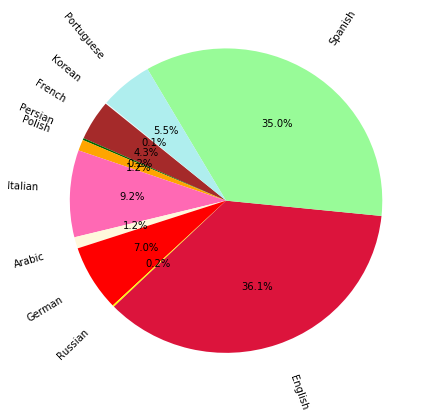

In [71]:

 
langs_dict = {"ar": "Arabic", "en": "English", "fr":"French", "es": "Spanish", "da": "Danish", "de": "Danish", "pl": "Polish", "ko": "Korean", "ja": "Japanese", "pt": "Portuguese", "it": "Italian", "de": "German", "ru": "Russian", "is": "Islandish", "fa": "Persian", "sr": "Serbian", "sv": "Swedish"}
# Data to plot

my_list = [i for i in range(len(langs_dist_red))]
random.shuffle(my_list)
print(my_list)
labels = list(np.array([langs_dict[lang] for lang in list(langs_dist_red.keys())])[my_list])
sizes = list(np.array(list(langs_dist_red.values()))[my_list])
explode = (0.3, 0.2, 0.1, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0)  # explode 1st slice
 
# Plot
a=np.random.random(len(labels))
#cs=cm.Set2(np.arange(40)/40.0)#cs=cm.Set1(np.arange(len(labels))/len(labels))
cs = colors_dist
print("cs", cs)
fig = plt.figure(figsize=[7, 7])
ax = fig.add_subplot(111)
patches = ax.pie(sizes, colors=cs, labels=labels, labeldistance=1.2, startangle=140, rotatelabels=True, autopct='%1.01f%%');
#texts[0].set_fontsize(10)

"""
for pie_wedge in pie_wedge_collection[0]:
    pie_wedge.set_edgecolor('white')
"""

#ax.set_title("Figure 2");


# Tweet Frequency per one day:

## III. Avg/Num/Max/Min tweets published with each hour of the day:

In [48]:
dir_ = "/Users/meryemmhamdi/Documents/Rig1/meryemRig1/home/meryem/meryem/Datasets/EvDet/world_cup_18/original_tweets/allTags/"
date = "23_6_2018/"
os.chdir(dir_+date)
date_langs_dist = {}
for file_ in glob.glob("*.txt"):
    print(file_)
    with open(file_) as fp:
        for (count, _) in enumerate(fp, 1):
            pass
    #print(">>>>>>>>>>>> Count", count)
    lang = file_.split("_")[2]
    hour = file_.split("_")[4].strip("hour.txt")
    if lang not in date_langs_dist:
        date_langs_dist.update({lang:{}})
    date_time = dt.datetime(2018, 6, 21, int(hour))
    if int(hour) not in date_langs_dist[lang]:
        date_langs_dist[lang].update({date_time:count})
    else:
        date_langs_dist[lang].update({date_time:date_langs_dist[lang][hour]+count})

fetched_tweets_de_23-6_12hour.txt
fetched_tweets_fr_23-6_16hour.txt
fetched_tweets_es_23-6_11hour.txt
fetched_tweets_de_23-6_4hour.txt
fetched_tweets_is_23-6_2hour.txt
fetched_tweets_ar_23-6_20hour.txt
fetched_tweets_ko_23-6_13hour.txt
fetched_tweets_ja_23-6_21hour.txt
fetched_tweets_en_23-6_18hour.txt
fetched_tweets_de_23-6_16hour.txt
fetched_tweets_fr_23-6_14hour.txt
fetched_tweets_fr_23-6_20hour.txt
fetched_tweets_ru_23-6_20hour.txt
fetched_tweets_ru_23-6_4hour.txt
fetched_tweets_ko_23-6_16hour.txt
fetched_tweets_ar_23-6_19hour.txt
fetched_tweets_pl_23-6_14hour.txt
fetched_tweets_fa_23-6_19hour.txt
fetched_tweets_fr_23-6_10hour.txt
fetched_tweets_is_23-6_23hour.txt
fetched_tweets_es_23-6_17hour.txt
fetched_tweets_pt_23-6_23hour.txt
fetched_tweets_ja_23-6_6hour.txt
fetched_tweets_en_23-6_12hour.txt
fetched_tweets_da_23-6_10hour.txt
fetched_tweets_ko_23-6_9hour.txt
fetched_tweets_fa_23-6_16hour.txt
fetched_tweets_en_23-6_3hour.txt
fetched_tweets_en_23-6_20hour.txt
fetched_tweets_is_23

fetched_tweets_en_23-6_17hour.txt
fetched_tweets_ja_23-6_9hour.txt
fetched_tweets_ru_23-6_8hour.txt
fetched_tweets_de_23-6_18hour.txt
fetched_tweets_fr_23-6_1hour.txt
fetched_tweets_is_23-6_20hour.txt
fetched_tweets_ar_23-6_6hour.txt
fetched_tweets_sr_23-6_16hour.txt
fetched_tweets_fa_23-6_10hour.txt
fetched_tweets_en_23-6_22hour.txt
fetched_tweets_ar_23-6_15hour.txt
fetched_tweets_ko_23-6_1hour.txt
fetched_tweets_da_23-6_19hour.txt
fetched_tweets_fa_23-6_6hour.txt
fetched_tweets_es_23-6_8hour.txt
fetched_tweets_fa_23-6_14hour.txt
fetched_tweets_pl_23-6_1hour.txt
fetched_tweets_ar_23-6_23hour.txt
fetched_tweets_ja_23-6_0hour.txt
fetched_tweets_de_23-6_9hour.txt
fetched_tweets_fa_23-6_15hour.txt
fetched_tweets_en_23-6_10hour.txt
fetched_tweets_ja_23-6_22hour.txt
fetched_tweets_es_23-6_3hour.txt
fetched_tweets_sr_23-6_15hour.txt
fetched_tweets_is_23-6_21hour.txt
fetched_tweets_da_23-6_18hour.txt
fetched_tweets_ar_23-6_21hour.txt
fetched_tweets_de_23-6_11hour.txt
fetched_tweets_fa_23-6_21

/Users/meryemmhamdi/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: `spline` is deprecated!
spline is deprecated in scipy 0.19.0, use Bspline class instead.
  if __name__ == '__main__':


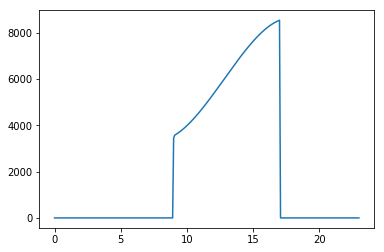

In [148]:
from scipy.interpolate import spline

for lang in ["en"]:#date_langs_dist:
    T = list(date_langs_dist[lang].keys())
    y = list(date_langs_dist[lang].values())
    #list(date_langs_dist[lang].keys()),list(date_langs_dist[lang].values())
    xnew = np.linspace(min(T),max(T),300) #300 represents number of points to make between T.min and T.max

    power_smooth = spline(T,y,xnew)

    plt.plot(xnew,power_smooth)
plt.show()

/Users/meryemmhamdi/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: DeprecationWarning: `spline` is deprecated!
spline is deprecated in scipy 0.19.0, use Bspline class instead.
/Users/meryemmhamdi/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


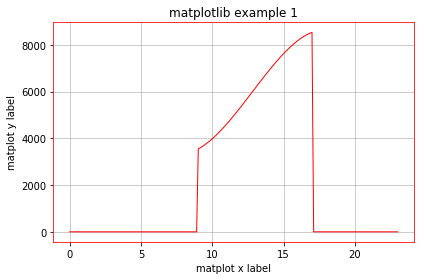

In [146]:
import matplotlib.pyplot as plt
import time
import numpy as np
from scipy.interpolate import spline

# Local variables


# Create a canvas to place the subgraphs
canvas = plt.figure()
rect = canvas.patch
rect.set_facecolor('white')

x = list(date_langs_dist[lang].keys())
y = list(date_langs_dist[lang].values())

x_sm = np.array(x)
y_sm = np.array(y)

x_smooth = np.linspace(x_sm.min(), x_sm.max(), 200)
y_smooth = spline(x, y, x_smooth)

# Define the matrix of 1x1 to place subplots
# Placing the plot1 on 1x1 matrix, at pos 1
sp1 = canvas.add_subplot(1,1,1, axisbg='w')
#sp1.plot(x, y, 'red', linewidth=2)
sp1.plot(x_smooth, y_smooth, 'red', linewidth=1)

# Colorcode the tick tabs 
sp1.tick_params(axis='x', colors='black')
sp1.tick_params(axis='y', colors='black')

# Colorcode the spine of the graph
sp1.spines['bottom'].set_color('r')
sp1.spines['top'].set_color('r')
sp1.spines['left'].set_color('r')
sp1.spines['right'].set_color('r')

# Put the title and labels
sp1.set_title('matplotlib example 1', color='black')
sp1.set_xlabel('matplot x label', color='black')
sp1.set_ylabel('matplot y label', color='black')

# Show the plot/image
plt.tight_layout()
plt.grid(alpha=0.8)
plt.savefig("example6.eps")
plt.show()

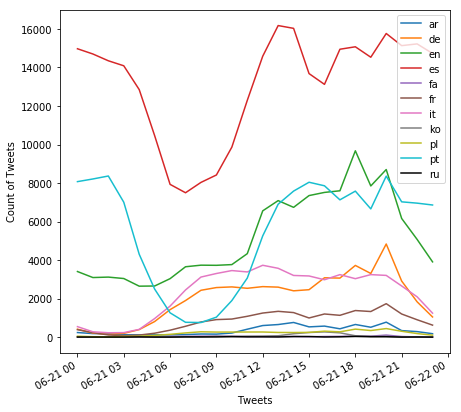

In [49]:
#colors = ['black', 'blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
import datetime
fig = plt.figure(figsize=[7, 7])
ax = fig.add_subplot(111)
    
#x = [datetime.datetime.now() + datetime.timedelta(hours=i) for i in range(len(y))]
plots = []
ind = 0
for lang in sorted(date_langs_dist):
    if lang not in ["da", "is", "ja", "sr"]:
        #lang="en"
        x = list(date_langs_dist[lang].keys())
        y = list(date_langs_dist[lang].values())
        x2,y2 = zip(*sorted(zip(x,y),key=lambda x: x[0]))
        new_x2 = []
        new_y2 = []
        #print(x2)
        #for i in range(0,len(x2)):
        #    if x2[i].hour >= 0 and x2[i].hour <= 20:
                #print(x2[i])
        #        new_x2.append(x2[i])
        #        new_y2.append(y2[i])
        if ind == 10:
            p, = plt.plot(x2, y2, label= lang, color="black")
        else:
            p, = plt.plot(x2, y2, label= lang)
        ind += 1
        plots.append(p)
        plt.ylabel('Count of Tweets')
plt.xlabel("Tweets")
plt.legend(handles = plots, loc=1)
plt.gcf().autofmt_xdate()
plt.show()

## IV. Tweet Volume per language and anotation of games:
to detect games, winning/losing, qualification/elimination

In [94]:
import json
dir_ = "/Users/meryemmhamdi/Documents/meryemRig1/home/meryem/meryem/Datasets/EvDet/world_cup_18/original_tweets/"
#hashtags = ["officialTags/", "teamTags1/", "teamTags2/"]
hashtags = ["allTags/"]
langs = ["ar", "da", "de", "en", "es", "fa", "fr", "hr", "is", "it", "ja", "ko", "pl", "pt", "ru", "sr", "sv"]

start = dt.datetime(2018, 6, 20, 0, 0, 0)
end = dt.datetime(2018, 6, 21, 23, 0, 0)
lang_dist = {} # dict of languages -> hour -> counts
for lang in langs:
    lang_dist[lang] = {}
for hash_ in hashtags:
    date = start
    while date <= end:
        for lang in langs:
            print("lang= "+ lang + " date= " +str(date.day) + "_" + str(date.month) + "_" + str(date.hour))
            file_str = str(date.day) + "_" + str(date.month) + "_" + str(date.year) + "/fetched_tweets_" + lang + \
                       "_" +str(date.day) + "-" + str(date.month) + "_" + str(date.hour) + "hour.txt"
            #print("Processing file=>"+ dir_ + hash_+ file_str)
            if os.path.isfile(dir_ + hash_+ file_str):
                with open(dir_ + hash_+ file_str) as file_:
                    data = file_.readlines()
                date_time_str = str(date.day) + "_" + str(date.month) + "_" + str(date.hour)
                if date_time_str not in lang_dist[lang]:
                    lang_dist[lang].update({date:len(data)})
                else:
                    lang_dist[lang].update({date:lang_dist[lang][date_time_str]+len(data)})

        date += dt.timedelta(hours=1)
## Count tweets by day, hour for officialTags for each language independently

## Count tweets by day, hour for teamTags1 for each language independently

## Count tweets by day, hour for teamTags2 for each language independently

## Merge the counts for each language independently

lang= ar date= 20_6_0
lang= da date= 20_6_0
lang= de date= 20_6_0
lang= en date= 20_6_0
lang= es date= 20_6_0
lang= fa date= 20_6_0
lang= fr date= 20_6_0
lang= hr date= 20_6_0
lang= is date= 20_6_0
lang= it date= 20_6_0
lang= ja date= 20_6_0
lang= ko date= 20_6_0
lang= pl date= 20_6_0
lang= pt date= 20_6_0
lang= ru date= 20_6_0
lang= sr date= 20_6_0
lang= sv date= 20_6_0
lang= ar date= 20_6_1
lang= da date= 20_6_1
lang= de date= 20_6_1
lang= en date= 20_6_1
lang= es date= 20_6_1
lang= fa date= 20_6_1
lang= fr date= 20_6_1
lang= hr date= 20_6_1
lang= is date= 20_6_1
lang= it date= 20_6_1
lang= ja date= 20_6_1
lang= ko date= 20_6_1
lang= pl date= 20_6_1
lang= pt date= 20_6_1
lang= ru date= 20_6_1
lang= sr date= 20_6_1
lang= sv date= 20_6_1
lang= ar date= 20_6_2
lang= da date= 20_6_2
lang= de date= 20_6_2
lang= en date= 20_6_2
lang= es date= 20_6_2
lang= fa date= 20_6_2
lang= fr date= 20_6_2
lang= hr date= 20_6_2
lang= is date= 20_6_2
lang= it date= 20_6_2
lang= ja date= 20_6_2
lang= ko d

lang= hr date= 20_6_21
lang= is date= 20_6_21
lang= it date= 20_6_21
lang= ja date= 20_6_21
lang= ko date= 20_6_21
lang= pl date= 20_6_21
lang= pt date= 20_6_21
lang= ru date= 20_6_21
lang= sr date= 20_6_21
lang= sv date= 20_6_21
lang= ar date= 20_6_22
lang= da date= 20_6_22
lang= de date= 20_6_22
lang= en date= 20_6_22
lang= es date= 20_6_22
lang= fa date= 20_6_22
lang= fr date= 20_6_22
lang= hr date= 20_6_22
lang= is date= 20_6_22
lang= it date= 20_6_22
lang= ja date= 20_6_22
lang= ko date= 20_6_22
lang= pl date= 20_6_22
lang= pt date= 20_6_22
lang= ru date= 20_6_22
lang= sr date= 20_6_22
lang= sv date= 20_6_22
lang= ar date= 20_6_23
lang= da date= 20_6_23
lang= de date= 20_6_23
lang= en date= 20_6_23
lang= es date= 20_6_23
lang= fa date= 20_6_23
lang= fr date= 20_6_23
lang= hr date= 20_6_23
lang= is date= 20_6_23
lang= it date= 20_6_23
lang= ja date= 20_6_23
lang= ko date= 20_6_23
lang= pl date= 20_6_23
lang= pt date= 20_6_23
lang= ru date= 20_6_23
lang= sr date= 20_6_23
lang= sv da

lang= ru date= 21_6_18
lang= sr date= 21_6_18
lang= sv date= 21_6_18
lang= ar date= 21_6_19
lang= da date= 21_6_19
lang= de date= 21_6_19
lang= en date= 21_6_19
lang= es date= 21_6_19
lang= fa date= 21_6_19
lang= fr date= 21_6_19
lang= hr date= 21_6_19
lang= is date= 21_6_19
lang= it date= 21_6_19
lang= ja date= 21_6_19
lang= ko date= 21_6_19
lang= pl date= 21_6_19
lang= pt date= 21_6_19
lang= ru date= 21_6_19
lang= sr date= 21_6_19
lang= sv date= 21_6_19
lang= ar date= 21_6_20
lang= da date= 21_6_20
lang= de date= 21_6_20
lang= en date= 21_6_20
lang= es date= 21_6_20
lang= fa date= 21_6_20
lang= fr date= 21_6_20
lang= hr date= 21_6_20
lang= is date= 21_6_20
lang= it date= 21_6_20
lang= ja date= 21_6_20
lang= ko date= 21_6_20
lang= pl date= 21_6_20
lang= pt date= 21_6_20
lang= ru date= 21_6_20
lang= sr date= 21_6_20
lang= sv date= 21_6_20
lang= ar date= 21_6_21
lang= da date= 21_6_21
lang= de date= 21_6_21
lang= en date= 21_6_21
lang= es date= 21_6_21
lang= fa date= 21_6_21
lang= fr da

In [95]:
lang_dist_dates = {}
for key in lang_dist["en"]:
    dateday = dt.datetime(key.year, key.month, key.day, 0, 0)
    if dateday not in lang_dist_dates:
        list_counts_hours = {key:lang_dist["en"][key]}
        lang_dist_dates.update({dateday: list_counts_hours})
    else:
        list_counts_hours = lang_dist_dates[dateday]
        list_counts_hours.update({key:lang_dist["en"][key]})
        lang_dist_dates.update({dateday: list_counts_hours})

In [96]:
lang_dist_dates[dt.datetime(2018, 6, 20, 0, 0)]

{datetime.datetime(2018, 6, 20, 0, 0): 3622,
 datetime.datetime(2018, 6, 20, 1, 0): 3450,
 datetime.datetime(2018, 6, 20, 2, 0): 3293,
 datetime.datetime(2018, 6, 20, 3, 0): 3087,
 datetime.datetime(2018, 6, 20, 4, 0): 2871,
 datetime.datetime(2018, 6, 20, 5, 0): 2830,
 datetime.datetime(2018, 6, 20, 6, 0): 3169,
 datetime.datetime(2018, 6, 20, 7, 0): 3481,
 datetime.datetime(2018, 6, 20, 8, 0): 3356,
 datetime.datetime(2018, 6, 20, 9, 0): 3448,
 datetime.datetime(2018, 6, 20, 10, 0): 3858,
 datetime.datetime(2018, 6, 20, 11, 0): 4645,
 datetime.datetime(2018, 6, 20, 12, 0): 6722,
 datetime.datetime(2018, 6, 20, 13, 0): 6945,
 datetime.datetime(2018, 6, 20, 14, 0): 8185,
 datetime.datetime(2018, 6, 20, 15, 0): 7474,
 datetime.datetime(2018, 6, 20, 16, 0): 7204,
 datetime.datetime(2018, 6, 20, 17, 0): 7233,
 datetime.datetime(2018, 6, 20, 18, 0): 7941,
 datetime.datetime(2018, 6, 20, 19, 0): 9255,
 datetime.datetime(2018, 6, 20, 20, 0): 7685,
 datetime.datetime(2018, 6, 20, 21, 0): 5975

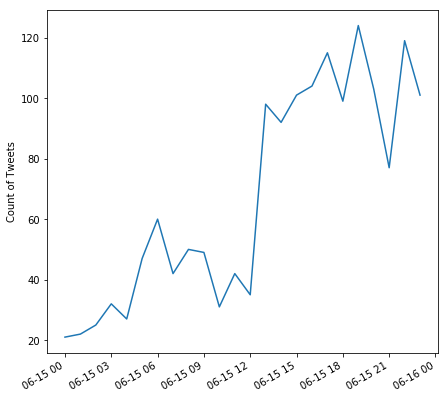

In [86]:
import datetime
fig = plt.figure(figsize=[7, 7])
ax = fig.add_subplot(111)
    
#x = [datetime.datetime.now() + datetime.timedelta(hours=i) for i in range(len(y))]
plt.plot(lang_dist_dates[dt.datetime(2018, 6, 15, 0, 0)].keys(), lang_dist_dates[dt.datetime(2018, 6, 15, 0, 0)].values())
plt.gcf().autofmt_xdate()
plt.ylabel('Count of Tweets')
plt.show()

In [143]:
lang_dist_dates.keys()

dict_keys([datetime.datetime(2018, 6, 20, 0, 0), datetime.datetime(2018, 6, 21, 0, 0)])

In [149]:
lang_dist_dates[dt.datetime(2018, 6, 20, 0, 0)]

{datetime.datetime(2018, 6, 20, 0, 0): 3622,
 datetime.datetime(2018, 6, 20, 1, 0): 3450,
 datetime.datetime(2018, 6, 20, 2, 0): 3293,
 datetime.datetime(2018, 6, 20, 3, 0): 3087,
 datetime.datetime(2018, 6, 20, 4, 0): 2871,
 datetime.datetime(2018, 6, 20, 5, 0): 2830,
 datetime.datetime(2018, 6, 20, 6, 0): 3169,
 datetime.datetime(2018, 6, 20, 7, 0): 3481,
 datetime.datetime(2018, 6, 20, 8, 0): 3356,
 datetime.datetime(2018, 6, 20, 9, 0): 3448,
 datetime.datetime(2018, 6, 20, 10, 0): 3858,
 datetime.datetime(2018, 6, 20, 11, 0): 4645,
 datetime.datetime(2018, 6, 20, 12, 0): 6722,
 datetime.datetime(2018, 6, 20, 13, 0): 6945,
 datetime.datetime(2018, 6, 20, 14, 0): 8185,
 datetime.datetime(2018, 6, 20, 15, 0): 7474,
 datetime.datetime(2018, 6, 20, 16, 0): 7204,
 datetime.datetime(2018, 6, 20, 17, 0): 7233,
 datetime.datetime(2018, 6, 20, 18, 0): 7941,
 datetime.datetime(2018, 6, 20, 19, 0): 9255,
 datetime.datetime(2018, 6, 20, 20, 0): 7685,
 datetime.datetime(2018, 6, 20, 21, 0): 5975

In [145]:
matches.keys()

dict_keys([datetime.datetime(2018, 6, 14, 15, 0), datetime.datetime(2018, 6, 15, 12, 0), datetime.datetime(2018, 6, 15, 15, 0), datetime.datetime(2018, 6, 15, 18, 0), datetime.datetime(2018, 6, 16, 10, 0), datetime.datetime(2018, 6, 16, 13, 0), datetime.datetime(2018, 6, 16, 16, 0), datetime.datetime(2018, 6, 16, 19, 0), datetime.datetime(2018, 6, 17, 12, 0), datetime.datetime(2018, 6, 17, 15, 0), datetime.datetime(2018, 6, 17, 18, 0), datetime.datetime(2018, 6, 18, 12, 0), datetime.datetime(2018, 6, 18, 15, 0), datetime.datetime(2018, 6, 18, 18, 0), datetime.datetime(2018, 6, 19, 12, 0), datetime.datetime(2018, 6, 19, 15, 0), datetime.datetime(2018, 6, 19, 18, 0), datetime.datetime(2018, 6, 20, 12, 0), datetime.datetime(2018, 6, 20, 15, 0), datetime.datetime(2018, 6, 20, 18, 0), datetime.datetime(2018, 6, 21, 12, 0), datetime.datetime(2018, 6, 21, 15, 0), datetime.datetime(2018, 6, 21, 18, 0), datetime.datetime(2018, 6, 22, 12, 0), datetime.datetime(2018, 6, 22, 15, 0), datetime.datet

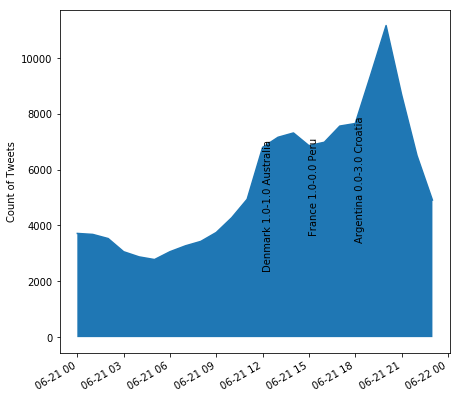

In [166]:
import scipy
import datetime
fig = plt.figure(figsize=[7, 7])
ax = fig.add_subplot(111)

start_date = datetime.datetime(2018, 6, 21, 0, 0)
for date in matches[start_date].keys():
    plt.text(date, lang_dist_dates[start_date][date], matches[start_date][date], rotation=90)
#x = [datetime.datetime.now() + datetime.timedelta(hours=i) for i in range(len(y))]
plt.plot(lang_dist_dates[start_date].keys(), lang_dist_dates[start_date].values())
plt.fill_between(lang_dist_dates[start_date].keys(),lang_dist_dates[start_date].values())
plt.gcf().autofmt_xdate()
plt.ylabel('Count of Tweets')
plt.show()

In [137]:
lang_dist_dates

{datetime.datetime(2018, 6, 20, 0, 0): {datetime.datetime(2018, 6, 20, 0, 0): 3622,
  datetime.datetime(2018, 6, 20, 1, 0): 3450,
  datetime.datetime(2018, 6, 20, 2, 0): 3293,
  datetime.datetime(2018, 6, 20, 3, 0): 3087,
  datetime.datetime(2018, 6, 20, 4, 0): 2871,
  datetime.datetime(2018, 6, 20, 5, 0): 2830,
  datetime.datetime(2018, 6, 20, 6, 0): 3169,
  datetime.datetime(2018, 6, 20, 7, 0): 3481,
  datetime.datetime(2018, 6, 20, 8, 0): 3356,
  datetime.datetime(2018, 6, 20, 9, 0): 3448,
  datetime.datetime(2018, 6, 20, 10, 0): 3858,
  datetime.datetime(2018, 6, 20, 11, 0): 4645,
  datetime.datetime(2018, 6, 20, 12, 0): 6722,
  datetime.datetime(2018, 6, 20, 13, 0): 6945,
  datetime.datetime(2018, 6, 20, 14, 0): 8185,
  datetime.datetime(2018, 6, 20, 15, 0): 7474,
  datetime.datetime(2018, 6, 20, 16, 0): 7204,
  datetime.datetime(2018, 6, 20, 17, 0): 7233,
  datetime.datetime(2018, 6, 20, 18, 0): 7941,
  datetime.datetime(2018, 6, 20, 19, 0): 9255,
  datetime.datetime(2018, 6, 20,

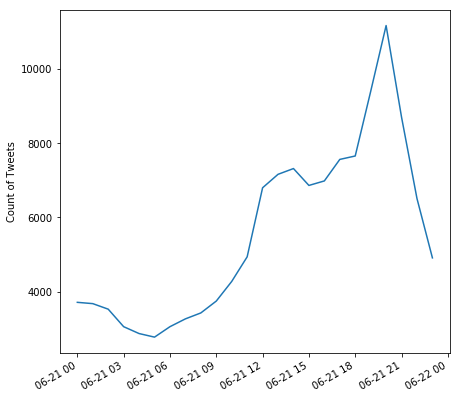

In [98]:
fig = plt.figure(figsize=[7, 7])
ax = fig.add_subplot(111)

date = dt.datetime(2018, 6, 21, 0, 0)
#x = [datetime.datetime.now() + datetime.timedelta(hours=i) for i in range(len(y))]
plt.plot(lang_dist_dates[date].keys(), lang_dist_dates[date].values())
plt.gcf().autofmt_xdate()
plt.ylabel('Count of Tweets')
plt.show()

## V. Tweet Volume during matches: 
to detect goals, substitutions, red/yellow cards, penalties

## VI. Tweet Volume for Different Teams:

## VII. Trigger Keywords TimeSeries Frequency:

## EvDet Vocabulary Coverage:

In [ ]:
"/Users/meryemmhamdi/Documents/Rig4/meryemRig4/home/meryem/meryem/Results/EvDet/world_cup_18/"